In [ ]:
# Enze Xu
# Github: https://github.com/EnzeXu/PINN
# git clone https://github.com/EnzeXu/PINN.git

import torch
import time
import random
import argparse
import math
import os
import numpy as np
import matplotlib.pyplot as plt
from torch import nn, optim
from scipy import stats
from tqdm import tqdm
from collections import OrderedDict
from torchsummary import summary
from torch.backends import cudnn
from mpl_toolkits.mplot3d import Axes3D
from scipy.integrate import odeint
from torch.utils.tensorboard import SummaryWriter

from google.colab import drive
import sys
drive.mount("/content/drive")

main_path = '/content/drive/My Drive/enze/workspace/PINN/' # ENZE marked: you need to change your main_path if it's not here
sys.path.append(main_path)
from cyclic_lr_scheduler import CyclicLR
from utils import draw_two_dimension, draw_two_dimension_different_x

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
class ConfigPP:
    def __init__(self):
      self.model_name = "SimpleNetworkPP_Continue"
      self.T = 20.0
      self.T_all = 20.0
      self.T_unit = 0.01
      self.N = int(self.T / self.T_unit)
      self.U_start = 10.0
      self.V_start = 5.0
      self.alpha = 1.0
      self.beta = 3.0
      self.gamma = 0.3
      self.e = 0.333
      self.ub = self.T
      self.lb = 0.0

      self.continue_period = 0.2
      self.round_bit = 3
      self.continue_id = None
      self.mapping_overall_flag = False
      self.loss2_partial_flag = False

    # sliding_window_step = 50000

class SimpleNetworkPP(nn.Module):
    def __init__(self, config, truth=None):
        super(SimpleNetworkPP, self).__init__()
        self.setup_seed(1)
        self.config = config
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.x, self.y0, self.t0 = None, None, None
        self.accurate_x = None
        self.generate_x()
        self.initial_start()
        self.model_name = self.config.model_name
        self.gt = GroundTruthPP(self.config.T, self.config.N)
        self.act = nn.Tanh()
        self.network_unit = 100
        self.truth = truth if truth else [[], []]
        self.truth_dic = {round(self.truth[0][i], self.config.round_bit): self.truth[1][i] for i in range(len(truth[0]))}
        print("self.truth_dic:", self.truth_dic)
        

        # Design A
        self.fc1 = nn.Sequential(OrderedDict({
            'lin1': nn.Linear(1, self.network_unit),
            'activation1': self.act,
            'lin2': nn.Linear(self.network_unit, self.network_unit),
            'activation2': self.act,
            'lin3': nn.Linear(self.network_unit, self.network_unit),
            'activation3': self.act,
            'lin4': nn.Linear(self.network_unit, self.network_unit),#
            'activation4': self.act,#
            # 'lin5': nn.Linear(100, 100),#
            # 'activation5': self.act,#
            'lin6': nn.Linear(self.network_unit, 1),
            # 'activation5': nn.ReLU(),
        }))

        self.fc2 = nn.Sequential(OrderedDict({
            'lin1': nn.Linear(1, self.network_unit),
            'activation1': self.act,
            'lin2': nn.Linear(self.network_unit, self.network_unit),
            'activation2': self.act,
            'lin3': nn.Linear(self.network_unit, self.network_unit),
            'activation3': self.act,
            'lin4': nn.Linear(self.network_unit, self.network_unit),#
            'activation4': self.act,#
            # 'lin5': nn.Linear(100, 100),#
            # 'activation5': self.act,#
            'lin6': nn.Linear(self.network_unit, 1),
            # 'activation5': nn.ReLU(),
        }))

        # Design B
        # self.fc_start1 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(1, 100),
        #     'activation1': self.act,
        # }))

        # self.fc_start2 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(1, 100),
        #     'activation1': self.act,
        # }))

        # self.fc_end1 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(100, 1),
        #     # 'activation1': self.act,
        # }))

        # self.fc_end2 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(100, 1),
        #     # 'activation1': self.act,
        # }))

        # self.fc_middle = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(200, 200),
        #     'activation1': self.act,
        #     'lin2': nn.Linear(200, 200),
        #     'activation2': self.act,
        # }))

        # # Design D
        # self.fc_x1_0_1 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(1, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x2_0_1 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(1, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x1_1_2 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(2 * self.network_unit, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x2_1_2 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(2 * self.network_unit, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x1_2_3 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(2 * self.network_unit, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x2_2_3 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(2 * self.network_unit, self.network_unit),
        #     'sig1': self.act,
        # }))

        # self.fc_x1_3_4 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(self.network_unit, 1),
        # }))

        # self.fc_x2_3_4 = nn.Sequential(OrderedDict({
        #     'lin1': nn.Linear(self.network_unit, 1),
        # }))


    def forward(self, inputs):
        # A
        u_old, v_old = torch.chunk(inputs, 2, 1)
        u_new = self.fc1(u_old)
        v_new = self.fc2(v_old)
        outputs = torch.cat((u_new, v_new), 1)

        # B
        # u_old, v_old = torch.chunk(inputs, 2, 1)
        # u_middle = self.fc_start1(u_old)
        # v_middle = self.fc_start2(v_old)
        # middle_input = torch.cat((u_middle, v_middle), 1)
        # middle_output = self.fc_middle(middle_input)
        # middle_output_chunk = torch.chunk(middle_output, 2, 1)
        # u_end_input, v_end_input = middle_output_chunk[0], middle_output_chunk[1]
        # u_new = self.fc_end1(u_end_input)
        # v_new = self.fc_end2(v_end_input)
        # outputs = torch.cat((u_new, v_new), 1)


        # # Design D
        # x1, x2 = torch.chunk(inputs, 2, 1)
        # x1_1_output = self.fc_x1_0_1(x1)
        # x2_1_output = self.fc_x2_0_1(x2)

        # x1_2_input = torch.cat((x1_1_output, x2_1_output), 1)
        # x2_2_input = torch.cat((x1_1_output, x2_1_output), 1)

        # x1_2_output = self.fc_x1_1_2(x1_2_input)
        # x2_2_output = self.fc_x2_1_2(x2_2_input)
        
        # x1_3_input = torch.cat((x1_2_output, x2_2_output), 1)
        # x2_3_input = torch.cat((x1_2_output, x2_2_output), 1)
        
        # x1_3_output = self.fc_x1_2_3(x1_3_input)
        # x2_3_output = self.fc_x2_2_3(x2_3_input)
        
        # x1_new = self.fc_x1_3_4(x1_3_output)
        # x2_new = self.fc_x2_3_4(x2_3_output)
        
        # outputs = torch.cat((x1_new, x2_new), 1)
        return outputs

    def generate_x(self):
        # lb_row = np.repeat(self.config.lb, 2).reshape([1, -1])
        # ub_row = np.repeat(self.config.ub, 2).reshape([1, -1])
        # x = lb_row + (ub_row - lb_row) * lhs(1, self.config.N)
        # x = sorted(x, key=lambda xx: xx[0])
        x = [[i*self.config.T_unit, i*self.config.T_unit] for i in range(self.config.N)]  # toy
        x = np.asarray(x)
        x = self.encode_t(x)
        print("continue_id = {}: [0, {}] is mapped to [{}, {}]".format(self.config.continue_id, self.config.T, x[0], x[-1]))
        self.x = torch.Tensor(x).float().to(self.device)

        self.accurate_x = [i*self.config.T_unit for i in range(self.config.N)]

    def initial_start(self):
        self.t0 = torch.Tensor(np.asarray([-1.0, -1.0]).reshape([1, -1])).float().to(self.device)
        # self.y0 = torch.Tensor(np.asarray([0.0, 0.0]).reshape([1, -1])).float().to(self.device)
        self.y0 = torch.Tensor(np.asarray([self.config.U_start, self.config.V_start]).reshape([1, -1])).float().to(self.device)

    def loss(self, epoch_ratio):
        self.eval()
        y = self.forward(self.x)
        y0_pred = self.forward(self.t0)
        # print("y.shape:", y[:, 0:1].shape)
        # print(y[:, 0:1])
        # print("self.x.shape:", self.x[:, 0:1].shape)
        # y_t = torch.gradient(y, spacing=(self.x,))[0]  # y_t = tf.gradients(y, t)[0]
        u = y[:, 0:1]
        v = y[:, 1:2]

        u_t = torch.gradient(y[:, 0:1].reshape([self.config.N]), spacing=(self.decode_t(self.x)[:, 0:1].reshape([self.config.N]),))[0]  # u_t = y_t[:, 0:1]
        v_t = torch.gradient(y[:, 1:2].reshape([self.config.N]), spacing=(self.decode_t(self.x)[:, 1:2].reshape([self.config.N]),))[0]  # y_t[:, 1:2]
        u_t = u_t.reshape([self.config.N, 1])
        v_t = v_t.reshape([self.config.N, 1])
        # print(y_t,u_t)
        f_u = u_t - (self.config.alpha - self.config.gamma * v) * u    # nn model
        f_v = v_t - (-self.config.beta + self.config.e * self.config.gamma * u) * v    # nn model
        # f_u = u_t - torch.cos(self.decode_t(self.x)[:, 0:1])
        # f_v = v_t - torch.cos(self.decode_t(self.x)[:, 1:2])
        f_y = torch.cat((f_u, f_v), 1)

        # print((self.decode_t(self.x)[:, 0:1].reshape([self.config.N]),).shape)
        # print(u_t.shape)

        # u_tt = torch.gradient(u_t, spacing=(self.decode_t(self.x)[:, 0:1].reshape([self.config.N]),))[0]
        # v_tt = torch.gradient(v_t, spacing=(self.decode_t(self.x)[:, 1:2].reshape([self.config.N]),))[0]
        
        # print_flag = False  # True # False
        # if print_flag:
        #     print("u=", u.shape, u, "v=", v.shape, v, "t=", (self.decode_t(self.x)[:, 0:1]).shape, self.decode_t(self.x)[:, 0:1])
        #     print("u_t=", u_t, "shape=", u_t.shape, "u_t_minus=", (self.config.alpha - self.config.gamma * v) * u,
        #           "shape=", ((self.config.alpha - self.config.gamma * v) * u).shape)
        #     print("v_t=", v_t, "shape=", v_t.shape, "v_t_minus=",
        #           (-self.config.beta + self.config.e * self.config.gamma * u) * v, "shape=",
        #           ((-self.config.beta + self.config.e * self.config.gamma * u) * v).shape)
        #     print("self.t0 =", self.t0, "self.encode_y(self.t0)=", self.encode_y(self.t0), "self.y0 =", self.y0,
        #           "y0_pred =", y0_pred, "self.y0 - y0_pred =", self.y0 - y0_pred)

        # loss_2_weights = [[i, i] for i in range(20000)]  # toy
        # loss_2_weights = np.asarray(loss_2_weights)
        # loss_2_weights = torch.Tensor(loss_2_weights).float().to(self.device)

        # original
        # loss_1 = torch.mean(torch.square(self.y0 - y0_pred))
        # loss_2 = torch.mean(torch.square(f_y))  # + torch.var(torch.square(f_y))
        # loss_3 = torch.mean(torch.square((0.1/(u * u + v * v + 1e-12)))) + torch.mean(torch.square((torch.abs(u) - u))) + torch.mean(torch.square((torch.abs(v) - v)))

        # L2 norm
        self.loss_norm = torch.nn.MSELoss().to(self.device)
        zeros_1D = torch.Tensor([[0.0]] * self.config.N).to(self.device)
        zeros_2D = torch.Tensor([[0.0, 0.0]] * self.config.N).to(self.device)
        loss_1 = self.loss_norm(y0_pred, self.y0)
        # print("loss_1:", type(loss_1), loss_1.shape, loss_1)
        # self.loss_2_weight_numpy = generate_normal_distribution_weight_normal(self.config.N, 2, epoch_ratio)

        # self.loss_2_weight_numpy = generate_normal_distribution_weight(self.config.N, 2, (epoch % int(self.config.sliding_window_step)) / self.config.sliding_window_step)
        if self.config.loss2_partial_flag:
            new_period = int(self.config.continue_period * self.config.T_all / self.config.T_unit)
            loss_2 = self.loss_norm(f_y[-new_period:, :], zeros_2D[-new_period:, :])
        else:
            loss_2 = self.loss_norm(f_y, zeros_2D)  # + torch.var(torch.square(f_y))
        # loss_2_details_normed = torch.abs(f_y * torch.Tensor(self.loss_2_weight_numpy).to(self.device)).cpu().detach().numpy()
        # loss_2_details_original = torch.abs(f_y).cpu().detach().numpy()
        # print("loss_2_details shape:", loss_2_details.shape)
        loss_3 = self.loss_norm((0.1/(u * u + v * v + 1e-12)), zeros_1D) + self.loss_norm(torch.abs(u), u) + self.loss_norm(torch.abs(v), v)
        loss_4 = self.match_truth(self.accurate_x, y.cpu().detach().numpy())

        # loss_3 = torch.mean(torch.square(1.0 / u - (self.config.e * self.config.gamma / self.config.beta))) + \
        #     torch.mean(torch.square(1.0 / v - (self.config.gamma / self.config.alpha)))
        # loss_3 = torch.mean(torch.square((torch.abs(u) - u)))

        # loss_3 = torch.mean(torch.square((1/(u * u+ 1e-12)))) + torch.mean(torch.square((1/(v * v + 1e-12)))) + torch.mean((torch.abs(u) - u)) + torch.mean((torch.abs(v) - v))

        # loss_3 = torch.mean(torch.square((1/(u * u + v * v)))) + torch.mean((torch.abs(u) - u)) + torch.mean((torch.abs(v) - v))  # torch.mean(torch.square((1/(u * u + v * v + 1e-12)))) + torch.mean((torch.abs(u) - u)) + torch.mean((torch.abs(v) - v))
        # loss_4 = torch.mean(0.001 / (torch.abs(u_t)+1e-8)) + torch.mean(0.001 / (torch.abs(v_t)+1e-8))
        # loss_5 = torch.mean(0.001 / (torch.abs(u_tt)+1e-8)) + torch.mean(0.001 / (torch.abs(v_tt)+1e-8))
        loss = (loss_1 + loss_2 + loss_3 + loss_4)#+ loss_4 + loss_5) / 1e5
        # if loss < 2.0:
        #     f_y_square_pure = torch.square(f_y).cpu().detach().numpy()
        #     for i in range(20000):
        #         print(i, f_y_square_pure[i])
        self.train()
        return loss, [loss_1, loss_2, loss_3, loss_4], []
        # return torch.mean(torch.square(y_hat - y))
        # return F.mse_loss(torch.cat((u_hat, v_hat), 1), torch.cat((u, v), 1))
        # return torch.abs(u_hat - u) + torch.abs(v_hat - v)  # F.mse_loss(x_hat, x) + beta * self.kl_div(rho)
    
    def match_truth(self, x, y):
        # print(type(x), type(y))
        if len(self.truth[0]) == 0:
            return torch.Tensor([0.0]).to(self.device)
        diff = [np.abs(y_tmp - self.truth_dic.get(round(x_tmp, self.config.round_bit))) for x_tmp, y_tmp in zip(x, y) if round(x_tmp, self.config.round_bit) in self.truth_dic]
        diff = torch.Tensor(diff).to(self.device)
        zeros_2D = torch.Tensor([[0.0, 0.0]] * len(diff)).to(self.device)
        loss_truth_match = self.loss_norm(diff, zeros_2D)
        if len(diff) != len(self.truth[0]):
            print("Error: match_truth: {} / {} items to match, loss_truth_match = {}".format(len(diff), len(self.truth[0]), loss_truth_match.item()))
        return loss_truth_match
        

    # def encode_y(self, num):
    #     return num
    #     # return (num - self.config.y_lb) / (self.config.y_ub - self.config.y_lb) * 2.0 - 1.0

    # def decode_y(self, num):
    #     return num
    #     # return self.config.y_lb + (num + 1.0) / 2.0 * (self.config.y_ub - self.config.y_lb)

    def encode_t(self, num):
        if not self.config.mapping_overall_flag:
            return (num - self.config.lb) / (self.config.ub - self.config.lb) * 2.0 - 1.0
        return num / self.config.T_all * 2.0 - 1.0

    def decode_t(self, num):
        if not self.config.mapping_overall_flag:
            return self.config.lb + (num + 1.0) / 2.0 * (self.config.ub - self.config.lb)
        return (num + 1.0) / 2.0 * self.config.T_all

    @staticmethod
    def setup_seed(seed):
        torch.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        np.random.seed(seed)
        random.seed(seed)
        cudnn.deterministic = True



In [ ]:
class GroundTruthPP:
  def __init__(self, t_max, length):
    U_start = 10.0
    V_start = 5.0
    alpha = 1.0
    beta = 3.0
    gamma = 0.3
    e = 0.333
    self.t = np.linspace(0, t_max, length)
    # print(t)
    y0 = np.asarray([U_start, V_start])
    self.data = odeint(self.pend, y0, self.t, args=(alpha, beta, gamma, e))
  
  @staticmethod
  def pend(y, t, a, b, c, d):
    map = y
    dydt = np.asarray([(a * map[0]) - c * map[0] * map[1], - b * map[1] + d * c * map[0] * map[1]])
    return dydt
  
  def print(self):
    plt.figure(figsize=(8, 6))
    plt.plot(self.t, self.data[:, 0], 'b', label='u')
    plt.plot(self.t, self.data[:, 1], 'r', label='v')
    plt.show()
    plt.clf()
    plt.close()


def generate_normal_distribution_weight(length, width, mu_location):
  mu = mu_location * length
  sigma = length // 10
  x = np.linspace(0, length, length)
  y = 1e2 * length * stats.norm.pdf(x, mu, sigma)
  y = y / y.sum() * length
  # print(y)
  # plt.plot(x, y)
  # print(x[:5], x[-5:])
  # print(y.shape)
  # print(y)
  # plt.show()
  res = np.column_stack([y for i in range(width)])
  # print(res.shape)
  return res

def generate_normal_distribution_weight_normal(length, width, epoch_ratio, epoch_freeze=0.15, epoch_moving=0.05, epoch_final=0.40):
  # epoch_ratio = epoch / epoch_max
  if epoch_ratio <= epoch_freeze:
    weight_range = [0, 0.25 * length]
  elif epoch_freeze < epoch_ratio <= epoch_freeze + epoch_moving:
    weight_range = [0, (0.25 + (epoch_ratio - (1 * epoch_freeze)) / epoch_moving * 0.25) * length]
  elif epoch_freeze + epoch_moving < epoch_ratio <= 2 * epoch_freeze + epoch_moving:
    weight_range = [0, 0.5 * length]
  elif 2 * epoch_freeze + epoch_moving < epoch_ratio <= 2 * epoch_freeze + 2 * epoch_moving:
    weight_range = [0, (0.5 + (epoch_ratio - (2 * epoch_freeze + epoch_moving)) / epoch_moving * 0.25) * length]
  elif 2 * epoch_freeze + 2 * epoch_moving < epoch_ratio <= 3 * epoch_freeze + 2 * epoch_moving:
    weight_range = [0, 0.75 * length]
  elif 3 * epoch_freeze + 2 * epoch_moving < epoch_ratio <= 3 * epoch_freeze + 3 * epoch_moving:
    weight_range = [0, (0.75 + (epoch_ratio - (3 * epoch_freeze + 2 * epoch_moving)) / epoch_moving * 0.25) * length]
  elif 3 * epoch_freeze + 3 * epoch_moving < epoch_ratio <= 1.0:
    weight_range = [0, 1.0 * length]

  weight_high = length * 1 / (weight_range[1] - weight_range[0])
  y = [weight_high if i < weight_range[1] else 0 for i in range(length)]
  y = np.asarray(y)
  y = y / y.sum() * length
  # print("weight range = {}".format(weight_range))
  # x = np.linspace(0, length, length)
  # plt.plot(x, y)
  # plt.show()

  # mu = mu_location * length
  # sigma = length // 10
  # x = np.linspace(0, length, length)
  # y = 1e2 * length * stats.norm.pdf(x, mu, sigma)
  # y = y / y.sum() * length * 0.8 + 0.2
  # print(y)
  # plt.plot(x, y)
  # print(x[:5], x[-5:])
  # print(y.shape)
  # print(y)
  # plt.show()
  res = np.column_stack([y for i in range(width)])
  # print(res.shape)
  return res


# def generate_normal_distribution_weight_normal(length, width, epoch, epoch_freeze=500000, epoch_step=50000, freeze_range=0.5):
#   if epoch <= epoch_freeze:
#     weight_range = [0, freeze_range * length]
#   else:
#     weight_range = [0, (((epoch - epoch_freeze) % epoch_step) / epoch_step * (1 - freeze_range) + freeze_range) * length]
#   weight_high = length * 1 / (weight_range[1] - weight_range[0])
#   y = [weight_high if i < weight_range[1] else 0 for i in range(length)]
#   y = np.asarray(y)
#   y = y / y.sum() * length
#   # print("weight range = {}".format(weight_range))
#   # x = np.linspace(0, length, length)
#   # plt.plot(x, y)

#   # mu = mu_location * length
#   # sigma = length // 10
#   # x = np.linspace(0, length, length)
#   # y = 1e2 * length * stats.norm.pdf(x, mu, sigma)
#   # y = y / y.sum() * length * 0.8 + 0.2
#   # print(y)
#   # plt.plot(x, y)
#   # print(x[:5], x[-5:])
#   # print(y.shape)
#   # print(y)
#   # plt.show()
#   res = np.column_stack([y for i in range(width)])
#   # print(res.shape)
#   return res

def get_now_string():
    return time.strftime("%Y-%m-%d-%H-%M-%S", time.localtime(time.time()))


def draw_loss(loss_list):
    map = np.asarray([[loss] for loss in loss_list])
    plt.plot(map)
    plt.show()
    plt.clf()

# optimizer = optim.LBFGS(model.parameters(), lr=1, max_iter=20, max_eval=None, tolerance_grad=1e-07, tolerance_change=1e-09, history_size=100, line_search_fn=None)

def train_pp(model, args, config, now_string):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # model = model_framework(config).to(device)
    model.train()
    model_save_path_last = f"{args.main_path}/train/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_last.pt"
    model_save_path_best = f"{args.main_path}/train/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_best.pt"
    loss_save_path = f"{args.main_path}/loss/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_loss_{args.epoch}.npy"
    board_save_path = f"{args.main_path}/board/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_board"
    print("using " + str(device))
    print("epoch = {}".format(args.epoch))
    print("epoch_step = {}".format(args.epoch_step))
    print("model_name = {}".format(model.model_name))
    print("now_string = {}".format(now_string))
    print("model_save_path_last = {}".format(model_save_path_last))
    print("model_save_path_best = {}".format(model_save_path_best))
    print("loss_save_path = {}".format(loss_save_path))
    print("args = {}".format({item[0]: item[1] for item in args.__dict__.items() if item[0][0] != "_"}))
    print("config = {}".format({item[0]: item[1] for item in config.__dict__.items() if item[0][0] != "_"}))
    # gt = GroundTruthPP(config.T, config.N)
    writer = SummaryWriter(board_save_path)

    # optimizer = optim.Adam(model.parameters(), lr=args.lr)
    initial_lr = args.lr
    optimizer = optim.Adam(model.parameters(), lr = initial_lr)

    # scheduler = optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda epoch: 1/(epoch/10000+1)) # decade
    # scheduler = CyclicLR(optimizer, base_lr=0.001, max_lr=0.01, step_size=10000) # cyclic
    epoch_step = args.epoch_step
    start_time = time.time()
    start_time_0 = start_time
    best_loss = 999999
    now_time = 0
    loss_record = []
    for epoch in range(1, args.epoch + 1):
        optimizer.zero_grad()
        inputs = model.x
        outputs = model(inputs)
        loss, loss_list, _ = model.loss(epoch / args.epoch)
        writer.add_scalar('Loss/train', loss.item(), epoch)
        
        loss_1, loss_2, loss_3 = loss_list[0], loss_list[1], loss_list[2]
        loss.backward()
        # options = {'closure': closure, 'current_loss': loss, 'max_ls': 10}
        # _loss, _, lr, _, F_eval, G_eval, _, _ = optimizer.step(closure)
        optimizer.step()
        # scheduler.step()
        loss_record.append(float(loss.item()))
        if epoch % epoch_step == 0:
            now_time = time.time()
            loss_print_part = " ".join(["Loss_{0:d}:{1:.6f}".format(i + 1, loss_part.item()) for i, loss_part in enumerate(loss_list)])
            # print("Epoch [{0:05d}/{1:05d}] Loss:{2:.6f} Loss_1:{3:.6f} Loss_2:{4:.6f} Loss_3: {5:.6f} Lr:{6:.6f} Time:{7:.6f}s ({8:.2f}min in total)".format(epoch, args.epoch, loss.item(), loss_1.item(), loss_2.item(), loss_3.item(), optimizer.param_groups[0]["lr"], now_time - start_time, (now_time - start_time_0) / 60.0))
            print("Epoch [{0:05d}/{1:05d}] Loss:{2:.6f} {3} Lr:{4:.6f} Time:{5:.6f}s ({6:.2f}min in total, {7:.2f}min remains)".format(epoch, args.epoch, loss.item(), loss_print_part, optimizer.param_groups[0]["lr"], now_time - start_time, (now_time - start_time_0) / 60.0, (now_time - start_time_0) / 60.0 / epoch * (args.epoch - epoch)))
            start_time = time.time()
            torch.save(
                {
                    'epoch': args.epoch,
                    'model_state_dict': model.state_dict(),
                    # 'optimizer_state_dict': optimizer.state_dict(),
                    'loss': loss.item()
                }, model_save_path_last)
            # print(inputs.shape)
            if loss.item() < best_loss:
                best_loss = loss.item()
                torch.save(
                    {
                        'epoch': args.epoch,
                        'model_state_dict': model.state_dict(),
                        # 'optimizer_state_dict': optimizer.state_dict(),
                        'loss': loss.item()
                    }, model_save_path_best)
        if epoch % args.save_step == 0:
            test_pp(model, args, config, now_string, True, model.gt, None)
            draw_loss(np.asarray(loss_record))
    
    num_parameter = -1  # get_model_parameters(model, config)
    best_loss = best_loss
    time_cost = (now_time - start_time_0) / 60.0
    loss_record = np.asarray(loss_record)
    np.save(loss_save_path, loss_record)
    # draw_loss(loss_record)
    print("tensor board path: {}".format(board_save_path))
    print("%load_ext tensorboard")
    print("%tensorboard --logdir={}".format(board_save_path.replace(" ", "\ ")))
    # return [num_parameter, best_loss, time_cost, loss_record]
    return model


def test_pp(model, args, config, now_string, show_flag=True, gt=None, loss_2_details=None):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # model = model_framework(config).to(device)
    model_save_path = f"{args.main_path}/train/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_last.pt"
    model.load_state_dict(torch.load(model_save_path, map_location=device)["model_state_dict"])
    model.eval()
    print("Testing & drawing...")
    t = model.x
    y = model(t)
    y0_pred = model(model.t0)
    # print("t=", t)
    # print("t0=", model.t0)
    # print("y=", y)
    # print("y0_pred=", y0_pred)
    u, v = torch.chunk(y, 2, 1)
    # print("u=", u)
    # print("v=", v)
    # u = model.decode_y(u)
    # v = model.decode_y(v)
    u = [item[0] for item in u.cpu().detach().numpy()]
    v = [item[0] for item in v.cpu().detach().numpy()]
    x = [item[0] for item in model.decode_t(t).cpu().detach().numpy()]
    pairs = [[uu, vv, xx] for uu, vv, xx in zip(u, v, x)]
    pairs.sort(key=lambda xx: xx[2])
    u = [item[0] for item in pairs]
    v = [item[1] for item in pairs]
    x = [item[2] for item in pairs]
    print("u=", u[:10], "...", u[-10:])
    print("v=", v[:10], "...", v[-10:])
    print("x=", x[:10], "...", x[-10:])
    # plt.plot(x, u, marker='.', markersize=0.2, linewidth=0.1, c="b")
    # plt.plot(x, v, marker='.', markersize=0.2, linewidth=0.1, c="r")
    # sw_weight = [item[0] for item in model.loss_2_weight_numpy]
    figure_save_path = f"{args.main_path}/figure/{model.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_{int(time.time())}.png"
    # draw_two_dimension(
    #     y_lists=[u, v],
    #     x_list=x,
    #     color_list=["red", "blue"],
    #     legend_list=["u_pred", "v_pred"],
    #     line_style_list=["solid", "solid"],
    #     fig_title="PP - design D - Adam - noncyclic - norm2",
    #     fig_size=(8, 6),
    #     show_flag=True,
    #     save_flag=True,
    #     save_path=figure_save_path
    # )
    x_model_memorized_truth = np.asarray(model.truth[0])
    u_model_memorized_truth = np.asarray([item[0] for item in model.truth[1]])
    v_model_memorized_truth = np.asarray([item[1] for item in model.truth[1]])
    if gt:
        draw_two_dimension_different_x(
            y_lists=[gt.data[:config.N, 0:1], gt.data[:config.N, 1:2], u_model_memorized_truth, v_model_memorized_truth, u, v],
            x_lists=[x, x, x_model_memorized_truth, x_model_memorized_truth, x, x],
            color_list=["black", "black", "orange", "orange", "red", "blue"],
            legend_list=["u_truth", "v_truth", "u_model_memorized_truth", "v_model_memorized_truth", "u_pred", "v_pred"],
            line_style_list=["dashed", "dashed", "dashed", "dashed", "solid", "solid"],
            fig_title="PP - Continuous - Adam - noncyclic - norm2",
            fig_size=(8, 6),
            show_flag=True,
            save_flag=True,
            save_path=figure_save_path
        )
    # plt.savefig(figure_save_path, dpi=300)
    # if show_flag:
    #     plt.show()
    # plt.clf()
    print("Saved as {}".format(figure_save_path))

class Args:
    epoch = 1000000
    epoch_step = 2000
    lr = 0.001
    main_path = "."
    save_step = 20000
  


def run_pp_continue(main_path=None):
    # parser = argparse.ArgumentParser()
    # parser.add_argument("--epoch", type=int, default=1000, help="epoch")
    # parser.add_argument("--epoch_step", type=int, default=10, help="epoch_step")
    # parser.add_argument('--lr', type=float, default=0.01, help='learning rate, default=0.001')
    # parser.add_argument("--main_path", default=".", help="main_path")
    # parser.add_argument("--save_step", type=int, default=10, help="save_step")
    # args = parser.parse_args()
    args = Args
    if main_path:
        args.main_path = main_path
    if not os.path.exists("{}/train".format(args.main_path)):
        os.makedirs("{}/train".format(args.main_path))
    if not os.path.exists("{}/figure".format(args.main_path)):
        os.makedirs("{}/figure".format(args.main_path))
    if not os.path.exists("{}/loss".format(args.main_path)):
        os.makedirs("{}/loss".format(args.main_path))
    now_string = get_now_string()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    config_0 = ConfigPP()
    continue_n = int(1.0 / config_0.continue_period)
    truth_x = []
    truth_y = []

    model_state_dict_path =  f"{args.main_path}/train/{config_0.model_name}_{args.epoch}_{args.epoch_step}_{args.lr}_{now_string}_best.pt"
    for i in range(continue_n):
        config = ConfigPP()
        config.T = 20.0 * config_0.continue_period * (i + 1)
        config.N = int(config.T / config.T_unit)
        config.ub = config.T
        config.continue_id = i
        print("i = {}, length of truth = {} now".format(i, len(truth_x)))
        print("truth_x:", truth_x)
        print("truth_y:", truth_y)
        
        model = SimpleNetworkPP(config, [truth_x, truth_y]).to(device)
        if i > 0:
            model.load_state_dict(torch.load(model_state_dict_path, map_location=device)["model_state_dict"])
            print("Loaded previous trained model from {} successfully!".format(model_state_dict_path))
            print("Test before training...")
            test_pp(model, args, config, now_string, True, model.gt, None)
        model = train_pp(model, args, config, now_string)
        y = model(model.x)
        y = y.cpu().detach().numpy()
        # print("model.accurate_x:", model.accurate_x)
        # print("y:", y)
        for one_x, one_y in zip(model.accurate_x, y):
            one_x = round(one_x, model.config.round_bit)
            if not one_x in truth_x:
                truth_x.append(one_x)
                truth_y.append(one_y)


    # print("\n[Training Summary]")
    # print("num_parameter: {}".format(res_list[0]))
    # print("best_loss: {}".format(res_list[1]))
    # print("time_cost: {}".format(res_list[2]))
    # model = SimpleNetworkPP(config).to(device)
    # test_pp(model, args, config, now_string)

i = 0, length of truth = 0 now
truth_x: []
truth_y: []
continue_id = 0: [0, 4.0] is mapped to [[-1. -1.], [0.995 0.995]]
self.truth_dic: {}
using cuda
epoch = 1000000
epoch_step = 2000
model_name = SimpleNetworkPP_Continue
now_string = 2022-05-26-06-01-18
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 2000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 20000}
config = {'model_name': 'SimpleNetworkPP_Continue', 'T': 4.0, 'T_all': 20.0, 'T_unit': 0.01, 'N': 400, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, '

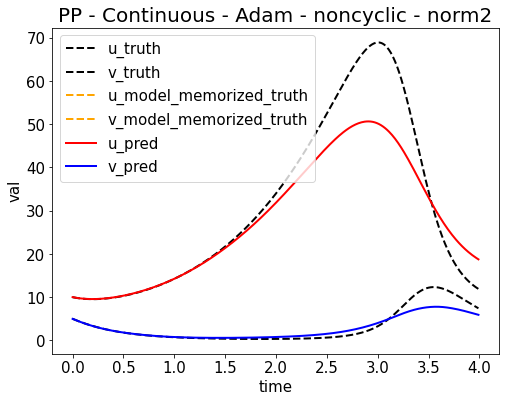

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545024.png


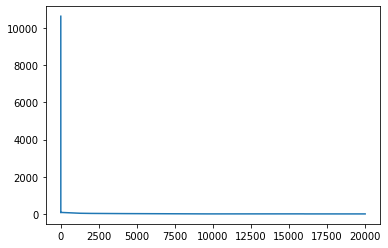

Epoch [22000/1000000] Loss:0.147235 Loss_1:0.008085 Loss_2:0.139150 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.608627s (2.71min in total, 120.31min remains)
Epoch [24000/1000000] Loss:0.101004 Loss_1:0.001256 Loss_2:0.099747 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.685053s (2.95min in total, 120.01min remains)
Epoch [26000/1000000] Loss:0.022009 Loss_1:0.000150 Loss_2:0.021859 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.599398s (3.19min in total, 119.67min remains)
Epoch [28000/1000000] Loss:0.022305 Loss_1:0.000034 Loss_2:0.022271 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.737828s (3.44min in total, 119.42min remains)
Epoch [30000/1000000] Loss:0.032119 Loss_1:0.001270 Loss_2:0.030849 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.660783s (3.68min in total, 119.13min remains)
Epoch [32000/1000000] Loss:0.017346 Loss_1:0.000154 Loss_2:0.017192 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.721495s (3.93min in total, 118.88min remains)
Epoc

<Figure size 432x288 with 0 Axes>

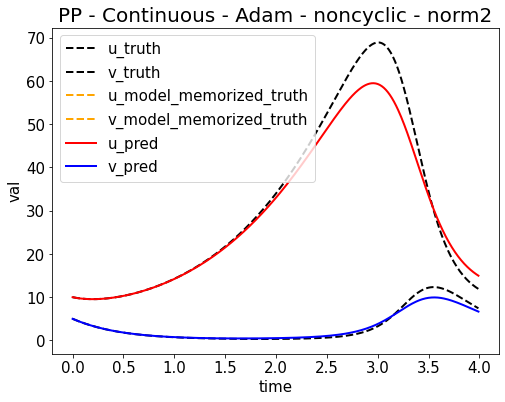

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545172.png


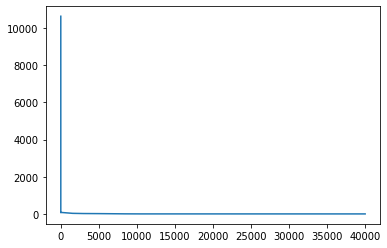

Epoch [42000/1000000] Loss:0.027518 Loss_1:0.002324 Loss_2:0.025194 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.677427s (5.17min in total, 117.96min remains)
Epoch [44000/1000000] Loss:0.009327 Loss_1:0.000031 Loss_2:0.009296 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.682512s (5.42min in total, 117.68min remains)
Epoch [46000/1000000] Loss:0.008933 Loss_1:0.000017 Loss_2:0.008915 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.609168s (5.66min in total, 117.38min remains)
Epoch [48000/1000000] Loss:0.011333 Loss_1:0.000042 Loss_2:0.011291 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.710477s (5.90min in total, 117.11min remains)
Epoch [50000/1000000] Loss:0.007902 Loss_1:0.000084 Loss_2:0.007818 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.825570s (6.15min in total, 116.89min remains)
Epoch [52000/1000000] Loss:0.032307 Loss_1:0.001366 Loss_2:0.030941 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.760031s (6.40min in total, 116.64min remains)
Epoc

<Figure size 432x288 with 0 Axes>

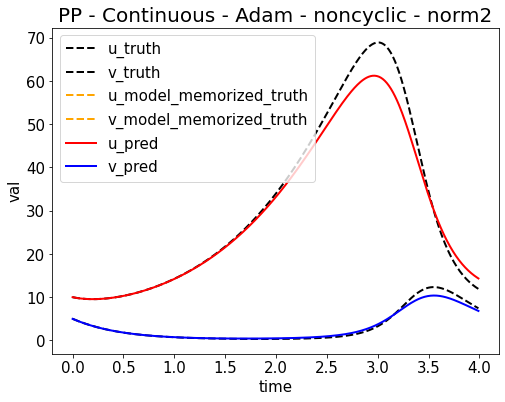

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545320.png


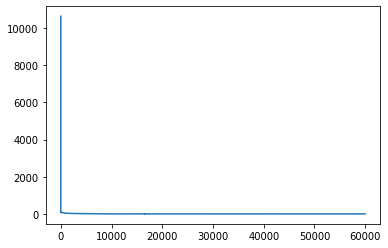

Epoch [62000/1000000] Loss:0.009880 Loss_1:0.000158 Loss_2:0.009721 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.747377s (7.64min in total, 115.55min remains)
Epoch [64000/1000000] Loss:0.005047 Loss_1:0.000005 Loss_2:0.005042 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.679085s (7.88min in total, 115.28min remains)
Epoch [66000/1000000] Loss:0.007007 Loss_1:0.000010 Loss_2:0.006997 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.755656s (8.13min in total, 115.03min remains)
Epoch [68000/1000000] Loss:0.005401 Loss_1:0.000007 Loss_2:0.005394 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.604282s (8.37min in total, 114.74min remains)
Epoch [70000/1000000] Loss:0.006760 Loss_1:0.000011 Loss_2:0.006749 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.693066s (8.62min in total, 114.48min remains)
Epoch [72000/1000000] Loss:0.041296 Loss_1:0.000212 Loss_2:0.041084 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.670062s (8.86min in total, 114.21min remains)
Epoc

<Figure size 432x288 with 0 Axes>

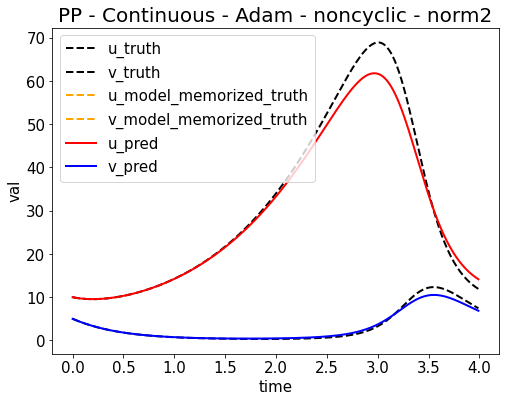

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545468.png


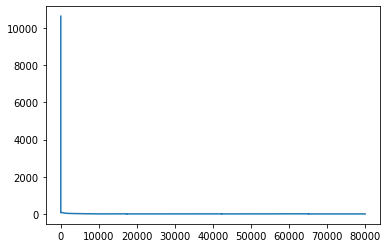

Epoch [82000/1000000] Loss:0.061319 Loss_1:0.000878 Loss_2:0.060441 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.827281s (10.10min in total, 113.07min remains)
Epoch [84000/1000000] Loss:0.003957 Loss_1:0.000013 Loss_2:0.003943 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.609143s (10.34min in total, 112.79min remains)
Epoch [86000/1000000] Loss:0.003808 Loss_1:0.000006 Loss_2:0.003802 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.540088s (10.59min in total, 112.50min remains)
Epoch [88000/1000000] Loss:0.096973 Loss_1:0.001775 Loss_2:0.095197 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.666556s (10.83min in total, 112.24min remains)
Epoch [90000/1000000] Loss:0.006172 Loss_1:0.000004 Loss_2:0.006169 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.676436s (11.07min in total, 111.98min remains)
Epoch [92000/1000000] Loss:0.004221 Loss_1:0.000009 Loss_2:0.004212 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.604522s (11.32min in total, 111.71min remains

<Figure size 432x288 with 0 Axes>

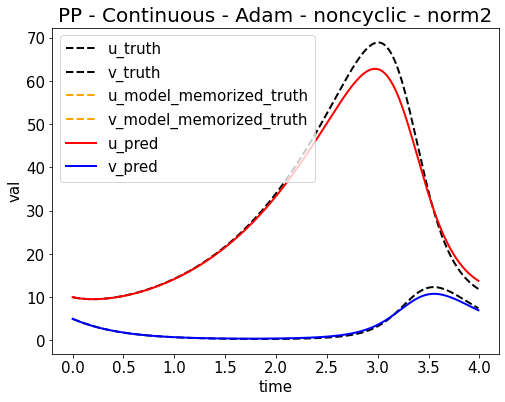

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545615.png


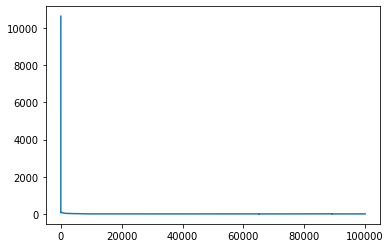

Epoch [102000/1000000] Loss:0.003143 Loss_1:0.000006 Loss_2:0.003137 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.685604s (12.56min in total, 110.54min remains)
Epoch [104000/1000000] Loss:0.003109 Loss_1:0.000008 Loss_2:0.003101 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.638710s (12.80min in total, 110.28min remains)
Epoch [106000/1000000] Loss:0.017485 Loss_1:0.000027 Loss_2:0.017458 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.705201s (13.05min in total, 110.02min remains)
Epoch [108000/1000000] Loss:0.016137 Loss_1:0.000192 Loss_2:0.015945 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.614408s (13.29min in total, 109.76min remains)
Epoch [110000/1000000] Loss:0.026013 Loss_1:0.000029 Loss_2:0.025983 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.535723s (13.53min in total, 109.48min remains)
Epoch [112000/1000000] Loss:0.032957 Loss_1:0.000466 Loss_2:0.032491 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.615179s (13.77min in total, 109.21min r

<Figure size 432x288 with 0 Axes>

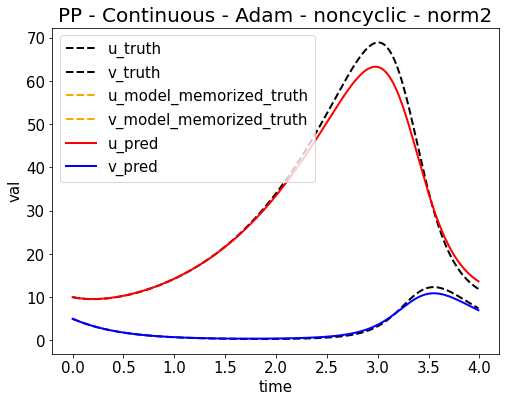

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545764.png


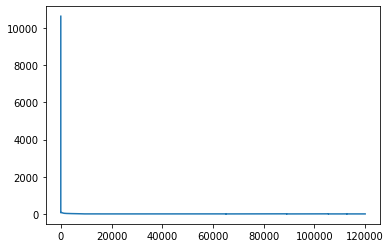

Epoch [122000/1000000] Loss:0.003678 Loss_1:0.000001 Loss_2:0.003676 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.970669s (15.04min in total, 108.21min remains)
Epoch [124000/1000000] Loss:0.002655 Loss_1:0.000007 Loss_2:0.002647 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.750463s (15.28min in total, 107.96min remains)
Epoch [126000/1000000] Loss:0.002526 Loss_1:0.000010 Loss_2:0.002516 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.772819s (15.53min in total, 107.71min remains)
Epoch [128000/1000000] Loss:0.016896 Loss_1:0.000129 Loss_2:0.016767 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.690736s (15.77min in total, 107.46min remains)
Epoch [130000/1000000] Loss:0.007149 Loss_1:0.000021 Loss_2:0.007127 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.605431s (16.02min in total, 107.19min remains)
Epoch [132000/1000000] Loss:0.002862 Loss_1:0.000007 Loss_2:0.002855 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.716989s (16.26min in total, 106.94min r

<Figure size 432x288 with 0 Axes>

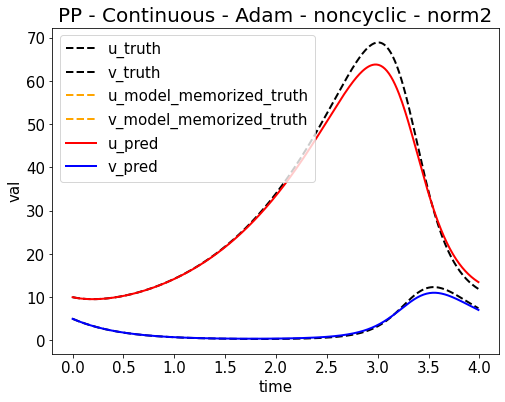

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653545912.png


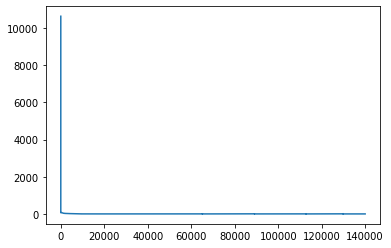

Epoch [142000/1000000] Loss:0.009012 Loss_1:0.000215 Loss_2:0.008797 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.681787s (17.50min in total, 105.72min remains)
Epoch [144000/1000000] Loss:0.007150 Loss_1:0.000017 Loss_2:0.007134 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.683934s (17.74min in total, 105.46min remains)
Epoch [146000/1000000] Loss:0.002258 Loss_1:0.000005 Loss_2:0.002253 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.532833s (17.98min in total, 105.19min remains)
Epoch [148000/1000000] Loss:0.018140 Loss_1:0.000062 Loss_2:0.018077 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.662929s (18.23min in total, 104.93min remains)
Epoch [150000/1000000] Loss:0.002042 Loss_1:0.000009 Loss_2:0.002033 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.594527s (18.47min in total, 104.67min remains)
Epoch [152000/1000000] Loss:0.004051 Loss_1:0.000007 Loss_2:0.004043 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.494736s (18.71min in total, 104.40min r

<Figure size 432x288 with 0 Axes>

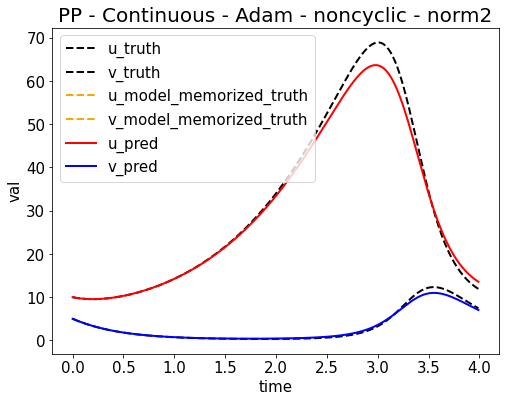

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546059.png


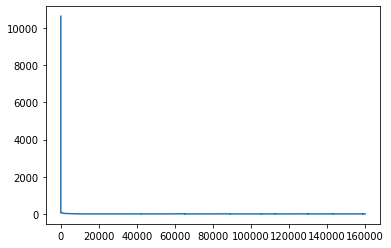

Epoch [162000/1000000] Loss:0.052684 Loss_1:0.000451 Loss_2:0.052233 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.778000s (19.95min in total, 103.21min remains)
Epoch [164000/1000000] Loss:0.001790 Loss_1:0.000002 Loss_2:0.001788 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.608494s (20.20min in total, 102.95min remains)
Epoch [166000/1000000] Loss:0.004339 Loss_1:0.000005 Loss_2:0.004333 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.524751s (20.44min in total, 102.68min remains)
Epoch [168000/1000000] Loss:0.004478 Loss_1:0.000145 Loss_2:0.004333 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.575466s (20.68min in total, 102.42min remains)
Epoch [170000/1000000] Loss:0.002298 Loss_1:0.000004 Loss_2:0.002293 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.725234s (20.93min in total, 102.17min remains)
Epoch [172000/1000000] Loss:0.092803 Loss_1:0.000561 Loss_2:0.092242 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.425570s (21.17min in total, 101.90min r

<Figure size 432x288 with 0 Axes>

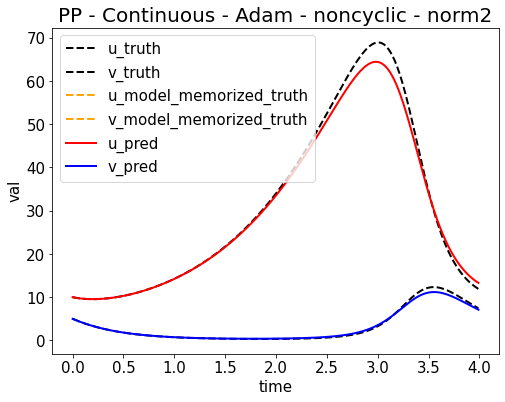

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546206.png


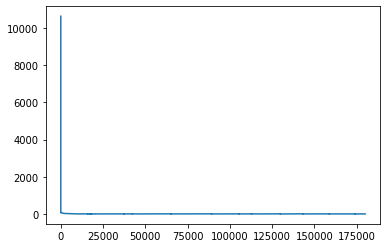

Epoch [182000/1000000] Loss:0.001950 Loss_1:0.000002 Loss_2:0.001947 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.918432s (22.40min in total, 100.69min remains)
Epoch [184000/1000000] Loss:0.001555 Loss_1:0.000003 Loss_2:0.001552 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.517709s (22.65min in total, 100.43min remains)
Epoch [186000/1000000] Loss:0.004189 Loss_1:0.000010 Loss_2:0.004179 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.638332s (22.89min in total, 100.17min remains)
Epoch [188000/1000000] Loss:0.001872 Loss_1:0.000003 Loss_2:0.001869 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.570879s (23.13min in total, 99.91min remains)
Epoch [190000/1000000] Loss:0.001622 Loss_1:0.000000 Loss_2:0.001622 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.600888s (23.38min in total, 99.65min remains)
Epoch [192000/1000000] Loss:0.002300 Loss_1:0.000007 Loss_2:0.002293 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.485874s (23.62min in total, 99.39min rema

<Figure size 432x288 with 0 Axes>

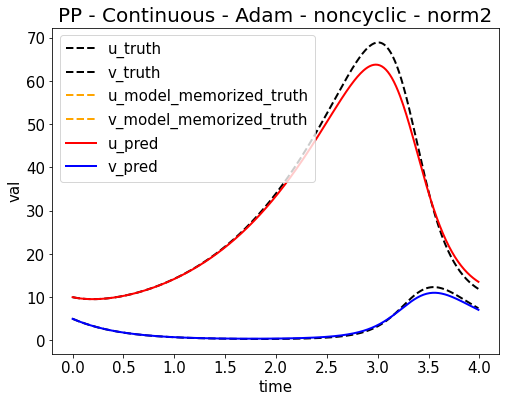

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546353.png


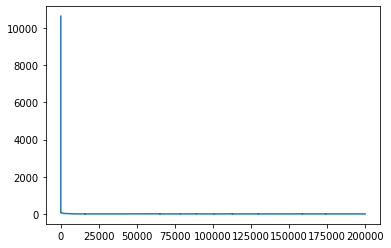

Epoch [202000/1000000] Loss:0.025764 Loss_1:0.000452 Loss_2:0.025312 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.895548s (24.86min in total, 98.19min remains)
Epoch [204000/1000000] Loss:0.001652 Loss_1:0.000004 Loss_2:0.001647 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.738693s (25.10min in total, 97.95min remains)
Epoch [206000/1000000] Loss:0.002785 Loss_1:0.000014 Loss_2:0.002772 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.510344s (25.34min in total, 97.68min remains)
Epoch [208000/1000000] Loss:0.001328 Loss_1:0.000004 Loss_2:0.001324 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.744185s (25.59min in total, 97.44min remains)
Epoch [210000/1000000] Loss:0.019835 Loss_1:0.000359 Loss_2:0.019475 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.549740s (25.83min in total, 97.18min remains)
Epoch [212000/1000000] Loss:0.008641 Loss_1:0.000420 Loss_2:0.008221 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.659343s (26.08min in total, 96.92min remains

<Figure size 432x288 with 0 Axes>

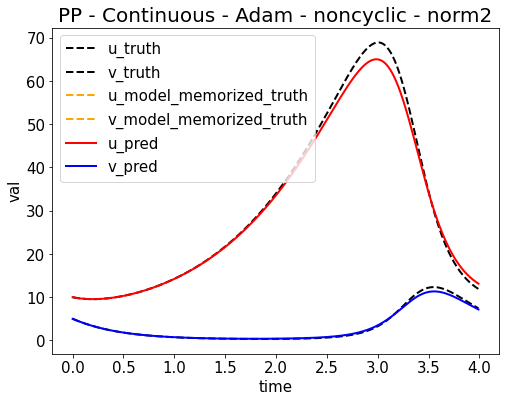

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546501.png


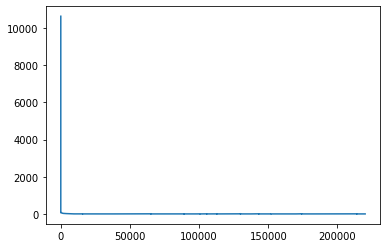

Epoch [222000/1000000] Loss:0.001750 Loss_1:0.000002 Loss_2:0.001748 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.952715s (27.32min in total, 95.73min remains)
Epoch [224000/1000000] Loss:0.001278 Loss_1:0.000001 Loss_2:0.001277 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.663064s (27.56min in total, 95.48min remains)
Epoch [226000/1000000] Loss:0.001339 Loss_1:0.000004 Loss_2:0.001335 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.587146s (27.80min in total, 95.22min remains)
Epoch [228000/1000000] Loss:0.002148 Loss_1:0.000002 Loss_2:0.002146 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.634923s (28.05min in total, 94.97min remains)
Epoch [230000/1000000] Loss:0.001334 Loss_1:0.000003 Loss_2:0.001331 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.627315s (28.29min in total, 94.71min remains)
Epoch [232000/1000000] Loss:0.001287 Loss_1:0.000011 Loss_2:0.001276 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.566934s (28.53min in total, 94.46min remains

<Figure size 432x288 with 0 Axes>

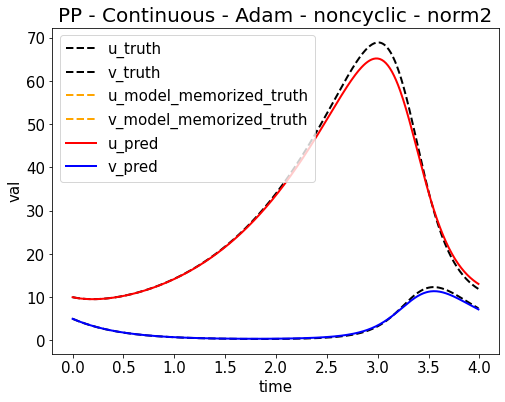

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546648.png


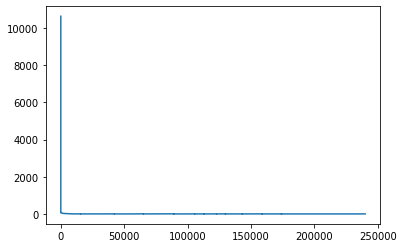

Epoch [242000/1000000] Loss:0.001468 Loss_1:0.000004 Loss_2:0.001464 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.866208s (29.77min in total, 93.26min remains)
Epoch [244000/1000000] Loss:0.001301 Loss_1:0.000004 Loss_2:0.001297 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.565997s (30.02min in total, 93.00min remains)
Epoch [246000/1000000] Loss:0.004020 Loss_1:0.000018 Loss_2:0.004002 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.537042s (30.26min in total, 92.74min remains)
Epoch [248000/1000000] Loss:0.001230 Loss_1:0.000020 Loss_2:0.001209 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.693159s (30.50min in total, 92.50min remains)
Epoch [250000/1000000] Loss:0.003289 Loss_1:0.000005 Loss_2:0.003284 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.667406s (30.75min in total, 92.24min remains)
Epoch [252000/1000000] Loss:0.002368 Loss_1:0.000031 Loss_2:0.002337 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.542727s (30.99min in total, 91.99min remains

<Figure size 432x288 with 0 Axes>

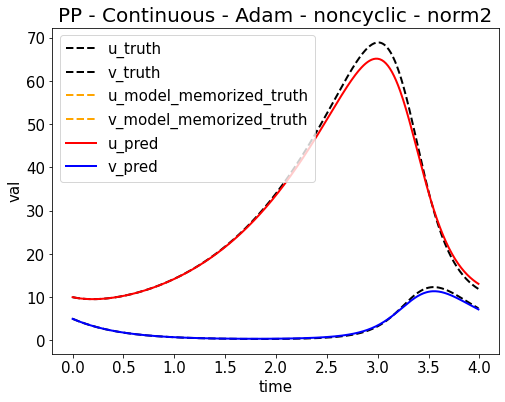

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546796.png


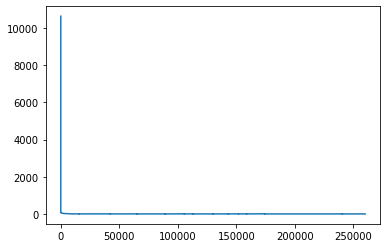

Epoch [262000/1000000] Loss:0.001098 Loss_1:0.000000 Loss_2:0.001098 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.107017s (32.24min in total, 90.80min remains)
Epoch [264000/1000000] Loss:0.006365 Loss_1:0.000015 Loss_2:0.006350 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.678988s (32.48min in total, 90.55min remains)
Epoch [266000/1000000] Loss:0.001917 Loss_1:0.000014 Loss_2:0.001902 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.620787s (32.72min in total, 90.30min remains)
Epoch [268000/1000000] Loss:0.001242 Loss_1:0.000002 Loss_2:0.001239 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.600664s (32.97min in total, 90.04min remains)
Epoch [270000/1000000] Loss:0.001489 Loss_1:0.000037 Loss_2:0.001452 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.726038s (33.21min in total, 89.80min remains)
Epoch [272000/1000000] Loss:0.041806 Loss_1:0.000301 Loss_2:0.041505 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.491813s (33.45min in total, 89.54min remains

<Figure size 432x288 with 0 Axes>

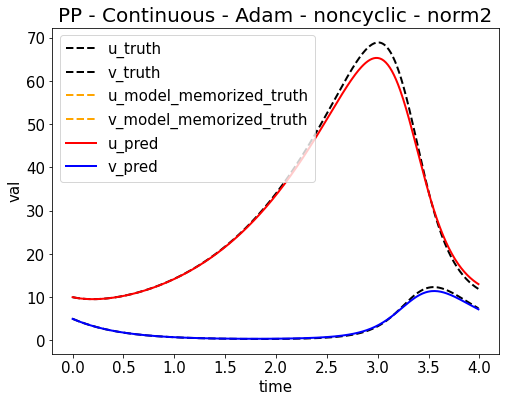

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653546943.png


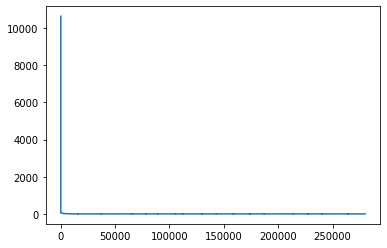

Epoch [282000/1000000] Loss:0.037876 Loss_1:0.000170 Loss_2:0.037706 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.913020s (34.69min in total, 88.33min remains)
Epoch [284000/1000000] Loss:0.002072 Loss_1:0.000003 Loss_2:0.002069 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.671345s (34.94min in total, 88.08min remains)
Epoch [286000/1000000] Loss:0.004906 Loss_1:0.000038 Loss_2:0.004868 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.638524s (35.18min in total, 87.83min remains)
Epoch [288000/1000000] Loss:0.001022 Loss_1:0.000004 Loss_2:0.001018 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.379404s (35.42min in total, 87.57min remains)
Epoch [290000/1000000] Loss:0.001409 Loss_1:0.000001 Loss_2:0.001408 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.466662s (35.66min in total, 87.31min remains)
Epoch [292000/1000000] Loss:0.001424 Loss_1:0.000003 Loss_2:0.001421 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.731346s (35.91min in total, 87.06min remains

<Figure size 432x288 with 0 Axes>

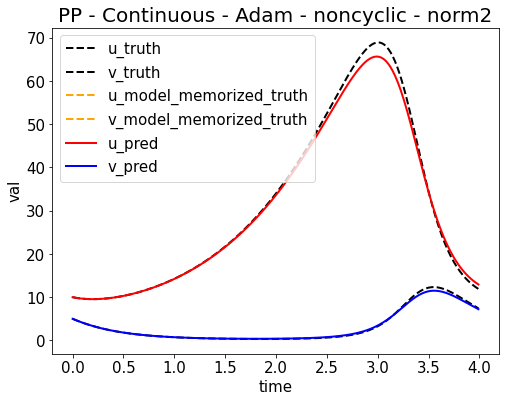

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547091.png


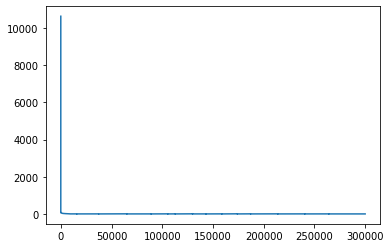

Epoch [302000/1000000] Loss:0.796941 Loss_1:0.001516 Loss_2:0.795425 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.262981s (37.16min in total, 85.88min remains)
Epoch [304000/1000000] Loss:0.001844 Loss_1:0.000009 Loss_2:0.001835 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.647612s (37.40min in total, 85.62min remains)
Epoch [306000/1000000] Loss:5.139128 Loss_1:0.443428 Loss_2:4.695700 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.713844s (37.64min in total, 85.38min remains)
Epoch [308000/1000000] Loss:0.001158 Loss_1:0.000003 Loss_2:0.001155 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.657289s (37.89min in total, 85.13min remains)
Epoch [310000/1000000] Loss:0.007116 Loss_1:0.000030 Loss_2:0.007086 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.649852s (38.13min in total, 84.88min remains)
Epoch [312000/1000000] Loss:0.001534 Loss_1:0.000004 Loss_2:0.001530 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.590297s (38.38min in total, 84.62min remains

<Figure size 432x288 with 0 Axes>

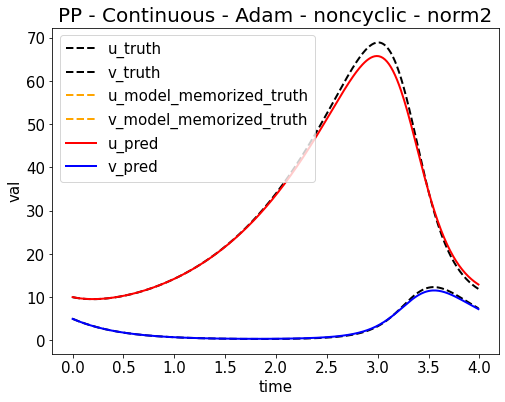

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547239.png


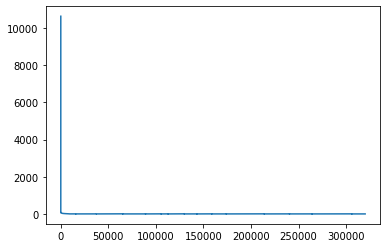

Epoch [322000/1000000] Loss:0.001125 Loss_1:0.000001 Loss_2:0.001123 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.982426s (39.61min in total, 83.41min remains)
Epoch [324000/1000000] Loss:0.000913 Loss_1:0.000004 Loss_2:0.000909 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.661209s (39.86min in total, 83.16min remains)
Epoch [326000/1000000] Loss:0.043283 Loss_1:0.000258 Loss_2:0.043025 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.759868s (40.10min in total, 82.92min remains)
Epoch [328000/1000000] Loss:0.017440 Loss_1:0.000184 Loss_2:0.017256 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.515736s (40.35min in total, 82.66min remains)
Epoch [330000/1000000] Loss:0.001675 Loss_1:0.000026 Loss_2:0.001649 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.693599s (40.59min in total, 82.41min remains)
Epoch [332000/1000000] Loss:0.000783 Loss_1:0.000001 Loss_2:0.000782 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.716917s (40.84min in total, 82.17min remains

<Figure size 432x288 with 0 Axes>

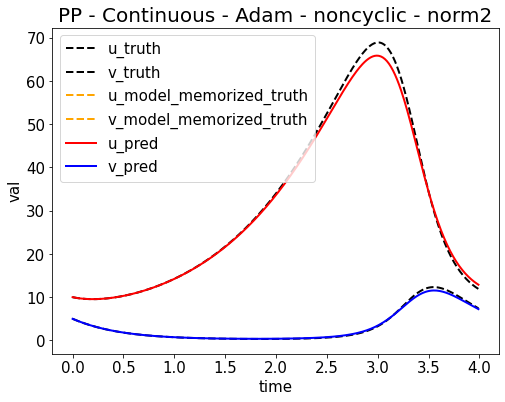

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547387.png


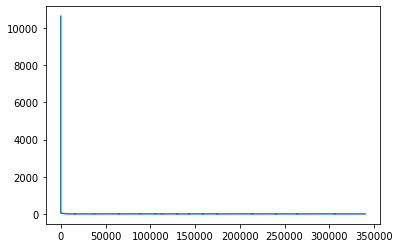

Epoch [342000/1000000] Loss:0.020848 Loss_1:0.000160 Loss_2:0.020687 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.265738s (42.09min in total, 80.98min remains)
Epoch [344000/1000000] Loss:0.000823 Loss_1:0.000002 Loss_2:0.000821 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.586235s (42.33min in total, 80.73min remains)
Epoch [346000/1000000] Loss:0.000720 Loss_1:0.000001 Loss_2:0.000719 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.623476s (42.58min in total, 80.47min remains)
Epoch [348000/1000000] Loss:0.002023 Loss_1:0.000008 Loss_2:0.002015 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.649327s (42.82min in total, 80.22min remains)
Epoch [350000/1000000] Loss:0.000905 Loss_1:0.000002 Loss_2:0.000902 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.734821s (43.06min in total, 79.98min remains)
Epoch [352000/1000000] Loss:0.001277 Loss_1:0.000004 Loss_2:0.001273 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.726186s (43.31min in total, 79.73min remains

<Figure size 432x288 with 0 Axes>

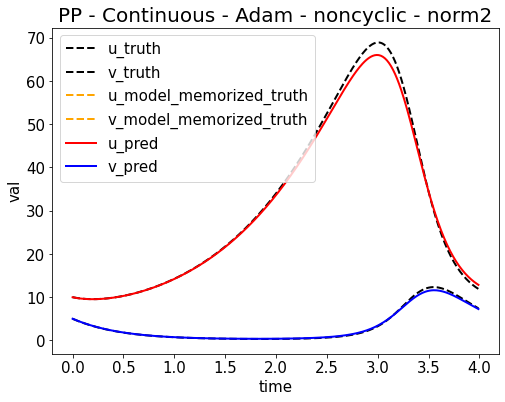

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547535.png


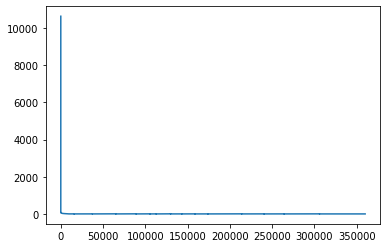

Epoch [362000/1000000] Loss:0.000778 Loss_1:0.000002 Loss_2:0.000776 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.210854s (44.56min in total, 78.53min remains)
Epoch [364000/1000000] Loss:0.016710 Loss_1:0.000240 Loss_2:0.016470 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.487395s (44.80min in total, 78.28min remains)
Epoch [366000/1000000] Loss:0.002022 Loss_1:0.000015 Loss_2:0.002007 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.747526s (45.05min in total, 78.03min remains)
Epoch [368000/1000000] Loss:0.001085 Loss_1:0.000001 Loss_2:0.001084 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.662496s (45.29min in total, 77.78min remains)
Epoch [370000/1000000] Loss:0.000806 Loss_1:0.000002 Loss_2:0.000804 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.563419s (45.53min in total, 77.53min remains)
Epoch [372000/1000000] Loss:0.008745 Loss_1:0.000004 Loss_2:0.008741 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.611730s (45.78min in total, 77.28min remains

<Figure size 432x288 with 0 Axes>

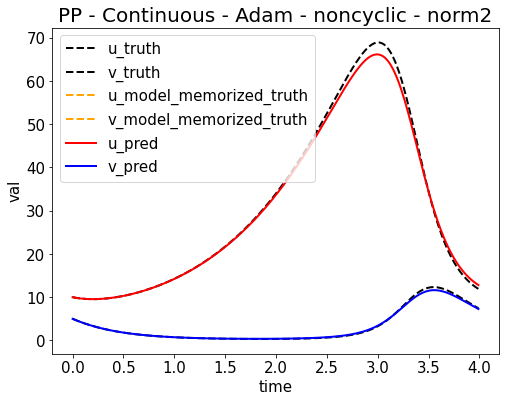

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547683.png


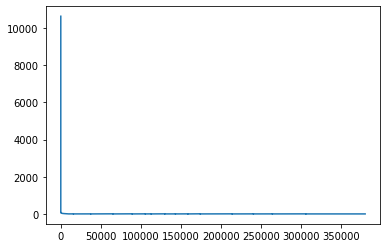

Epoch [382000/1000000] Loss:0.001613 Loss_1:0.000002 Loss_2:0.001610 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.993023s (47.02min in total, 76.06min remains)
Epoch [384000/1000000] Loss:0.000771 Loss_1:0.000003 Loss_2:0.000768 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.604976s (47.26min in total, 75.81min remains)
Epoch [386000/1000000] Loss:0.001060 Loss_1:0.000073 Loss_2:0.000986 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.580465s (47.50min in total, 75.56min remains)
Epoch [388000/1000000] Loss:0.000863 Loss_1:0.000000 Loss_2:0.000862 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.654404s (47.75min in total, 75.31min remains)
Epoch [390000/1000000] Loss:0.000772 Loss_1:0.000002 Loss_2:0.000770 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.756607s (47.99min in total, 75.07min remains)
Epoch [392000/1000000] Loss:0.003513 Loss_1:0.000052 Loss_2:0.003461 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.678648s (48.24min in total, 74.82min remains

<Figure size 432x288 with 0 Axes>

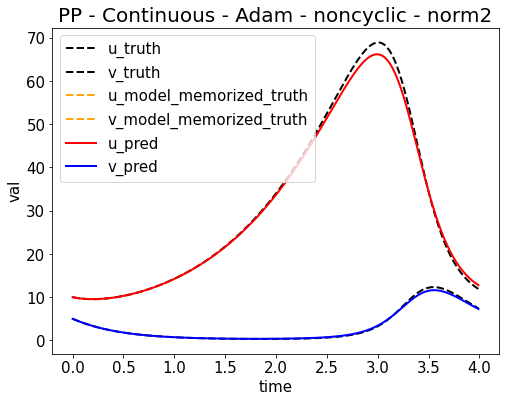

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547830.png


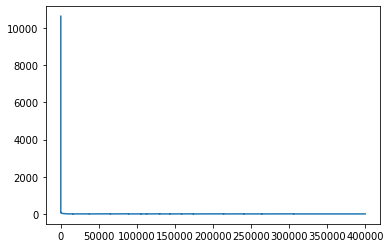

Epoch [402000/1000000] Loss:0.013913 Loss_1:0.000066 Loss_2:0.013847 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.224077s (49.48min in total, 73.61min remains)
Epoch [404000/1000000] Loss:0.135369 Loss_1:0.003195 Loss_2:0.132174 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.553108s (49.72min in total, 73.35min remains)
Epoch [406000/1000000] Loss:0.000723 Loss_1:0.000002 Loss_2:0.000720 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.547824s (49.97min in total, 73.10min remains)
Epoch [408000/1000000] Loss:0.001991 Loss_1:0.000008 Loss_2:0.001982 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.651534s (50.21min in total, 72.85min remains)
Epoch [410000/1000000] Loss:0.001641 Loss_1:0.000004 Loss_2:0.001637 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.641686s (50.45min in total, 72.61min remains)
Epoch [412000/1000000] Loss:0.000764 Loss_1:0.000002 Loss_2:0.000762 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.527543s (50.70min in total, 72.35min remains

<Figure size 432x288 with 0 Axes>

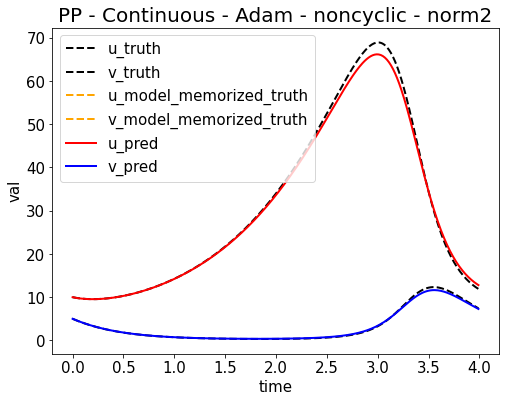

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653547978.png


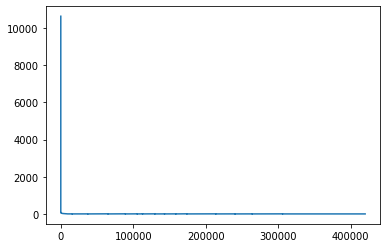

Epoch [422000/1000000] Loss:0.000858 Loss_1:0.000001 Loss_2:0.000857 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.500012s (51.95min in total, 71.15min remains)
Epoch [424000/1000000] Loss:0.005343 Loss_1:0.000106 Loss_2:0.005237 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.603139s (52.19min in total, 70.90min remains)
Epoch [426000/1000000] Loss:0.006940 Loss_1:0.000009 Loss_2:0.006930 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.523856s (52.43min in total, 70.65min remains)
Epoch [428000/1000000] Loss:0.002128 Loss_1:0.000017 Loss_2:0.002111 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.524161s (52.68min in total, 70.40min remains)
Epoch [430000/1000000] Loss:0.000804 Loss_1:0.000002 Loss_2:0.000802 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.563071s (52.92min in total, 70.15min remains)
Epoch [432000/1000000] Loss:0.000639 Loss_1:0.000007 Loss_2:0.000631 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.620177s (53.16min in total, 69.90min remains

<Figure size 432x288 with 0 Axes>

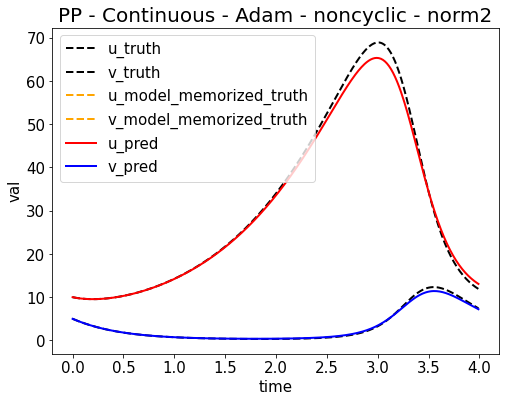

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548126.png


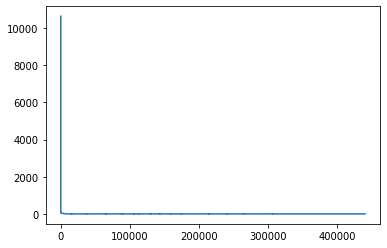

Epoch [442000/1000000] Loss:0.004363 Loss_1:0.000020 Loss_2:0.004342 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.216050s (54.41min in total, 68.69min remains)
Epoch [444000/1000000] Loss:0.000907 Loss_1:0.000003 Loss_2:0.000904 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.607529s (54.65min in total, 68.44min remains)
Epoch [446000/1000000] Loss:0.001697 Loss_1:0.000006 Loss_2:0.001691 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.460153s (54.90min in total, 68.19min remains)
Epoch [448000/1000000] Loss:0.001197 Loss_1:0.000005 Loss_2:0.001192 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.635826s (55.14min in total, 67.94min remains)
Epoch [450000/1000000] Loss:0.001299 Loss_1:0.000052 Loss_2:0.001247 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.639175s (55.38min in total, 67.69min remains)
Epoch [452000/1000000] Loss:0.000544 Loss_1:0.000001 Loss_2:0.000543 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.515391s (55.62min in total, 67.44min remains

<Figure size 432x288 with 0 Axes>

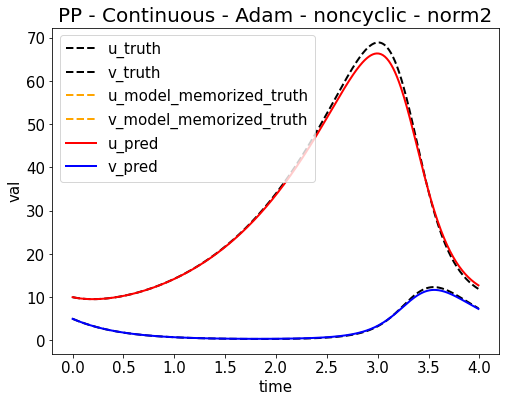

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548273.png


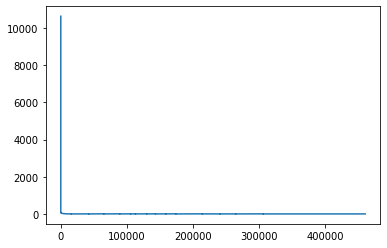

Epoch [462000/1000000] Loss:0.002044 Loss_1:0.000116 Loss_2:0.001927 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.298399s (56.87min in total, 66.22min remains)
Epoch [464000/1000000] Loss:0.000568 Loss_1:0.000001 Loss_2:0.000567 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.481902s (57.11min in total, 65.97min remains)
Epoch [466000/1000000] Loss:0.002955 Loss_1:0.000026 Loss_2:0.002929 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.580158s (57.35min in total, 65.72min remains)
Epoch [468000/1000000] Loss:0.000872 Loss_1:0.000000 Loss_2:0.000871 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.699558s (57.60min in total, 65.47min remains)
Epoch [470000/1000000] Loss:0.000555 Loss_1:0.000001 Loss_2:0.000554 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.588691s (57.84min in total, 65.22min remains)
Epoch [472000/1000000] Loss:0.001067 Loss_1:0.000002 Loss_2:0.001065 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.613364s (58.08min in total, 64.98min remains

<Figure size 432x288 with 0 Axes>

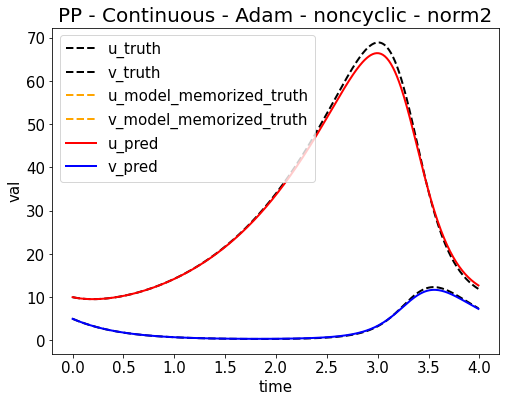

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548421.png


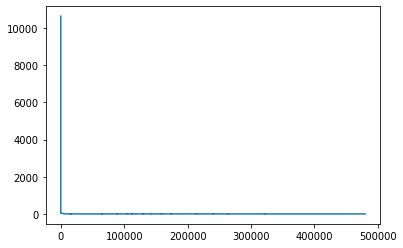

Epoch [482000/1000000] Loss:0.001274 Loss_1:0.000001 Loss_2:0.001273 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.191520s (59.33min in total, 63.76min remains)
Epoch [484000/1000000] Loss:0.000835 Loss_1:0.000002 Loss_2:0.000833 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.629805s (59.57min in total, 63.51min remains)
Epoch [486000/1000000] Loss:0.005205 Loss_1:0.000015 Loss_2:0.005190 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.519719s (59.81min in total, 63.26min remains)
Epoch [488000/1000000] Loss:0.001245 Loss_1:0.000045 Loss_2:0.001200 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.734312s (60.06min in total, 63.01min remains)
Epoch [490000/1000000] Loss:0.020236 Loss_1:0.000145 Loss_2:0.020091 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.569767s (60.30min in total, 62.76min remains)
Epoch [492000/1000000] Loss:0.001138 Loss_1:0.000002 Loss_2:0.001137 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.634730s (60.55min in total, 62.51min remains

<Figure size 432x288 with 0 Axes>

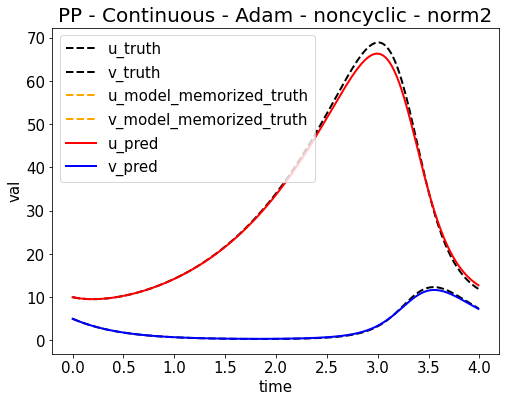

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548569.png


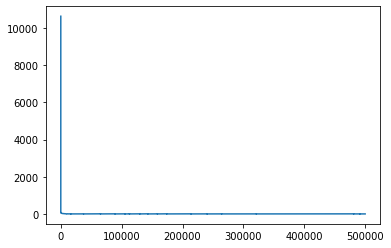

Epoch [502000/1000000] Loss:0.000826 Loss_1:0.000001 Loss_2:0.000825 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.559865s (61.80min in total, 61.31min remains)
Epoch [504000/1000000] Loss:0.000553 Loss_1:0.000001 Loss_2:0.000552 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.522326s (62.06min in total, 61.07min remains)
Epoch [506000/1000000] Loss:0.042257 Loss_1:0.001884 Loss_2:0.040373 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.037964s (62.31min in total, 60.83min remains)
Epoch [508000/1000000] Loss:0.000841 Loss_1:0.000004 Loss_2:0.000837 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.963237s (62.56min in total, 60.59min remains)
Epoch [510000/1000000] Loss:0.000599 Loss_1:0.000001 Loss_2:0.000597 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.803067s (62.80min in total, 60.34min remains)
Epoch [512000/1000000] Loss:0.001314 Loss_1:0.000002 Loss_2:0.001312 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.662921s (63.05min in total, 60.09min remains

<Figure size 432x288 with 0 Axes>

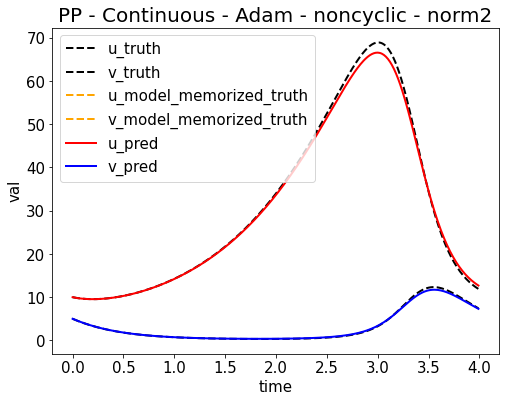

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548720.png


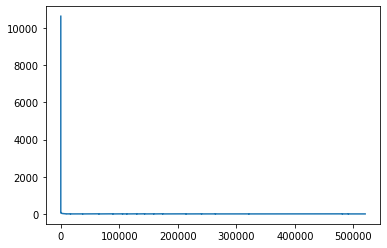

Epoch [522000/1000000] Loss:0.001584 Loss_1:0.000033 Loss_2:0.001551 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.613909s (64.31min in total, 58.89min remains)
Epoch [524000/1000000] Loss:0.000474 Loss_1:0.000001 Loss_2:0.000473 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.921622s (64.56min in total, 58.65min remains)
Epoch [526000/1000000] Loss:0.019104 Loss_1:0.000031 Loss_2:0.019072 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.998301s (64.81min in total, 58.41min remains)
Epoch [528000/1000000] Loss:0.008191 Loss_1:0.000241 Loss_2:0.007950 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.189082s (65.07min in total, 58.16min remains)
Epoch [530000/1000000] Loss:0.001170 Loss_1:0.000032 Loss_2:0.001138 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.799419s (65.31min in total, 57.92min remains)
Epoch [532000/1000000] Loss:0.005420 Loss_1:0.000106 Loss_2:0.005314 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.264924s (65.57min in total, 57.68min remains

<Figure size 432x288 with 0 Axes>

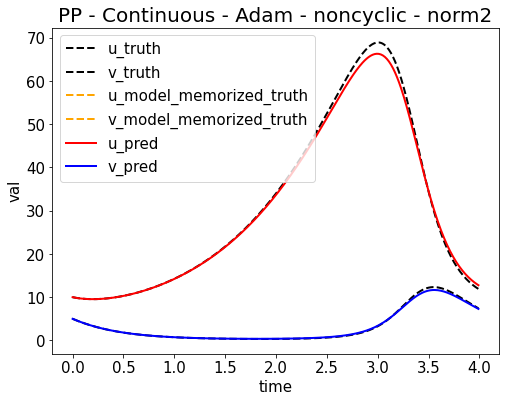

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653548872.png


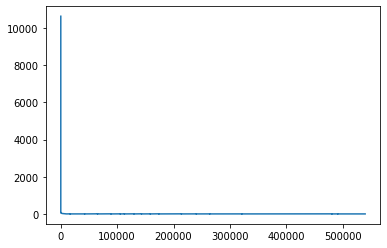

Epoch [542000/1000000] Loss:0.000540 Loss_1:0.000003 Loss_2:0.000537 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.769982s (66.85min in total, 56.49min remains)
Epoch [544000/1000000] Loss:0.011716 Loss_1:0.000051 Loss_2:0.011665 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.848441s (67.10min in total, 56.24min remains)
Epoch [546000/1000000] Loss:0.000469 Loss_1:0.000001 Loss_2:0.000468 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.977237s (67.34min in total, 56.00min remains)
Epoch [548000/1000000] Loss:0.001135 Loss_1:0.000000 Loss_2:0.001135 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.200576s (67.60min in total, 55.76min remains)
Epoch [550000/1000000] Loss:0.003125 Loss_1:0.000238 Loss_2:0.002886 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.252919s (67.85min in total, 55.52min remains)
Epoch [552000/1000000] Loss:0.096039 Loss_1:0.000547 Loss_2:0.095492 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.908196s (68.10min in total, 55.27min remains

<Figure size 432x288 with 0 Axes>

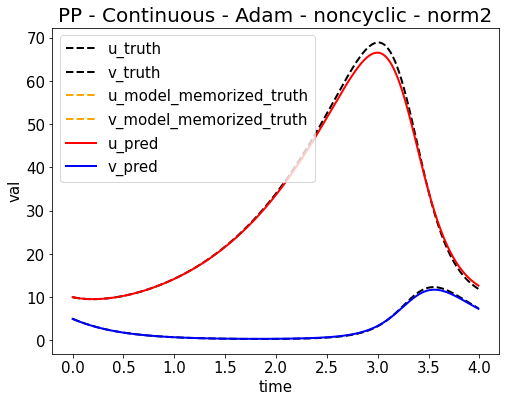

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549024.png


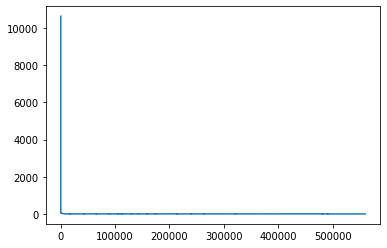

Epoch [562000/1000000] Loss:0.000518 Loss_1:0.000006 Loss_2:0.000512 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.766877s (69.39min in total, 54.08min remains)
Epoch [564000/1000000] Loss:0.000667 Loss_1:0.000001 Loss_2:0.000665 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.654421s (69.63min in total, 53.83min remains)
Epoch [566000/1000000] Loss:0.000405 Loss_1:0.000000 Loss_2:0.000404 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.684142s (69.88min in total, 53.58min remains)
Epoch [568000/1000000] Loss:0.001462 Loss_1:0.000003 Loss_2:0.001459 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.777828s (70.12min in total, 53.33min remains)
Epoch [570000/1000000] Loss:0.051245 Loss_1:0.000420 Loss_2:0.050825 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.748709s (70.37min in total, 53.09min remains)
Epoch [572000/1000000] Loss:0.004102 Loss_1:0.000006 Loss_2:0.004095 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.686316s (70.62min in total, 52.84min remains

<Figure size 432x288 with 0 Axes>

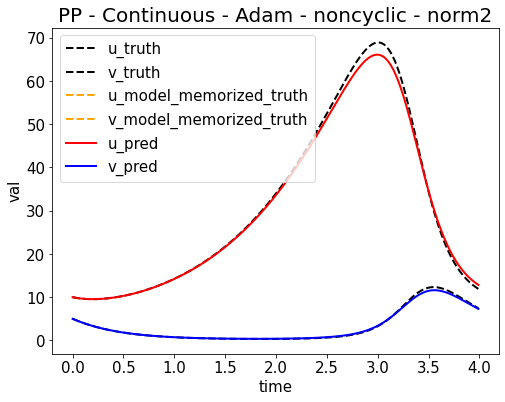

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549173.png


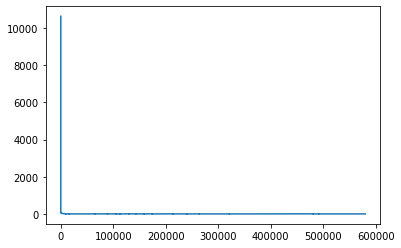

Epoch [582000/1000000] Loss:0.019578 Loss_1:0.000206 Loss_2:0.019371 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.408139s (71.87min in total, 51.62min remains)
Epoch [584000/1000000] Loss:0.000834 Loss_1:0.000006 Loss_2:0.000827 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.742807s (72.11min in total, 51.37min remains)
Epoch [586000/1000000] Loss:0.000523 Loss_1:0.000000 Loss_2:0.000523 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.663605s (72.36min in total, 51.12min remains)
Epoch [588000/1000000] Loss:0.001094 Loss_1:0.000014 Loss_2:0.001080 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.527986s (72.60min in total, 50.87min remains)
Epoch [590000/1000000] Loss:0.000453 Loss_1:0.000001 Loss_2:0.000452 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.531944s (72.84min in total, 50.62min remains)
Epoch [592000/1000000] Loss:0.004009 Loss_1:0.000026 Loss_2:0.003983 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.651380s (73.09min in total, 50.37min remains

<Figure size 432x288 with 0 Axes>

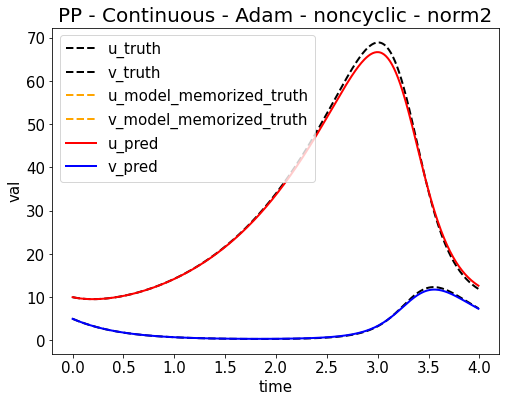

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549321.png


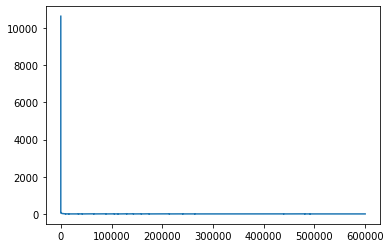

Epoch [602000/1000000] Loss:0.002448 Loss_1:0.000017 Loss_2:0.002431 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.463432s (74.33min in total, 49.14min remains)
Epoch [604000/1000000] Loss:0.001829 Loss_1:0.000012 Loss_2:0.001817 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.774038s (74.58min in total, 48.90min remains)
Epoch [606000/1000000] Loss:0.043974 Loss_1:0.000260 Loss_2:0.043713 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.633599s (74.82min in total, 48.65min remains)
Epoch [608000/1000000] Loss:0.006837 Loss_1:0.000013 Loss_2:0.006824 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.708788s (75.07min in total, 48.40min remains)
Epoch [610000/1000000] Loss:0.004995 Loss_1:0.000053 Loss_2:0.004942 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.712296s (75.31min in total, 48.15min remains)
Epoch [612000/1000000] Loss:0.000458 Loss_1:0.000002 Loss_2:0.000456 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.781086s (75.56min in total, 47.90min remains

<Figure size 432x288 with 0 Axes>

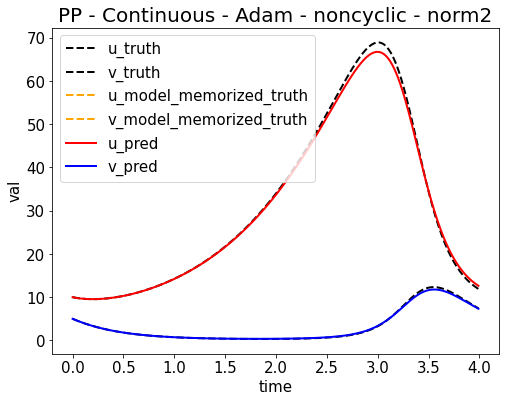

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549470.png


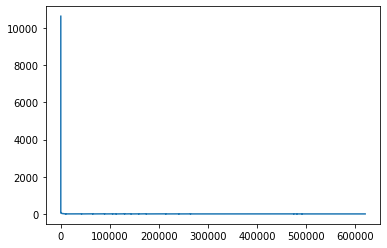

Epoch [622000/1000000] Loss:0.001172 Loss_1:0.000052 Loss_2:0.001120 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.908218s (76.82min in total, 46.69min remains)
Epoch [624000/1000000] Loss:0.003090 Loss_1:0.000045 Loss_2:0.003045 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.677668s (77.07min in total, 46.44min remains)
Epoch [626000/1000000] Loss:0.000455 Loss_1:0.000001 Loss_2:0.000453 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.756638s (77.31min in total, 46.19min remains)
Epoch [628000/1000000] Loss:0.001465 Loss_1:0.000030 Loss_2:0.001435 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.622391s (77.56min in total, 45.94min remains)
Epoch [630000/1000000] Loss:0.000582 Loss_1:0.000000 Loss_2:0.000581 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.663738s (77.80min in total, 45.69min remains)
Epoch [632000/1000000] Loss:0.007659 Loss_1:0.000010 Loss_2:0.007649 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.611916s (78.05min in total, 45.44min remains

<Figure size 432x288 with 0 Axes>

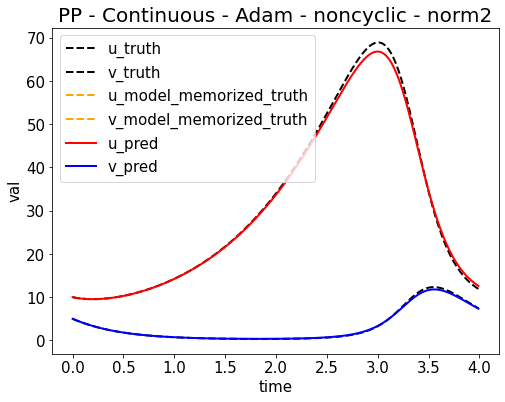

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549618.png


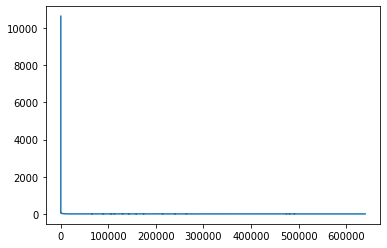

Epoch [642000/1000000] Loss:0.002474 Loss_1:0.000005 Loss_2:0.002469 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.567188s (79.29min in total, 44.21min remains)
Epoch [644000/1000000] Loss:0.001086 Loss_1:0.000012 Loss_2:0.001073 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.710589s (79.53min in total, 43.96min remains)
Epoch [646000/1000000] Loss:0.000505 Loss_1:0.000003 Loss_2:0.000502 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.832734s (79.78min in total, 43.72min remains)
Epoch [648000/1000000] Loss:0.000958 Loss_1:0.000021 Loss_2:0.000937 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.755796s (80.02min in total, 43.47min remains)
Epoch [650000/1000000] Loss:0.002251 Loss_1:0.000023 Loss_2:0.002227 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.834388s (80.27min in total, 43.22min remains)
Epoch [652000/1000000] Loss:0.000907 Loss_1:0.000037 Loss_2:0.000870 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.714303s (80.52min in total, 42.98min remains

<Figure size 432x288 with 0 Axes>

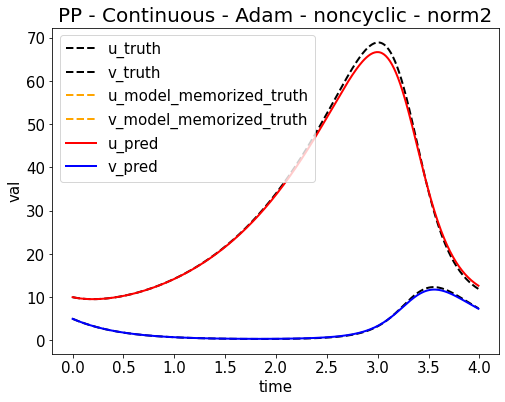

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549768.png


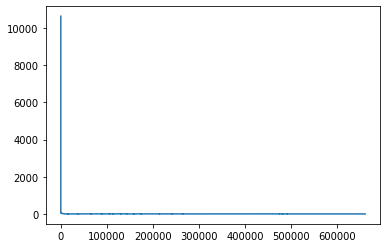

Epoch [662000/1000000] Loss:0.000709 Loss_1:0.000116 Loss_2:0.000593 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.840935s (81.78min in total, 41.75min remains)
Epoch [664000/1000000] Loss:0.003030 Loss_1:0.000059 Loss_2:0.002971 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.585119s (82.02min in total, 41.50min remains)
Epoch [666000/1000000] Loss:0.000394 Loss_1:0.000001 Loss_2:0.000392 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.676355s (82.27min in total, 41.26min remains)
Epoch [668000/1000000] Loss:0.000387 Loss_1:0.000000 Loss_2:0.000386 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.651386s (82.51min in total, 41.01min remains)
Epoch [670000/1000000] Loss:0.000598 Loss_1:0.000000 Loss_2:0.000598 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.652003s (82.75min in total, 40.76min remains)
Epoch [672000/1000000] Loss:0.001368 Loss_1:0.000006 Loss_2:0.001362 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.694167s (83.00min in total, 40.51min remains

<Figure size 432x288 with 0 Axes>

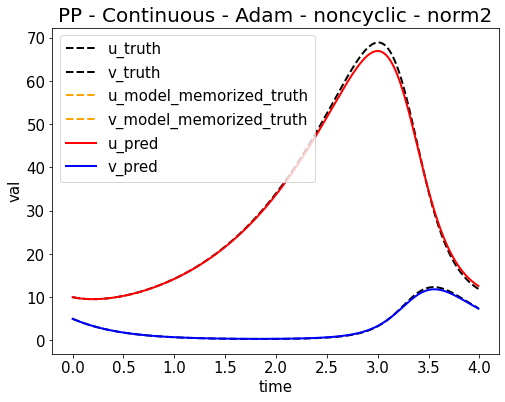

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653549916.png


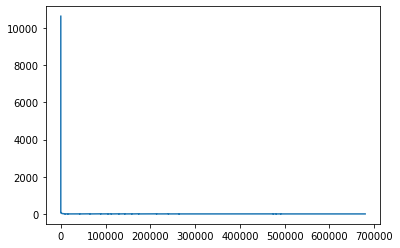

Epoch [682000/1000000] Loss:0.000398 Loss_1:0.000001 Loss_2:0.000397 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.760141s (84.26min in total, 39.29min remains)
Epoch [684000/1000000] Loss:0.000476 Loss_1:0.000002 Loss_2:0.000473 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.693347s (84.50min in total, 39.04min remains)
Epoch [686000/1000000] Loss:0.001081 Loss_1:0.000001 Loss_2:0.001081 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.510042s (84.74min in total, 38.79min remains)
Epoch [688000/1000000] Loss:0.001452 Loss_1:0.000003 Loss_2:0.001449 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.698979s (84.99min in total, 38.54min remains)
Epoch [690000/1000000] Loss:0.004702 Loss_1:0.000027 Loss_2:0.004675 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.671091s (85.23min in total, 38.29min remains)
Epoch [692000/1000000] Loss:0.000496 Loss_1:0.000000 Loss_2:0.000496 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.641749s (85.48min in total, 38.04min remains

<Figure size 432x288 with 0 Axes>

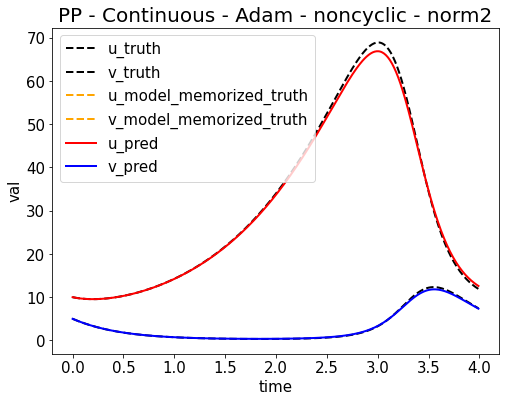

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550065.png


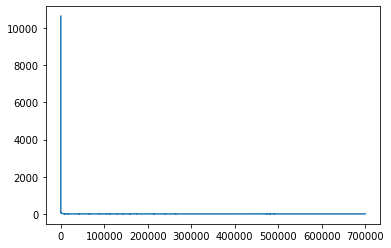

Epoch [702000/1000000] Loss:0.001115 Loss_1:0.000000 Loss_2:0.001114 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.672832s (86.74min in total, 36.82min remains)
Epoch [704000/1000000] Loss:0.000440 Loss_1:0.000002 Loss_2:0.000438 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.809709s (86.99min in total, 36.57min remains)
Epoch [706000/1000000] Loss:0.000506 Loss_1:0.000001 Loss_2:0.000505 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.823406s (87.23min in total, 36.33min remains)
Epoch [708000/1000000] Loss:0.002291 Loss_1:0.000002 Loss_2:0.002288 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.879661s (87.48min in total, 36.08min remains)
Epoch [710000/1000000] Loss:0.000430 Loss_1:0.000001 Loss_2:0.000429 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.906281s (87.73min in total, 35.83min remains)
Epoch [712000/1000000] Loss:0.004425 Loss_1:0.000053 Loss_2:0.004372 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.866752s (87.98min in total, 35.59min remains

<Figure size 432x288 with 0 Axes>

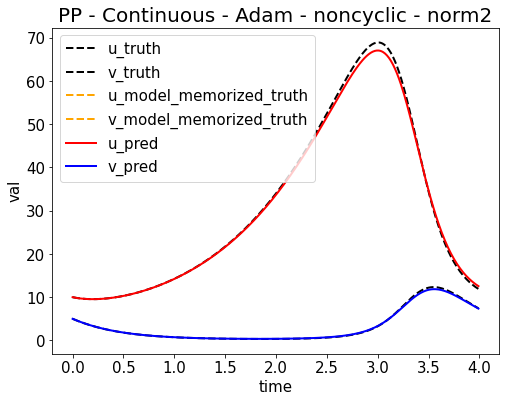

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550215.png


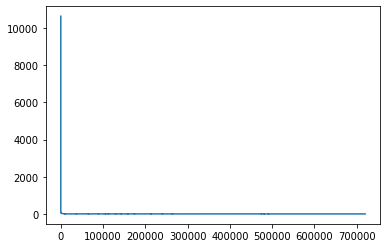

Epoch [722000/1000000] Loss:0.002310 Loss_1:0.000018 Loss_2:0.002291 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.072893s (89.24min in total, 34.36min remains)
Epoch [724000/1000000] Loss:0.001083 Loss_1:0.000007 Loss_2:0.001075 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.871972s (89.49min in total, 34.12min remains)
Epoch [726000/1000000] Loss:0.004183 Loss_1:0.000077 Loss_2:0.004106 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.680110s (89.74min in total, 33.87min remains)
Epoch [728000/1000000] Loss:0.000528 Loss_1:0.000004 Loss_2:0.000525 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.829941s (89.98min in total, 33.62min remains)
Epoch [730000/1000000] Loss:0.034494 Loss_1:0.000047 Loss_2:0.034446 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.725910s (90.23min in total, 33.37min remains)
Epoch [732000/1000000] Loss:0.000418 Loss_1:0.000001 Loss_2:0.000416 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.817271s (90.48min in total, 33.13min remains

<Figure size 432x288 with 0 Axes>

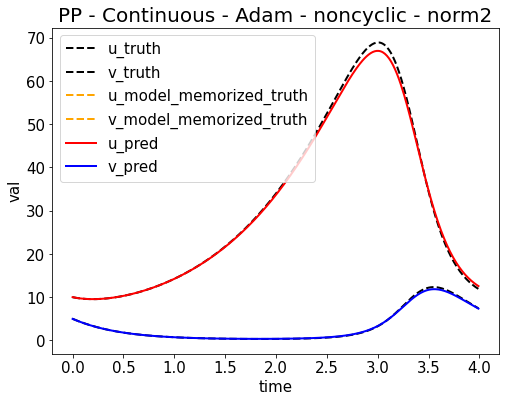

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550365.png


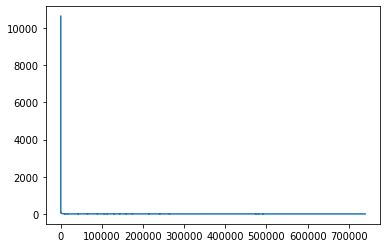

Epoch [742000/1000000] Loss:0.004285 Loss_1:0.000142 Loss_2:0.004143 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.861121s (91.73min in total, 31.90min remains)
Epoch [744000/1000000] Loss:0.001713 Loss_1:0.000007 Loss_2:0.001706 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.487094s (91.98min in total, 31.65min remains)
Epoch [746000/1000000] Loss:0.001235 Loss_1:0.000005 Loss_2:0.001230 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.799643s (92.22min in total, 31.40min remains)
Epoch [748000/1000000] Loss:0.002968 Loss_1:0.000013 Loss_2:0.002955 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.724675s (92.47min in total, 31.15min remains)
Epoch [750000/1000000] Loss:0.026621 Loss_1:0.000022 Loss_2:0.026598 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.725865s (92.71min in total, 30.90min remains)
Epoch [752000/1000000] Loss:0.000660 Loss_1:0.000002 Loss_2:0.000658 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.766809s (92.96min in total, 30.66min remains

<Figure size 432x288 with 0 Axes>

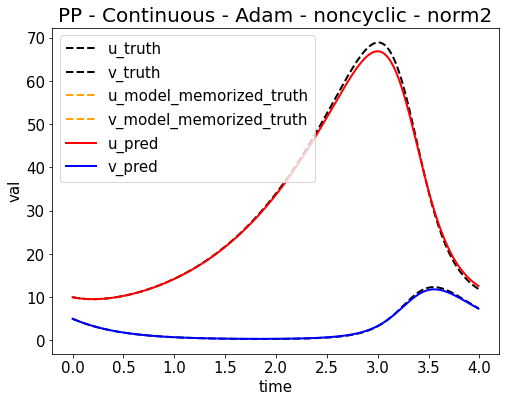

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550514.png


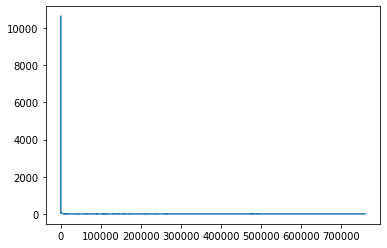

Epoch [762000/1000000] Loss:0.000543 Loss_1:0.000001 Loss_2:0.000542 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.034424s (94.22min in total, 29.43min remains)
Epoch [764000/1000000] Loss:0.000364 Loss_1:0.000001 Loss_2:0.000363 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.788377s (94.47min in total, 29.18min remains)
Epoch [766000/1000000] Loss:0.002294 Loss_1:0.000037 Loss_2:0.002257 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.739241s (94.72min in total, 28.93min remains)
Epoch [768000/1000000] Loss:0.742094 Loss_1:0.001024 Loss_2:0.741070 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.857572s (94.96min in total, 28.69min remains)
Epoch [770000/1000000] Loss:0.000320 Loss_1:0.000000 Loss_2:0.000319 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.795094s (95.21min in total, 28.44min remains)
Epoch [772000/1000000] Loss:0.000835 Loss_1:0.000008 Loss_2:0.000827 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.663756s (95.45min in total, 28.19min remains

<Figure size 432x288 with 0 Axes>

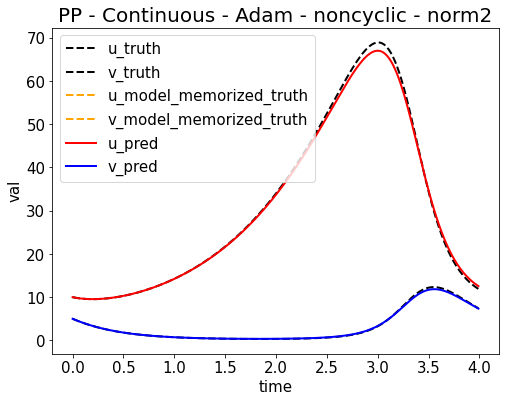

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550664.png


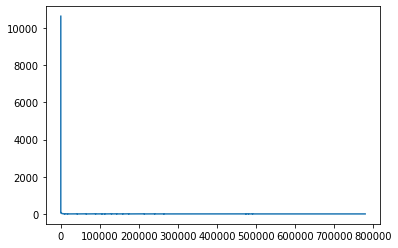

Epoch [782000/1000000] Loss:0.002420 Loss_1:0.000023 Loss_2:0.002397 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.198891s (96.73min in total, 26.96min remains)
Epoch [784000/1000000] Loss:0.000386 Loss_1:0.000001 Loss_2:0.000385 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.628405s (96.97min in total, 26.72min remains)
Epoch [786000/1000000] Loss:0.014138 Loss_1:0.000142 Loss_2:0.013996 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.816343s (97.22min in total, 26.47min remains)
Epoch [788000/1000000] Loss:0.000633 Loss_1:0.000003 Loss_2:0.000630 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:15.352380s (97.47min in total, 26.22min remains)
Epoch [790000/1000000] Loss:0.002479 Loss_1:0.000001 Loss_2:0.002478 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.759225s (97.72min in total, 25.98min remains)
Epoch [792000/1000000] Loss:0.000319 Loss_1:0.000001 Loss_2:0.000319 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.736087s (97.96min in total, 25.73min remains

<Figure size 432x288 with 0 Axes>

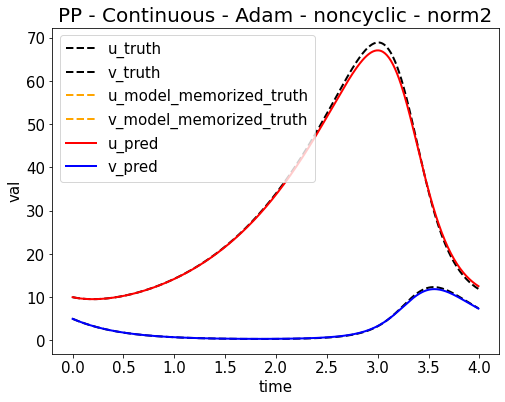

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550814.png


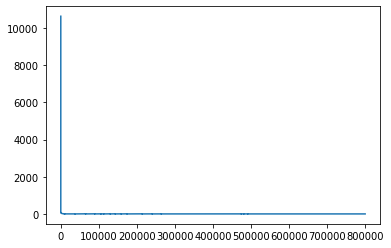

Epoch [802000/1000000] Loss:0.000383 Loss_1:0.000000 Loss_2:0.000383 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.695904s (99.22min in total, 24.50min remains)
Epoch [804000/1000000] Loss:0.000442 Loss_1:0.000000 Loss_2:0.000442 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.625134s (99.47min in total, 24.25min remains)
Epoch [806000/1000000] Loss:0.570409 Loss_1:0.005631 Loss_2:0.564778 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.868626s (99.71min in total, 24.00min remains)
Epoch [808000/1000000] Loss:0.000351 Loss_1:0.000006 Loss_2:0.000345 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.749562s (99.96min in total, 23.75min remains)
Epoch [810000/1000000] Loss:0.018825 Loss_1:0.000059 Loss_2:0.018766 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.778534s (100.21min in total, 23.51min remains)
Epoch [812000/1000000] Loss:0.000360 Loss_1:0.000000 Loss_2:0.000359 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.860730s (100.45min in total, 23.26min remai

<Figure size 432x288 with 0 Axes>

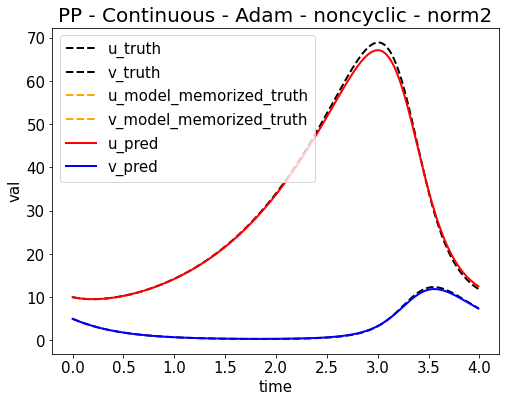

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653550964.png


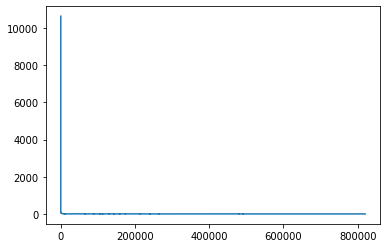

Epoch [822000/1000000] Loss:0.001199 Loss_1:0.000001 Loss_2:0.001198 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.169445s (101.73min in total, 22.03min remains)
Epoch [824000/1000000] Loss:0.001901 Loss_1:0.000006 Loss_2:0.001895 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.747279s (101.98min in total, 21.78min remains)
Epoch [826000/1000000] Loss:0.000296 Loss_1:0.000001 Loss_2:0.000295 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.549235s (102.22min in total, 21.53min remains)
Epoch [828000/1000000] Loss:0.002593 Loss_1:0.000039 Loss_2:0.002554 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.767420s (102.46min in total, 21.28min remains)
Epoch [830000/1000000] Loss:0.000675 Loss_1:0.000002 Loss_2:0.000673 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.631662s (102.71min in total, 21.04min remains)
Epoch [832000/1000000] Loss:0.000321 Loss_1:0.000000 Loss_2:0.000321 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.617041s (102.95min in total, 20.79min r

<Figure size 432x288 with 0 Axes>

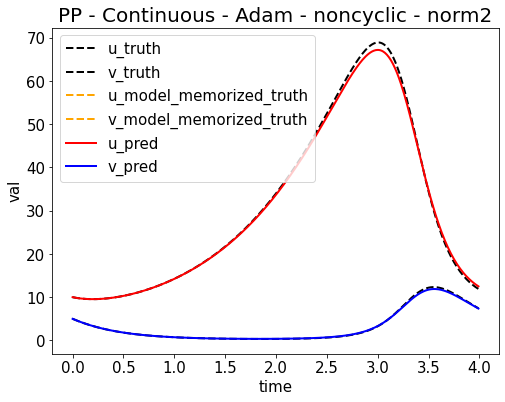

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551114.png


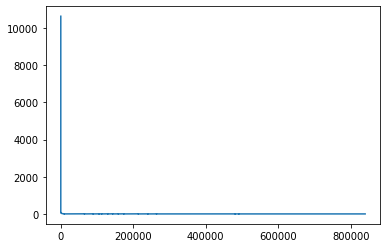

Epoch [842000/1000000] Loss:0.012583 Loss_1:0.000028 Loss_2:0.012555 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.096325s (104.22min in total, 19.56min remains)
Epoch [844000/1000000] Loss:0.000968 Loss_1:0.000020 Loss_2:0.000948 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.692727s (104.46min in total, 19.31min remains)
Epoch [846000/1000000] Loss:0.001981 Loss_1:0.000010 Loss_2:0.001972 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.699847s (104.70min in total, 19.06min remains)
Epoch [848000/1000000] Loss:0.000307 Loss_1:0.000000 Loss_2:0.000307 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.786961s (104.95min in total, 18.81min remains)
Epoch [850000/1000000] Loss:0.000669 Loss_1:0.000009 Loss_2:0.000660 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.869891s (105.20min in total, 18.56min remains)
Epoch [852000/1000000] Loss:0.000763 Loss_1:0.000008 Loss_2:0.000754 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.711315s (105.44min in total, 18.32min r

<Figure size 432x288 with 0 Axes>

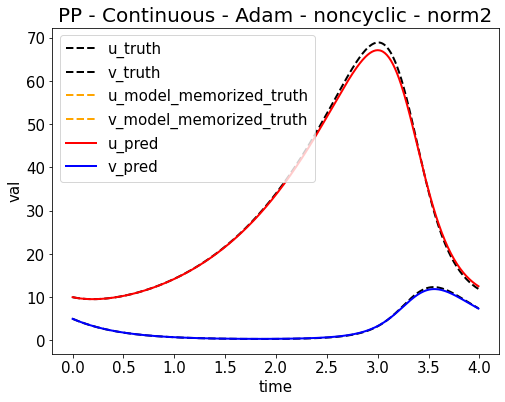

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551263.png


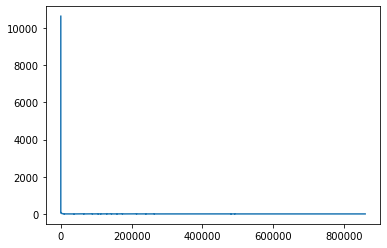

Epoch [862000/1000000] Loss:0.025550 Loss_1:0.000084 Loss_2:0.025466 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.921011s (106.71min in total, 17.08min remains)
Epoch [864000/1000000] Loss:0.000393 Loss_1:0.000000 Loss_2:0.000392 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.723344s (106.95min in total, 16.83min remains)
Epoch [866000/1000000] Loss:0.009122 Loss_1:0.000038 Loss_2:0.009084 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.657537s (107.20min in total, 16.59min remains)
Epoch [868000/1000000] Loss:0.000359 Loss_1:0.000000 Loss_2:0.000359 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.683773s (107.44min in total, 16.34min remains)
Epoch [870000/1000000] Loss:0.001585 Loss_1:0.000015 Loss_2:0.001570 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.465390s (107.68min in total, 16.09min remains)
Epoch [872000/1000000] Loss:0.001998 Loss_1:0.000020 Loss_2:0.001978 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.616896s (107.92min in total, 15.84min r

<Figure size 432x288 with 0 Axes>

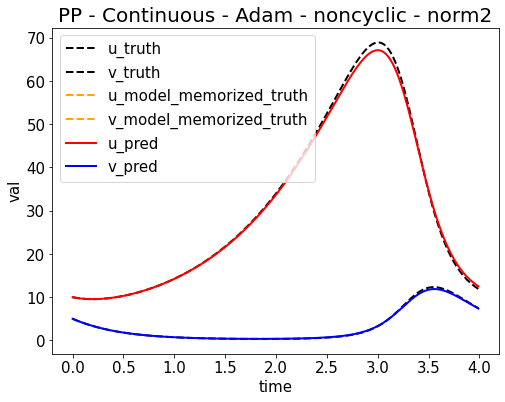

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551412.png


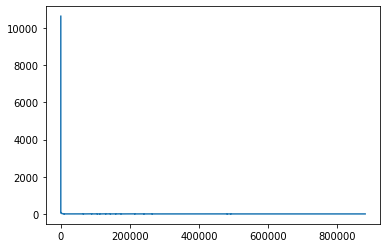

Epoch [882000/1000000] Loss:0.011805 Loss_1:0.000043 Loss_2:0.011762 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.156194s (109.19min in total, 14.61min remains)
Epoch [884000/1000000] Loss:0.000291 Loss_1:0.000000 Loss_2:0.000291 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.344872s (109.43min in total, 14.36min remains)
Epoch [886000/1000000] Loss:0.000278 Loss_1:0.000000 Loss_2:0.000278 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.735628s (109.67min in total, 14.11min remains)
Epoch [888000/1000000] Loss:0.006166 Loss_1:0.000185 Loss_2:0.005981 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.729344s (109.92min in total, 13.86min remains)
Epoch [890000/1000000] Loss:0.000345 Loss_1:0.000004 Loss_2:0.000341 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.795710s (110.17min in total, 13.62min remains)
Epoch [892000/1000000] Loss:0.034435 Loss_1:0.000096 Loss_2:0.034339 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.713953s (110.41min in total, 13.37min r

<Figure size 432x288 with 0 Axes>

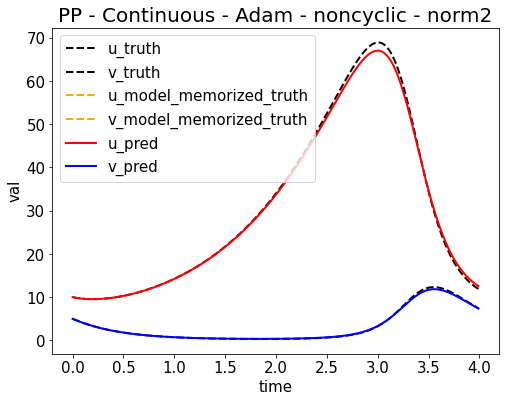

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551561.png


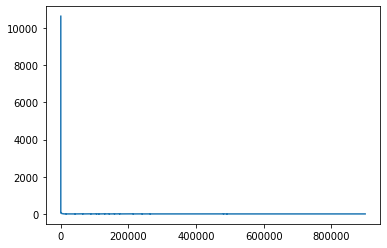

Epoch [902000/1000000] Loss:0.004870 Loss_1:0.000030 Loss_2:0.004839 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:16.895083s (111.67min in total, 12.13min remains)
Epoch [904000/1000000] Loss:0.003480 Loss_1:0.000034 Loss_2:0.003446 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.566610s (111.92min in total, 11.88min remains)
Epoch [906000/1000000] Loss:0.000314 Loss_1:0.000000 Loss_2:0.000314 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.788345s (112.16min in total, 11.64min remains)
Epoch [908000/1000000] Loss:0.014393 Loss_1:0.000035 Loss_2:0.014357 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.728435s (112.41min in total, 11.39min remains)
Epoch [910000/1000000] Loss:0.001765 Loss_1:0.000049 Loss_2:0.001716 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.722836s (112.65min in total, 11.14min remains)
Epoch [912000/1000000] Loss:0.014082 Loss_1:0.000002 Loss_2:0.014080 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.501192s (112.89min in total, 10.89min r

<Figure size 432x288 with 0 Axes>

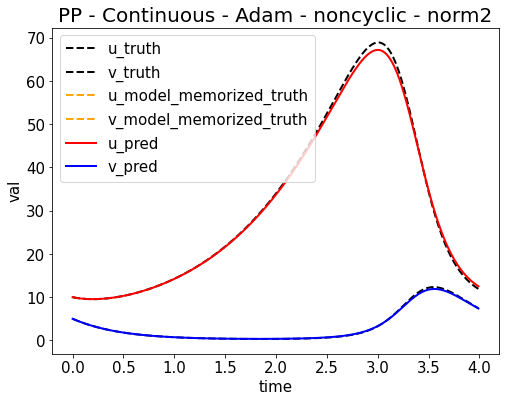

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551710.png


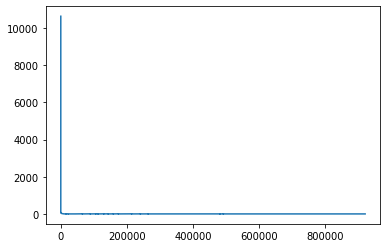

Epoch [922000/1000000] Loss:0.000427 Loss_1:0.000001 Loss_2:0.000426 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.085287s (114.16min in total, 9.66min remains)
Epoch [924000/1000000] Loss:0.001096 Loss_1:0.000002 Loss_2:0.001094 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.595820s (114.40min in total, 9.41min remains)
Epoch [926000/1000000] Loss:0.000945 Loss_1:0.000003 Loss_2:0.000942 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.589413s (114.65min in total, 9.16min remains)
Epoch [928000/1000000] Loss:0.000285 Loss_1:0.000000 Loss_2:0.000285 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.649210s (114.89min in total, 8.91min remains)
Epoch [930000/1000000] Loss:0.002623 Loss_1:0.000064 Loss_2:0.002559 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.852777s (115.14min in total, 8.67min remains)
Epoch [932000/1000000] Loss:0.000335 Loss_1:0.000000 Loss_2:0.000335 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.653733s (115.38min in total, 8.42min remains

<Figure size 432x288 with 0 Axes>

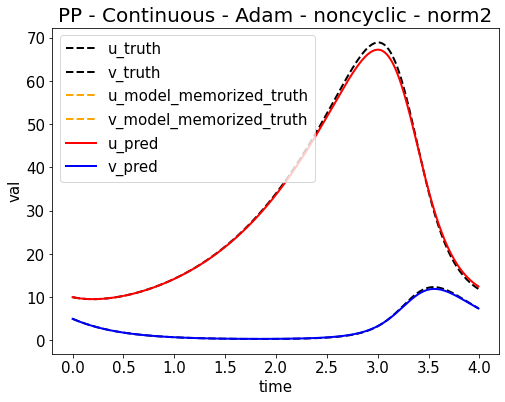

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653551860.png


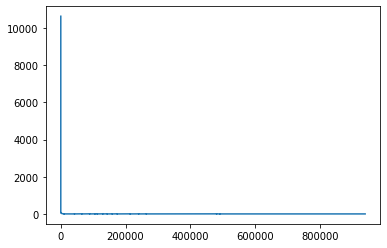

Epoch [942000/1000000] Loss:0.000434 Loss_1:0.000000 Loss_2:0.000434 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.258481s (116.65min in total, 7.18min remains)
Epoch [944000/1000000] Loss:0.000331 Loss_1:0.000000 Loss_2:0.000331 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.831650s (116.90min in total, 6.93min remains)
Epoch [946000/1000000] Loss:0.000435 Loss_1:0.000002 Loss_2:0.000433 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.833875s (117.15min in total, 6.69min remains)
Epoch [948000/1000000] Loss:0.000406 Loss_1:0.000000 Loss_2:0.000406 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.672932s (117.39min in total, 6.44min remains)
Epoch [950000/1000000] Loss:0.003055 Loss_1:0.000010 Loss_2:0.003045 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.687434s (117.63min in total, 6.19min remains)
Epoch [952000/1000000] Loss:0.012907 Loss_1:0.000060 Loss_2:0.012847 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.705019s (117.88min in total, 5.94min remains

<Figure size 432x288 with 0 Axes>

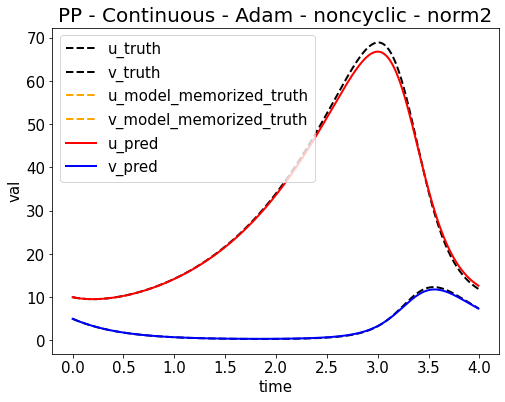

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552009.png


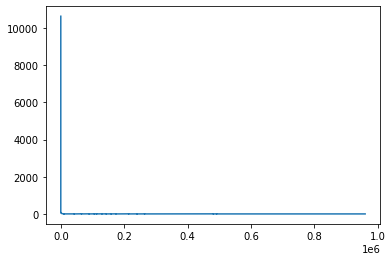

Epoch [962000/1000000] Loss:0.000461 Loss_1:0.000000 Loss_2:0.000461 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.046247s (119.14min in total, 4.71min remains)
Epoch [964000/1000000] Loss:0.034647 Loss_1:0.000111 Loss_2:0.034536 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.828547s (119.39min in total, 4.46min remains)
Epoch [966000/1000000] Loss:0.000531 Loss_1:0.000001 Loss_2:0.000530 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.739159s (119.64min in total, 4.21min remains)
Epoch [968000/1000000] Loss:0.000347 Loss_1:0.000000 Loss_2:0.000346 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.753248s (119.88min in total, 3.96min remains)
Epoch [970000/1000000] Loss:0.000322 Loss_1:0.000000 Loss_2:0.000321 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.760887s (120.13min in total, 3.72min remains)
Epoch [972000/1000000] Loss:0.002183 Loss_1:0.000089 Loss_2:0.002093 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.848716s (120.38min in total, 3.47min remains

<Figure size 432x288 with 0 Axes>

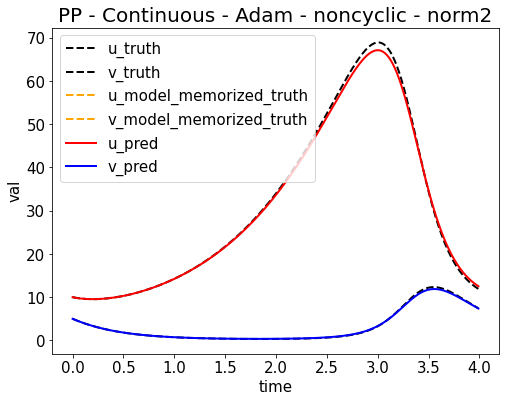

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552159.png


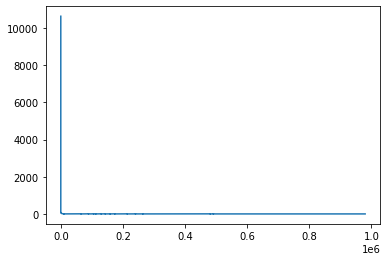

Epoch [982000/1000000] Loss:0.011304 Loss_1:0.000035 Loss_2:0.011268 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:17.205343s (121.64min in total, 2.23min remains)
Epoch [984000/1000000] Loss:0.000352 Loss_1:0.000000 Loss_2:0.000352 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.708771s (121.89min in total, 1.98min remains)
Epoch [986000/1000000] Loss:0.000792 Loss_1:0.000013 Loss_2:0.000778 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.693822s (122.13min in total, 1.73min remains)
Epoch [988000/1000000] Loss:0.002264 Loss_1:0.000034 Loss_2:0.002229 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.706759s (122.38min in total, 1.49min remains)
Epoch [990000/1000000] Loss:0.016809 Loss_1:0.000030 Loss_2:0.016779 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.711948s (122.62min in total, 1.24min remains)
Epoch [992000/1000000] Loss:0.002481 Loss_1:0.000012 Loss_2:0.002469 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:14.622098s (122.86min in total, 0.99min remains

<Figure size 432x288 with 0 Axes>

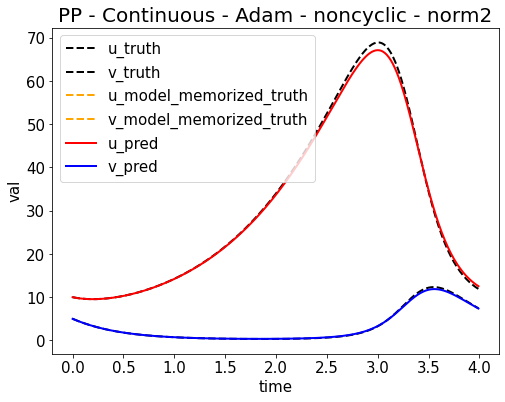

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552308.png


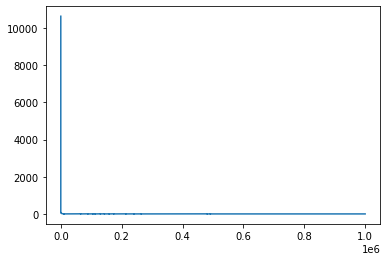

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
i = 1, length of truth = 400 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.

<Figure size 432x288 with 0 Axes>

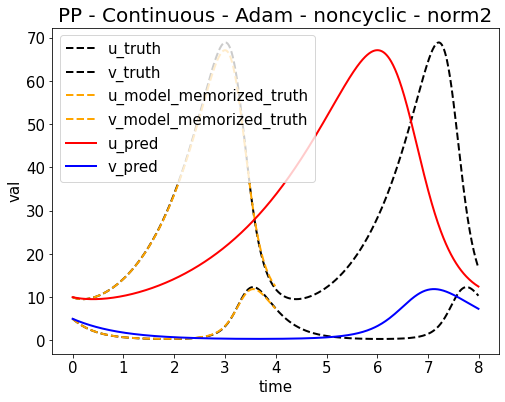

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552311.png
using cuda
epoch = 1000000
epoch_step = 2000
model_name = SimpleNetworkPP_Continue
now_string = 2022-05-26-06-01-18
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 2000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 20000}
config = {'model_name': 'SimpleNetworkPP_Continue', 'T': 8.0, 'T_all': 20.0, 'T_unit': 0.01, 'N': 800, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, '

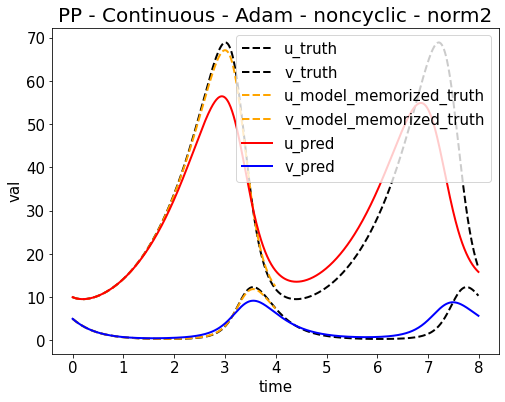

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552500.png


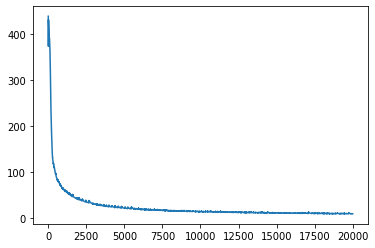

Epoch [22000/1000000] Loss:10.370291 Loss_1:0.000021 Loss_2:0.016129 Loss_3:0.000000 Loss_4:10.354141 Lr:0.001000 Time:19.865683s (3.45min in total, 153.58min remains)
Epoch [24000/1000000] Loss:9.260087 Loss_1:0.000071 Loss_2:0.011776 Loss_3:0.000000 Loss_4:9.248240 Lr:0.001000 Time:18.894560s (3.77min in total, 153.30min remains)
Epoch [26000/1000000] Loss:8.782774 Loss_1:0.000979 Loss_2:0.160875 Loss_3:0.000000 Loss_4:8.620920 Lr:0.001000 Time:18.641263s (4.08min in total, 152.85min remains)
Epoch [28000/1000000] Loss:8.173698 Loss_1:0.000176 Loss_2:0.049361 Loss_3:0.000000 Loss_4:8.124162 Lr:0.001000 Time:18.806745s (4.39min in total, 152.52min remains)
Epoch [30000/1000000] Loss:7.860251 Loss_1:0.000137 Loss_2:0.012898 Loss_3:0.000000 Loss_4:7.847217 Lr:0.001000 Time:18.855346s (4.71min in total, 152.22min remains)
Epoch [32000/1000000] Loss:7.856423 Loss_1:0.000222 Loss_2:0.020767 Loss_3:0.000000 Loss_4:7.835435 Lr:0.001000 Time:18.637665s (5.02min in total, 151.81min remains)
Ep

<Figure size 432x288 with 0 Axes>

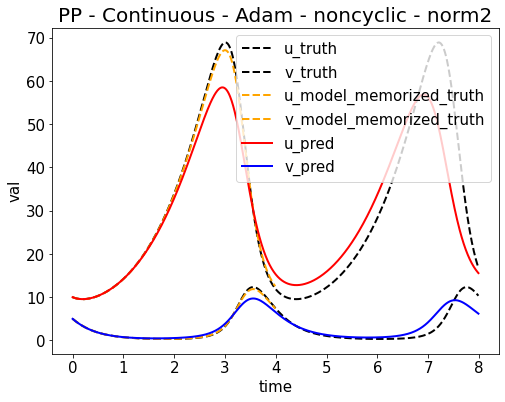

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552688.png


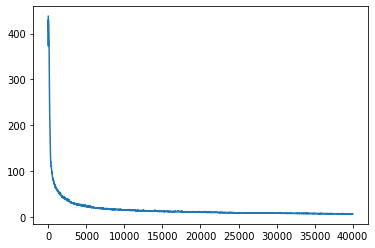

Epoch [42000/1000000] Loss:6.239275 Loss_1:0.000061 Loss_2:0.006740 Loss_3:0.000000 Loss_4:6.232475 Lr:0.001000 Time:19.699996s (6.60min in total, 150.50min remains)
Epoch [44000/1000000] Loss:6.005990 Loss_1:0.000005 Loss_2:0.007529 Loss_3:0.000000 Loss_4:5.998456 Lr:0.001000 Time:18.867709s (6.91min in total, 150.19min remains)
Epoch [46000/1000000] Loss:6.090723 Loss_1:0.000280 Loss_2:0.026924 Loss_3:0.000000 Loss_4:6.063519 Lr:0.001000 Time:18.909049s (7.23min in total, 149.90min remains)
Epoch [48000/1000000] Loss:5.751990 Loss_1:0.000053 Loss_2:0.007592 Loss_3:0.000000 Loss_4:5.744345 Lr:0.001000 Time:18.827843s (7.54min in total, 149.58min remains)
Epoch [50000/1000000] Loss:5.615039 Loss_1:0.000022 Loss_2:0.006042 Loss_3:0.000000 Loss_4:5.608974 Lr:0.001000 Time:18.641476s (7.85min in total, 149.20min remains)
Epoch [52000/1000000] Loss:5.494563 Loss_1:0.000008 Loss_2:0.006044 Loss_3:0.000000 Loss_4:5.488511 Lr:0.001000 Time:18.714885s (8.16min in total, 148.84min remains)
Epoc

<Figure size 432x288 with 0 Axes>

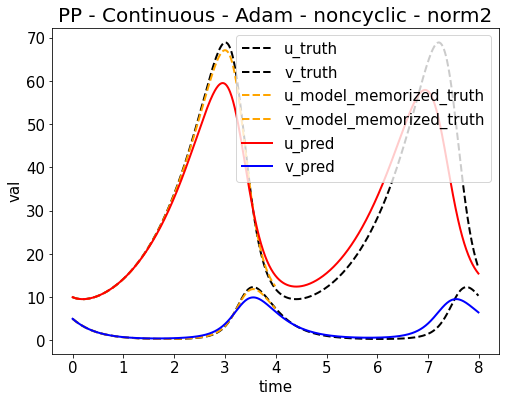

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653552877.png


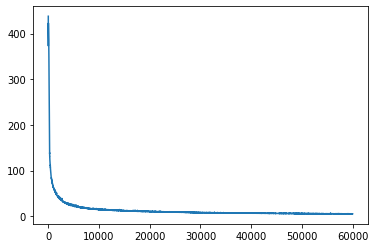

Epoch [62000/1000000] Loss:4.915581 Loss_1:0.000003 Loss_2:0.004700 Loss_3:0.000000 Loss_4:4.910878 Lr:0.001000 Time:19.798347s (9.75min in total, 147.48min remains)
Epoch [64000/1000000] Loss:5.008237 Loss_1:0.000008 Loss_2:0.010460 Loss_3:0.000000 Loss_4:4.997769 Lr:0.001000 Time:18.897751s (10.06min in total, 147.18min remains)
Epoch [66000/1000000] Loss:4.713171 Loss_1:0.000004 Loss_2:0.004351 Loss_3:0.000000 Loss_4:4.708815 Lr:0.001000 Time:18.873442s (10.38min in total, 146.86min remains)
Epoch [68000/1000000] Loss:4.628070 Loss_1:0.000077 Loss_2:0.011508 Loss_3:0.000000 Loss_4:4.616485 Lr:0.001000 Time:19.033144s (10.70min in total, 146.59min remains)
Epoch [70000/1000000] Loss:4.518478 Loss_1:0.000035 Loss_2:0.006875 Loss_3:0.000000 Loss_4:4.511568 Lr:0.001000 Time:19.054149s (11.01min in total, 146.31min remains)
Epoch [72000/1000000] Loss:4.554451 Loss_1:0.000339 Loss_2:0.040531 Loss_3:0.000000 Loss_4:4.513580 Lr:0.001000 Time:19.078582s (11.33min in total, 146.04min remains)

<Figure size 432x288 with 0 Axes>

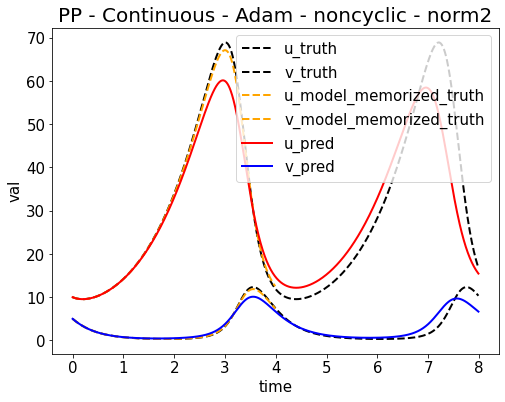

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653553068.png


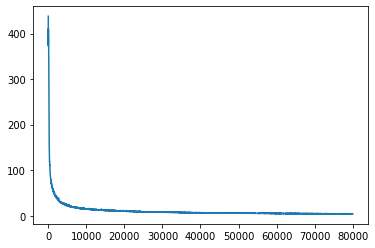

Epoch [82000/1000000] Loss:4.225259 Loss_1:0.000001 Loss_2:0.004238 Loss_3:0.000000 Loss_4:4.221020 Lr:0.001000 Time:19.799938s (12.92min in total, 144.64min remains)
Epoch [84000/1000000] Loss:4.242765 Loss_1:0.000000 Loss_2:0.033909 Loss_3:0.000000 Loss_4:4.208856 Lr:0.001000 Time:18.821734s (13.23min in total, 144.31min remains)
Epoch [86000/1000000] Loss:4.006158 Loss_1:0.000039 Loss_2:0.006307 Loss_3:0.000000 Loss_4:3.999812 Lr:0.001000 Time:18.982695s (13.55min in total, 144.01min remains)
Epoch [88000/1000000] Loss:4.055295 Loss_1:0.000352 Loss_2:0.059332 Loss_3:0.000000 Loss_4:3.995611 Lr:0.001000 Time:18.757347s (13.86min in total, 143.67min remains)
Epoch [90000/1000000] Loss:3.913519 Loss_1:0.000073 Loss_2:0.007403 Loss_3:0.000000 Loss_4:3.906042 Lr:0.001000 Time:18.800588s (14.18min in total, 143.34min remains)
Epoch [92000/1000000] Loss:3.839488 Loss_1:0.000099 Loss_2:0.006034 Loss_3:0.000000 Loss_4:3.833354 Lr:0.001000 Time:18.743485s (14.49min in total, 143.00min remains

<Figure size 432x288 with 0 Axes>

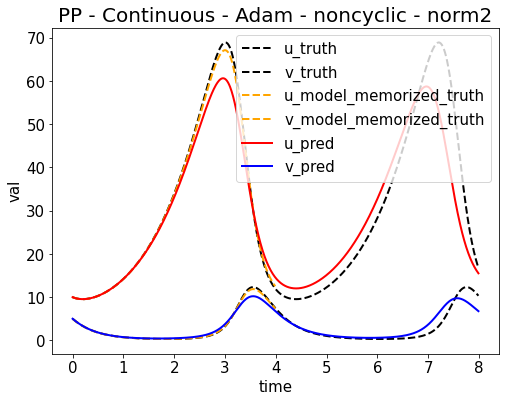

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653553257.png


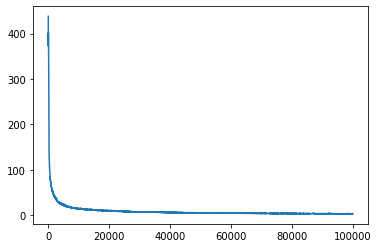

Epoch [102000/1000000] Loss:3.630681 Loss_1:0.000009 Loss_2:0.003806 Loss_3:0.000000 Loss_4:3.626866 Lr:0.001000 Time:20.072927s (16.08min in total, 141.53min remains)
Epoch [104000/1000000] Loss:3.534166 Loss_1:0.000010 Loss_2:0.005215 Loss_3:0.000000 Loss_4:3.528941 Lr:0.001000 Time:18.754109s (16.39min in total, 141.19min remains)
Epoch [106000/1000000] Loss:3.462837 Loss_1:0.000017 Loss_2:0.008316 Loss_3:0.000000 Loss_4:3.454504 Lr:0.001000 Time:18.882568s (16.70min in total, 140.87min remains)
Epoch [108000/1000000] Loss:3.605088 Loss_1:0.000054 Loss_2:0.007569 Loss_3:0.000000 Loss_4:3.597465 Lr:0.001000 Time:18.850962s (17.02min in total, 140.55min remains)
Epoch [110000/1000000] Loss:3.711233 Loss_1:0.000192 Loss_2:0.063418 Loss_3:0.000000 Loss_4:3.647624 Lr:0.001000 Time:18.820171s (17.33min in total, 140.22min remains)
Epoch [112000/1000000] Loss:3.577898 Loss_1:0.000379 Loss_2:0.080676 Loss_3:0.000000 Loss_4:3.496843 Lr:0.001000 Time:18.830826s (17.64min in total, 139.90min r

<Figure size 432x288 with 0 Axes>

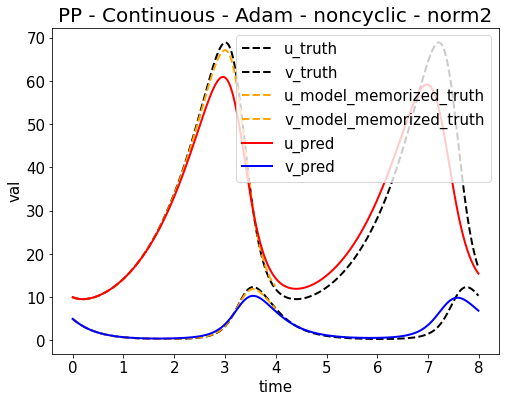

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653553446.png


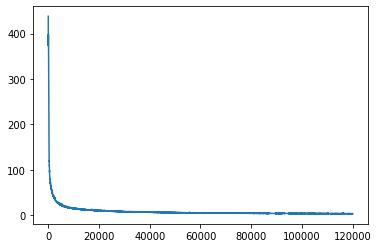

Epoch [122000/1000000] Loss:3.467040 Loss_1:0.000118 Loss_2:0.015826 Loss_3:0.000000 Loss_4:3.451096 Lr:0.001000 Time:20.061021s (19.23min in total, 138.41min remains)
Epoch [124000/1000000] Loss:3.301275 Loss_1:0.000008 Loss_2:0.003348 Loss_3:0.000000 Loss_4:3.297920 Lr:0.001000 Time:18.787437s (19.55min in total, 138.08min remains)
Epoch [126000/1000000] Loss:3.226452 Loss_1:0.000049 Loss_2:0.004230 Loss_3:0.000000 Loss_4:3.222173 Lr:0.001000 Time:18.845273s (19.86min in total, 137.76min remains)
Epoch [128000/1000000] Loss:3.272679 Loss_1:0.000012 Loss_2:0.003395 Loss_3:0.000000 Loss_4:3.269272 Lr:0.001000 Time:18.916756s (20.17min in total, 137.44min remains)
Epoch [130000/1000000] Loss:3.200029 Loss_1:0.000314 Loss_2:0.014063 Loss_3:0.000000 Loss_4:3.185652 Lr:0.001000 Time:18.852999s (20.49min in total, 137.12min remains)
Epoch [132000/1000000] Loss:3.189632 Loss_1:0.000405 Loss_2:0.045363 Loss_3:0.000000 Loss_4:3.143864 Lr:0.001000 Time:18.840604s (20.80min in total, 136.80min r

<Figure size 432x288 with 0 Axes>

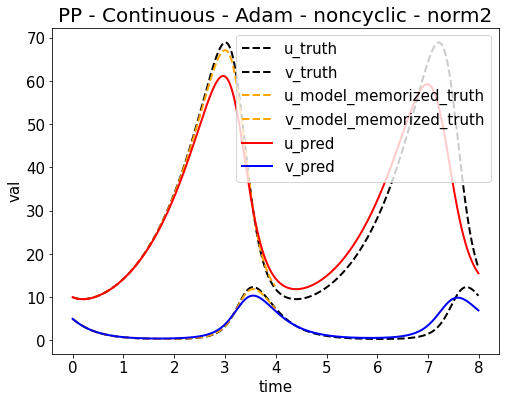

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653553636.png


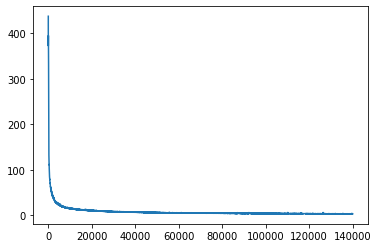

Epoch [142000/1000000] Loss:3.001207 Loss_1:0.000085 Loss_2:0.008882 Loss_3:0.000000 Loss_4:2.992240 Lr:0.001000 Time:20.011104s (22.39min in total, 135.29min remains)
Epoch [144000/1000000] Loss:3.000489 Loss_1:0.000082 Loss_2:0.008633 Loss_3:0.000000 Loss_4:2.991774 Lr:0.001000 Time:18.652232s (22.70min in total, 134.95min remains)
Epoch [146000/1000000] Loss:2.890795 Loss_1:0.000396 Loss_2:0.050498 Loss_3:0.000000 Loss_4:2.839900 Lr:0.001000 Time:18.708535s (23.01min in total, 134.62min remains)
Epoch [148000/1000000] Loss:2.896123 Loss_1:0.000001 Loss_2:0.004293 Loss_3:0.000000 Loss_4:2.891829 Lr:0.001000 Time:18.689629s (23.33min in total, 134.28min remains)
Epoch [150000/1000000] Loss:3.068591 Loss_1:0.000210 Loss_2:0.016854 Loss_3:0.000000 Loss_4:3.051527 Lr:0.001000 Time:18.696346s (23.64min in total, 133.94min remains)
Epoch [152000/1000000] Loss:3.317754 Loss_1:0.005307 Loss_2:0.040966 Loss_3:0.000000 Loss_4:3.271480 Lr:0.001000 Time:18.742334s (23.95min in total, 133.61min r

<Figure size 432x288 with 0 Axes>

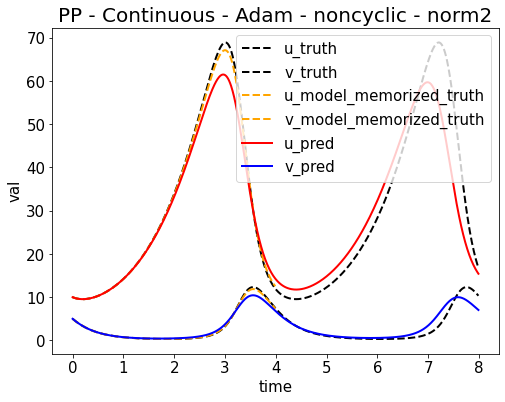

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653553824.png


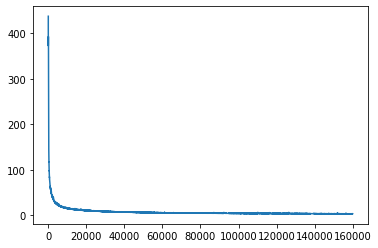

Epoch [162000/1000000] Loss:2.728953 Loss_1:0.000076 Loss_2:0.015178 Loss_3:0.000000 Loss_4:2.713698 Lr:0.001000 Time:20.074136s (25.53min in total, 132.08min remains)
Epoch [164000/1000000] Loss:2.814033 Loss_1:0.000020 Loss_2:0.004474 Loss_3:0.000000 Loss_4:2.809538 Lr:0.001000 Time:18.897570s (25.85min in total, 131.76min remains)
Epoch [166000/1000000] Loss:2.799259 Loss_1:0.000025 Loss_2:0.002991 Loss_3:0.000000 Loss_4:2.796243 Lr:0.001000 Time:18.718163s (26.16min in total, 131.43min remains)
Epoch [168000/1000000] Loss:2.746845 Loss_1:0.000013 Loss_2:0.003339 Loss_3:0.000000 Loss_4:2.743492 Lr:0.001000 Time:18.664710s (26.47min in total, 131.10min remains)
Epoch [170000/1000000] Loss:2.711588 Loss_1:0.000010 Loss_2:0.003119 Loss_3:0.000000 Loss_4:2.708459 Lr:0.001000 Time:18.670291s (26.78min in total, 130.76min remains)
Epoch [172000/1000000] Loss:2.684709 Loss_1:0.000003 Loss_2:0.003770 Loss_3:0.000000 Loss_4:2.680936 Lr:0.001000 Time:18.685529s (27.09min in total, 130.43min r

<Figure size 432x288 with 0 Axes>

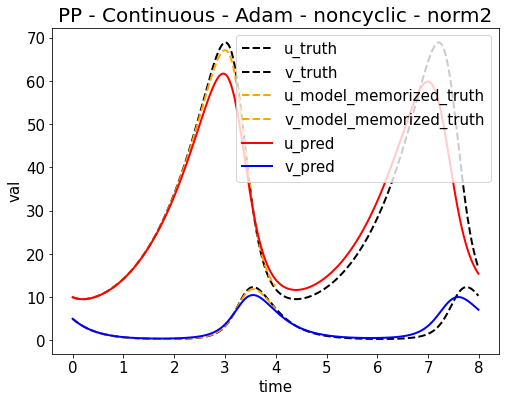

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554013.png


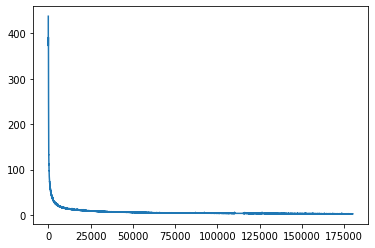

Epoch [182000/1000000] Loss:2.634104 Loss_1:0.000039 Loss_2:0.005632 Loss_3:0.000000 Loss_4:2.628433 Lr:0.001000 Time:20.036934s (28.68min in total, 128.90min remains)
Epoch [184000/1000000] Loss:2.599642 Loss_1:0.000009 Loss_2:0.003190 Loss_3:0.000000 Loss_4:2.596443 Lr:0.001000 Time:18.859067s (28.99min in total, 128.58min remains)
Epoch [186000/1000000] Loss:2.575922 Loss_1:0.000056 Loss_2:0.013660 Loss_3:0.000000 Loss_4:2.562206 Lr:0.001000 Time:18.819546s (29.31min in total, 128.26min remains)
Epoch [188000/1000000] Loss:2.547496 Loss_1:0.000041 Loss_2:0.009955 Loss_3:0.000000 Loss_4:2.537499 Lr:0.001000 Time:19.007728s (29.62min in total, 127.95min remains)
Epoch [190000/1000000] Loss:2.593402 Loss_1:0.000040 Loss_2:0.006154 Loss_3:0.000000 Loss_4:2.587207 Lr:0.001000 Time:18.782535s (29.94min in total, 127.63min remains)
Epoch [192000/1000000] Loss:2.495621 Loss_1:0.000011 Loss_2:0.002539 Loss_3:0.000000 Loss_4:2.493072 Lr:0.001000 Time:18.803298s (30.25min in total, 127.30min r

<Figure size 432x288 with 0 Axes>

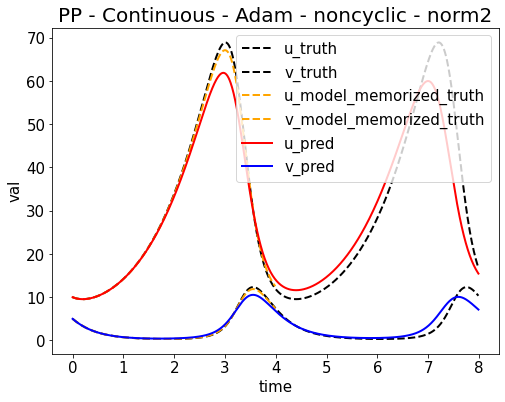

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554202.png


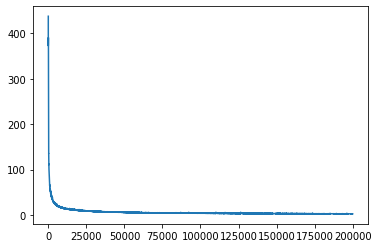

Epoch [202000/1000000] Loss:2.457891 Loss_1:0.000004 Loss_2:0.002489 Loss_3:0.000000 Loss_4:2.455398 Lr:0.001000 Time:20.404798s (31.84min in total, 125.80min remains)
Epoch [204000/1000000] Loss:2.417656 Loss_1:0.000023 Loss_2:0.003292 Loss_3:0.000000 Loss_4:2.414342 Lr:0.001000 Time:18.834265s (32.16min in total, 125.48min remains)
Epoch [206000/1000000] Loss:2.396855 Loss_1:0.000011 Loss_2:0.004377 Loss_3:0.000000 Loss_4:2.392467 Lr:0.001000 Time:18.715047s (32.47min in total, 125.15min remains)
Epoch [208000/1000000] Loss:2.466782 Loss_1:0.000022 Loss_2:0.005216 Loss_3:0.000000 Loss_4:2.461543 Lr:0.001000 Time:18.803107s (32.78min in total, 124.83min remains)
Epoch [210000/1000000] Loss:2.409201 Loss_1:0.000010 Loss_2:0.004051 Loss_3:0.000000 Loss_4:2.405139 Lr:0.001000 Time:18.751713s (33.09min in total, 124.50min remains)
Epoch [212000/1000000] Loss:2.390544 Loss_1:0.000055 Loss_2:0.004789 Loss_3:0.000000 Loss_4:2.385700 Lr:0.001000 Time:18.681170s (33.41min in total, 124.17min r

<Figure size 432x288 with 0 Axes>

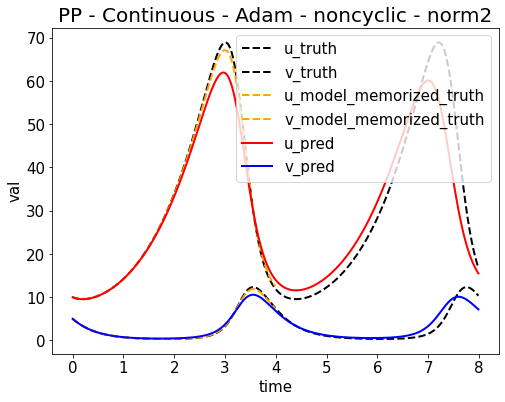

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554391.png


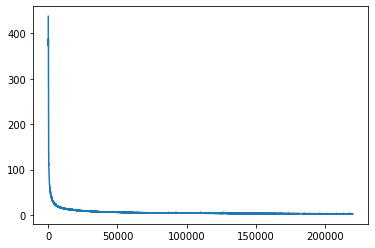

Epoch [222000/1000000] Loss:2.295358 Loss_1:0.000024 Loss_2:0.004442 Loss_3:0.000000 Loss_4:2.290891 Lr:0.001000 Time:20.065793s (34.99min in total, 122.62min remains)
Epoch [224000/1000000] Loss:2.284199 Loss_1:0.000013 Loss_2:0.002491 Loss_3:0.000000 Loss_4:2.281695 Lr:0.001000 Time:18.763204s (35.30min in total, 122.29min remains)
Epoch [226000/1000000] Loss:2.233112 Loss_1:0.000026 Loss_2:0.013208 Loss_3:0.000000 Loss_4:2.219878 Lr:0.001000 Time:18.711691s (35.61min in total, 121.97min remains)
Epoch [228000/1000000] Loss:2.271387 Loss_1:0.000010 Loss_2:0.002415 Loss_3:0.000000 Loss_4:2.268962 Lr:0.001000 Time:18.788676s (35.93min in total, 121.65min remains)
Epoch [230000/1000000] Loss:2.316870 Loss_1:0.000085 Loss_2:0.013024 Loss_3:0.000000 Loss_4:2.303761 Lr:0.001000 Time:18.814087s (36.24min in total, 121.33min remains)
Epoch [232000/1000000] Loss:2.200013 Loss_1:0.000052 Loss_2:0.009075 Loss_3:0.000000 Loss_4:2.190886 Lr:0.001000 Time:18.652014s (36.55min in total, 121.00min r

<Figure size 432x288 with 0 Axes>

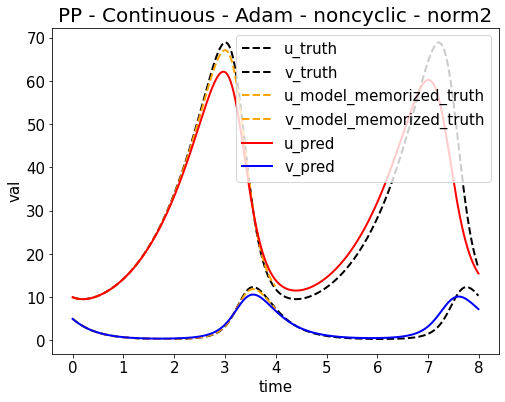

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554580.png


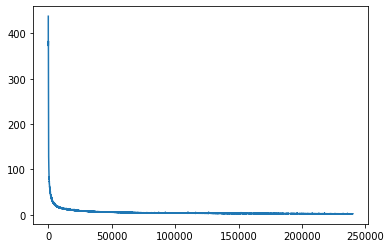

Epoch [242000/1000000] Loss:2.215914 Loss_1:0.000098 Loss_2:0.025508 Loss_3:0.000000 Loss_4:2.190308 Lr:0.001000 Time:20.026167s (38.14min in total, 119.45min remains)
Epoch [244000/1000000] Loss:2.157070 Loss_1:0.000031 Loss_2:0.016076 Loss_3:0.000000 Loss_4:2.140962 Lr:0.001000 Time:18.684877s (38.45min in total, 119.12min remains)
Epoch [246000/1000000] Loss:2.307853 Loss_1:0.002153 Loss_2:0.059481 Loss_3:0.000000 Loss_4:2.246220 Lr:0.001000 Time:18.681925s (38.76min in total, 118.80min remains)
Epoch [248000/1000000] Loss:2.143394 Loss_1:0.000009 Loss_2:0.002480 Loss_3:0.000000 Loss_4:2.140906 Lr:0.001000 Time:18.748579s (39.07min in total, 118.47min remains)
Epoch [250000/1000000] Loss:2.112341 Loss_1:0.000131 Loss_2:0.003604 Loss_3:0.000000 Loss_4:2.108605 Lr:0.001000 Time:18.751917s (39.38min in total, 118.15min remains)
Epoch [252000/1000000] Loss:2.158013 Loss_1:0.000002 Loss_2:0.002398 Loss_3:0.000000 Loss_4:2.155613 Lr:0.001000 Time:18.713628s (39.70min in total, 117.83min r

<Figure size 432x288 with 0 Axes>

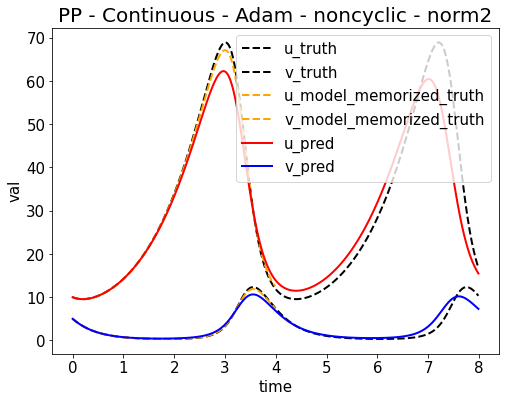

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554769.png


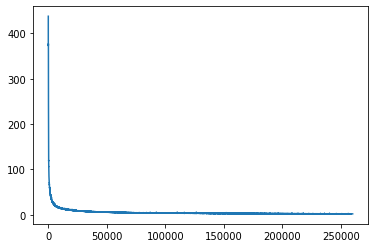

Epoch [262000/1000000] Loss:2.021286 Loss_1:0.000003 Loss_2:0.004918 Loss_3:0.000000 Loss_4:2.016365 Lr:0.001000 Time:20.388127s (41.28min in total, 116.29min remains)
Epoch [264000/1000000] Loss:2.103546 Loss_1:0.000010 Loss_2:0.005397 Loss_3:0.000000 Loss_4:2.098138 Lr:0.001000 Time:18.742200s (41.60min in total, 115.97min remains)
Epoch [266000/1000000] Loss:2.022345 Loss_1:0.000001 Loss_2:0.002090 Loss_3:0.000000 Loss_4:2.020253 Lr:0.001000 Time:18.730007s (41.91min in total, 115.64min remains)
Epoch [268000/1000000] Loss:2.000811 Loss_1:0.000017 Loss_2:0.008059 Loss_3:0.000000 Loss_4:1.992734 Lr:0.001000 Time:18.652383s (42.22min in total, 115.32min remains)
Epoch [270000/1000000] Loss:1.992899 Loss_1:0.000006 Loss_2:0.002098 Loss_3:0.000000 Loss_4:1.990795 Lr:0.001000 Time:18.845260s (42.53min in total, 115.00min remains)
Epoch [272000/1000000] Loss:1.961182 Loss_1:0.000067 Loss_2:0.027727 Loss_3:0.000000 Loss_4:1.933387 Lr:0.001000 Time:18.717251s (42.85min in total, 114.67min r

<Figure size 432x288 with 0 Axes>

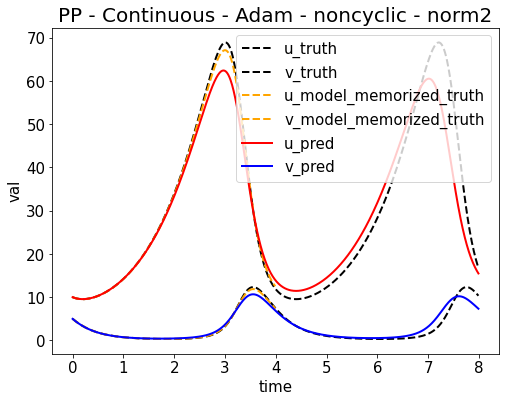

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653554958.png


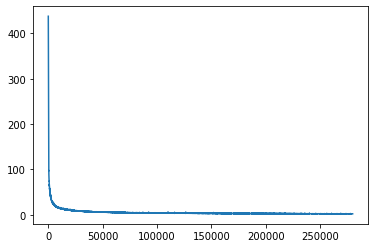

Epoch [282000/1000000] Loss:1.985487 Loss_1:0.000257 Loss_2:0.028583 Loss_3:0.000000 Loss_4:1.956646 Lr:0.001000 Time:20.196320s (44.44min in total, 113.15min remains)
Epoch [284000/1000000] Loss:1.965771 Loss_1:0.000004 Loss_2:0.005180 Loss_3:0.000000 Loss_4:1.960587 Lr:0.001000 Time:18.737417s (44.75min in total, 112.83min remains)
Epoch [286000/1000000] Loss:1.946651 Loss_1:0.000055 Loss_2:0.026070 Loss_3:0.000000 Loss_4:1.920526 Lr:0.001000 Time:18.825830s (45.07min in total, 112.51min remains)
Epoch [288000/1000000] Loss:1.956319 Loss_1:0.000010 Loss_2:0.005780 Loss_3:0.000000 Loss_4:1.950530 Lr:0.001000 Time:18.663010s (45.38min in total, 112.19min remains)
Epoch [290000/1000000] Loss:1.985255 Loss_1:0.000002 Loss_2:0.002583 Loss_3:0.000000 Loss_4:1.982670 Lr:0.001000 Time:18.752733s (45.69min in total, 111.86min remains)
Epoch [292000/1000000] Loss:1.893376 Loss_1:0.000004 Loss_2:0.002534 Loss_3:0.000000 Loss_4:1.890838 Lr:0.001000 Time:18.726076s (46.00min in total, 111.54min r

<Figure size 432x288 with 0 Axes>

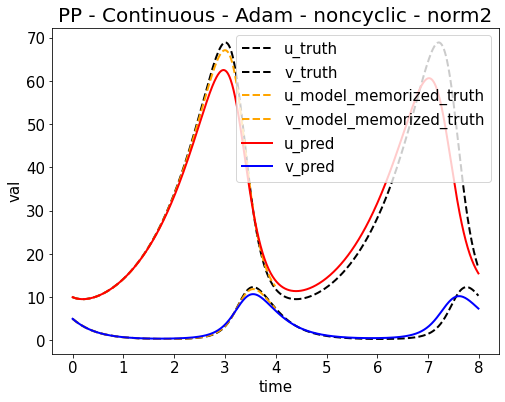

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653555148.png


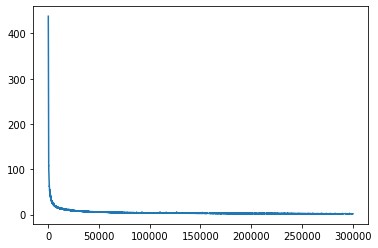

Epoch [302000/1000000] Loss:1.869907 Loss_1:0.000010 Loss_2:0.002936 Loss_3:0.000000 Loss_4:1.866961 Lr:0.001000 Time:20.616880s (47.60min in total, 110.03min remains)
Epoch [304000/1000000] Loss:1.888261 Loss_1:0.000047 Loss_2:0.006892 Loss_3:0.000000 Loss_4:1.881322 Lr:0.001000 Time:19.096241s (47.92min in total, 109.72min remains)
Epoch [306000/1000000] Loss:1.858130 Loss_1:0.000007 Loss_2:0.010737 Loss_3:0.000000 Loss_4:1.847386 Lr:0.001000 Time:19.196956s (48.24min in total, 109.41min remains)
Epoch [308000/1000000] Loss:1.833309 Loss_1:0.000002 Loss_2:0.002528 Loss_3:0.000000 Loss_4:1.830779 Lr:0.001000 Time:18.907096s (48.56min in total, 109.10min remains)
Epoch [310000/1000000] Loss:1.838728 Loss_1:0.000016 Loss_2:0.003798 Loss_3:0.000000 Loss_4:1.834914 Lr:0.001000 Time:18.965573s (48.87min in total, 108.78min remains)
Epoch [312000/1000000] Loss:1.797006 Loss_1:0.000045 Loss_2:0.003251 Loss_3:0.000000 Loss_4:1.793711 Lr:0.001000 Time:19.001996s (49.19min in total, 108.47min r

<Figure size 432x288 with 0 Axes>

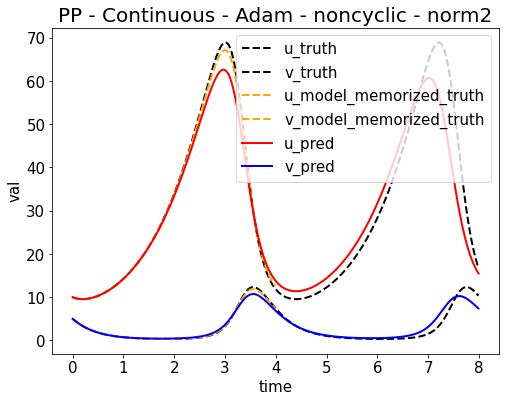

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653555339.png


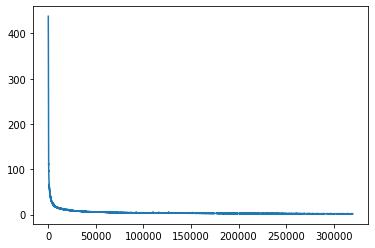

Epoch [322000/1000000] Loss:1.758084 Loss_1:0.000048 Loss_2:0.009567 Loss_3:0.000000 Loss_4:1.748468 Lr:0.001000 Time:20.468145s (50.79min in total, 106.95min remains)
Epoch [324000/1000000] Loss:1.769409 Loss_1:0.000026 Loss_2:0.003183 Loss_3:0.000000 Loss_4:1.766200 Lr:0.001000 Time:18.907608s (51.11min in total, 106.63min remains)
Epoch [326000/1000000] Loss:1.777266 Loss_1:0.000162 Loss_2:0.003196 Loss_3:0.000000 Loss_4:1.773907 Lr:0.001000 Time:18.837312s (51.42min in total, 106.31min remains)
Epoch [328000/1000000] Loss:1.860591 Loss_1:0.000022 Loss_2:0.011887 Loss_3:0.000000 Loss_4:1.848682 Lr:0.001000 Time:18.825468s (51.73min in total, 105.99min remains)
Epoch [330000/1000000] Loss:1.754238 Loss_1:0.000008 Loss_2:0.008542 Loss_3:0.000000 Loss_4:1.745689 Lr:0.001000 Time:18.802001s (52.05min in total, 105.67min remains)
Epoch [332000/1000000] Loss:1.770884 Loss_1:0.000001 Loss_2:0.003757 Loss_3:0.000000 Loss_4:1.767125 Lr:0.001000 Time:18.909024s (52.36min in total, 105.36min r

<Figure size 432x288 with 0 Axes>

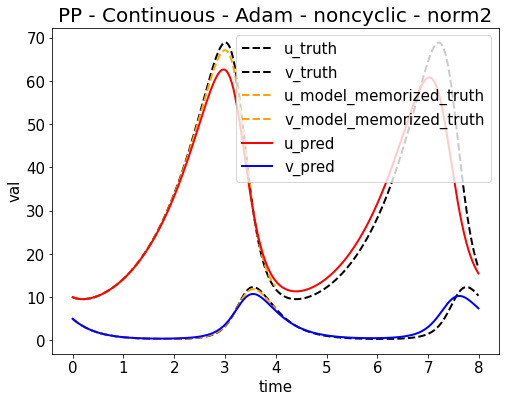

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653555529.png


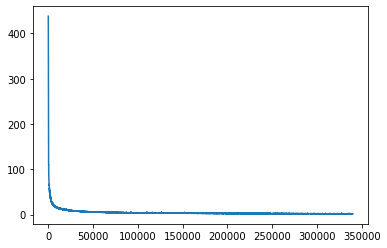

Epoch [342000/1000000] Loss:1.738599 Loss_1:0.000007 Loss_2:0.002376 Loss_3:0.000000 Loss_4:1.736216 Lr:0.001000 Time:20.419123s (53.96min in total, 103.82min remains)
Epoch [344000/1000000] Loss:1.727304 Loss_1:0.000025 Loss_2:0.004298 Loss_3:0.000000 Loss_4:1.722981 Lr:0.001000 Time:18.807936s (54.27min in total, 103.50min remains)
Epoch [346000/1000000] Loss:1.804008 Loss_1:0.000102 Loss_2:0.014157 Loss_3:0.000000 Loss_4:1.789749 Lr:0.001000 Time:18.811530s (54.59min in total, 103.18min remains)
Epoch [348000/1000000] Loss:1.727195 Loss_1:0.000051 Loss_2:0.031190 Loss_3:0.000000 Loss_4:1.695954 Lr:0.001000 Time:18.875228s (54.90min in total, 102.86min remains)
Epoch [350000/1000000] Loss:1.826219 Loss_1:0.000523 Loss_2:0.048156 Loss_3:0.000000 Loss_4:1.777540 Lr:0.001000 Time:18.913077s (55.22min in total, 102.54min remains)
Epoch [352000/1000000] Loss:1.710375 Loss_1:0.000001 Loss_2:0.002400 Loss_3:0.000000 Loss_4:1.707974 Lr:0.001000 Time:18.821182s (55.53min in total, 102.22min r

<Figure size 432x288 with 0 Axes>

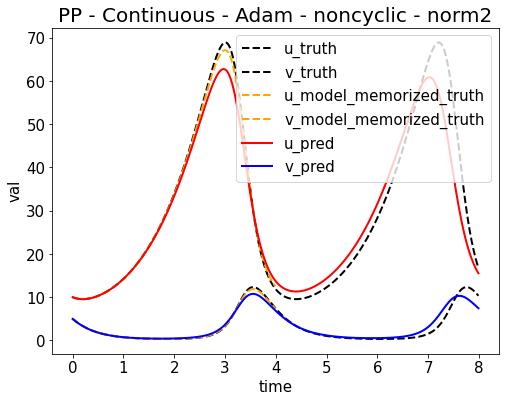

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653555719.png


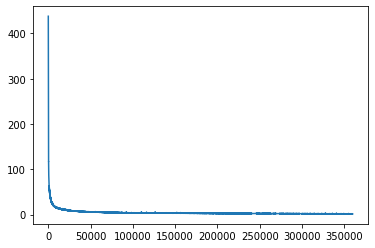

Epoch [362000/1000000] Loss:1.669468 Loss_1:0.000006 Loss_2:0.002351 Loss_3:0.000000 Loss_4:1.667111 Lr:0.001000 Time:20.286510s (57.12min in total, 100.67min remains)
Epoch [364000/1000000] Loss:1.661616 Loss_1:0.000006 Loss_2:0.002048 Loss_3:0.000000 Loss_4:1.659563 Lr:0.001000 Time:18.917293s (57.44min in total, 100.36min remains)
Epoch [366000/1000000] Loss:1.669381 Loss_1:0.000006 Loss_2:0.003322 Loss_3:0.000000 Loss_4:1.666052 Lr:0.001000 Time:18.878599s (57.75min in total, 100.04min remains)
Epoch [368000/1000000] Loss:1.654843 Loss_1:0.000110 Loss_2:0.004762 Loss_3:0.000000 Loss_4:1.649970 Lr:0.001000 Time:18.853858s (58.07min in total, 99.72min remains)
Epoch [370000/1000000] Loss:1.650304 Loss_1:0.000009 Loss_2:0.002361 Loss_3:0.000000 Loss_4:1.647933 Lr:0.001000 Time:18.914271s (58.38min in total, 99.41min remains)
Epoch [372000/1000000] Loss:1.692543 Loss_1:0.000071 Loss_2:0.004452 Loss_3:0.000000 Loss_4:1.688020 Lr:0.001000 Time:18.836654s (58.69min in total, 99.09min rema

<Figure size 432x288 with 0 Axes>

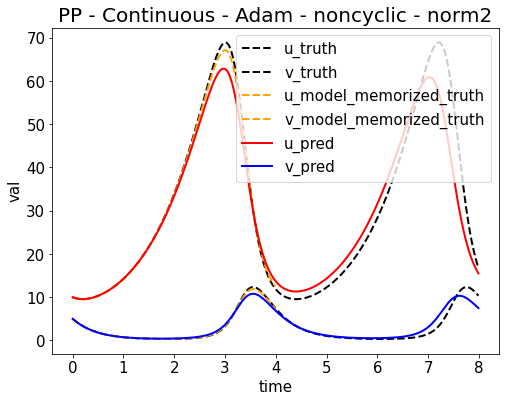

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653555909.png


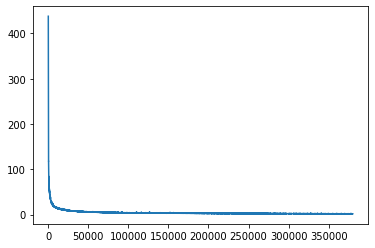

Epoch [382000/1000000] Loss:1.670989 Loss_1:0.000067 Loss_2:0.006556 Loss_3:0.000000 Loss_4:1.664367 Lr:0.001000 Time:20.585904s (60.29min in total, 97.54min remains)
Epoch [384000/1000000] Loss:1.575190 Loss_1:0.000970 Loss_2:0.016488 Loss_3:0.000000 Loss_4:1.557731 Lr:0.001000 Time:18.829356s (60.61min in total, 97.23min remains)
Epoch [386000/1000000] Loss:1.605684 Loss_1:0.000001 Loss_2:0.002120 Loss_3:0.000000 Loss_4:1.603563 Lr:0.001000 Time:18.800826s (60.92min in total, 96.91min remains)
Epoch [388000/1000000] Loss:1.663186 Loss_1:0.000001 Loss_2:0.001781 Loss_3:0.000000 Loss_4:1.661404 Lr:0.001000 Time:18.924062s (61.24min in total, 96.59min remains)
Epoch [390000/1000000] Loss:1.651914 Loss_1:0.000295 Loss_2:0.020914 Loss_3:0.000000 Loss_4:1.630705 Lr:0.001000 Time:18.983448s (61.55min in total, 96.28min remains)
Epoch [392000/1000000] Loss:1.650331 Loss_1:0.000014 Loss_2:0.036054 Loss_3:0.000000 Loss_4:1.614263 Lr:0.001000 Time:18.992336s (61.87min in total, 95.96min remains

<Figure size 432x288 with 0 Axes>

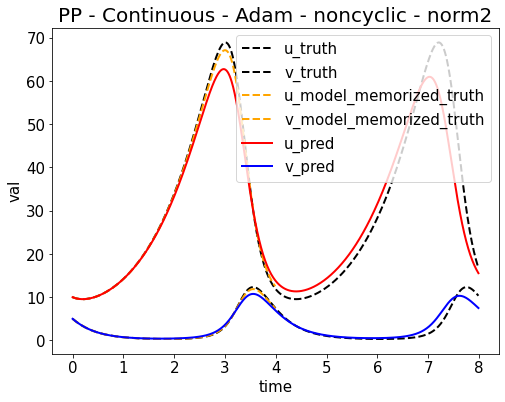

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653556100.png


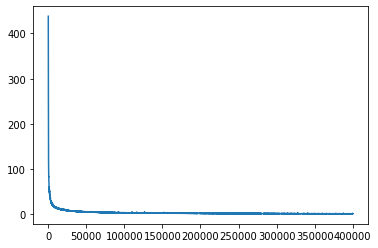

Epoch [402000/1000000] Loss:1.570525 Loss_1:0.000110 Loss_2:0.006173 Loss_3:0.000000 Loss_4:1.564241 Lr:0.001000 Time:20.474641s (63.47min in total, 94.41min remains)
Epoch [404000/1000000] Loss:1.669658 Loss_1:0.000001 Loss_2:0.001771 Loss_3:0.000000 Loss_4:1.667886 Lr:0.001000 Time:19.052417s (63.78min in total, 94.10min remains)
Epoch [406000/1000000] Loss:1.576506 Loss_1:0.000004 Loss_2:0.002330 Loss_3:0.000000 Loss_4:1.574172 Lr:0.001000 Time:19.062620s (64.10min in total, 93.79min remains)
Epoch [408000/1000000] Loss:1.543858 Loss_1:0.000035 Loss_2:0.003841 Loss_3:0.000000 Loss_4:1.539982 Lr:0.001000 Time:19.008892s (64.42min in total, 93.47min remains)
Epoch [410000/1000000] Loss:1.578028 Loss_1:0.000054 Loss_2:0.019487 Loss_3:0.000000 Loss_4:1.558486 Lr:0.001000 Time:19.180390s (64.74min in total, 93.16min remains)
Epoch [412000/1000000] Loss:1.561579 Loss_1:0.000005 Loss_2:0.005151 Loss_3:0.000000 Loss_4:1.556422 Lr:0.001000 Time:18.997314s (65.06min in total, 92.85min remains

<Figure size 432x288 with 0 Axes>

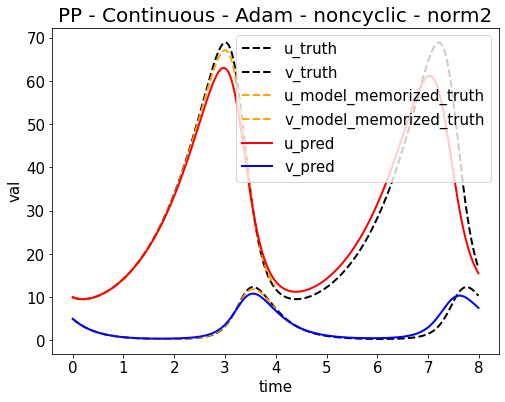

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653556292.png


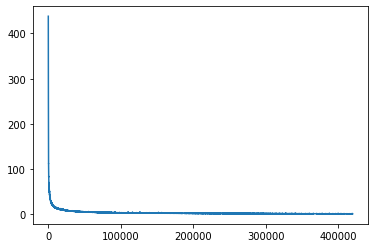

Epoch [422000/1000000] Loss:1.497955 Loss_1:0.000071 Loss_2:0.004905 Loss_3:0.000000 Loss_4:1.492978 Lr:0.001000 Time:20.744797s (66.67min in total, 91.32min remains)
Epoch [424000/1000000] Loss:1.482889 Loss_1:0.000180 Loss_2:0.008864 Loss_3:0.000000 Loss_4:1.473844 Lr:0.001000 Time:19.009338s (66.99min in total, 91.01min remains)
Epoch [426000/1000000] Loss:1.492553 Loss_1:0.000003 Loss_2:0.001770 Loss_3:0.000000 Loss_4:1.490780 Lr:0.001000 Time:19.174749s (67.31min in total, 90.69min remains)
Epoch [428000/1000000] Loss:1.488180 Loss_1:0.000011 Loss_2:0.002003 Loss_3:0.000000 Loss_4:1.486165 Lr:0.001000 Time:19.018677s (67.63min in total, 90.38min remains)
Epoch [430000/1000000] Loss:1.493531 Loss_1:0.000001 Loss_2:0.001917 Loss_3:0.000000 Loss_4:1.491613 Lr:0.001000 Time:19.018825s (67.94min in total, 90.07min remains)
Epoch [432000/1000000] Loss:1.505535 Loss_1:0.000022 Loss_2:0.011097 Loss_3:0.000000 Loss_4:1.494416 Lr:0.001000 Time:19.197948s (68.26min in total, 89.75min remains

<Figure size 432x288 with 0 Axes>

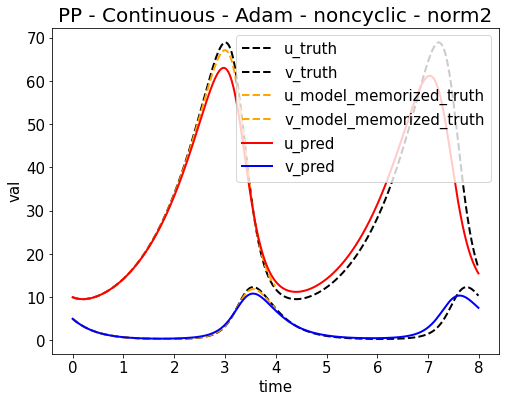

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653556484.png


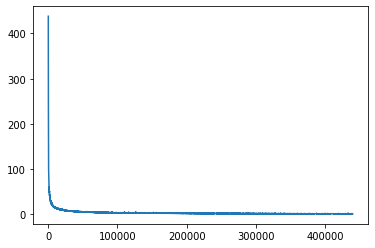

Epoch [442000/1000000] Loss:1.470594 Loss_1:0.000003 Loss_2:0.004223 Loss_3:0.000000 Loss_4:1.466367 Lr:0.001000 Time:20.915592s (69.88min in total, 88.22min remains)
Epoch [444000/1000000] Loss:1.495222 Loss_1:0.000407 Loss_2:0.038144 Loss_3:0.000000 Loss_4:1.456671 Lr:0.001000 Time:18.994354s (70.20min in total, 87.91min remains)
Epoch [446000/1000000] Loss:1.470108 Loss_1:0.000014 Loss_2:0.015742 Loss_3:0.000000 Loss_4:1.454352 Lr:0.001000 Time:18.897029s (70.51min in total, 87.59min remains)
Epoch [448000/1000000] Loss:1.431107 Loss_1:0.000038 Loss_2:0.002418 Loss_3:0.000000 Loss_4:1.428651 Lr:0.001000 Time:19.061403s (70.83min in total, 87.28min remains)
Epoch [450000/1000000] Loss:1.481143 Loss_1:0.000001 Loss_2:0.002394 Loss_3:0.000000 Loss_4:1.478748 Lr:0.001000 Time:19.075068s (71.15min in total, 86.96min remains)
Epoch [452000/1000000] Loss:1.395008 Loss_1:0.000021 Loss_2:0.006925 Loss_3:0.000000 Loss_4:1.388061 Lr:0.001000 Time:19.141417s (71.47min in total, 86.65min remains

<Figure size 432x288 with 0 Axes>

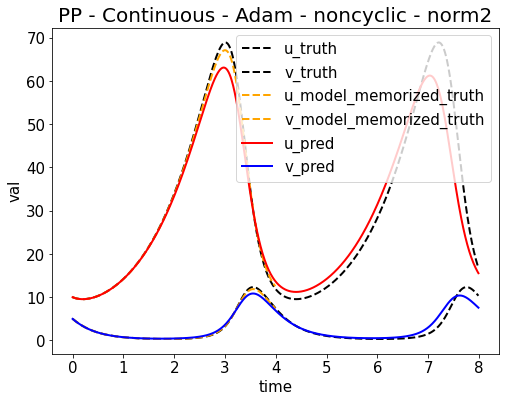

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653556676.png


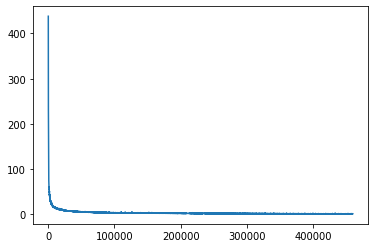

Epoch [462000/1000000] Loss:1.401356 Loss_1:0.000013 Loss_2:0.002168 Loss_3:0.000000 Loss_4:1.399176 Lr:0.001000 Time:20.800719s (73.08min in total, 85.11min remains)
Epoch [464000/1000000] Loss:1.369493 Loss_1:0.000101 Loss_2:0.021936 Loss_3:0.000000 Loss_4:1.347456 Lr:0.001000 Time:18.926555s (73.40min in total, 84.79min remains)
Epoch [466000/1000000] Loss:1.310407 Loss_1:0.000007 Loss_2:0.001734 Loss_3:0.000000 Loss_4:1.308665 Lr:0.001000 Time:18.999223s (73.72min in total, 84.47min remains)
Epoch [468000/1000000] Loss:1.344672 Loss_1:0.000042 Loss_2:0.006082 Loss_3:0.000000 Loss_4:1.338547 Lr:0.001000 Time:19.176936s (74.03min in total, 84.16min remains)
Epoch [470000/1000000] Loss:1.316555 Loss_1:0.000028 Loss_2:0.002407 Loss_3:0.000000 Loss_4:1.314120 Lr:0.001000 Time:19.004848s (74.35min in total, 83.84min remains)
Epoch [472000/1000000] Loss:1.295209 Loss_1:0.000001 Loss_2:0.002353 Loss_3:0.000000 Loss_4:1.292855 Lr:0.001000 Time:19.081370s (74.67min in total, 83.53min remains

<Figure size 432x288 with 0 Axes>

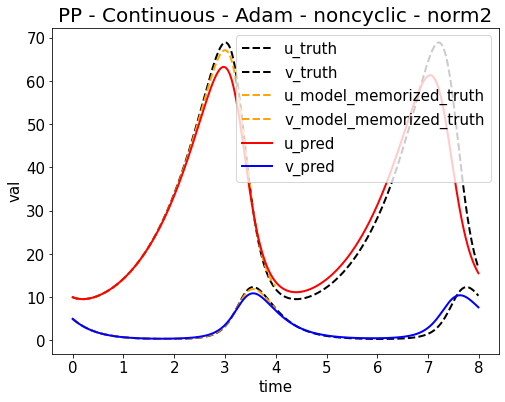

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653556868.png


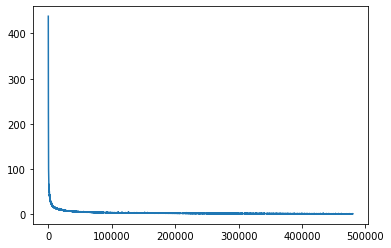

Epoch [482000/1000000] Loss:1.323976 Loss_1:0.000013 Loss_2:0.011204 Loss_3:0.000000 Loss_4:1.312758 Lr:0.001000 Time:20.879837s (76.28min in total, 81.98min remains)
Epoch [484000/1000000] Loss:1.329226 Loss_1:0.000002 Loss_2:0.001578 Loss_3:0.000000 Loss_4:1.327646 Lr:0.001000 Time:18.953913s (76.60min in total, 81.66min remains)
Epoch [486000/1000000] Loss:1.283130 Loss_1:0.000105 Loss_2:0.007798 Loss_3:0.000000 Loss_4:1.275227 Lr:0.001000 Time:18.909733s (76.92min in total, 81.35min remains)
Epoch [488000/1000000] Loss:1.363757 Loss_1:0.000001 Loss_2:0.001574 Loss_3:0.000000 Loss_4:1.362182 Lr:0.001000 Time:18.926202s (77.23min in total, 81.03min remains)
Epoch [490000/1000000] Loss:1.318364 Loss_1:0.000059 Loss_2:0.010367 Loss_3:0.000000 Loss_4:1.307939 Lr:0.001000 Time:18.919411s (77.55min in total, 80.71min remains)
Epoch [492000/1000000] Loss:1.274805 Loss_1:0.000023 Loss_2:0.004799 Loss_3:0.000000 Loss_4:1.269983 Lr:0.001000 Time:18.803415s (77.86min in total, 80.39min remains

<Figure size 432x288 with 0 Axes>

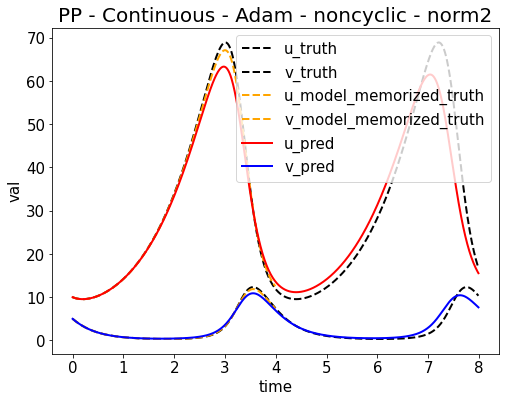

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653557059.png


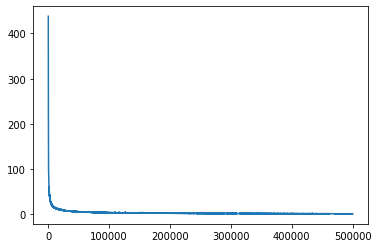

Epoch [502000/1000000] Loss:1.270760 Loss_1:0.000000 Loss_2:0.002999 Loss_3:0.000000 Loss_4:1.267761 Lr:0.001000 Time:20.599072s (79.46min in total, 78.83min remains)
Epoch [504000/1000000] Loss:1.281077 Loss_1:0.000153 Loss_2:0.002631 Loss_3:0.000000 Loss_4:1.278292 Lr:0.001000 Time:18.855584s (79.78min in total, 78.51min remains)
Epoch [506000/1000000] Loss:1.362231 Loss_1:0.000081 Loss_2:0.043956 Loss_3:0.000000 Loss_4:1.318194 Lr:0.001000 Time:18.875400s (80.09min in total, 78.19min remains)
Epoch [508000/1000000] Loss:1.279931 Loss_1:0.000011 Loss_2:0.023876 Loss_3:0.000000 Loss_4:1.256043 Lr:0.001000 Time:18.789935s (80.41min in total, 77.87min remains)
Epoch [510000/1000000] Loss:1.246469 Loss_1:0.000210 Loss_2:0.009443 Loss_3:0.000000 Loss_4:1.236816 Lr:0.001000 Time:18.965920s (80.72min in total, 77.56min remains)
Epoch [512000/1000000] Loss:1.252152 Loss_1:0.000008 Loss_2:0.001570 Loss_3:0.000000 Loss_4:1.250573 Lr:0.001000 Time:18.859295s (81.04min in total, 77.24min remains

<Figure size 432x288 with 0 Axes>

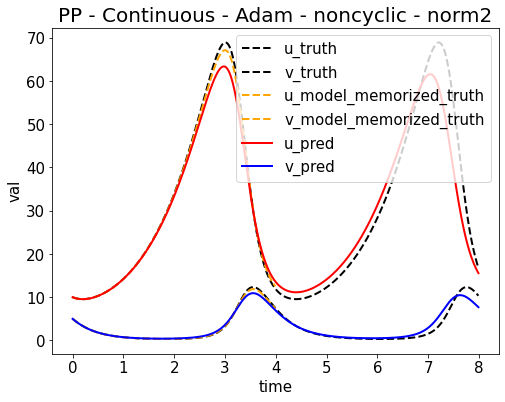

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653557250.png


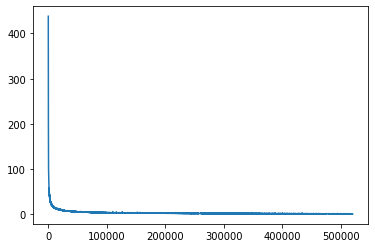

Epoch [522000/1000000] Loss:1.244574 Loss_1:0.000085 Loss_2:0.011530 Loss_3:0.000000 Loss_4:1.232959 Lr:0.001000 Time:20.956321s (82.64min in total, 75.68min remains)
Epoch [524000/1000000] Loss:1.231463 Loss_1:0.000073 Loss_2:0.018725 Loss_3:0.000000 Loss_4:1.212664 Lr:0.001000 Time:18.765148s (82.95min in total, 75.36min remains)
Epoch [526000/1000000] Loss:1.229589 Loss_1:0.000000 Loss_2:0.002377 Loss_3:0.000000 Loss_4:1.227211 Lr:0.001000 Time:18.888353s (83.27min in total, 75.04min remains)
Epoch [528000/1000000] Loss:1.211215 Loss_1:0.000025 Loss_2:0.003587 Loss_3:0.000000 Loss_4:1.207602 Lr:0.001000 Time:18.802856s (83.58min in total, 74.72min remains)
Epoch [530000/1000000] Loss:1.230492 Loss_1:0.000013 Loss_2:0.001816 Loss_3:0.000000 Loss_4:1.228663 Lr:0.001000 Time:18.785962s (83.90min in total, 74.40min remains)
Epoch [532000/1000000] Loss:1.194847 Loss_1:0.000005 Loss_2:0.003350 Loss_3:0.000000 Loss_4:1.191492 Lr:0.001000 Time:18.851878s (84.21min in total, 74.08min remains

<Figure size 432x288 with 0 Axes>

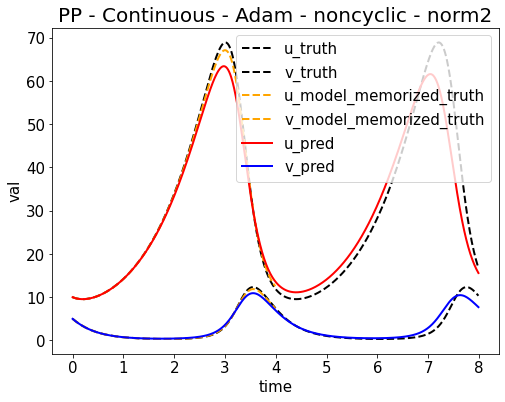

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653557440.png


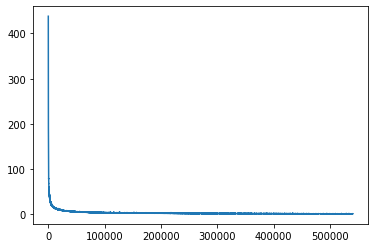

Epoch [542000/1000000] Loss:1.326514 Loss_1:0.000001 Loss_2:0.001533 Loss_3:0.000000 Loss_4:1.324980 Lr:0.001000 Time:20.853756s (85.82min in total, 72.52min remains)
Epoch [544000/1000000] Loss:1.293610 Loss_1:0.000002 Loss_2:0.001853 Loss_3:0.000000 Loss_4:1.291756 Lr:0.001000 Time:18.891515s (86.13min in total, 72.20min remains)
Epoch [546000/1000000] Loss:1.306717 Loss_1:0.000024 Loss_2:0.008949 Loss_3:0.000000 Loss_4:1.297744 Lr:0.001000 Time:18.879116s (86.45min in total, 71.88min remains)
Epoch [548000/1000000] Loss:1.496384 Loss_1:0.000002 Loss_2:0.002066 Loss_3:0.000000 Loss_4:1.494316 Lr:0.001000 Time:18.948583s (86.76min in total, 71.56min remains)
Epoch [550000/1000000] Loss:1.533923 Loss_1:0.000024 Loss_2:0.013359 Loss_3:0.000000 Loss_4:1.520540 Lr:0.001000 Time:18.874056s (87.08min in total, 71.24min remains)
Epoch [552000/1000000] Loss:1.515940 Loss_1:0.000053 Loss_2:0.003902 Loss_3:0.000000 Loss_4:1.511985 Lr:0.001000 Time:18.927684s (87.39min in total, 70.93min remains

<Figure size 432x288 with 0 Axes>

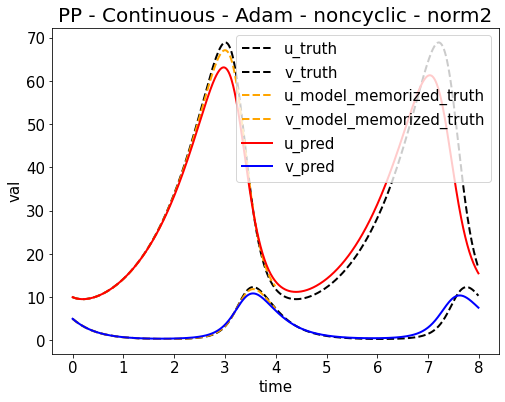

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653557631.png


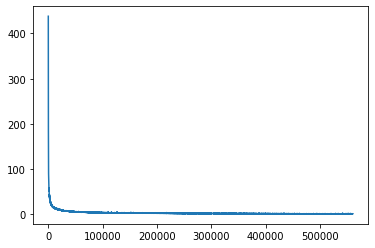

Epoch [562000/1000000] Loss:1.359178 Loss_1:0.000016 Loss_2:0.002977 Loss_3:0.000000 Loss_4:1.356184 Lr:0.001000 Time:20.708976s (89.00min in total, 69.36min remains)
Epoch [564000/1000000] Loss:1.366508 Loss_1:0.000002 Loss_2:0.001786 Loss_3:0.000000 Loss_4:1.364720 Lr:0.001000 Time:18.793990s (89.31min in total, 69.04min remains)
Epoch [566000/1000000] Loss:1.420898 Loss_1:0.000644 Loss_2:0.022060 Loss_3:0.000000 Loss_4:1.398193 Lr:0.001000 Time:18.904284s (89.63min in total, 68.72min remains)
Epoch [568000/1000000] Loss:1.358762 Loss_1:0.000058 Loss_2:0.012982 Loss_3:0.000000 Loss_4:1.345723 Lr:0.001000 Time:18.800842s (89.94min in total, 68.40min remains)
Epoch [570000/1000000] Loss:1.428148 Loss_1:0.000075 Loss_2:0.026866 Loss_3:0.000000 Loss_4:1.401206 Lr:0.001000 Time:18.795920s (90.25min in total, 68.08min remains)
Epoch [572000/1000000] Loss:1.367519 Loss_1:0.000017 Loss_2:0.008154 Loss_3:0.000000 Loss_4:1.359347 Lr:0.001000 Time:18.804282s (90.57min in total, 67.77min remains

<Figure size 432x288 with 0 Axes>

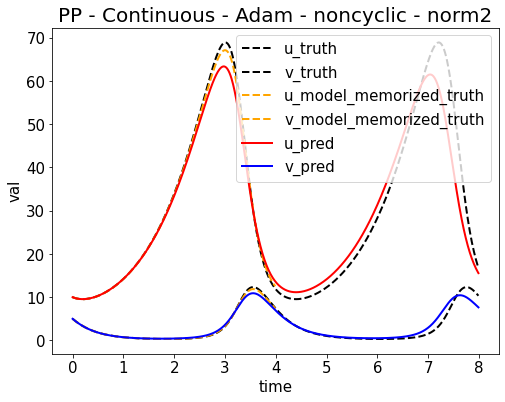

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653557821.png


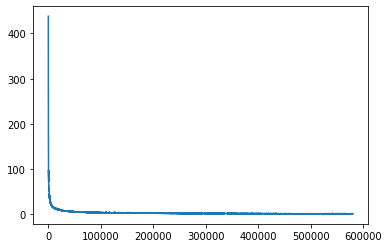

Epoch [582000/1000000] Loss:1.266225 Loss_1:0.000050 Loss_2:0.015410 Loss_3:0.000000 Loss_4:1.250765 Lr:0.001000 Time:21.004657s (92.17min in total, 66.20min remains)
Epoch [584000/1000000] Loss:1.284679 Loss_1:0.000187 Loss_2:0.030876 Loss_3:0.000000 Loss_4:1.253617 Lr:0.001000 Time:18.946938s (92.48min in total, 65.88min remains)
Epoch [586000/1000000] Loss:1.307210 Loss_1:0.000018 Loss_2:0.006490 Loss_3:0.000000 Loss_4:1.300702 Lr:0.001000 Time:18.850241s (92.80min in total, 65.56min remains)
Epoch [588000/1000000] Loss:1.281510 Loss_1:0.000028 Loss_2:0.006856 Loss_3:0.000000 Loss_4:1.274626 Lr:0.001000 Time:18.932740s (93.11min in total, 65.24min remains)
Epoch [590000/1000000] Loss:1.233685 Loss_1:0.000033 Loss_2:0.005434 Loss_3:0.000000 Loss_4:1.228218 Lr:0.001000 Time:18.751292s (93.43min in total, 64.92min remains)
Epoch [592000/1000000] Loss:1.224644 Loss_1:0.000000 Loss_2:0.001594 Loss_3:0.000000 Loss_4:1.223050 Lr:0.001000 Time:19.008629s (93.74min in total, 64.61min remains

<Figure size 432x288 with 0 Axes>

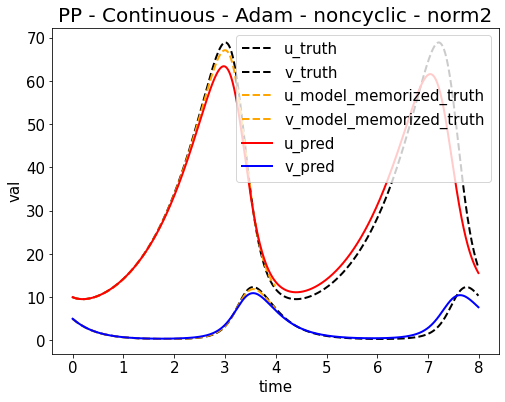

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558012.png


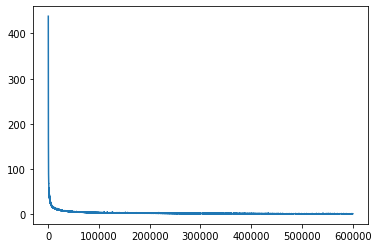

Epoch [602000/1000000] Loss:1.205203 Loss_1:0.000002 Loss_2:0.001423 Loss_3:0.000000 Loss_4:1.203777 Lr:0.001000 Time:20.888981s (95.35min in total, 63.04min remains)
Epoch [604000/1000000] Loss:1.217955 Loss_1:0.000003 Loss_2:0.003213 Loss_3:0.000000 Loss_4:1.214738 Lr:0.001000 Time:18.923198s (95.66min in total, 62.72min remains)
Epoch [606000/1000000] Loss:1.248233 Loss_1:0.000034 Loss_2:0.003631 Loss_3:0.000000 Loss_4:1.244568 Lr:0.001000 Time:18.727970s (95.98min in total, 62.40min remains)
Epoch [608000/1000000] Loss:1.215802 Loss_1:0.000125 Loss_2:0.002506 Loss_3:0.000000 Loss_4:1.213170 Lr:0.001000 Time:19.008555s (96.29min in total, 62.08min remains)
Epoch [610000/1000000] Loss:1.182416 Loss_1:0.000002 Loss_2:0.002405 Loss_3:0.000000 Loss_4:1.180009 Lr:0.001000 Time:18.858734s (96.61min in total, 61.77min remains)
Epoch [612000/1000000] Loss:1.183823 Loss_1:0.000039 Loss_2:0.032066 Loss_3:0.000000 Loss_4:1.151718 Lr:0.001000 Time:18.777716s (96.92min in total, 61.45min remains

<Figure size 432x288 with 0 Axes>

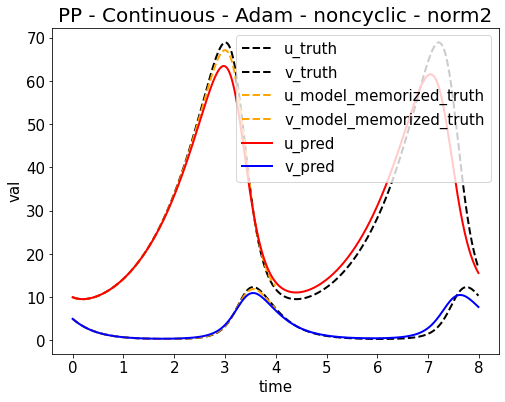

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558203.png


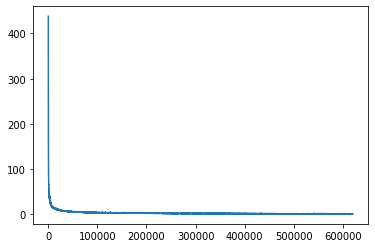

Epoch [622000/1000000] Loss:1.113467 Loss_1:0.000027 Loss_2:0.003762 Loss_3:0.000000 Loss_4:1.109677 Lr:0.001000 Time:20.824126s (98.53min in total, 59.88min remains)
Epoch [624000/1000000] Loss:0.857561 Loss_1:0.000113 Loss_2:0.005350 Loss_3:0.000000 Loss_4:0.852098 Lr:0.001000 Time:18.766971s (98.84min in total, 59.56min remains)
Epoch [626000/1000000] Loss:0.838765 Loss_1:0.000004 Loss_2:0.002211 Loss_3:0.000000 Loss_4:0.836550 Lr:0.001000 Time:18.958098s (99.16min in total, 59.24min remains)
Epoch [628000/1000000] Loss:0.846124 Loss_1:0.000000 Loss_2:0.001262 Loss_3:0.000000 Loss_4:0.844862 Lr:0.001000 Time:18.771763s (99.47min in total, 58.92min remains)
Epoch [630000/1000000] Loss:0.853654 Loss_1:0.000068 Loss_2:0.005489 Loss_3:0.000000 Loss_4:0.848097 Lr:0.001000 Time:19.074934s (99.79min in total, 58.61min remains)
Epoch [632000/1000000] Loss:1.526627 Loss_1:0.000028 Loss_2:0.001854 Loss_3:0.000000 Loss_4:1.524745 Lr:0.001000 Time:18.814184s (100.10min in total, 58.29min remain

<Figure size 432x288 with 0 Axes>

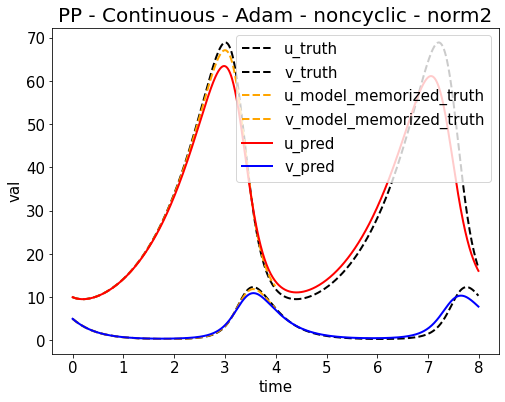

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558394.png


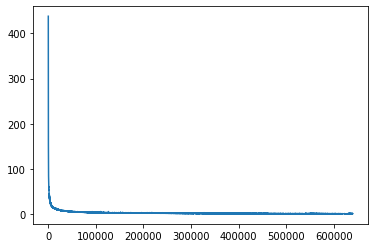

Epoch [642000/1000000] Loss:1.011397 Loss_1:0.000037 Loss_2:0.001717 Loss_3:0.000000 Loss_4:1.009644 Lr:0.001000 Time:20.954601s (101.72min in total, 56.72min remains)
Epoch [644000/1000000] Loss:1.014921 Loss_1:0.000002 Loss_2:0.001443 Loss_3:0.000000 Loss_4:1.013476 Lr:0.001000 Time:18.765084s (102.03min in total, 56.40min remains)
Epoch [646000/1000000] Loss:0.961262 Loss_1:0.000007 Loss_2:0.002873 Loss_3:0.000000 Loss_4:0.958381 Lr:0.001000 Time:18.815174s (102.34min in total, 56.08min remains)
Epoch [648000/1000000] Loss:0.942525 Loss_1:0.000011 Loss_2:0.006534 Loss_3:0.000000 Loss_4:0.935980 Lr:0.001000 Time:18.860705s (102.66min in total, 55.76min remains)
Epoch [650000/1000000] Loss:1.011825 Loss_1:0.000034 Loss_2:0.029884 Loss_3:0.000000 Loss_4:0.981907 Lr:0.001000 Time:18.734491s (102.97min in total, 55.45min remains)
Epoch [652000/1000000] Loss:0.946597 Loss_1:0.000027 Loss_2:0.004958 Loss_3:0.000000 Loss_4:0.941612 Lr:0.001000 Time:18.831054s (103.28min in total, 55.13min r

<Figure size 432x288 with 0 Axes>

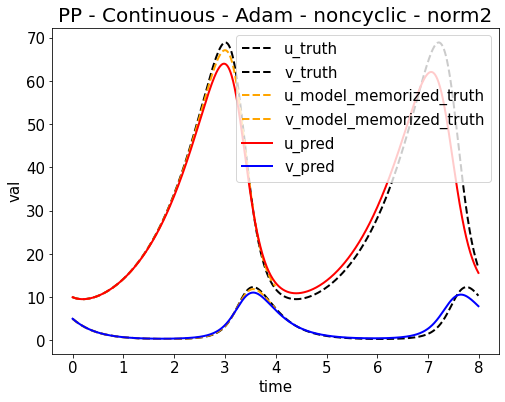

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558584.png


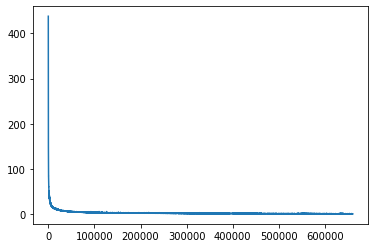

Epoch [662000/1000000] Loss:0.888339 Loss_1:0.000009 Loss_2:0.006439 Loss_3:0.000000 Loss_4:0.881891 Lr:0.001000 Time:21.139203s (104.89min in total, 53.55min remains)
Epoch [664000/1000000] Loss:0.862984 Loss_1:0.000069 Loss_2:0.001942 Loss_3:0.000000 Loss_4:0.860973 Lr:0.001000 Time:18.887892s (105.21min in total, 53.24min remains)
Epoch [666000/1000000] Loss:0.836880 Loss_1:0.000066 Loss_2:0.004762 Loss_3:0.000000 Loss_4:0.832051 Lr:0.001000 Time:18.932548s (105.52min in total, 52.92min remains)
Epoch [668000/1000000] Loss:0.905272 Loss_1:0.000022 Loss_2:0.002270 Loss_3:0.000000 Loss_4:0.902980 Lr:0.001000 Time:18.930469s (105.84min in total, 52.60min remains)
Epoch [670000/1000000] Loss:0.981161 Loss_1:0.000000 Loss_2:0.001327 Loss_3:0.000000 Loss_4:0.979834 Lr:0.001000 Time:19.023546s (106.15min in total, 52.28min remains)
Epoch [672000/1000000] Loss:0.966434 Loss_1:0.000056 Loss_2:0.004051 Loss_3:0.000000 Loss_4:0.962327 Lr:0.001000 Time:18.999156s (106.47min in total, 51.97min r

<Figure size 432x288 with 0 Axes>

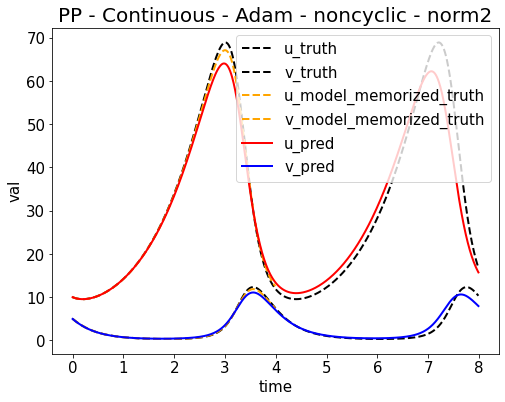

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558776.png


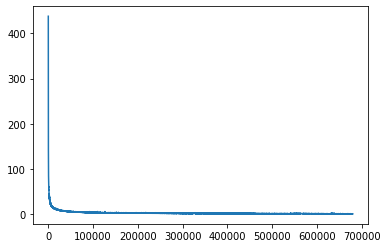

Epoch [682000/1000000] Loss:0.833796 Loss_1:0.000001 Loss_2:0.001495 Loss_3:0.000000 Loss_4:0.832299 Lr:0.001000 Time:20.935680s (108.08min in total, 50.40min remains)
Epoch [684000/1000000] Loss:0.860458 Loss_1:0.000034 Loss_2:0.006942 Loss_3:0.000000 Loss_4:0.853482 Lr:0.001000 Time:18.911389s (108.40min in total, 50.08min remains)
Epoch [686000/1000000] Loss:0.834853 Loss_1:0.000017 Loss_2:0.001333 Loss_3:0.000000 Loss_4:0.833503 Lr:0.001000 Time:19.003777s (108.72min in total, 49.76min remains)
Epoch [688000/1000000] Loss:0.839624 Loss_1:0.000010 Loss_2:0.001180 Loss_3:0.000000 Loss_4:0.838434 Lr:0.001000 Time:18.870385s (109.03min in total, 49.44min remains)
Epoch [690000/1000000] Loss:1.124203 Loss_1:0.000003 Loss_2:0.004008 Loss_3:0.000000 Loss_4:1.120191 Lr:0.001000 Time:18.781430s (109.34min in total, 49.13min remains)
Epoch [692000/1000000] Loss:1.767112 Loss_1:0.000003 Loss_2:0.001941 Loss_3:0.000000 Loss_4:1.765169 Lr:0.001000 Time:18.749606s (109.66min in total, 48.81min r

<Figure size 432x288 with 0 Axes>

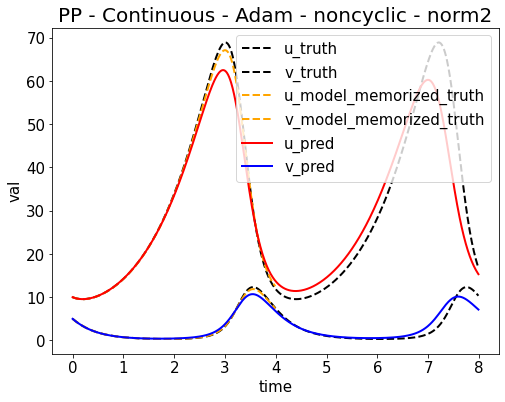

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653558967.png


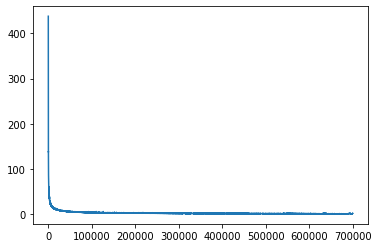

Epoch [702000/1000000] Loss:1.914727 Loss_1:0.000006 Loss_2:0.002536 Loss_3:0.000000 Loss_4:1.912185 Lr:0.001000 Time:21.073573s (111.27min in total, 47.23min remains)
Epoch [704000/1000000] Loss:1.782548 Loss_1:0.000001 Loss_2:0.002671 Loss_3:0.000000 Loss_4:1.779875 Lr:0.001000 Time:18.906424s (111.58min in total, 46.91min remains)
Epoch [706000/1000000] Loss:0.948444 Loss_1:0.000031 Loss_2:0.002162 Loss_3:0.000000 Loss_4:0.946251 Lr:0.001000 Time:18.807671s (111.89min in total, 46.60min remains)
Epoch [708000/1000000] Loss:0.824453 Loss_1:0.000003 Loss_2:0.001736 Loss_3:0.000000 Loss_4:0.822714 Lr:0.001000 Time:18.944570s (112.21min in total, 46.28min remains)
Epoch [710000/1000000] Loss:0.835656 Loss_1:0.000092 Loss_2:0.004366 Loss_3:0.000000 Loss_4:0.831198 Lr:0.001000 Time:18.802124s (112.52min in total, 45.96min remains)
Epoch [712000/1000000] Loss:0.845994 Loss_1:0.000010 Loss_2:0.005889 Loss_3:0.000000 Loss_4:0.840095 Lr:0.001000 Time:18.848075s (112.84min in total, 45.64min r

<Figure size 432x288 with 0 Axes>

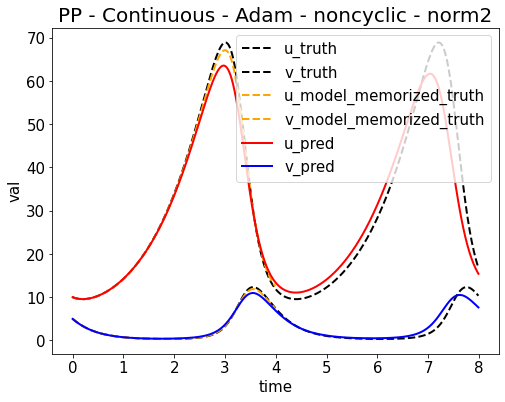

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653559158.png


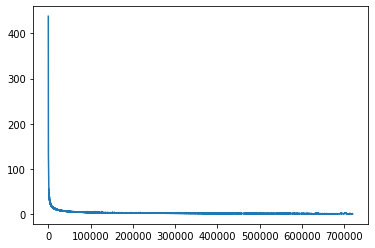

Epoch [722000/1000000] Loss:1.210789 Loss_1:0.000000 Loss_2:0.001510 Loss_3:0.000000 Loss_4:1.209279 Lr:0.001000 Time:21.045075s (114.45min in total, 44.07min remains)
Epoch [724000/1000000] Loss:1.233931 Loss_1:0.000040 Loss_2:0.003474 Loss_3:0.000000 Loss_4:1.230417 Lr:0.001000 Time:18.972933s (114.77min in total, 43.75min remains)
Epoch [726000/1000000] Loss:1.176257 Loss_1:0.000017 Loss_2:0.002839 Loss_3:0.000000 Loss_4:1.173401 Lr:0.001000 Time:18.809605s (115.08min in total, 43.43min remains)
Epoch [728000/1000000] Loss:1.194092 Loss_1:0.000417 Loss_2:0.026054 Loss_3:0.000000 Loss_4:1.167621 Lr:0.001000 Time:18.846745s (115.40min in total, 43.12min remains)
Epoch [730000/1000000] Loss:1.131180 Loss_1:0.000021 Loss_2:0.004646 Loss_3:0.000000 Loss_4:1.126513 Lr:0.001000 Time:18.961888s (115.71min in total, 42.80min remains)
Epoch [732000/1000000] Loss:1.120383 Loss_1:0.000209 Loss_2:0.004968 Loss_3:0.000000 Loss_4:1.115205 Lr:0.001000 Time:18.756182s (116.03min in total, 42.48min r

<Figure size 432x288 with 0 Axes>

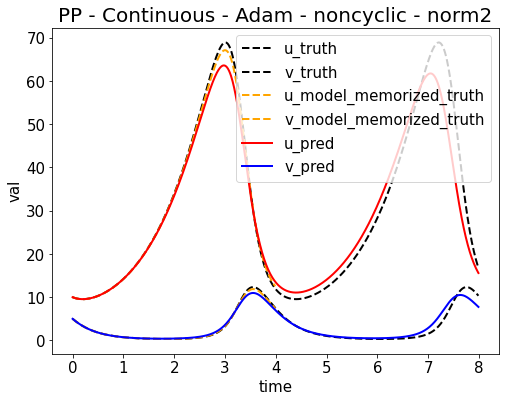

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653559349.png


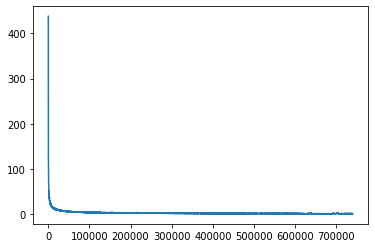

Epoch [742000/1000000] Loss:1.110484 Loss_1:0.000351 Loss_2:0.028355 Loss_3:0.000000 Loss_4:1.081777 Lr:0.001000 Time:20.833469s (117.63min in total, 40.90min remains)
Epoch [744000/1000000] Loss:1.200975 Loss_1:0.000082 Loss_2:0.007884 Loss_3:0.000000 Loss_4:1.193008 Lr:0.001000 Time:18.865284s (117.95min in total, 40.58min remains)
Epoch [746000/1000000] Loss:1.145159 Loss_1:0.000019 Loss_2:0.005243 Loss_3:0.000000 Loss_4:1.139897 Lr:0.001000 Time:18.974360s (118.26min in total, 40.27min remains)
Epoch [748000/1000000] Loss:1.139451 Loss_1:0.000001 Loss_2:0.005809 Loss_3:0.000000 Loss_4:1.133641 Lr:0.001000 Time:18.920542s (118.58min in total, 39.95min remains)
Epoch [750000/1000000] Loss:1.107697 Loss_1:0.000041 Loss_2:0.023273 Loss_3:0.000000 Loss_4:1.084383 Lr:0.001000 Time:18.831648s (118.89min in total, 39.63min remains)
Epoch [752000/1000000] Loss:1.086065 Loss_1:0.000003 Loss_2:0.002259 Loss_3:0.000000 Loss_4:1.083803 Lr:0.001000 Time:18.784040s (119.21min in total, 39.31min r

<Figure size 432x288 with 0 Axes>

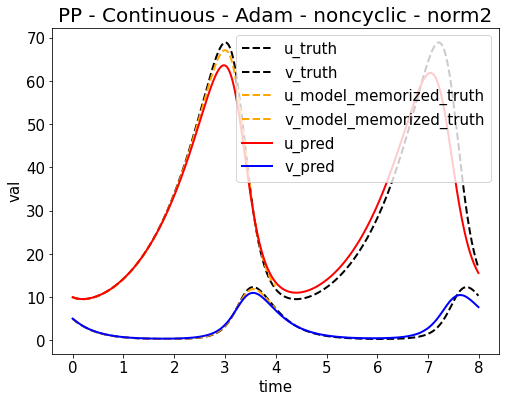

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653559540.png


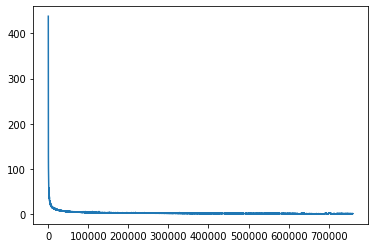

Epoch [762000/1000000] Loss:1.091094 Loss_1:0.000185 Loss_2:0.012409 Loss_3:0.000000 Loss_4:1.078500 Lr:0.001000 Time:21.372460s (120.82min in total, 37.74min remains)
Epoch [764000/1000000] Loss:1.126419 Loss_1:0.000014 Loss_2:0.002496 Loss_3:0.000000 Loss_4:1.123909 Lr:0.001000 Time:19.412455s (121.15min in total, 37.42min remains)
Epoch [766000/1000000] Loss:1.072825 Loss_1:0.000001 Loss_2:0.003330 Loss_3:0.000000 Loss_4:1.069493 Lr:0.001000 Time:19.401019s (121.47min in total, 37.11min remains)
Epoch [768000/1000000] Loss:1.154598 Loss_1:0.000135 Loss_2:0.003264 Loss_3:0.000000 Loss_4:1.151199 Lr:0.001000 Time:19.037312s (121.79min in total, 36.79min remains)
Epoch [770000/1000000] Loss:1.139230 Loss_1:0.000061 Loss_2:0.037604 Loss_3:0.000000 Loss_4:1.101565 Lr:0.001000 Time:18.983122s (122.10min in total, 36.47min remains)
Epoch [772000/1000000] Loss:1.080447 Loss_1:0.000004 Loss_2:0.001550 Loss_3:0.000000 Loss_4:1.078892 Lr:0.001000 Time:19.032152s (122.42min in total, 36.16min r

<Figure size 432x288 with 0 Axes>

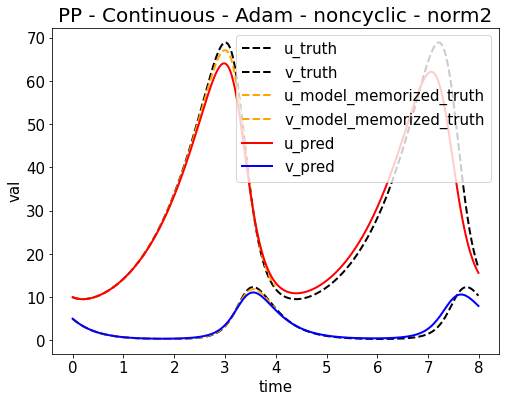

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653559733.png


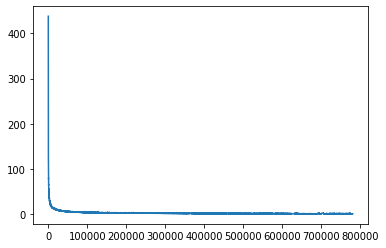

Epoch [782000/1000000] Loss:0.632335 Loss_1:0.000037 Loss_2:0.008178 Loss_3:0.000000 Loss_4:0.624120 Lr:0.001000 Time:21.374762s (124.03min in total, 34.58min remains)
Epoch [784000/1000000] Loss:0.743958 Loss_1:0.000080 Loss_2:0.002439 Loss_3:0.000000 Loss_4:0.741439 Lr:0.001000 Time:18.806551s (124.35min in total, 34.26min remains)
Epoch [786000/1000000] Loss:0.799652 Loss_1:0.000004 Loss_2:0.003539 Loss_3:0.000000 Loss_4:0.796109 Lr:0.001000 Time:18.891339s (124.66min in total, 33.94min remains)
Epoch [788000/1000000] Loss:0.793305 Loss_1:0.000003 Loss_2:0.001410 Loss_3:0.000000 Loss_4:0.791892 Lr:0.001000 Time:18.861369s (124.98min in total, 33.62min remains)
Epoch [790000/1000000] Loss:0.756492 Loss_1:0.000007 Loss_2:0.001370 Loss_3:0.000000 Loss_4:0.755114 Lr:0.001000 Time:18.721314s (125.29min in total, 33.30min remains)
Epoch [792000/1000000] Loss:0.740746 Loss_1:0.000601 Loss_2:0.009558 Loss_3:0.000000 Loss_4:0.730587 Lr:0.001000 Time:18.963407s (125.61min in total, 32.99min r

<Figure size 432x288 with 0 Axes>

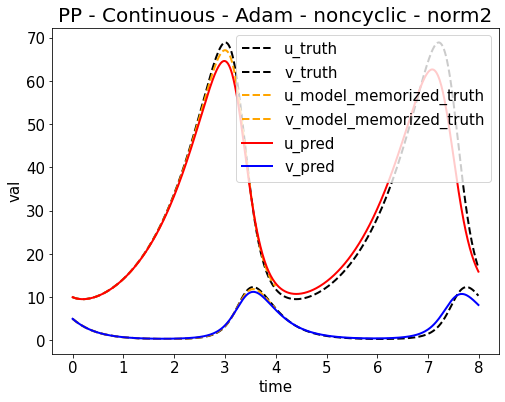

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653559924.png


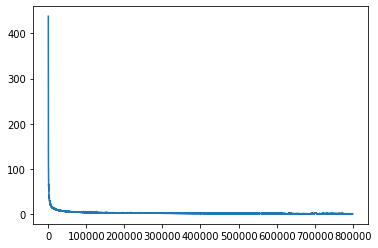

Epoch [802000/1000000] Loss:0.574004 Loss_1:0.000001 Loss_2:0.004290 Loss_3:0.000000 Loss_4:0.569713 Lr:0.001000 Time:21.129671s (127.22min in total, 31.41min remains)
Epoch [804000/1000000] Loss:1.612553 Loss_1:0.000064 Loss_2:0.017627 Loss_3:0.000000 Loss_4:1.594861 Lr:0.001000 Time:18.958914s (127.53min in total, 31.09min remains)
Epoch [806000/1000000] Loss:1.499937 Loss_1:0.000045 Loss_2:0.011624 Loss_3:0.000000 Loss_4:1.488268 Lr:0.001000 Time:18.847069s (127.85min in total, 30.77min remains)
Epoch [808000/1000000] Loss:1.374680 Loss_1:0.000178 Loss_2:0.002429 Loss_3:0.000000 Loss_4:1.372072 Lr:0.001000 Time:18.871980s (128.16min in total, 30.45min remains)
Epoch [810000/1000000] Loss:1.245553 Loss_1:0.000014 Loss_2:0.002378 Loss_3:0.000000 Loss_4:1.243162 Lr:0.001000 Time:18.798135s (128.47min in total, 30.14min remains)
Epoch [812000/1000000] Loss:1.201834 Loss_1:0.000011 Loss_2:0.001925 Loss_3:0.000000 Loss_4:1.199898 Lr:0.001000 Time:18.899003s (128.79min in total, 29.82min r

<Figure size 432x288 with 0 Axes>

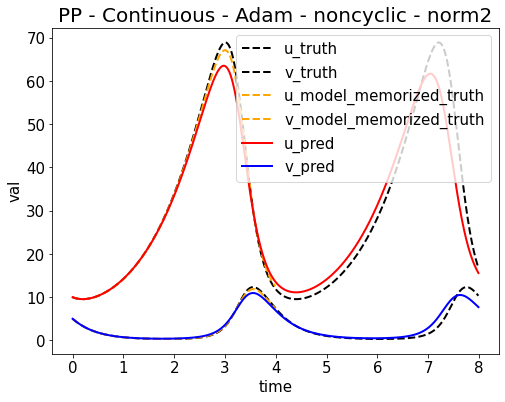

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653560115.png


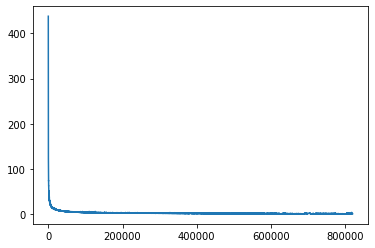

Epoch [822000/1000000] Loss:1.115662 Loss_1:0.000003 Loss_2:0.007714 Loss_3:0.000000 Loss_4:1.107945 Lr:0.001000 Time:21.262365s (130.40min in total, 28.24min remains)
Epoch [824000/1000000] Loss:0.453552 Loss_1:0.000024 Loss_2:0.020487 Loss_3:0.000000 Loss_4:0.433040 Lr:0.001000 Time:19.065821s (130.72min in total, 27.92min remains)
Epoch [826000/1000000] Loss:0.791054 Loss_1:0.000075 Loss_2:0.002803 Loss_3:0.000000 Loss_4:0.788176 Lr:0.001000 Time:18.993898s (131.03min in total, 27.60min remains)
Epoch [828000/1000000] Loss:0.427854 Loss_1:0.000003 Loss_2:0.003579 Loss_3:0.000000 Loss_4:0.424271 Lr:0.001000 Time:19.152065s (131.35min in total, 27.29min remains)
Epoch [830000/1000000] Loss:0.449940 Loss_1:0.000112 Loss_2:0.004738 Loss_3:0.000000 Loss_4:0.445090 Lr:0.001000 Time:19.471361s (131.68min in total, 26.97min remains)
Epoch [832000/1000000] Loss:0.638227 Loss_1:0.000001 Loss_2:0.000968 Loss_3:0.000000 Loss_4:0.637258 Lr:0.001000 Time:18.792524s (131.99min in total, 26.65min r

<Figure size 432x288 with 0 Axes>

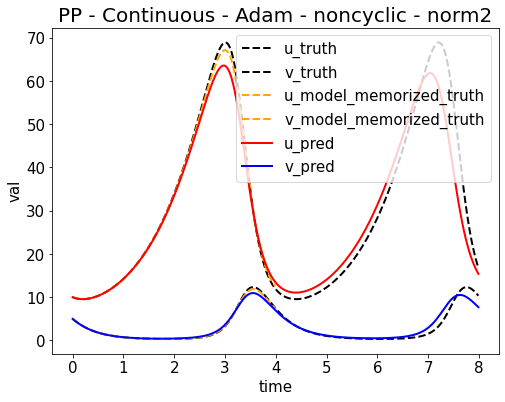

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653560307.png


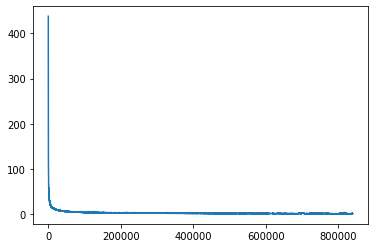

Epoch [842000/1000000] Loss:0.996595 Loss_1:0.000019 Loss_2:0.026775 Loss_3:0.000000 Loss_4:0.969801 Lr:0.001000 Time:21.180464s (133.60min in total, 25.07min remains)
Epoch [844000/1000000] Loss:0.103123 Loss_1:0.000220 Loss_2:0.024129 Loss_3:0.000000 Loss_4:0.078774 Lr:0.001000 Time:18.841374s (133.92min in total, 24.75min remains)
Epoch [846000/1000000] Loss:0.143955 Loss_1:0.000124 Loss_2:0.003978 Loss_3:0.000000 Loss_4:0.139853 Lr:0.001000 Time:18.912320s (134.23min in total, 24.43min remains)
Epoch [848000/1000000] Loss:0.211908 Loss_1:0.000022 Loss_2:0.004097 Loss_3:0.000000 Loss_4:0.207789 Lr:0.001000 Time:18.995458s (134.55min in total, 24.12min remains)
Epoch [850000/1000000] Loss:0.236581 Loss_1:0.000026 Loss_2:0.020922 Loss_3:0.000000 Loss_4:0.215633 Lr:0.001000 Time:18.866229s (134.86min in total, 23.80min remains)
Epoch [852000/1000000] Loss:0.365700 Loss_1:0.000000 Loss_2:0.000974 Loss_3:0.000000 Loss_4:0.364725 Lr:0.001000 Time:18.814820s (135.18min in total, 23.48min r

<Figure size 432x288 with 0 Axes>

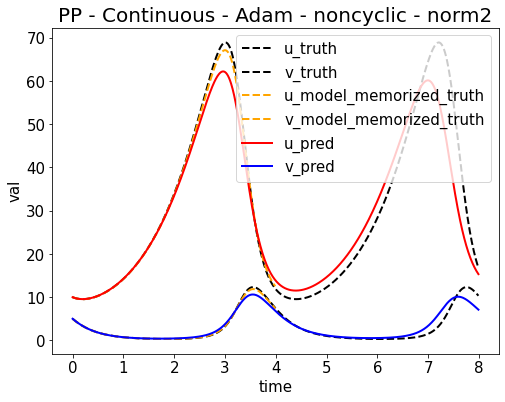

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653560499.png


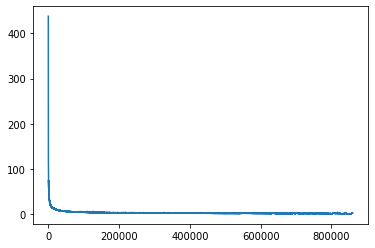

Epoch [862000/1000000] Loss:3.345737 Loss_1:0.000013 Loss_2:0.003642 Loss_3:0.000000 Loss_4:3.342082 Lr:0.001000 Time:21.302569s (136.80min in total, 21.90min remains)
Epoch [864000/1000000] Loss:2.917130 Loss_1:0.000024 Loss_2:0.011317 Loss_3:0.000000 Loss_4:2.905788 Lr:0.001000 Time:18.917251s (137.11min in total, 21.58min remains)
Epoch [866000/1000000] Loss:4.170688 Loss_1:0.000069 Loss_2:0.006591 Loss_3:0.000000 Loss_4:4.164028 Lr:0.001000 Time:18.894265s (137.43min in total, 21.26min remains)
Epoch [868000/1000000] Loss:3.861360 Loss_1:0.000018 Loss_2:0.005067 Loss_3:0.000000 Loss_4:3.856275 Lr:0.001000 Time:18.800166s (137.74min in total, 20.95min remains)
Epoch [870000/1000000] Loss:3.278243 Loss_1:0.000008 Loss_2:0.004221 Loss_3:0.000000 Loss_4:3.274014 Lr:0.001000 Time:18.901474s (138.05min in total, 20.63min remains)
Epoch [872000/1000000] Loss:2.625550 Loss_1:0.000011 Loss_2:0.003021 Loss_3:0.000000 Loss_4:2.622517 Lr:0.001000 Time:18.869974s (138.37min in total, 20.31min r

<Figure size 432x288 with 0 Axes>

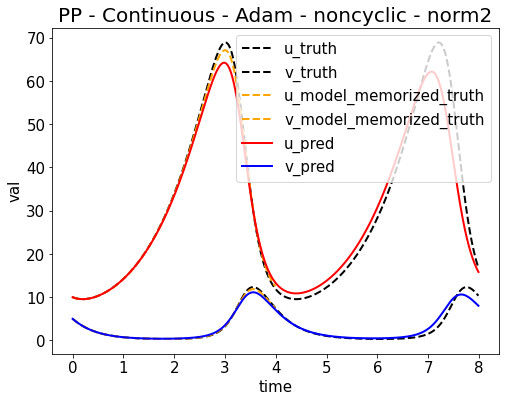

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653560690.png


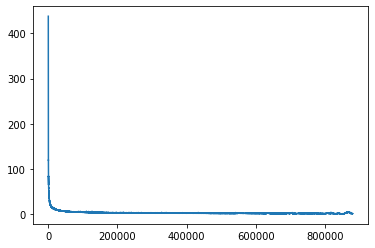

Epoch [882000/1000000] Loss:0.757458 Loss_1:0.000032 Loss_2:0.008806 Loss_3:0.000000 Loss_4:0.748621 Lr:0.001000 Time:21.484623s (139.98min in total, 18.73min remains)
Epoch [884000/1000000] Loss:0.778080 Loss_1:0.000005 Loss_2:0.001344 Loss_3:0.000000 Loss_4:0.776731 Lr:0.001000 Time:19.005970s (140.30min in total, 18.41min remains)
Epoch [886000/1000000] Loss:1.347156 Loss_1:0.000008 Loss_2:0.002629 Loss_3:0.000000 Loss_4:1.344519 Lr:0.001000 Time:18.968503s (140.62min in total, 18.09min remains)
Epoch [888000/1000000] Loss:1.234408 Loss_1:0.000009 Loss_2:0.002085 Loss_3:0.000000 Loss_4:1.232314 Lr:0.001000 Time:18.987730s (140.93min in total, 17.78min remains)
Epoch [890000/1000000] Loss:1.219376 Loss_1:0.000052 Loss_2:0.002149 Loss_3:0.000000 Loss_4:1.217174 Lr:0.001000 Time:19.083539s (141.25min in total, 17.46min remains)
Epoch [892000/1000000] Loss:1.087287 Loss_1:0.000011 Loss_2:0.001452 Loss_3:0.000000 Loss_4:1.085824 Lr:0.001000 Time:18.950650s (141.57min in total, 17.14min r

<Figure size 432x288 with 0 Axes>

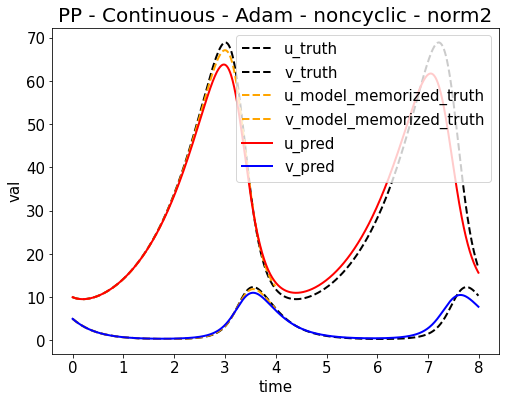

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653560882.png


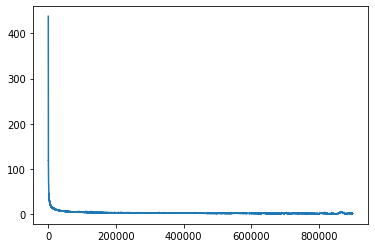

Epoch [902000/1000000] Loss:1.027575 Loss_1:0.000000 Loss_2:0.007203 Loss_3:0.000000 Loss_4:1.020371 Lr:0.001000 Time:21.082725s (143.18min in total, 15.56min remains)
Epoch [904000/1000000] Loss:1.022595 Loss_1:0.000035 Loss_2:0.002166 Loss_3:0.000000 Loss_4:1.020394 Lr:0.001000 Time:18.868742s (143.50min in total, 15.24min remains)
Epoch [906000/1000000] Loss:0.928246 Loss_1:0.000518 Loss_2:0.036690 Loss_3:0.000000 Loss_4:0.891038 Lr:0.001000 Time:18.954309s (143.81min in total, 14.92min remains)
Epoch [908000/1000000] Loss:0.935700 Loss_1:0.000025 Loss_2:0.001940 Loss_3:0.000000 Loss_4:0.933734 Lr:0.001000 Time:18.838535s (144.13min in total, 14.60min remains)
Epoch [910000/1000000] Loss:0.922982 Loss_1:0.000001 Loss_2:0.021408 Loss_3:0.000000 Loss_4:0.901572 Lr:0.001000 Time:18.805621s (144.44min in total, 14.29min remains)
Epoch [912000/1000000] Loss:0.916950 Loss_1:0.000003 Loss_2:0.005124 Loss_3:0.000000 Loss_4:0.911822 Lr:0.001000 Time:18.906824s (144.75min in total, 13.97min r

<Figure size 432x288 with 0 Axes>

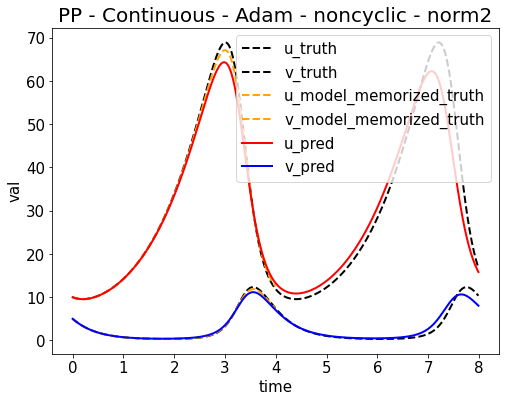

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561073.png


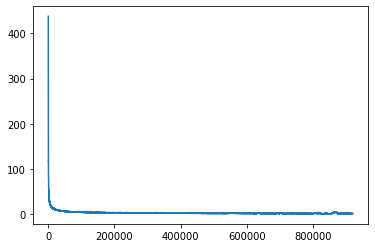

Epoch [922000/1000000] Loss:0.727476 Loss_1:0.000041 Loss_2:0.003763 Loss_3:0.000000 Loss_4:0.723671 Lr:0.001000 Time:21.591088s (146.37min in total, 12.38min remains)
Epoch [924000/1000000] Loss:0.734319 Loss_1:0.000013 Loss_2:0.001412 Loss_3:0.000000 Loss_4:0.732894 Lr:0.001000 Time:18.865271s (146.68min in total, 12.06min remains)
Epoch [926000/1000000] Loss:0.752856 Loss_1:0.000045 Loss_2:0.026747 Loss_3:0.000000 Loss_4:0.726063 Lr:0.001000 Time:18.800268s (147.00min in total, 11.75min remains)
Epoch [928000/1000000] Loss:0.839191 Loss_1:0.000000 Loss_2:0.001514 Loss_3:0.000000 Loss_4:0.837677 Lr:0.001000 Time:18.879177s (147.31min in total, 11.43min remains)
Epoch [930000/1000000] Loss:0.804772 Loss_1:0.000002 Loss_2:0.001203 Loss_3:0.000000 Loss_4:0.803567 Lr:0.001000 Time:18.851635s (147.62min in total, 11.11min remains)
Epoch [932000/1000000] Loss:0.824608 Loss_1:0.000010 Loss_2:0.001240 Loss_3:0.000000 Loss_4:0.823357 Lr:0.001000 Time:18.837156s (147.94min in total, 10.79min r

<Figure size 432x288 with 0 Axes>

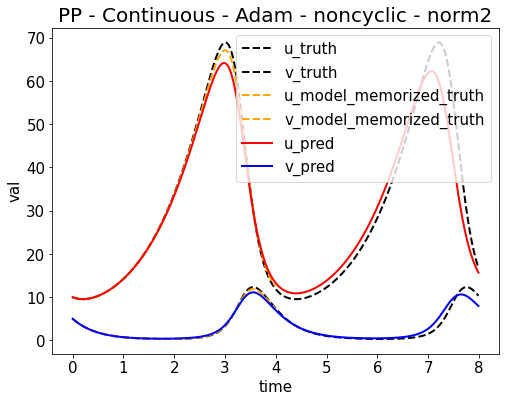

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561264.png


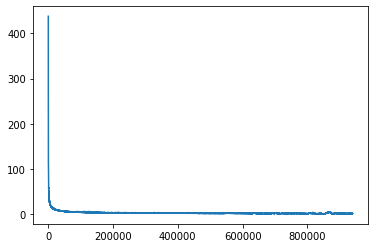

Epoch [942000/1000000] Loss:0.776431 Loss_1:0.000001 Loss_2:0.001277 Loss_3:0.000000 Loss_4:0.775153 Lr:0.001000 Time:21.488269s (149.56min in total, 9.21min remains)
Epoch [944000/1000000] Loss:0.778424 Loss_1:0.000173 Loss_2:0.003256 Loss_3:0.000000 Loss_4:0.774995 Lr:0.001000 Time:18.888821s (149.87min in total, 8.89min remains)
Epoch [946000/1000000] Loss:0.760578 Loss_1:0.000009 Loss_2:0.001596 Loss_3:0.000000 Loss_4:0.758973 Lr:0.001000 Time:18.988645s (150.19min in total, 8.57min remains)
Epoch [948000/1000000] Loss:0.766213 Loss_1:0.000001 Loss_2:0.001093 Loss_3:0.000000 Loss_4:0.765119 Lr:0.001000 Time:19.146004s (150.51min in total, 8.26min remains)
Epoch [950000/1000000] Loss:0.823426 Loss_1:0.000132 Loss_2:0.037413 Loss_3:0.000000 Loss_4:0.785882 Lr:0.001000 Time:19.137609s (150.83min in total, 7.94min remains)
Epoch [952000/1000000] Loss:0.766866 Loss_1:0.000031 Loss_2:0.002255 Loss_3:0.000000 Loss_4:0.764579 Lr:0.001000 Time:19.022223s (151.14min in total, 7.62min remains

<Figure size 432x288 with 0 Axes>

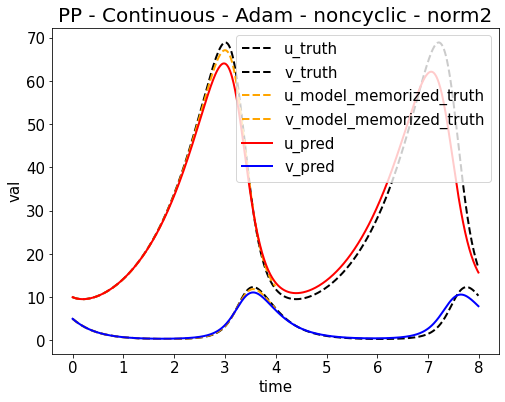

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561457.png


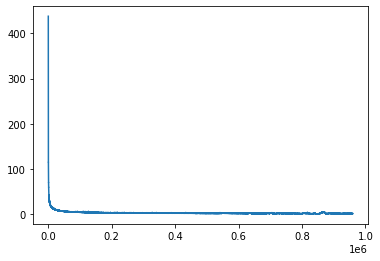

Epoch [962000/1000000] Loss:0.885082 Loss_1:0.000024 Loss_2:0.016816 Loss_3:0.000000 Loss_4:0.868241 Lr:0.001000 Time:21.224003s (152.77min in total, 6.03min remains)
Epoch [964000/1000000] Loss:0.870426 Loss_1:0.000152 Loss_2:0.042996 Loss_3:0.000000 Loss_4:0.827278 Lr:0.001000 Time:18.978660s (153.08min in total, 5.72min remains)
Epoch [966000/1000000] Loss:0.729632 Loss_1:0.000003 Loss_2:0.001136 Loss_3:0.000000 Loss_4:0.728493 Lr:0.001000 Time:18.836450s (153.40min in total, 5.40min remains)
Epoch [968000/1000000] Loss:0.736985 Loss_1:0.000000 Loss_2:0.001251 Loss_3:0.000000 Loss_4:0.735734 Lr:0.001000 Time:18.818283s (153.71min in total, 5.08min remains)
Epoch [970000/1000000] Loss:0.753492 Loss_1:0.000003 Loss_2:0.004044 Loss_3:0.000000 Loss_4:0.749444 Lr:0.001000 Time:18.956206s (154.03min in total, 4.76min remains)
Epoch [972000/1000000] Loss:0.744913 Loss_1:0.000004 Loss_2:0.001200 Loss_3:0.000000 Loss_4:0.743708 Lr:0.001000 Time:18.838482s (154.34min in total, 4.45min remains

<Figure size 432x288 with 0 Axes>

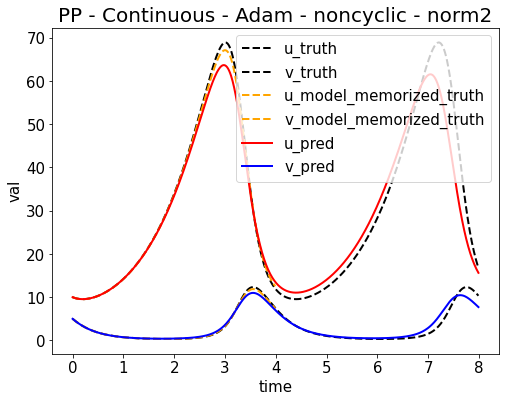

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561649.png


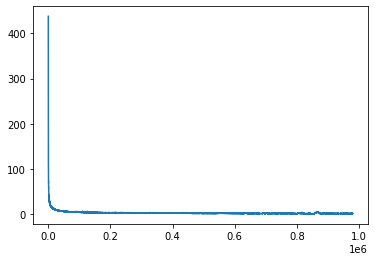

Epoch [982000/1000000] Loss:1.014505 Loss_1:0.000002 Loss_2:0.001367 Loss_3:0.000000 Loss_4:1.013136 Lr:0.001000 Time:21.693106s (155.97min in total, 2.86min remains)
Epoch [984000/1000000] Loss:0.948581 Loss_1:0.000001 Loss_2:0.010502 Loss_3:0.000000 Loss_4:0.938078 Lr:0.001000 Time:18.865316s (156.29min in total, 2.54min remains)
Epoch [986000/1000000] Loss:0.906989 Loss_1:0.000007 Loss_2:0.001372 Loss_3:0.000000 Loss_4:0.905610 Lr:0.001000 Time:18.894612s (156.60min in total, 2.22min remains)
Epoch [988000/1000000] Loss:0.836419 Loss_1:0.000007 Loss_2:0.001237 Loss_3:0.000000 Loss_4:0.835174 Lr:0.001000 Time:19.074493s (156.92min in total, 1.91min remains)
Epoch [990000/1000000] Loss:0.804658 Loss_1:0.000025 Loss_2:0.008266 Loss_3:0.000000 Loss_4:0.796366 Lr:0.001000 Time:19.053157s (157.24min in total, 1.59min remains)
Epoch [992000/1000000] Loss:0.804920 Loss_1:0.000008 Loss_2:0.001155 Loss_3:0.000000 Loss_4:0.803756 Lr:0.001000 Time:19.227973s (157.56min in total, 1.27min remains

<Figure size 432x288 with 0 Axes>

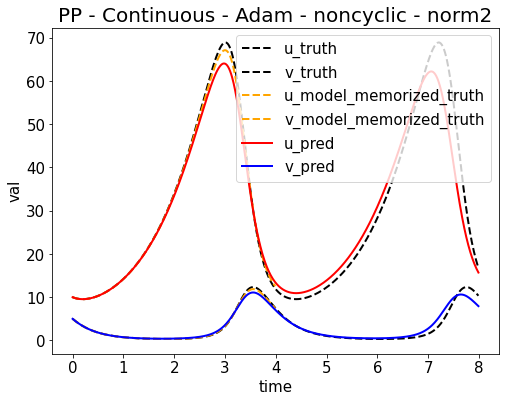

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561841.png


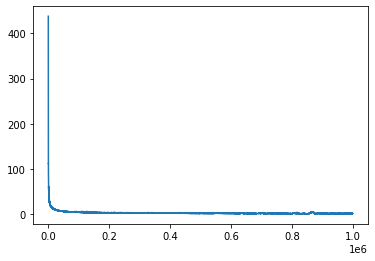

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
i = 2, length of truth = 800 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.

<Figure size 432x288 with 0 Axes>

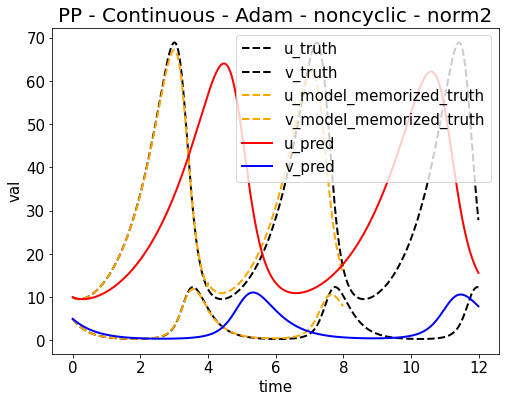

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653561844.png
using cuda
epoch = 1000000
epoch_step = 2000
model_name = SimpleNetworkPP_Continue
now_string = 2022-05-26-06-01-18
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 2000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 20000}
config = {'model_name': 'SimpleNetworkPP_Continue', 'T': 12.0, 'T_all': 20.0, 'T_unit': 0.01, 'N': 1200, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0,

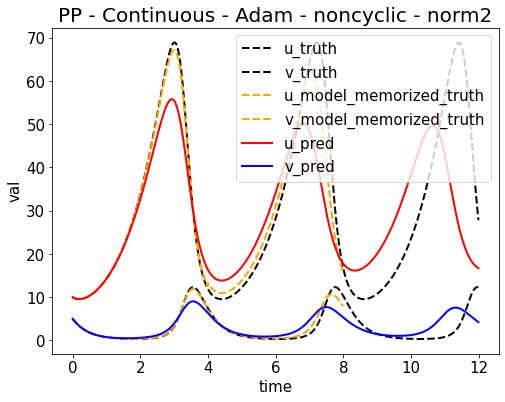

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653562065.png


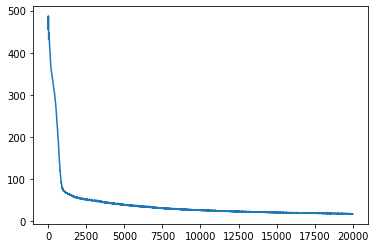

Epoch [22000/1000000] Loss:16.789410 Loss_1:0.000574 Loss_2:0.054249 Loss_3:0.000000 Loss_4:16.734587 Lr:0.001000 Time:23.218878s (4.05min in total, 180.13min remains)
Epoch [24000/1000000] Loss:16.451893 Loss_1:0.000252 Loss_2:0.016970 Loss_3:0.000000 Loss_4:16.434671 Lr:0.001000 Time:22.197364s (4.42min in total, 179.83min remains)
Epoch [26000/1000000] Loss:15.463157 Loss_1:0.000012 Loss_2:0.009256 Loss_3:0.000000 Loss_4:15.453888 Lr:0.001000 Time:21.919591s (4.79min in total, 179.34min remains)
Epoch [28000/1000000] Loss:14.881408 Loss_1:0.000223 Loss_2:0.031085 Loss_3:0.000000 Loss_4:14.850100 Lr:0.001000 Time:21.976299s (5.15min in total, 178.90min remains)
Epoch [30000/1000000] Loss:14.386168 Loss_1:0.000035 Loss_2:0.022413 Loss_3:0.000000 Loss_4:14.363720 Lr:0.001000 Time:21.892486s (5.52min in total, 178.43min remains)
Epoch [32000/1000000] Loss:13.951861 Loss_1:0.000015 Loss_2:0.010626 Loss_3:0.000000 Loss_4:13.941220 Lr:0.001000 Time:22.006469s (5.89min in total, 178.03min r

<Figure size 432x288 with 0 Axes>

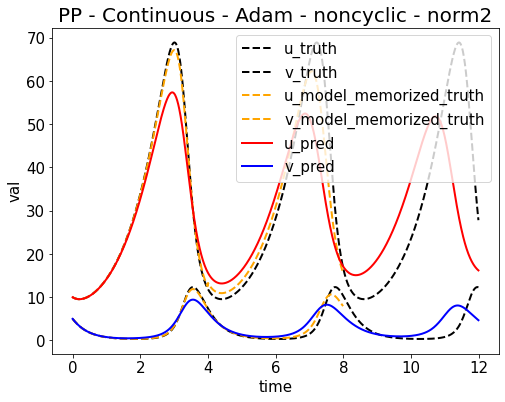

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653562287.png


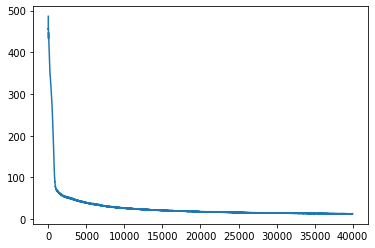

Epoch [42000/1000000] Loss:12.436247 Loss_1:0.000099 Loss_2:0.011245 Loss_3:0.000000 Loss_4:12.424902 Lr:0.001000 Time:23.024945s (7.74min in total, 176.54min remains)
Epoch [44000/1000000] Loss:12.196418 Loss_1:0.000571 Loss_2:0.018372 Loss_3:0.000000 Loss_4:12.177475 Lr:0.001000 Time:22.176822s (8.11min in total, 176.20min remains)
Epoch [46000/1000000] Loss:11.967906 Loss_1:0.000013 Loss_2:0.008083 Loss_3:0.000000 Loss_4:11.959810 Lr:0.001000 Time:21.987593s (8.48min in total, 175.78min remains)
Epoch [48000/1000000] Loss:11.859705 Loss_1:0.000083 Loss_2:0.011288 Loss_3:0.000000 Loss_4:11.848334 Lr:0.001000 Time:21.943294s (8.84min in total, 175.36min remains)
Epoch [50000/1000000] Loss:11.430002 Loss_1:0.000008 Loss_2:0.027118 Loss_3:0.000000 Loss_4:11.402876 Lr:0.001000 Time:22.056961s (9.21min in total, 174.98min remains)
Epoch [52000/1000000] Loss:11.592613 Loss_1:0.000143 Loss_2:0.009841 Loss_3:0.000000 Loss_4:11.582629 Lr:0.001000 Time:22.143563s (9.58min in total, 174.62min r

<Figure size 432x288 with 0 Axes>

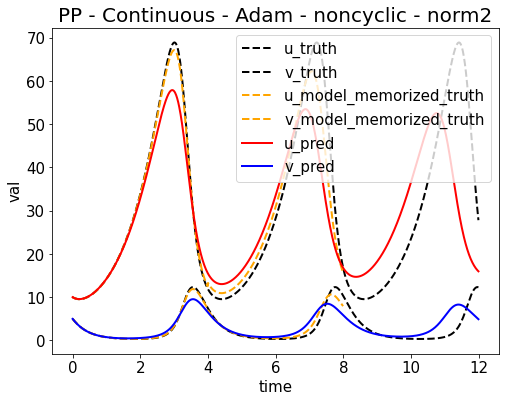

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653562508.png


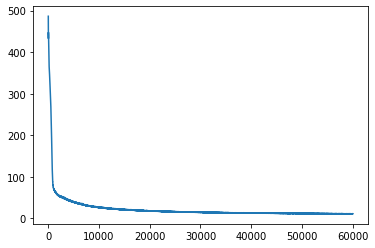

Epoch [62000/1000000] Loss:10.579492 Loss_1:0.000255 Loss_2:0.033517 Loss_3:0.000000 Loss_4:10.545719 Lr:0.001000 Time:22.940565s (11.43min in total, 172.90min remains)
Epoch [64000/1000000] Loss:10.517118 Loss_1:0.000018 Loss_2:0.009746 Loss_3:0.000000 Loss_4:10.507355 Lr:0.001000 Time:22.076619s (11.80min in total, 172.52min remains)
Epoch [66000/1000000] Loss:10.624142 Loss_1:0.000249 Loss_2:0.013458 Loss_3:0.000000 Loss_4:10.610435 Lr:0.001000 Time:22.031269s (12.16min in total, 172.13min remains)
Epoch [68000/1000000] Loss:10.313451 Loss_1:0.000022 Loss_2:0.015270 Loss_3:0.000000 Loss_4:10.298158 Lr:0.001000 Time:21.776910s (12.53min in total, 171.68min remains)
Epoch [70000/1000000] Loss:10.084550 Loss_1:0.000005 Loss_2:0.006688 Loss_3:0.000000 Loss_4:10.077857 Lr:0.001000 Time:21.962425s (12.89min in total, 171.28min remains)
Epoch [72000/1000000] Loss:10.137593 Loss_1:0.000107 Loss_2:0.031336 Loss_3:0.000000 Loss_4:10.106150 Lr:0.001000 Time:22.167969s (13.26min in total, 170.9

<Figure size 432x288 with 0 Axes>

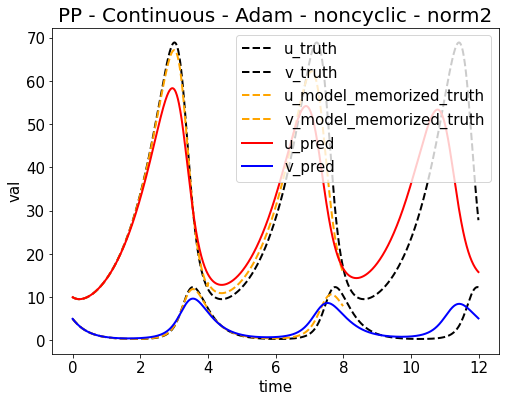

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653562730.png


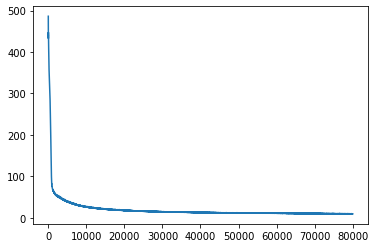

Epoch [82000/1000000] Loss:9.504129 Loss_1:0.000133 Loss_2:0.006666 Loss_3:0.000000 Loss_4:9.497331 Lr:0.001000 Time:23.340587s (15.12min in total, 169.33min remains)
Epoch [84000/1000000] Loss:9.459211 Loss_1:0.000038 Loss_2:0.010450 Loss_3:0.000000 Loss_4:9.448724 Lr:0.001000 Time:22.064609s (15.49min in total, 168.94min remains)
Epoch [86000/1000000] Loss:9.084437 Loss_1:0.000139 Loss_2:0.026328 Loss_3:0.000000 Loss_4:9.057970 Lr:0.001000 Time:22.325187s (15.86min in total, 168.61min remains)
Epoch [88000/1000000] Loss:9.062179 Loss_1:0.000012 Loss_2:0.006661 Loss_3:0.000000 Loss_4:9.055505 Lr:0.001000 Time:21.961483s (16.23min in total, 168.21min remains)
Epoch [90000/1000000] Loss:9.103146 Loss_1:0.000035 Loss_2:0.009810 Loss_3:0.000000 Loss_4:9.093301 Lr:0.001000 Time:21.803706s (16.59min in total, 167.79min remains)
Epoch [92000/1000000] Loss:9.181659 Loss_1:0.000082 Loss_2:0.044505 Loss_3:0.000000 Loss_4:9.137072 Lr:0.001000 Time:22.051646s (16.96min in total, 167.41min remains

<Figure size 432x288 with 0 Axes>

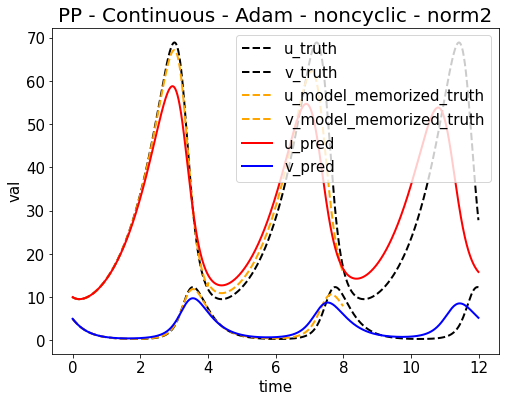

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653562952.png


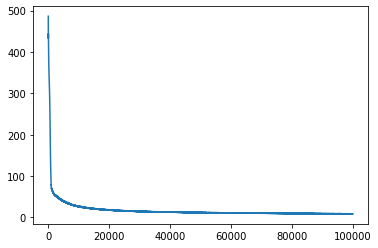

Epoch [102000/1000000] Loss:8.772010 Loss_1:0.000026 Loss_2:0.012216 Loss_3:0.000000 Loss_4:8.759768 Lr:0.001000 Time:23.355592s (18.83min in total, 165.74min remains)
Epoch [104000/1000000] Loss:8.726690 Loss_1:0.000078 Loss_2:0.015913 Loss_3:0.000000 Loss_4:8.710699 Lr:0.001000 Time:22.122937s (19.19min in total, 165.37min remains)
Epoch [106000/1000000] Loss:8.728979 Loss_1:0.000072 Loss_2:0.070451 Loss_3:0.000000 Loss_4:8.658456 Lr:0.001000 Time:21.940050s (19.56min in total, 164.97min remains)
Epoch [108000/1000000] Loss:8.569267 Loss_1:0.000004 Loss_2:0.015013 Loss_3:0.000000 Loss_4:8.554251 Lr:0.001000 Time:22.150051s (19.93min in total, 164.60min remains)
Epoch [110000/1000000] Loss:8.486180 Loss_1:0.000431 Loss_2:0.018712 Loss_3:0.000000 Loss_4:8.467038 Lr:0.001000 Time:22.297052s (20.30min in total, 164.25min remains)
Epoch [112000/1000000] Loss:8.321213 Loss_1:0.000000 Loss_2:0.005250 Loss_3:0.000000 Loss_4:8.315963 Lr:0.001000 Time:22.017834s (20.67min in total, 163.87min r

<Figure size 432x288 with 0 Axes>

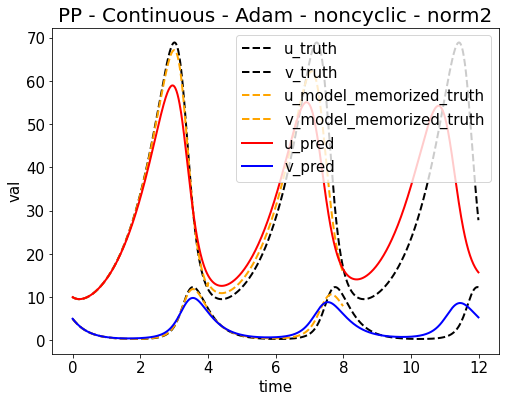

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653563173.png


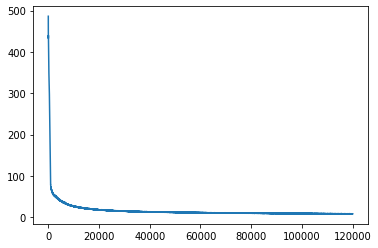

Epoch [122000/1000000] Loss:8.083561 Loss_1:0.000031 Loss_2:0.004873 Loss_3:0.000000 Loss_4:8.078657 Lr:0.001000 Time:23.227595s (22.52min in total, 162.07min remains)
Epoch [124000/1000000] Loss:8.015767 Loss_1:0.000113 Loss_2:0.010877 Loss_3:0.000000 Loss_4:8.004777 Lr:0.001000 Time:22.107625s (22.89min in total, 161.70min remains)
Epoch [126000/1000000] Loss:7.911443 Loss_1:0.000001 Loss_2:0.004568 Loss_3:0.000000 Loss_4:7.906874 Lr:0.001000 Time:21.917505s (23.25min in total, 161.30min remains)
Epoch [128000/1000000] Loss:7.819735 Loss_1:0.000017 Loss_2:0.004972 Loss_3:0.000000 Loss_4:7.814746 Lr:0.001000 Time:22.067813s (23.62min in total, 160.92min remains)
Epoch [130000/1000000] Loss:7.787227 Loss_1:0.000004 Loss_2:0.004431 Loss_3:0.000000 Loss_4:7.782792 Lr:0.001000 Time:21.979102s (23.99min in total, 160.54min remains)
Epoch [132000/1000000] Loss:7.862885 Loss_1:0.000001 Loss_2:0.004546 Loss_3:0.000000 Loss_4:7.858337 Lr:0.001000 Time:21.909526s (24.35min in total, 160.14min r

<Figure size 432x288 with 0 Axes>

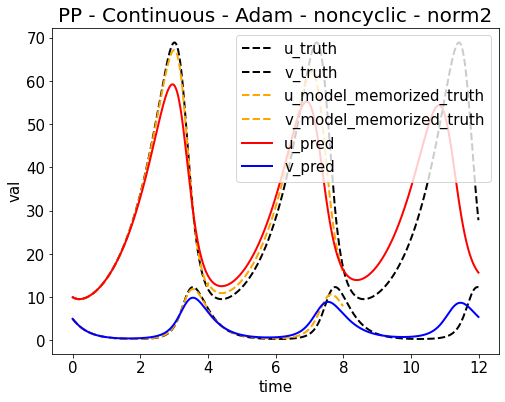

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653563395.png


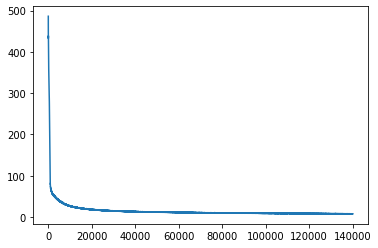

Epoch [142000/1000000] Loss:7.626893 Loss_1:0.000292 Loss_2:0.016879 Loss_3:0.000000 Loss_4:7.609723 Lr:0.001000 Time:23.159331s (26.21min in total, 158.34min remains)
Epoch [144000/1000000] Loss:7.443759 Loss_1:0.000000 Loss_2:0.004733 Loss_3:0.000000 Loss_4:7.439027 Lr:0.001000 Time:22.040617s (26.57min in total, 157.96min remains)
Epoch [146000/1000000] Loss:7.486839 Loss_1:0.000002 Loss_2:0.013043 Loss_3:0.000000 Loss_4:7.473794 Lr:0.001000 Time:22.140756s (26.94min in total, 157.59min remains)
Epoch [148000/1000000] Loss:7.316916 Loss_1:0.000047 Loss_2:0.024619 Loss_3:0.000000 Loss_4:7.292249 Lr:0.001000 Time:21.952040s (27.31min in total, 157.20min remains)
Epoch [150000/1000000] Loss:7.339680 Loss_1:0.000059 Loss_2:0.010091 Loss_3:0.000000 Loss_4:7.329529 Lr:0.001000 Time:21.873138s (27.67min in total, 156.81min remains)
Epoch [152000/1000000] Loss:7.192113 Loss_1:0.000148 Loss_2:0.054189 Loss_3:0.000000 Loss_4:7.137776 Lr:0.001000 Time:22.038195s (28.04min in total, 156.43min r

<Figure size 432x288 with 0 Axes>

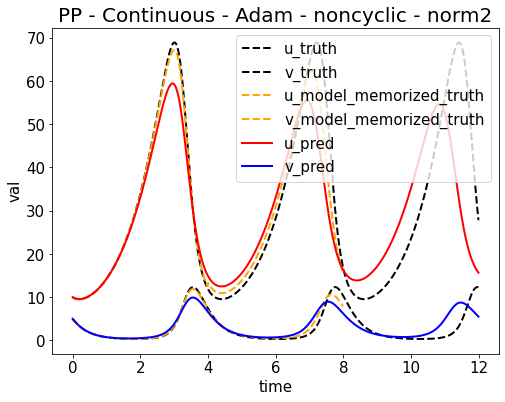

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653563616.png


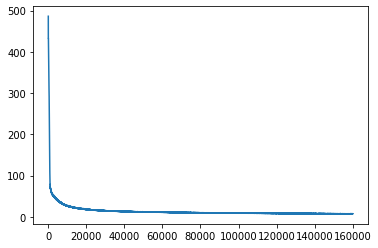

Epoch [162000/1000000] Loss:7.056845 Loss_1:0.000086 Loss_2:0.015965 Loss_3:0.000000 Loss_4:7.040793 Lr:0.001000 Time:23.406404s (29.89min in total, 154.63min remains)
Epoch [164000/1000000] Loss:7.066884 Loss_1:0.000031 Loss_2:0.004506 Loss_3:0.000000 Loss_4:7.062346 Lr:0.001000 Time:21.993556s (30.26min in total, 154.25min remains)
Epoch [166000/1000000] Loss:7.005987 Loss_1:0.000131 Loss_2:0.013427 Loss_3:0.000000 Loss_4:6.992429 Lr:0.001000 Time:22.041887s (30.63min in total, 153.87min remains)
Epoch [168000/1000000] Loss:6.894673 Loss_1:0.000102 Loss_2:0.065376 Loss_3:0.000000 Loss_4:6.829195 Lr:0.001000 Time:21.887989s (30.99min in total, 153.48min remains)
Epoch [170000/1000000] Loss:6.943713 Loss_1:0.000058 Loss_2:0.054699 Loss_3:0.000000 Loss_4:6.888956 Lr:0.001000 Time:21.882822s (31.36min in total, 153.09min remains)
Epoch [172000/1000000] Loss:7.082191 Loss_1:0.000944 Loss_2:0.049380 Loss_3:0.000000 Loss_4:7.031867 Lr:0.001000 Time:22.066717s (31.72min in total, 152.72min r

<Figure size 432x288 with 0 Axes>

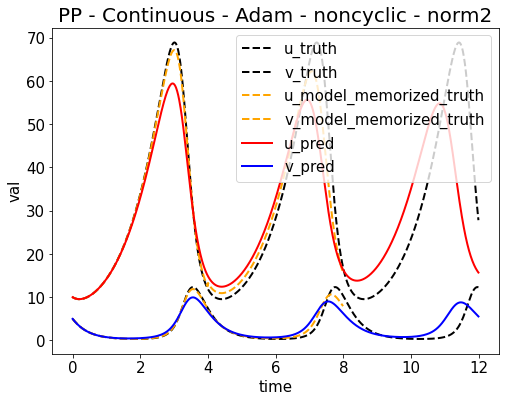

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653563837.png


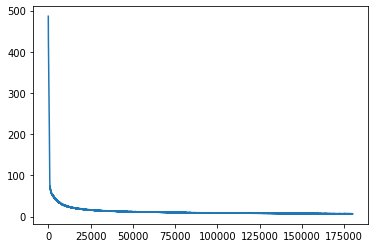

Epoch [182000/1000000] Loss:6.713986 Loss_1:0.000006 Loss_2:0.005185 Loss_3:0.000000 Loss_4:6.708795 Lr:0.001000 Time:23.097509s (33.57min in total, 150.90min remains)
Epoch [184000/1000000] Loss:6.744795 Loss_1:0.000022 Loss_2:0.004236 Loss_3:0.000000 Loss_4:6.740537 Lr:0.001000 Time:21.966196s (33.94min in total, 150.51min remains)
Epoch [186000/1000000] Loss:6.618839 Loss_1:0.000046 Loss_2:0.016697 Loss_3:0.000000 Loss_4:6.602096 Lr:0.001000 Time:22.033999s (34.31min in total, 150.14min remains)
Epoch [188000/1000000] Loss:6.682796 Loss_1:0.000006 Loss_2:0.004880 Loss_3:0.000000 Loss_4:6.677910 Lr:0.001000 Time:21.822150s (34.67min in total, 149.75min remains)
Epoch [190000/1000000] Loss:6.590163 Loss_1:0.000001 Loss_2:0.003894 Loss_3:0.000000 Loss_4:6.586268 Lr:0.001000 Time:21.833816s (35.03min in total, 149.36min remains)
Epoch [192000/1000000] Loss:6.611245 Loss_1:0.000016 Loss_2:0.007280 Loss_3:0.000000 Loss_4:6.603949 Lr:0.001000 Time:21.920476s (35.40min in total, 148.97min r

<Figure size 432x288 with 0 Axes>

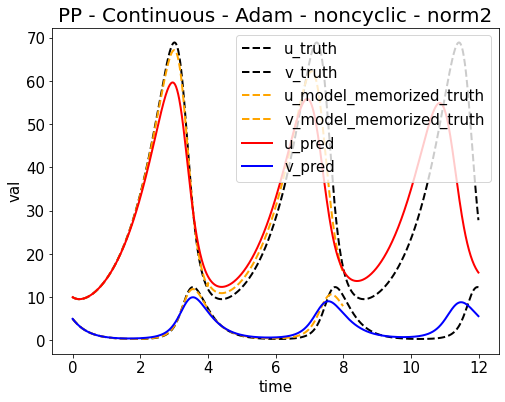

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653564057.png


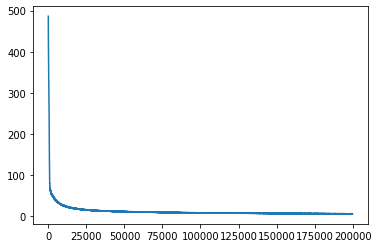

Epoch [202000/1000000] Loss:6.492478 Loss_1:0.000521 Loss_2:0.008872 Loss_3:0.000000 Loss_4:6.483085 Lr:0.001000 Time:23.607983s (37.25min in total, 147.15min remains)
Epoch [204000/1000000] Loss:6.479095 Loss_1:0.000013 Loss_2:0.037442 Loss_3:0.000000 Loss_4:6.441640 Lr:0.001000 Time:21.806528s (37.61min in total, 146.76min remains)
Epoch [206000/1000000] Loss:6.387815 Loss_1:0.000216 Loss_2:0.019189 Loss_3:0.000000 Loss_4:6.368410 Lr:0.001000 Time:21.972315s (37.98min in total, 146.38min remains)
Epoch [208000/1000000] Loss:6.340875 Loss_1:0.000123 Loss_2:0.018367 Loss_3:0.000000 Loss_4:6.322385 Lr:0.001000 Time:22.004316s (38.34min in total, 146.00min remains)
Epoch [210000/1000000] Loss:6.322853 Loss_1:0.000010 Loss_2:0.008549 Loss_3:0.000000 Loss_4:6.314294 Lr:0.001000 Time:21.874116s (38.71min in total, 145.62min remains)
Epoch [212000/1000000] Loss:6.341467 Loss_1:0.000005 Loss_2:0.007691 Loss_3:0.000000 Loss_4:6.333771 Lr:0.001000 Time:21.976617s (39.08min in total, 145.24min r

<Figure size 432x288 with 0 Axes>

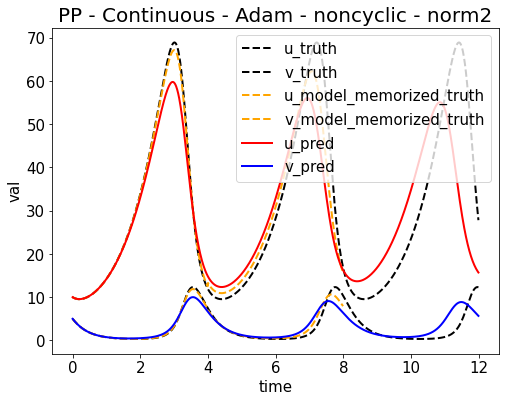

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653564278.png


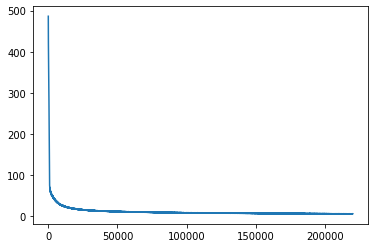

Epoch [222000/1000000] Loss:6.145684 Loss_1:0.000004 Loss_2:0.004006 Loss_3:0.000000 Loss_4:6.141675 Lr:0.001000 Time:23.315906s (40.93min in total, 143.42min remains)
Epoch [224000/1000000] Loss:6.422687 Loss_1:0.000254 Loss_2:0.044808 Loss_3:0.000000 Loss_4:6.377625 Lr:0.001000 Time:21.760654s (41.29min in total, 143.03min remains)
Epoch [226000/1000000] Loss:6.121233 Loss_1:0.000033 Loss_2:0.005048 Loss_3:0.000000 Loss_4:6.116152 Lr:0.001000 Time:21.901803s (41.65min in total, 142.65min remains)
Epoch [228000/1000000] Loss:6.276751 Loss_1:0.000015 Loss_2:0.007526 Loss_3:0.000000 Loss_4:6.269209 Lr:0.001000 Time:21.924258s (42.02min in total, 142.27min remains)
Epoch [230000/1000000] Loss:6.079486 Loss_1:0.000001 Loss_2:0.005893 Loss_3:0.000000 Loss_4:6.073592 Lr:0.001000 Time:21.938050s (42.38min in total, 141.90min remains)
Epoch [232000/1000000] Loss:6.045999 Loss_1:0.000058 Loss_2:0.003968 Loss_3:0.000000 Loss_4:6.041973 Lr:0.001000 Time:21.915908s (42.75min in total, 141.52min r

<Figure size 432x288 with 0 Axes>

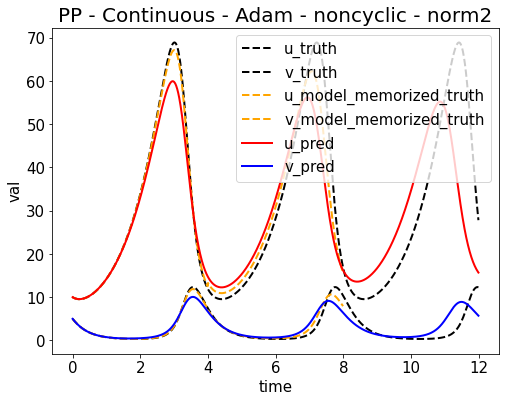

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653564499.png


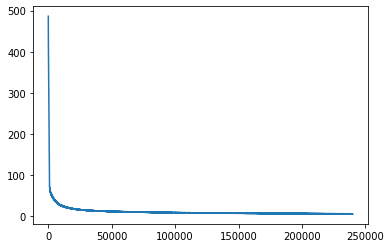

Epoch [242000/1000000] Loss:5.921822 Loss_1:0.000056 Loss_2:0.019022 Loss_3:0.000000 Loss_4:5.902743 Lr:0.001000 Time:23.524625s (44.61min in total, 139.74min remains)
Epoch [244000/1000000] Loss:5.935886 Loss_1:0.000002 Loss_2:0.004192 Loss_3:0.000000 Loss_4:5.931693 Lr:0.001000 Time:22.098640s (44.98min in total, 139.37min remains)
Epoch [246000/1000000] Loss:5.854890 Loss_1:0.000012 Loss_2:0.003766 Loss_3:0.000000 Loss_4:5.851111 Lr:0.001000 Time:22.118795s (45.35min in total, 139.00min remains)
Epoch [248000/1000000] Loss:5.817437 Loss_1:0.000008 Loss_2:0.004874 Loss_3:0.000000 Loss_4:5.812555 Lr:0.001000 Time:22.150787s (45.72min in total, 138.63min remains)
Epoch [250000/1000000] Loss:5.829607 Loss_1:0.000070 Loss_2:0.013510 Loss_3:0.000000 Loss_4:5.816027 Lr:0.001000 Time:22.103553s (46.09min in total, 138.26min remains)
Epoch [252000/1000000] Loss:5.783784 Loss_1:0.000027 Loss_2:0.005827 Loss_3:0.000000 Loss_4:5.777930 Lr:0.001000 Time:21.953097s (46.45min in total, 137.88min r

<Figure size 432x288 with 0 Axes>

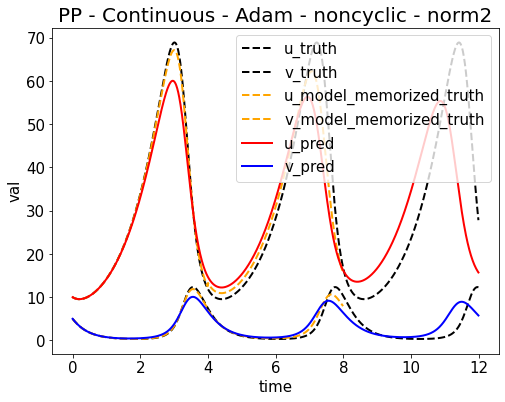

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653564721.png


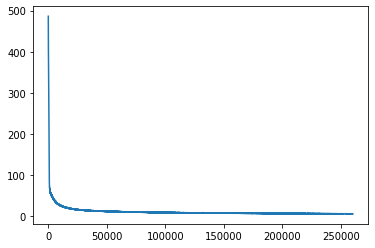

Epoch [262000/1000000] Loss:5.671569 Loss_1:0.000003 Loss_2:0.011911 Loss_3:0.000000 Loss_4:5.659655 Lr:0.001000 Time:23.430874s (48.32min in total, 136.10min remains)
Epoch [264000/1000000] Loss:5.709810 Loss_1:0.000021 Loss_2:0.003736 Loss_3:0.000000 Loss_4:5.706053 Lr:0.001000 Time:22.158715s (48.69min in total, 135.73min remains)
Epoch [266000/1000000] Loss:5.645993 Loss_1:0.000007 Loss_2:0.004628 Loss_3:0.000000 Loss_4:5.641358 Lr:0.001000 Time:22.068087s (49.05min in total, 135.36min remains)
Epoch [268000/1000000] Loss:5.734549 Loss_1:0.000019 Loss_2:0.016266 Loss_3:0.000000 Loss_4:5.718264 Lr:0.001000 Time:22.142235s (49.42min in total, 134.99min remains)
Epoch [270000/1000000] Loss:5.569355 Loss_1:0.000063 Loss_2:0.005356 Loss_3:0.000000 Loss_4:5.563935 Lr:0.001000 Time:22.131253s (49.79min in total, 134.62min remains)
Epoch [272000/1000000] Loss:5.591083 Loss_1:0.000019 Loss_2:0.004277 Loss_3:0.000000 Loss_4:5.586787 Lr:0.001000 Time:21.961684s (50.16min in total, 134.24min r

<Figure size 432x288 with 0 Axes>

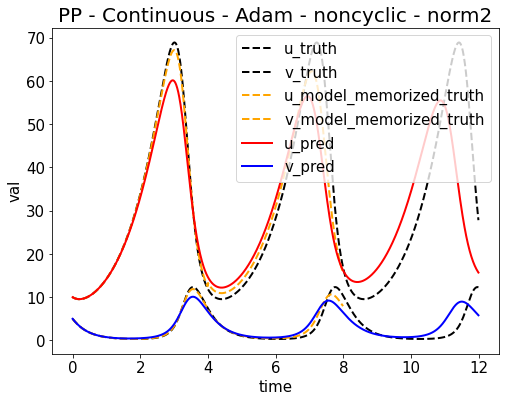

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653564943.png


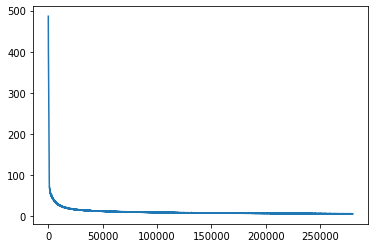

Epoch [282000/1000000] Loss:5.670271 Loss_1:0.000026 Loss_2:0.044669 Loss_3:0.000000 Loss_4:5.625576 Lr:0.001000 Time:23.621115s (52.02min in total, 132.45min remains)
Epoch [284000/1000000] Loss:5.458780 Loss_1:0.000003 Loss_2:0.003471 Loss_3:0.000000 Loss_4:5.455306 Lr:0.001000 Time:22.082844s (52.39min in total, 132.08min remains)
Epoch [286000/1000000] Loss:5.493484 Loss_1:0.000098 Loss_2:0.006589 Loss_3:0.000000 Loss_4:5.486797 Lr:0.001000 Time:21.924737s (52.75min in total, 131.70min remains)
Epoch [288000/1000000] Loss:5.373877 Loss_1:0.000001 Loss_2:0.003347 Loss_3:0.000000 Loss_4:5.370528 Lr:0.001000 Time:21.979341s (53.12min in total, 131.33min remains)
Epoch [290000/1000000] Loss:5.399502 Loss_1:0.000002 Loss_2:0.003876 Loss_3:0.000000 Loss_4:5.395624 Lr:0.001000 Time:21.857407s (53.49min in total, 130.95min remains)
Epoch [292000/1000000] Loss:5.471041 Loss_1:0.000810 Loss_2:0.018246 Loss_3:0.000000 Loss_4:5.451985 Lr:0.001000 Time:22.015774s (53.85min in total, 130.57min r

<Figure size 432x288 with 0 Axes>

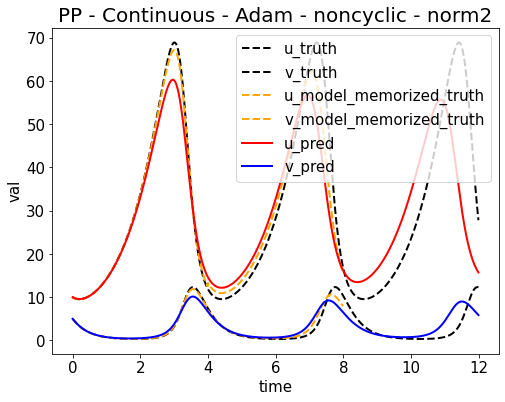

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653565164.png


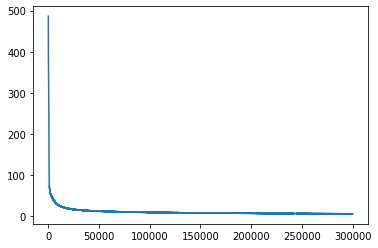

Epoch [302000/1000000] Loss:5.232951 Loss_1:0.000176 Loss_2:0.014595 Loss_3:0.000000 Loss_4:5.218180 Lr:0.001000 Time:23.522115s (55.71min in total, 128.75min remains)
Epoch [304000/1000000] Loss:5.238331 Loss_1:0.000026 Loss_2:0.003474 Loss_3:0.000000 Loss_4:5.234831 Lr:0.001000 Time:22.085679s (56.07min in total, 128.38min remains)
Epoch [306000/1000000] Loss:5.192886 Loss_1:0.000006 Loss_2:0.003653 Loss_3:0.000000 Loss_4:5.189227 Lr:0.001000 Time:22.053894s (56.44min in total, 128.01min remains)
Epoch [308000/1000000] Loss:5.180888 Loss_1:0.000014 Loss_2:0.005116 Loss_3:0.000000 Loss_4:5.175758 Lr:0.001000 Time:21.988629s (56.81min in total, 127.63min remains)
Epoch [310000/1000000] Loss:5.198870 Loss_1:0.000025 Loss_2:0.013830 Loss_3:0.000000 Loss_4:5.185015 Lr:0.001000 Time:22.163122s (57.18min in total, 127.27min remains)
Epoch [312000/1000000] Loss:5.214097 Loss_1:0.000002 Loss_2:0.004052 Loss_3:0.000000 Loss_4:5.210044 Lr:0.001000 Time:22.009806s (57.54min in total, 126.89min r

<Figure size 432x288 with 0 Axes>

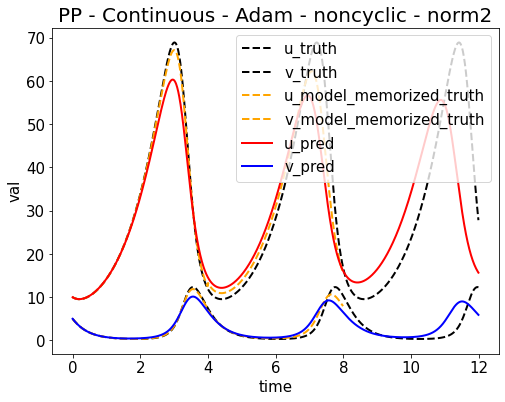

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653565386.png


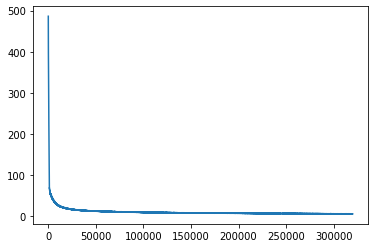

Epoch [322000/1000000] Loss:5.087328 Loss_1:0.000140 Loss_2:0.034703 Loss_3:0.000000 Loss_4:5.052485 Lr:0.001000 Time:23.500989s (59.40min in total, 125.08min remains)
Epoch [324000/1000000] Loss:5.190809 Loss_1:0.000004 Loss_2:0.011038 Loss_3:0.000000 Loss_4:5.179767 Lr:0.001000 Time:22.047047s (59.77min in total, 124.71min remains)
Epoch [326000/1000000] Loss:5.116006 Loss_1:0.000009 Loss_2:0.003456 Loss_3:0.000000 Loss_4:5.112542 Lr:0.001000 Time:22.167160s (60.14min in total, 124.34min remains)
Epoch [328000/1000000] Loss:5.131340 Loss_1:0.000034 Loss_2:0.003938 Loss_3:0.000000 Loss_4:5.127368 Lr:0.001000 Time:21.838403s (60.50min in total, 123.96min remains)
Epoch [330000/1000000] Loss:5.118252 Loss_1:0.000034 Loss_2:0.018474 Loss_3:0.000000 Loss_4:5.099744 Lr:0.001000 Time:21.881103s (60.87min in total, 123.58min remains)
Epoch [332000/1000000] Loss:5.089928 Loss_1:0.000022 Loss_2:0.003682 Loss_3:0.000000 Loss_4:5.086224 Lr:0.001000 Time:21.861912s (61.23min in total, 123.20min r

<Figure size 432x288 with 0 Axes>

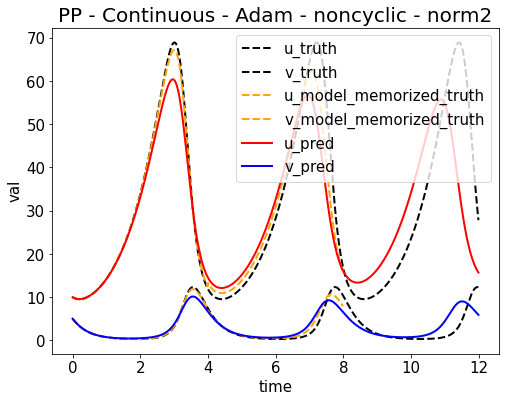

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653565607.png


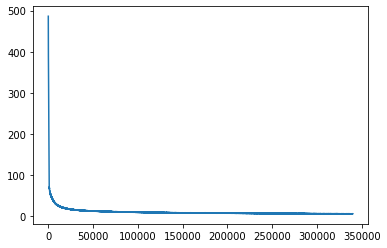

Epoch [342000/1000000] Loss:5.100555 Loss_1:0.000046 Loss_2:0.009828 Loss_3:0.000000 Loss_4:5.090681 Lr:0.001000 Time:23.423891s (63.09min in total, 121.38min remains)
Epoch [344000/1000000] Loss:4.982549 Loss_1:0.000000 Loss_2:0.003434 Loss_3:0.000000 Loss_4:4.979114 Lr:0.001000 Time:21.889170s (63.45min in total, 121.00min remains)
Epoch [346000/1000000] Loss:4.972025 Loss_1:0.000029 Loss_2:0.009761 Loss_3:0.000000 Loss_4:4.962235 Lr:0.001000 Time:21.902699s (63.82min in total, 120.62min remains)
Epoch [348000/1000000] Loss:5.020877 Loss_1:0.000346 Loss_2:0.076833 Loss_3:0.000000 Loss_4:4.943698 Lr:0.001000 Time:22.042909s (64.18min in total, 120.25min remains)
Epoch [350000/1000000] Loss:4.916474 Loss_1:0.000004 Loss_2:0.003614 Loss_3:0.000000 Loss_4:4.912856 Lr:0.001000 Time:21.897450s (64.55min in total, 119.88min remains)
Epoch [352000/1000000] Loss:4.880776 Loss_1:0.000004 Loss_2:0.003241 Loss_3:0.000000 Loss_4:4.877532 Lr:0.001000 Time:21.852261s (64.91min in total, 119.50min r

<Figure size 432x288 with 0 Axes>

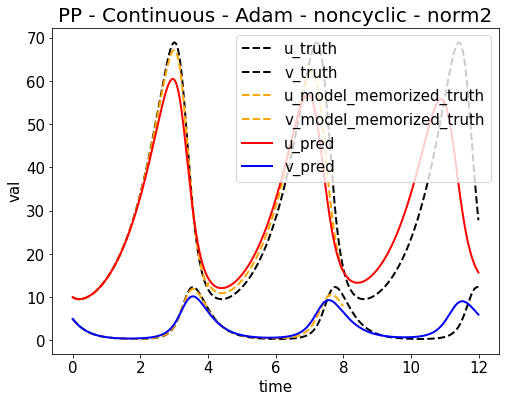

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653565828.png


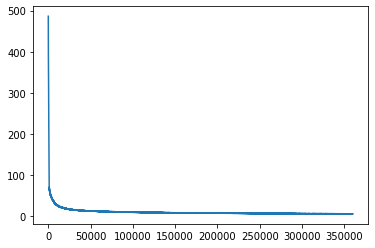

Epoch [362000/1000000] Loss:4.821336 Loss_1:0.000002 Loss_2:0.003174 Loss_3:0.000000 Loss_4:4.818160 Lr:0.001000 Time:23.593251s (66.77min in total, 117.68min remains)
Epoch [364000/1000000] Loss:4.821225 Loss_1:0.000001 Loss_2:0.003190 Loss_3:0.000000 Loss_4:4.818035 Lr:0.001000 Time:21.855930s (67.13min in total, 117.30min remains)
Epoch [366000/1000000] Loss:4.813886 Loss_1:0.000009 Loss_2:0.003173 Loss_3:0.000000 Loss_4:4.810704 Lr:0.001000 Time:21.969444s (67.50min in total, 116.92min remains)
Epoch [368000/1000000] Loss:4.861404 Loss_1:0.000010 Loss_2:0.005301 Loss_3:0.000000 Loss_4:4.856093 Lr:0.001000 Time:21.945462s (67.87min in total, 116.55min remains)
Epoch [370000/1000000] Loss:5.043725 Loss_1:0.000086 Loss_2:0.058870 Loss_3:0.000000 Loss_4:4.984770 Lr:0.001000 Time:21.978701s (68.23min in total, 116.18min remains)
Epoch [372000/1000000] Loss:4.991158 Loss_1:0.000071 Loss_2:0.036532 Loss_3:0.000000 Loss_4:4.954556 Lr:0.001000 Time:21.953678s (68.60min in total, 115.80min r

<Figure size 432x288 with 0 Axes>

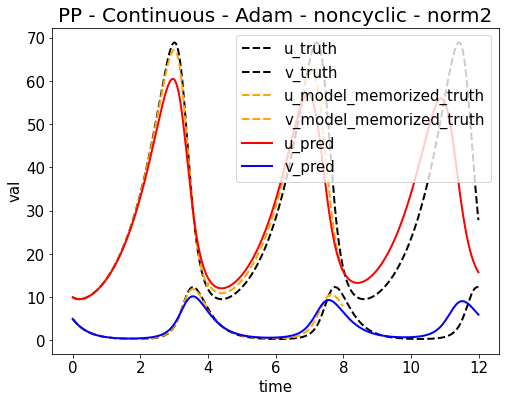

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653566049.png


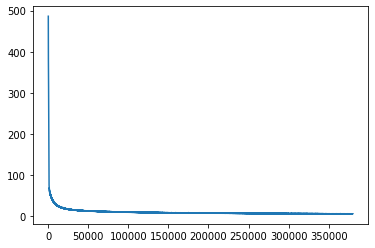

Epoch [382000/1000000] Loss:4.753722 Loss_1:0.000002 Loss_2:0.004902 Loss_3:0.000000 Loss_4:4.748818 Lr:0.001000 Time:23.686553s (70.46min in total, 113.98min remains)
Epoch [384000/1000000] Loss:4.778455 Loss_1:0.000031 Loss_2:0.013038 Loss_3:0.000000 Loss_4:4.765386 Lr:0.001000 Time:22.060939s (70.82min in total, 113.61min remains)
Epoch [386000/1000000] Loss:4.713297 Loss_1:0.000012 Loss_2:0.004030 Loss_3:0.000000 Loss_4:4.709255 Lr:0.001000 Time:21.961175s (71.19min in total, 113.24min remains)
Epoch [388000/1000000] Loss:4.678319 Loss_1:0.000022 Loss_2:0.003301 Loss_3:0.000000 Loss_4:4.674995 Lr:0.001000 Time:22.031293s (71.56min in total, 112.87min remains)
Epoch [390000/1000000] Loss:4.692883 Loss_1:0.000162 Loss_2:0.012898 Loss_3:0.000000 Loss_4:4.679823 Lr:0.001000 Time:21.966891s (71.92min in total, 112.49min remains)
Epoch [392000/1000000] Loss:4.706116 Loss_1:0.000173 Loss_2:0.004416 Loss_3:0.000000 Loss_4:4.701527 Lr:0.001000 Time:22.052528s (72.29min in total, 112.12min r

<Figure size 432x288 with 0 Axes>

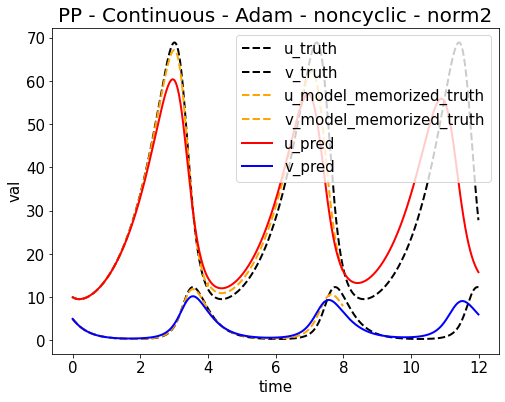

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653566271.png


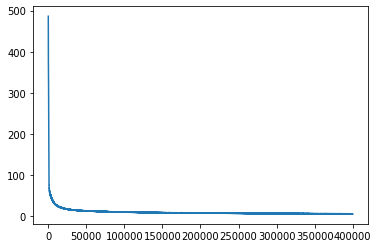

Epoch [402000/1000000] Loss:4.596012 Loss_1:0.000010 Loss_2:0.004474 Loss_3:0.000000 Loss_4:4.591527 Lr:0.001000 Time:23.609609s (74.15min in total, 110.30min remains)
Epoch [404000/1000000] Loss:4.568779 Loss_1:0.000085 Loss_2:0.008759 Loss_3:0.000000 Loss_4:4.559935 Lr:0.001000 Time:21.914958s (74.51min in total, 109.93min remains)
Epoch [406000/1000000] Loss:4.642702 Loss_1:0.000022 Loss_2:0.004198 Loss_3:0.000000 Loss_4:4.638482 Lr:0.001000 Time:22.042814s (74.88min in total, 109.55min remains)
Epoch [408000/1000000] Loss:4.562145 Loss_1:0.000007 Loss_2:0.003579 Loss_3:0.000000 Loss_4:4.558558 Lr:0.001000 Time:22.207759s (75.25min in total, 109.19min remains)
Epoch [410000/1000000] Loss:4.562865 Loss_1:0.000057 Loss_2:0.007329 Loss_3:0.000000 Loss_4:4.555479 Lr:0.001000 Time:22.145800s (75.62min in total, 108.82min remains)
Epoch [412000/1000000] Loss:4.682007 Loss_1:0.000414 Loss_2:0.017218 Loss_3:0.000000 Loss_4:4.664375 Lr:0.001000 Time:22.017779s (75.99min in total, 108.45min r

<Figure size 432x288 with 0 Axes>

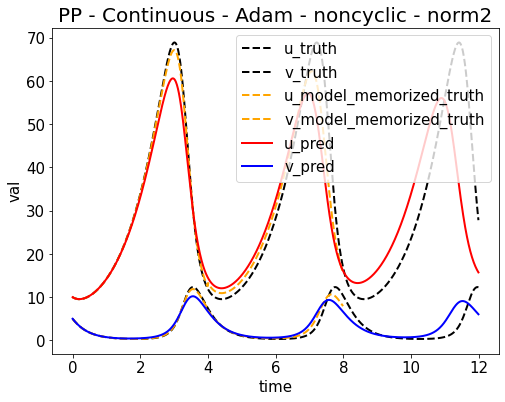

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653566493.png


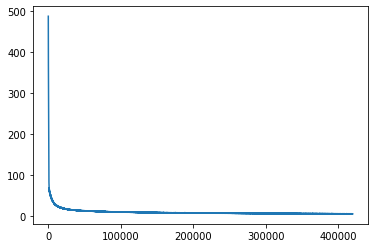

Epoch [422000/1000000] Loss:4.540946 Loss_1:0.000055 Loss_2:0.004173 Loss_3:0.000000 Loss_4:4.536718 Lr:0.001000 Time:23.835033s (77.85min in total, 106.63min remains)
Epoch [424000/1000000] Loss:4.505495 Loss_1:0.000000 Loss_2:0.003767 Loss_3:0.000000 Loss_4:4.501727 Lr:0.001000 Time:21.999362s (78.22min in total, 106.26min remains)
Epoch [426000/1000000] Loss:4.473519 Loss_1:0.000041 Loss_2:0.005846 Loss_3:0.000000 Loss_4:4.467632 Lr:0.001000 Time:21.898092s (78.58min in total, 105.89min remains)
Epoch [428000/1000000] Loss:4.454362 Loss_1:0.000021 Loss_2:0.007986 Loss_3:0.000000 Loss_4:4.446355 Lr:0.001000 Time:21.825497s (78.95min in total, 105.51min remains)
Epoch [430000/1000000] Loss:4.436413 Loss_1:0.000046 Loss_2:0.003659 Loss_3:0.000000 Loss_4:4.432708 Lr:0.001000 Time:22.048692s (79.32min in total, 105.14min remains)
Epoch [432000/1000000] Loss:4.466390 Loss_1:0.000030 Loss_2:0.005149 Loss_3:0.000000 Loss_4:4.461212 Lr:0.001000 Time:22.255327s (79.69min in total, 104.77min r

<Figure size 432x288 with 0 Axes>

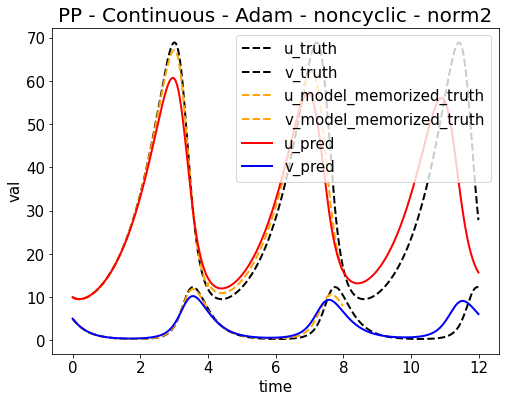

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653566715.png


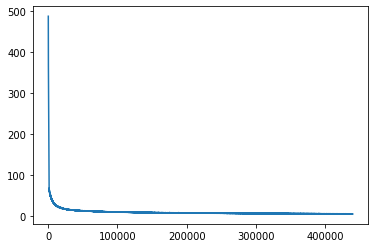

Epoch [442000/1000000] Loss:4.331101 Loss_1:0.000005 Loss_2:0.003424 Loss_3:0.000000 Loss_4:4.327672 Lr:0.001000 Time:23.570578s (81.55min in total, 102.95min remains)
Epoch [444000/1000000] Loss:4.354751 Loss_1:0.000088 Loss_2:0.005146 Loss_3:0.000000 Loss_4:4.349517 Lr:0.001000 Time:22.061195s (81.92min in total, 102.58min remains)
Epoch [446000/1000000] Loss:4.344212 Loss_1:0.000001 Loss_2:0.002869 Loss_3:0.000000 Loss_4:4.341342 Lr:0.001000 Time:22.150031s (82.29min in total, 102.21min remains)
Epoch [448000/1000000] Loss:4.277103 Loss_1:0.000011 Loss_2:0.005077 Loss_3:0.000000 Loss_4:4.272015 Lr:0.001000 Time:22.069731s (82.66min in total, 101.84min remains)
Epoch [450000/1000000] Loss:4.328420 Loss_1:0.000005 Loss_2:0.002878 Loss_3:0.000000 Loss_4:4.325536 Lr:0.001000 Time:21.988005s (83.02min in total, 101.47min remains)
Epoch [452000/1000000] Loss:4.288011 Loss_1:0.000002 Loss_2:0.003963 Loss_3:0.000000 Loss_4:4.284045 Lr:0.001000 Time:22.071468s (83.39min in total, 101.10min r

<Figure size 432x288 with 0 Axes>

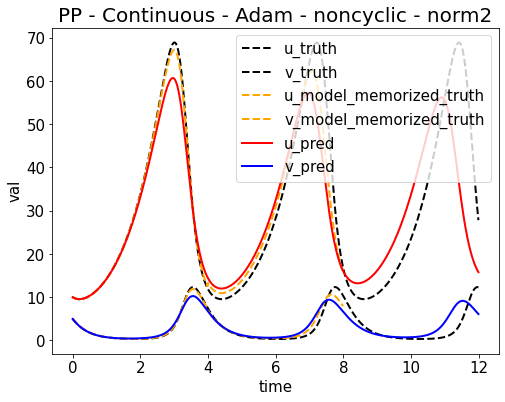

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653566937.png


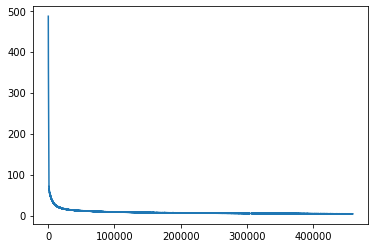

Epoch [462000/1000000] Loss:4.309481 Loss_1:0.000018 Loss_2:0.005191 Loss_3:0.000000 Loss_4:4.304272 Lr:0.001000 Time:23.709935s (85.25min in total, 99.27min remains)
Epoch [464000/1000000] Loss:4.304249 Loss_1:0.000001 Loss_2:0.002988 Loss_3:0.000000 Loss_4:4.301260 Lr:0.001000 Time:21.809774s (85.61min in total, 98.90min remains)
Epoch [466000/1000000] Loss:4.261520 Loss_1:0.000002 Loss_2:0.002850 Loss_3:0.000000 Loss_4:4.258667 Lr:0.001000 Time:21.999529s (85.98min in total, 98.53min remains)
Epoch [468000/1000000] Loss:4.277015 Loss_1:0.000002 Loss_2:0.002837 Loss_3:0.000000 Loss_4:4.274176 Lr:0.001000 Time:21.903895s (86.35min in total, 98.15min remains)
Epoch [470000/1000000] Loss:4.300034 Loss_1:0.000021 Loss_2:0.003676 Loss_3:0.000000 Loss_4:4.296337 Lr:0.001000 Time:21.847686s (86.71min in total, 97.78min remains)
Epoch [472000/1000000] Loss:4.355890 Loss_1:0.000092 Loss_2:0.021110 Loss_3:0.000000 Loss_4:4.334688 Lr:0.001000 Time:21.926999s (87.08min in total, 97.41min remains

<Figure size 432x288 with 0 Axes>

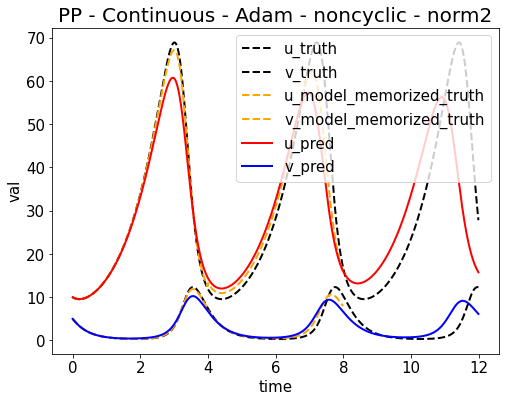

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653567158.png


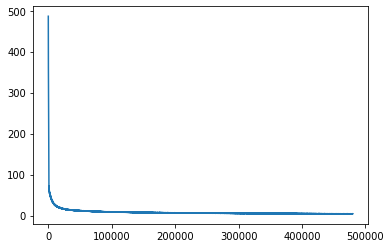

Epoch [482000/1000000] Loss:4.249458 Loss_1:0.000104 Loss_2:0.014361 Loss_3:0.000000 Loss_4:4.234993 Lr:0.001000 Time:23.857590s (88.94min in total, 95.58min remains)
Epoch [484000/1000000] Loss:4.288992 Loss_1:0.000155 Loss_2:0.015252 Loss_3:0.000000 Loss_4:4.273586 Lr:0.001000 Time:21.764035s (89.30min in total, 95.20min remains)
Epoch [486000/1000000] Loss:4.292672 Loss_1:0.000006 Loss_2:0.005187 Loss_3:0.000000 Loss_4:4.287478 Lr:0.001000 Time:21.923948s (89.66min in total, 94.83min remains)
Epoch [488000/1000000] Loss:4.158623 Loss_1:0.000037 Loss_2:0.011847 Loss_3:0.000000 Loss_4:4.146739 Lr:0.001000 Time:21.842069s (90.03min in total, 94.46min remains)
Epoch [490000/1000000] Loss:4.203780 Loss_1:0.000001 Loss_2:0.002763 Loss_3:0.000000 Loss_4:4.201015 Lr:0.001000 Time:21.921282s (90.39min in total, 94.08min remains)
Epoch [492000/1000000] Loss:4.181105 Loss_1:0.000002 Loss_2:0.002883 Loss_3:0.000000 Loss_4:4.178220 Lr:0.001000 Time:21.962127s (90.76min in total, 93.71min remains

<Figure size 432x288 with 0 Axes>

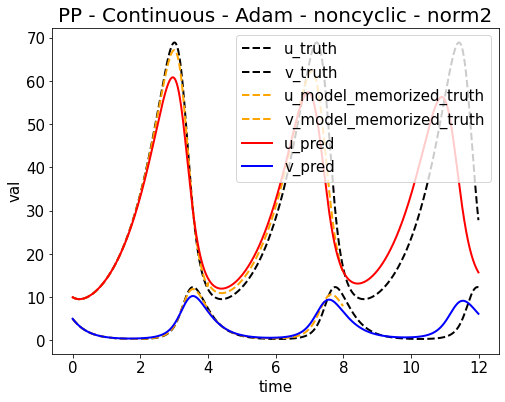

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653567379.png


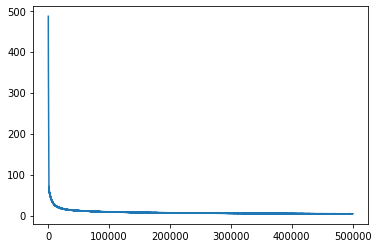

Epoch [502000/1000000] Loss:4.184528 Loss_1:0.000176 Loss_2:0.011317 Loss_3:0.000000 Loss_4:4.173035 Lr:0.001000 Time:23.698752s (92.61min in total, 91.88min remains)
Epoch [504000/1000000] Loss:4.179418 Loss_1:0.000289 Loss_2:0.008574 Loss_3:0.000000 Loss_4:4.170555 Lr:0.001000 Time:21.887098s (92.98min in total, 91.50min remains)
Epoch [506000/1000000] Loss:4.111349 Loss_1:0.000080 Loss_2:0.009139 Loss_3:0.000000 Loss_4:4.102130 Lr:0.001000 Time:21.861529s (93.34min in total, 91.13min remains)
Epoch [508000/1000000] Loss:4.074038 Loss_1:0.000211 Loss_2:0.032373 Loss_3:0.000000 Loss_4:4.041454 Lr:0.001000 Time:21.914959s (93.71min in total, 90.76min remains)
Epoch [510000/1000000] Loss:4.146577 Loss_1:0.000272 Loss_2:0.010307 Loss_3:0.000000 Loss_4:4.135998 Lr:0.001000 Time:22.019193s (94.08min in total, 90.39min remains)
Epoch [512000/1000000] Loss:4.076303 Loss_1:0.000005 Loss_2:0.003038 Loss_3:0.000000 Loss_4:4.073260 Lr:0.001000 Time:21.962454s (94.44min in total, 90.01min remains

<Figure size 432x288 with 0 Axes>

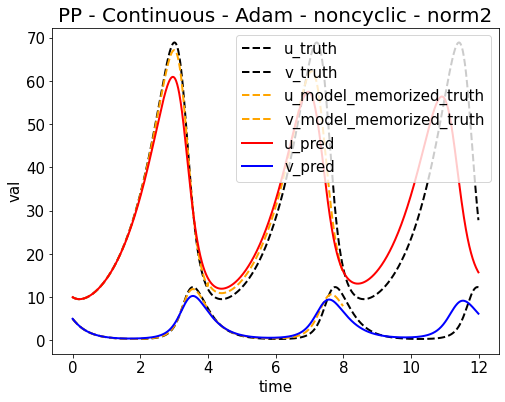

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653567600.png


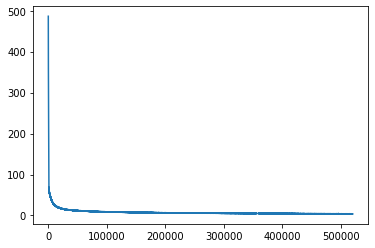

Epoch [522000/1000000] Loss:4.134275 Loss_1:0.000109 Loss_2:0.049768 Loss_3:0.000000 Loss_4:4.084397 Lr:0.001000 Time:23.985420s (96.30min in total, 88.19min remains)
Epoch [524000/1000000] Loss:4.037660 Loss_1:0.000562 Loss_2:0.007270 Loss_3:0.000000 Loss_4:4.029827 Lr:0.001000 Time:21.911137s (96.67min in total, 87.81min remains)
Epoch [526000/1000000] Loss:4.015076 Loss_1:0.000280 Loss_2:0.005257 Loss_3:0.000000 Loss_4:4.009539 Lr:0.001000 Time:21.822185s (97.03min in total, 87.44min remains)
Epoch [528000/1000000] Loss:3.974551 Loss_1:0.000001 Loss_2:0.003156 Loss_3:0.000000 Loss_4:3.971393 Lr:0.001000 Time:21.961679s (97.40min in total, 87.07min remains)
Epoch [530000/1000000] Loss:3.969921 Loss_1:0.000020 Loss_2:0.002856 Loss_3:0.000000 Loss_4:3.967046 Lr:0.001000 Time:21.972344s (97.77min in total, 86.70min remains)
Epoch [532000/1000000] Loss:3.936737 Loss_1:0.000706 Loss_2:0.009198 Loss_3:0.000000 Loss_4:3.926832 Lr:0.001000 Time:21.909312s (98.13min in total, 86.33min remains

<Figure size 432x288 with 0 Axes>

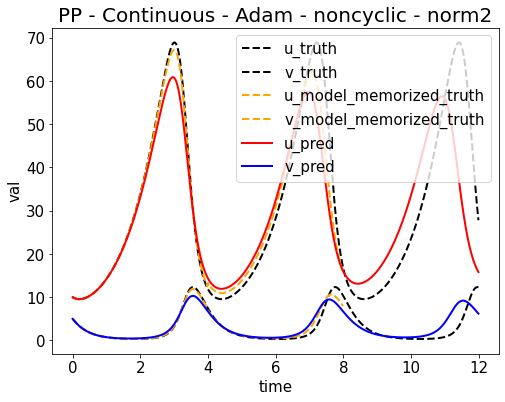

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653567821.png


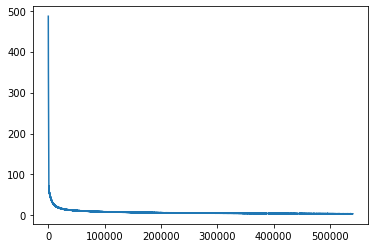

Epoch [542000/1000000] Loss:3.932361 Loss_1:0.000249 Loss_2:0.007334 Loss_3:0.000000 Loss_4:3.924777 Lr:0.001000 Time:23.699189s (99.98min in total, 84.49min remains)
Epoch [544000/1000000] Loss:3.983646 Loss_1:0.000025 Loss_2:0.013655 Loss_3:0.000000 Loss_4:3.969966 Lr:0.001000 Time:21.873707s (100.35min in total, 84.12min remains)
Epoch [546000/1000000] Loss:3.897222 Loss_1:0.000038 Loss_2:0.011450 Loss_3:0.000000 Loss_4:3.885733 Lr:0.001000 Time:21.804865s (100.71min in total, 83.74min remains)
Epoch [548000/1000000] Loss:3.927089 Loss_1:0.000004 Loss_2:0.003294 Loss_3:0.000000 Loss_4:3.923791 Lr:0.001000 Time:21.893392s (101.08min in total, 83.37min remains)
Epoch [550000/1000000] Loss:3.895839 Loss_1:0.000154 Loss_2:0.081880 Loss_3:0.000000 Loss_4:3.813805 Lr:0.001000 Time:22.087617s (101.45min in total, 83.00min remains)
Epoch [552000/1000000] Loss:3.874320 Loss_1:0.000028 Loss_2:0.010712 Loss_3:0.000000 Loss_4:3.863580 Lr:0.001000 Time:22.041135s (101.81min in total, 82.63min re

<Figure size 432x288 with 0 Axes>

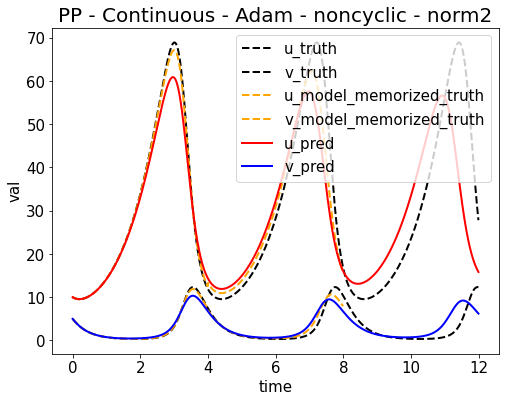

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653568042.png


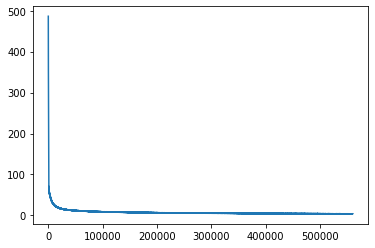

Epoch [562000/1000000] Loss:3.874191 Loss_1:0.000002 Loss_2:0.003900 Loss_3:0.000000 Loss_4:3.870288 Lr:0.001000 Time:23.714482s (103.67min in total, 80.80min remains)
Epoch [564000/1000000] Loss:3.860471 Loss_1:0.000001 Loss_2:0.003962 Loss_3:0.000000 Loss_4:3.856509 Lr:0.001000 Time:21.687010s (104.03min in total, 80.42min remains)
Epoch [566000/1000000] Loss:3.832313 Loss_1:0.000002 Loss_2:0.002653 Loss_3:0.000000 Loss_4:3.829657 Lr:0.001000 Time:21.771737s (104.39min in total, 80.05min remains)
Epoch [568000/1000000] Loss:3.844088 Loss_1:0.000093 Loss_2:0.076480 Loss_3:0.000000 Loss_4:3.767514 Lr:0.001000 Time:21.776297s (104.76min in total, 79.67min remains)
Epoch [570000/1000000] Loss:3.796876 Loss_1:0.000000 Loss_2:0.002644 Loss_3:0.000000 Loss_4:3.794232 Lr:0.001000 Time:21.837183s (105.12min in total, 79.30min remains)
Epoch [572000/1000000] Loss:3.837401 Loss_1:0.000018 Loss_2:0.016876 Loss_3:0.000000 Loss_4:3.820507 Lr:0.001000 Time:21.791024s (105.48min in total, 78.93min r

<Figure size 432x288 with 0 Axes>

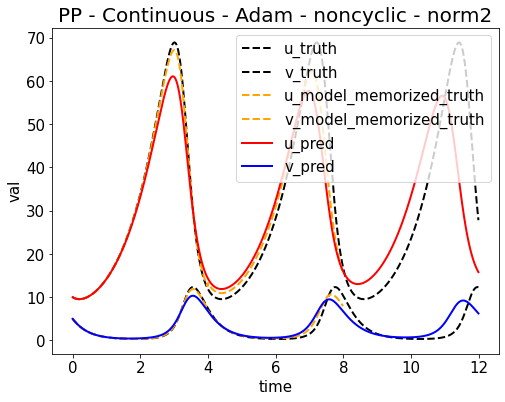

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653568262.png


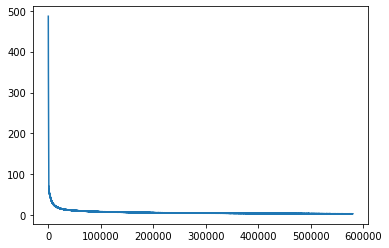

Epoch [582000/1000000] Loss:3.692578 Loss_1:0.000124 Loss_2:0.012159 Loss_3:0.000000 Loss_4:3.680295 Lr:0.001000 Time:24.078012s (107.35min in total, 77.10min remains)
Epoch [584000/1000000] Loss:3.810520 Loss_1:0.000018 Loss_2:0.026089 Loss_3:0.000000 Loss_4:3.784412 Lr:0.001000 Time:21.837466s (107.71min in total, 76.73min remains)
Epoch [586000/1000000] Loss:3.750962 Loss_1:0.000007 Loss_2:0.002615 Loss_3:0.000000 Loss_4:3.748340 Lr:0.001000 Time:21.837303s (108.07min in total, 76.35min remains)
Epoch [588000/1000000] Loss:3.690622 Loss_1:0.000001 Loss_2:0.005731 Loss_3:0.000000 Loss_4:3.684890 Lr:0.001000 Time:21.868616s (108.44min in total, 75.98min remains)
Epoch [590000/1000000] Loss:3.867353 Loss_1:0.000314 Loss_2:0.007868 Loss_3:0.000000 Loss_4:3.859171 Lr:0.001000 Time:21.855572s (108.80min in total, 75.61min remains)
Epoch [592000/1000000] Loss:3.856952 Loss_1:0.000167 Loss_2:0.008502 Loss_3:0.000000 Loss_4:3.848284 Lr:0.001000 Time:21.849762s (109.17min in total, 75.24min r

<Figure size 432x288 with 0 Axes>

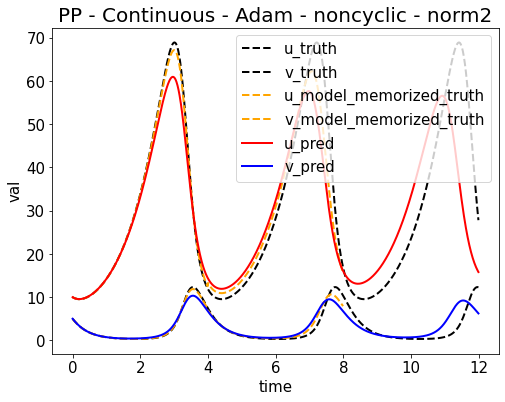

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653568482.png


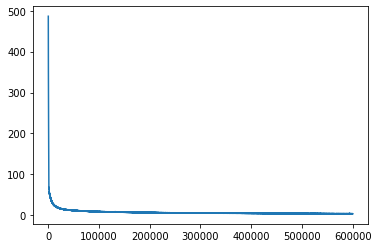

Epoch [602000/1000000] Loss:3.734452 Loss_1:0.000016 Loss_2:0.006378 Loss_3:0.000000 Loss_4:3.728057 Lr:0.001000 Time:23.851180s (111.02min in total, 73.40min remains)
Epoch [604000/1000000] Loss:3.821315 Loss_1:0.000002 Loss_2:0.002729 Loss_3:0.000000 Loss_4:3.818583 Lr:0.001000 Time:21.936260s (111.38min in total, 73.03min remains)
Epoch [606000/1000000] Loss:3.723607 Loss_1:0.000001 Loss_2:0.002558 Loss_3:0.000000 Loss_4:3.721048 Lr:0.001000 Time:21.794368s (111.75min in total, 72.65min remains)
Epoch [608000/1000000] Loss:3.747873 Loss_1:0.000060 Loss_2:0.063415 Loss_3:0.000000 Loss_4:3.684397 Lr:0.001000 Time:21.818597s (112.11min in total, 72.28min remains)
Epoch [610000/1000000] Loss:3.740706 Loss_1:0.000024 Loss_2:0.005905 Loss_3:0.000000 Loss_4:3.734777 Lr:0.001000 Time:22.005846s (112.48min in total, 71.91min remains)
Epoch [612000/1000000] Loss:3.767573 Loss_1:0.000011 Loss_2:0.024394 Loss_3:0.000000 Loss_4:3.743168 Lr:0.001000 Time:21.808716s (112.84min in total, 71.54min r

<Figure size 432x288 with 0 Axes>

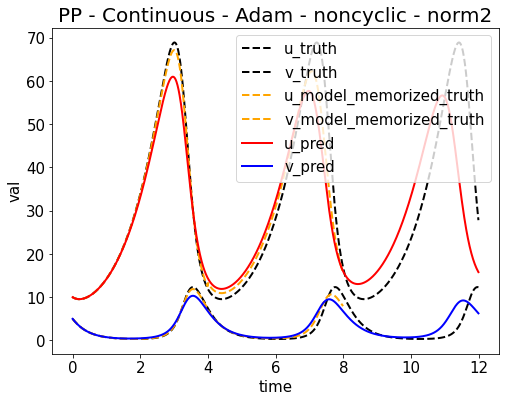

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653568703.png


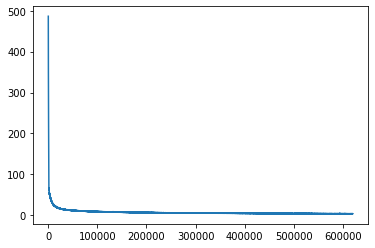

Epoch [622000/1000000] Loss:3.700375 Loss_1:0.000003 Loss_2:0.003212 Loss_3:0.000000 Loss_4:3.697160 Lr:0.001000 Time:23.875613s (114.69min in total, 69.70min remains)
Epoch [624000/1000000] Loss:3.655761 Loss_1:0.000153 Loss_2:0.005505 Loss_3:0.000000 Loss_4:3.650104 Lr:0.001000 Time:21.729099s (115.05min in total, 69.33min remains)
Epoch [626000/1000000] Loss:3.666639 Loss_1:0.000003 Loss_2:0.002987 Loss_3:0.000000 Loss_4:3.663649 Lr:0.001000 Time:21.800483s (115.42min in total, 68.95min remains)
Epoch [628000/1000000] Loss:3.652792 Loss_1:0.000002 Loss_2:0.003809 Loss_3:0.000000 Loss_4:3.648981 Lr:0.001000 Time:21.840471s (115.78min in total, 68.58min remains)
Epoch [630000/1000000] Loss:3.690186 Loss_1:0.000053 Loss_2:0.062736 Loss_3:0.000000 Loss_4:3.627396 Lr:0.001000 Time:21.965597s (116.15min in total, 68.21min remains)
Epoch [632000/1000000] Loss:3.774490 Loss_1:0.000050 Loss_2:0.012737 Loss_3:0.000000 Loss_4:3.761703 Lr:0.001000 Time:21.919989s (116.51min in total, 67.84min r

<Figure size 432x288 with 0 Axes>

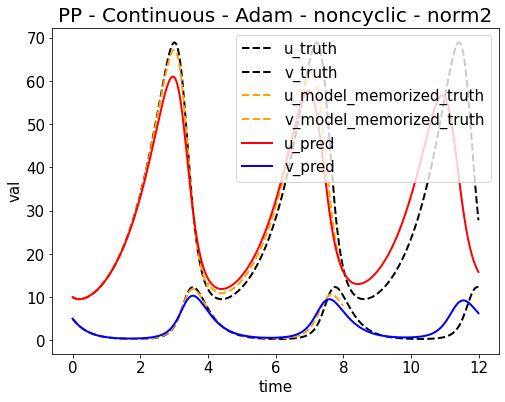

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653568924.png


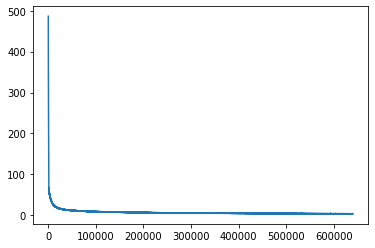

Epoch [642000/1000000] Loss:3.609880 Loss_1:0.000029 Loss_2:0.004681 Loss_3:0.000000 Loss_4:3.605170 Lr:0.001000 Time:24.144346s (118.37min in total, 66.01min remains)
Epoch [644000/1000000] Loss:3.632221 Loss_1:0.000022 Loss_2:0.002777 Loss_3:0.000000 Loss_4:3.629423 Lr:0.001000 Time:21.885240s (118.74min in total, 65.64min remains)
Epoch [646000/1000000] Loss:3.656404 Loss_1:0.000009 Loss_2:0.004478 Loss_3:0.000000 Loss_4:3.651917 Lr:0.001000 Time:21.832770s (119.10min in total, 65.27min remains)
Epoch [648000/1000000] Loss:3.631220 Loss_1:0.000227 Loss_2:0.052266 Loss_3:0.000000 Loss_4:3.578727 Lr:0.001000 Time:21.948916s (119.47min in total, 64.90min remains)
Epoch [650000/1000000] Loss:3.560702 Loss_1:0.000118 Loss_2:0.008270 Loss_3:0.000000 Loss_4:3.552314 Lr:0.001000 Time:22.015664s (119.84min in total, 64.53min remains)
Epoch [652000/1000000] Loss:3.766540 Loss_1:0.000389 Loss_2:0.041823 Loss_3:0.000000 Loss_4:3.724328 Lr:0.001000 Time:21.851318s (120.20min in total, 64.16min r

<Figure size 432x288 with 0 Axes>

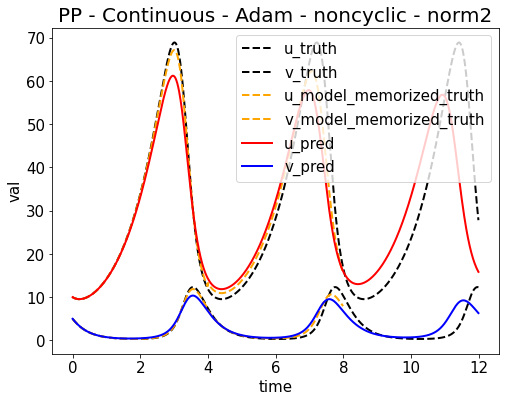

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653569145.png


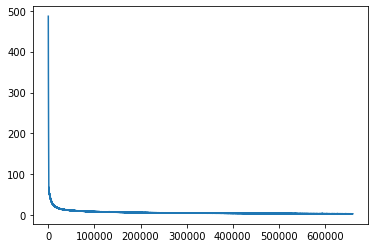

Epoch [662000/1000000] Loss:3.553871 Loss_1:0.000003 Loss_2:0.002898 Loss_3:0.000000 Loss_4:3.550971 Lr:0.001000 Time:24.210215s (122.06min in total, 62.32min remains)
Epoch [664000/1000000] Loss:3.553104 Loss_1:0.000010 Loss_2:0.002836 Loss_3:0.000000 Loss_4:3.550258 Lr:0.001000 Time:22.010429s (122.43min in total, 61.95min remains)
Epoch [666000/1000000] Loss:3.488980 Loss_1:0.000007 Loss_2:0.002755 Loss_3:0.000000 Loss_4:3.486219 Lr:0.001000 Time:21.810755s (122.79min in total, 61.58min remains)
Epoch [668000/1000000] Loss:3.515754 Loss_1:0.000049 Loss_2:0.003077 Loss_3:0.000000 Loss_4:3.512627 Lr:0.001000 Time:21.883357s (123.16min in total, 61.21min remains)
Epoch [670000/1000000] Loss:3.576556 Loss_1:0.000328 Loss_2:0.028325 Loss_3:0.000000 Loss_4:3.547903 Lr:0.001000 Time:21.961972s (123.52min in total, 60.84min remains)
Epoch [672000/1000000] Loss:3.494456 Loss_1:0.000009 Loss_2:0.003597 Loss_3:0.000000 Loss_4:3.490850 Lr:0.001000 Time:21.736898s (123.88min in total, 60.47min r

<Figure size 432x288 with 0 Axes>

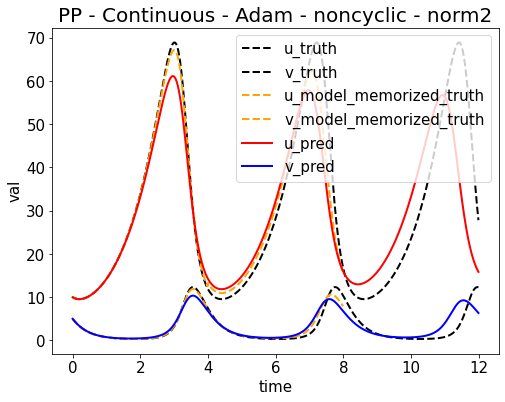

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653569366.png


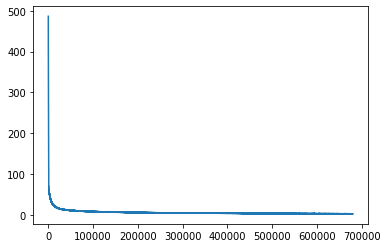

Epoch [682000/1000000] Loss:3.440669 Loss_1:0.000002 Loss_2:0.002707 Loss_3:0.000000 Loss_4:3.437959 Lr:0.001000 Time:23.972386s (125.74min in total, 58.63min remains)
Epoch [684000/1000000] Loss:3.452505 Loss_1:0.000001 Loss_2:0.002935 Loss_3:0.000000 Loss_4:3.449569 Lr:0.001000 Time:22.026463s (126.11min in total, 58.26min remains)
Epoch [686000/1000000] Loss:3.443030 Loss_1:0.000023 Loss_2:0.002676 Loss_3:0.000000 Loss_4:3.440332 Lr:0.001000 Time:21.783112s (126.47min in total, 57.89min remains)
Epoch [688000/1000000] Loss:3.497906 Loss_1:0.000029 Loss_2:0.005022 Loss_3:0.000000 Loss_4:3.492856 Lr:0.001000 Time:21.964541s (126.84min in total, 57.52min remains)
Epoch [690000/1000000] Loss:3.414619 Loss_1:0.000013 Loss_2:0.002851 Loss_3:0.000000 Loss_4:3.411754 Lr:0.001000 Time:22.001487s (127.20min in total, 57.15min remains)
Epoch [692000/1000000] Loss:3.392213 Loss_1:0.000011 Loss_2:0.005585 Loss_3:0.000000 Loss_4:3.386616 Lr:0.001000 Time:21.899561s (127.57min in total, 56.78min r

<Figure size 432x288 with 0 Axes>

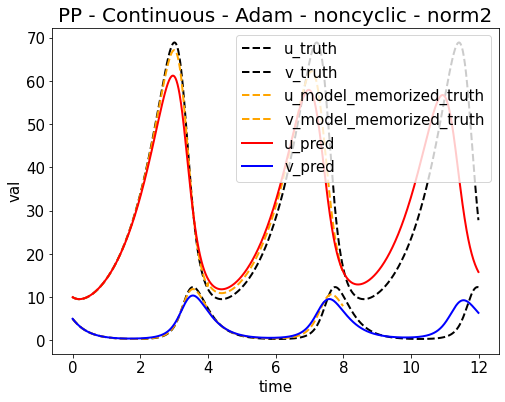

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653569587.png


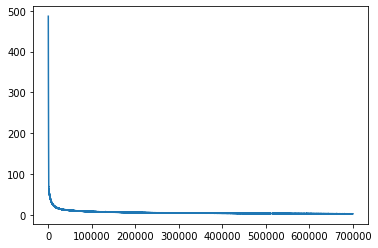

Epoch [702000/1000000] Loss:3.468018 Loss_1:0.000003 Loss_2:0.003280 Loss_3:0.000000 Loss_4:3.464736 Lr:0.001000 Time:23.822258s (129.42min in total, 54.94min remains)
Epoch [704000/1000000] Loss:3.339914 Loss_1:0.000114 Loss_2:0.015287 Loss_3:0.000000 Loss_4:3.324513 Lr:0.001000 Time:21.824014s (129.79min in total, 54.57min remains)
Epoch [706000/1000000] Loss:3.356571 Loss_1:0.000042 Loss_2:0.004464 Loss_3:0.000000 Loss_4:3.352065 Lr:0.001000 Time:21.883174s (130.15min in total, 54.20min remains)
Epoch [708000/1000000] Loss:3.410534 Loss_1:0.000004 Loss_2:0.068757 Loss_3:0.000000 Loss_4:3.341773 Lr:0.001000 Time:21.737183s (130.51min in total, 53.83min remains)
Epoch [710000/1000000] Loss:3.351080 Loss_1:0.000001 Loss_2:0.002422 Loss_3:0.000000 Loss_4:3.348657 Lr:0.001000 Time:21.984148s (130.88min in total, 53.46min remains)
Epoch [712000/1000000] Loss:3.383342 Loss_1:0.000001 Loss_2:0.002418 Loss_3:0.000000 Loss_4:3.380923 Lr:0.001000 Time:21.822369s (131.24min in total, 53.09min r

<Figure size 432x288 with 0 Axes>

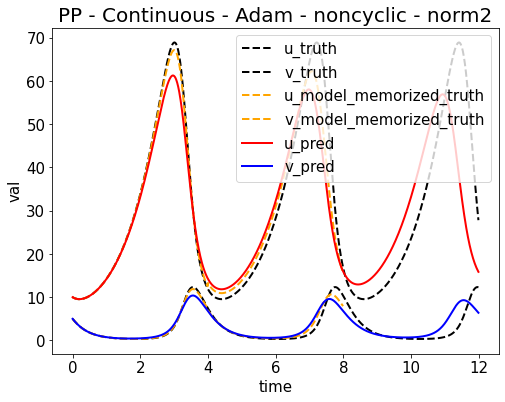

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653569807.png


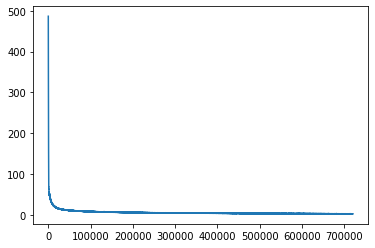

Epoch [722000/1000000] Loss:3.327085 Loss_1:0.000027 Loss_2:0.010368 Loss_3:0.000000 Loss_4:3.316689 Lr:0.001000 Time:24.107258s (133.09min in total, 51.25min remains)
Epoch [724000/1000000] Loss:3.411178 Loss_1:0.000041 Loss_2:0.009730 Loss_3:0.000000 Loss_4:3.401407 Lr:0.001000 Time:21.809956s (133.46min in total, 50.88min remains)
Epoch [726000/1000000] Loss:3.405928 Loss_1:0.000707 Loss_2:0.069162 Loss_3:0.000000 Loss_4:3.336058 Lr:0.001000 Time:21.830178s (133.82min in total, 50.51min remains)
Epoch [728000/1000000] Loss:3.301937 Loss_1:0.000006 Loss_2:0.002403 Loss_3:0.000000 Loss_4:3.299527 Lr:0.001000 Time:21.803386s (134.18min in total, 50.13min remains)
Epoch [730000/1000000] Loss:3.207893 Loss_1:0.000030 Loss_2:0.015318 Loss_3:0.000000 Loss_4:3.192546 Lr:0.001000 Time:21.778394s (134.55min in total, 49.76min remains)
Epoch [732000/1000000] Loss:3.325227 Loss_1:0.000540 Loss_2:0.017124 Loss_3:0.000000 Loss_4:3.307563 Lr:0.001000 Time:21.810131s (134.91min in total, 49.39min r

<Figure size 432x288 with 0 Axes>

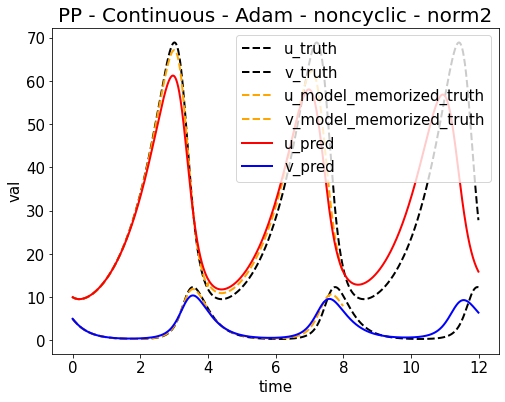

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653570027.png


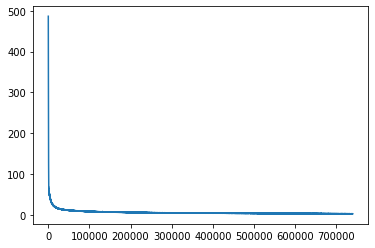

Epoch [742000/1000000] Loss:3.317053 Loss_1:0.000226 Loss_2:0.017108 Loss_3:0.000000 Loss_4:3.299719 Lr:0.001000 Time:23.784940s (136.76min in total, 47.55min remains)
Epoch [744000/1000000] Loss:3.199561 Loss_1:0.000100 Loss_2:0.014387 Loss_3:0.000000 Loss_4:3.185073 Lr:0.001000 Time:21.982651s (137.13min in total, 47.18min remains)
Epoch [746000/1000000] Loss:3.266652 Loss_1:0.000169 Loss_2:0.039626 Loss_3:0.000000 Loss_4:3.226857 Lr:0.001000 Time:21.890213s (137.49min in total, 46.81min remains)
Epoch [748000/1000000] Loss:3.138419 Loss_1:0.000231 Loss_2:0.008496 Loss_3:0.000000 Loss_4:3.129692 Lr:0.001000 Time:21.812924s (137.86min in total, 46.44min remains)
Epoch [750000/1000000] Loss:3.148088 Loss_1:0.000140 Loss_2:0.005508 Loss_3:0.000000 Loss_4:3.142440 Lr:0.001000 Time:21.691592s (138.22min in total, 46.07min remains)
Epoch [752000/1000000] Loss:3.162709 Loss_1:0.000001 Loss_2:0.005664 Loss_3:0.000000 Loss_4:3.157044 Lr:0.001000 Time:21.993380s (138.58min in total, 45.70min r

<Figure size 432x288 with 0 Axes>

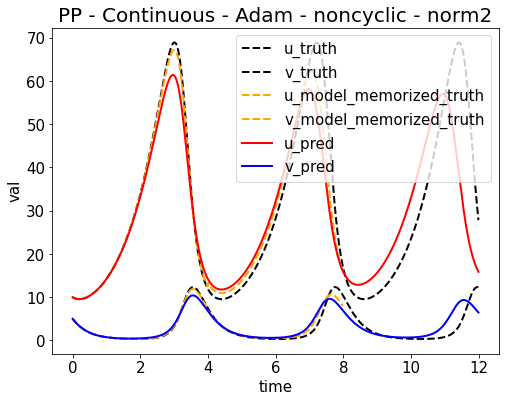

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653570247.png


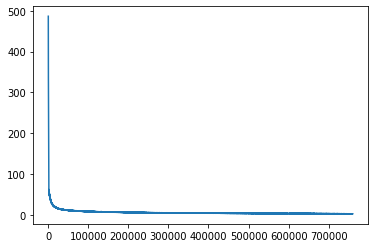

Epoch [762000/1000000] Loss:3.172432 Loss_1:0.000000 Loss_2:0.004702 Loss_3:0.000000 Loss_4:3.167731 Lr:0.001000 Time:24.053392s (140.43min in total, 43.86min remains)
Epoch [764000/1000000] Loss:3.181360 Loss_1:0.000054 Loss_2:0.012814 Loss_3:0.000000 Loss_4:3.168492 Lr:0.001000 Time:21.815380s (140.80min in total, 43.49min remains)
Epoch [766000/1000000] Loss:3.122443 Loss_1:0.000008 Loss_2:0.002482 Loss_3:0.000000 Loss_4:3.119953 Lr:0.001000 Time:21.793590s (141.16min in total, 43.12min remains)
Epoch [768000/1000000] Loss:3.132855 Loss_1:0.000021 Loss_2:0.005158 Loss_3:0.000000 Loss_4:3.127676 Lr:0.001000 Time:21.663768s (141.52min in total, 42.75min remains)
Epoch [770000/1000000] Loss:3.079738 Loss_1:0.000003 Loss_2:0.002880 Loss_3:0.000000 Loss_4:3.076855 Lr:0.001000 Time:21.708017s (141.88min in total, 42.38min remains)
Epoch [772000/1000000] Loss:3.052155 Loss_1:0.000620 Loss_2:0.031631 Loss_3:0.000000 Loss_4:3.019905 Lr:0.001000 Time:21.634886s (142.24min in total, 42.01min r

<Figure size 432x288 with 0 Axes>

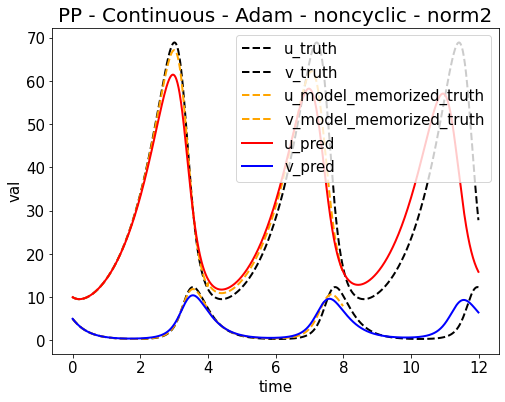

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653570467.png


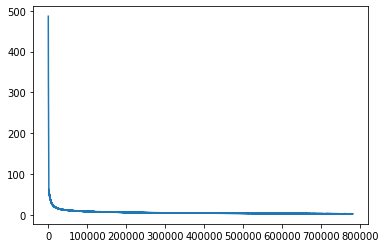

Epoch [782000/1000000] Loss:3.121639 Loss_1:0.000129 Loss_2:0.009753 Loss_3:0.000000 Loss_4:3.111757 Lr:0.001000 Time:24.198556s (144.10min in total, 40.17min remains)
Epoch [784000/1000000] Loss:3.109984 Loss_1:0.000014 Loss_2:0.003229 Loss_3:0.000000 Loss_4:3.106741 Lr:0.001000 Time:22.297731s (144.47min in total, 39.80min remains)
Epoch [786000/1000000] Loss:3.096560 Loss_1:0.000001 Loss_2:0.002279 Loss_3:0.000000 Loss_4:3.094281 Lr:0.001000 Time:22.221803s (144.84min in total, 39.43min remains)
Epoch [788000/1000000] Loss:3.044080 Loss_1:0.000001 Loss_2:0.002359 Loss_3:0.000000 Loss_4:3.041719 Lr:0.001000 Time:21.977227s (145.21min in total, 39.07min remains)
Epoch [790000/1000000] Loss:3.147679 Loss_1:0.000056 Loss_2:0.012611 Loss_3:0.000000 Loss_4:3.135011 Lr:0.001000 Time:22.237545s (145.58min in total, 38.70min remains)
Epoch [792000/1000000] Loss:3.031078 Loss_1:0.000037 Loss_2:0.035378 Loss_3:0.000000 Loss_4:2.995663 Lr:0.001000 Time:21.789475s (145.94min in total, 38.33min r

<Figure size 432x288 with 0 Axes>

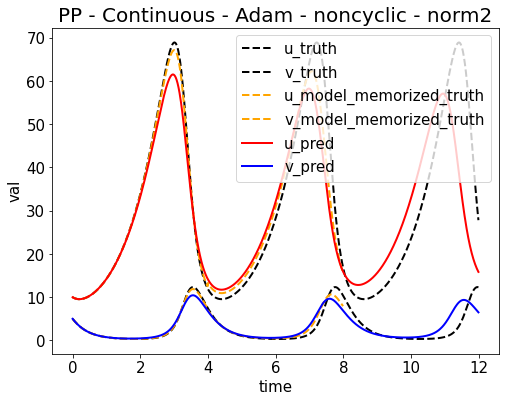

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653570687.png


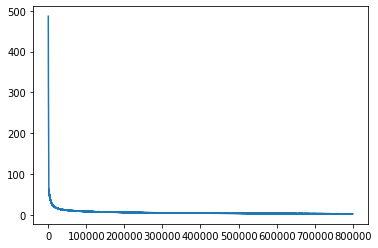

Epoch [802000/1000000] Loss:3.007766 Loss_1:0.000005 Loss_2:0.003716 Loss_3:0.000000 Loss_4:3.004045 Lr:0.001000 Time:23.501414s (147.76min in total, 36.48min remains)
Epoch [804000/1000000] Loss:2.976826 Loss_1:0.000008 Loss_2:0.002495 Loss_3:0.000000 Loss_4:2.974323 Lr:0.001000 Time:21.444689s (148.12min in total, 36.11min remains)
Epoch [806000/1000000] Loss:2.967717 Loss_1:0.000004 Loss_2:0.010550 Loss_3:0.000000 Loss_4:2.957162 Lr:0.001000 Time:21.919330s (148.48min in total, 35.74min remains)
Epoch [808000/1000000] Loss:3.000514 Loss_1:0.000007 Loss_2:0.007740 Loss_3:0.000000 Loss_4:2.992767 Lr:0.001000 Time:21.717065s (148.84min in total, 35.37min remains)
Epoch [810000/1000000] Loss:2.921860 Loss_1:0.000000 Loss_2:0.002234 Loss_3:0.000000 Loss_4:2.919626 Lr:0.001000 Time:21.490770s (149.20min in total, 35.00min remains)
Epoch [812000/1000000] Loss:2.901555 Loss_1:0.000004 Loss_2:0.002624 Loss_3:0.000000 Loss_4:2.898926 Lr:0.001000 Time:21.475132s (149.56min in total, 34.63min r

<Figure size 432x288 with 0 Axes>

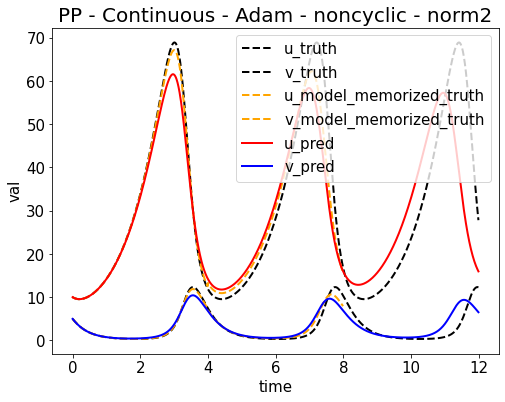

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653570905.png


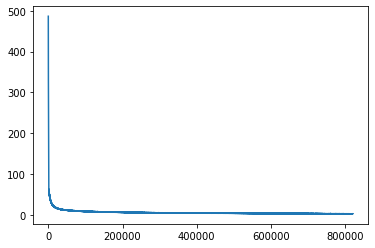

Epoch [822000/1000000] Loss:2.913545 Loss_1:0.000018 Loss_2:0.003701 Loss_3:0.000000 Loss_4:2.909826 Lr:0.001000 Time:24.013549s (151.39min in total, 32.78min remains)
Epoch [824000/1000000] Loss:2.901159 Loss_1:0.000064 Loss_2:0.006954 Loss_3:0.000000 Loss_4:2.894141 Lr:0.001000 Time:21.624977s (151.75min in total, 32.41min remains)
Epoch [826000/1000000] Loss:2.797001 Loss_1:0.000327 Loss_2:0.013793 Loss_3:0.000000 Loss_4:2.782881 Lr:0.001000 Time:21.687387s (152.12min in total, 32.04min remains)
Epoch [828000/1000000] Loss:2.956724 Loss_1:0.000163 Loss_2:0.010729 Loss_3:0.000000 Loss_4:2.945833 Lr:0.001000 Time:21.818654s (152.48min in total, 31.67min remains)
Epoch [830000/1000000] Loss:2.889929 Loss_1:0.000002 Loss_2:0.002233 Loss_3:0.000000 Loss_4:2.887694 Lr:0.001000 Time:21.663239s (152.84min in total, 31.30min remains)
Epoch [832000/1000000] Loss:2.911763 Loss_1:0.000008 Loss_2:0.002602 Loss_3:0.000000 Loss_4:2.909153 Lr:0.001000 Time:21.697319s (153.20min in total, 30.93min r

<Figure size 432x288 with 0 Axes>

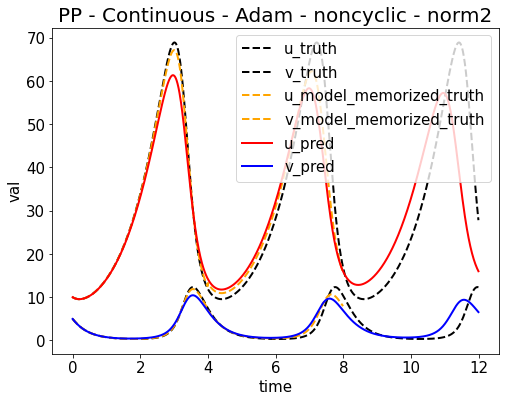

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653571124.png


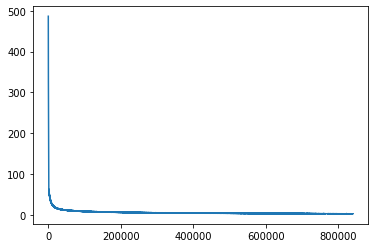

Epoch [842000/1000000] Loss:2.929555 Loss_1:0.000200 Loss_2:0.009250 Loss_3:0.000000 Loss_4:2.920105 Lr:0.001000 Time:23.941079s (155.04min in total, 29.09min remains)
Epoch [844000/1000000] Loss:2.890853 Loss_1:0.000003 Loss_2:0.002615 Loss_3:0.000000 Loss_4:2.888235 Lr:0.001000 Time:21.763270s (155.40min in total, 28.72min remains)
Epoch [846000/1000000] Loss:2.878241 Loss_1:0.000045 Loss_2:0.007933 Loss_3:0.000000 Loss_4:2.870263 Lr:0.001000 Time:21.594757s (155.76min in total, 28.35min remains)
Epoch [848000/1000000] Loss:2.888710 Loss_1:0.000002 Loss_2:0.002196 Loss_3:0.000000 Loss_4:2.886512 Lr:0.001000 Time:21.594561s (156.12min in total, 27.98min remains)
Epoch [850000/1000000] Loss:2.876754 Loss_1:0.000018 Loss_2:0.023801 Loss_3:0.000000 Loss_4:2.852934 Lr:0.001000 Time:21.467364s (156.48min in total, 27.61min remains)
Epoch [852000/1000000] Loss:2.935159 Loss_1:0.000161 Loss_2:0.033866 Loss_3:0.000000 Loss_4:2.901132 Lr:0.001000 Time:21.459483s (156.84min in total, 27.24min r

<Figure size 432x288 with 0 Axes>

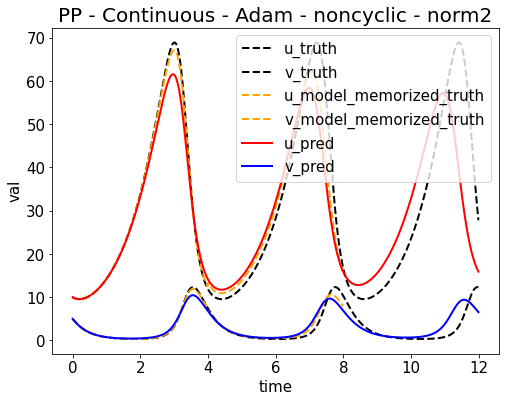

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653571342.png


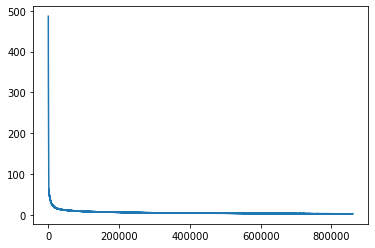

Epoch [862000/1000000] Loss:2.902653 Loss_1:0.000004 Loss_2:0.002280 Loss_3:0.000000 Loss_4:2.900369 Lr:0.001000 Time:23.889393s (158.68min in total, 25.40min remains)
Epoch [864000/1000000] Loss:2.871649 Loss_1:0.000008 Loss_2:0.041376 Loss_3:0.000000 Loss_4:2.830266 Lr:0.001000 Time:21.547552s (159.04min in total, 25.03min remains)
Epoch [866000/1000000] Loss:2.896578 Loss_1:0.000110 Loss_2:0.006709 Loss_3:0.000000 Loss_4:2.889760 Lr:0.001000 Time:21.584709s (159.40min in total, 24.66min remains)
Epoch [868000/1000000] Loss:2.892329 Loss_1:0.000024 Loss_2:0.006827 Loss_3:0.000000 Loss_4:2.885478 Lr:0.001000 Time:21.504619s (159.76min in total, 24.30min remains)
Epoch [870000/1000000] Loss:3.004184 Loss_1:0.000603 Loss_2:0.014675 Loss_3:0.000000 Loss_4:2.988906 Lr:0.001000 Time:21.593151s (160.12min in total, 23.93min remains)
Epoch [872000/1000000] Loss:2.864105 Loss_1:0.000017 Loss_2:0.002639 Loss_3:0.000000 Loss_4:2.861448 Lr:0.001000 Time:21.351836s (160.48min in total, 23.56min r

<Figure size 432x288 with 0 Axes>

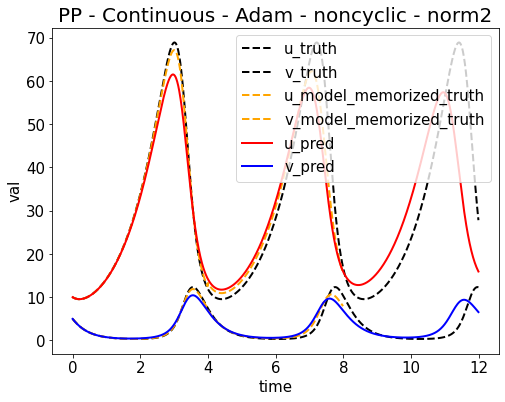

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653571560.png


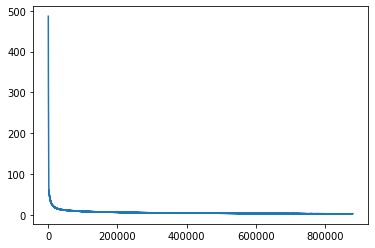

Epoch [882000/1000000] Loss:2.848117 Loss_1:0.000000 Loss_2:0.002747 Loss_3:0.000000 Loss_4:2.845370 Lr:0.001000 Time:24.400148s (162.32min in total, 21.72min remains)
Epoch [884000/1000000] Loss:2.826838 Loss_1:0.000012 Loss_2:0.002475 Loss_3:0.000000 Loss_4:2.824351 Lr:0.001000 Time:21.681221s (162.68min in total, 21.35min remains)
Epoch [886000/1000000] Loss:2.820992 Loss_1:0.000004 Loss_2:0.004373 Loss_3:0.000000 Loss_4:2.816615 Lr:0.001000 Time:21.636981s (163.04min in total, 20.98min remains)
Epoch [888000/1000000] Loss:2.872264 Loss_1:0.000013 Loss_2:0.007651 Loss_3:0.000000 Loss_4:2.864599 Lr:0.001000 Time:21.798515s (163.40min in total, 20.61min remains)
Epoch [890000/1000000] Loss:2.830475 Loss_1:0.000003 Loss_2:0.002179 Loss_3:0.000000 Loss_4:2.828292 Lr:0.001000 Time:21.606645s (163.76min in total, 20.24min remains)
Epoch [892000/1000000] Loss:2.748074 Loss_1:0.000108 Loss_2:0.008860 Loss_3:0.000000 Loss_4:2.739106 Lr:0.001000 Time:21.584741s (164.12min in total, 19.87min r

<Figure size 432x288 with 0 Axes>

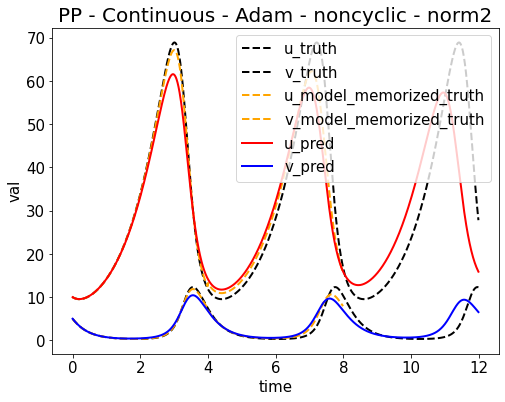

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653571779.png


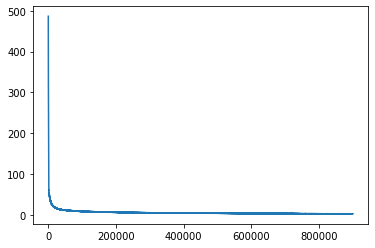

Epoch [902000/1000000] Loss:2.824798 Loss_1:0.000003 Loss_2:0.002467 Loss_3:0.000000 Loss_4:2.822328 Lr:0.001000 Time:23.719633s (165.96min in total, 18.03min remains)
Epoch [904000/1000000] Loss:2.825373 Loss_1:0.000001 Loss_2:0.002677 Loss_3:0.000000 Loss_4:2.822695 Lr:0.001000 Time:21.700821s (166.32min in total, 17.66min remains)
Epoch [906000/1000000] Loss:2.822607 Loss_1:0.000029 Loss_2:0.002857 Loss_3:0.000000 Loss_4:2.819721 Lr:0.001000 Time:21.707677s (166.68min in total, 17.29min remains)
Epoch [908000/1000000] Loss:2.873626 Loss_1:0.000001 Loss_2:0.005205 Loss_3:0.000000 Loss_4:2.868420 Lr:0.001000 Time:21.681715s (167.04min in total, 16.92min remains)
Epoch [910000/1000000] Loss:2.810733 Loss_1:0.000002 Loss_2:0.002482 Loss_3:0.000000 Loss_4:2.808249 Lr:0.001000 Time:21.843107s (167.40min in total, 16.56min remains)
Epoch [912000/1000000] Loss:2.786828 Loss_1:0.000003 Loss_2:0.002381 Loss_3:0.000000 Loss_4:2.784444 Lr:0.001000 Time:21.513699s (167.76min in total, 16.19min r

<Figure size 432x288 with 0 Axes>

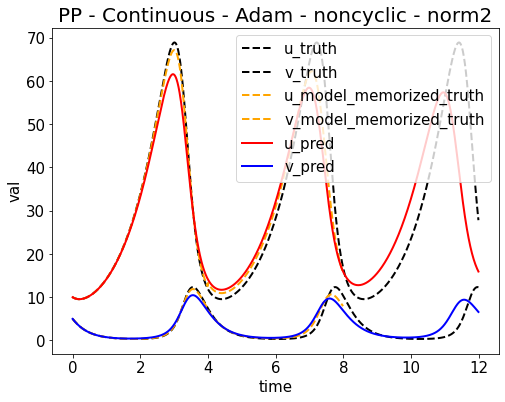

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653571998.png


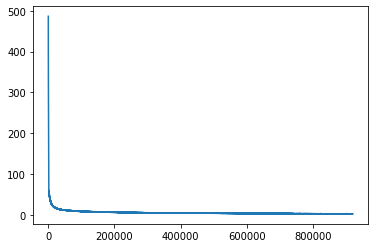

Epoch [922000/1000000] Loss:2.863205 Loss_1:0.000071 Loss_2:0.019489 Loss_3:0.000000 Loss_4:2.843645 Lr:0.001000 Time:24.169339s (169.61min in total, 14.35min remains)
Epoch [924000/1000000] Loss:2.803379 Loss_1:0.000002 Loss_2:0.002193 Loss_3:0.000000 Loss_4:2.801184 Lr:0.001000 Time:21.667129s (169.98min in total, 13.98min remains)
Epoch [926000/1000000] Loss:2.780605 Loss_1:0.000011 Loss_2:0.002168 Loss_3:0.000000 Loss_4:2.778425 Lr:0.001000 Time:21.616113s (170.34min in total, 13.61min remains)
Epoch [928000/1000000] Loss:2.790933 Loss_1:0.000001 Loss_2:0.002497 Loss_3:0.000000 Loss_4:2.788434 Lr:0.001000 Time:21.625310s (170.70min in total, 13.24min remains)
Epoch [930000/1000000] Loss:2.822268 Loss_1:0.000028 Loss_2:0.011064 Loss_3:0.000000 Loss_4:2.811176 Lr:0.001000 Time:21.781147s (171.06min in total, 12.88min remains)
Epoch [932000/1000000] Loss:2.791084 Loss_1:0.000003 Loss_2:0.002275 Loss_3:0.000000 Loss_4:2.788806 Lr:0.001000 Time:21.629016s (171.42min in total, 12.51min r

<Figure size 432x288 with 0 Axes>

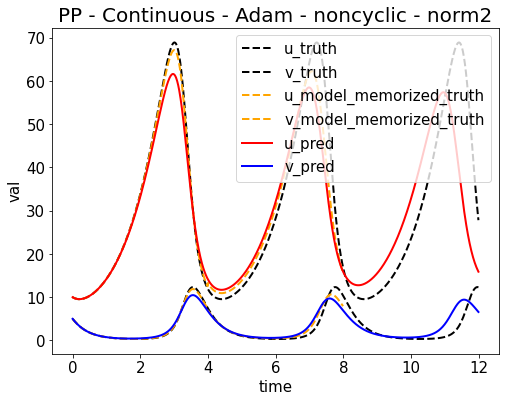

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653572217.png


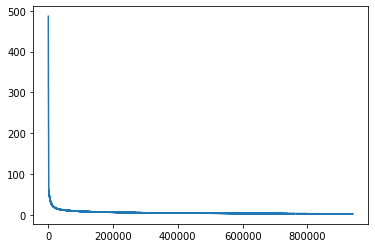

Epoch [942000/1000000] Loss:2.804236 Loss_1:0.000013 Loss_2:0.008279 Loss_3:0.000000 Loss_4:2.795944 Lr:0.001000 Time:24.335048s (173.27min in total, 10.67min remains)
Epoch [944000/1000000] Loss:2.805801 Loss_1:0.000018 Loss_2:0.002976 Loss_3:0.000000 Loss_4:2.802807 Lr:0.001000 Time:21.463037s (173.62min in total, 10.30min remains)
Epoch [946000/1000000] Loss:2.785869 Loss_1:0.000000 Loss_2:0.003661 Loss_3:0.000000 Loss_4:2.782208 Lr:0.001000 Time:21.470263s (173.98min in total, 9.93min remains)
Epoch [948000/1000000] Loss:2.803443 Loss_1:0.000023 Loss_2:0.003740 Loss_3:0.000000 Loss_4:2.799680 Lr:0.001000 Time:21.527069s (174.34min in total, 9.56min remains)
Epoch [950000/1000000] Loss:2.796049 Loss_1:0.000039 Loss_2:0.002563 Loss_3:0.000000 Loss_4:2.793447 Lr:0.001000 Time:21.534167s (174.70min in total, 9.19min remains)
Epoch [952000/1000000] Loss:2.777214 Loss_1:0.000141 Loss_2:0.004728 Loss_3:0.000000 Loss_4:2.772346 Lr:0.001000 Time:21.662049s (175.06min in total, 8.83min remai

<Figure size 432x288 with 0 Axes>

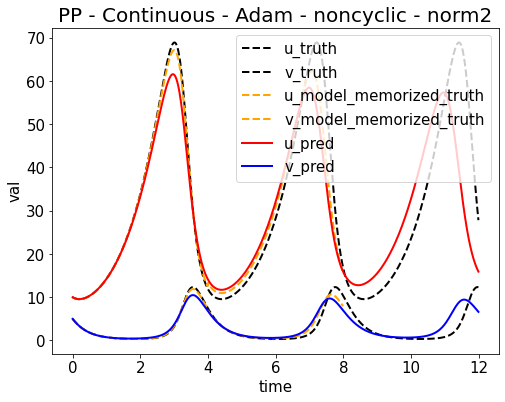

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653572435.png


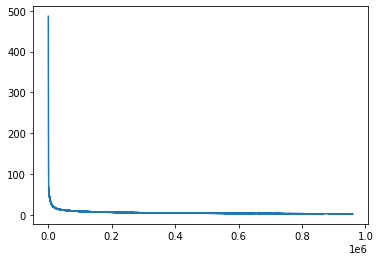

Epoch [962000/1000000] Loss:2.820807 Loss_1:0.000063 Loss_2:0.004410 Loss_3:0.000000 Loss_4:2.816335 Lr:0.001000 Time:24.070659s (176.90min in total, 6.99min remains)
Epoch [964000/1000000] Loss:2.746927 Loss_1:0.000003 Loss_2:0.002819 Loss_3:0.000000 Loss_4:2.744104 Lr:0.001000 Time:21.820383s (177.27min in total, 6.62min remains)
Epoch [966000/1000000] Loss:2.774371 Loss_1:0.000001 Loss_2:0.002352 Loss_3:0.000000 Loss_4:2.772018 Lr:0.001000 Time:21.583868s (177.63min in total, 6.25min remains)
Epoch [968000/1000000] Loss:2.730330 Loss_1:0.000025 Loss_2:0.002688 Loss_3:0.000000 Loss_4:2.727618 Lr:0.001000 Time:21.489474s (177.98min in total, 5.88min remains)
Epoch [970000/1000000] Loss:2.745327 Loss_1:0.000013 Loss_2:0.002678 Loss_3:0.000000 Loss_4:2.742636 Lr:0.001000 Time:21.733716s (178.35min in total, 5.52min remains)
Epoch [972000/1000000] Loss:2.916000 Loss_1:0.000943 Loss_2:0.035622 Loss_3:0.000000 Loss_4:2.879435 Lr:0.001000 Time:21.520249s (178.70min in total, 5.15min remains

<Figure size 432x288 with 0 Axes>

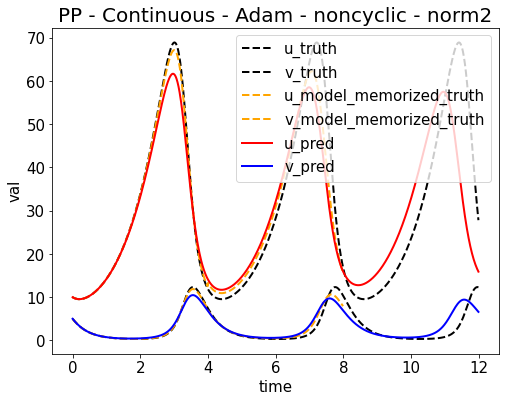

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653572654.png


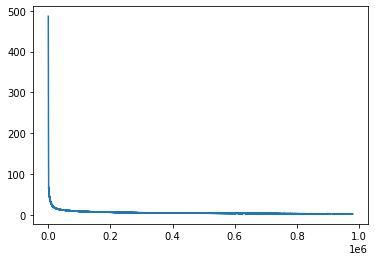

Epoch [982000/1000000] Loss:2.765812 Loss_1:0.000013 Loss_2:0.003884 Loss_3:0.000000 Loss_4:2.761915 Lr:0.001000 Time:24.216851s (180.55min in total, 3.31min remains)
Epoch [984000/1000000] Loss:2.739727 Loss_1:0.000000 Loss_2:0.002170 Loss_3:0.000000 Loss_4:2.737556 Lr:0.001000 Time:21.742599s (180.91min in total, 2.94min remains)
Epoch [986000/1000000] Loss:2.728436 Loss_1:0.000062 Loss_2:0.035202 Loss_3:0.000000 Loss_4:2.693172 Lr:0.001000 Time:21.752176s (181.27min in total, 2.57min remains)
Epoch [988000/1000000] Loss:2.732677 Loss_1:0.000003 Loss_2:0.003337 Loss_3:0.000000 Loss_4:2.729337 Lr:0.001000 Time:21.622676s (181.64min in total, 2.21min remains)
Epoch [990000/1000000] Loss:2.717646 Loss_1:0.000097 Loss_2:0.010580 Loss_3:0.000000 Loss_4:2.706969 Lr:0.001000 Time:21.670714s (182.00min in total, 1.84min remains)
Epoch [992000/1000000] Loss:2.745868 Loss_1:0.000030 Loss_2:0.010245 Loss_3:0.000000 Loss_4:2.735594 Lr:0.001000 Time:22.041283s (182.36min in total, 1.47min remains

<Figure size 432x288 with 0 Axes>

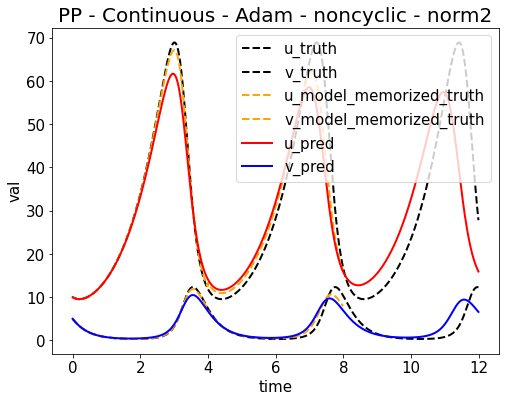

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653572874.png


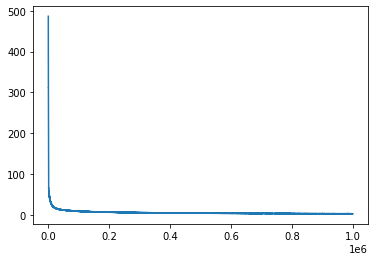

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
i = 3, length of truth = 1200 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1

<Figure size 432x288 with 0 Axes>

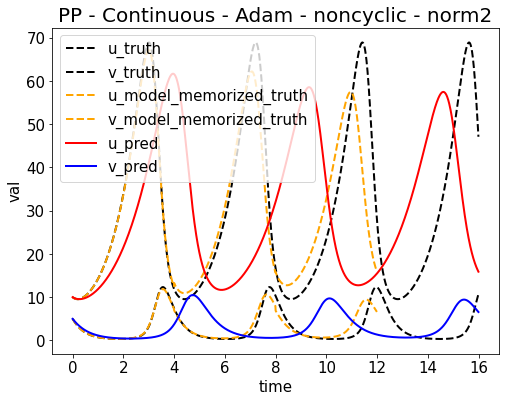

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653572877.png
using cuda
epoch = 1000000
epoch_step = 2000
model_name = SimpleNetworkPP_Continue
now_string = 2022-05-26-06-01-18
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 2000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 20000}
config = {'model_name': 'SimpleNetworkPP_Continue', 'T': 16.0, 'T_all': 20.0, 'T_unit': 0.01, 'N': 1600, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0,

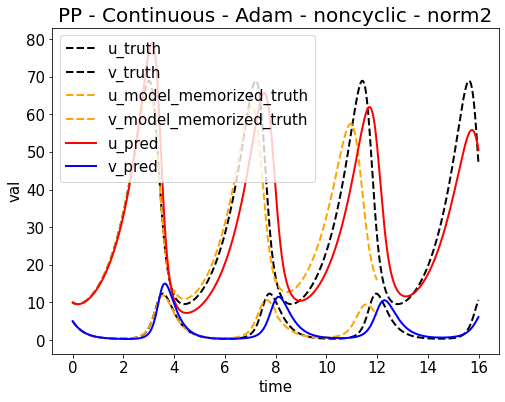

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653573124.png


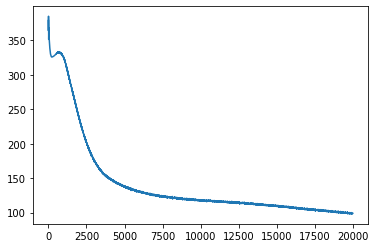

Epoch [22000/1000000] Loss:94.419380 Loss_1:0.000044 Loss_2:0.011141 Loss_3:0.000000 Loss_4:94.408195 Lr:0.001000 Time:25.555937s (4.53min in total, 201.40min remains)
Epoch [24000/1000000] Loss:89.917381 Loss_1:0.000074 Loss_2:0.044735 Loss_3:0.000000 Loss_4:89.872574 Lr:0.001000 Time:24.531003s (4.94min in total, 200.87min remains)
Epoch [26000/1000000] Loss:85.884575 Loss_1:0.000142 Loss_2:0.030861 Loss_3:0.000000 Loss_4:85.853569 Lr:0.001000 Time:24.484915s (5.35min in total, 200.33min remains)
Epoch [28000/1000000] Loss:80.959511 Loss_1:0.000030 Loss_2:0.007005 Loss_3:0.000000 Loss_4:80.952477 Lr:0.001000 Time:24.501779s (5.76min in total, 199.81min remains)
Epoch [30000/1000000] Loss:76.076180 Loss_1:0.000037 Loss_2:0.016537 Loss_3:0.000000 Loss_4:76.059608 Lr:0.001000 Time:24.475147s (6.16min in total, 199.30min remains)
Epoch [32000/1000000] Loss:71.449875 Loss_1:0.000013 Loss_2:0.007503 Loss_3:0.000000 Loss_4:71.442360 Lr:0.001000 Time:24.290073s (6.57min in total, 198.70min r

<Figure size 432x288 with 0 Axes>

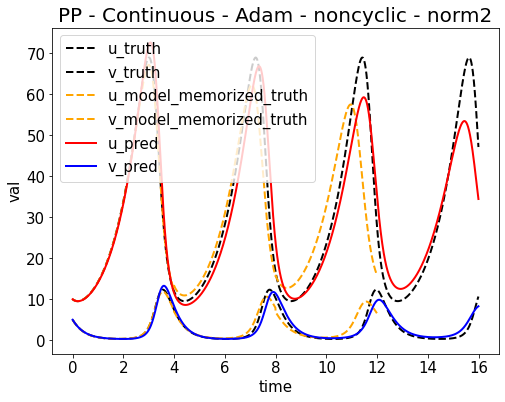

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653573370.png


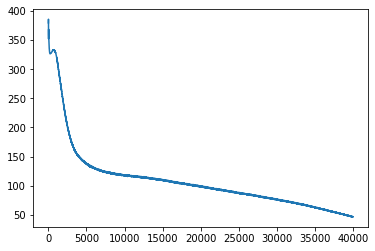

Epoch [42000/1000000] Loss:39.141762 Loss_1:0.000307 Loss_2:0.023501 Loss_3:0.000000 Loss_4:39.117954 Lr:0.001000 Time:25.812673s (8.63min in total, 196.85min remains)
Epoch [44000/1000000] Loss:34.596619 Loss_1:0.000297 Loss_2:0.062754 Loss_3:0.000000 Loss_4:34.533569 Lr:0.001000 Time:24.471499s (9.04min in total, 196.37min remains)
Epoch [46000/1000000] Loss:30.407364 Loss_1:0.000184 Loss_2:0.022453 Loss_3:0.000000 Loss_4:30.384727 Lr:0.001000 Time:24.535811s (9.45min in total, 195.92min remains)
Epoch [48000/1000000] Loss:25.634617 Loss_1:0.000050 Loss_2:0.015565 Loss_3:0.000000 Loss_4:25.619001 Lr:0.001000 Time:24.598000s (9.86min in total, 195.50min remains)
Epoch [50000/1000000] Loss:21.760544 Loss_1:0.000047 Loss_2:0.012482 Loss_3:0.000000 Loss_4:21.748014 Lr:0.001000 Time:24.589195s (10.27min in total, 195.07min remains)
Epoch [52000/1000000] Loss:18.584042 Loss_1:0.000004 Loss_2:0.004683 Loss_3:0.000000 Loss_4:18.579353 Lr:0.001000 Time:24.736036s (10.68min in total, 194.69min

<Figure size 432x288 with 0 Axes>

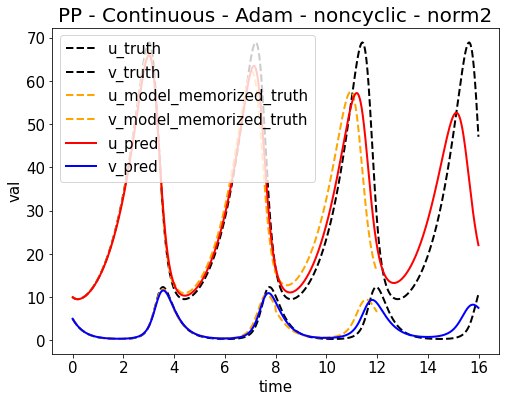

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653573617.png


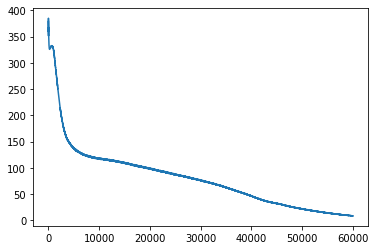

Epoch [62000/1000000] Loss:6.943458 Loss_1:0.000001 Loss_2:0.005319 Loss_3:0.000000 Loss_4:6.938138 Lr:0.001000 Time:25.721070s (12.76min in total, 193.00min remains)
Epoch [64000/1000000] Loss:5.602908 Loss_1:0.000008 Loss_2:0.006836 Loss_3:0.000000 Loss_4:5.596065 Lr:0.001000 Time:24.586226s (13.17min in total, 192.57min remains)
Epoch [66000/1000000] Loss:4.514494 Loss_1:0.000040 Loss_2:0.011340 Loss_3:0.000000 Loss_4:4.503113 Lr:0.001000 Time:24.895806s (13.58min in total, 192.20min remains)
Epoch [68000/1000000] Loss:3.504738 Loss_1:0.000228 Loss_2:0.035890 Loss_3:0.000000 Loss_4:3.468620 Lr:0.001000 Time:24.471283s (13.99min in total, 191.74min remains)
Epoch [70000/1000000] Loss:2.904049 Loss_1:0.000028 Loss_2:0.103819 Loss_3:0.000000 Loss_4:2.800203 Lr:0.001000 Time:24.711391s (14.40min in total, 191.34min remains)
Epoch [72000/1000000] Loss:2.321563 Loss_1:0.000324 Loss_2:0.025420 Loss_3:0.000000 Loss_4:2.295819 Lr:0.001000 Time:24.375119s (14.81min in total, 190.86min remains

<Figure size 432x288 with 0 Axes>

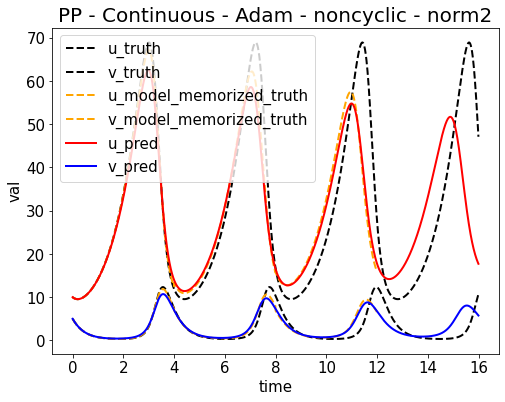

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653573865.png


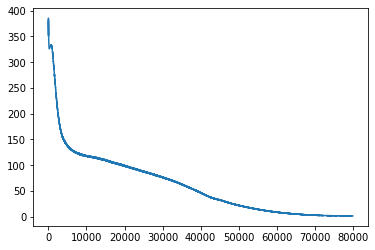

Epoch [82000/1000000] Loss:1.646692 Loss_1:0.000073 Loss_2:0.004805 Loss_3:0.000000 Loss_4:1.641814 Lr:0.001000 Time:25.566416s (16.87min in total, 188.89min remains)
Epoch [84000/1000000] Loss:1.930812 Loss_1:0.000162 Loss_2:0.019063 Loss_3:0.000000 Loss_4:1.911587 Lr:0.001000 Time:24.596280s (17.28min in total, 188.46min remains)
Epoch [86000/1000000] Loss:2.251022 Loss_1:0.000030 Loss_2:0.006415 Loss_3:0.000000 Loss_4:2.244578 Lr:0.001000 Time:24.383667s (17.69min in total, 187.99min remains)
Epoch [88000/1000000] Loss:2.542319 Loss_1:0.000087 Loss_2:0.006667 Loss_3:0.000000 Loss_4:2.535564 Lr:0.001000 Time:24.507137s (18.10min in total, 187.55min remains)
Epoch [90000/1000000] Loss:3.075543 Loss_1:0.000060 Loss_2:0.016416 Loss_3:0.000000 Loss_4:3.059067 Lr:0.001000 Time:24.621076s (18.51min in total, 187.13min remains)
Epoch [92000/1000000] Loss:3.501732 Loss_1:0.000015 Loss_2:0.007081 Loss_3:0.000000 Loss_4:3.494636 Lr:0.001000 Time:24.658823s (18.92min in total, 186.72min remains

<Figure size 432x288 with 0 Axes>

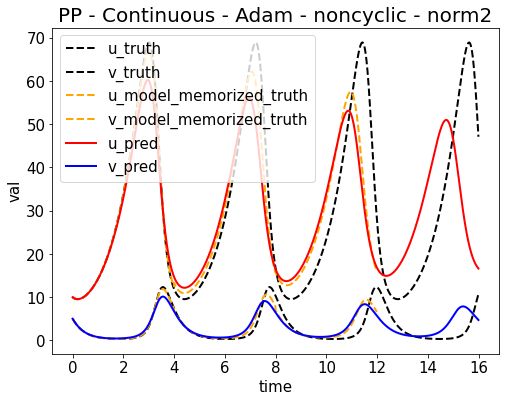

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653574111.png


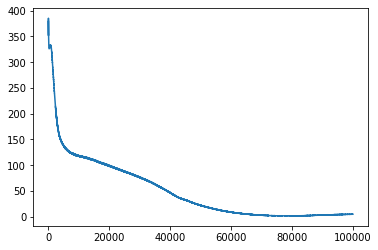

Epoch [102000/1000000] Loss:4.827844 Loss_1:0.000036 Loss_2:0.012945 Loss_3:0.000000 Loss_4:4.814863 Lr:0.001000 Time:25.885973s (20.98min in total, 184.75min remains)
Epoch [104000/1000000] Loss:5.087502 Loss_1:0.000096 Loss_2:0.006246 Loss_3:0.000000 Loss_4:5.081160 Lr:0.001000 Time:24.616410s (21.39min in total, 184.32min remains)
Epoch [106000/1000000] Loss:5.174844 Loss_1:0.000003 Loss_2:0.003954 Loss_3:0.000000 Loss_4:5.170888 Lr:0.001000 Time:24.512683s (21.80min in total, 183.89min remains)
Epoch [108000/1000000] Loss:5.387683 Loss_1:0.000051 Loss_2:0.017907 Loss_3:0.000000 Loss_4:5.369724 Lr:0.001000 Time:24.355224s (22.21min in total, 183.43min remains)
Epoch [110000/1000000] Loss:5.427550 Loss_1:0.000023 Loss_2:0.004127 Loss_3:0.000000 Loss_4:5.423400 Lr:0.001000 Time:24.598701s (22.62min in total, 183.01min remains)
Epoch [112000/1000000] Loss:5.600052 Loss_1:0.000004 Loss_2:0.004015 Loss_3:0.000000 Loss_4:5.596033 Lr:0.001000 Time:24.570720s (23.03min in total, 182.58min r

<Figure size 432x288 with 0 Axes>

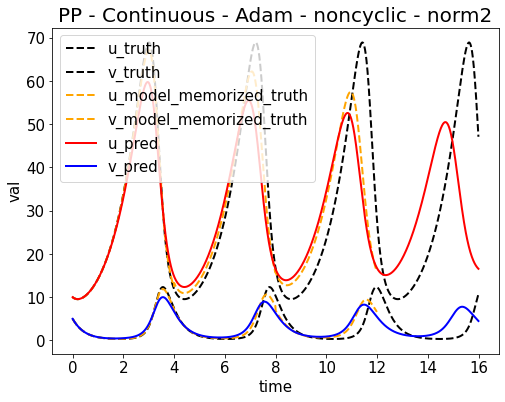

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653574358.png


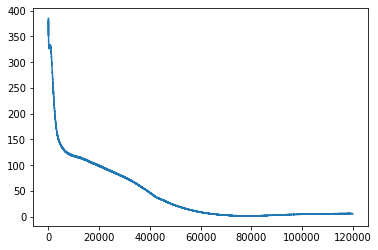

Epoch [122000/1000000] Loss:6.008462 Loss_1:0.000025 Loss_2:0.017169 Loss_3:0.000000 Loss_4:5.991267 Lr:0.001000 Time:25.709589s (25.09min in total, 180.59min remains)
Epoch [124000/1000000] Loss:6.053050 Loss_1:0.000011 Loss_2:0.006613 Loss_3:0.000000 Loss_4:6.046426 Lr:0.001000 Time:24.540167s (25.50min in total, 180.17min remains)
Epoch [126000/1000000] Loss:6.199536 Loss_1:0.000131 Loss_2:0.013962 Loss_3:0.000000 Loss_4:6.185442 Lr:0.001000 Time:24.618571s (25.91min in total, 179.75min remains)
Epoch [128000/1000000] Loss:6.180256 Loss_1:0.000012 Loss_2:0.008647 Loss_3:0.000000 Loss_4:6.171597 Lr:0.001000 Time:24.477677s (26.32min in total, 179.31min remains)
Epoch [130000/1000000] Loss:6.222863 Loss_1:0.000042 Loss_2:0.004239 Loss_3:0.000000 Loss_4:6.218581 Lr:0.001000 Time:24.772235s (26.73min in total, 178.91min remains)
Epoch [132000/1000000] Loss:6.265844 Loss_1:0.000058 Loss_2:0.005164 Loss_3:0.000000 Loss_4:6.260622 Lr:0.001000 Time:24.477380s (27.14min in total, 178.48min r

<Figure size 432x288 with 0 Axes>

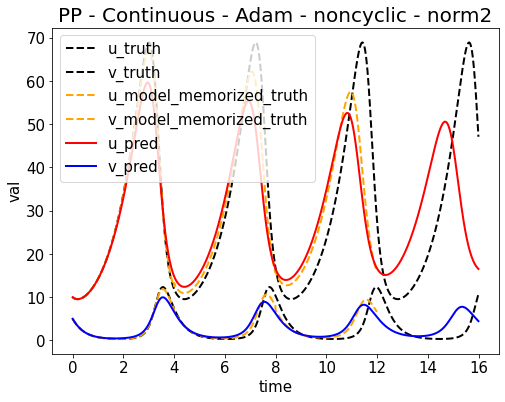

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653574604.png


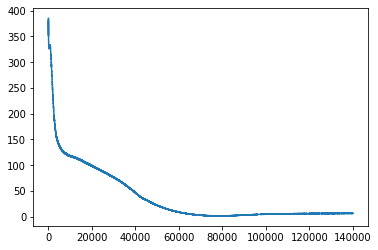

Epoch [142000/1000000] Loss:6.392612 Loss_1:0.000001 Loss_2:0.004078 Loss_3:0.000000 Loss_4:6.388533 Lr:0.001000 Time:25.391908s (29.20min in total, 176.44min remains)
Epoch [144000/1000000] Loss:6.413655 Loss_1:0.000052 Loss_2:0.004505 Loss_3:0.000000 Loss_4:6.409098 Lr:0.001000 Time:24.506291s (29.61min in total, 176.01min remains)
Epoch [146000/1000000] Loss:6.490384 Loss_1:0.000164 Loss_2:0.006887 Loss_3:0.000000 Loss_4:6.483334 Lr:0.001000 Time:24.369084s (30.02min in total, 175.57min remains)
Epoch [148000/1000000] Loss:6.566361 Loss_1:0.000291 Loss_2:0.054936 Loss_3:0.000000 Loss_4:6.511134 Lr:0.001000 Time:24.396720s (30.42min in total, 175.13min remains)
Epoch [150000/1000000] Loss:6.428335 Loss_1:0.000029 Loss_2:0.006334 Loss_3:0.000000 Loss_4:6.421973 Lr:0.001000 Time:24.459738s (30.83min in total, 174.70min remains)
Epoch [152000/1000000] Loss:6.397476 Loss_1:0.000035 Loss_2:0.012077 Loss_3:0.000000 Loss_4:6.385365 Lr:0.001000 Time:24.512227s (31.24min in total, 174.28min r

<Figure size 432x288 with 0 Axes>

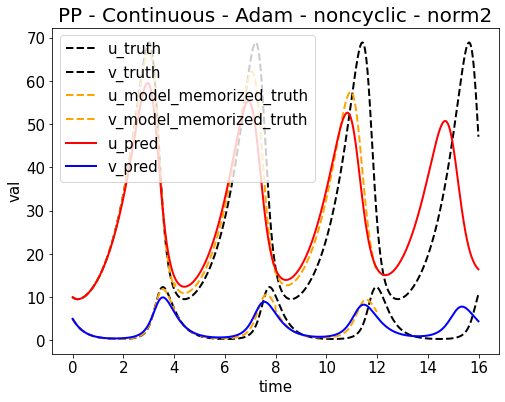

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653574850.png


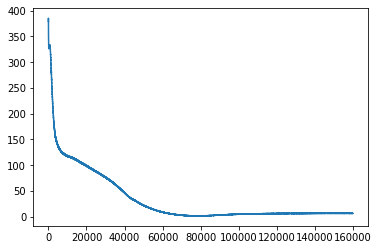

Epoch [162000/1000000] Loss:6.446589 Loss_1:0.000001 Loss_2:0.008065 Loss_3:0.000000 Loss_4:6.438523 Lr:0.001000 Time:26.020513s (33.30min in total, 172.27min remains)
Epoch [164000/1000000] Loss:6.429076 Loss_1:0.000073 Loss_2:0.036795 Loss_3:0.000000 Loss_4:6.392208 Lr:0.001000 Time:24.744093s (33.72min in total, 171.87min remains)
Epoch [166000/1000000] Loss:6.367660 Loss_1:0.000001 Loss_2:0.005020 Loss_3:0.000000 Loss_4:6.362638 Lr:0.001000 Time:24.630013s (34.13min in total, 171.46min remains)
Epoch [168000/1000000] Loss:6.432354 Loss_1:0.000095 Loss_2:0.020785 Loss_3:0.000000 Loss_4:6.411475 Lr:0.001000 Time:24.822549s (34.54min in total, 171.06min remains)
Epoch [170000/1000000] Loss:6.315343 Loss_1:0.000084 Loss_2:0.007663 Loss_3:0.000000 Loss_4:6.307596 Lr:0.001000 Time:24.396462s (34.95min in total, 170.62min remains)
Epoch [172000/1000000] Loss:6.357688 Loss_1:0.000040 Loss_2:0.006233 Loss_3:0.000000 Loss_4:6.351415 Lr:0.001000 Time:24.762195s (35.36min in total, 170.22min r

<Figure size 432x288 with 0 Axes>

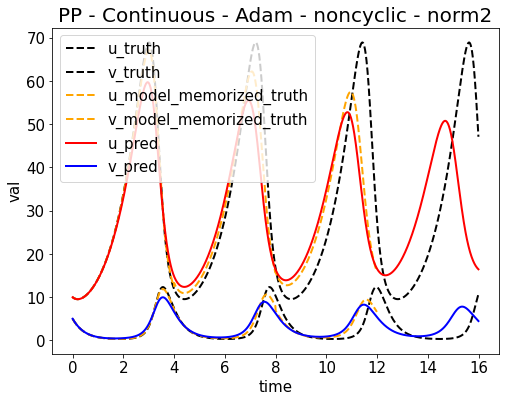

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653575098.png


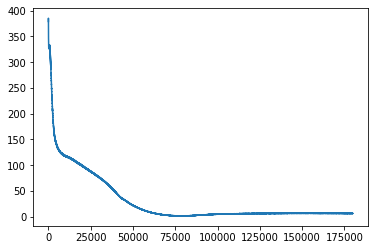

Epoch [182000/1000000] Loss:6.315769 Loss_1:0.000027 Loss_2:0.008952 Loss_3:0.000000 Loss_4:6.306790 Lr:0.001000 Time:25.888638s (37.43min in total, 168.22min remains)
Epoch [184000/1000000] Loss:6.385193 Loss_1:0.000241 Loss_2:0.042455 Loss_3:0.000000 Loss_4:6.342496 Lr:0.001000 Time:24.577203s (37.84min in total, 167.80min remains)
Epoch [186000/1000000] Loss:6.355963 Loss_1:0.000088 Loss_2:0.037362 Loss_3:0.000000 Loss_4:6.318512 Lr:0.001000 Time:24.521867s (38.25min in total, 167.38min remains)
Epoch [188000/1000000] Loss:6.245593 Loss_1:0.000012 Loss_2:0.004318 Loss_3:0.000000 Loss_4:6.241263 Lr:0.001000 Time:24.654714s (38.66min in total, 166.97min remains)
Epoch [190000/1000000] Loss:6.340302 Loss_1:0.000175 Loss_2:0.016298 Loss_3:0.000000 Loss_4:6.323828 Lr:0.001000 Time:24.467409s (39.07min in total, 166.54min remains)
Epoch [192000/1000000] Loss:6.232625 Loss_1:0.000001 Loss_2:0.003893 Loss_3:0.000000 Loss_4:6.228732 Lr:0.001000 Time:24.692921s (39.48min in total, 166.13min r

<Figure size 432x288 with 0 Axes>

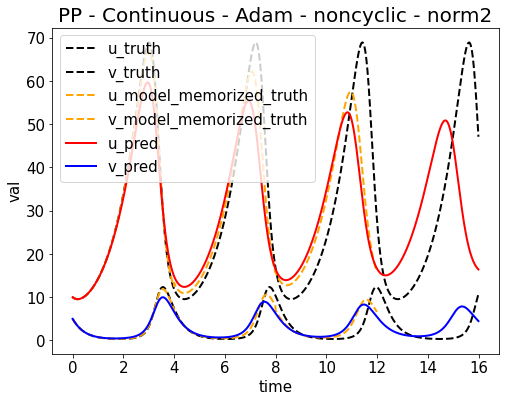

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653575345.png


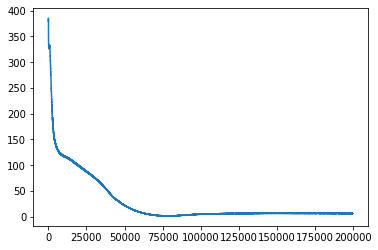

Epoch [202000/1000000] Loss:6.241056 Loss_1:0.000004 Loss_2:0.004634 Loss_3:0.000000 Loss_4:6.236419 Lr:0.001000 Time:26.182752s (41.55min in total, 164.16min remains)
Epoch [204000/1000000] Loss:6.252352 Loss_1:0.000073 Loss_2:0.059086 Loss_3:0.000000 Loss_4:6.193192 Lr:0.001000 Time:24.484255s (41.96min in total, 163.73min remains)
Epoch [206000/1000000] Loss:6.269708 Loss_1:0.000318 Loss_2:0.093059 Loss_3:0.000000 Loss_4:6.176330 Lr:0.001000 Time:24.565507s (42.37min in total, 163.31min remains)
Epoch [208000/1000000] Loss:6.149505 Loss_1:0.000042 Loss_2:0.012705 Loss_3:0.000000 Loss_4:6.136757 Lr:0.001000 Time:24.662662s (42.78min in total, 162.90min remains)
Epoch [210000/1000000] Loss:6.359221 Loss_1:0.000152 Loss_2:0.010231 Loss_3:0.000000 Loss_4:6.348838 Lr:0.001000 Time:24.598159s (43.19min in total, 162.48min remains)
Epoch [212000/1000000] Loss:6.180503 Loss_1:0.000032 Loss_2:0.005783 Loss_3:0.000000 Loss_4:6.174687 Lr:0.001000 Time:24.723564s (43.60min in total, 162.08min r

<Figure size 432x288 with 0 Axes>

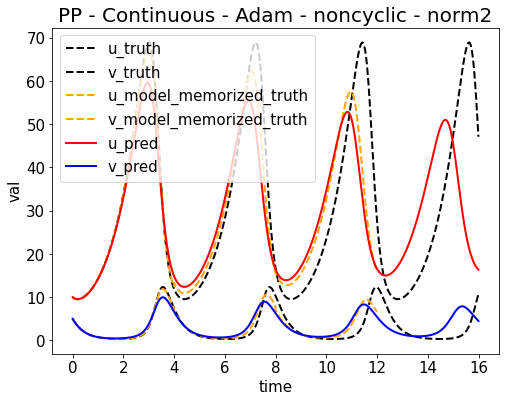

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653575593.png


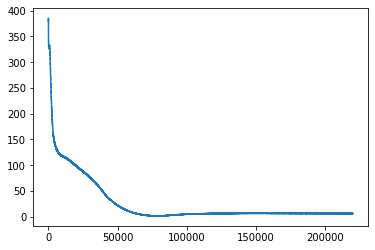

Epoch [222000/1000000] Loss:6.138190 Loss_1:0.000137 Loss_2:0.006766 Loss_3:0.000000 Loss_4:6.131287 Lr:0.001000 Time:26.061379s (45.68min in total, 160.09min remains)
Epoch [224000/1000000] Loss:6.158372 Loss_1:0.000012 Loss_2:0.005035 Loss_3:0.000000 Loss_4:6.153325 Lr:0.001000 Time:24.587055s (46.09min in total, 159.68min remains)
Epoch [226000/1000000] Loss:6.140988 Loss_1:0.000118 Loss_2:0.010821 Loss_3:0.000000 Loss_4:6.130048 Lr:0.001000 Time:24.607009s (46.50min in total, 159.26min remains)
Epoch [228000/1000000] Loss:6.130393 Loss_1:0.000012 Loss_2:0.004703 Loss_3:0.000000 Loss_4:6.125678 Lr:0.001000 Time:24.823977s (46.92min in total, 158.85min remains)
Epoch [230000/1000000] Loss:6.086870 Loss_1:0.000007 Loss_2:0.003956 Loss_3:0.000000 Loss_4:6.082907 Lr:0.001000 Time:24.531500s (47.32min in total, 158.43min remains)
Epoch [232000/1000000] Loss:6.118558 Loss_1:0.000034 Loss_2:0.005186 Loss_3:0.000000 Loss_4:6.113339 Lr:0.001000 Time:24.605309s (47.73min in total, 158.02min r

<Figure size 432x288 with 0 Axes>

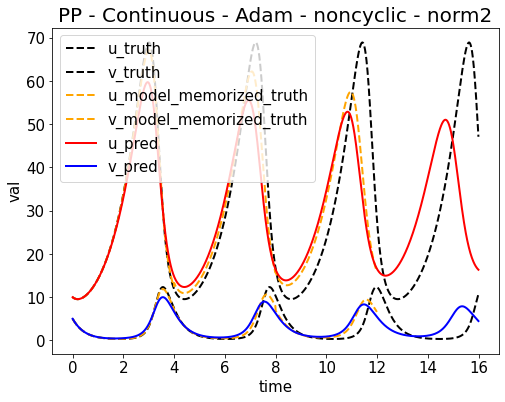

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653575840.png


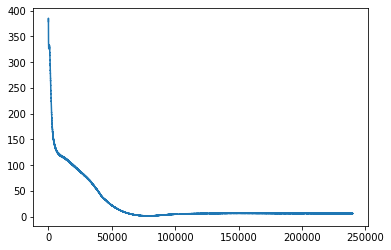

Epoch [242000/1000000] Loss:5.986591 Loss_1:0.000074 Loss_2:0.007623 Loss_3:0.000000 Loss_4:5.978894 Lr:0.001000 Time:26.261858s (49.82min in total, 156.03min remains)
Epoch [244000/1000000] Loss:6.040919 Loss_1:0.000087 Loss_2:0.006468 Loss_3:0.000000 Loss_4:6.034365 Lr:0.001000 Time:24.721365s (50.23min in total, 155.62min remains)
Epoch [246000/1000000] Loss:6.062290 Loss_1:0.000103 Loss_2:0.006479 Loss_3:0.000000 Loss_4:6.055707 Lr:0.001000 Time:24.410079s (50.63min in total, 155.20min remains)
Epoch [248000/1000000] Loss:6.056018 Loss_1:0.000033 Loss_2:0.004769 Loss_3:0.000000 Loss_4:6.051216 Lr:0.001000 Time:24.628340s (51.04min in total, 154.78min remains)
Epoch [250000/1000000] Loss:6.004383 Loss_1:0.000021 Loss_2:0.005092 Loss_3:0.000000 Loss_4:5.999270 Lr:0.001000 Time:24.562358s (51.45min in total, 154.36min remains)
Epoch [252000/1000000] Loss:5.984787 Loss_1:0.000003 Loss_2:0.003859 Loss_3:0.000000 Loss_4:5.980925 Lr:0.001000 Time:24.661949s (51.87min in total, 153.95min r

<Figure size 432x288 with 0 Axes>

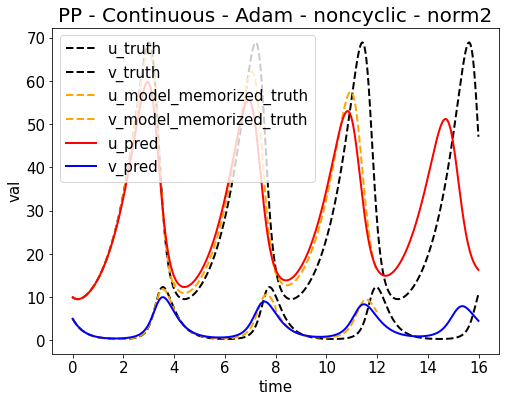

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653576088.png


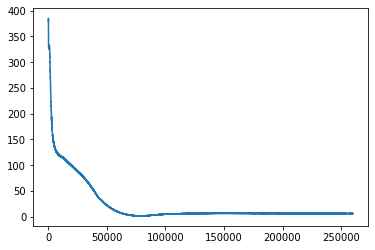

Epoch [262000/1000000] Loss:5.922124 Loss_1:0.000386 Loss_2:0.007643 Loss_3:0.000000 Loss_4:5.914095 Lr:0.001000 Time:26.066063s (53.94min in total, 151.93min remains)
Epoch [264000/1000000] Loss:5.934178 Loss_1:0.000002 Loss_2:0.004353 Loss_3:0.000000 Loss_4:5.929823 Lr:0.001000 Time:24.620480s (54.35min in total, 151.51min remains)
Epoch [266000/1000000] Loss:5.946789 Loss_1:0.000001 Loss_2:0.004330 Loss_3:0.000000 Loss_4:5.942458 Lr:0.001000 Time:24.536920s (54.76min in total, 151.09min remains)
Epoch [268000/1000000] Loss:5.938410 Loss_1:0.000038 Loss_2:0.006503 Loss_3:0.000000 Loss_4:5.931870 Lr:0.001000 Time:24.432108s (55.16min in total, 150.67min remains)
Epoch [270000/1000000] Loss:5.879605 Loss_1:0.000001 Loss_2:0.004050 Loss_3:0.000000 Loss_4:5.875555 Lr:0.001000 Time:24.639840s (55.57min in total, 150.26min remains)
Epoch [272000/1000000] Loss:5.909395 Loss_1:0.000016 Loss_2:0.011100 Loss_3:0.000000 Loss_4:5.898280 Lr:0.001000 Time:24.656474s (55.98min in total, 149.84min r

<Figure size 432x288 with 0 Axes>

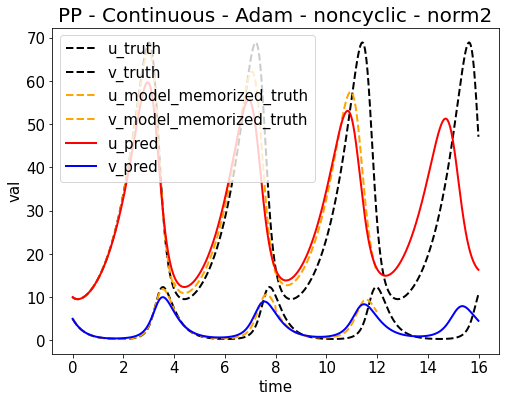

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653576336.png


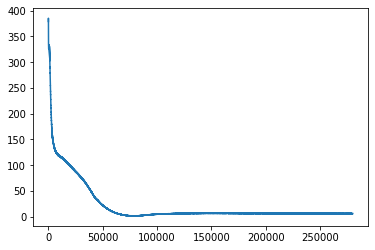

Epoch [282000/1000000] Loss:5.899907 Loss_1:0.000001 Loss_2:0.003860 Loss_3:0.000000 Loss_4:5.896046 Lr:0.001000 Time:26.038605s (58.06min in total, 147.84min remains)
Epoch [284000/1000000] Loss:5.946407 Loss_1:0.000035 Loss_2:0.033554 Loss_3:0.000000 Loss_4:5.912818 Lr:0.001000 Time:24.628327s (58.47min in total, 147.42min remains)
Epoch [286000/1000000] Loss:5.870553 Loss_1:0.000126 Loss_2:0.026795 Loss_3:0.000000 Loss_4:5.843632 Lr:0.001000 Time:24.603184s (58.88min in total, 147.01min remains)
Epoch [288000/1000000] Loss:5.835232 Loss_1:0.000029 Loss_2:0.005287 Loss_3:0.000000 Loss_4:5.829916 Lr:0.001000 Time:24.433181s (59.29min in total, 146.58min remains)
Epoch [290000/1000000] Loss:5.847965 Loss_1:0.000003 Loss_2:0.003847 Loss_3:0.000000 Loss_4:5.844116 Lr:0.001000 Time:24.547227s (59.70min in total, 146.17min remains)
Epoch [292000/1000000] Loss:5.883971 Loss_1:0.000143 Loss_2:0.009005 Loss_3:0.000000 Loss_4:5.874822 Lr:0.001000 Time:24.444082s (60.11min in total, 145.74min r

<Figure size 432x288 with 0 Axes>

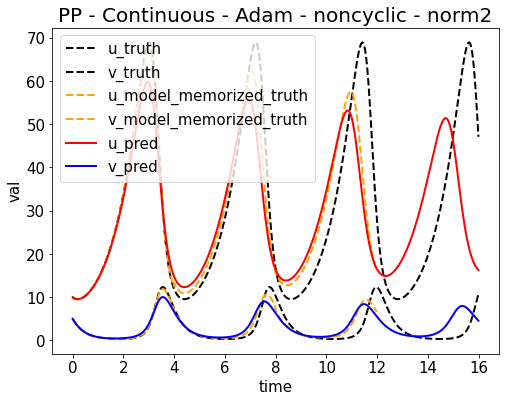

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653576582.png


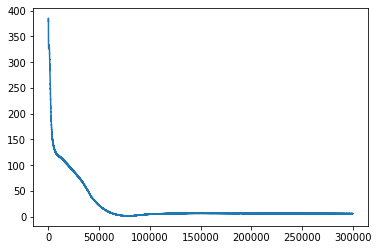

Epoch [302000/1000000] Loss:5.787245 Loss_1:0.000437 Loss_2:0.007117 Loss_3:0.000000 Loss_4:5.779691 Lr:0.001000 Time:26.602415s (62.19min in total, 143.73min remains)
Epoch [304000/1000000] Loss:5.834497 Loss_1:0.000001 Loss_2:0.003657 Loss_3:0.000000 Loss_4:5.830840 Lr:0.001000 Time:24.789720s (62.60min in total, 143.32min remains)
Epoch [306000/1000000] Loss:5.824828 Loss_1:0.000044 Loss_2:0.003786 Loss_3:0.000000 Loss_4:5.820997 Lr:0.001000 Time:24.971486s (63.02min in total, 142.92min remains)
Epoch [308000/1000000] Loss:5.834267 Loss_1:0.000008 Loss_2:0.004047 Loss_3:0.000000 Loss_4:5.830211 Lr:0.001000 Time:25.016535s (63.43min in total, 142.52min remains)
Epoch [310000/1000000] Loss:5.803422 Loss_1:0.000083 Loss_2:0.005582 Loss_3:0.000000 Loss_4:5.797756 Lr:0.001000 Time:24.527773s (63.84min in total, 142.10min remains)
Epoch [312000/1000000] Loss:5.841431 Loss_1:0.000003 Loss_2:0.003950 Loss_3:0.000000 Loss_4:5.837478 Lr:0.001000 Time:24.683881s (64.25min in total, 141.68min r

<Figure size 432x288 with 0 Axes>

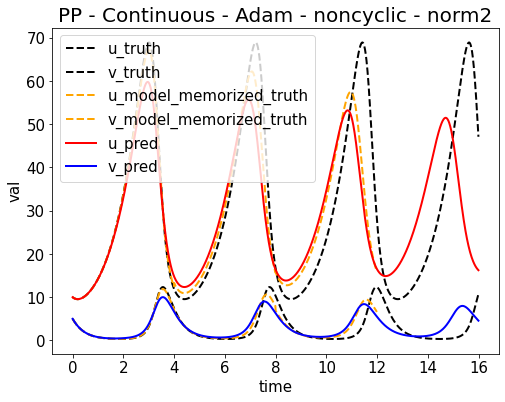

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653576831.png


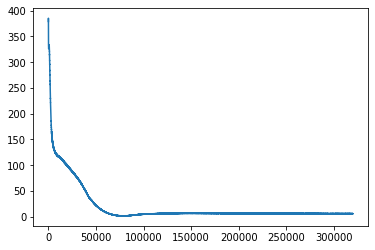

Epoch [322000/1000000] Loss:5.833120 Loss_1:0.000036 Loss_2:0.041817 Loss_3:0.000000 Loss_4:5.791266 Lr:0.001000 Time:26.290782s (66.33min in total, 139.66min remains)
Epoch [324000/1000000] Loss:5.801912 Loss_1:0.000004 Loss_2:0.003839 Loss_3:0.000000 Loss_4:5.798069 Lr:0.001000 Time:24.604447s (66.74min in total, 139.24min remains)
Epoch [326000/1000000] Loss:5.776674 Loss_1:0.000001 Loss_2:0.004074 Loss_3:0.000000 Loss_4:5.772599 Lr:0.001000 Time:24.869144s (67.15min in total, 138.83min remains)
Epoch [328000/1000000] Loss:5.770289 Loss_1:0.000014 Loss_2:0.003977 Loss_3:0.000000 Loss_4:5.766299 Lr:0.001000 Time:25.918269s (67.58min in total, 138.46min remains)
Epoch [330000/1000000] Loss:5.767102 Loss_1:0.000041 Loss_2:0.009189 Loss_3:0.000000 Loss_4:5.757872 Lr:0.001000 Time:24.761619s (68.00min in total, 138.05min remains)
Epoch [332000/1000000] Loss:5.744881 Loss_1:0.000021 Loss_2:0.006106 Loss_3:0.000000 Loss_4:5.738753 Lr:0.001000 Time:24.936903s (68.41min in total, 137.65min r

<Figure size 432x288 with 0 Axes>

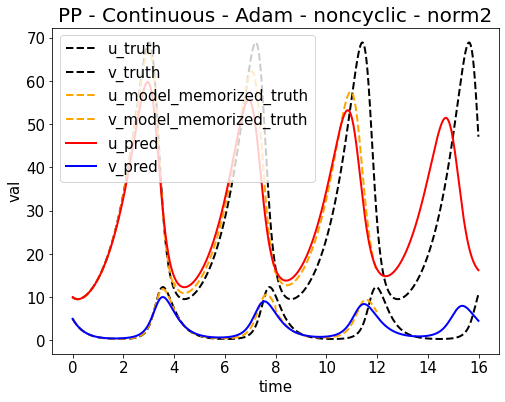

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653577080.png


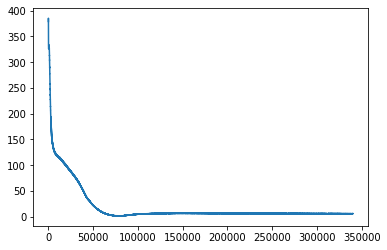

Epoch [342000/1000000] Loss:5.649717 Loss_1:0.000050 Loss_2:0.010862 Loss_3:0.000000 Loss_4:5.638805 Lr:0.001000 Time:26.040184s (70.48min in total, 135.60min remains)
Epoch [344000/1000000] Loss:5.653641 Loss_1:0.000045 Loss_2:0.005647 Loss_3:0.000000 Loss_4:5.647949 Lr:0.001000 Time:24.311834s (70.88min in total, 135.17min remains)
Epoch [346000/1000000] Loss:5.669224 Loss_1:0.000001 Loss_2:0.003807 Loss_3:0.000000 Loss_4:5.665416 Lr:0.001000 Time:24.506572s (71.29min in total, 134.75min remains)
Epoch [348000/1000000] Loss:5.658062 Loss_1:0.000371 Loss_2:0.015090 Loss_3:0.000000 Loss_4:5.642600 Lr:0.001000 Time:24.516130s (71.70min in total, 134.33min remains)
Epoch [350000/1000000] Loss:5.694550 Loss_1:0.000068 Loss_2:0.008035 Loss_3:0.000000 Loss_4:5.686447 Lr:0.001000 Time:24.561839s (72.11min in total, 133.92min remains)
Epoch [352000/1000000] Loss:5.612455 Loss_1:0.000001 Loss_2:0.005170 Loss_3:0.000000 Loss_4:5.607285 Lr:0.001000 Time:24.491459s (72.52min in total, 133.50min r

<Figure size 432x288 with 0 Axes>

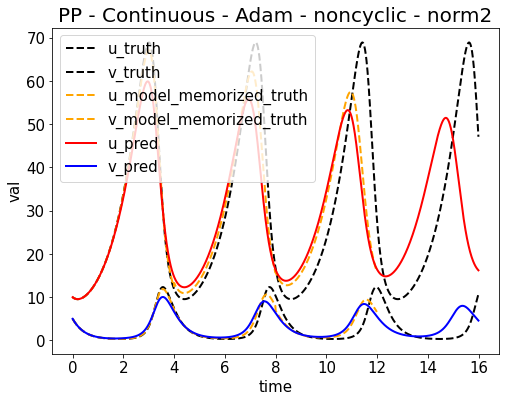

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653577327.png


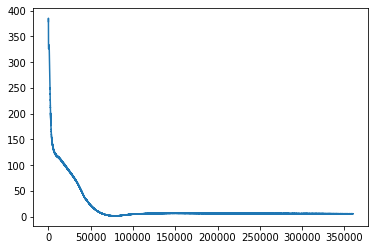

Epoch [362000/1000000] Loss:5.686402 Loss_1:0.000131 Loss_2:0.016343 Loss_3:0.000000 Loss_4:5.669929 Lr:0.001000 Time:26.434271s (74.60min in total, 131.47min remains)
Epoch [364000/1000000] Loss:5.541349 Loss_1:0.000003 Loss_2:0.004608 Loss_3:0.000000 Loss_4:5.536737 Lr:0.001000 Time:24.319712s (75.00min in total, 131.05min remains)
Epoch [366000/1000000] Loss:5.763351 Loss_1:0.000066 Loss_2:0.050865 Loss_3:0.000000 Loss_4:5.712420 Lr:0.001000 Time:24.418334s (75.41min in total, 130.63min remains)
Epoch [368000/1000000] Loss:5.541509 Loss_1:0.000014 Loss_2:0.003733 Loss_3:0.000000 Loss_4:5.537762 Lr:0.001000 Time:24.361451s (75.82min in total, 130.21min remains)
Epoch [370000/1000000] Loss:5.594625 Loss_1:0.000002 Loss_2:0.005061 Loss_3:0.000000 Loss_4:5.589562 Lr:0.001000 Time:24.330247s (76.22min in total, 129.78min remains)
Epoch [372000/1000000] Loss:5.541169 Loss_1:0.000010 Loss_2:0.004072 Loss_3:0.000000 Loss_4:5.537086 Lr:0.001000 Time:24.362115s (76.63min in total, 129.36min r

<Figure size 432x288 with 0 Axes>

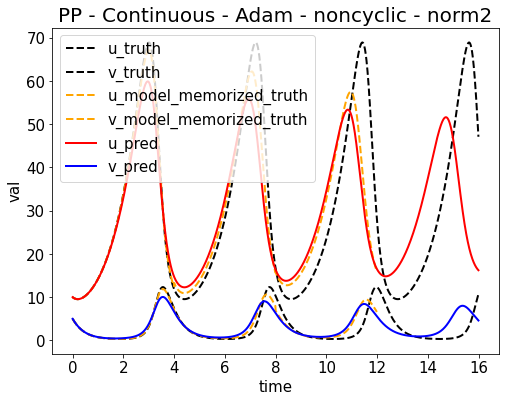

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653577573.png


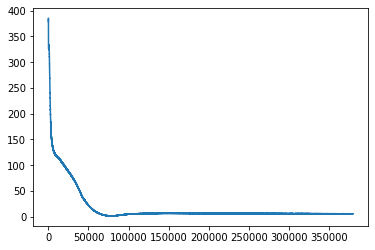

Epoch [382000/1000000] Loss:5.500916 Loss_1:0.000213 Loss_2:0.009898 Loss_3:0.000000 Loss_4:5.490806 Lr:0.001000 Time:25.983664s (78.68min in total, 127.29min remains)
Epoch [384000/1000000] Loss:5.474689 Loss_1:0.000006 Loss_2:0.010620 Loss_3:0.000000 Loss_4:5.464063 Lr:0.001000 Time:24.395021s (79.09min in total, 126.87min remains)
Epoch [386000/1000000] Loss:5.466950 Loss_1:0.000013 Loss_2:0.005507 Loss_3:0.000000 Loss_4:5.461430 Lr:0.001000 Time:24.712022s (79.50min in total, 126.46min remains)
Epoch [388000/1000000] Loss:5.459190 Loss_1:0.000002 Loss_2:0.003544 Loss_3:0.000000 Loss_4:5.455644 Lr:0.001000 Time:25.442546s (79.92min in total, 126.06min remains)
Epoch [390000/1000000] Loss:5.450751 Loss_1:0.000059 Loss_2:0.004725 Loss_3:0.000000 Loss_4:5.445967 Lr:0.001000 Time:24.708915s (80.33min in total, 125.65min remains)
Epoch [392000/1000000] Loss:5.452724 Loss_1:0.000002 Loss_2:0.004279 Loss_3:0.000000 Loss_4:5.448444 Lr:0.001000 Time:24.144352s (80.74min in total, 125.22min r

<Figure size 432x288 with 0 Axes>

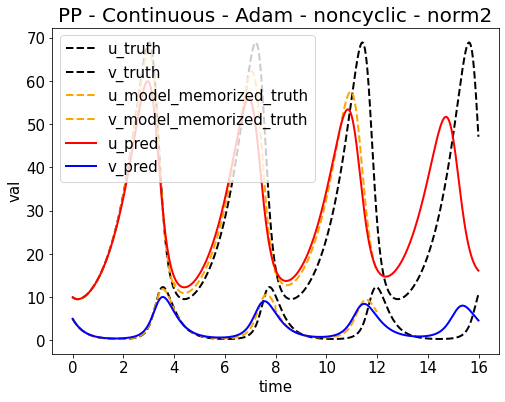

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653577819.png


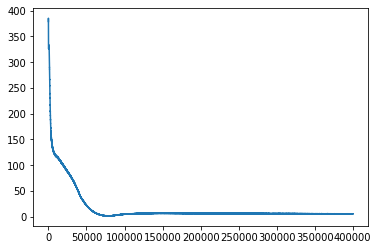

Epoch [402000/1000000] Loss:5.411784 Loss_1:0.000000 Loss_2:0.003648 Loss_3:0.000000 Loss_4:5.408136 Lr:0.001000 Time:26.355069s (82.80min in total, 123.17min remains)
Epoch [404000/1000000] Loss:5.370572 Loss_1:0.000056 Loss_2:0.007280 Loss_3:0.000000 Loss_4:5.363236 Lr:0.001000 Time:24.862291s (83.21min in total, 122.76min remains)
Epoch [406000/1000000] Loss:5.402541 Loss_1:0.000050 Loss_2:0.008808 Loss_3:0.000000 Loss_4:5.393682 Lr:0.001000 Time:24.658589s (83.62min in total, 122.35min remains)
Epoch [408000/1000000] Loss:5.382435 Loss_1:0.000008 Loss_2:0.007390 Loss_3:0.000000 Loss_4:5.375037 Lr:0.001000 Time:24.718300s (84.04min in total, 121.93min remains)
Epoch [410000/1000000] Loss:5.406844 Loss_1:0.000546 Loss_2:0.050659 Loss_3:0.000000 Loss_4:5.355639 Lr:0.001000 Time:24.728396s (84.45min in total, 121.52min remains)
Epoch [412000/1000000] Loss:5.353946 Loss_1:0.000088 Loss_2:0.060032 Loss_3:0.000000 Loss_4:5.293825 Lr:0.001000 Time:24.394567s (84.85min in total, 121.10min r

<Figure size 432x288 with 0 Axes>

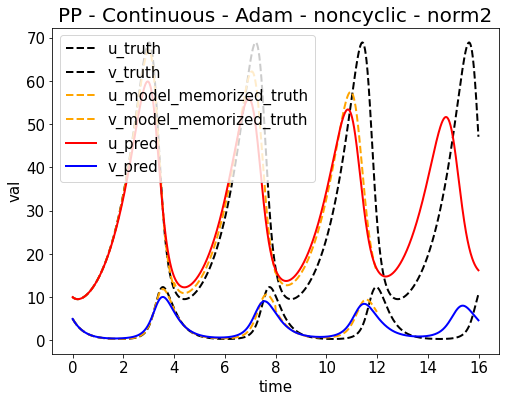

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653578067.png


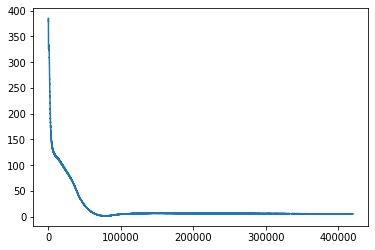

Epoch [422000/1000000] Loss:5.311261 Loss_1:0.000002 Loss_2:0.003799 Loss_3:0.000000 Loss_4:5.307459 Lr:0.001000 Time:26.570061s (86.93min in total, 119.07min remains)
Epoch [424000/1000000] Loss:5.276539 Loss_1:0.000829 Loss_2:0.006676 Loss_3:0.000000 Loss_4:5.269035 Lr:0.001000 Time:24.502652s (87.34min in total, 118.65min remains)
Epoch [426000/1000000] Loss:5.325680 Loss_1:0.000008 Loss_2:0.004600 Loss_3:0.000000 Loss_4:5.321072 Lr:0.001000 Time:24.598577s (87.75min in total, 118.24min remains)
Epoch [428000/1000000] Loss:5.284995 Loss_1:0.000005 Loss_2:0.006484 Loss_3:0.000000 Loss_4:5.278506 Lr:0.001000 Time:24.701573s (88.16min in total, 117.83min remains)
Epoch [430000/1000000] Loss:5.351018 Loss_1:0.000004 Loss_2:0.010527 Loss_3:0.000000 Loss_4:5.340487 Lr:0.001000 Time:24.787610s (88.58min in total, 117.42min remains)
Epoch [432000/1000000] Loss:5.287401 Loss_1:0.000000 Loss_2:0.003537 Loss_3:0.000000 Loss_4:5.283864 Lr:0.001000 Time:24.593611s (88.99min in total, 117.00min r

<Figure size 432x288 with 0 Axes>

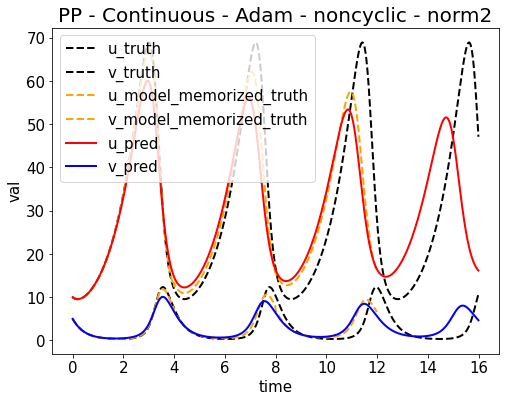

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653578315.png


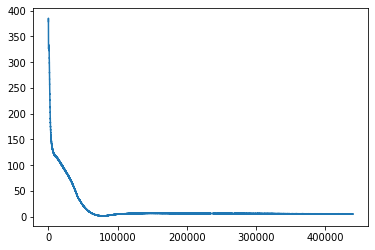

Epoch [442000/1000000] Loss:5.246262 Loss_1:0.000053 Loss_2:0.004109 Loss_3:0.000000 Loss_4:5.242099 Lr:0.001000 Time:26.155039s (91.06min in total, 114.96min remains)
Epoch [444000/1000000] Loss:5.198952 Loss_1:0.000015 Loss_2:0.003960 Loss_3:0.000000 Loss_4:5.194977 Lr:0.001000 Time:24.278256s (91.46min in total, 114.54min remains)
Epoch [446000/1000000] Loss:5.184968 Loss_1:0.000062 Loss_2:0.006681 Loss_3:0.000000 Loss_4:5.178225 Lr:0.001000 Time:24.444165s (91.87min in total, 114.12min remains)
Epoch [448000/1000000] Loss:5.283885 Loss_1:0.000033 Loss_2:0.022490 Loss_3:0.000000 Loss_4:5.261362 Lr:0.001000 Time:24.722688s (92.28min in total, 113.71min remains)
Epoch [450000/1000000] Loss:5.161707 Loss_1:0.000001 Loss_2:0.004318 Loss_3:0.000000 Loss_4:5.157388 Lr:0.001000 Time:24.595735s (92.69min in total, 113.29min remains)
Epoch [452000/1000000] Loss:5.250287 Loss_1:0.000135 Loss_2:0.020764 Loss_3:0.000000 Loss_4:5.229388 Lr:0.001000 Time:24.787843s (93.11min in total, 112.88min r

<Figure size 432x288 with 0 Axes>

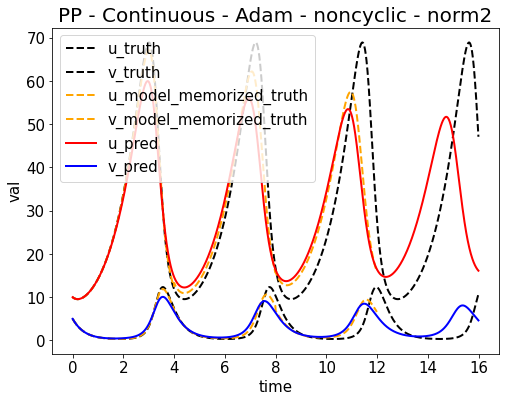

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653578563.png


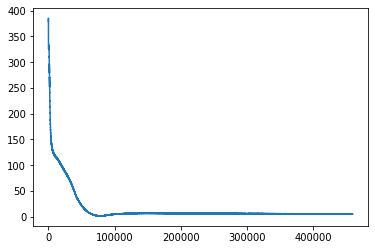

Epoch [462000/1000000] Loss:5.128235 Loss_1:0.000117 Loss_2:0.017978 Loss_3:0.000000 Loss_4:5.110141 Lr:0.001000 Time:26.576711s (95.19min in total, 110.85min remains)
Epoch [464000/1000000] Loss:5.138124 Loss_1:0.000014 Loss_2:0.004543 Loss_3:0.000000 Loss_4:5.133566 Lr:0.001000 Time:24.608671s (95.60min in total, 110.44min remains)
Epoch [466000/1000000] Loss:5.130004 Loss_1:0.000252 Loss_2:0.020864 Loss_3:0.000000 Loss_4:5.108888 Lr:0.001000 Time:24.679733s (96.01min in total, 110.02min remains)
Epoch [468000/1000000] Loss:5.124817 Loss_1:0.000012 Loss_2:0.003827 Loss_3:0.000000 Loss_4:5.120977 Lr:0.001000 Time:24.703215s (96.43min in total, 109.61min remains)
Epoch [470000/1000000] Loss:5.109795 Loss_1:0.000101 Loss_2:0.007044 Loss_3:0.000000 Loss_4:5.102649 Lr:0.001000 Time:24.655927s (96.84min in total, 109.20min remains)
Epoch [472000/1000000] Loss:5.092654 Loss_1:0.000015 Loss_2:0.004434 Loss_3:0.000000 Loss_4:5.088205 Lr:0.001000 Time:24.722769s (97.25min in total, 108.79min r

<Figure size 432x288 with 0 Axes>

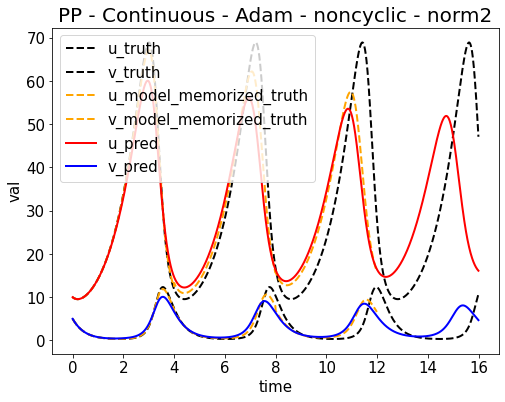

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653578810.png


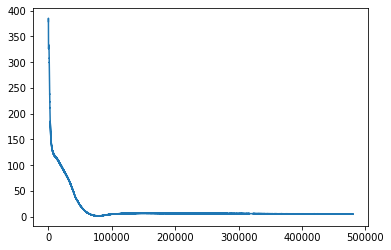

Epoch [482000/1000000] Loss:5.101914 Loss_1:0.000048 Loss_2:0.018506 Loss_3:0.000000 Loss_4:5.083360 Lr:0.001000 Time:26.150572s (99.31min in total, 106.73min remains)
Epoch [484000/1000000] Loss:5.064815 Loss_1:0.000010 Loss_2:0.003846 Loss_3:0.000000 Loss_4:5.060959 Lr:0.001000 Time:24.463580s (99.72min in total, 106.31min remains)
Epoch [486000/1000000] Loss:5.066062 Loss_1:0.000165 Loss_2:0.007687 Loss_3:0.000000 Loss_4:5.058210 Lr:0.001000 Time:24.285725s (100.12min in total, 105.89min remains)
Epoch [488000/1000000] Loss:5.062098 Loss_1:0.000099 Loss_2:0.007184 Loss_3:0.000000 Loss_4:5.054814 Lr:0.001000 Time:24.474075s (100.53min in total, 105.48min remains)
Epoch [490000/1000000] Loss:5.014405 Loss_1:0.000263 Loss_2:0.027775 Loss_3:0.000000 Loss_4:4.986366 Lr:0.001000 Time:24.582150s (100.94min in total, 105.06min remains)
Epoch [492000/1000000] Loss:5.100830 Loss_1:0.000032 Loss_2:0.006191 Loss_3:0.000000 Loss_4:5.094607 Lr:0.001000 Time:24.515291s (101.35min in total, 104.65m

<Figure size 432x288 with 0 Axes>

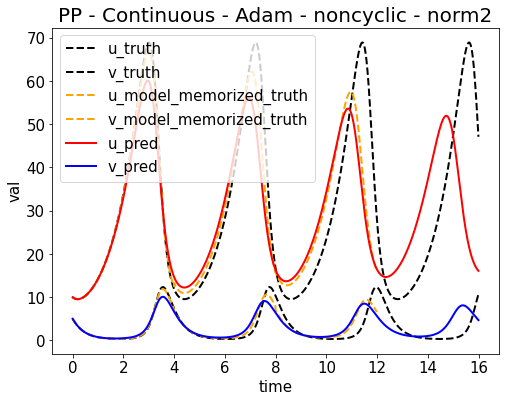

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653579057.png


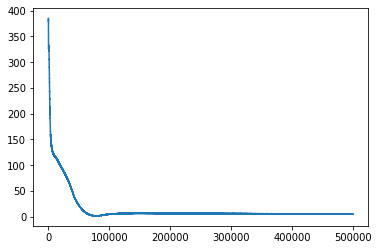

Epoch [502000/1000000] Loss:5.014044 Loss_1:0.000026 Loss_2:0.004481 Loss_3:0.000000 Loss_4:5.009537 Lr:0.001000 Time:26.640474s (103.42min in total, 102.60min remains)
Epoch [504000/1000000] Loss:5.011545 Loss_1:0.000047 Loss_2:0.009246 Loss_3:0.000000 Loss_4:5.002252 Lr:0.001000 Time:24.511400s (103.83min in total, 102.18min remains)
Epoch [506000/1000000] Loss:5.012431 Loss_1:0.000007 Loss_2:0.004708 Loss_3:0.000000 Loss_4:5.007716 Lr:0.001000 Time:24.643834s (104.24min in total, 101.77min remains)
Epoch [508000/1000000] Loss:5.026621 Loss_1:0.000010 Loss_2:0.006478 Loss_3:0.000000 Loss_4:5.020133 Lr:0.001000 Time:24.410975s (104.65min in total, 101.35min remains)
Epoch [510000/1000000] Loss:5.007096 Loss_1:0.000040 Loss_2:0.004750 Loss_3:0.000000 Loss_4:5.002307 Lr:0.001000 Time:24.460653s (105.06min in total, 100.94min remains)
Epoch [512000/1000000] Loss:4.993257 Loss_1:0.000109 Loss_2:0.004339 Loss_3:0.000000 Loss_4:4.988809 Lr:0.001000 Time:24.477326s (105.47min in total, 100.5

<Figure size 432x288 with 0 Axes>

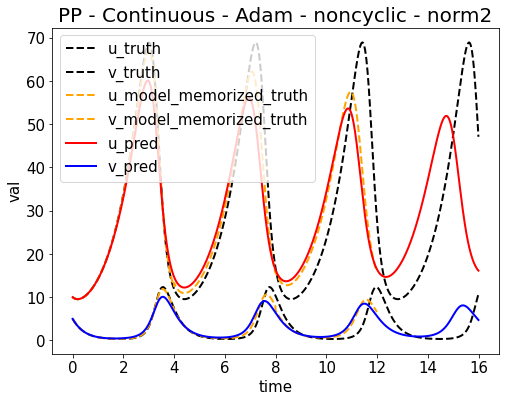

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653579304.png


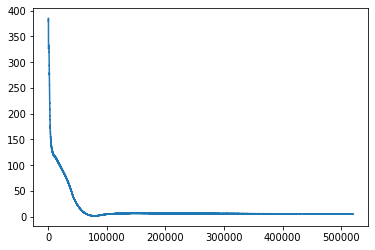

Epoch [522000/1000000] Loss:4.980627 Loss_1:0.000016 Loss_2:0.004377 Loss_3:0.000000 Loss_4:4.976234 Lr:0.001000 Time:25.872503s (107.53min in total, 98.47min remains)
Epoch [524000/1000000] Loss:4.997855 Loss_1:0.000016 Loss_2:0.011403 Loss_3:0.000000 Loss_4:4.986435 Lr:0.001000 Time:24.440095s (107.94min in total, 98.05min remains)
Epoch [526000/1000000] Loss:4.953821 Loss_1:0.000213 Loss_2:0.041256 Loss_3:0.000000 Loss_4:4.912352 Lr:0.001000 Time:24.489117s (108.35min in total, 97.64min remains)
Epoch [528000/1000000] Loss:4.942518 Loss_1:0.000071 Loss_2:0.010790 Loss_3:0.000000 Loss_4:4.931657 Lr:0.001000 Time:24.587302s (108.76min in total, 97.22min remains)
Epoch [530000/1000000] Loss:5.003824 Loss_1:0.000020 Loss_2:0.010539 Loss_3:0.000000 Loss_4:4.993265 Lr:0.001000 Time:24.511279s (109.17min in total, 96.81min remains)
Epoch [532000/1000000] Loss:5.030216 Loss_1:0.000229 Loss_2:0.017596 Loss_3:0.000000 Loss_4:5.012391 Lr:0.001000 Time:24.600150s (109.58min in total, 96.39min r

<Figure size 432x288 with 0 Axes>

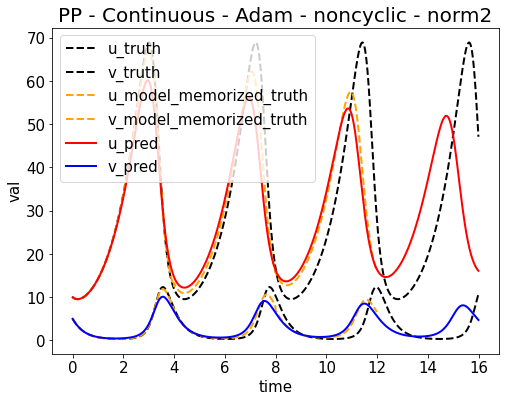

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653579550.png


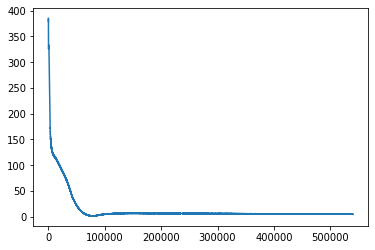

Epoch [542000/1000000] Loss:4.923891 Loss_1:0.000391 Loss_2:0.019527 Loss_3:0.000000 Loss_4:4.903972 Lr:0.001000 Time:26.587088s (111.65min in total, 94.35min remains)
Epoch [544000/1000000] Loss:4.924742 Loss_1:0.000107 Loss_2:0.010672 Loss_3:0.000000 Loss_4:4.913962 Lr:0.001000 Time:24.371774s (112.06min in total, 93.93min remains)
Epoch [546000/1000000] Loss:4.902385 Loss_1:0.000052 Loss_2:0.003878 Loss_3:0.000000 Loss_4:4.898456 Lr:0.001000 Time:24.606966s (112.47min in total, 93.52min remains)
Epoch [548000/1000000] Loss:4.914085 Loss_1:0.000039 Loss_2:0.006021 Loss_3:0.000000 Loss_4:4.908026 Lr:0.001000 Time:24.549072s (112.88min in total, 93.10min remains)
Epoch [550000/1000000] Loss:4.933144 Loss_1:0.000014 Loss_2:0.004031 Loss_3:0.000000 Loss_4:4.929099 Lr:0.001000 Time:24.590729s (113.29min in total, 92.69min remains)
Epoch [552000/1000000] Loss:5.058142 Loss_1:0.000077 Loss_2:0.037699 Loss_3:0.000000 Loss_4:5.020366 Lr:0.001000 Time:24.757522s (113.70min in total, 92.28min r

<Figure size 432x288 with 0 Axes>

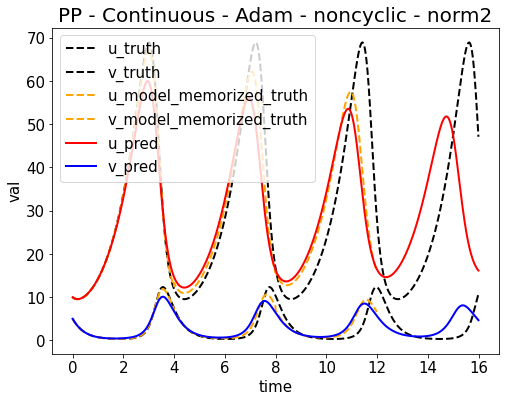

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653579800.png


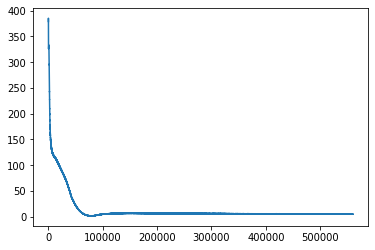

Epoch [562000/1000000] Loss:4.914892 Loss_1:0.000001 Loss_2:0.003365 Loss_3:0.000000 Loss_4:4.911525 Lr:0.001000 Time:26.881612s (115.83min in total, 90.27min remains)
Epoch [564000/1000000] Loss:4.891727 Loss_1:0.000012 Loss_2:0.003477 Loss_3:0.000000 Loss_4:4.888239 Lr:0.001000 Time:24.566675s (116.23min in total, 89.86min remains)
Epoch [566000/1000000] Loss:4.929897 Loss_1:0.000439 Loss_2:0.049802 Loss_3:0.000000 Loss_4:4.879655 Lr:0.001000 Time:24.453400s (116.64min in total, 89.44min remains)
Epoch [568000/1000000] Loss:4.917481 Loss_1:0.000206 Loss_2:0.013484 Loss_3:0.000000 Loss_4:4.903791 Lr:0.001000 Time:24.350635s (117.05min in total, 89.02min remains)
Epoch [570000/1000000] Loss:4.888066 Loss_1:0.000004 Loss_2:0.003333 Loss_3:0.000000 Loss_4:4.884729 Lr:0.001000 Time:24.447734s (117.46min in total, 88.61min remains)
Epoch [572000/1000000] Loss:5.032010 Loss_1:0.000023 Loss_2:0.028017 Loss_3:0.000000 Loss_4:5.003970 Lr:0.001000 Time:24.500771s (117.86min in total, 88.19min r

<Figure size 432x288 with 0 Axes>

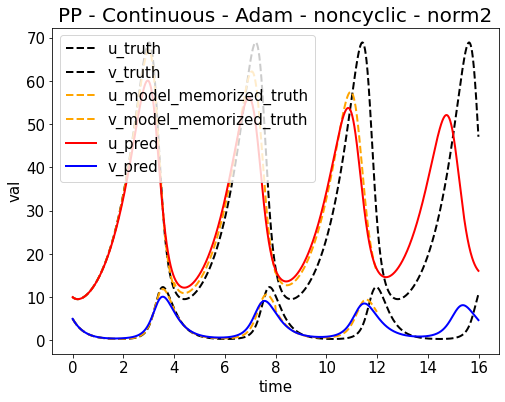

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653580048.png


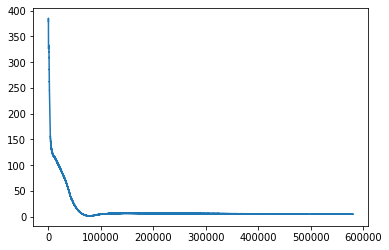

Epoch [582000/1000000] Loss:4.870727 Loss_1:0.000022 Loss_2:0.007539 Loss_3:0.000000 Loss_4:4.863165 Lr:0.001000 Time:26.366981s (119.94min in total, 86.14min remains)
Epoch [584000/1000000] Loss:4.852844 Loss_1:0.000036 Loss_2:0.010680 Loss_3:0.000000 Loss_4:4.842128 Lr:0.001000 Time:24.537178s (120.34min in total, 85.72min remains)
Epoch [586000/1000000] Loss:4.840582 Loss_1:0.000311 Loss_2:0.004804 Loss_3:0.000000 Loss_4:4.835466 Lr:0.001000 Time:24.586960s (120.75min in total, 85.31min remains)
Epoch [588000/1000000] Loss:4.844988 Loss_1:0.000000 Loss_2:0.003906 Loss_3:0.000000 Loss_4:4.841081 Lr:0.001000 Time:24.448780s (121.16min in total, 84.90min remains)
Epoch [590000/1000000] Loss:4.839559 Loss_1:0.000016 Loss_2:0.007824 Loss_3:0.000000 Loss_4:4.831719 Lr:0.001000 Time:24.631489s (121.57min in total, 84.48min remains)
Epoch [592000/1000000] Loss:4.846000 Loss_1:0.000001 Loss_2:0.003450 Loss_3:0.000000 Loss_4:4.842548 Lr:0.001000 Time:24.601653s (121.98min in total, 84.07min r

<Figure size 432x288 with 0 Axes>

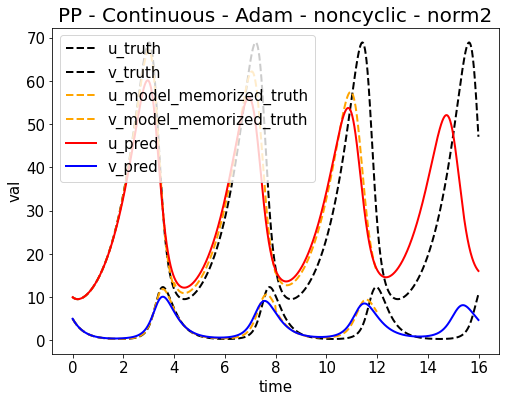

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653580294.png


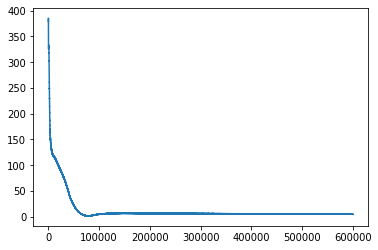

Epoch [602000/1000000] Loss:4.813068 Loss_1:0.000001 Loss_2:0.003377 Loss_3:0.000000 Loss_4:4.809689 Lr:0.001000 Time:26.685751s (124.06min in total, 82.02min remains)
Epoch [604000/1000000] Loss:4.827731 Loss_1:0.000017 Loss_2:0.003841 Loss_3:0.000000 Loss_4:4.823873 Lr:0.001000 Time:24.720285s (124.47min in total, 81.61min remains)
Epoch [606000/1000000] Loss:4.822496 Loss_1:0.000239 Loss_2:0.020693 Loss_3:0.000000 Loss_4:4.801564 Lr:0.001000 Time:24.538200s (124.88min in total, 81.19min remains)
Epoch [608000/1000000] Loss:4.811165 Loss_1:0.000007 Loss_2:0.003234 Loss_3:0.000000 Loss_4:4.807924 Lr:0.001000 Time:24.466071s (125.29min in total, 80.78min remains)
Epoch [610000/1000000] Loss:4.766916 Loss_1:0.000006 Loss_2:0.003816 Loss_3:0.000000 Loss_4:4.763094 Lr:0.001000 Time:24.460792s (125.69min in total, 80.36min remains)
Epoch [612000/1000000] Loss:4.787182 Loss_1:0.000061 Loss_2:0.003496 Loss_3:0.000000 Loss_4:4.783625 Lr:0.001000 Time:24.518622s (126.10min in total, 79.95min r

<Figure size 432x288 with 0 Axes>

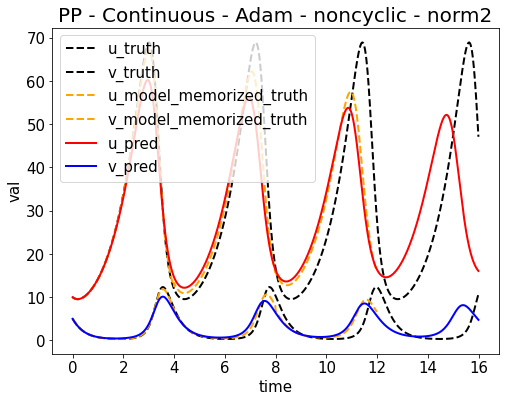

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653580542.png


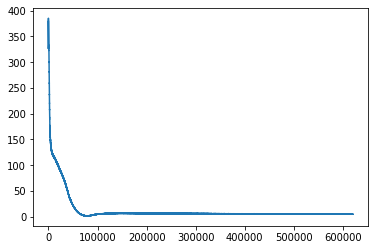

Epoch [622000/1000000] Loss:4.787461 Loss_1:0.000007 Loss_2:0.003536 Loss_3:0.000000 Loss_4:4.783918 Lr:0.001000 Time:26.792034s (128.18min in total, 77.89min remains)
Epoch [624000/1000000] Loss:4.839889 Loss_1:0.000028 Loss_2:0.054777 Loss_3:0.000000 Loss_4:4.785083 Lr:0.001000 Time:24.628215s (128.59min in total, 77.48min remains)
Epoch [626000/1000000] Loss:4.761502 Loss_1:0.000058 Loss_2:0.004605 Loss_3:0.000000 Loss_4:4.756838 Lr:0.001000 Time:24.683065s (129.00min in total, 77.07min remains)
Epoch [628000/1000000] Loss:4.757523 Loss_1:0.000006 Loss_2:0.004516 Loss_3:0.000000 Loss_4:4.753000 Lr:0.001000 Time:24.710267s (129.41min in total, 76.66min remains)
Epoch [630000/1000000] Loss:4.800536 Loss_1:0.000220 Loss_2:0.006333 Loss_3:0.000000 Loss_4:4.793982 Lr:0.001000 Time:24.708528s (129.82min in total, 76.24min remains)
Epoch [632000/1000000] Loss:4.764671 Loss_1:0.000004 Loss_2:0.003398 Loss_3:0.000000 Loss_4:4.761269 Lr:0.001000 Time:24.540340s (130.23min in total, 75.83min r

<Figure size 432x288 with 0 Axes>

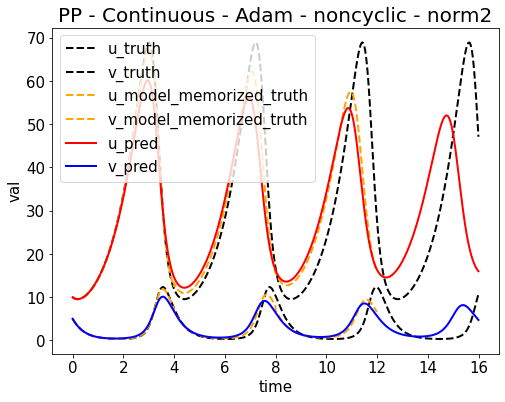

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653580789.png


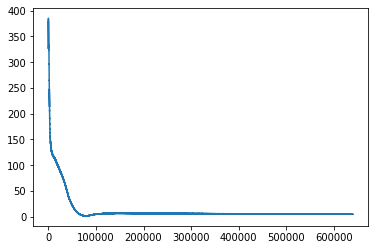

Epoch [642000/1000000] Loss:4.713657 Loss_1:0.000003 Loss_2:0.004400 Loss_3:0.000000 Loss_4:4.709255 Lr:0.001000 Time:26.436791s (132.30min in total, 73.77min remains)
Epoch [644000/1000000] Loss:4.725301 Loss_1:0.000058 Loss_2:0.004697 Loss_3:0.000000 Loss_4:4.720546 Lr:0.001000 Time:24.422080s (132.70min in total, 73.36min remains)
Epoch [646000/1000000] Loss:4.726287 Loss_1:0.000002 Loss_2:0.003874 Loss_3:0.000000 Loss_4:4.722411 Lr:0.001000 Time:24.614229s (133.11min in total, 72.94min remains)
Epoch [648000/1000000] Loss:4.707720 Loss_1:0.000140 Loss_2:0.036062 Loss_3:0.000000 Loss_4:4.671518 Lr:0.001000 Time:24.316405s (133.52min in total, 72.53min remains)
Epoch [650000/1000000] Loss:4.723318 Loss_1:0.000011 Loss_2:0.010984 Loss_3:0.000000 Loss_4:4.712322 Lr:0.001000 Time:24.510752s (133.93min in total, 72.11min remains)
Epoch [652000/1000000] Loss:4.715503 Loss_1:0.000184 Loss_2:0.008583 Loss_3:0.000000 Loss_4:4.706736 Lr:0.001000 Time:24.704469s (134.34min in total, 71.70min r

<Figure size 432x288 with 0 Axes>

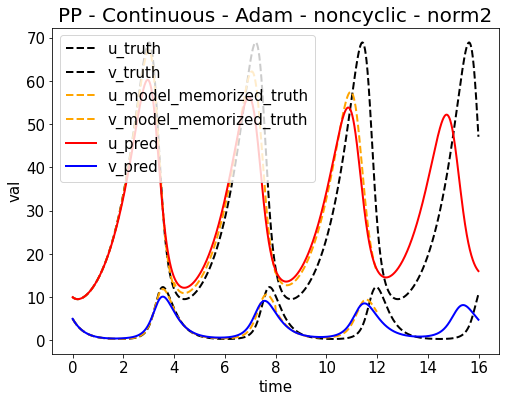

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653581036.png


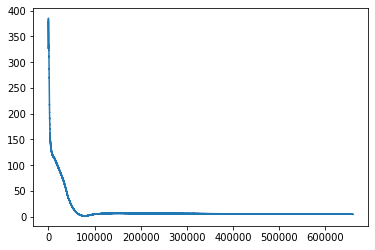

Epoch [662000/1000000] Loss:4.693882 Loss_1:0.000200 Loss_2:0.004227 Loss_3:0.000000 Loss_4:4.689455 Lr:0.001000 Time:26.816467s (136.42min in total, 69.65min remains)
Epoch [664000/1000000] Loss:4.724340 Loss_1:0.000019 Loss_2:0.005662 Loss_3:0.000000 Loss_4:4.718659 Lr:0.001000 Time:24.759857s (136.83min in total, 69.24min remains)
Epoch [666000/1000000] Loss:4.703405 Loss_1:0.000003 Loss_2:0.003801 Loss_3:0.000000 Loss_4:4.699601 Lr:0.001000 Time:24.807694s (137.24min in total, 68.83min remains)
Epoch [668000/1000000] Loss:4.707891 Loss_1:0.000004 Loss_2:0.028427 Loss_3:0.000000 Loss_4:4.679459 Lr:0.001000 Time:24.284265s (137.65min in total, 68.41min remains)
Epoch [670000/1000000] Loss:4.695120 Loss_1:0.000046 Loss_2:0.006936 Loss_3:0.000000 Loss_4:4.688138 Lr:0.001000 Time:24.602274s (138.06min in total, 68.00min remains)
Epoch [672000/1000000] Loss:4.675240 Loss_1:0.000001 Loss_2:0.003166 Loss_3:0.000000 Loss_4:4.672074 Lr:0.001000 Time:24.555995s (138.47min in total, 67.58min r

<Figure size 432x288 with 0 Axes>

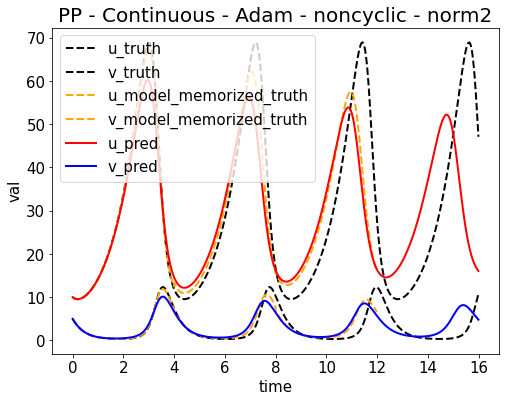

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653581284.png


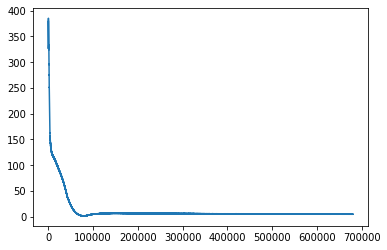

Epoch [682000/1000000] Loss:4.647977 Loss_1:0.000006 Loss_2:0.003423 Loss_3:0.000000 Loss_4:4.644548 Lr:0.001000 Time:26.607834s (140.54min in total, 65.53min remains)
Epoch [684000/1000000] Loss:4.630313 Loss_1:0.000497 Loss_2:0.037447 Loss_3:0.000000 Loss_4:4.592369 Lr:0.001000 Time:24.501743s (140.95min in total, 65.12min remains)
Epoch [686000/1000000] Loss:4.648465 Loss_1:0.000216 Loss_2:0.030998 Loss_3:0.000000 Loss_4:4.617250 Lr:0.001000 Time:24.525648s (141.36min in total, 64.70min remains)
Epoch [688000/1000000] Loss:4.681364 Loss_1:0.000022 Loss_2:0.010999 Loss_3:0.000000 Loss_4:4.670343 Lr:0.001000 Time:24.453052s (141.76min in total, 64.29min remains)
Epoch [690000/1000000] Loss:4.618206 Loss_1:0.000036 Loss_2:0.004451 Loss_3:0.000000 Loss_4:4.613718 Lr:0.001000 Time:24.634157s (142.18min in total, 63.88min remains)
Epoch [692000/1000000] Loss:4.697055 Loss_1:0.000144 Loss_2:0.020767 Loss_3:0.000000 Loss_4:4.676144 Lr:0.001000 Time:24.467219s (142.58min in total, 63.46min r

<Figure size 432x288 with 0 Axes>

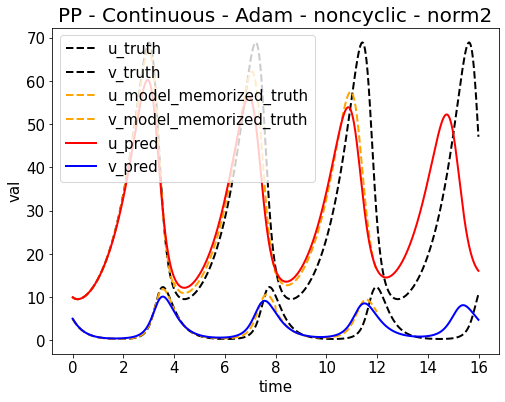

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653581531.png


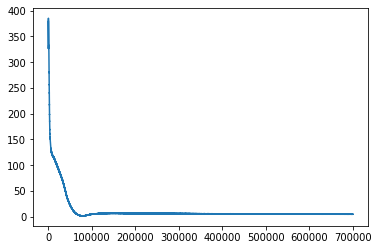

Epoch [702000/1000000] Loss:4.573072 Loss_1:0.000050 Loss_2:0.008511 Loss_3:0.000000 Loss_4:4.564511 Lr:0.001000 Time:26.703204s (144.66min in total, 61.41min remains)
Epoch [704000/1000000] Loss:4.593941 Loss_1:0.000447 Loss_2:0.005839 Loss_3:0.000000 Loss_4:4.587655 Lr:0.001000 Time:24.711838s (145.08min in total, 61.00min remains)
Epoch [706000/1000000] Loss:4.573830 Loss_1:0.000004 Loss_2:0.003415 Loss_3:0.000000 Loss_4:4.570411 Lr:0.001000 Time:24.708952s (145.49min in total, 60.59min remains)
Epoch [708000/1000000] Loss:4.571778 Loss_1:0.000002 Loss_2:0.003347 Loss_3:0.000000 Loss_4:4.568429 Lr:0.001000 Time:24.504152s (145.90min in total, 60.17min remains)
Epoch [710000/1000000] Loss:4.698664 Loss_1:0.000065 Loss_2:0.034665 Loss_3:0.000000 Loss_4:4.663933 Lr:0.001000 Time:24.504291s (146.30min in total, 59.76min remains)
Epoch [712000/1000000] Loss:4.552654 Loss_1:0.000008 Loss_2:0.004438 Loss_3:0.000000 Loss_4:4.548209 Lr:0.001000 Time:24.523685s (146.71min in total, 59.34min r

<Figure size 432x288 with 0 Axes>

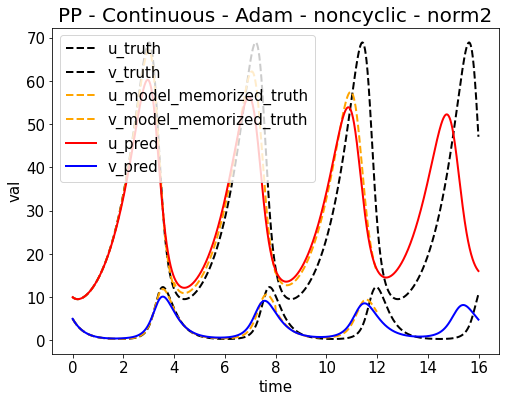

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653581779.png


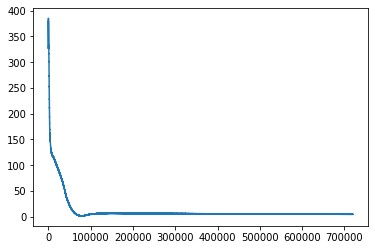

Epoch [722000/1000000] Loss:4.535776 Loss_1:0.000001 Loss_2:0.004326 Loss_3:0.000000 Loss_4:4.531449 Lr:0.001000 Time:26.585006s (148.79min in total, 57.29min remains)
Epoch [724000/1000000] Loss:4.521617 Loss_1:0.000003 Loss_2:0.003143 Loss_3:0.000000 Loss_4:4.518471 Lr:0.001000 Time:24.440436s (149.20min in total, 56.88min remains)
Epoch [726000/1000000] Loss:4.596385 Loss_1:0.000214 Loss_2:0.010293 Loss_3:0.000000 Loss_4:4.585877 Lr:0.001000 Time:24.389245s (149.60min in total, 56.46min remains)
Epoch [728000/1000000] Loss:4.581733 Loss_1:0.000378 Loss_2:0.100610 Loss_3:0.000000 Loss_4:4.480745 Lr:0.001000 Time:24.406527s (150.01min in total, 56.05min remains)
Epoch [730000/1000000] Loss:4.481749 Loss_1:0.000526 Loss_2:0.008662 Loss_3:0.000000 Loss_4:4.472561 Lr:0.001000 Time:24.378701s (150.42min in total, 55.63min remains)
Epoch [732000/1000000] Loss:4.534189 Loss_1:0.000015 Loss_2:0.015746 Loss_3:0.000000 Loss_4:4.518428 Lr:0.001000 Time:24.406546s (150.82min in total, 55.22min r

<Figure size 432x288 with 0 Axes>

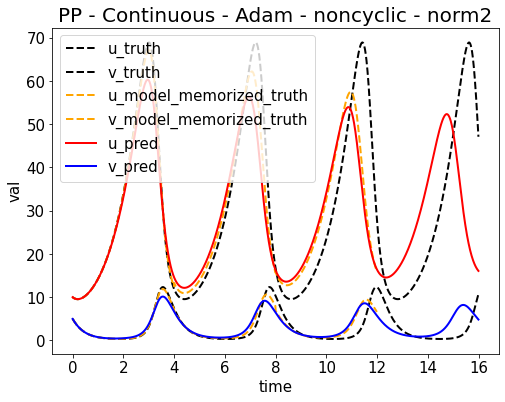

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653582025.png


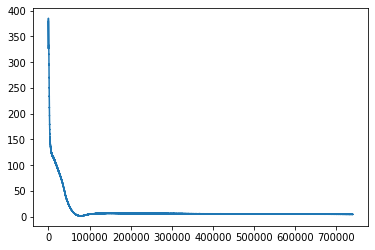

Epoch [742000/1000000] Loss:4.463840 Loss_1:0.000534 Loss_2:0.012422 Loss_3:0.000000 Loss_4:4.450884 Lr:0.001000 Time:26.859670s (152.90min in total, 53.16min remains)
Epoch [744000/1000000] Loss:4.486917 Loss_1:0.000067 Loss_2:0.010174 Loss_3:0.000000 Loss_4:4.476676 Lr:0.001000 Time:24.661646s (153.31min in total, 52.75min remains)
Epoch [746000/1000000] Loss:4.497643 Loss_1:0.000020 Loss_2:0.004726 Loss_3:0.000000 Loss_4:4.492898 Lr:0.001000 Time:24.554034s (153.72min in total, 52.34min remains)
Epoch [748000/1000000] Loss:4.461471 Loss_1:0.000003 Loss_2:0.004130 Loss_3:0.000000 Loss_4:4.457338 Lr:0.001000 Time:24.502784s (154.13min in total, 51.93min remains)
Epoch [750000/1000000] Loss:4.459074 Loss_1:0.000004 Loss_2:0.003351 Loss_3:0.000000 Loss_4:4.455719 Lr:0.001000 Time:24.511609s (154.54min in total, 51.51min remains)
Epoch [752000/1000000] Loss:4.437841 Loss_1:0.000082 Loss_2:0.006408 Loss_3:0.000000 Loss_4:4.431352 Lr:0.001000 Time:24.644356s (154.95min in total, 51.10min r

<Figure size 432x288 with 0 Axes>

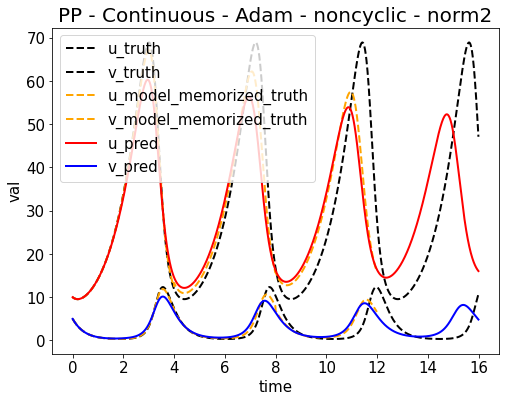

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653582273.png


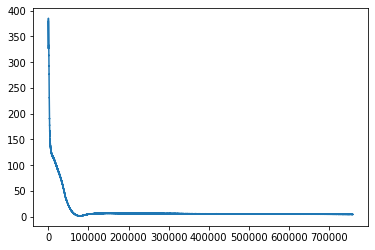

Epoch [762000/1000000] Loss:4.454861 Loss_1:0.000001 Loss_2:0.003501 Loss_3:0.000000 Loss_4:4.451359 Lr:0.001000 Time:26.851133s (157.03min in total, 49.05min remains)
Epoch [764000/1000000] Loss:4.433083 Loss_1:0.000001 Loss_2:0.003119 Loss_3:0.000000 Loss_4:4.429963 Lr:0.001000 Time:24.631037s (157.44min in total, 48.63min remains)
Epoch [766000/1000000] Loss:4.419894 Loss_1:0.000004 Loss_2:0.003726 Loss_3:0.000000 Loss_4:4.416163 Lr:0.001000 Time:24.523257s (157.85min in total, 48.22min remains)
Epoch [768000/1000000] Loss:4.470581 Loss_1:0.000008 Loss_2:0.013386 Loss_3:0.000000 Loss_4:4.457187 Lr:0.001000 Time:24.463355s (158.26min in total, 47.81min remains)
Epoch [770000/1000000] Loss:4.497616 Loss_1:0.000162 Loss_2:0.024335 Loss_3:0.000000 Loss_4:4.473119 Lr:0.001000 Time:24.660496s (158.67min in total, 47.39min remains)
Epoch [772000/1000000] Loss:4.393076 Loss_1:0.000055 Loss_2:0.014898 Loss_3:0.000000 Loss_4:4.378123 Lr:0.001000 Time:24.554446s (159.08min in total, 46.98min r

<Figure size 432x288 with 0 Axes>

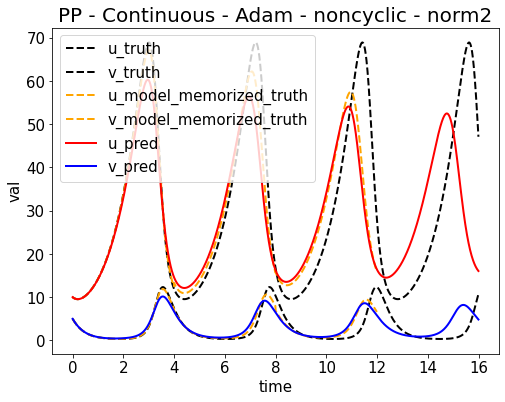

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653582521.png


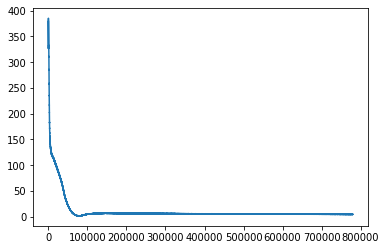

Epoch [782000/1000000] Loss:4.425220 Loss_1:0.000218 Loss_2:0.007092 Loss_3:0.000000 Loss_4:4.417910 Lr:0.001000 Time:26.645173s (161.17min in total, 44.93min remains)
Epoch [784000/1000000] Loss:4.369184 Loss_1:0.000007 Loss_2:0.007010 Loss_3:0.000000 Loss_4:4.362166 Lr:0.001000 Time:24.475744s (161.57min in total, 44.52min remains)
Epoch [786000/1000000] Loss:4.417167 Loss_1:0.000071 Loss_2:0.006691 Loss_3:0.000000 Loss_4:4.410405 Lr:0.001000 Time:24.423131s (161.98min in total, 44.10min remains)
Epoch [788000/1000000] Loss:4.360516 Loss_1:0.000001 Loss_2:0.003283 Loss_3:0.000000 Loss_4:4.357232 Lr:0.001000 Time:24.551395s (162.39min in total, 43.69min remains)
Epoch [790000/1000000] Loss:4.413785 Loss_1:0.000035 Loss_2:0.027828 Loss_3:0.000000 Loss_4:4.385921 Lr:0.001000 Time:24.701161s (162.80min in total, 43.28min remains)
Epoch [792000/1000000] Loss:4.437387 Loss_1:0.000017 Loss_2:0.018561 Loss_3:0.000000 Loss_4:4.418809 Lr:0.001000 Time:24.742309s (163.21min in total, 42.86min r

<Figure size 432x288 with 0 Axes>

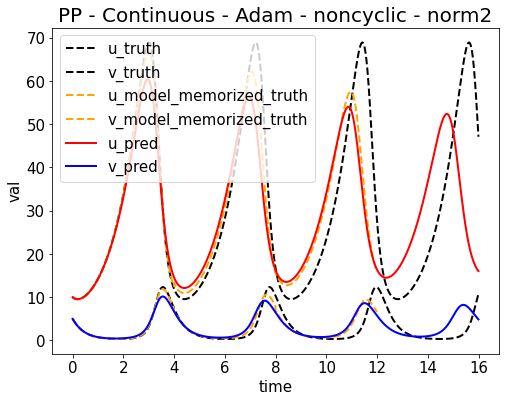

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653582770.png


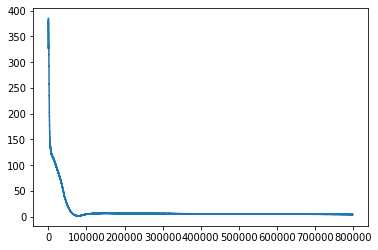

Epoch [802000/1000000] Loss:4.364128 Loss_1:0.000008 Loss_2:0.003661 Loss_3:0.000000 Loss_4:4.360460 Lr:0.001000 Time:27.415569s (165.33min in total, 40.82min remains)
Epoch [804000/1000000] Loss:4.357716 Loss_1:0.000002 Loss_2:0.003011 Loss_3:0.000000 Loss_4:4.354703 Lr:0.001000 Time:24.993188s (165.75min in total, 40.41min remains)
Epoch [806000/1000000] Loss:4.340366 Loss_1:0.000001 Loss_2:0.003016 Loss_3:0.000000 Loss_4:4.337349 Lr:0.001000 Time:24.883206s (166.16min in total, 39.99min remains)
Epoch [808000/1000000] Loss:4.311794 Loss_1:0.000079 Loss_2:0.005300 Loss_3:0.000000 Loss_4:4.306415 Lr:0.001000 Time:24.488133s (166.57min in total, 39.58min remains)
Epoch [810000/1000000] Loss:4.325631 Loss_1:0.000004 Loss_2:0.003154 Loss_3:0.000000 Loss_4:4.322472 Lr:0.001000 Time:24.883589s (166.98min in total, 39.17min remains)
Epoch [812000/1000000] Loss:4.376259 Loss_1:0.000068 Loss_2:0.007524 Loss_3:0.000000 Loss_4:4.368667 Lr:0.001000 Time:24.722439s (167.40min in total, 38.76min r

<Figure size 432x288 with 0 Axes>

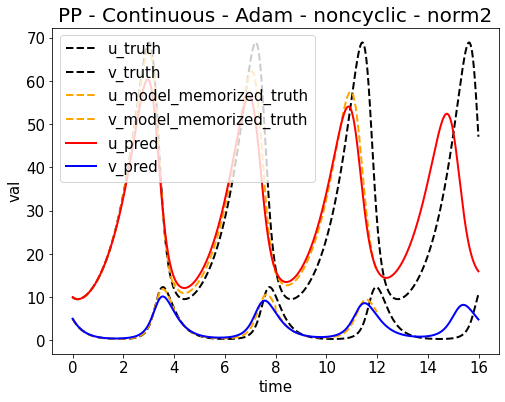

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653583020.png


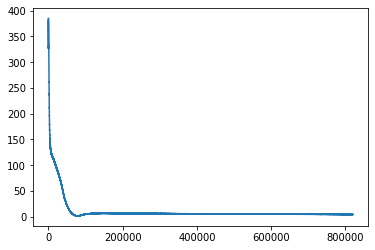

Epoch [822000/1000000] Loss:4.291470 Loss_1:0.000005 Loss_2:0.004190 Loss_3:0.000000 Loss_4:4.287275 Lr:0.001000 Time:28.559898s (169.52min in total, 36.71min remains)
Epoch [824000/1000000] Loss:4.299530 Loss_1:0.000092 Loss_2:0.007341 Loss_3:0.000000 Loss_4:4.292097 Lr:0.001000 Time:25.516304s (169.95min in total, 36.30min remains)
Epoch [826000/1000000] Loss:4.296207 Loss_1:0.000002 Loss_2:0.003217 Loss_3:0.000000 Loss_4:4.292987 Lr:0.001000 Time:25.059768s (170.36min in total, 35.89min remains)
Epoch [828000/1000000] Loss:4.294164 Loss_1:0.000028 Loss_2:0.005305 Loss_3:0.000000 Loss_4:4.288831 Lr:0.001000 Time:25.709038s (170.79min in total, 35.48min remains)
Epoch [830000/1000000] Loss:4.281878 Loss_1:0.000026 Loss_2:0.005946 Loss_3:0.000000 Loss_4:4.275905 Lr:0.001000 Time:24.442115s (171.20min in total, 35.06min remains)
Epoch [832000/1000000] Loss:4.320472 Loss_1:0.000001 Loss_2:0.003717 Loss_3:0.000000 Loss_4:4.316755 Lr:0.001000 Time:24.104141s (171.60min in total, 34.65min r

<Figure size 432x288 with 0 Axes>

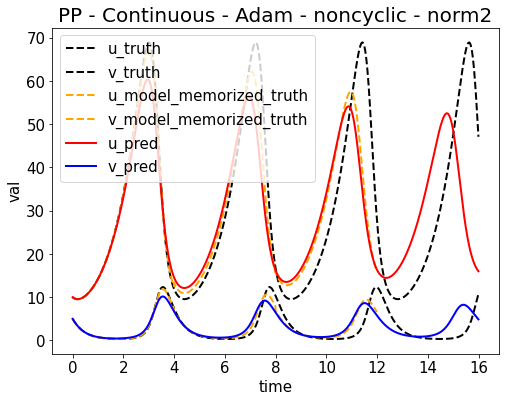

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653583272.png


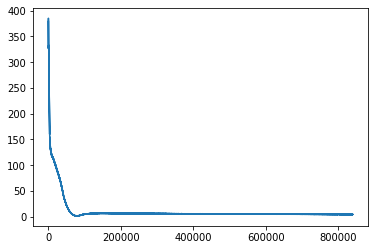

Epoch [842000/1000000] Loss:4.276150 Loss_1:0.000009 Loss_2:0.003258 Loss_3:0.000000 Loss_4:4.272882 Lr:0.001000 Time:26.697662s (173.68min in total, 32.59min remains)
Epoch [844000/1000000] Loss:4.331845 Loss_1:0.000155 Loss_2:0.020308 Loss_3:0.000000 Loss_4:4.311382 Lr:0.001000 Time:24.453623s (174.09min in total, 32.18min remains)
Epoch [846000/1000000] Loss:4.266658 Loss_1:0.000001 Loss_2:0.003146 Loss_3:0.000000 Loss_4:4.263512 Lr:0.001000 Time:24.504897s (174.49min in total, 31.76min remains)
Epoch [848000/1000000] Loss:4.299527 Loss_1:0.000001 Loss_2:0.004180 Loss_3:0.000000 Loss_4:4.295346 Lr:0.001000 Time:24.433421s (174.90min in total, 31.35min remains)
Epoch [850000/1000000] Loss:4.300745 Loss_1:0.000005 Loss_2:0.018826 Loss_3:0.000000 Loss_4:4.281914 Lr:0.001000 Time:24.528651s (175.31min in total, 30.94min remains)
Epoch [852000/1000000] Loss:4.278018 Loss_1:0.000003 Loss_2:0.003779 Loss_3:0.000000 Loss_4:4.274236 Lr:0.001000 Time:25.004757s (175.73min in total, 30.53min r

<Figure size 432x288 with 0 Axes>

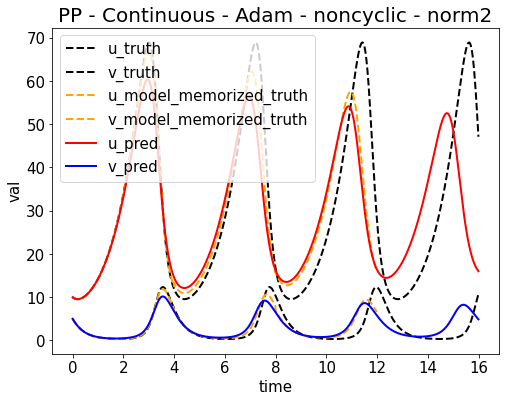

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653583521.png


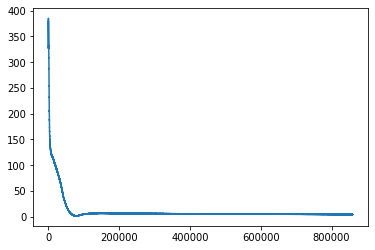

Epoch [862000/1000000] Loss:4.221742 Loss_1:0.000089 Loss_2:0.003547 Loss_3:0.000000 Loss_4:4.218106 Lr:0.001000 Time:27.450890s (177.85min in total, 28.47min remains)
Epoch [864000/1000000] Loss:4.235631 Loss_1:0.000002 Loss_2:0.003561 Loss_3:0.000000 Loss_4:4.232068 Lr:0.001000 Time:25.065546s (178.27min in total, 28.06min remains)
Epoch [866000/1000000] Loss:4.236137 Loss_1:0.000003 Loss_2:0.003306 Loss_3:0.000000 Loss_4:4.232828 Lr:0.001000 Time:25.037050s (178.69min in total, 27.65min remains)
Epoch [868000/1000000] Loss:4.238110 Loss_1:0.000002 Loss_2:0.003251 Loss_3:0.000000 Loss_4:4.234858 Lr:0.001000 Time:25.052163s (179.10min in total, 27.24min remains)
Epoch [870000/1000000] Loss:4.233903 Loss_1:0.000001 Loss_2:0.003510 Loss_3:0.000000 Loss_4:4.230392 Lr:0.001000 Time:25.110891s (179.52min in total, 26.83min remains)
Epoch [872000/1000000] Loss:4.274220 Loss_1:0.000025 Loss_2:0.004519 Loss_3:0.000000 Loss_4:4.269675 Lr:0.001000 Time:24.988500s (179.94min in total, 26.41min r

<Figure size 432x288 with 0 Axes>

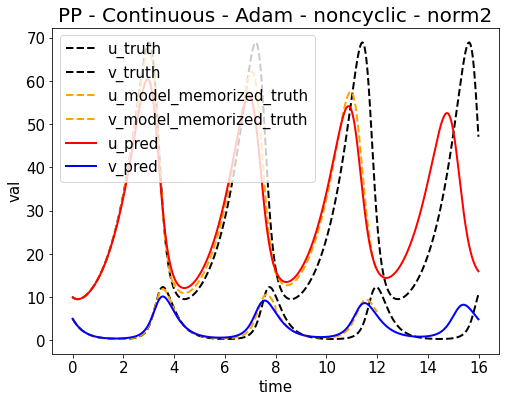

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653583776.png


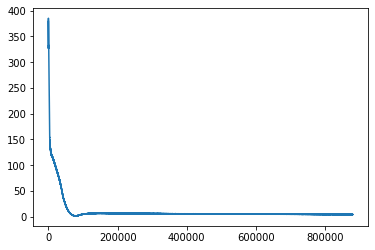

Epoch [882000/1000000] Loss:4.188795 Loss_1:0.000073 Loss_2:0.006525 Loss_3:0.000000 Loss_4:4.182198 Lr:0.001000 Time:28.014558s (182.11min in total, 24.36min remains)
Epoch [884000/1000000] Loss:4.298294 Loss_1:0.000146 Loss_2:0.020154 Loss_3:0.000000 Loss_4:4.277993 Lr:0.001000 Time:24.974420s (182.53min in total, 23.95min remains)
Epoch [886000/1000000] Loss:4.197856 Loss_1:0.000006 Loss_2:0.002990 Loss_3:0.000000 Loss_4:4.194861 Lr:0.001000 Time:24.596115s (182.94min in total, 23.54min remains)
Epoch [888000/1000000] Loss:4.243999 Loss_1:0.000037 Loss_2:0.007962 Loss_3:0.000000 Loss_4:4.235999 Lr:0.001000 Time:24.264514s (183.34min in total, 23.12min remains)
Epoch [890000/1000000] Loss:4.196869 Loss_1:0.000010 Loss_2:0.003795 Loss_3:0.000000 Loss_4:4.193064 Lr:0.001000 Time:24.297555s (183.75min in total, 22.71min remains)
Epoch [892000/1000000] Loss:4.198625 Loss_1:0.000030 Loss_2:0.027136 Loss_3:0.000000 Loss_4:4.171458 Lr:0.001000 Time:24.588180s (184.16min in total, 22.30min r

<Figure size 432x288 with 0 Axes>

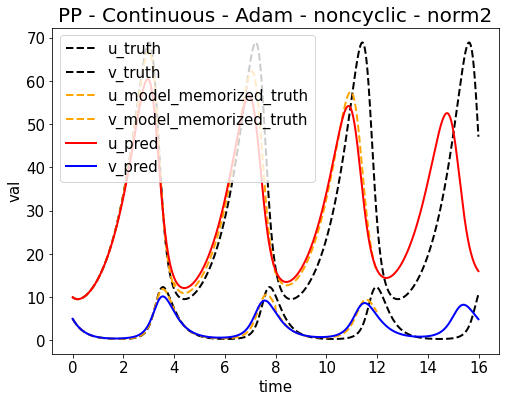

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653584025.png


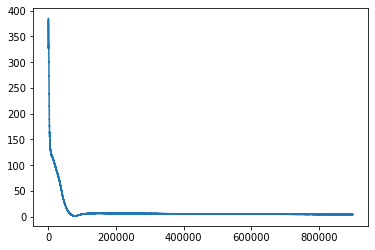

Epoch [902000/1000000] Loss:4.173606 Loss_1:0.000002 Loss_2:0.003455 Loss_3:0.000000 Loss_4:4.170149 Lr:0.001000 Time:26.548591s (186.23min in total, 20.23min remains)
Epoch [904000/1000000] Loss:4.171112 Loss_1:0.000021 Loss_2:0.004677 Loss_3:0.000000 Loss_4:4.166414 Lr:0.001000 Time:24.499431s (186.64min in total, 19.82min remains)
Epoch [906000/1000000] Loss:4.177614 Loss_1:0.000000 Loss_2:0.002998 Loss_3:0.000000 Loss_4:4.174616 Lr:0.001000 Time:24.411431s (187.05min in total, 19.41min remains)
Epoch [908000/1000000] Loss:4.183052 Loss_1:0.000000 Loss_2:0.002942 Loss_3:0.000000 Loss_4:4.180109 Lr:0.001000 Time:24.323515s (187.46min in total, 18.99min remains)
Epoch [910000/1000000] Loss:4.263608 Loss_1:0.000012 Loss_2:0.028486 Loss_3:0.000000 Loss_4:4.235110 Lr:0.001000 Time:24.537629s (187.86min in total, 18.58min remains)
Epoch [912000/1000000] Loss:4.163694 Loss_1:0.000003 Loss_2:0.005047 Loss_3:0.000000 Loss_4:4.158644 Lr:0.001000 Time:24.236522s (188.27min in total, 18.17min r

<Figure size 432x288 with 0 Axes>

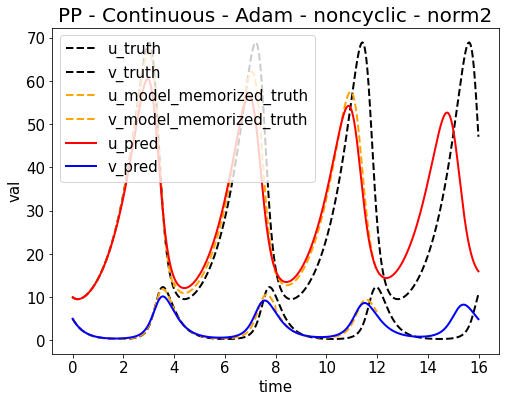

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653584272.png


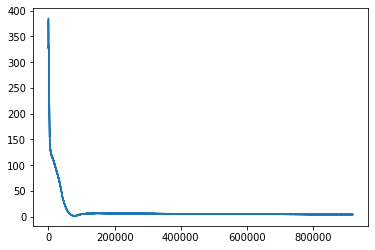

Epoch [922000/1000000] Loss:4.153663 Loss_1:0.000007 Loss_2:0.003340 Loss_3:0.000000 Loss_4:4.150316 Lr:0.001000 Time:26.845925s (190.34min in total, 16.10min remains)
Epoch [924000/1000000] Loss:4.143860 Loss_1:0.000003 Loss_2:0.003060 Loss_3:0.000000 Loss_4:4.140797 Lr:0.001000 Time:24.325369s (190.75min in total, 15.69min remains)
Epoch [926000/1000000] Loss:4.150536 Loss_1:0.000046 Loss_2:0.003838 Loss_3:0.000000 Loss_4:4.146652 Lr:0.001000 Time:24.412142s (191.16min in total, 15.28min remains)
Epoch [928000/1000000] Loss:4.142675 Loss_1:0.000066 Loss_2:0.004748 Loss_3:0.000000 Loss_4:4.137861 Lr:0.001000 Time:24.484372s (191.56min in total, 14.86min remains)
Epoch [930000/1000000] Loss:4.138353 Loss_1:0.000000 Loss_2:0.003792 Loss_3:0.000000 Loss_4:4.134562 Lr:0.001000 Time:24.457227s (191.97min in total, 14.45min remains)
Epoch [932000/1000000] Loss:4.124087 Loss_1:0.000000 Loss_2:0.003850 Loss_3:0.000000 Loss_4:4.120236 Lr:0.001000 Time:24.437070s (192.38min in total, 14.04min r

<Figure size 432x288 with 0 Axes>

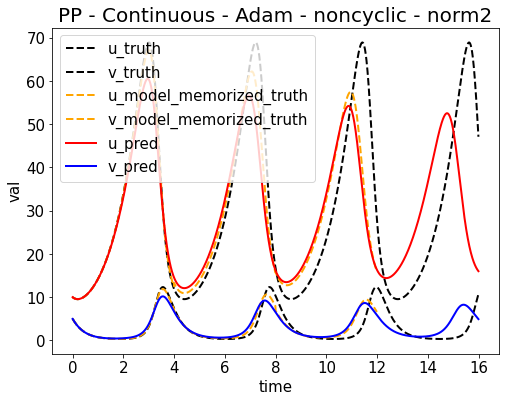

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653584519.png


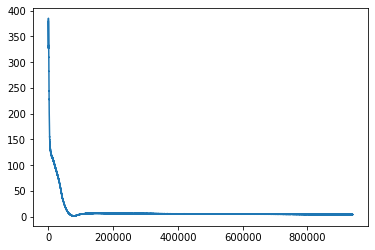

Epoch [942000/1000000] Loss:4.103241 Loss_1:0.000093 Loss_2:0.005945 Loss_3:0.000000 Loss_4:4.097204 Lr:0.001000 Time:27.439440s (194.48min in total, 11.97min remains)
Epoch [944000/1000000] Loss:4.091643 Loss_1:0.000002 Loss_2:0.003815 Loss_3:0.000000 Loss_4:4.087826 Lr:0.001000 Time:24.827823s (194.89min in total, 11.56min remains)
Epoch [946000/1000000] Loss:4.057161 Loss_1:0.000077 Loss_2:0.006616 Loss_3:0.000000 Loss_4:4.050467 Lr:0.001000 Time:24.527723s (195.30min in total, 11.15min remains)
Epoch [948000/1000000] Loss:4.114649 Loss_1:0.000055 Loss_2:0.010960 Loss_3:0.000000 Loss_4:4.103634 Lr:0.001000 Time:24.433858s (195.71min in total, 10.74min remains)
Epoch [950000/1000000] Loss:4.115137 Loss_1:0.000002 Loss_2:0.009259 Loss_3:0.000000 Loss_4:4.105876 Lr:0.001000 Time:24.384146s (196.11min in total, 10.32min remains)
Epoch [952000/1000000] Loss:4.097247 Loss_1:0.000049 Loss_2:0.004680 Loss_3:0.000000 Loss_4:4.092518 Lr:0.001000 Time:24.435327s (196.52min in total, 9.91min re

<Figure size 432x288 with 0 Axes>

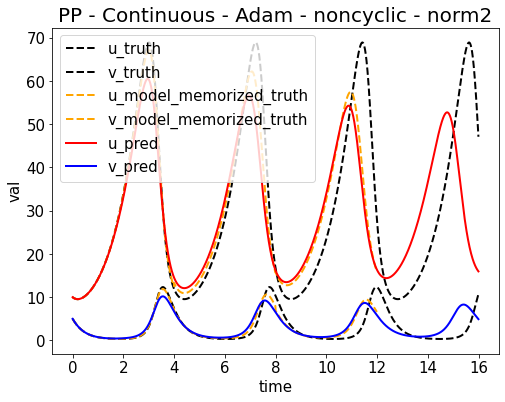

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653584767.png


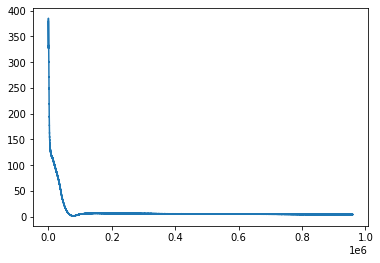

Epoch [962000/1000000] Loss:4.073494 Loss_1:0.000015 Loss_2:0.013361 Loss_3:0.000000 Loss_4:4.060118 Lr:0.001000 Time:27.068558s (198.60min in total, 7.85min remains)
Epoch [964000/1000000] Loss:4.083474 Loss_1:0.000008 Loss_2:0.008472 Loss_3:0.000000 Loss_4:4.074995 Lr:0.001000 Time:24.431230s (199.01min in total, 7.43min remains)
Epoch [966000/1000000] Loss:4.072252 Loss_1:0.000000 Loss_2:0.003857 Loss_3:0.000000 Loss_4:4.068395 Lr:0.001000 Time:24.511664s (199.42min in total, 7.02min remains)
Epoch [968000/1000000] Loss:4.083248 Loss_1:0.000008 Loss_2:0.007799 Loss_3:0.000000 Loss_4:4.075441 Lr:0.001000 Time:24.552612s (199.83min in total, 6.61min remains)
Epoch [970000/1000000] Loss:4.074246 Loss_1:0.000030 Loss_2:0.005953 Loss_3:0.000000 Loss_4:4.068263 Lr:0.001000 Time:24.585489s (200.24min in total, 6.19min remains)
Epoch [972000/1000000] Loss:4.077604 Loss_1:0.000001 Loss_2:0.005296 Loss_3:0.000000 Loss_4:4.072307 Lr:0.001000 Time:24.443578s (200.65min in total, 5.78min remains

<Figure size 432x288 with 0 Axes>

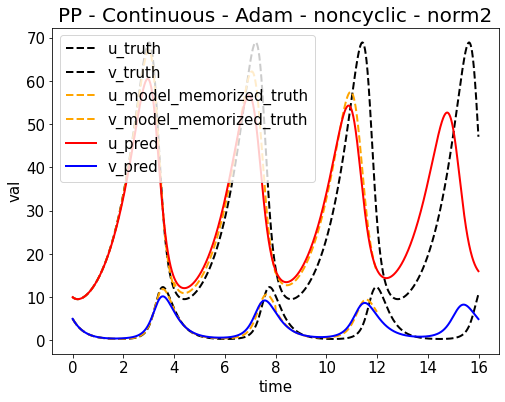

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653585015.png


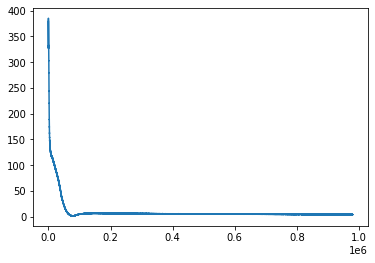

Epoch [982000/1000000] Loss:4.034102 Loss_1:0.000028 Loss_2:0.005997 Loss_3:0.000000 Loss_4:4.028076 Lr:0.001000 Time:27.178541s (202.74min in total, 3.72min remains)
Epoch [984000/1000000] Loss:4.177079 Loss_1:0.000179 Loss_2:0.038274 Loss_3:0.000000 Loss_4:4.138626 Lr:0.001000 Time:24.601332s (203.15min in total, 3.30min remains)
Epoch [986000/1000000] Loss:4.020616 Loss_1:0.000051 Loss_2:0.003270 Loss_3:0.000000 Loss_4:4.017294 Lr:0.001000 Time:24.826933s (203.56min in total, 2.89min remains)
Epoch [988000/1000000] Loss:4.026453 Loss_1:0.000008 Loss_2:0.014428 Loss_3:0.000000 Loss_4:4.012017 Lr:0.001000 Time:24.751955s (203.97min in total, 2.48min remains)
Epoch [990000/1000000] Loss:4.018928 Loss_1:0.000077 Loss_2:0.004131 Loss_3:0.000000 Loss_4:4.014720 Lr:0.001000 Time:24.601333s (204.38min in total, 2.06min remains)
Epoch [992000/1000000] Loss:3.993408 Loss_1:0.000009 Loss_2:0.003569 Loss_3:0.000000 Loss_4:3.989830 Lr:0.001000 Time:24.633757s (204.79min in total, 1.65min remains

<Figure size 432x288 with 0 Axes>

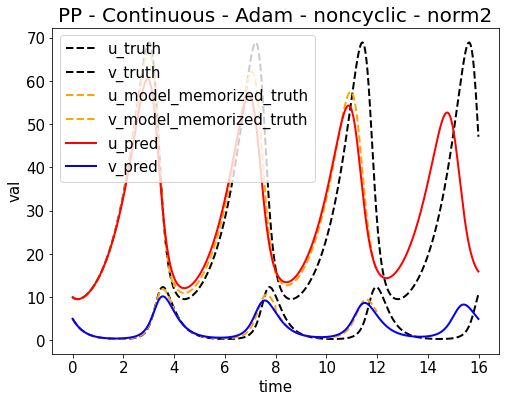

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653585264.png


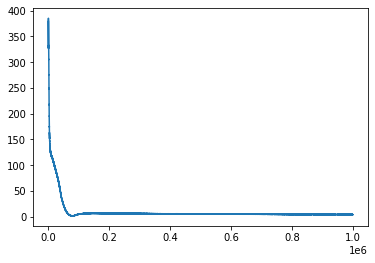

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_board
i = 4, length of truth = 1600 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1

<Figure size 432x288 with 0 Axes>

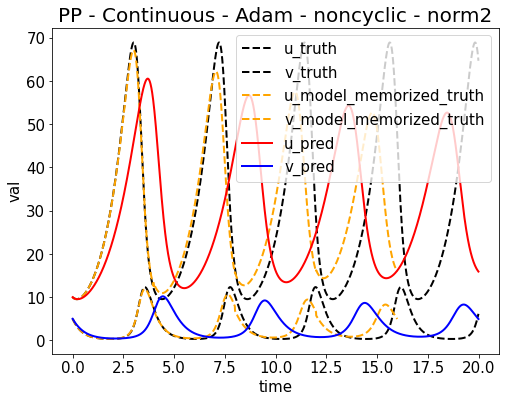

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653585267.png
using cuda
epoch = 1000000
epoch_step = 2000
model_name = SimpleNetworkPP_Continue
now_string = 2022-05-26-06-01-18
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 2000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 20000}
config = {'model_name': 'SimpleNetworkPP_Continue', 'T': 20.0, 'T_all': 20.0, 'T_unit': 0.01, 'N': 2000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0,

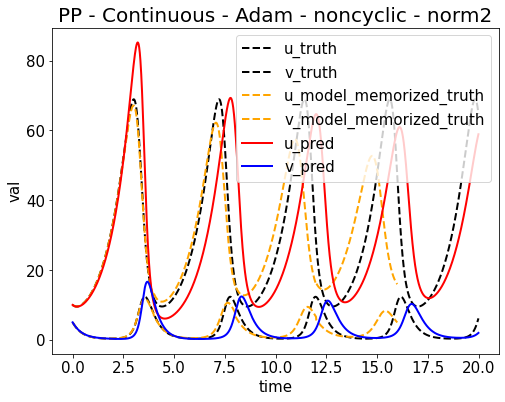

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653585542.png


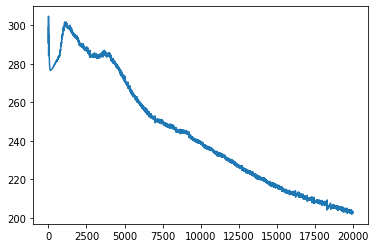

Epoch [22000/1000000] Loss:197.732208 Loss_1:0.000019 Loss_2:0.008990 Loss_3:0.000000 Loss_4:197.723206 Lr:0.001000 Time:28.569226s (5.05min in total, 224.66min remains)
Epoch [24000/1000000] Loss:193.155228 Loss_1:0.000053 Loss_2:0.009163 Loss_3:0.000000 Loss_4:193.146011 Lr:0.001000 Time:27.338618s (5.51min in total, 224.05min remains)
Epoch [26000/1000000] Loss:189.105133 Loss_1:0.000017 Loss_2:0.013087 Loss_3:0.000000 Loss_4:189.092026 Lr:0.001000 Time:27.449566s (5.97min in total, 223.53min remains)
Epoch [28000/1000000] Loss:185.456711 Loss_1:0.000196 Loss_2:0.055713 Loss_3:0.000000 Loss_4:185.400803 Lr:0.001000 Time:28.995011s (6.45min in total, 223.91min remains)
Epoch [30000/1000000] Loss:182.260208 Loss_1:0.000116 Loss_2:0.049571 Loss_3:0.000000 Loss_4:182.210526 Lr:0.001000 Time:28.879854s (6.93min in total, 224.12min remains)
Epoch [32000/1000000] Loss:178.426727 Loss_1:0.000032 Loss_2:0.005453 Loss_3:0.000000 Loss_4:178.421249 Lr:0.001000 Time:28.804990s (7.41min in total,

<Figure size 432x288 with 0 Axes>

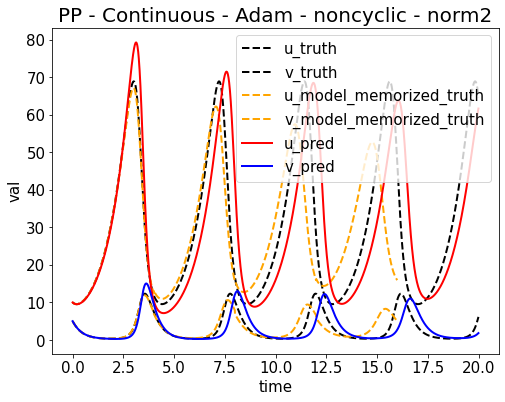

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653585826.png


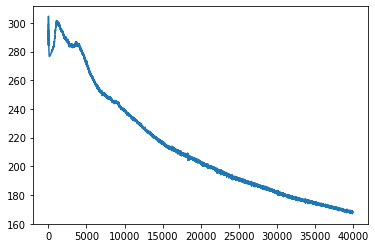

Epoch [42000/1000000] Loss:165.835754 Loss_1:0.000109 Loss_2:0.010302 Loss_3:0.000000 Loss_4:165.825348 Lr:0.001000 Time:28.856353s (9.78min in total, 223.08min remains)
Epoch [44000/1000000] Loss:163.812637 Loss_1:0.000045 Loss_2:0.006427 Loss_3:0.000000 Loss_4:163.806168 Lr:0.001000 Time:28.041041s (10.25min in total, 222.65min remains)
Epoch [46000/1000000] Loss:162.358414 Loss_1:0.000463 Loss_2:0.081161 Loss_3:0.000000 Loss_4:162.276794 Lr:0.001000 Time:27.881959s (10.71min in total, 222.17min remains)
Epoch [48000/1000000] Loss:160.691071 Loss_1:0.000058 Loss_2:0.075283 Loss_3:0.000000 Loss_4:160.615723 Lr:0.001000 Time:28.066186s (11.18min in total, 221.74min remains)
Epoch [50000/1000000] Loss:158.592865 Loss_1:0.000034 Loss_2:0.035610 Loss_3:0.000000 Loss_4:158.557220 Lr:0.001000 Time:28.396873s (11.65min in total, 221.42min remains)
Epoch [52000/1000000] Loss:157.523300 Loss_1:0.000011 Loss_2:0.008090 Loss_3:0.000000 Loss_4:157.515198 Lr:0.001000 Time:28.269627s (12.12min in t

<Figure size 432x288 with 0 Axes>

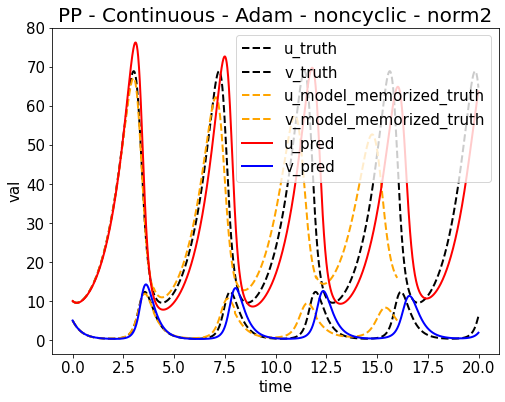

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653586107.png


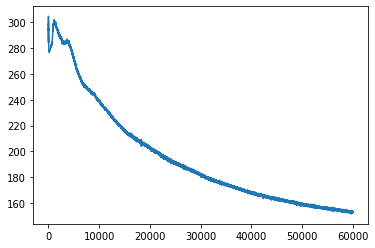

Epoch [62000/1000000] Loss:151.801971 Loss_1:0.000013 Loss_2:0.007562 Loss_3:0.000000 Loss_4:151.794403 Lr:0.001000 Time:29.370412s (14.47min in total, 218.96min remains)
Epoch [64000/1000000] Loss:151.234055 Loss_1:0.000039 Loss_2:0.004292 Loss_3:0.000000 Loss_4:151.229721 Lr:0.001000 Time:27.799228s (14.94min in total, 218.44min remains)
Epoch [66000/1000000] Loss:150.713791 Loss_1:0.000438 Loss_2:0.116159 Loss_3:0.000000 Loss_4:150.597198 Lr:0.001000 Time:28.151339s (15.41min in total, 218.01min remains)
Epoch [68000/1000000] Loss:149.092834 Loss_1:0.000002 Loss_2:0.004462 Loss_3:0.000000 Loss_4:149.088364 Lr:0.001000 Time:27.640331s (15.87min in total, 217.46min remains)
Epoch [70000/1000000] Loss:148.618484 Loss_1:0.000010 Loss_2:0.006148 Loss_3:0.000000 Loss_4:148.612320 Lr:0.001000 Time:27.922884s (16.33min in total, 216.98min remains)
Epoch [72000/1000000] Loss:148.003006 Loss_1:0.000012 Loss_2:0.014435 Loss_3:0.000000 Loss_4:147.988556 Lr:0.001000 Time:27.813482s (16.80min in 

<Figure size 432x288 with 0 Axes>

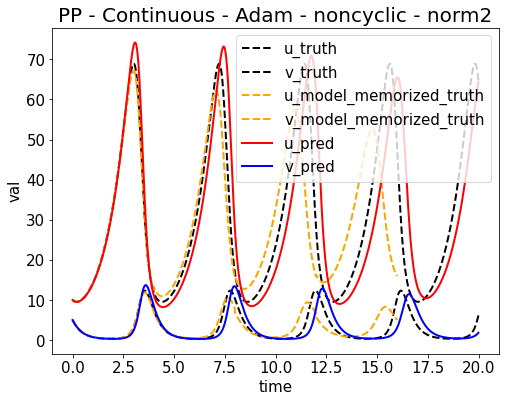

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653586387.png


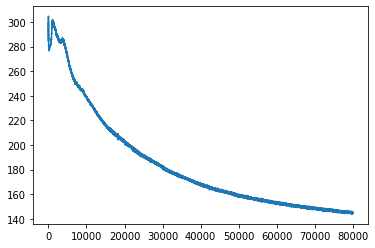

Epoch [82000/1000000] Loss:144.681885 Loss_1:0.000073 Loss_2:0.022432 Loss_3:0.000000 Loss_4:144.659378 Lr:0.001000 Time:28.533870s (19.13min in total, 214.13min remains)
Epoch [84000/1000000] Loss:143.599243 Loss_1:0.000015 Loss_2:0.010120 Loss_3:0.000000 Loss_4:143.589111 Lr:0.001000 Time:28.128716s (19.60min in total, 213.69min remains)
Epoch [86000/1000000] Loss:143.098358 Loss_1:0.000363 Loss_2:0.166135 Loss_3:0.000000 Loss_4:142.931854 Lr:0.001000 Time:27.800637s (20.06min in total, 213.19min remains)
Epoch [88000/1000000] Loss:142.971634 Loss_1:0.000108 Loss_2:0.012435 Loss_3:0.000000 Loss_4:142.959091 Lr:0.001000 Time:27.635999s (20.52min in total, 212.66min remains)
Epoch [90000/1000000] Loss:142.243484 Loss_1:0.000063 Loss_2:0.017276 Loss_3:0.000000 Loss_4:142.226151 Lr:0.001000 Time:27.998810s (20.99min in total, 212.20min remains)
Epoch [92000/1000000] Loss:141.805344 Loss_1:0.000097 Loss_2:0.103237 Loss_3:0.000000 Loss_4:141.702011 Lr:0.001000 Time:28.017619s (21.45min in 

<Figure size 432x288 with 0 Axes>

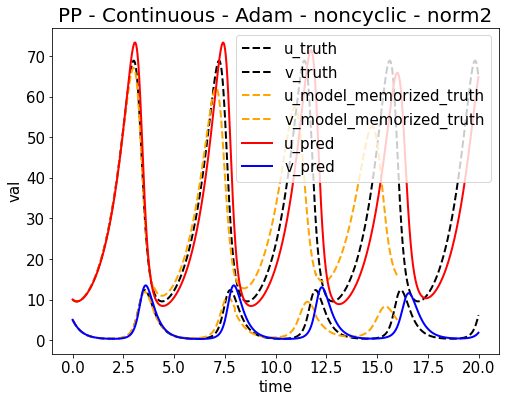

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653586666.png


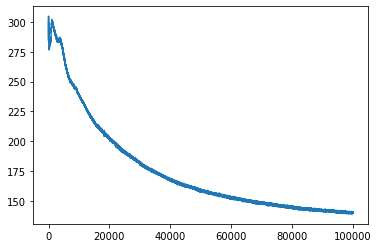

Epoch [102000/1000000] Loss:140.191788 Loss_1:0.000058 Loss_2:0.005046 Loss_3:0.000000 Loss_4:140.186676 Lr:0.001000 Time:29.019021s (23.79min in total, 209.49min remains)
Epoch [104000/1000000] Loss:140.103363 Loss_1:0.000016 Loss_2:0.005830 Loss_3:0.000000 Loss_4:140.097519 Lr:0.001000 Time:27.877870s (24.26min in total, 209.00min remains)
Epoch [106000/1000000] Loss:139.380554 Loss_1:0.000127 Loss_2:0.014044 Loss_3:0.000000 Loss_4:139.366379 Lr:0.001000 Time:27.749658s (24.72min in total, 208.50min remains)
Epoch [108000/1000000] Loss:138.314545 Loss_1:0.000015 Loss_2:0.043449 Loss_3:0.000000 Loss_4:138.271088 Lr:0.001000 Time:27.945050s (25.19min in total, 208.03min remains)
Epoch [110000/1000000] Loss:138.749222 Loss_1:0.000016 Loss_2:0.004712 Loss_3:0.000000 Loss_4:138.744492 Lr:0.001000 Time:27.568253s (25.65min in total, 207.51min remains)
Epoch [112000/1000000] Loss:138.591324 Loss_1:0.000017 Loss_2:0.004300 Loss_3:0.000000 Loss_4:138.587006 Lr:0.001000 Time:27.814212s (26.11m

<Figure size 432x288 with 0 Axes>

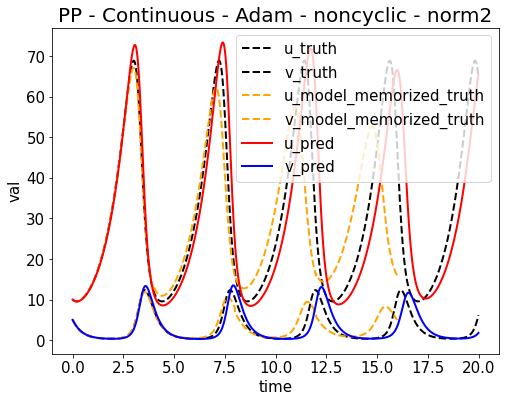

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653586946.png


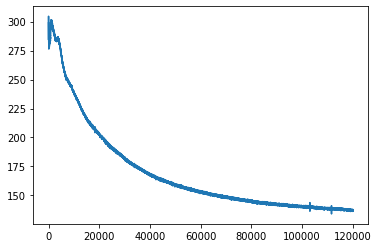

Epoch [122000/1000000] Loss:136.509003 Loss_1:0.000069 Loss_2:0.060860 Loss_3:0.000000 Loss_4:136.448074 Lr:0.001000 Time:28.818301s (28.44min in total, 204.70min remains)
Epoch [124000/1000000] Loss:136.863083 Loss_1:0.000022 Loss_2:0.005239 Loss_3:0.000000 Loss_4:136.857819 Lr:0.001000 Time:27.576532s (28.90min in total, 204.19min remains)
Epoch [126000/1000000] Loss:136.250763 Loss_1:0.000002 Loss_2:0.005999 Loss_3:0.000000 Loss_4:136.244766 Lr:0.001000 Time:27.827311s (29.37min in total, 203.71min remains)
Epoch [128000/1000000] Loss:136.667953 Loss_1:0.000048 Loss_2:0.106520 Loss_3:0.000000 Loss_4:136.561386 Lr:0.001000 Time:27.491639s (29.83min in total, 203.19min remains)
Epoch [130000/1000000] Loss:135.451172 Loss_1:0.000009 Loss_2:0.007668 Loss_3:0.000000 Loss_4:135.443497 Lr:0.001000 Time:27.613346s (30.29min in total, 202.68min remains)
Epoch [132000/1000000] Loss:135.434982 Loss_1:0.000086 Loss_2:0.042121 Loss_3:0.000000 Loss_4:135.392776 Lr:0.001000 Time:27.726168s (30.75m

<Figure size 432x288 with 0 Axes>

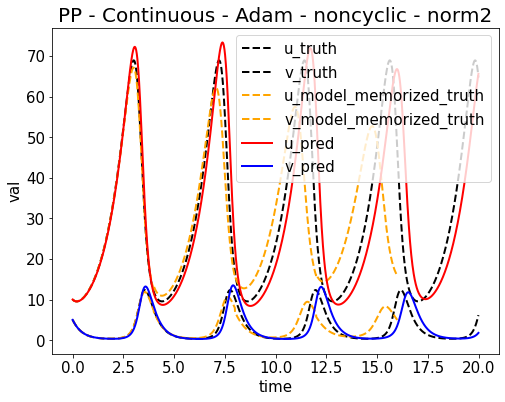

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653587224.png


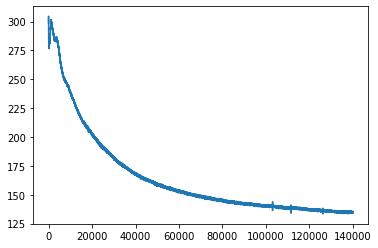

Epoch [142000/1000000] Loss:134.767975 Loss_1:0.000039 Loss_2:0.017869 Loss_3:0.000000 Loss_4:134.750061 Lr:0.001000 Time:29.499567s (33.09min in total, 199.95min remains)
Epoch [144000/1000000] Loss:134.976089 Loss_1:0.000021 Loss_2:0.029230 Loss_3:0.000000 Loss_4:134.946838 Lr:0.001000 Time:27.766050s (33.56min in total, 199.47min remains)
Epoch [146000/1000000] Loss:134.130432 Loss_1:0.000046 Loss_2:0.004062 Loss_3:0.000000 Loss_4:134.126328 Lr:0.001000 Time:27.887470s (34.02min in total, 198.99min remains)
Epoch [148000/1000000] Loss:133.860703 Loss_1:0.000038 Loss_2:0.005975 Loss_3:0.000000 Loss_4:133.854691 Lr:0.001000 Time:27.830895s (34.48min in total, 198.52min remains)
Epoch [150000/1000000] Loss:134.102615 Loss_1:0.000036 Loss_2:0.024195 Loss_3:0.000000 Loss_4:134.078384 Lr:0.001000 Time:27.549378s (34.94min in total, 198.01min remains)
Epoch [152000/1000000] Loss:133.488342 Loss_1:0.000002 Loss_2:0.004695 Loss_3:0.000000 Loss_4:133.483643 Lr:0.001000 Time:27.150973s (35.40m

<Figure size 432x288 with 0 Axes>

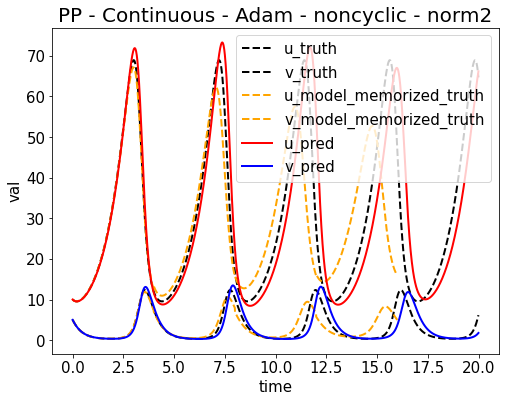

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653587502.png


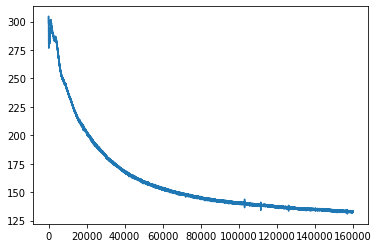

Epoch [162000/1000000] Loss:132.792252 Loss_1:0.000020 Loss_2:0.003312 Loss_3:0.000000 Loss_4:132.788925 Lr:0.001000 Time:28.941844s (37.72min in total, 195.11min remains)
Epoch [164000/1000000] Loss:132.756927 Loss_1:0.000007 Loss_2:0.003768 Loss_3:0.000000 Loss_4:132.753159 Lr:0.001000 Time:27.737707s (38.18min in total, 194.63min remains)
Epoch [166000/1000000] Loss:133.068176 Loss_1:0.000143 Loss_2:0.091764 Loss_3:0.000000 Loss_4:132.976273 Lr:0.001000 Time:27.717889s (38.64min in total, 194.14min remains)
Epoch [168000/1000000] Loss:131.782135 Loss_1:0.000086 Loss_2:0.016565 Loss_3:0.000000 Loss_4:131.765488 Lr:0.001000 Time:27.470492s (39.10min in total, 193.64min remains)
Epoch [170000/1000000] Loss:131.858353 Loss_1:0.000001 Loss_2:0.003448 Loss_3:0.000000 Loss_4:131.854904 Lr:0.001000 Time:27.466158s (39.56min in total, 193.14min remains)
Epoch [172000/1000000] Loss:131.562241 Loss_1:0.000003 Loss_2:0.009826 Loss_3:0.000000 Loss_4:131.552414 Lr:0.001000 Time:27.743300s (40.02m

<Figure size 432x288 with 0 Axes>

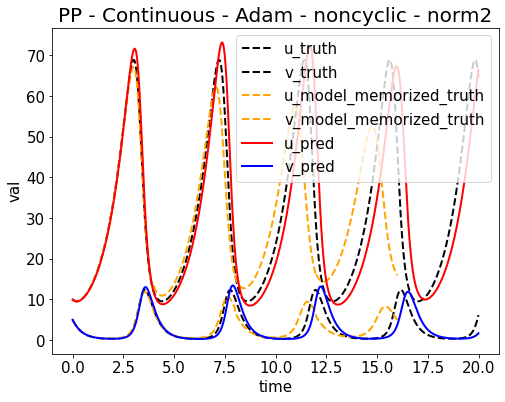

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653587780.png


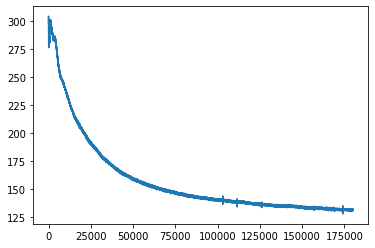

Epoch [182000/1000000] Loss:131.201721 Loss_1:0.000002 Loss_2:0.004444 Loss_3:0.000000 Loss_4:131.197281 Lr:0.001000 Time:29.111239s (42.35min in total, 190.36min remains)
Epoch [184000/1000000] Loss:131.471954 Loss_1:0.000004 Loss_2:0.007245 Loss_3:0.000000 Loss_4:131.464706 Lr:0.001000 Time:27.580389s (42.81min in total, 189.87min remains)
Epoch [186000/1000000] Loss:131.567413 Loss_1:0.000235 Loss_2:0.076735 Loss_3:0.000000 Loss_4:131.490448 Lr:0.001000 Time:27.442174s (43.27min in total, 189.37min remains)
Epoch [188000/1000000] Loss:131.192444 Loss_1:0.000144 Loss_2:0.023129 Loss_3:0.000000 Loss_4:131.169174 Lr:0.001000 Time:27.602025s (43.73min in total, 188.88min remains)
Epoch [190000/1000000] Loss:130.868393 Loss_1:0.000209 Loss_2:0.037071 Loss_3:0.000000 Loss_4:130.831116 Lr:0.001000 Time:27.821490s (44.19min in total, 188.41min remains)
Epoch [192000/1000000] Loss:130.905182 Loss_1:0.000130 Loss_2:0.098979 Loss_3:0.000000 Loss_4:130.806076 Lr:0.001000 Time:27.358905s (44.65m

<Figure size 432x288 with 0 Axes>

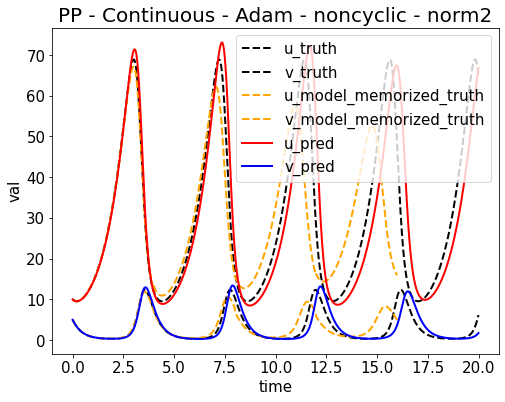

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653588057.png


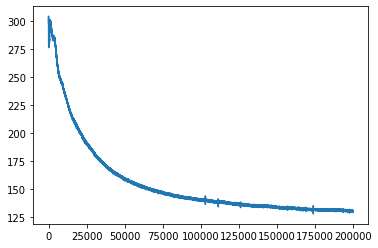

Epoch [202000/1000000] Loss:130.032257 Loss_1:0.000007 Loss_2:0.005248 Loss_3:0.000000 Loss_4:130.027008 Lr:0.001000 Time:29.138914s (46.98min in total, 185.58min remains)
Epoch [204000/1000000] Loss:129.825958 Loss_1:0.000009 Loss_2:0.003905 Loss_3:0.000000 Loss_4:129.822037 Lr:0.001000 Time:27.652253s (47.44min in total, 185.10min remains)
Epoch [206000/1000000] Loss:130.061203 Loss_1:0.000011 Loss_2:0.002870 Loss_3:0.000000 Loss_4:130.058319 Lr:0.001000 Time:28.050302s (47.90min in total, 184.64min remains)
Epoch [208000/1000000] Loss:129.793488 Loss_1:0.000021 Loss_2:0.001697 Loss_3:0.000000 Loss_4:129.791763 Lr:0.001000 Time:27.904034s (48.37min in total, 184.18min remains)
Epoch [210000/1000000] Loss:129.639267 Loss_1:0.000002 Loss_2:0.002265 Loss_3:0.000000 Loss_4:129.636993 Lr:0.001000 Time:27.753056s (48.83min in total, 183.70min remains)
Epoch [212000/1000000] Loss:129.435638 Loss_1:0.000012 Loss_2:0.004045 Loss_3:0.000000 Loss_4:129.431580 Lr:0.001000 Time:27.856345s (49.30m

<Figure size 432x288 with 0 Axes>

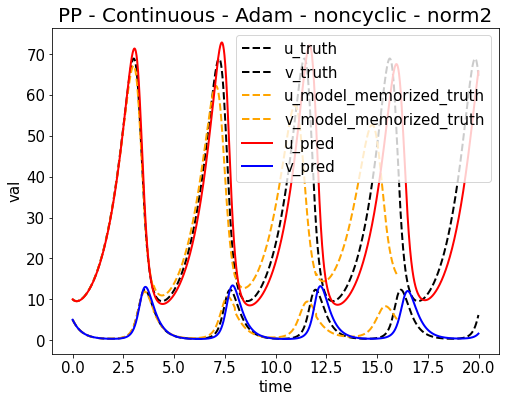

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653588337.png


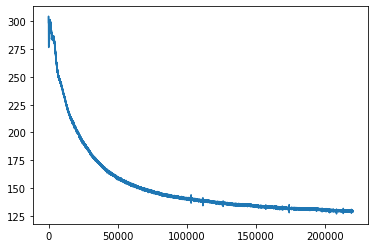

Epoch [222000/1000000] Loss:128.437622 Loss_1:0.000096 Loss_2:0.090063 Loss_3:0.000000 Loss_4:128.347458 Lr:0.001000 Time:29.268495s (51.64min in total, 180.96min remains)
Epoch [224000/1000000] Loss:128.997116 Loss_1:0.000024 Loss_2:0.009321 Loss_3:0.000000 Loss_4:128.987778 Lr:0.001000 Time:27.876792s (52.10min in total, 180.49min remains)
Epoch [226000/1000000] Loss:128.538651 Loss_1:0.000115 Loss_2:0.030703 Loss_3:0.000000 Loss_4:128.507828 Lr:0.001000 Time:27.629847s (52.56min in total, 180.01min remains)
Epoch [228000/1000000] Loss:128.872589 Loss_1:0.000022 Loss_2:0.005801 Loss_3:0.000000 Loss_4:128.866760 Lr:0.001000 Time:27.813864s (53.03min in total, 179.54min remains)
Epoch [230000/1000000] Loss:129.100220 Loss_1:0.000161 Loss_2:0.086385 Loss_3:0.000000 Loss_4:129.013672 Lr:0.001000 Time:27.723884s (53.49min in total, 179.07min remains)
Epoch [232000/1000000] Loss:129.533905 Loss_1:0.000010 Loss_2:0.010586 Loss_3:0.000000 Loss_4:129.523315 Lr:0.001000 Time:27.518509s (53.95m

<Figure size 432x288 with 0 Axes>

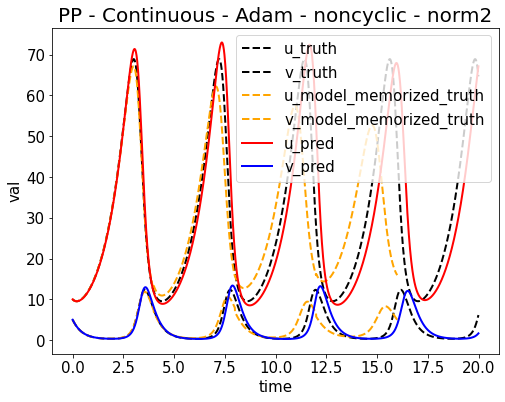

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653588615.png


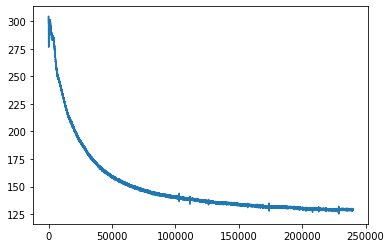

Epoch [242000/1000000] Loss:129.479507 Loss_1:0.000199 Loss_2:0.143521 Loss_3:0.000000 Loss_4:129.335785 Lr:0.001000 Time:29.555616s (56.28min in total, 176.27min remains)
Epoch [244000/1000000] Loss:129.194763 Loss_1:0.000030 Loss_2:0.004266 Loss_3:0.000000 Loss_4:129.190460 Lr:0.001000 Time:27.684619s (56.74min in total, 175.79min remains)
Epoch [246000/1000000] Loss:128.329147 Loss_1:0.000028 Loss_2:0.126641 Loss_3:0.000000 Loss_4:128.202484 Lr:0.001000 Time:27.906003s (57.20min in total, 175.33min remains)
Epoch [248000/1000000] Loss:129.017136 Loss_1:0.000028 Loss_2:0.013197 Loss_3:0.000000 Loss_4:129.003906 Lr:0.001000 Time:28.477286s (57.68min in total, 174.89min remains)
Epoch [250000/1000000] Loss:128.932785 Loss_1:0.000003 Loss_2:0.002948 Loss_3:0.000000 Loss_4:128.929840 Lr:0.001000 Time:29.079814s (58.16min in total, 174.49min remains)
Epoch [252000/1000000] Loss:128.345993 Loss_1:0.000468 Loss_2:0.144534 Loss_3:0.000000 Loss_4:128.200989 Lr:0.001000 Time:28.212586s (58.63m

<Figure size 432x288 with 0 Axes>

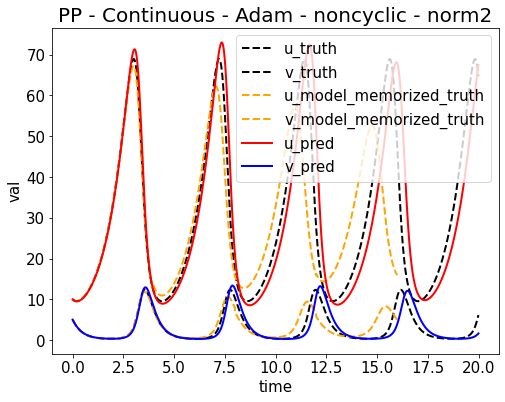

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653588897.png


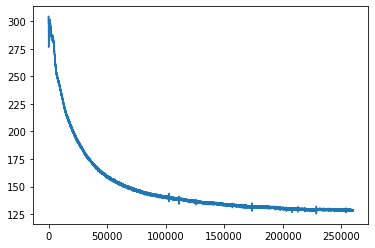

Epoch [262000/1000000] Loss:127.368408 Loss_1:0.000071 Loss_2:0.052735 Loss_3:0.000000 Loss_4:127.315605 Lr:0.001000 Time:28.783008s (60.97min in total, 171.75min remains)
Epoch [264000/1000000] Loss:127.788940 Loss_1:0.000004 Loss_2:0.001747 Loss_3:0.000000 Loss_4:127.787186 Lr:0.001000 Time:27.535094s (61.43min in total, 171.26min remains)
Epoch [266000/1000000] Loss:127.669754 Loss_1:0.000001 Loss_2:0.001882 Loss_3:0.000000 Loss_4:127.667870 Lr:0.001000 Time:27.465491s (61.89min in total, 170.78min remains)
Epoch [268000/1000000] Loss:127.731895 Loss_1:0.000015 Loss_2:0.004017 Loss_3:0.000000 Loss_4:127.727859 Lr:0.001000 Time:27.821768s (62.35min in total, 170.31min remains)
Epoch [270000/1000000] Loss:127.778671 Loss_1:0.000106 Loss_2:0.008767 Loss_3:0.000000 Loss_4:127.769798 Lr:0.001000 Time:27.689732s (62.81min in total, 169.83min remains)
Epoch [272000/1000000] Loss:127.806175 Loss_1:0.000099 Loss_2:0.018738 Loss_3:0.000000 Loss_4:127.787338 Lr:0.001000 Time:27.633752s (63.27m

<Figure size 432x288 with 0 Axes>

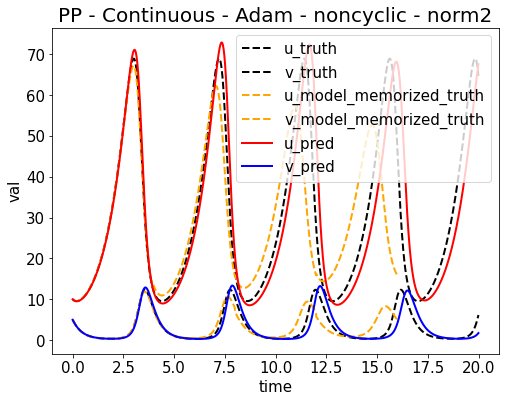

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653589175.png


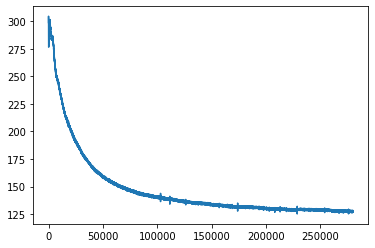

Epoch [282000/1000000] Loss:127.739952 Loss_1:0.000114 Loss_2:0.106183 Loss_3:0.000000 Loss_4:127.633652 Lr:0.001000 Time:29.287705s (65.60min in total, 167.03min remains)
Epoch [284000/1000000] Loss:127.079208 Loss_1:0.000004 Loss_2:0.004336 Loss_3:0.000000 Loss_4:127.074867 Lr:0.001000 Time:27.495792s (66.06min in total, 166.55min remains)
Epoch [286000/1000000] Loss:127.215950 Loss_1:0.000156 Loss_2:0.041442 Loss_3:0.000000 Loss_4:127.174355 Lr:0.001000 Time:27.443577s (66.52min in total, 166.06min remains)
Epoch [288000/1000000] Loss:127.135773 Loss_1:0.000002 Loss_2:0.002530 Loss_3:0.000000 Loss_4:127.133240 Lr:0.001000 Time:27.697876s (66.98min in total, 165.59min remains)
Epoch [290000/1000000] Loss:126.550812 Loss_1:0.000129 Loss_2:0.058917 Loss_3:0.000000 Loss_4:126.491768 Lr:0.001000 Time:27.431238s (67.44min in total, 165.10min remains)
Epoch [292000/1000000] Loss:126.933548 Loss_1:0.000011 Loss_2:0.007163 Loss_3:0.000000 Loss_4:126.926376 Lr:0.001000 Time:27.701122s (67.90m

<Figure size 432x288 with 0 Axes>

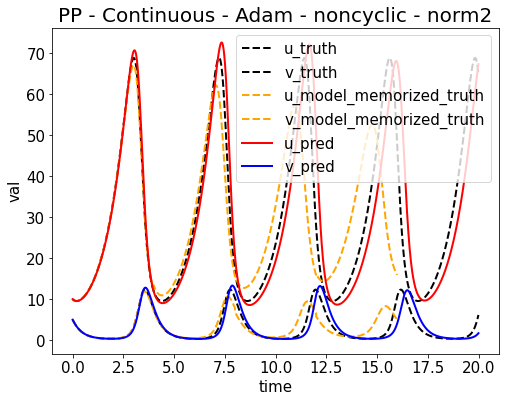

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653589451.png


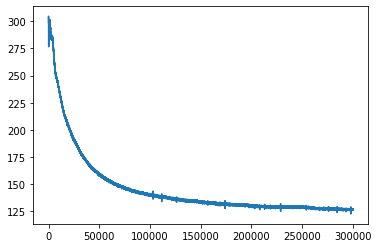

Epoch [302000/1000000] Loss:126.963814 Loss_1:0.000006 Loss_2:0.008785 Loss_3:0.000000 Loss_4:126.955025 Lr:0.001000 Time:29.062089s (70.21min in total, 162.28min remains)
Epoch [304000/1000000] Loss:126.563751 Loss_1:0.000010 Loss_2:0.001715 Loss_3:0.000000 Loss_4:126.562027 Lr:0.001000 Time:27.464063s (70.67min in total, 161.80min remains)
Epoch [306000/1000000] Loss:126.676559 Loss_1:0.000148 Loss_2:0.011916 Loss_3:0.000000 Loss_4:126.664497 Lr:0.001000 Time:27.312910s (71.12min in total, 161.31min remains)
Epoch [308000/1000000] Loss:126.625412 Loss_1:0.000012 Loss_2:0.001703 Loss_3:0.000000 Loss_4:126.623695 Lr:0.001000 Time:27.322765s (71.58min in total, 160.82min remains)
Epoch [310000/1000000] Loss:126.008110 Loss_1:0.000061 Loss_2:0.016551 Loss_3:0.000000 Loss_4:125.991501 Lr:0.001000 Time:27.523288s (72.04min in total, 160.34min remains)
Epoch [312000/1000000] Loss:126.472130 Loss_1:0.000008 Loss_2:0.006249 Loss_3:0.000000 Loss_4:126.465874 Lr:0.001000 Time:27.471094s (72.50m

<Figure size 432x288 with 0 Axes>

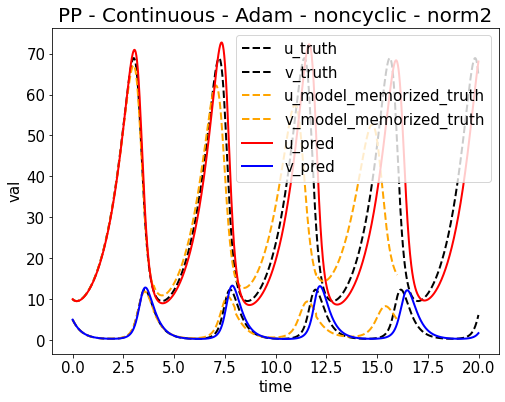

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653589727.png


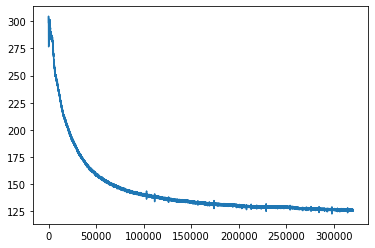

Epoch [322000/1000000] Loss:126.721954 Loss_1:0.000077 Loss_2:0.025989 Loss_3:0.000000 Loss_4:126.695885 Lr:0.001000 Time:29.111017s (74.81min in total, 157.52min remains)
Epoch [324000/1000000] Loss:126.423676 Loss_1:0.000021 Loss_2:0.061234 Loss_3:0.000000 Loss_4:126.362419 Lr:0.001000 Time:27.624840s (75.27min in total, 157.05min remains)
Epoch [326000/1000000] Loss:125.829559 Loss_1:0.000113 Loss_2:0.035321 Loss_3:0.000000 Loss_4:125.794121 Lr:0.001000 Time:27.496765s (75.73min in total, 156.57min remains)
Epoch [328000/1000000] Loss:125.064301 Loss_1:0.000032 Loss_2:0.063662 Loss_3:0.000000 Loss_4:125.000603 Lr:0.001000 Time:27.509541s (76.19min in total, 156.09min remains)
Epoch [330000/1000000] Loss:125.197540 Loss_1:0.000081 Loss_2:0.011611 Loss_3:0.000000 Loss_4:125.185844 Lr:0.001000 Time:27.507958s (76.65min in total, 155.62min remains)
Epoch [332000/1000000] Loss:125.279121 Loss_1:0.000017 Loss_2:0.008444 Loss_3:0.000000 Loss_4:125.270660 Lr:0.001000 Time:27.842883s (77.11m

<Figure size 432x288 with 0 Axes>

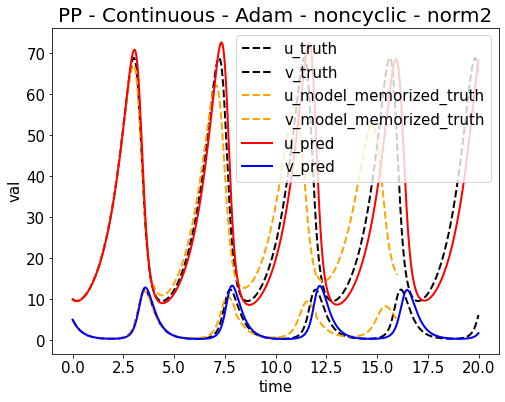

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653590004.png


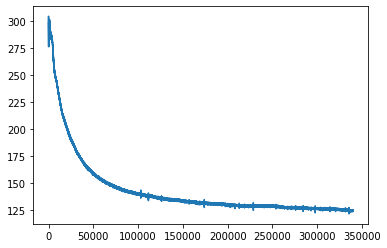

Epoch [342000/1000000] Loss:124.379532 Loss_1:0.000087 Loss_2:0.037383 Loss_3:0.000000 Loss_4:124.342064 Lr:0.001000 Time:29.178800s (79.43min in total, 152.82min remains)
Epoch [344000/1000000] Loss:124.434845 Loss_1:0.000026 Loss_2:0.007669 Loss_3:0.000000 Loss_4:124.427147 Lr:0.001000 Time:27.666757s (79.89min in total, 152.35min remains)
Epoch [346000/1000000] Loss:124.785255 Loss_1:0.000027 Loss_2:0.002286 Loss_3:0.000000 Loss_4:124.782944 Lr:0.001000 Time:27.235019s (80.35min in total, 151.87min remains)
Epoch [348000/1000000] Loss:124.924843 Loss_1:0.000027 Loss_2:0.008475 Loss_3:0.000000 Loss_4:124.916344 Lr:0.001000 Time:27.456608s (80.80min in total, 151.39min remains)
Epoch [350000/1000000] Loss:124.578262 Loss_1:0.000002 Loss_2:0.003029 Loss_3:0.000000 Loss_4:124.575233 Lr:0.001000 Time:27.631794s (81.26min in total, 150.92min remains)
Epoch [352000/1000000] Loss:124.928909 Loss_1:0.000084 Loss_2:0.005509 Loss_3:0.000000 Loss_4:124.923317 Lr:0.001000 Time:27.731381s (81.73m

<Figure size 432x288 with 0 Axes>

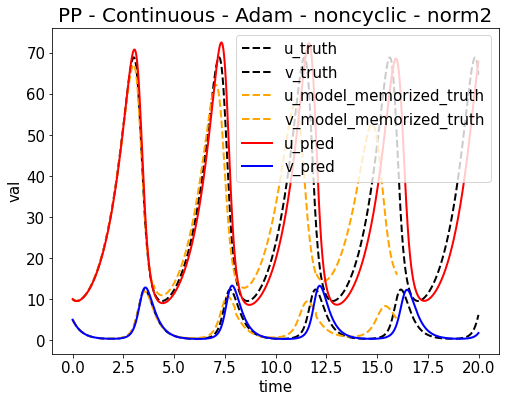

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653590281.png


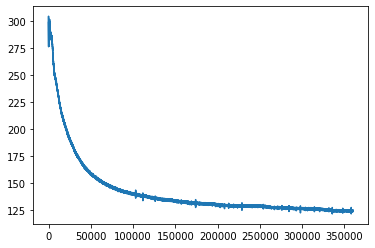

Epoch [362000/1000000] Loss:124.904747 Loss_1:0.000016 Loss_2:0.009673 Loss_3:0.000000 Loss_4:124.895058 Lr:0.001000 Time:29.279603s (84.05min in total, 148.13min remains)
Epoch [364000/1000000] Loss:124.608551 Loss_1:0.000015 Loss_2:0.006481 Loss_3:0.000000 Loss_4:124.602058 Lr:0.001000 Time:27.422774s (84.51min in total, 147.65min remains)
Epoch [366000/1000000] Loss:124.197250 Loss_1:0.000005 Loss_2:0.008590 Loss_3:0.000000 Loss_4:124.188652 Lr:0.001000 Time:27.291508s (84.96min in total, 147.17min remains)
Epoch [368000/1000000] Loss:124.434731 Loss_1:0.000031 Loss_2:0.019782 Loss_3:0.000000 Loss_4:124.414917 Lr:0.001000 Time:27.320429s (85.42min in total, 146.69min remains)
Epoch [370000/1000000] Loss:123.942390 Loss_1:0.000135 Loss_2:0.062959 Loss_3:0.000000 Loss_4:123.879295 Lr:0.001000 Time:27.399555s (85.87min in total, 146.22min remains)
Epoch [372000/1000000] Loss:124.378708 Loss_1:0.000008 Loss_2:0.045617 Loss_3:0.000000 Loss_4:124.333084 Lr:0.001000 Time:27.158464s (86.33m

<Figure size 432x288 with 0 Axes>

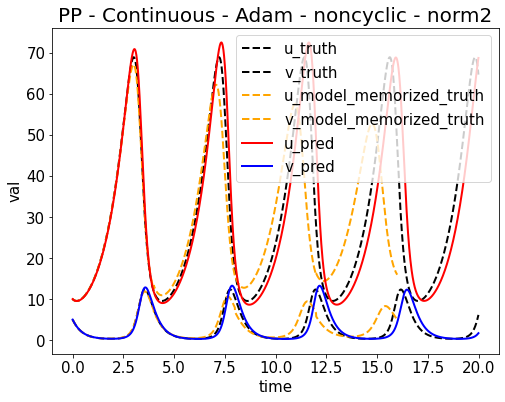

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653590557.png


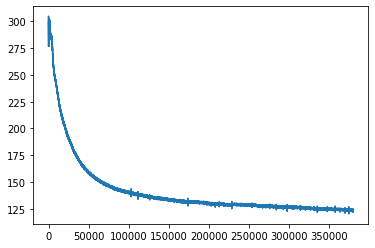

Epoch [382000/1000000] Loss:123.856026 Loss_1:0.000002 Loss_2:0.002017 Loss_3:0.000000 Loss_4:123.854004 Lr:0.001000 Time:29.203217s (88.65min in total, 143.41min remains)
Epoch [384000/1000000] Loss:123.818901 Loss_1:0.000029 Loss_2:0.004502 Loss_3:0.000000 Loss_4:123.814369 Lr:0.001000 Time:27.415207s (89.10min in total, 142.94min remains)
Epoch [386000/1000000] Loss:123.969170 Loss_1:0.000012 Loss_2:0.014868 Loss_3:0.000000 Loss_4:123.954292 Lr:0.001000 Time:27.506945s (89.56min in total, 142.47min remains)
Epoch [388000/1000000] Loss:123.924957 Loss_1:0.000340 Loss_2:0.033083 Loss_3:0.000000 Loss_4:123.891533 Lr:0.001000 Time:27.423356s (90.02min in total, 141.99min remains)
Epoch [390000/1000000] Loss:123.767570 Loss_1:0.000058 Loss_2:0.007830 Loss_3:0.000000 Loss_4:123.759682 Lr:0.001000 Time:27.266143s (90.47min in total, 141.51min remains)
Epoch [392000/1000000] Loss:123.555969 Loss_1:0.000049 Loss_2:0.004809 Loss_3:0.000000 Loss_4:123.551109 Lr:0.001000 Time:27.410531s (90.93m

<Figure size 432x288 with 0 Axes>

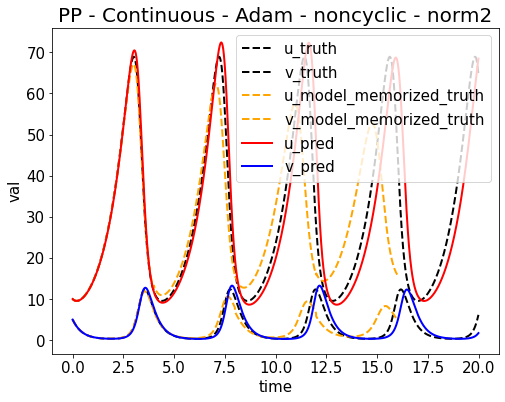

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_Continue_1000000_2000_0.001_2022-05-26-06-01-18_1653590834.png


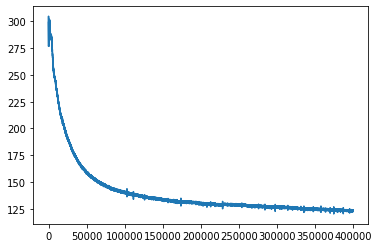

Epoch [402000/1000000] Loss:123.197456 Loss_1:0.000102 Loss_2:0.026005 Loss_3:0.000000 Loss_4:123.171349 Lr:0.001000 Time:29.031003s (93.25min in total, 138.71min remains)


In [ ]:
# PP continuous
main_path = '/content/drive/My Drive/enze/workspace/PINN/' # ENZE marked: you need to change your main_path if it's not here
run_pp_continue(main_path)

i = 0, length of truth = 0 now
truth_x: []
truth_y: []
self.truth_dic: {}
using cuda
epoch = 1000000
epoch_step = 5000
model_name = SimpleNetworkPP
now_string = 2022-05-24-01-58-49
model_save_path_last = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_last.pt
model_save_path_best = /content/drive/My Drive/enze/workspace/PINN//train/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_best.pt
loss_save_path = /content/drive/My Drive/enze/workspace/PINN//loss/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_loss_1000000.npy
args = {'epoch': 1000000, 'epoch_step': 5000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/enze/workspace/PINN/', 'save_step': 50000}
config = {'T': 2.0, 'T_unit': 0.01, 'N': 200, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 2.0, 'lb': 0.0, 'continue_period': 0.1, 'round_bit': 3}
Epoch [05000/1000000] Loss:11.566920 Loss_1:0.085015 Loss_2:11.481904 Lo

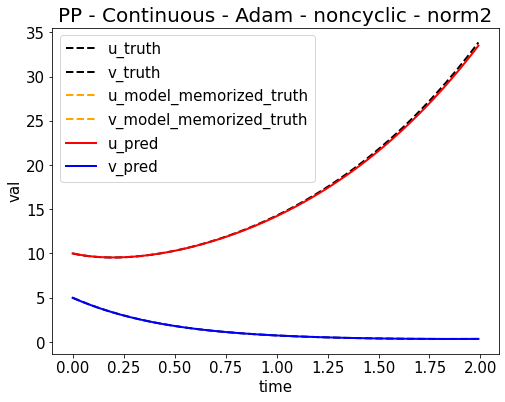

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653358151.png


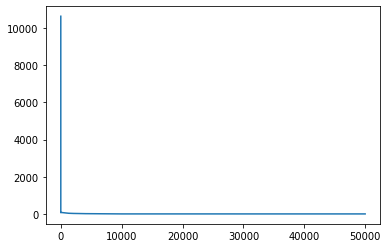

Epoch [55000/1000000] Loss:0.000255 Loss_1:0.000009 Loss_2:0.000246 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.629181s (11.16min in total, 191.73min remains)
Epoch [60000/1000000] Loss:0.000103 Loss_1:0.000004 Loss_2:0.000098 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.270728s (12.16min in total, 190.56min remains)
Epoch [65000/1000000] Loss:0.000138 Loss_1:0.000009 Loss_2:0.000129 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.268430s (13.17min in total, 189.42min remains)
Epoch [70000/1000000] Loss:0.005612 Loss_1:0.000067 Loss_2:0.005545 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.137759s (14.17min in total, 188.26min remains)
Epoch [75000/1000000] Loss:0.002304 Loss_1:0.000042 Loss_2:0.002261 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.479643s (15.18min in total, 187.20min remains)
Epoch [80000/1000000] Loss:0.000047 Loss_1:0.000000 Loss_2:0.000047 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.429745s (16.19min in total, 186.13min remains

<Figure size 432x288 with 0 Axes>

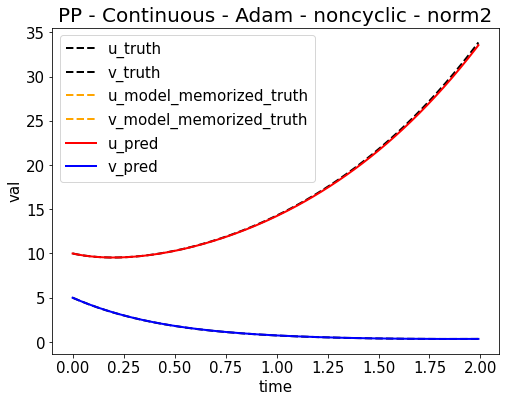

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653358755.png


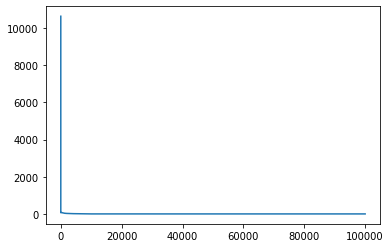

Epoch [105000/1000000] Loss:0.001453 Loss_1:0.000094 Loss_2:0.001359 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.640651s (21.22min in total, 180.92min remains)
Epoch [110000/1000000] Loss:0.002920 Loss_1:0.000030 Loss_2:0.002890 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.222269s (22.23min in total, 179.85min remains)
Epoch [115000/1000000] Loss:0.000037 Loss_1:0.000000 Loss_2:0.000037 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.981236s (23.23min in total, 178.76min remains)
Epoch [120000/1000000] Loss:0.000707 Loss_1:0.000023 Loss_2:0.000684 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.356087s (24.23min in total, 177.72min remains)
Epoch [125000/1000000] Loss:0.000448 Loss_1:0.000006 Loss_2:0.000442 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.053941s (25.24min in total, 176.65min remains)
Epoch [130000/1000000] Loss:0.001168 Loss_1:0.000112 Loss_2:0.001055 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.191040s (26.24min in total, 175.60min r

<Figure size 432x288 with 0 Axes>

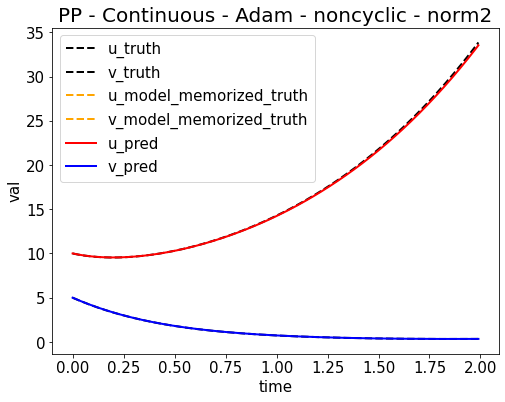

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653359357.png


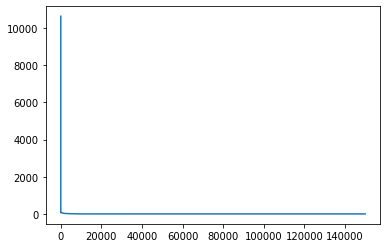

Epoch [155000/1000000] Loss:0.003358 Loss_1:0.000134 Loss_2:0.003223 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.712172s (31.26min in total, 170.43min remains)
Epoch [160000/1000000] Loss:0.000125 Loss_1:0.000012 Loss_2:0.000113 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.109532s (32.26min in total, 169.38min remains)
Epoch [165000/1000000] Loss:0.000071 Loss_1:0.000005 Loss_2:0.000067 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.966813s (33.26min in total, 168.33min remains)
Epoch [170000/1000000] Loss:0.000165 Loss_1:0.000036 Loss_2:0.000128 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.903221s (34.26min in total, 167.28min remains)
Epoch [175000/1000000] Loss:0.000370 Loss_1:0.000011 Loss_2:0.000358 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.002864s (35.26min in total, 166.23min remains)
Epoch [180000/1000000] Loss:0.000067 Loss_1:0.000001 Loss_2:0.000065 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.105520s (36.26min in total, 165.20min r

<Figure size 432x288 with 0 Axes>

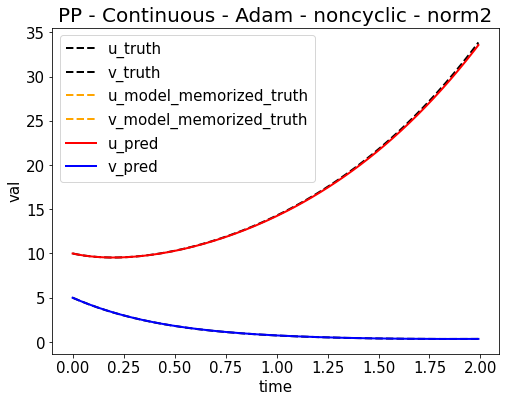

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653359958.png


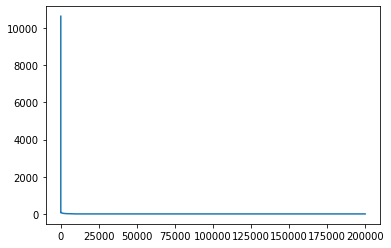

Epoch [205000/1000000] Loss:0.001338 Loss_1:0.000034 Loss_2:0.001303 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.689028s (41.28min in total, 160.10min remains)
Epoch [210000/1000000] Loss:0.001784 Loss_1:0.000013 Loss_2:0.001770 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.819835s (42.28min in total, 159.05min remains)
Epoch [215000/1000000] Loss:0.000045 Loss_1:0.000000 Loss_2:0.000045 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.799114s (43.28min in total, 158.01min remains)
Epoch [220000/1000000] Loss:0.000052 Loss_1:0.000003 Loss_2:0.000048 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.626853s (44.27min in total, 156.96min remains)
Epoch [225000/1000000] Loss:0.000183 Loss_1:0.000001 Loss_2:0.000181 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.661279s (45.26min in total, 155.91min remains)
Epoch [230000/1000000] Loss:0.000061 Loss_1:0.000002 Loss_2:0.000058 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.845260s (46.26min in total, 154.88min r

<Figure size 432x288 with 0 Axes>

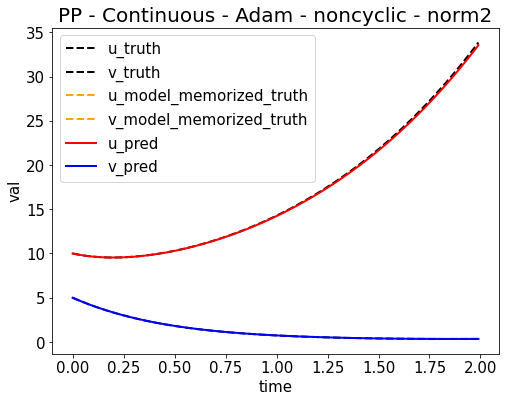

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653360558.png


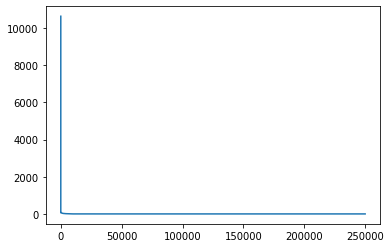

Epoch [255000/1000000] Loss:0.000151 Loss_1:0.000003 Loss_2:0.000148 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.686103s (51.28min in total, 149.83min remains)
Epoch [260000/1000000] Loss:0.000077 Loss_1:0.000003 Loss_2:0.000073 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.896852s (52.28min in total, 148.80min remains)
Epoch [265000/1000000] Loss:0.000049 Loss_1:0.000000 Loss_2:0.000049 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.150463s (53.28min in total, 147.79min remains)
Epoch [270000/1000000] Loss:0.000458 Loss_1:0.000019 Loss_2:0.000439 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.981856s (54.28min in total, 146.77min remains)
Epoch [275000/1000000] Loss:0.001073 Loss_1:0.000017 Loss_2:0.001055 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.849148s (55.28min in total, 145.74min remains)
Epoch [280000/1000000] Loss:0.000031 Loss_1:0.000000 Loss_2:0.000031 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.736160s (56.28min in total, 144.71min r

<Figure size 432x288 with 0 Axes>

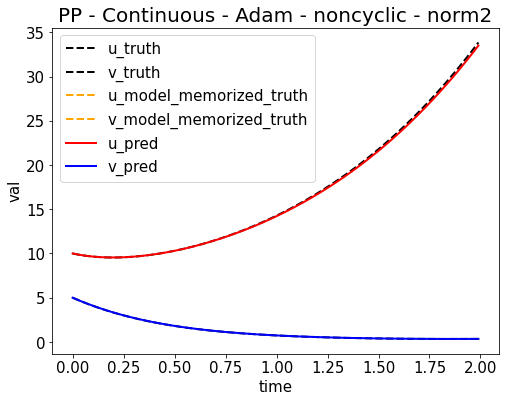

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653361158.png


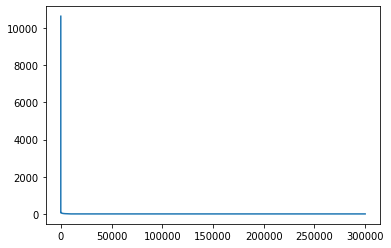

Epoch [305000/1000000] Loss:0.000461 Loss_1:0.000021 Loss_2:0.000440 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.247735s (61.28min in total, 139.64min remains)
Epoch [310000/1000000] Loss:0.003069 Loss_1:0.000013 Loss_2:0.003055 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.242476s (62.27min in total, 138.59min remains)
Epoch [315000/1000000] Loss:0.000042 Loss_1:0.000000 Loss_2:0.000041 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.936100s (63.25min in total, 137.54min remains)
Epoch [320000/1000000] Loss:0.000038 Loss_1:0.000000 Loss_2:0.000037 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.061354s (64.23min in total, 136.50min remains)
Epoch [325000/1000000] Loss:0.001315 Loss_1:0.000025 Loss_2:0.001290 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.141582s (65.22min in total, 135.46min remains)
Epoch [330000/1000000] Loss:0.000647 Loss_1:0.000009 Loss_2:0.000637 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.105312s (66.20min in total, 134.41min r

<Figure size 432x288 with 0 Axes>

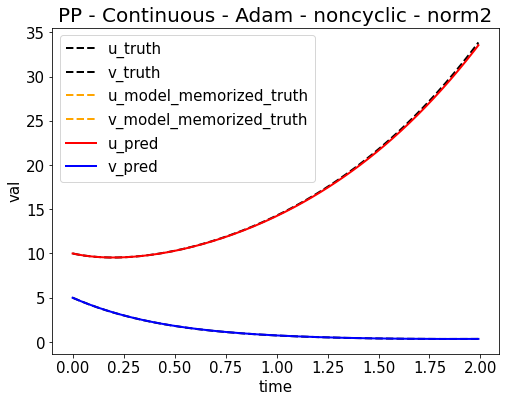

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653361752.png


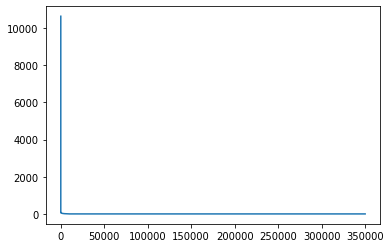

Epoch [355000/1000000] Loss:0.000122 Loss_1:0.000013 Loss_2:0.000109 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.176805s (71.17min in total, 129.31min remains)
Epoch [360000/1000000] Loss:0.000324 Loss_1:0.000002 Loss_2:0.000321 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.945827s (72.15min in total, 128.27min remains)
Epoch [365000/1000000] Loss:0.000024 Loss_1:0.000000 Loss_2:0.000024 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.142104s (73.14min in total, 127.24min remains)
Epoch [370000/1000000] Loss:0.000045 Loss_1:0.000001 Loss_2:0.000044 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.182457s (74.12min in total, 126.21min remains)
Epoch [375000/1000000] Loss:0.001178 Loss_1:0.000024 Loss_2:0.001153 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.117315s (75.11min in total, 125.18min remains)
Epoch [380000/1000000] Loss:0.000383 Loss_1:0.000007 Loss_2:0.000376 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.223592s (76.10min in total, 124.16min r

<Figure size 432x288 with 0 Axes>

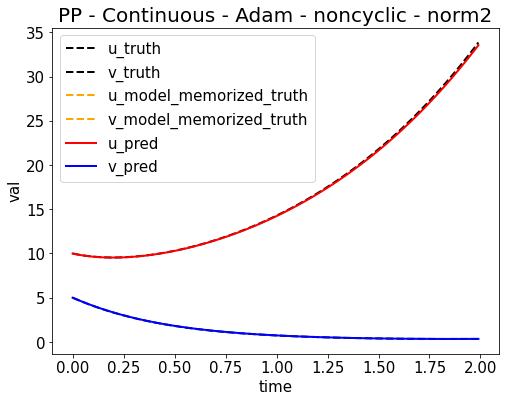

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653362345.png


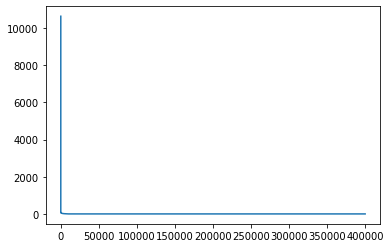

Epoch [405000/1000000] Loss:0.000272 Loss_1:0.000001 Loss_2:0.000270 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.498610s (81.07min in total, 119.10min remains)
Epoch [410000/1000000] Loss:0.002079 Loss_1:0.000000 Loss_2:0.002079 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.302151s (82.06min in total, 118.08min remains)
Epoch [415000/1000000] Loss:0.000028 Loss_1:0.000000 Loss_2:0.000027 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.529410s (83.05min in total, 117.07min remains)
Epoch [420000/1000000] Loss:0.000042 Loss_1:0.000002 Loss_2:0.000040 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.393906s (84.04min in total, 116.05min remains)
Epoch [425000/1000000] Loss:0.001071 Loss_1:0.000010 Loss_2:0.001060 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.413698s (85.03min in total, 115.04min remains)
Epoch [430000/1000000] Loss:0.004782 Loss_1:0.000047 Loss_2:0.004734 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.586911s (86.02min in total, 114.03min r

<Figure size 432x288 with 0 Axes>

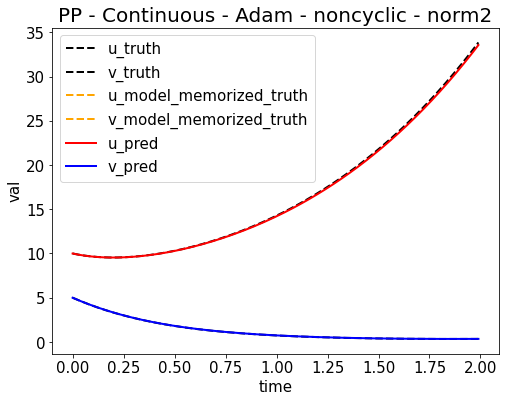

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653362942.png


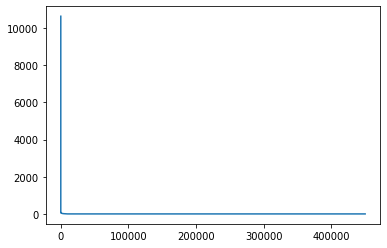

Epoch [455000/1000000] Loss:0.001052 Loss_1:0.000017 Loss_2:0.001035 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.668871s (91.02min in total, 109.03min remains)
Epoch [460000/1000000] Loss:0.000288 Loss_1:0.000011 Loss_2:0.000277 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.751245s (92.02min in total, 108.02min remains)
Epoch [465000/1000000] Loss:0.001588 Loss_1:0.000057 Loss_2:0.001531 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.822598s (93.02min in total, 107.02min remains)
Epoch [470000/1000000] Loss:0.002247 Loss_1:0.000024 Loss_2:0.002222 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.899335s (94.01min in total, 106.02min remains)
Epoch [475000/1000000] Loss:0.000068 Loss_1:0.000001 Loss_2:0.000067 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.524011s (95.01min in total, 105.01min remains)
Epoch [480000/1000000] Loss:0.000200 Loss_1:0.000000 Loss_2:0.000199 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.639308s (96.00min in total, 104.00min r

<Figure size 432x288 with 0 Axes>

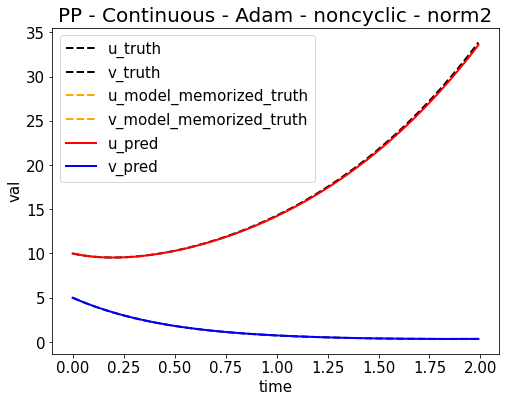

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653363539.png


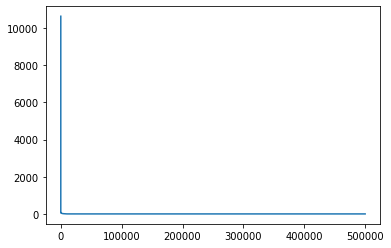

Epoch [505000/1000000] Loss:0.000125 Loss_1:0.000005 Loss_2:0.000120 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:60.809031s (100.95min in total, 98.95min remains)
Epoch [510000/1000000] Loss:0.002518 Loss_1:0.000028 Loss_2:0.002490 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.250292s (101.93min in total, 97.94min remains)
Epoch [515000/1000000] Loss:0.000160 Loss_1:0.000030 Loss_2:0.000129 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.896380s (102.92min in total, 96.92min remains)
Epoch [520000/1000000] Loss:0.000033 Loss_1:0.000001 Loss_2:0.000032 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.189823s (103.90min in total, 95.91min remains)
Epoch [525000/1000000] Loss:0.000693 Loss_1:0.000002 Loss_2:0.000691 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.862524s (104.88min in total, 94.89min remains)
Epoch [530000/1000000] Loss:0.002220 Loss_1:0.000007 Loss_2:0.002213 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.022958s (105.87min in total, 93.88min r

<Figure size 432x288 with 0 Axes>

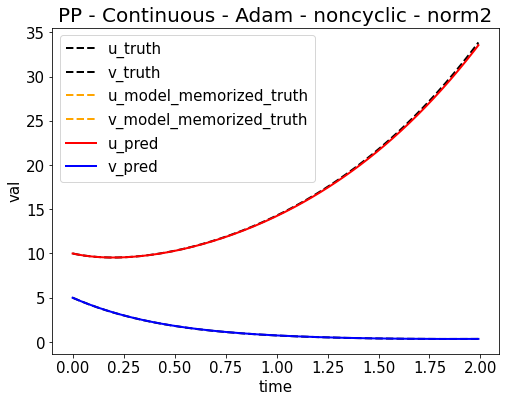

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653364131.png


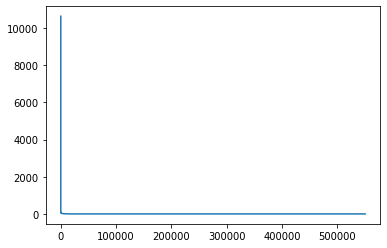

Epoch [555000/1000000] Loss:0.000974 Loss_1:0.000006 Loss_2:0.000968 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.483629s (110.84min in total, 88.87min remains)
Epoch [560000/1000000] Loss:0.000783 Loss_1:0.000005 Loss_2:0.000777 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.101705s (111.82min in total, 87.86min remains)
Epoch [565000/1000000] Loss:0.000028 Loss_1:0.000000 Loss_2:0.000028 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.312818s (112.81min in total, 86.85min remains)
Epoch [570000/1000000] Loss:0.000032 Loss_1:0.000000 Loss_2:0.000031 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.305418s (113.80min in total, 85.85min remains)
Epoch [575000/1000000] Loss:0.000358 Loss_1:0.000021 Loss_2:0.000337 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.015825s (114.78min in total, 84.84min remains)
Epoch [580000/1000000] Loss:0.000381 Loss_1:0.000007 Loss_2:0.000374 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.124890s (115.77min in total, 83.83min r

<Figure size 432x288 with 0 Axes>

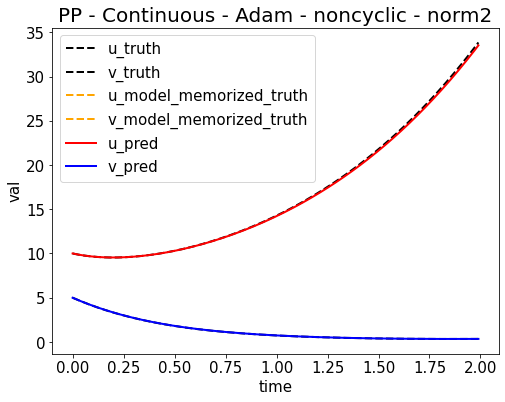

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653364725.png


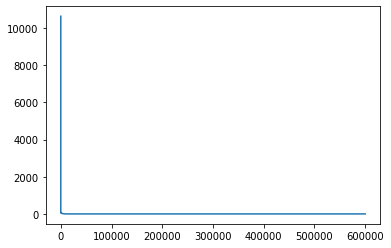

Epoch [605000/1000000] Loss:0.000055 Loss_1:0.000000 Loss_2:0.000055 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.357019s (120.73min in total, 78.82min remains)
Epoch [610000/1000000] Loss:0.000044 Loss_1:0.000002 Loss_2:0.000042 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.048143s (121.72min in total, 77.82min remains)
Epoch [615000/1000000] Loss:0.000280 Loss_1:0.000015 Loss_2:0.000265 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.224031s (122.70min in total, 76.81min remains)
Epoch [620000/1000000] Loss:0.001013 Loss_1:0.000013 Loss_2:0.001000 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.004393s (123.69min in total, 75.81min remains)
Epoch [625000/1000000] Loss:0.000023 Loss_1:0.000000 Loss_2:0.000023 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.144329s (124.67min in total, 74.80min remains)
Epoch [630000/1000000] Loss:0.000022 Loss_1:0.000000 Loss_2:0.000021 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.024632s (125.65min in total, 73.80min r

<Figure size 432x288 with 0 Axes>

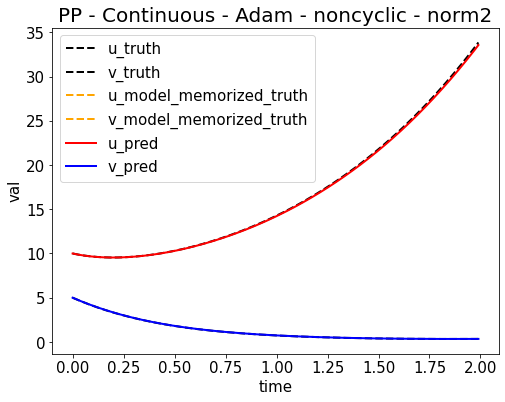

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653365319.png


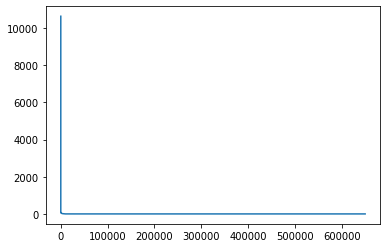

Epoch [655000/1000000] Loss:0.000038 Loss_1:0.000003 Loss_2:0.000035 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.560224s (130.62min in total, 68.80min remains)
Epoch [660000/1000000] Loss:0.000470 Loss_1:0.000004 Loss_2:0.000465 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.305812s (131.61min in total, 67.80min remains)
Epoch [665000/1000000] Loss:0.000687 Loss_1:0.000011 Loss_2:0.000675 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.918618s (132.59min in total, 66.79min remains)
Epoch [670000/1000000] Loss:0.000833 Loss_1:0.000012 Loss_2:0.000820 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.118078s (133.58min in total, 65.79min remains)
Epoch [675000/1000000] Loss:0.000022 Loss_1:0.000000 Loss_2:0.000021 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.863275s (134.56min in total, 64.79min remains)
Epoch [680000/1000000] Loss:0.000615 Loss_1:0.000019 Loss_2:0.000595 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.885250s (135.54min in total, 63.78min r

<Figure size 432x288 with 0 Axes>

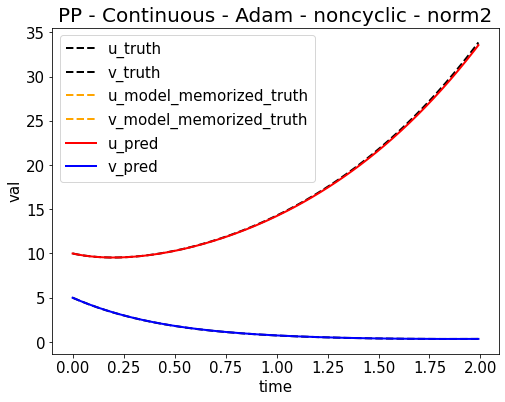

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653365911.png


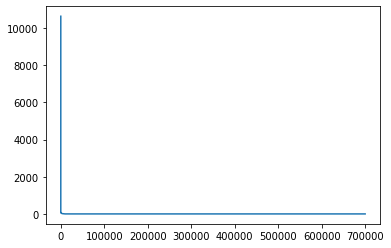

Epoch [705000/1000000] Loss:0.000284 Loss_1:0.000008 Loss_2:0.000276 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.505670s (140.49min in total, 58.79min remains)
Epoch [710000/1000000] Loss:0.000079 Loss_1:0.000001 Loss_2:0.000077 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.300818s (141.48min in total, 57.79min remains)
Epoch [715000/1000000] Loss:0.000727 Loss_1:0.000009 Loss_2:0.000718 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.146216s (142.47min in total, 56.79min remains)
Epoch [720000/1000000] Loss:0.000020 Loss_1:0.000000 Loss_2:0.000020 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.007147s (143.45min in total, 55.79min remains)
Epoch [725000/1000000] Loss:0.000025 Loss_1:0.000000 Loss_2:0.000024 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.042234s (144.44min in total, 54.79min remains)
Epoch [730000/1000000] Loss:0.000091 Loss_1:0.000002 Loss_2:0.000088 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.338021s (145.43min in total, 53.79min r

<Figure size 432x288 with 0 Axes>

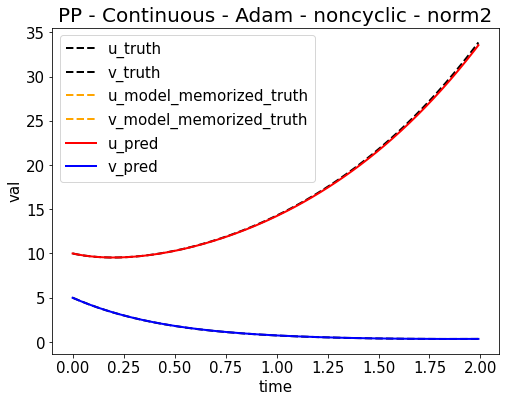

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653366505.png


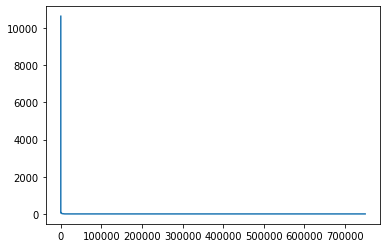

Epoch [755000/1000000] Loss:0.000023 Loss_1:0.000001 Loss_2:0.000022 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.864542s (150.39min in total, 48.80min remains)
Epoch [760000/1000000] Loss:0.000031 Loss_1:0.000002 Loss_2:0.000029 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.115308s (151.38min in total, 47.80min remains)
Epoch [765000/1000000] Loss:0.000105 Loss_1:0.000004 Loss_2:0.000100 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.902988s (152.36min in total, 46.80min remains)
Epoch [770000/1000000] Loss:0.000327 Loss_1:0.000012 Loss_2:0.000315 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.066563s (153.35min in total, 45.80min remains)
Epoch [775000/1000000] Loss:0.001086 Loss_1:0.000001 Loss_2:0.001085 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.075551s (154.33min in total, 44.81min remains)
Epoch [780000/1000000] Loss:0.000020 Loss_1:0.000000 Loss_2:0.000020 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.021445s (155.31min in total, 43.81min r

<Figure size 432x288 with 0 Axes>

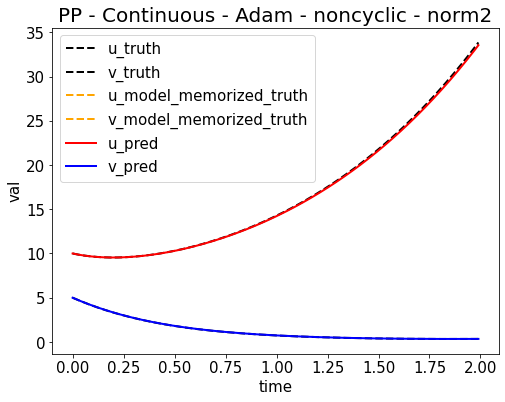

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653367098.png


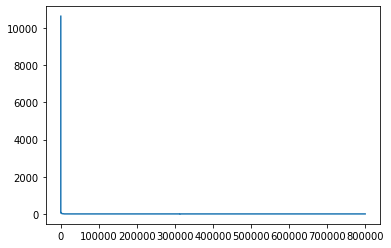

Epoch [805000/1000000] Loss:0.000036 Loss_1:0.000000 Loss_2:0.000036 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.663076s (160.27min in total, 38.82min remains)
Epoch [810000/1000000] Loss:0.000100 Loss_1:0.000001 Loss_2:0.000099 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.821305s (161.25min in total, 37.83min remains)
Epoch [815000/1000000] Loss:0.000129 Loss_1:0.000018 Loss_2:0.000111 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.028882s (162.24min in total, 36.83min remains)
Epoch [820000/1000000] Loss:0.000025 Loss_1:0.000000 Loss_2:0.000024 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.186620s (163.23min in total, 35.83min remains)
Epoch [825000/1000000] Loss:0.000029 Loss_1:0.000000 Loss_2:0.000029 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.140584s (164.21min in total, 34.83min remains)
Epoch [830000/1000000] Loss:0.000038 Loss_1:0.000000 Loss_2:0.000038 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.133177s (165.20min in total, 33.84min r

<Figure size 432x288 with 0 Axes>

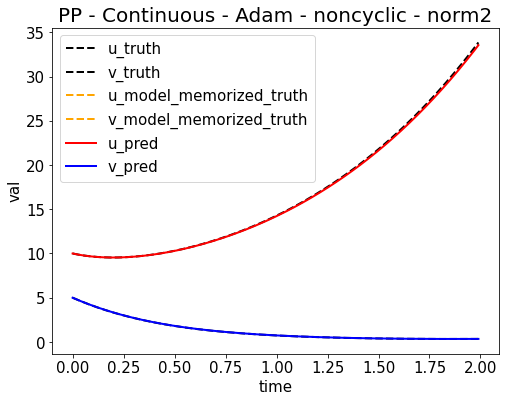

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653367691.png


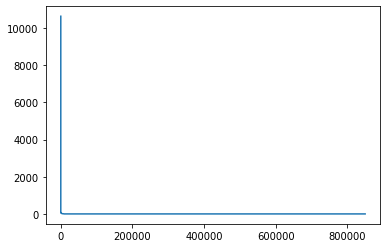

Epoch [855000/1000000] Loss:0.000019 Loss_1:0.000000 Loss_2:0.000019 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:61.843860s (170.16min in total, 28.86min remains)
Epoch [860000/1000000] Loss:0.000067 Loss_1:0.000000 Loss_2:0.000067 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.081297s (171.15min in total, 27.86min remains)
Epoch [865000/1000000] Loss:0.000153 Loss_1:0.000002 Loss_2:0.000150 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.874010s (172.13min in total, 26.86min remains)
Epoch [870000/1000000] Loss:0.000367 Loss_1:0.000021 Loss_2:0.000345 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.034554s (173.11min in total, 25.87min remains)
Epoch [875000/1000000] Loss:0.000046 Loss_1:0.000002 Loss_2:0.000044 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.217582s (174.10min in total, 24.87min remains)
Epoch [880000/1000000] Loss:0.002985 Loss_1:0.000015 Loss_2:0.002970 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.973744s (175.08min in total, 23.87min r

<Figure size 432x288 with 0 Axes>

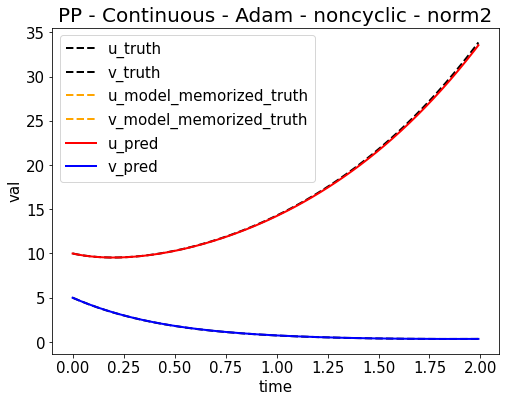

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653368284.png


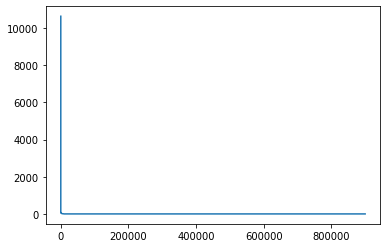

Epoch [905000/1000000] Loss:0.000020 Loss_1:0.000000 Loss_2:0.000019 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:62.502739s (180.07min in total, 18.90min remains)
Epoch [910000/1000000] Loss:0.000260 Loss_1:0.000000 Loss_2:0.000259 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.950233s (181.05min in total, 17.91min remains)
Epoch [915000/1000000] Loss:0.000187 Loss_1:0.000000 Loss_2:0.000186 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.254168s (182.04min in total, 16.91min remains)
Epoch [920000/1000000] Loss:0.000102 Loss_1:0.000016 Loss_2:0.000087 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.346394s (183.03min in total, 15.92min remains)
Epoch [925000/1000000] Loss:0.000032 Loss_1:0.000003 Loss_2:0.000029 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.180466s (184.01min in total, 14.92min remains)
Epoch [930000/1000000] Loss:0.000335 Loss_1:0.000018 Loss_2:0.000317 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.205625s (185.00min in total, 13.92min r

<Figure size 432x288 with 0 Axes>

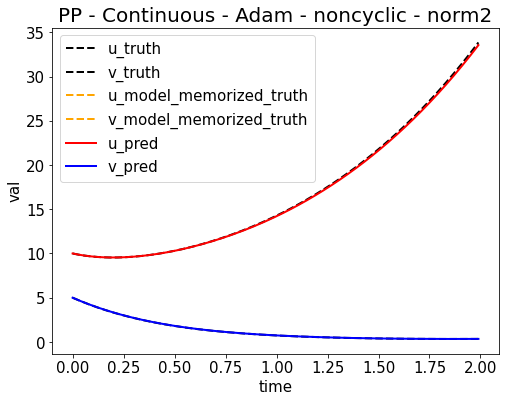

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653368880.png


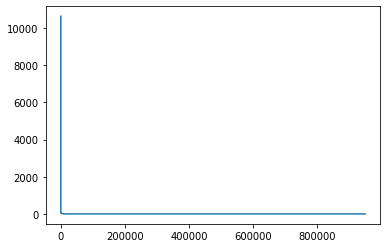

Epoch [955000/1000000] Loss:0.002412 Loss_1:0.000070 Loss_2:0.002342 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:62.214114s (189.98min in total, 8.95min remains)
Epoch [960000/1000000] Loss:0.000030 Loss_1:0.000000 Loss_2:0.000030 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.990576s (190.97min in total, 7.96min remains)
Epoch [965000/1000000] Loss:0.000399 Loss_1:0.000018 Loss_2:0.000380 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.098314s (191.95min in total, 6.96min remains)
Epoch [970000/1000000] Loss:0.000021 Loss_1:0.000000 Loss_2:0.000021 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:59.087183s (192.94min in total, 5.97min remains)
Epoch [975000/1000000] Loss:0.000606 Loss_1:0.000026 Loss_2:0.000580 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.954866s (193.92min in total, 4.97min remains)
Epoch [980000/1000000] Loss:0.000019 Loss_1:0.000000 Loss_2:0.000019 Loss_3:0.000000 Loss_4:0.000000 Lr:0.001000 Time:58.981703s (194.90min in total, 3.98min remains

<Figure size 432x288 with 0 Axes>

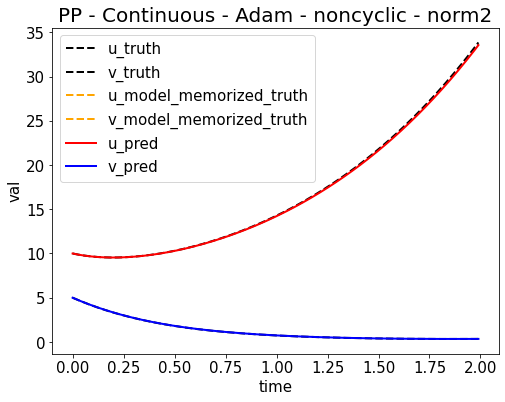

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653369473.png


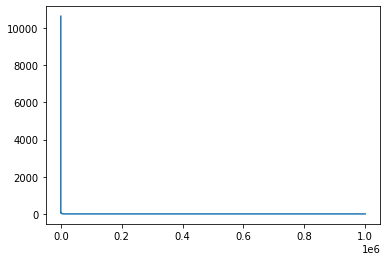

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 1, length of truth = 200 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:286: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:210.)


Epoch [05000/1000000] Loss:62.203476 Loss_1:1.187146 Loss_2:14.728640 Loss_3:0.000001 Loss_4:46.287689 Lr:0.001000 Time:66.450222s (1.11min in total, 220.39min remains)
Epoch [10000/1000000] Loss:3.179409 Loss_1:0.002224 Loss_2:1.036847 Loss_3:0.000000 Loss_4:2.140337 Lr:0.001000 Time:66.437510s (2.21min in total, 219.27min remains)
Epoch [15000/1000000] Loss:2.212676 Loss_1:0.002998 Loss_2:0.578774 Loss_3:0.000000 Loss_4:1.630903 Lr:0.001000 Time:66.313018s (3.32min in total, 218.02min remains)
Epoch [20000/1000000] Loss:0.217560 Loss_1:0.000139 Loss_2:0.062037 Loss_3:0.000000 Loss_4:0.155384 Lr:0.001000 Time:66.244018s (4.42min in total, 216.78min remains)
Epoch [25000/1000000] Loss:0.076411 Loss_1:0.000082 Loss_2:0.024104 Loss_3:0.000000 Loss_4:0.052224 Lr:0.001000 Time:66.030510s (5.52min in total, 215.46min remains)
Epoch [30000/1000000] Loss:0.067470 Loss_1:0.001270 Loss_2:0.030849 Loss_3:0.000000 Loss_4:0.035351 Lr:0.001000 Time:66.475257s (6.63min in total, 214.45min remains)
E

<Figure size 432x288 with 0 Axes>

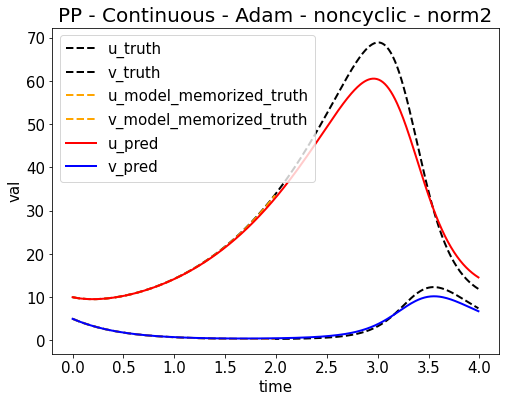

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653370140.png


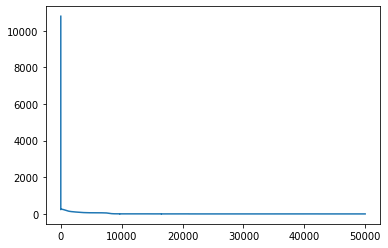

Epoch [55000/1000000] Loss:0.071570 Loss_1:0.001778 Loss_2:0.056611 Loss_3:0.000000 Loss_4:0.013180 Lr:0.001000 Time:67.550211s (12.19min in total, 209.39min remains)
Epoch [60000/1000000] Loss:0.025842 Loss_1:0.000028 Loss_2:0.010151 Loss_3:0.000000 Loss_4:0.015663 Lr:0.001000 Time:66.414640s (13.29min in total, 208.27min remains)
Epoch [65000/1000000] Loss:0.026976 Loss_1:0.000128 Loss_2:0.013745 Loss_3:0.000000 Loss_4:0.013103 Lr:0.001000 Time:66.411793s (14.40min in total, 207.15min remains)
Epoch [70000/1000000] Loss:0.020711 Loss_1:0.000011 Loss_2:0.006749 Loss_3:0.000000 Loss_4:0.013950 Lr:0.001000 Time:66.312463s (15.51min in total, 206.01min remains)
Epoch [75000/1000000] Loss:0.016047 Loss_1:0.000036 Loss_2:0.004297 Loss_3:0.000000 Loss_4:0.011713 Lr:0.001000 Time:66.416561s (16.61min in total, 204.89min remains)
Epoch [80000/1000000] Loss:0.016139 Loss_1:0.000009 Loss_2:0.004509 Loss_3:0.000000 Loss_4:0.011621 Lr:0.001000 Time:66.252767s (17.72min in total, 203.75min remains

<Figure size 432x288 with 0 Axes>

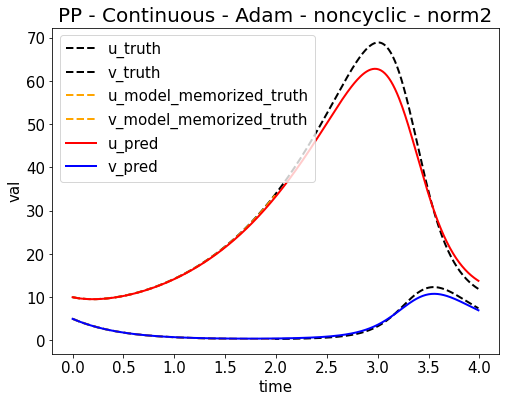

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653370805.png


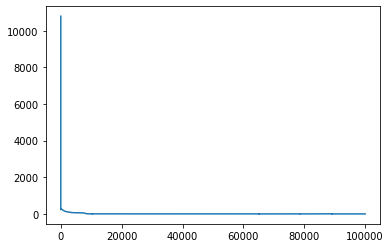

Epoch [105000/1000000] Loss:0.017996 Loss_1:0.000388 Loss_2:0.007307 Loss_3:0.000000 Loss_4:0.010300 Lr:0.001000 Time:67.899520s (23.27min in total, 198.34min remains)
Epoch [110000/1000000] Loss:0.039358 Loss_1:0.000029 Loss_2:0.025983 Loss_3:0.000000 Loss_4:0.013346 Lr:0.001000 Time:66.416448s (24.38min in total, 197.22min remains)
Epoch [115000/1000000] Loss:0.010953 Loss_1:0.000007 Loss_2:0.003179 Loss_3:0.000000 Loss_4:0.007767 Lr:0.001000 Time:66.513234s (25.48min in total, 196.12min remains)
Epoch [120000/1000000] Loss:0.048618 Loss_1:0.000180 Loss_2:0.040476 Loss_3:0.000000 Loss_4:0.007962 Lr:0.001000 Time:66.452471s (26.59min in total, 195.01min remains)
Epoch [125000/1000000] Loss:0.008993 Loss_1:0.000002 Loss_2:0.002548 Loss_3:0.000000 Loss_4:0.006443 Lr:0.001000 Time:66.591789s (27.70min in total, 193.91min remains)
Epoch [130000/1000000] Loss:0.066545 Loss_1:0.000021 Loss_2:0.007127 Loss_3:0.000000 Loss_4:0.059396 Lr:0.001000 Time:66.657548s (28.81min in total, 192.82min r

<Figure size 432x288 with 0 Axes>

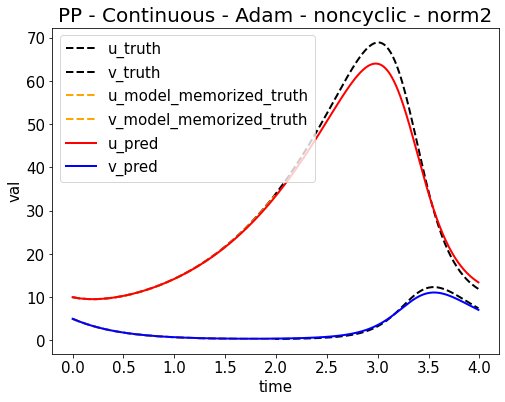

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653371472.png


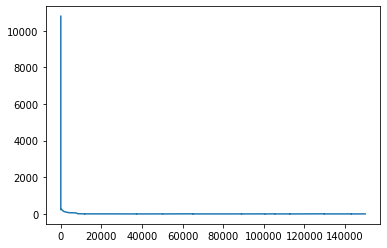

Epoch [155000/1000000] Loss:0.007198 Loss_1:0.000008 Loss_2:0.002053 Loss_3:0.000000 Loss_4:0.005137 Lr:0.001000 Time:67.951943s (34.39min in total, 187.50min remains)
Epoch [160000/1000000] Loss:0.008647 Loss_1:0.000004 Loss_2:0.002277 Loss_3:0.000000 Loss_4:0.006365 Lr:0.001000 Time:66.568576s (35.50min in total, 186.39min remains)
Epoch [165000/1000000] Loss:0.006006 Loss_1:0.000004 Loss_2:0.001835 Loss_3:0.000000 Loss_4:0.004166 Lr:0.001000 Time:66.648757s (36.61min in total, 185.29min remains)
Epoch [170000/1000000] Loss:0.007036 Loss_1:0.000004 Loss_2:0.002293 Loss_3:0.000000 Loss_4:0.004738 Lr:0.001000 Time:66.651506s (37.72min in total, 184.19min remains)
Epoch [175000/1000000] Loss:0.010667 Loss_1:0.000003 Loss_2:0.002535 Loss_3:0.000000 Loss_4:0.008129 Lr:0.001000 Time:66.337658s (38.83min in total, 183.06min remains)
Epoch [180000/1000000] Loss:0.005542 Loss_1:0.000003 Loss_2:0.001682 Loss_3:0.000000 Loss_4:0.003858 Lr:0.001000 Time:66.289460s (39.94min in total, 181.93min r

<Figure size 432x288 with 0 Axes>

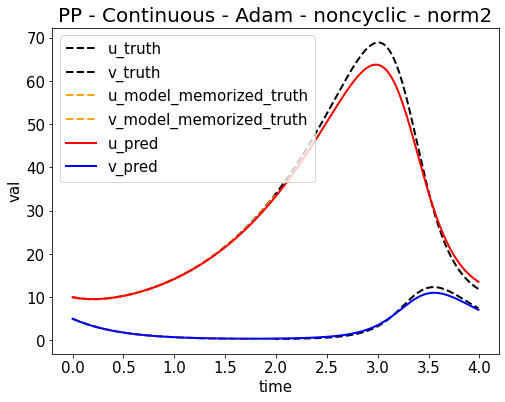

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653372138.png


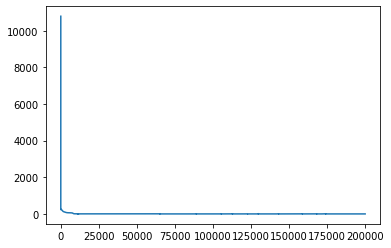

Epoch [205000/1000000] Loss:0.004830 Loss_1:0.000002 Loss_2:0.001342 Loss_3:0.000000 Loss_4:0.003486 Lr:0.001000 Time:68.191127s (45.50min in total, 176.44min remains)
Epoch [210000/1000000] Loss:0.023495 Loss_1:0.000359 Loss_2:0.019475 Loss_3:0.000000 Loss_4:0.003660 Lr:0.001000 Time:66.239795s (46.60min in total, 175.31min remains)
Epoch [215000/1000000] Loss:0.006543 Loss_1:0.000005 Loss_2:0.002461 Loss_3:0.000000 Loss_4:0.004076 Lr:0.001000 Time:66.442042s (47.71min in total, 174.19min remains)
Epoch [220000/1000000] Loss:0.004235 Loss_1:0.000005 Loss_2:0.001227 Loss_3:0.000000 Loss_4:0.003003 Lr:0.001000 Time:66.340211s (48.82min in total, 173.07min remains)
Epoch [225000/1000000] Loss:0.004861 Loss_1:0.000140 Loss_2:0.002347 Loss_3:0.000000 Loss_4:0.002375 Lr:0.001000 Time:66.414772s (49.92min in total, 171.95min remains)
Epoch [230000/1000000] Loss:0.004386 Loss_1:0.000003 Loss_2:0.001331 Loss_3:0.000000 Loss_4:0.003053 Lr:0.001000 Time:66.189160s (51.03min in total, 170.82min r

<Figure size 432x288 with 0 Axes>

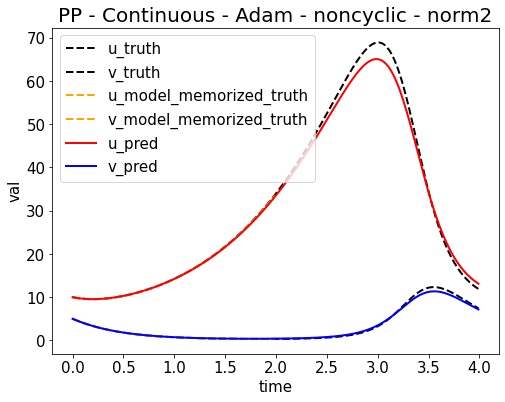

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653372803.png


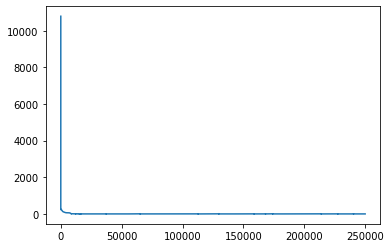

Epoch [255000/1000000] Loss:0.003557 Loss_1:0.000003 Loss_2:0.001168 Loss_3:0.000000 Loss_4:0.002385 Lr:0.001000 Time:68.068747s (56.58min in total, 165.30min remains)
Epoch [260000/1000000] Loss:0.004141 Loss_1:0.000001 Loss_2:0.001437 Loss_3:0.000000 Loss_4:0.002703 Lr:0.001000 Time:66.444612s (57.69min in total, 164.18min remains)
Epoch [265000/1000000] Loss:0.007950 Loss_1:0.000007 Loss_2:0.002290 Loss_3:0.000000 Loss_4:0.005652 Lr:0.001000 Time:66.105191s (58.79min in total, 163.05min remains)
Epoch [270000/1000000] Loss:0.004378 Loss_1:0.000037 Loss_2:0.001452 Loss_3:0.000000 Loss_4:0.002889 Lr:0.001000 Time:66.124648s (59.89min in total, 161.92min remains)
Epoch [275000/1000000] Loss:0.003508 Loss_1:0.000001 Loss_2:0.001104 Loss_3:0.000000 Loss_4:0.002402 Lr:0.001000 Time:66.194671s (60.99min in total, 160.80min remains)
Epoch [280000/1000000] Loss:0.008803 Loss_1:0.000002 Loss_2:0.006064 Loss_3:0.000000 Loss_4:0.002737 Lr:0.001000 Time:66.439538s (62.10min in total, 159.69min r

<Figure size 432x288 with 0 Axes>

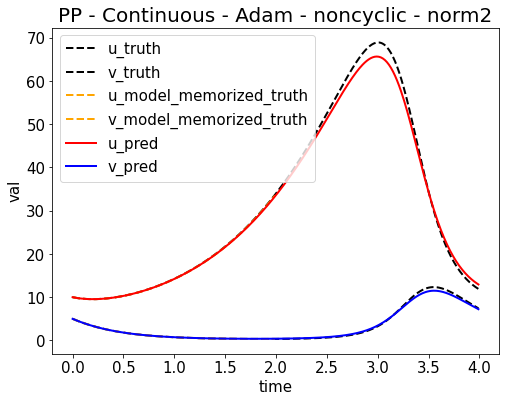

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653373467.png


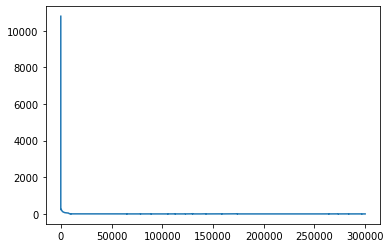

Epoch [305000/1000000] Loss:0.017258 Loss_1:0.000713 Loss_2:0.013725 Loss_3:0.000000 Loss_4:0.002820 Lr:0.001000 Time:68.379881s (67.66min in total, 154.17min remains)
Epoch [310000/1000000] Loss:0.008728 Loss_1:0.000030 Loss_2:0.007086 Loss_3:0.000000 Loss_4:0.001611 Lr:0.001000 Time:66.692389s (68.77min in total, 153.07min remains)
Epoch [315000/1000000] Loss:0.005728 Loss_1:0.000010 Loss_2:0.002161 Loss_3:0.000000 Loss_4:0.003557 Lr:0.001000 Time:66.470193s (69.88min in total, 151.95min remains)
Epoch [320000/1000000] Loss:0.021401 Loss_1:0.000097 Loss_2:0.018275 Loss_3:0.000000 Loss_4:0.003029 Lr:0.001000 Time:66.471042s (70.98min in total, 150.84min remains)
Epoch [325000/1000000] Loss:0.002999 Loss_1:0.000028 Loss_2:0.001182 Loss_3:0.000000 Loss_4:0.001788 Lr:0.001000 Time:66.396885s (72.09min in total, 149.73min remains)
Epoch [330000/1000000] Loss:0.002847 Loss_1:0.000026 Loss_2:0.001649 Loss_3:0.000000 Loss_4:0.001173 Lr:0.001000 Time:66.229728s (73.20min in total, 148.61min r

<Figure size 432x288 with 0 Axes>

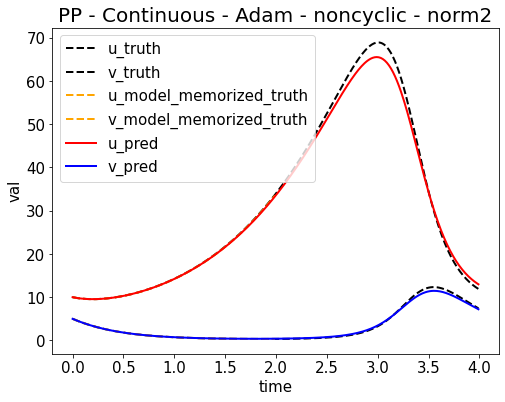

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653374133.png


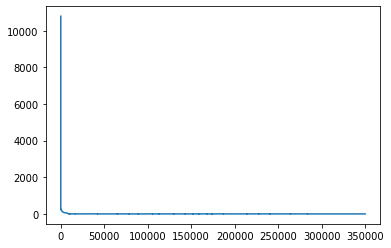

Epoch [355000/1000000] Loss:0.002107 Loss_1:0.000005 Loss_2:0.000717 Loss_3:0.000000 Loss_4:0.001385 Lr:0.001000 Time:68.298835s (78.76min in total, 143.09min remains)
Epoch [360000/1000000] Loss:0.010451 Loss_1:0.000047 Loss_2:0.009605 Loss_3:0.000000 Loss_4:0.000799 Lr:0.001000 Time:66.564732s (79.86min in total, 141.98min remains)
Epoch [365000/1000000] Loss:0.039077 Loss_1:0.000165 Loss_2:0.037810 Loss_3:0.000000 Loss_4:0.001102 Lr:0.001000 Time:66.256320s (80.97min in total, 140.86min remains)
Epoch [370000/1000000] Loss:0.002380 Loss_1:0.000002 Loss_2:0.000804 Loss_3:0.000000 Loss_4:0.001574 Lr:0.001000 Time:66.271335s (82.07min in total, 139.75min remains)
Epoch [375000/1000000] Loss:0.003220 Loss_1:0.000001 Loss_2:0.000821 Loss_3:0.000000 Loss_4:0.002397 Lr:0.001000 Time:66.418910s (83.18min in total, 138.63min remains)
Epoch [380000/1000000] Loss:0.002495 Loss_1:0.000005 Loss_2:0.000986 Loss_3:0.000000 Loss_4:0.001504 Lr:0.001000 Time:66.563628s (84.29min in total, 137.53min r

<Figure size 432x288 with 0 Axes>

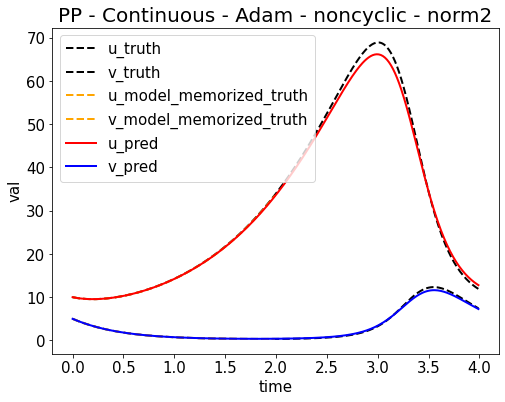

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653374800.png


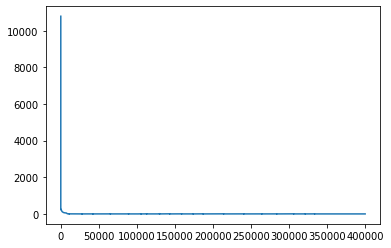

Epoch [405000/1000000] Loss:0.002180 Loss_1:0.000001 Loss_2:0.000691 Loss_3:0.000000 Loss_4:0.001487 Lr:0.001000 Time:68.556973s (89.86min in total, 132.02min remains)
Epoch [410000/1000000] Loss:0.002619 Loss_1:0.000004 Loss_2:0.001637 Loss_3:0.000000 Loss_4:0.000978 Lr:0.001000 Time:66.396138s (90.97min in total, 130.91min remains)
Epoch [415000/1000000] Loss:0.002526 Loss_1:0.000004 Loss_2:0.001302 Loss_3:0.000000 Loss_4:0.001219 Lr:0.001000 Time:66.670166s (92.08min in total, 129.80min remains)
Epoch [420000/1000000] Loss:0.002219 Loss_1:0.000061 Loss_2:0.001327 Loss_3:0.000000 Loss_4:0.000831 Lr:0.001000 Time:66.254077s (93.18min in total, 128.68min remains)
Epoch [425000/1000000] Loss:0.001990 Loss_1:0.000000 Loss_2:0.000629 Loss_3:0.000000 Loss_4:0.001361 Lr:0.001000 Time:65.838483s (94.28min in total, 127.56min remains)
Epoch [430000/1000000] Loss:0.002498 Loss_1:0.000002 Loss_2:0.000802 Loss_3:0.000000 Loss_4:0.001694 Lr:0.001000 Time:65.510454s (95.37min in total, 126.43min r

<Figure size 432x288 with 0 Axes>

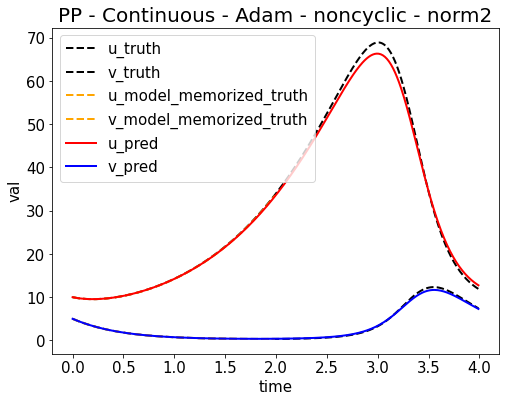

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653375460.png


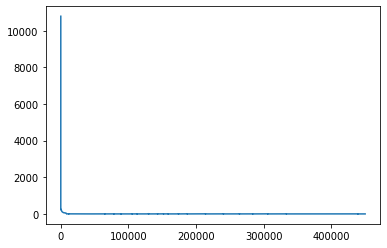

Epoch [455000/1000000] Loss:0.003804 Loss_1:0.000007 Loss_2:0.002844 Loss_3:0.000000 Loss_4:0.000953 Lr:0.001000 Time:68.157448s (100.87min in total, 120.82min remains)
Epoch [460000/1000000] Loss:0.001596 Loss_1:0.000001 Loss_2:0.000524 Loss_3:0.000000 Loss_4:0.001070 Lr:0.001000 Time:66.446923s (101.98min in total, 119.71min remains)
Epoch [465000/1000000] Loss:0.001615 Loss_1:0.000001 Loss_2:0.000761 Loss_3:0.000000 Loss_4:0.000853 Lr:0.001000 Time:66.418875s (103.09min in total, 118.60min remains)
Epoch [470000/1000000] Loss:0.001772 Loss_1:0.000001 Loss_2:0.000554 Loss_3:0.000000 Loss_4:0.001217 Lr:0.001000 Time:66.360200s (104.19min in total, 117.49min remains)
Epoch [475000/1000000] Loss:0.005041 Loss_1:0.000000 Loss_2:0.000874 Loss_3:0.000000 Loss_4:0.004167 Lr:0.001000 Time:66.874975s (105.31min in total, 116.39min remains)
Epoch [480000/1000000] Loss:0.001693 Loss_1:0.000003 Loss_2:0.000791 Loss_3:0.000000 Loss_4:0.000900 Lr:0.001000 Time:66.554056s (106.42min in total, 115.2

<Figure size 432x288 with 0 Axes>

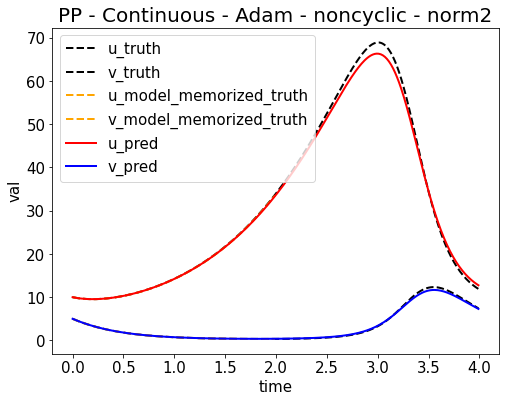

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653376127.png


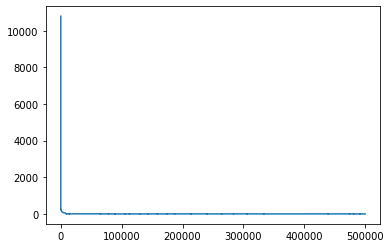

Epoch [505000/1000000] Loss:0.003258 Loss_1:0.000017 Loss_2:0.002108 Loss_3:0.000000 Loss_4:0.001132 Lr:0.001000 Time:69.047628s (111.99min in total, 109.77min remains)
Epoch [510000/1000000] Loss:0.001680 Loss_1:0.000001 Loss_2:0.000597 Loss_3:0.000000 Loss_4:0.001081 Lr:0.001000 Time:66.397273s (113.10min in total, 108.66min remains)
Epoch [515000/1000000] Loss:0.004329 Loss_1:0.000014 Loss_2:0.003096 Loss_3:0.000000 Loss_4:0.001219 Lr:0.001000 Time:66.249525s (114.20min in total, 107.55min remains)
Epoch [520000/1000000] Loss:0.004585 Loss_1:0.000176 Loss_2:0.003661 Loss_3:0.000000 Loss_4:0.000747 Lr:0.001000 Time:66.736421s (115.31min in total, 106.44min remains)
Epoch [525000/1000000] Loss:0.001507 Loss_1:0.000001 Loss_2:0.000665 Loss_3:0.000000 Loss_4:0.000841 Lr:0.001000 Time:66.574846s (116.42min in total, 105.33min remains)
Epoch [530000/1000000] Loss:0.002029 Loss_1:0.000032 Loss_2:0.001138 Loss_3:0.000000 Loss_4:0.000858 Lr:0.001000 Time:66.718686s (117.53min in total, 104.2

<Figure size 432x288 with 0 Axes>

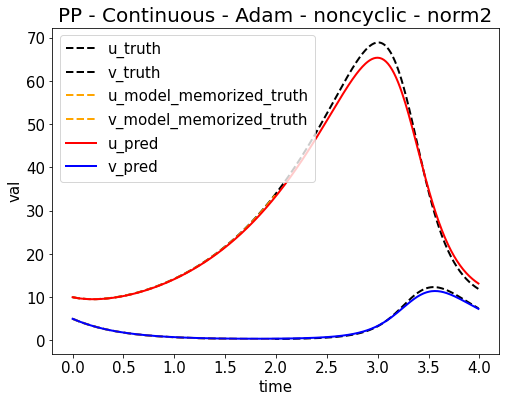

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653376795.png


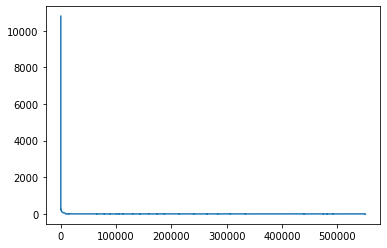

Epoch [555000/1000000] Loss:0.003430 Loss_1:0.000033 Loss_2:0.002061 Loss_3:0.000000 Loss_4:0.001336 Lr:0.001000 Time:68.701677s (123.12min in total, 98.71min remains)
Epoch [560000/1000000] Loss:0.006928 Loss_1:0.000096 Loss_2:0.006152 Loss_3:0.000000 Loss_4:0.000680 Lr:0.001000 Time:66.273390s (124.22min in total, 97.60min remains)
Epoch [565000/1000000] Loss:0.015535 Loss_1:0.000006 Loss_2:0.013774 Loss_3:0.000000 Loss_4:0.001755 Lr:0.001000 Time:66.540989s (125.33min in total, 96.49min remains)
Epoch [570000/1000000] Loss:0.055883 Loss_1:0.000420 Loss_2:0.050825 Loss_3:0.000000 Loss_4:0.004638 Lr:0.001000 Time:66.303787s (126.43min in total, 95.38min remains)
Epoch [575000/1000000] Loss:0.001463 Loss_1:0.000001 Loss_2:0.000475 Loss_3:0.000000 Loss_4:0.000987 Lr:0.001000 Time:66.557576s (127.54min in total, 94.27min remains)
Epoch [580000/1000000] Loss:0.002664 Loss_1:0.000001 Loss_2:0.000616 Loss_3:0.000000 Loss_4:0.002048 Lr:0.001000 Time:66.467516s (128.65min in total, 93.16min r

<Figure size 432x288 with 0 Axes>

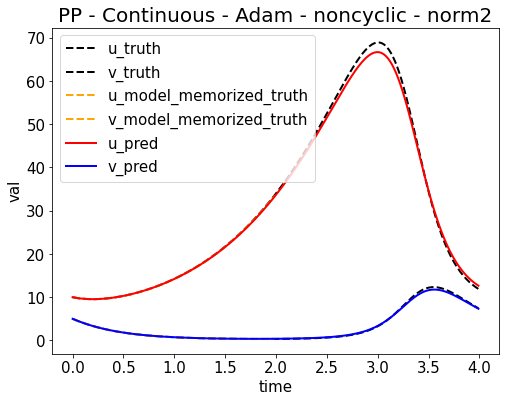

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653377461.png


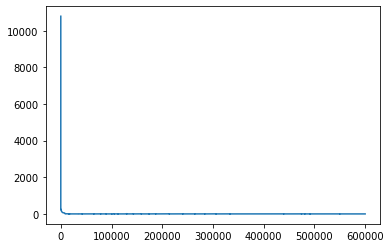

Epoch [605000/1000000] Loss:0.001113 Loss_1:0.000004 Loss_2:0.000479 Loss_3:0.000000 Loss_4:0.000629 Lr:0.001000 Time:69.181047s (134.23min in total, 87.64min remains)
Epoch [610000/1000000] Loss:0.005883 Loss_1:0.000053 Loss_2:0.004942 Loss_3:0.000000 Loss_4:0.000888 Lr:0.001000 Time:66.466250s (135.34min in total, 86.53min remains)
Epoch [615000/1000000] Loss:0.002205 Loss_1:0.000009 Loss_2:0.001192 Loss_3:0.000000 Loss_4:0.001004 Lr:0.001000 Time:66.264822s (136.45min in total, 85.42min remains)
Epoch [620000/1000000] Loss:0.001122 Loss_1:0.000001 Loss_2:0.000392 Loss_3:0.000000 Loss_4:0.000729 Lr:0.001000 Time:66.326952s (137.55min in total, 84.31min remains)
Epoch [625000/1000000] Loss:0.001387 Loss_1:0.000001 Loss_2:0.000429 Loss_3:0.000000 Loss_4:0.000957 Lr:0.001000 Time:66.474909s (138.66min in total, 83.20min remains)
Epoch [630000/1000000] Loss:0.002847 Loss_1:0.000000 Loss_2:0.000581 Loss_3:0.000000 Loss_4:0.002265 Lr:0.001000 Time:66.449490s (139.77min in total, 82.09min r

<Figure size 432x288 with 0 Axes>

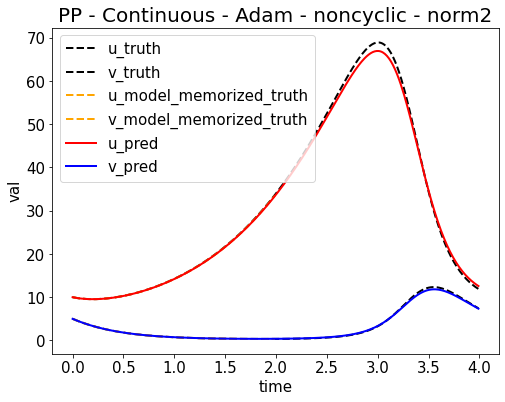

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653378128.png


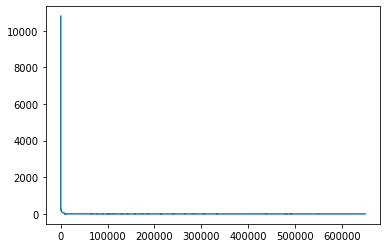

Epoch [655000/1000000] Loss:0.001112 Loss_1:0.000001 Loss_2:0.000383 Loss_3:0.000000 Loss_4:0.000728 Lr:0.001000 Time:69.116829s (145.35min in total, 76.56min remains)
Epoch [660000/1000000] Loss:0.001285 Loss_1:0.000001 Loss_2:0.000407 Loss_3:0.000000 Loss_4:0.000877 Lr:0.001000 Time:66.420253s (146.45min in total, 75.45min remains)
Epoch [665000/1000000] Loss:0.002858 Loss_1:0.000000 Loss_2:0.000517 Loss_3:0.000000 Loss_4:0.002341 Lr:0.001000 Time:66.440438s (147.56min in total, 74.33min remains)
Epoch [670000/1000000] Loss:0.003176 Loss_1:0.000000 Loss_2:0.000598 Loss_3:0.000000 Loss_4:0.002578 Lr:0.001000 Time:66.416436s (148.67min in total, 73.22min remains)
Epoch [675000/1000000] Loss:0.002062 Loss_1:0.000047 Loss_2:0.001419 Loss_3:0.000000 Loss_4:0.000596 Lr:0.001000 Time:66.361752s (149.77min in total, 72.11min remains)
Epoch [680000/1000000] Loss:0.001145 Loss_1:0.000019 Loss_2:0.000625 Loss_3:0.000000 Loss_4:0.000501 Lr:0.001000 Time:66.355712s (150.88min in total, 71.00min r

<Figure size 432x288 with 0 Axes>

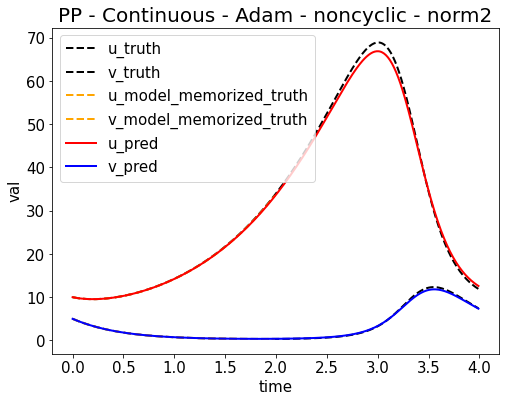

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653378795.png


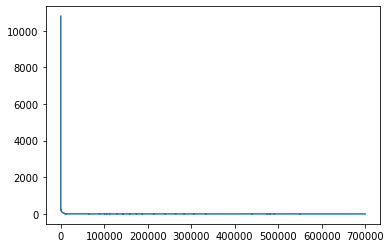

Epoch [705000/1000000] Loss:0.001150 Loss_1:0.000000 Loss_2:0.000434 Loss_3:0.000000 Loss_4:0.000716 Lr:0.001000 Time:69.085226s (156.46min in total, 65.47min remains)
Epoch [710000/1000000] Loss:0.001022 Loss_1:0.000001 Loss_2:0.000429 Loss_3:0.000000 Loss_4:0.000592 Lr:0.001000 Time:66.555777s (157.57min in total, 64.36min remains)
Epoch [715000/1000000] Loss:0.001029 Loss_1:0.000000 Loss_2:0.000365 Loss_3:0.000000 Loss_4:0.000664 Lr:0.001000 Time:66.440947s (158.67min in total, 63.25min remains)
Epoch [720000/1000000] Loss:0.002067 Loss_1:0.000003 Loss_2:0.001792 Loss_3:0.000000 Loss_4:0.000271 Lr:0.001000 Time:66.905938s (159.79min in total, 62.14min remains)
Epoch [725000/1000000] Loss:0.001529 Loss_1:0.000037 Loss_2:0.000957 Loss_3:0.000000 Loss_4:0.000534 Lr:0.001000 Time:66.493889s (160.90min in total, 61.03min remains)
Epoch [730000/1000000] Loss:0.036331 Loss_1:0.000047 Loss_2:0.034446 Loss_3:0.000000 Loss_4:0.001838 Lr:0.001000 Time:67.029169s (162.01min in total, 59.92min r

<Figure size 432x288 with 0 Axes>

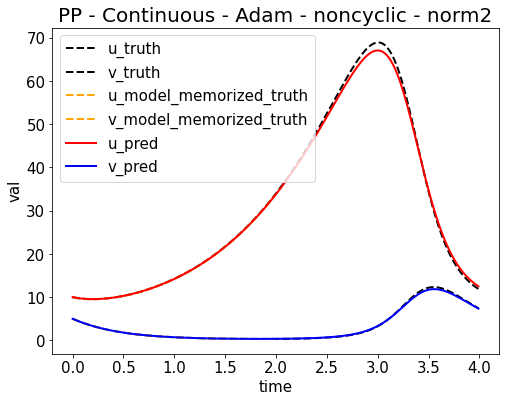

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653379463.png


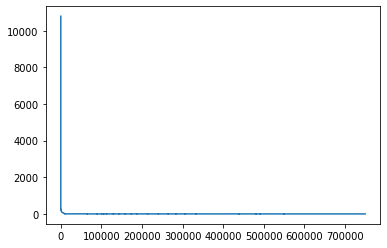

Epoch [755000/1000000] Loss:0.001908 Loss_1:0.000009 Loss_2:0.001270 Loss_3:0.000000 Loss_4:0.000630 Lr:0.001000 Time:69.548850s (167.60min in total, 54.39min remains)
Epoch [760000/1000000] Loss:0.001632 Loss_1:0.000042 Loss_2:0.000965 Loss_3:0.000000 Loss_4:0.000625 Lr:0.001000 Time:66.565096s (168.71min in total, 53.28min remains)
Epoch [765000/1000000] Loss:0.001766 Loss_1:0.000001 Loss_2:0.001055 Loss_3:0.000000 Loss_4:0.000709 Lr:0.001000 Time:66.572685s (169.82min in total, 52.17min remains)
Epoch [770000/1000000] Loss:0.000826 Loss_1:0.000000 Loss_2:0.000319 Loss_3:0.000000 Loss_4:0.000506 Lr:0.001000 Time:66.235185s (170.92min in total, 51.06min remains)
Epoch [775000/1000000] Loss:0.002787 Loss_1:0.000003 Loss_2:0.002542 Loss_3:0.000000 Loss_4:0.000241 Lr:0.001000 Time:66.452795s (172.03min in total, 49.94min remains)
Epoch [780000/1000000] Loss:0.004570 Loss_1:0.000017 Loss_2:0.004158 Loss_3:0.000000 Loss_4:0.000395 Lr:0.001000 Time:66.516287s (173.14min in total, 48.83min r

<Figure size 432x288 with 0 Axes>

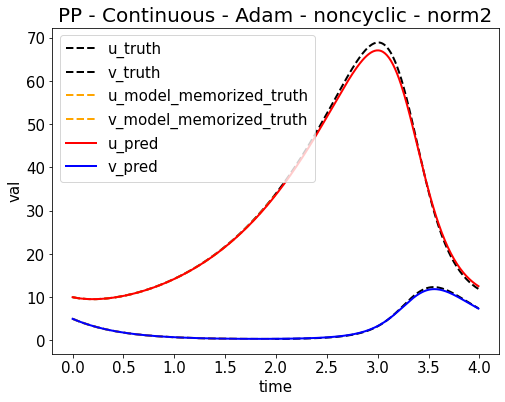

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653380130.png


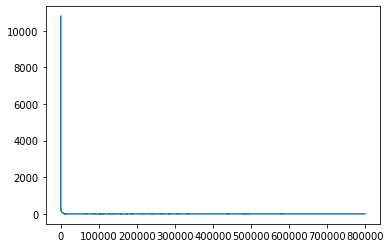

Epoch [805000/1000000] Loss:0.005168 Loss_1:0.000038 Loss_2:0.004537 Loss_3:0.000000 Loss_4:0.000593 Lr:0.001000 Time:69.483894s (178.73min in total, 43.29min remains)
Epoch [810000/1000000] Loss:0.019633 Loss_1:0.000059 Loss_2:0.018766 Loss_3:0.000000 Loss_4:0.000808 Lr:0.001000 Time:66.816889s (179.84min in total, 42.18min remains)
Epoch [815000/1000000] Loss:0.001204 Loss_1:0.000001 Loss_2:0.000531 Loss_3:0.000000 Loss_4:0.000671 Lr:0.001000 Time:66.475322s (180.95min in total, 41.07min remains)
Epoch [820000/1000000] Loss:0.001052 Loss_1:0.000003 Loss_2:0.000523 Loss_3:0.000000 Loss_4:0.000525 Lr:0.001000 Time:66.736041s (182.06min in total, 39.96min remains)
Epoch [825000/1000000] Loss:0.000870 Loss_1:0.000000 Loss_2:0.000415 Loss_3:0.000000 Loss_4:0.000455 Lr:0.001000 Time:66.662082s (183.17min in total, 38.85min remains)
Epoch [830000/1000000] Loss:0.001102 Loss_1:0.000002 Loss_2:0.000673 Loss_3:0.000000 Loss_4:0.000428 Lr:0.001000 Time:66.696996s (184.28min in total, 37.74min r

<Figure size 432x288 with 0 Axes>

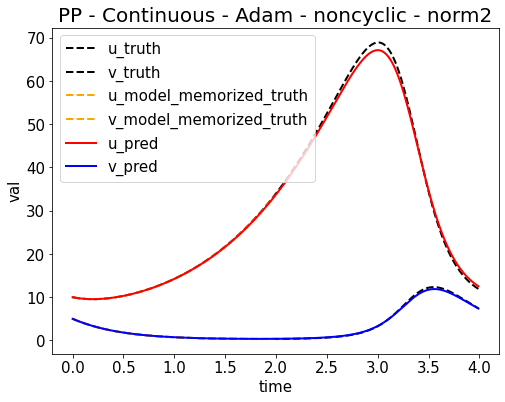

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653380799.png


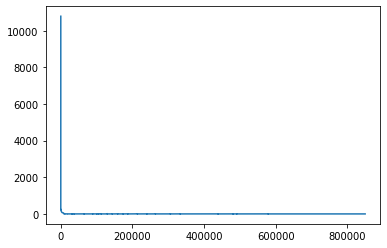

Epoch [855000/1000000] Loss:0.001085 Loss_1:0.000011 Loss_2:0.000526 Loss_3:0.000000 Loss_4:0.000548 Lr:0.001000 Time:69.339945s (189.87min in total, 32.20min remains)
Epoch [860000/1000000] Loss:0.000885 Loss_1:0.000001 Loss_2:0.000398 Loss_3:0.000000 Loss_4:0.000486 Lr:0.001000 Time:66.269365s (190.98min in total, 31.09min remains)
Epoch [865000/1000000] Loss:0.010529 Loss_1:0.000015 Loss_2:0.010058 Loss_3:0.000000 Loss_4:0.000455 Lr:0.001000 Time:66.348631s (192.08min in total, 29.98min remains)
Epoch [870000/1000000] Loss:0.001838 Loss_1:0.000015 Loss_2:0.001570 Loss_3:0.000000 Loss_4:0.000252 Lr:0.001000 Time:66.550653s (193.19min in total, 28.87min remains)
Epoch [875000/1000000] Loss:0.002136 Loss_1:0.000009 Loss_2:0.001641 Loss_3:0.000000 Loss_4:0.000487 Lr:0.001000 Time:66.470624s (194.30min in total, 27.76min remains)
Epoch [880000/1000000] Loss:0.002044 Loss_1:0.000087 Loss_2:0.001638 Loss_3:0.000000 Loss_4:0.000319 Lr:0.001000 Time:66.360371s (195.40min in total, 26.65min r

<Figure size 432x288 with 0 Axes>

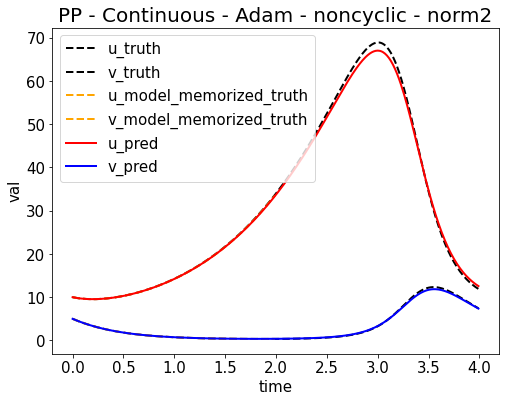

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653381467.png


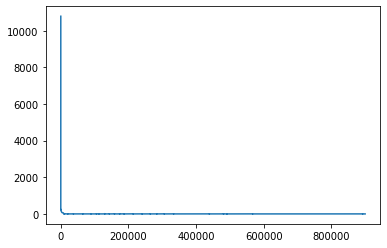

Epoch [905000/1000000] Loss:0.004175 Loss_1:0.000009 Loss_2:0.003755 Loss_3:0.000000 Loss_4:0.000410 Lr:0.001000 Time:69.164288s (200.99min in total, 21.10min remains)
Epoch [910000/1000000] Loss:0.002284 Loss_1:0.000049 Loss_2:0.001716 Loss_3:0.000000 Loss_4:0.000519 Lr:0.001000 Time:66.424403s (202.10min in total, 19.99min remains)
Epoch [915000/1000000] Loss:0.003592 Loss_1:0.000002 Loss_2:0.000544 Loss_3:0.000000 Loss_4:0.003045 Lr:0.001000 Time:66.556943s (203.20min in total, 18.88min remains)
Epoch [920000/1000000] Loss:0.001989 Loss_1:0.000001 Loss_2:0.001651 Loss_3:0.000000 Loss_4:0.000337 Lr:0.001000 Time:66.343541s (204.31min in total, 17.77min remains)
Epoch [925000/1000000] Loss:0.006484 Loss_1:0.000329 Loss_2:0.005308 Loss_3:0.000000 Loss_4:0.000847 Lr:0.001000 Time:66.347544s (205.42min in total, 16.66min remains)
Epoch [930000/1000000] Loss:0.003351 Loss_1:0.000064 Loss_2:0.002559 Loss_3:0.000000 Loss_4:0.000728 Lr:0.001000 Time:66.421654s (206.52min in total, 15.54min r

<Figure size 432x288 with 0 Axes>

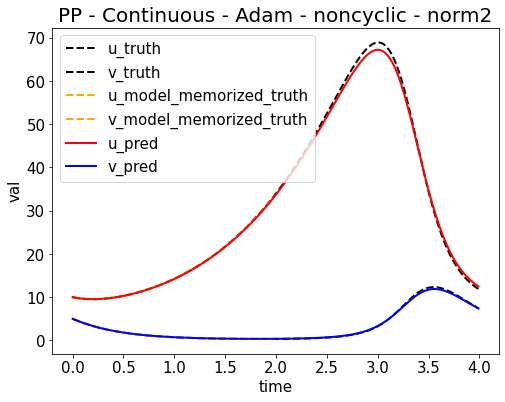

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653382133.png


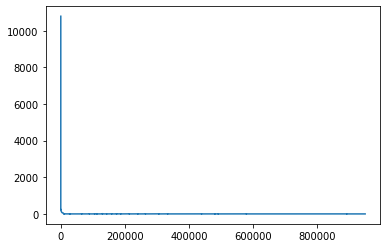

Epoch [955000/1000000] Loss:0.000793 Loss_1:0.000001 Loss_2:0.000303 Loss_3:0.000000 Loss_4:0.000489 Lr:0.001000 Time:69.706073s (212.11min in total, 9.99min remains)
Epoch [960000/1000000] Loss:0.002049 Loss_1:0.000000 Loss_2:0.000385 Loss_3:0.000000 Loss_4:0.001664 Lr:0.001000 Time:66.474705s (213.22min in total, 8.88min remains)
Epoch [965000/1000000] Loss:0.001868 Loss_1:0.000006 Loss_2:0.001303 Loss_3:0.000000 Loss_4:0.000560 Lr:0.001000 Time:66.239911s (214.32min in total, 7.77min remains)
Epoch [970000/1000000] Loss:0.000806 Loss_1:0.000000 Loss_2:0.000321 Loss_3:0.000000 Loss_4:0.000484 Lr:0.001000 Time:66.167302s (215.42min in total, 6.66min remains)
Epoch [975000/1000000] Loss:0.001683 Loss_1:0.000011 Loss_2:0.001132 Loss_3:0.000000 Loss_4:0.000541 Lr:0.001000 Time:66.449224s (216.53min in total, 5.55min remains)
Epoch [980000/1000000] Loss:0.004404 Loss_1:0.000003 Loss_2:0.004334 Loss_3:0.000000 Loss_4:0.000067 Lr:0.001000 Time:66.663365s (217.64min in total, 4.44min remains

<Figure size 432x288 with 0 Axes>

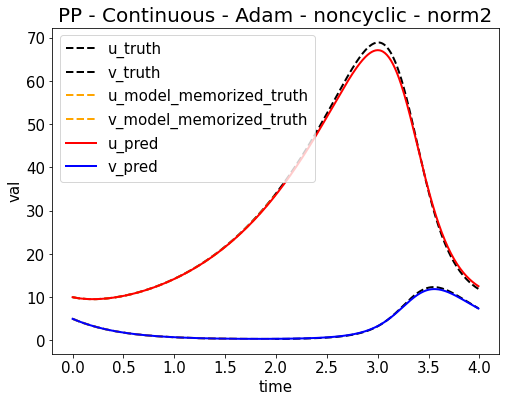

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653382801.png


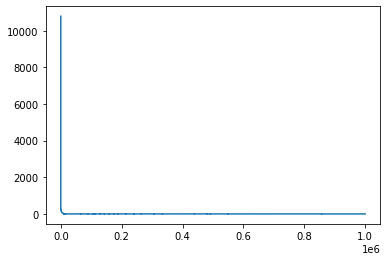

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 2, length of truth = 400 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.1

<Figure size 432x288 with 0 Axes>

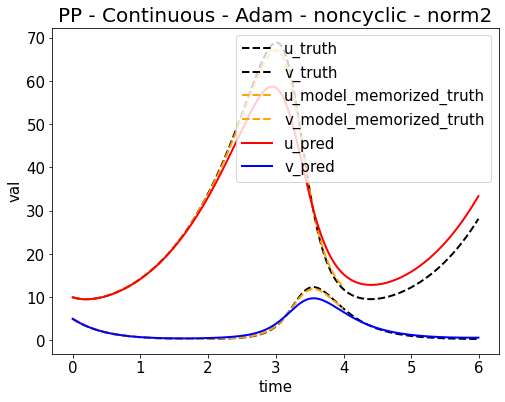

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653383515.png


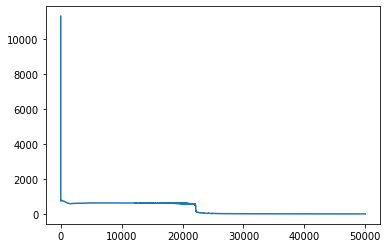

Epoch [55000/1000000] Loss:5.284538 Loss_1:0.000037 Loss_2:0.046025 Loss_3:0.000000 Loss_4:5.238475 Lr:0.001000 Time:72.477566s (13.05min in total, 224.26min remains)
Epoch [60000/1000000] Loss:4.575942 Loss_1:0.000011 Loss_2:0.005366 Loss_3:0.000000 Loss_4:4.570565 Lr:0.001000 Time:71.121902s (14.24min in total, 223.05min remains)
Epoch [65000/1000000] Loss:4.001073 Loss_1:0.000013 Loss_2:0.005521 Loss_3:0.000000 Loss_4:3.995539 Lr:0.001000 Time:70.997497s (15.42min in total, 221.82min remains)
Epoch [70000/1000000] Loss:3.485843 Loss_1:0.000006 Loss_2:0.004166 Loss_3:0.000000 Loss_4:3.481671 Lr:0.001000 Time:71.004318s (16.60min in total, 220.60min remains)
Epoch [75000/1000000] Loss:3.089178 Loss_1:0.000006 Loss_2:0.003540 Loss_3:0.000000 Loss_4:3.085632 Lr:0.001000 Time:71.377345s (17.79min in total, 219.46min remains)
Epoch [80000/1000000] Loss:2.797786 Loss_1:0.000024 Loss_2:0.004142 Loss_3:0.000000 Loss_4:2.793619 Lr:0.001000 Time:70.934002s (18.98min in total, 218.22min remains

<Figure size 432x288 with 0 Axes>

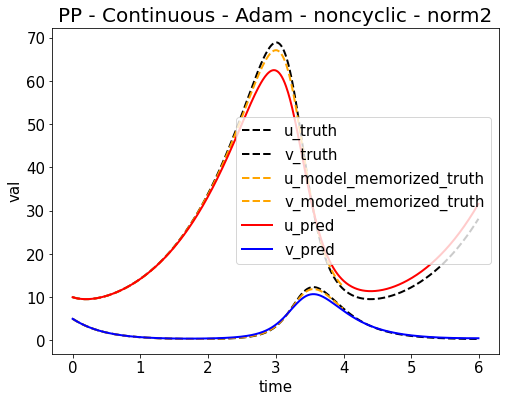

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653384227.png


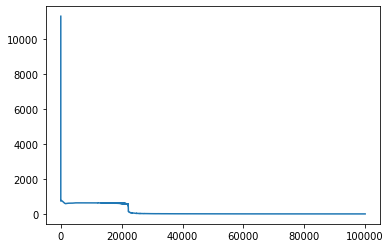

Epoch [105000/1000000] Loss:1.678222 Loss_1:0.000005 Loss_2:0.006689 Loss_3:0.000000 Loss_4:1.671528 Lr:0.001000 Time:72.582636s (24.93min in total, 212.47min remains)
Epoch [110000/1000000] Loss:1.578476 Loss_1:0.000026 Loss_2:0.003769 Loss_3:0.000000 Loss_4:1.574681 Lr:0.001000 Time:71.171118s (26.11min in total, 211.28min remains)
Epoch [115000/1000000] Loss:1.424756 Loss_1:0.000180 Loss_2:0.014260 Loss_3:0.000000 Loss_4:1.410315 Lr:0.001000 Time:71.173798s (27.30min in total, 210.09min remains)
Epoch [120000/1000000] Loss:1.312308 Loss_1:0.000012 Loss_2:0.002250 Loss_3:0.000000 Loss_4:1.310046 Lr:0.001000 Time:71.200144s (28.49min in total, 208.90min remains)
Epoch [125000/1000000] Loss:1.222171 Loss_1:0.000002 Loss_2:0.001677 Loss_3:0.000000 Loss_4:1.220492 Lr:0.001000 Time:71.119306s (29.67min in total, 207.70min remains)
Epoch [130000/1000000] Loss:1.118138 Loss_1:0.000101 Loss_2:0.004040 Loss_3:0.000000 Loss_4:1.113996 Lr:0.001000 Time:71.216553s (30.86min in total, 206.51min r

<Figure size 432x288 with 0 Axes>

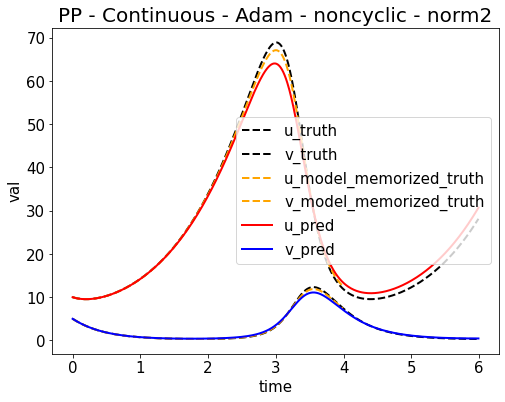

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653384943.png


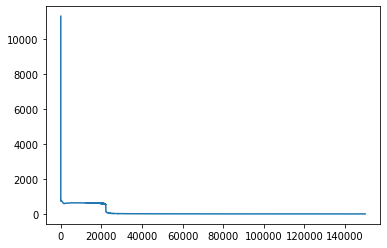

Epoch [155000/1000000] Loss:0.816760 Loss_1:0.000044 Loss_2:0.002359 Loss_3:0.000000 Loss_4:0.814357 Lr:0.001000 Time:73.812173s (36.88min in total, 201.05min remains)
Epoch [160000/1000000] Loss:0.745529 Loss_1:0.000128 Loss_2:0.009239 Loss_3:0.000000 Loss_4:0.736162 Lr:0.001000 Time:72.187989s (38.08min in total, 199.93min remains)
Epoch [165000/1000000] Loss:0.726644 Loss_1:0.000030 Loss_2:0.007360 Loss_3:0.000000 Loss_4:0.719253 Lr:0.001000 Time:72.039667s (39.28min in total, 198.80min remains)
Epoch [170000/1000000] Loss:0.677546 Loss_1:0.000012 Loss_2:0.002097 Loss_3:0.000000 Loss_4:0.675437 Lr:0.001000 Time:72.004146s (40.48min in total, 197.65min remains)
Epoch [175000/1000000] Loss:0.640197 Loss_1:0.000012 Loss_2:0.004734 Loss_3:0.000000 Loss_4:0.635450 Lr:0.001000 Time:71.879941s (41.68min in total, 196.50min remains)
Epoch [180000/1000000] Loss:0.613651 Loss_1:0.000002 Loss_2:0.001186 Loss_3:0.000000 Loss_4:0.612463 Lr:0.001000 Time:71.988087s (42.88min in total, 195.35min r

<Figure size 432x288 with 0 Axes>

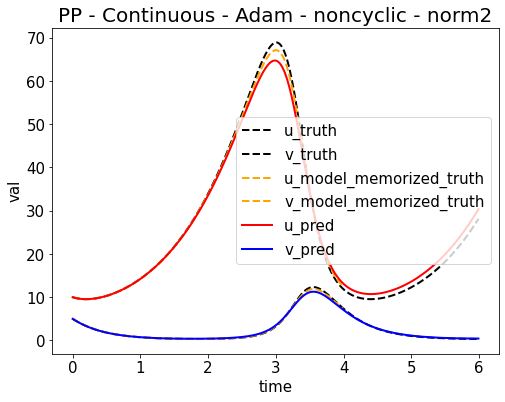

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653385664.png


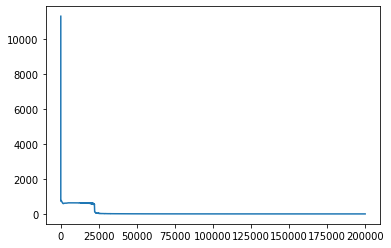

Epoch [205000/1000000] Loss:0.479741 Loss_1:0.000035 Loss_2:0.002435 Loss_3:0.000000 Loss_4:0.477270 Lr:0.001000 Time:73.725586s (48.90min in total, 189.63min remains)
Epoch [210000/1000000] Loss:0.470793 Loss_1:0.000002 Loss_2:0.001313 Loss_3:0.000000 Loss_4:0.469478 Lr:0.001000 Time:72.207595s (50.10min in total, 188.48min remains)
Epoch [215000/1000000] Loss:0.439666 Loss_1:0.000010 Loss_2:0.002971 Loss_3:0.000000 Loss_4:0.436685 Lr:0.001000 Time:71.791007s (51.30min in total, 187.30min remains)
Epoch [220000/1000000] Loss:0.416397 Loss_1:0.000016 Loss_2:0.006755 Loss_3:0.000000 Loss_4:0.409626 Lr:0.001000 Time:71.939633s (52.50min in total, 186.13min remains)
Epoch [225000/1000000] Loss:0.406209 Loss_1:0.000307 Loss_2:0.005186 Loss_3:0.000000 Loss_4:0.400716 Lr:0.001000 Time:72.216217s (53.70min in total, 184.97min remains)
Epoch [230000/1000000] Loss:0.395333 Loss_1:0.000369 Loss_2:0.034082 Loss_3:0.000000 Loss_4:0.360882 Lr:0.001000 Time:72.273865s (54.91min in total, 183.82min r

<Figure size 432x288 with 0 Axes>

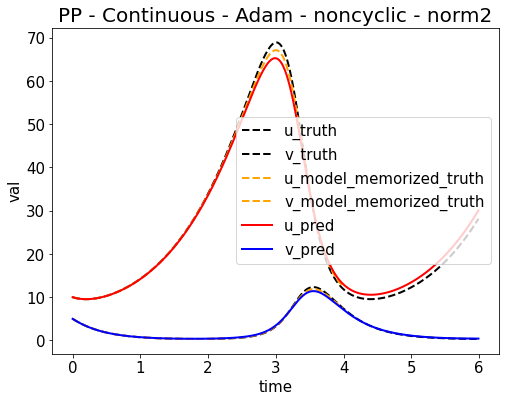

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653386387.png


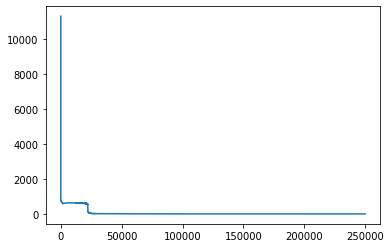

Epoch [255000/1000000] Loss:0.301433 Loss_1:0.000028 Loss_2:0.010085 Loss_3:0.000000 Loss_4:0.291320 Lr:0.001000 Time:74.051175s (60.95min in total, 178.07min remains)
Epoch [260000/1000000] Loss:0.315381 Loss_1:0.000001 Loss_2:0.000865 Loss_3:0.000000 Loss_4:0.314515 Lr:0.001000 Time:72.285939s (62.16min in total, 176.90min remains)
Epoch [265000/1000000] Loss:0.283339 Loss_1:0.000024 Loss_2:0.005929 Loss_3:0.000000 Loss_4:0.277385 Lr:0.001000 Time:72.254713s (63.36min in total, 175.73min remains)
Epoch [270000/1000000] Loss:0.277192 Loss_1:0.000110 Loss_2:0.006714 Loss_3:0.000000 Loss_4:0.270368 Lr:0.001000 Time:72.249868s (64.56min in total, 174.56min remains)
Epoch [275000/1000000] Loss:0.264385 Loss_1:0.000001 Loss_2:0.002228 Loss_3:0.000000 Loss_4:0.262156 Lr:0.001000 Time:72.251332s (65.77min in total, 173.39min remains)
Epoch [280000/1000000] Loss:0.258207 Loss_1:0.000021 Loss_2:0.004125 Loss_3:0.000000 Loss_4:0.254061 Lr:0.001000 Time:72.132842s (66.97min in total, 172.21min r

<Figure size 432x288 with 0 Axes>

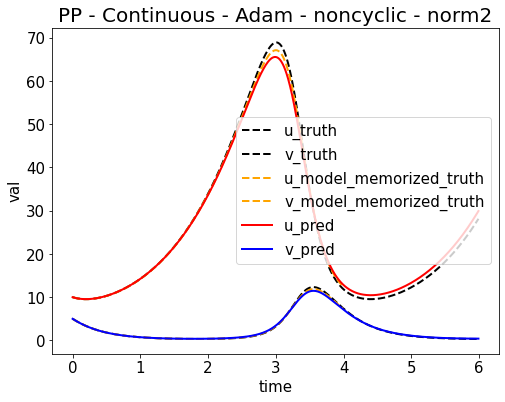

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653387110.png


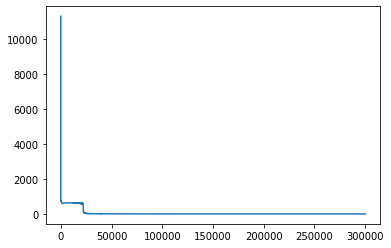

Epoch [305000/1000000] Loss:0.219451 Loss_1:0.000006 Loss_2:0.002671 Loss_3:0.000000 Loss_4:0.216775 Lr:0.001000 Time:73.891654s (72.99min in total, 166.32min remains)
Epoch [310000/1000000] Loss:0.227777 Loss_1:0.000364 Loss_2:0.022290 Loss_3:0.000000 Loss_4:0.205122 Lr:0.001000 Time:71.913830s (74.19min in total, 165.13min remains)
Epoch [315000/1000000] Loss:0.204427 Loss_1:0.000001 Loss_2:0.000975 Loss_3:0.000000 Loss_4:0.203450 Lr:0.001000 Time:71.173897s (75.37min in total, 163.91min remains)
Epoch [320000/1000000] Loss:0.195011 Loss_1:0.000001 Loss_2:0.006956 Loss_3:0.000000 Loss_4:0.188054 Lr:0.001000 Time:71.248631s (76.56min in total, 162.69min remains)
Epoch [325000/1000000] Loss:0.184719 Loss_1:0.000137 Loss_2:0.003242 Loss_3:0.000000 Loss_4:0.181340 Lr:0.001000 Time:70.886673s (77.74min in total, 161.46min remains)
Epoch [330000/1000000] Loss:0.181907 Loss_1:0.000066 Loss_2:0.002463 Loss_3:0.000000 Loss_4:0.179377 Lr:0.001000 Time:71.212833s (78.93min in total, 160.25min r

<Figure size 432x288 with 0 Axes>

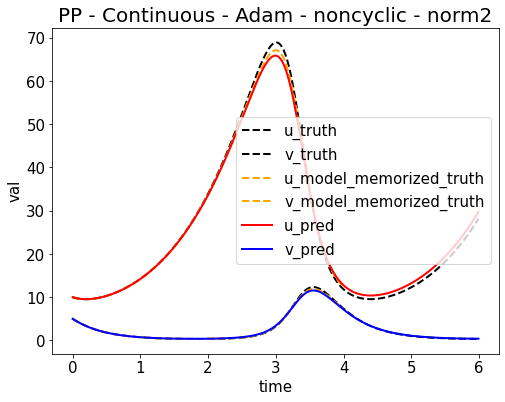

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653387825.png


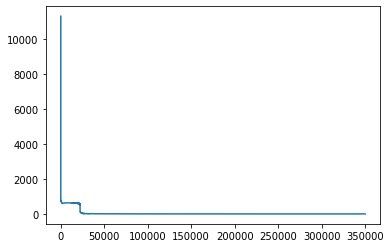

Epoch [355000/1000000] Loss:0.144328 Loss_1:0.000010 Loss_2:0.002024 Loss_3:0.000000 Loss_4:0.142293 Lr:0.001000 Time:73.051748s (84.89min in total, 154.24min remains)
Epoch [360000/1000000] Loss:0.146231 Loss_1:0.000353 Loss_2:0.008520 Loss_3:0.000000 Loss_4:0.137358 Lr:0.001000 Time:71.070619s (86.07min in total, 153.02min remains)
Epoch [365000/1000000] Loss:0.134231 Loss_1:0.000110 Loss_2:0.002580 Loss_3:0.000000 Loss_4:0.131540 Lr:0.001000 Time:71.281013s (87.26min in total, 151.81min remains)
Epoch [370000/1000000] Loss:0.146018 Loss_1:0.000273 Loss_2:0.017775 Loss_3:0.000000 Loss_4:0.127971 Lr:0.001000 Time:71.240629s (88.45min in total, 150.60min remains)
Epoch [375000/1000000] Loss:0.127086 Loss_1:0.000002 Loss_2:0.000570 Loss_3:0.000000 Loss_4:0.126514 Lr:0.001000 Time:70.956289s (89.63min in total, 149.39min remains)
Epoch [380000/1000000] Loss:0.130876 Loss_1:0.000032 Loss_2:0.006465 Loss_3:0.000000 Loss_4:0.124379 Lr:0.001000 Time:71.380033s (90.82min in total, 148.18min r

<Figure size 432x288 with 0 Axes>

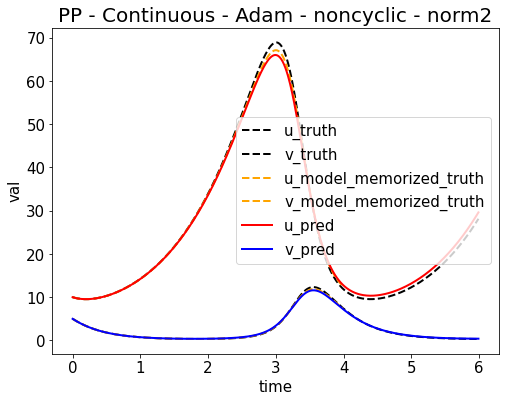

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653388540.png


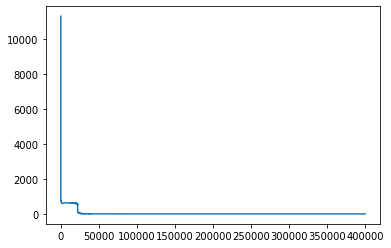

Epoch [405000/1000000] Loss:0.110565 Loss_1:0.000009 Loss_2:0.002523 Loss_3:0.000000 Loss_4:0.108033 Lr:0.001000 Time:73.585067s (96.82min in total, 142.24min remains)
Epoch [410000/1000000] Loss:0.111514 Loss_1:0.000083 Loss_2:0.009928 Loss_3:0.000000 Loss_4:0.101503 Lr:0.001000 Time:71.462840s (98.01min in total, 141.03min remains)
Epoch [415000/1000000] Loss:0.104678 Loss_1:0.000004 Loss_2:0.002358 Loss_3:0.000000 Loss_4:0.102315 Lr:0.001000 Time:71.284533s (99.20min in total, 139.83min remains)
Epoch [420000/1000000] Loss:0.106077 Loss_1:0.000003 Loss_2:0.007286 Loss_3:0.000000 Loss_4:0.098787 Lr:0.001000 Time:71.426029s (100.39min in total, 138.63min remains)
Epoch [425000/1000000] Loss:0.100559 Loss_1:0.000002 Loss_2:0.003587 Loss_3:0.000000 Loss_4:0.096970 Lr:0.001000 Time:71.270524s (101.57min in total, 137.42min remains)
Epoch [430000/1000000] Loss:0.097973 Loss_1:0.000000 Loss_2:0.000445 Loss_3:0.000000 Loss_4:0.097528 Lr:0.001000 Time:71.145677s (102.76min in total, 136.22mi

<Figure size 432x288 with 0 Axes>

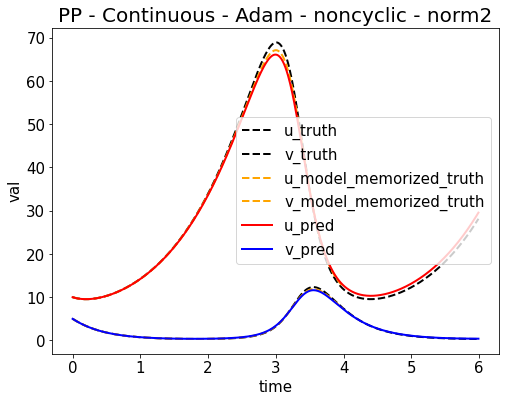

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653389255.png


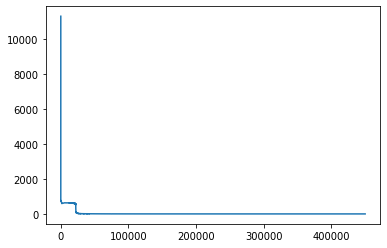

Epoch [455000/1000000] Loss:0.083060 Loss_1:0.000001 Loss_2:0.001631 Loss_3:0.000000 Loss_4:0.081427 Lr:0.001000 Time:73.727485s (108.74min in total, 130.25min remains)
Epoch [460000/1000000] Loss:0.082222 Loss_1:0.000001 Loss_2:0.001223 Loss_3:0.000000 Loss_4:0.080998 Lr:0.001000 Time:72.010363s (109.94min in total, 129.06min remains)
Epoch [465000/1000000] Loss:0.079612 Loss_1:0.000001 Loss_2:0.000488 Loss_3:0.000000 Loss_4:0.079123 Lr:0.001000 Time:71.854637s (111.14min in total, 127.87min remains)
Epoch [470000/1000000] Loss:0.081188 Loss_1:0.000001 Loss_2:0.000384 Loss_3:0.000000 Loss_4:0.080803 Lr:0.001000 Time:71.708478s (112.34min in total, 126.68min remains)
Epoch [475000/1000000] Loss:0.078207 Loss_1:0.000013 Loss_2:0.002304 Loss_3:0.000000 Loss_4:0.075890 Lr:0.001000 Time:71.770621s (113.53min in total, 125.48min remains)
Epoch [480000/1000000] Loss:0.077767 Loss_1:0.000184 Loss_2:0.006356 Loss_3:0.000000 Loss_4:0.071227 Lr:0.001000 Time:71.692878s (114.73min in total, 124.2

<Figure size 432x288 with 0 Axes>

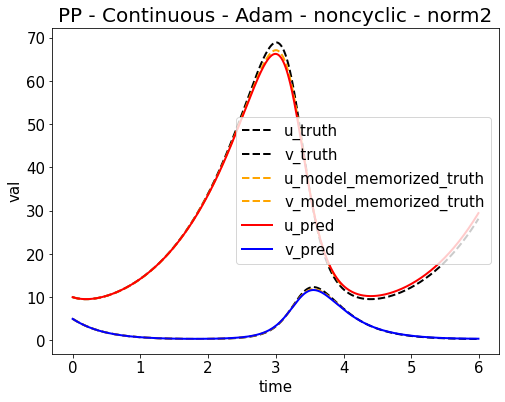

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653389975.png


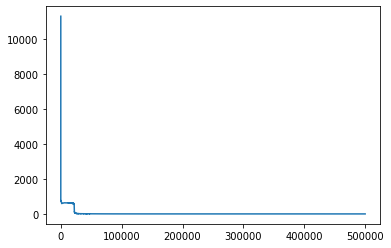

Epoch [505000/1000000] Loss:0.082132 Loss_1:0.000614 Loss_2:0.009860 Loss_3:0.000000 Loss_4:0.071658 Lr:0.001000 Time:74.393823s (120.75min in total, 118.36min remains)
Epoch [510000/1000000] Loss:0.067340 Loss_1:0.000075 Loss_2:0.004087 Loss_3:0.000000 Loss_4:0.063177 Lr:0.001000 Time:71.564626s (121.95min in total, 117.16min remains)
Epoch [515000/1000000] Loss:0.068589 Loss_1:0.000035 Loss_2:0.004660 Loss_3:0.000000 Loss_4:0.063894 Lr:0.001000 Time:71.465740s (123.14min in total, 115.96min remains)
Epoch [520000/1000000] Loss:0.062804 Loss_1:0.000008 Loss_2:0.000759 Loss_3:0.000000 Loss_4:0.062037 Lr:0.001000 Time:71.336321s (124.33min in total, 114.76min remains)
Epoch [525000/1000000] Loss:0.066253 Loss_1:0.000092 Loss_2:0.004071 Loss_3:0.000000 Loss_4:0.062090 Lr:0.001000 Time:71.250293s (125.51min in total, 113.56min remains)
Epoch [530000/1000000] Loss:0.059253 Loss_1:0.000015 Loss_2:0.000835 Loss_3:0.000000 Loss_4:0.058402 Lr:0.001000 Time:71.081194s (126.70min in total, 112.3

<Figure size 432x288 with 0 Axes>

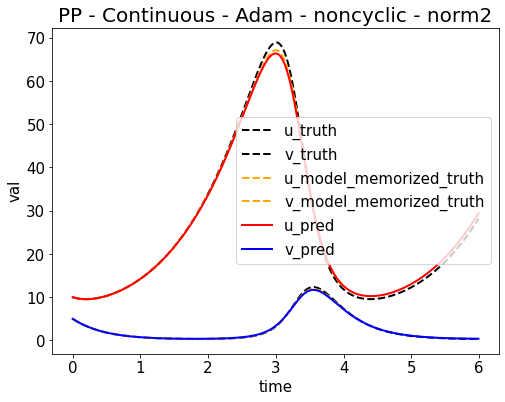

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653390690.png


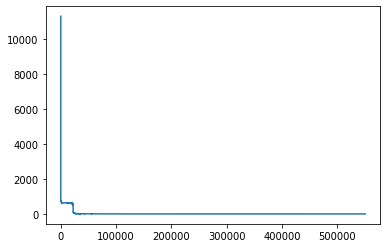

Epoch [555000/1000000] Loss:0.056892 Loss_1:0.000085 Loss_2:0.005634 Loss_3:0.000000 Loss_4:0.051173 Lr:0.001000 Time:73.327157s (132.66min in total, 106.37min remains)
Epoch [560000/1000000] Loss:0.052475 Loss_1:0.000005 Loss_2:0.000678 Loss_3:0.000000 Loss_4:0.051792 Lr:0.001000 Time:70.970573s (133.84min in total, 105.16min remains)
Epoch [565000/1000000] Loss:0.061276 Loss_1:0.000015 Loss_2:0.013798 Loss_3:0.000000 Loss_4:0.047464 Lr:0.001000 Time:71.206467s (135.03min in total, 103.96min remains)
Epoch [570000/1000000] Loss:0.048442 Loss_1:0.000061 Loss_2:0.000938 Loss_3:0.000000 Loss_4:0.047443 Lr:0.001000 Time:71.166807s (136.21min in total, 102.76min remains)
Epoch [575000/1000000] Loss:0.062198 Loss_1:0.000023 Loss_2:0.014681 Loss_3:0.000000 Loss_4:0.047494 Lr:0.001000 Time:71.375269s (137.40min in total, 101.56min remains)
Epoch [580000/1000000] Loss:0.048661 Loss_1:0.000022 Loss_2:0.003701 Loss_3:0.000000 Loss_4:0.044938 Lr:0.001000 Time:71.300667s (138.59min in total, 100.3

<Figure size 432x288 with 0 Axes>

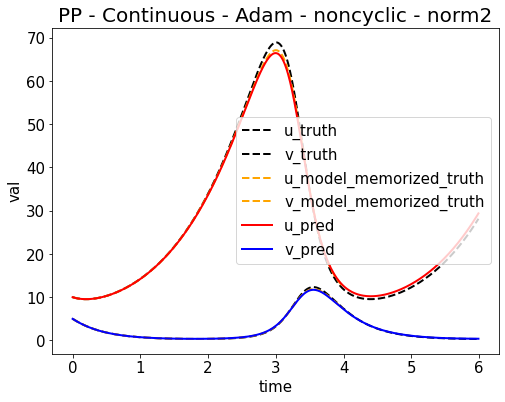

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653391405.png


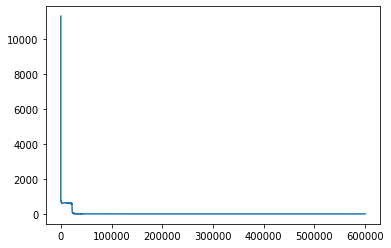

Epoch [605000/1000000] Loss:0.047091 Loss_1:0.000004 Loss_2:0.007128 Loss_3:0.000000 Loss_4:0.039958 Lr:0.001000 Time:73.698003s (144.57min in total, 94.39min remains)
Epoch [610000/1000000] Loss:0.039863 Loss_1:0.000063 Loss_2:0.001856 Loss_3:0.000000 Loss_4:0.037944 Lr:0.001000 Time:71.085834s (145.76min in total, 93.19min remains)
Epoch [615000/1000000] Loss:0.043703 Loss_1:0.000013 Loss_2:0.005538 Loss_3:0.000000 Loss_4:0.038152 Lr:0.001000 Time:71.355022s (146.95min in total, 91.99min remains)
Epoch [620000/1000000] Loss:0.042125 Loss_1:0.000004 Loss_2:0.004912 Loss_3:0.000000 Loss_4:0.037208 Lr:0.001000 Time:71.251689s (148.13min in total, 90.79min remains)
Epoch [625000/1000000] Loss:0.037992 Loss_1:0.000021 Loss_2:0.002372 Loss_3:0.000000 Loss_4:0.035598 Lr:0.001000 Time:71.009178s (149.32min in total, 89.59min remains)
Epoch [630000/1000000] Loss:0.050164 Loss_1:0.000086 Loss_2:0.015525 Loss_3:0.000000 Loss_4:0.034553 Lr:0.001000 Time:71.357210s (150.51min in total, 88.39min r

<Figure size 432x288 with 0 Axes>

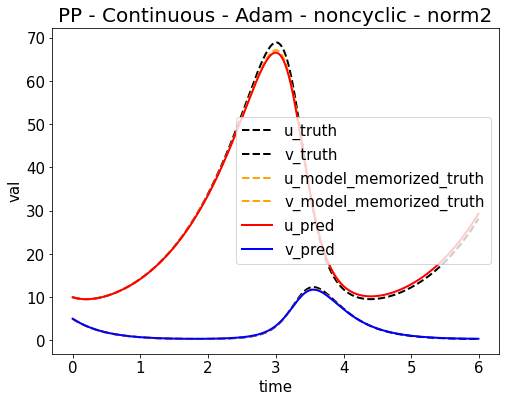

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653392119.png


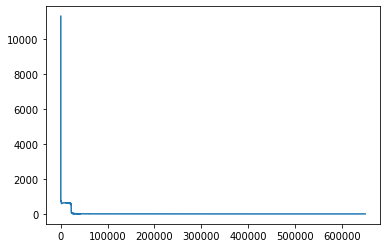

Epoch [655000/1000000] Loss:0.030179 Loss_1:0.000075 Loss_2:0.001036 Loss_3:0.000000 Loss_4:0.029067 Lr:0.001000 Time:74.050112s (156.48min in total, 82.42min remains)
Epoch [660000/1000000] Loss:0.029079 Loss_1:0.000009 Loss_2:0.000890 Loss_3:0.000000 Loss_4:0.028180 Lr:0.001000 Time:71.141960s (157.67min in total, 81.22min remains)
Epoch [665000/1000000] Loss:0.036588 Loss_1:0.000218 Loss_2:0.009469 Loss_3:0.000000 Loss_4:0.026901 Lr:0.001000 Time:70.992131s (158.85min in total, 80.02min remains)
Epoch [670000/1000000] Loss:0.028277 Loss_1:0.000125 Loss_2:0.001947 Loss_3:0.000000 Loss_4:0.026206 Lr:0.001000 Time:71.021482s (160.04min in total, 78.82min remains)
Epoch [675000/1000000] Loss:0.032559 Loss_1:0.000120 Loss_2:0.009146 Loss_3:0.000000 Loss_4:0.023292 Lr:0.001000 Time:71.080868s (161.22min in total, 77.63min remains)
Epoch [680000/1000000] Loss:0.029835 Loss_1:0.000074 Loss_2:0.004084 Loss_3:0.000000 Loss_4:0.025677 Lr:0.001000 Time:71.133620s (162.41min in total, 76.43min r

<Figure size 432x288 with 0 Axes>

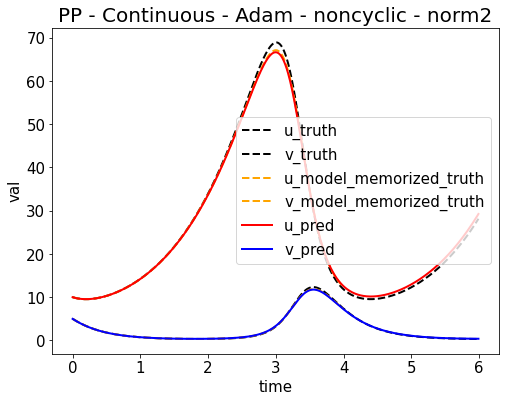

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653392835.png


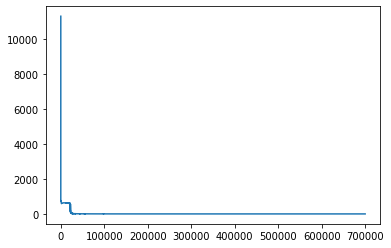

Epoch [705000/1000000] Loss:0.022027 Loss_1:0.000002 Loss_2:0.000470 Loss_3:0.000000 Loss_4:0.021555 Lr:0.001000 Time:74.089197s (168.41min in total, 70.47min remains)
Epoch [710000/1000000] Loss:0.020579 Loss_1:0.000008 Loss_2:0.001194 Loss_3:0.000000 Loss_4:0.019377 Lr:0.001000 Time:72.082549s (169.61min in total, 69.28min remains)
Epoch [715000/1000000] Loss:0.019274 Loss_1:0.000012 Loss_2:0.000458 Loss_3:0.000000 Loss_4:0.018804 Lr:0.001000 Time:71.682625s (170.80min in total, 68.08min remains)
Epoch [720000/1000000] Loss:0.019572 Loss_1:0.000017 Loss_2:0.002129 Loss_3:0.000000 Loss_4:0.017426 Lr:0.001000 Time:71.754675s (172.00min in total, 66.89min remains)
Epoch [725000/1000000] Loss:0.018706 Loss_1:0.000011 Loss_2:0.001435 Loss_3:0.000000 Loss_4:0.017260 Lr:0.001000 Time:71.403748s (173.19min in total, 65.69min remains)
Epoch [730000/1000000] Loss:0.017241 Loss_1:0.000017 Loss_2:0.001164 Loss_3:0.000000 Loss_4:0.016060 Lr:0.001000 Time:71.609018s (174.38min in total, 64.50min r

<Figure size 432x288 with 0 Axes>

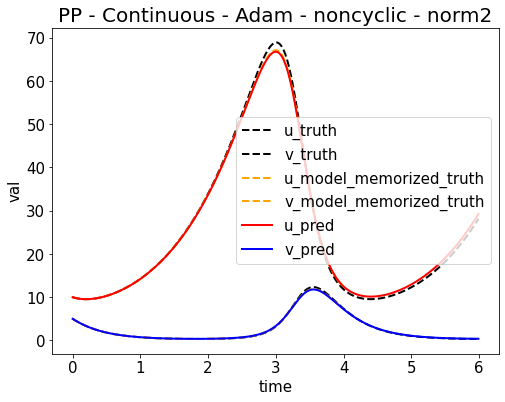

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653393553.png


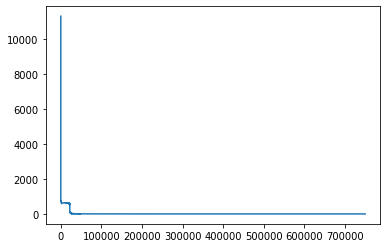

Epoch [755000/1000000] Loss:0.018338 Loss_1:0.000167 Loss_2:0.005977 Loss_3:0.000000 Loss_4:0.012194 Lr:0.001000 Time:74.065196s (180.39min in total, 58.54min remains)
Epoch [760000/1000000] Loss:0.014158 Loss_1:0.000012 Loss_2:0.001983 Loss_3:0.000000 Loss_4:0.012163 Lr:0.001000 Time:71.128326s (181.57min in total, 57.34min remains)
Epoch [765000/1000000] Loss:0.015485 Loss_1:0.000051 Loss_2:0.003084 Loss_3:0.000000 Loss_4:0.012351 Lr:0.001000 Time:71.295699s (182.76min in total, 56.14min remains)
Epoch [770000/1000000] Loss:0.015478 Loss_1:0.000007 Loss_2:0.003898 Loss_3:0.000000 Loss_4:0.011573 Lr:0.001000 Time:71.276097s (183.95min in total, 54.95min remains)
Epoch [775000/1000000] Loss:0.013433 Loss_1:0.000022 Loss_2:0.002539 Loss_3:0.000000 Loss_4:0.010872 Lr:0.001000 Time:71.328151s (185.14min in total, 53.75min remains)
Epoch [780000/1000000] Loss:0.014585 Loss_1:0.000007 Loss_2:0.003814 Loss_3:0.000000 Loss_4:0.010764 Lr:0.001000 Time:71.274607s (186.33min in total, 52.55min r

<Figure size 432x288 with 0 Axes>

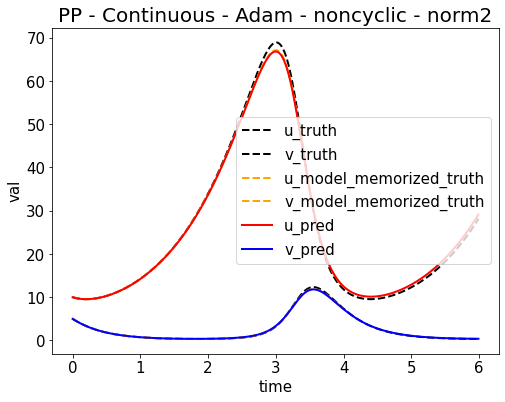

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653394269.png


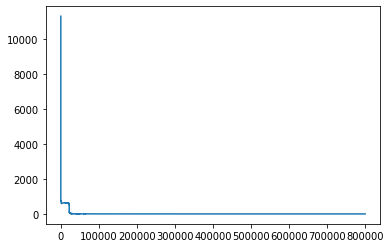

Epoch [805000/1000000] Loss:0.014101 Loss_1:0.000007 Loss_2:0.004660 Loss_3:0.000000 Loss_4:0.009433 Lr:0.001000 Time:74.154346s (192.32min in total, 46.59min remains)
Epoch [810000/1000000] Loss:0.010586 Loss_1:0.000002 Loss_2:0.001220 Loss_3:0.000000 Loss_4:0.009365 Lr:0.001000 Time:71.467703s (193.51min in total, 45.39min remains)
Epoch [815000/1000000] Loss:0.014179 Loss_1:0.000306 Loss_2:0.004608 Loss_3:0.000000 Loss_4:0.009265 Lr:0.001000 Time:71.629382s (194.70min in total, 44.20min remains)
Epoch [820000/1000000] Loss:0.019118 Loss_1:0.000120 Loss_2:0.008064 Loss_3:0.000000 Loss_4:0.010934 Lr:0.001000 Time:71.787839s (195.90min in total, 43.00min remains)
Epoch [825000/1000000] Loss:0.010575 Loss_1:0.000059 Loss_2:0.001558 Loss_3:0.000000 Loss_4:0.008957 Lr:0.001000 Time:71.643526s (197.09min in total, 41.81min remains)
Epoch [830000/1000000] Loss:0.011244 Loss_1:0.000053 Loss_2:0.002603 Loss_3:0.000000 Loss_4:0.008588 Lr:0.001000 Time:71.805837s (198.29min in total, 40.61min r

<Figure size 432x288 with 0 Axes>

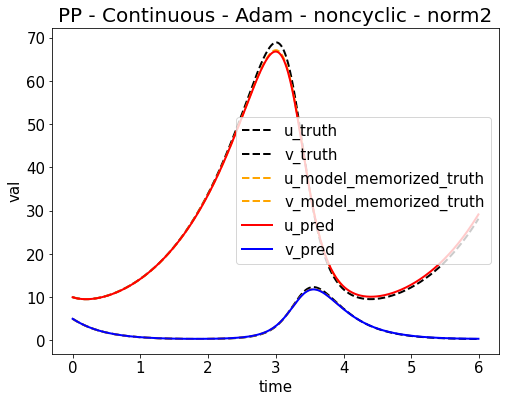

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653394988.png


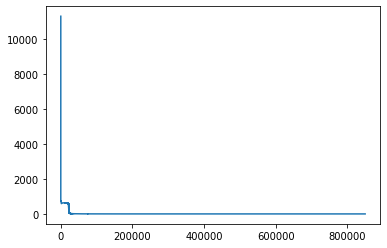

Epoch [855000/1000000] Loss:0.012365 Loss_1:0.000207 Loss_2:0.004467 Loss_3:0.000000 Loss_4:0.007690 Lr:0.001000 Time:74.388668s (204.30min in total, 34.65min remains)
Epoch [860000/1000000] Loss:0.008990 Loss_1:0.000032 Loss_2:0.001236 Loss_3:0.000000 Loss_4:0.007722 Lr:0.001000 Time:71.576873s (205.50min in total, 33.45min remains)
Epoch [865000/1000000] Loss:0.011220 Loss_1:0.000052 Loss_2:0.003652 Loss_3:0.000000 Loss_4:0.007516 Lr:0.001000 Time:72.065984s (206.70min in total, 32.26min remains)
Epoch [870000/1000000] Loss:0.007885 Loss_1:0.000008 Loss_2:0.000640 Loss_3:0.000000 Loss_4:0.007236 Lr:0.001000 Time:72.315574s (207.90min in total, 31.07min remains)
Epoch [875000/1000000] Loss:0.009816 Loss_1:0.000004 Loss_2:0.002709 Loss_3:0.000000 Loss_4:0.007102 Lr:0.001000 Time:72.386128s (209.11min in total, 29.87min remains)
Epoch [880000/1000000] Loss:0.009091 Loss_1:0.000026 Loss_2:0.002647 Loss_3:0.000000 Loss_4:0.006417 Lr:0.001000 Time:72.421906s (210.32min in total, 28.68min r

<Figure size 432x288 with 0 Axes>

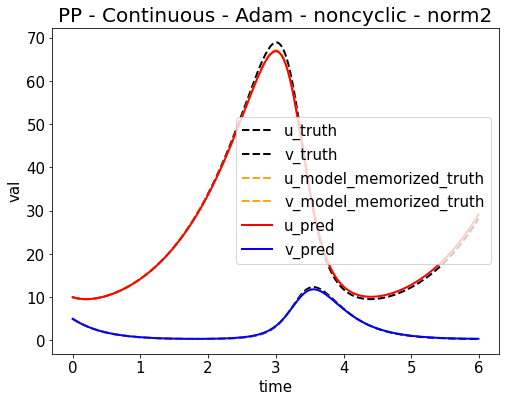

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653395711.png


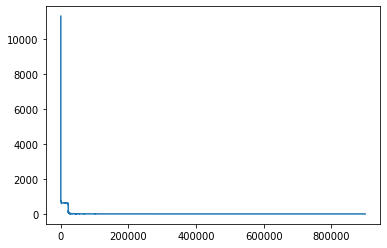

Epoch [905000/1000000] Loss:0.008905 Loss_1:0.000006 Loss_2:0.002236 Loss_3:0.000000 Loss_4:0.006662 Lr:0.001000 Time:75.014807s (216.37min in total, 22.71min remains)
Epoch [910000/1000000] Loss:0.012667 Loss_1:0.000128 Loss_2:0.005523 Loss_3:0.000000 Loss_4:0.007015 Lr:0.001000 Time:71.898499s (217.57min in total, 21.52min remains)
Epoch [915000/1000000] Loss:0.010047 Loss_1:0.000001 Loss_2:0.003935 Loss_3:0.000000 Loss_4:0.006111 Lr:0.001000 Time:71.195284s (218.75min in total, 20.32min remains)
Epoch [920000/1000000] Loss:0.010851 Loss_1:0.000051 Loss_2:0.004825 Loss_3:0.000000 Loss_4:0.005975 Lr:0.001000 Time:71.235372s (219.94min in total, 19.13min remains)
Epoch [925000/1000000] Loss:0.006427 Loss_1:0.000000 Loss_2:0.000425 Loss_3:0.000000 Loss_4:0.006001 Lr:0.001000 Time:71.265235s (221.13min in total, 17.93min remains)
Epoch [930000/1000000] Loss:0.006825 Loss_1:0.000003 Loss_2:0.000774 Loss_3:0.000000 Loss_4:0.006047 Lr:0.001000 Time:71.238543s (222.32min in total, 16.73min r

<Figure size 432x288 with 0 Axes>

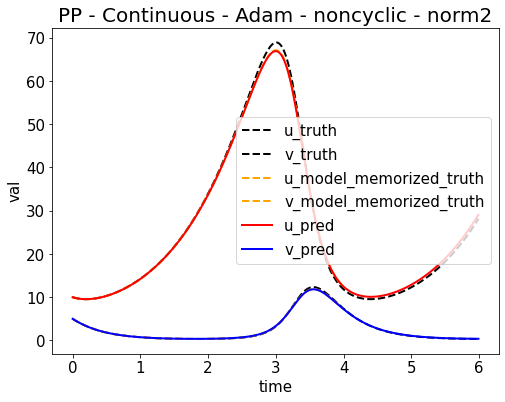

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653396429.png


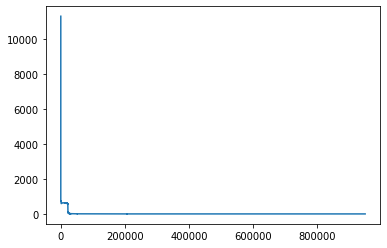

Epoch [955000/1000000] Loss:0.014199 Loss_1:0.000012 Loss_2:0.009298 Loss_3:0.000000 Loss_4:0.004889 Lr:0.001000 Time:74.941066s (228.32min in total, 10.76min remains)
Epoch [960000/1000000] Loss:0.008173 Loss_1:0.000013 Loss_2:0.003506 Loss_3:0.000000 Loss_4:0.004655 Lr:0.001000 Time:71.698929s (229.52min in total, 9.56min remains)
Epoch [965000/1000000] Loss:0.008095 Loss_1:0.000004 Loss_2:0.002650 Loss_3:0.000000 Loss_4:0.005440 Lr:0.001000 Time:71.552580s (230.71min in total, 8.37min remains)
Epoch [970000/1000000] Loss:0.017461 Loss_1:0.000088 Loss_2:0.012267 Loss_3:0.000000 Loss_4:0.005106 Lr:0.001000 Time:71.330419s (231.90min in total, 7.17min remains)
Epoch [975000/1000000] Loss:0.006939 Loss_1:0.000014 Loss_2:0.002429 Loss_3:0.000000 Loss_4:0.004496 Lr:0.001000 Time:71.298118s (233.09min in total, 5.98min remains)
Epoch [980000/1000000] Loss:0.005257 Loss_1:0.000001 Loss_2:0.000793 Loss_3:0.000000 Loss_4:0.004463 Lr:0.001000 Time:71.555247s (234.28min in total, 4.78min remain

<Figure size 432x288 with 0 Axes>

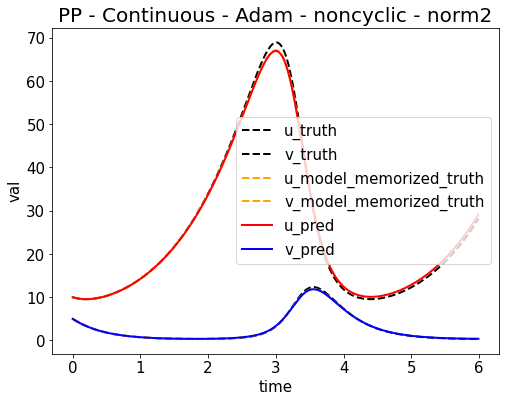

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653397146.png


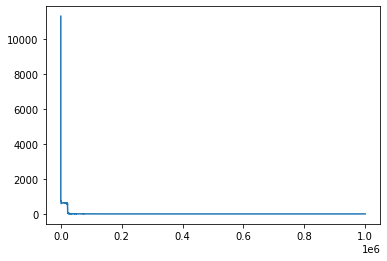

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 3, length of truth = 600 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.1

<Figure size 432x288 with 0 Axes>

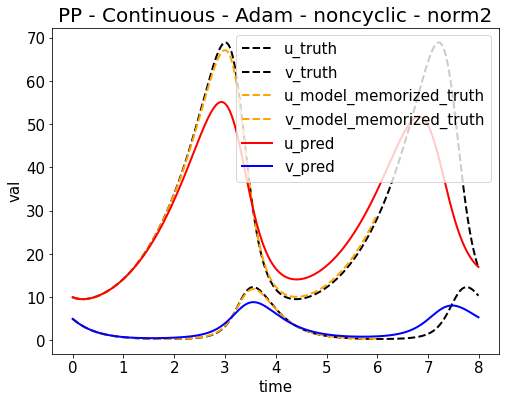

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653397910.png


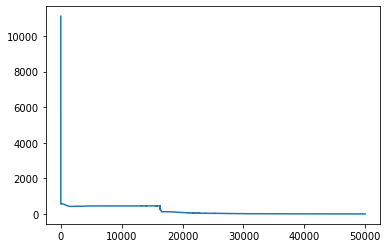

Epoch [55000/1000000] Loss:10.782942 Loss_1:0.000543 Loss_2:0.037887 Loss_3:0.000000 Loss_4:10.744512 Lr:0.001000 Time:77.353029s (13.95min in total, 239.75min remains)
Epoch [60000/1000000] Loss:9.862791 Loss_1:0.000034 Loss_2:0.012828 Loss_3:0.000000 Loss_4:9.849930 Lr:0.001000 Time:76.119094s (15.22min in total, 238.48min remains)
Epoch [65000/1000000] Loss:8.918602 Loss_1:0.000031 Loss_2:0.018730 Loss_3:0.000000 Loss_4:8.899841 Lr:0.001000 Time:76.309801s (16.49min in total, 237.26min remains)
Epoch [70000/1000000] Loss:8.361767 Loss_1:0.000001 Loss_2:0.010737 Loss_3:0.000000 Loss_4:8.351028 Lr:0.001000 Time:75.888343s (17.76min in total, 235.94min remains)
Epoch [75000/1000000] Loss:7.689312 Loss_1:0.000041 Loss_2:0.032888 Loss_3:0.000000 Loss_4:7.656382 Lr:0.001000 Time:75.966861s (19.02min in total, 234.64min remains)
Epoch [80000/1000000] Loss:7.480367 Loss_1:0.000271 Loss_2:0.029628 Loss_3:0.000000 Loss_4:7.450468 Lr:0.001000 Time:75.880843s (20.29min in total, 233.33min remai

<Figure size 432x288 with 0 Axes>

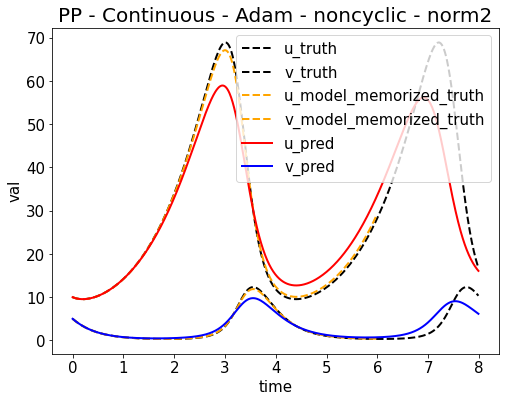

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653398671.png


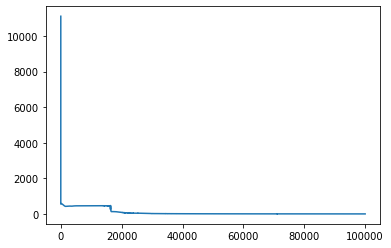

Epoch [105000/1000000] Loss:5.492060 Loss_1:0.000007 Loss_2:0.006246 Loss_3:0.000000 Loss_4:5.485806 Lr:0.001000 Time:77.547257s (26.65min in total, 227.13min remains)
Epoch [110000/1000000] Loss:5.245667 Loss_1:0.000049 Loss_2:0.007871 Loss_3:0.000000 Loss_4:5.237748 Lr:0.001000 Time:75.754134s (27.91min in total, 225.81min remains)
Epoch [115000/1000000] Loss:4.999870 Loss_1:0.000087 Loss_2:0.018474 Loss_3:0.000000 Loss_4:4.981308 Lr:0.001000 Time:76.083584s (29.18min in total, 224.54min remains)
Epoch [120000/1000000] Loss:4.917343 Loss_1:0.000006 Loss_2:0.005738 Loss_3:0.000000 Loss_4:4.911600 Lr:0.001000 Time:75.853019s (30.44min in total, 223.24min remains)
Epoch [125000/1000000] Loss:4.281744 Loss_1:0.000043 Loss_2:0.061499 Loss_3:0.000000 Loss_4:4.220202 Lr:0.001000 Time:76.291512s (31.71min in total, 221.99min remains)
Epoch [130000/1000000] Loss:4.532787 Loss_1:0.000007 Loss_2:0.005579 Loss_3:0.000000 Loss_4:4.527201 Lr:0.001000 Time:75.836381s (32.98min in total, 220.69min r

<Figure size 432x288 with 0 Axes>

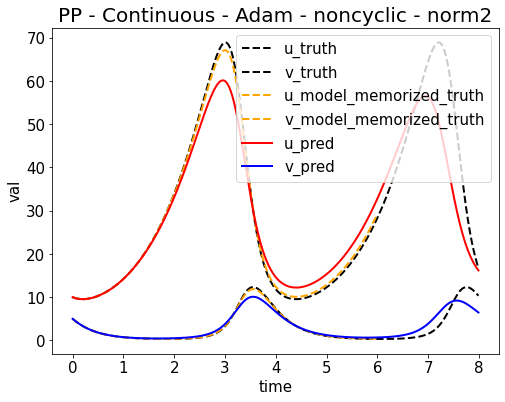

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653399433.png


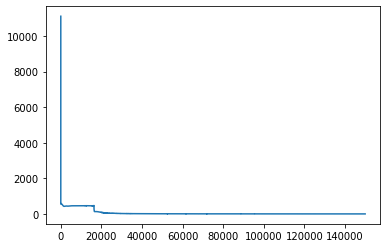

Epoch [155000/1000000] Loss:3.897907 Loss_1:0.000009 Loss_2:0.004852 Loss_3:0.000000 Loss_4:3.893047 Lr:0.001000 Time:77.924461s (39.34min in total, 214.48min remains)
Epoch [160000/1000000] Loss:3.878799 Loss_1:0.000004 Loss_2:0.017054 Loss_3:0.000000 Loss_4:3.861741 Lr:0.001000 Time:76.291278s (40.61min in total, 213.22min remains)
Epoch [165000/1000000] Loss:3.668078 Loss_1:0.000046 Loss_2:0.004878 Loss_3:0.000000 Loss_4:3.663154 Lr:0.001000 Time:76.167750s (41.88min in total, 211.95min remains)
Epoch [170000/1000000] Loss:3.750737 Loss_1:0.000054 Loss_2:0.005698 Loss_3:0.000000 Loss_4:3.744985 Lr:0.001000 Time:75.891300s (43.15min in total, 210.66min remains)
Epoch [175000/1000000] Loss:3.457785 Loss_1:0.000071 Loss_2:0.005017 Loss_3:0.000000 Loss_4:3.452696 Lr:0.001000 Time:76.004933s (44.41min in total, 209.38min remains)
Epoch [180000/1000000] Loss:3.317816 Loss_1:0.000159 Loss_2:0.012555 Loss_3:0.000000 Loss_4:3.305102 Lr:0.001000 Time:76.251093s (45.69min in total, 208.12min r

<Figure size 432x288 with 0 Axes>

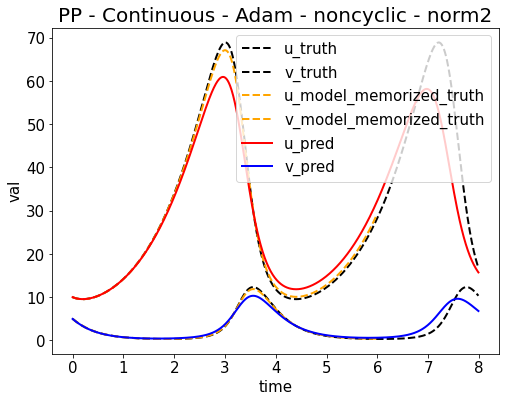

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653400196.png


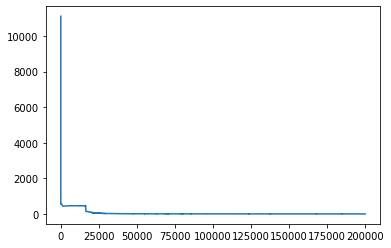

Epoch [205000/1000000] Loss:2.975590 Loss_1:0.000007 Loss_2:0.004631 Loss_3:0.000000 Loss_4:2.970951 Lr:0.001000 Time:77.854075s (52.06min in total, 201.88min remains)
Epoch [210000/1000000] Loss:2.922333 Loss_1:0.000006 Loss_2:0.008807 Loss_3:0.000000 Loss_4:2.913521 Lr:0.001000 Time:75.936539s (53.32min in total, 200.60min remains)
Epoch [215000/1000000] Loss:2.773345 Loss_1:0.000013 Loss_2:0.015555 Loss_3:0.000000 Loss_4:2.757777 Lr:0.001000 Time:75.940088s (54.59min in total, 199.31min remains)
Epoch [220000/1000000] Loss:4.276160 Loss_1:0.000028 Loss_2:0.008821 Loss_3:0.000000 Loss_4:4.267311 Lr:0.001000 Time:75.916104s (55.85min in total, 198.03min remains)
Epoch [225000/1000000] Loss:3.195961 Loss_1:0.000043 Loss_2:0.008260 Loss_3:0.000000 Loss_4:3.187658 Lr:0.001000 Time:76.192809s (57.12min in total, 196.76min remains)
Epoch [230000/1000000] Loss:3.213942 Loss_1:0.000143 Loss_2:0.043550 Loss_3:0.000000 Loss_4:3.170249 Lr:0.001000 Time:75.976024s (58.39min in total, 195.48min r

<Figure size 432x288 with 0 Axes>

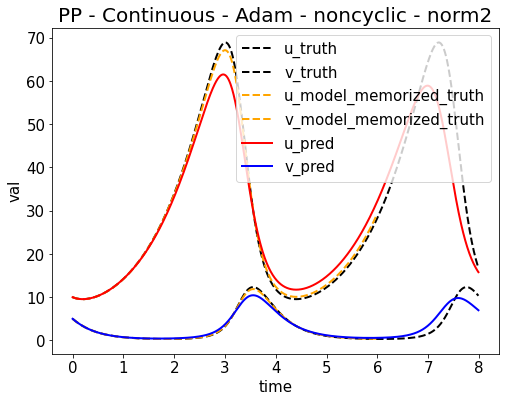

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653400958.png


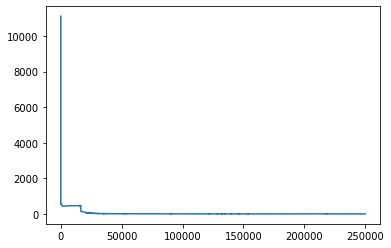

Epoch [255000/1000000] Loss:2.521488 Loss_1:0.000005 Loss_2:0.018209 Loss_3:0.000000 Loss_4:2.503274 Lr:0.001000 Time:78.073381s (64.76min in total, 189.21min remains)
Epoch [260000/1000000] Loss:2.437897 Loss_1:0.000178 Loss_2:0.004309 Loss_3:0.000000 Loss_4:2.433409 Lr:0.001000 Time:75.918315s (66.03min in total, 187.92min remains)
Epoch [265000/1000000] Loss:2.400064 Loss_1:0.000001 Loss_2:0.008024 Loss_3:0.000000 Loss_4:2.392040 Lr:0.001000 Time:75.976927s (67.29min in total, 186.64min remains)
Epoch [270000/1000000] Loss:2.267872 Loss_1:0.000001 Loss_2:0.002809 Loss_3:0.000000 Loss_4:2.265061 Lr:0.001000 Time:75.778209s (68.56min in total, 185.36min remains)
Epoch [275000/1000000] Loss:2.211979 Loss_1:0.000009 Loss_2:0.002867 Loss_3:0.000000 Loss_4:2.209104 Lr:0.001000 Time:75.820774s (69.82min in total, 184.07min remains)
Epoch [280000/1000000] Loss:2.129382 Loss_1:0.000040 Loss_2:0.003957 Loss_3:0.000000 Loss_4:2.125385 Lr:0.001000 Time:76.016392s (71.09min in total, 182.80min r

<Figure size 432x288 with 0 Axes>

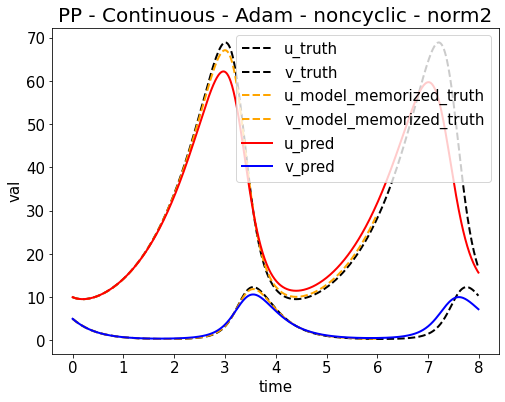

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653401720.png


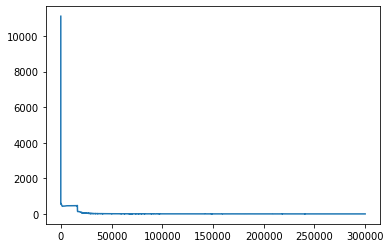

Epoch [305000/1000000] Loss:1.964014 Loss_1:0.000002 Loss_2:0.004333 Loss_3:0.000000 Loss_4:1.959679 Lr:0.001000 Time:77.779592s (77.46min in total, 176.50min remains)
Epoch [310000/1000000] Loss:1.889232 Loss_1:0.000017 Loss_2:0.020337 Loss_3:0.000000 Loss_4:1.868878 Lr:0.001000 Time:75.900707s (78.72min in total, 175.22min remains)
Epoch [315000/1000000] Loss:1.928566 Loss_1:0.000023 Loss_2:0.005883 Loss_3:0.000000 Loss_4:1.922661 Lr:0.001000 Time:75.837398s (79.99min in total, 173.94min remains)
Epoch [320000/1000000] Loss:1.866099 Loss_1:0.000002 Loss_2:0.002292 Loss_3:0.000000 Loss_4:1.863806 Lr:0.001000 Time:76.263970s (81.26min in total, 172.67min remains)
Epoch [325000/1000000] Loss:1.814618 Loss_1:0.000008 Loss_2:0.002628 Loss_3:0.000000 Loss_4:1.811982 Lr:0.001000 Time:75.972905s (82.52min in total, 171.39min remains)
Epoch [330000/1000000] Loss:1.782050 Loss_1:0.000016 Loss_2:0.022020 Loss_3:0.000000 Loss_4:1.760014 Lr:0.001000 Time:75.976407s (83.79min in total, 170.12min r

<Figure size 432x288 with 0 Axes>

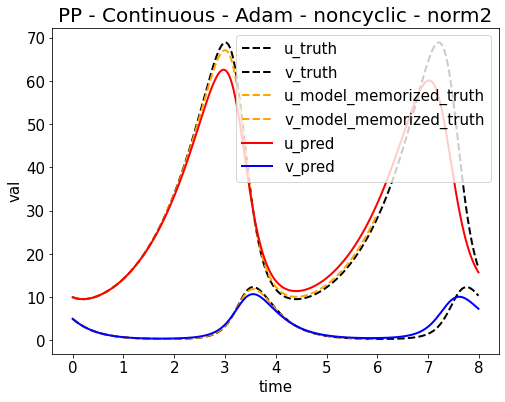

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653402480.png


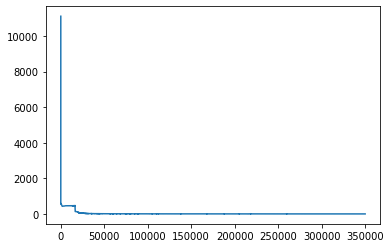

Epoch [355000/1000000] Loss:1.744279 Loss_1:0.000001 Loss_2:0.002610 Loss_3:0.000000 Loss_4:1.741667 Lr:0.001000 Time:78.003289s (90.14min in total, 163.77min remains)
Epoch [360000/1000000] Loss:1.713810 Loss_1:0.000005 Loss_2:0.005859 Loss_3:0.000000 Loss_4:1.707947 Lr:0.001000 Time:75.836240s (91.40min in total, 162.49min remains)
Epoch [365000/1000000] Loss:1.938283 Loss_1:0.000078 Loss_2:0.005925 Loss_3:0.000000 Loss_4:1.932280 Lr:0.001000 Time:75.658987s (92.66min in total, 161.21min remains)
Epoch [370000/1000000] Loss:1.720715 Loss_1:0.000106 Loss_2:0.012199 Loss_3:0.000000 Loss_4:1.708410 Lr:0.001000 Time:75.715122s (93.92min in total, 159.92min remains)
Epoch [375000/1000000] Loss:1.699178 Loss_1:0.000014 Loss_2:0.035564 Loss_3:0.000000 Loss_4:1.663600 Lr:0.001000 Time:75.733443s (95.19min in total, 158.64min remains)
Epoch [380000/1000000] Loss:1.615207 Loss_1:0.000033 Loss_2:0.003939 Loss_3:0.000000 Loss_4:1.611234 Lr:0.001000 Time:75.513704s (96.44min in total, 157.36min r

<Figure size 432x288 with 0 Axes>

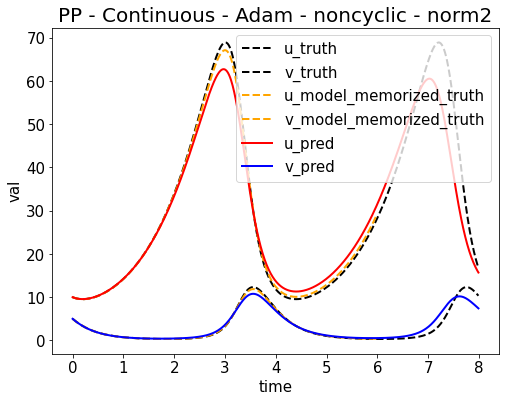

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653403240.png


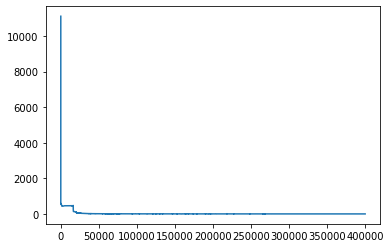

Epoch [405000/1000000] Loss:1.527389 Loss_1:0.000226 Loss_2:0.004412 Loss_3:0.000000 Loss_4:1.522751 Lr:0.001000 Time:77.981179s (102.80min in total, 151.03min remains)
Epoch [410000/1000000] Loss:1.702808 Loss_1:0.000008 Loss_2:0.018341 Loss_3:0.000000 Loss_4:1.684459 Lr:0.001000 Time:75.601595s (104.06min in total, 149.75min remains)
Epoch [415000/1000000] Loss:1.460518 Loss_1:0.000027 Loss_2:0.005453 Loss_3:0.000000 Loss_4:1.455039 Lr:0.001000 Time:75.418758s (105.32min in total, 148.46min remains)
Epoch [420000/1000000] Loss:1.432632 Loss_1:0.000086 Loss_2:0.021838 Loss_3:0.000000 Loss_4:1.410708 Lr:0.001000 Time:75.449806s (106.58min in total, 147.18min remains)
Epoch [425000/1000000] Loss:1.428616 Loss_1:0.000101 Loss_2:0.024237 Loss_3:0.000000 Loss_4:1.404278 Lr:0.001000 Time:75.901455s (107.84min in total, 145.90min remains)
Epoch [430000/1000000] Loss:1.385211 Loss_1:0.000001 Loss_2:0.001798 Loss_3:0.000000 Loss_4:1.383412 Lr:0.001000 Time:75.760948s (109.10min in total, 144.6

<Figure size 432x288 with 0 Axes>

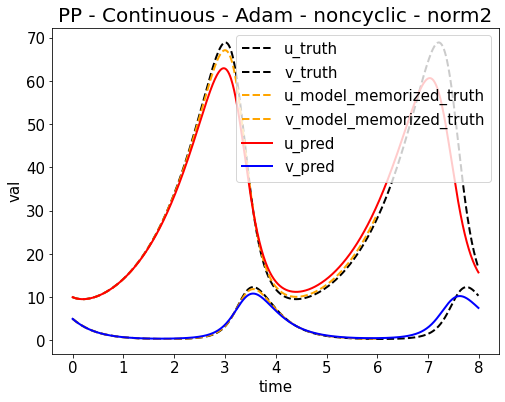

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653403998.png


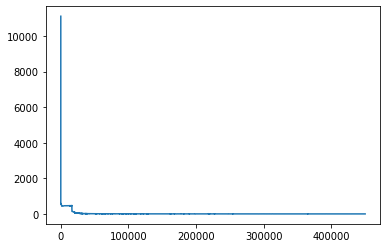

Epoch [455000/1000000] Loss:1.312488 Loss_1:0.000038 Loss_2:0.004488 Loss_3:0.000000 Loss_4:1.307962 Lr:0.001000 Time:77.587035s (115.42min in total, 138.25min remains)
Epoch [460000/1000000] Loss:3.001882 Loss_1:0.000001 Loss_2:0.003668 Loss_3:0.000000 Loss_4:2.998212 Lr:0.001000 Time:75.342253s (116.68min in total, 136.97min remains)
Epoch [465000/1000000] Loss:2.151409 Loss_1:0.000002 Loss_2:0.002643 Loss_3:0.000000 Loss_4:2.148764 Lr:0.001000 Time:75.102943s (117.93min in total, 135.68min remains)
Epoch [470000/1000000] Loss:1.687265 Loss_1:0.000017 Loss_2:0.012589 Loss_3:0.000000 Loss_4:1.674659 Lr:0.001000 Time:74.981881s (119.18min in total, 134.39min remains)
Epoch [475000/1000000] Loss:1.435381 Loss_1:0.000074 Loss_2:0.064881 Loss_3:0.000000 Loss_4:1.370426 Lr:0.001000 Time:75.111146s (120.43min in total, 133.11min remains)
Epoch [480000/1000000] Loss:1.322406 Loss_1:0.000042 Loss_2:0.002963 Loss_3:0.000000 Loss_4:1.319401 Lr:0.001000 Time:74.991544s (121.68min in total, 131.8

<Figure size 432x288 with 0 Axes>

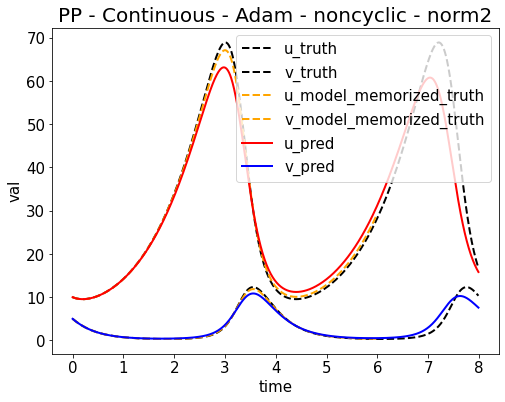

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653404751.png


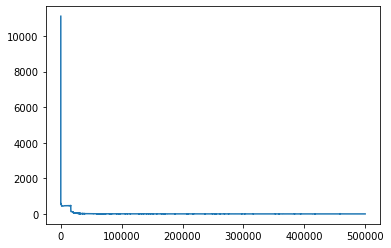

Epoch [505000/1000000] Loss:1.214475 Loss_1:0.000065 Loss_2:0.015857 Loss_3:0.000000 Loss_4:1.198554 Lr:0.001000 Time:77.556023s (127.97min in total, 125.44min remains)
Epoch [510000/1000000] Loss:1.148668 Loss_1:0.000002 Loss_2:0.009382 Loss_3:0.000000 Loss_4:1.139284 Lr:0.001000 Time:74.865845s (129.22min in total, 124.15min remains)
Epoch [515000/1000000] Loss:1.141320 Loss_1:0.000002 Loss_2:0.002141 Loss_3:0.000000 Loss_4:1.139177 Lr:0.001000 Time:74.899585s (130.47min in total, 122.87min remains)
Epoch [520000/1000000] Loss:1.180532 Loss_1:0.000012 Loss_2:0.021534 Loss_3:0.000000 Loss_4:1.158985 Lr:0.001000 Time:74.703024s (131.71min in total, 121.58min remains)
Epoch [525000/1000000] Loss:1.100995 Loss_1:0.000018 Loss_2:0.008684 Loss_3:0.000000 Loss_4:1.092292 Lr:0.001000 Time:74.604284s (132.95min in total, 120.29min remains)
Epoch [530000/1000000] Loss:1.154111 Loss_1:0.000003 Loss_2:0.012041 Loss_3:0.000000 Loss_4:1.142067 Lr:0.001000 Time:74.678542s (134.20min in total, 119.0

<Figure size 432x288 with 0 Axes>

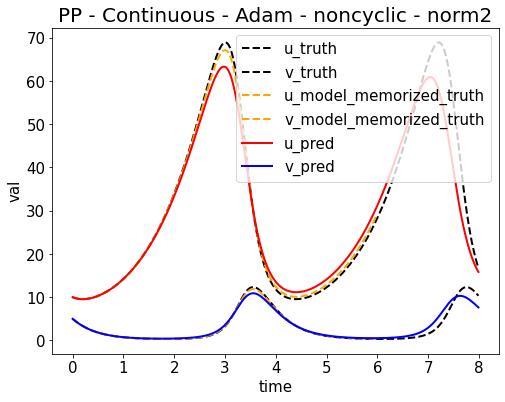

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653405500.png


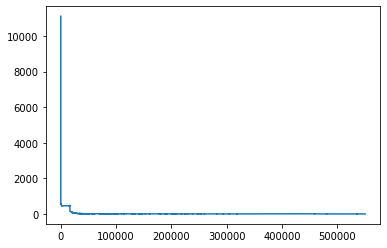

Epoch [555000/1000000] Loss:1.107667 Loss_1:0.000114 Loss_2:0.027930 Loss_3:0.000000 Loss_4:1.079624 Lr:0.001000 Time:76.956998s (140.45min in total, 112.61min remains)
Epoch [560000/1000000] Loss:1.183974 Loss_1:0.000002 Loss_2:0.001633 Loss_3:0.000000 Loss_4:1.182339 Lr:0.001000 Time:74.506165s (141.69min in total, 111.33min remains)
Epoch [565000/1000000] Loss:1.052848 Loss_1:0.000012 Loss_2:0.002521 Loss_3:0.000000 Loss_4:1.050315 Lr:0.001000 Time:74.503109s (142.93min in total, 110.04min remains)
Epoch [570000/1000000] Loss:1.033171 Loss_1:0.000005 Loss_2:0.002808 Loss_3:0.000000 Loss_4:1.030357 Lr:0.001000 Time:74.410223s (144.17min in total, 108.76min remains)
Epoch [575000/1000000] Loss:1.024915 Loss_1:0.000001 Loss_2:0.003733 Loss_3:0.000000 Loss_4:1.021181 Lr:0.001000 Time:74.411740s (145.41min in total, 107.48min remains)
Epoch [580000/1000000] Loss:1.074947 Loss_1:0.000014 Loss_2:0.003172 Loss_3:0.000000 Loss_4:1.071761 Lr:0.001000 Time:74.246970s (146.65min in total, 106.1

<Figure size 432x288 with 0 Axes>

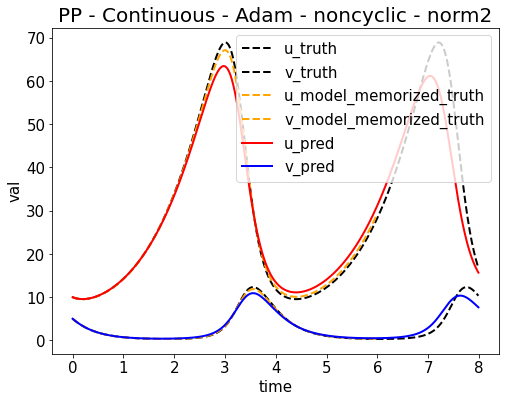

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653406247.png


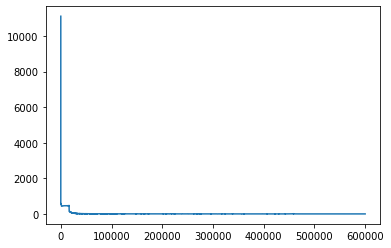

Epoch [605000/1000000] Loss:1.046118 Loss_1:0.000003 Loss_2:0.001672 Loss_3:0.000000 Loss_4:1.044442 Lr:0.001000 Time:76.806087s (152.90min in total, 99.82min remains)
Epoch [610000/1000000] Loss:0.994354 Loss_1:0.000001 Loss_2:0.001725 Loss_3:0.000000 Loss_4:0.992629 Lr:0.001000 Time:74.068342s (154.13min in total, 98.54min remains)
Epoch [615000/1000000] Loss:1.040167 Loss_1:0.000171 Loss_2:0.066322 Loss_3:0.000000 Loss_4:0.973674 Lr:0.001000 Time:74.199743s (155.37min in total, 97.26min remains)
Epoch [620000/1000000] Loss:1.099625 Loss_1:0.000002 Loss_2:0.001773 Loss_3:0.000000 Loss_4:1.097850 Lr:0.001000 Time:74.621493s (156.61min in total, 95.99min remains)
Epoch [625000/1000000] Loss:0.964455 Loss_1:0.000012 Loss_2:0.004767 Loss_3:0.000000 Loss_4:0.959675 Lr:0.001000 Time:74.584879s (157.85min in total, 94.71min remains)
Epoch [630000/1000000] Loss:0.926618 Loss_1:0.000032 Loss_2:0.013734 Loss_3:0.000000 Loss_4:0.912852 Lr:0.001000 Time:74.871096s (159.10min in total, 93.44min r

<Figure size 432x288 with 0 Axes>

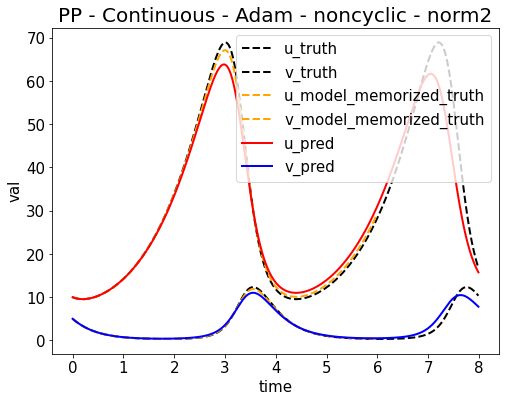

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653406996.png


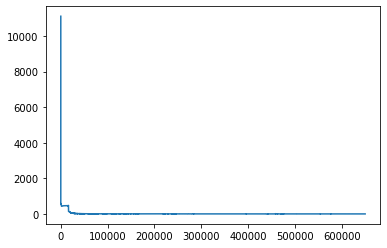

Epoch [655000/1000000] Loss:0.891116 Loss_1:0.000014 Loss_2:0.003333 Loss_3:0.000000 Loss_4:0.887769 Lr:0.001000 Time:77.351876s (165.39min in total, 87.11min remains)
Epoch [660000/1000000] Loss:0.915390 Loss_1:0.000016 Loss_2:0.002027 Loss_3:0.000000 Loss_4:0.913347 Lr:0.001000 Time:74.866627s (166.63min in total, 85.84min remains)
Epoch [665000/1000000] Loss:0.887373 Loss_1:0.000207 Loss_2:0.005480 Loss_3:0.000000 Loss_4:0.881686 Lr:0.001000 Time:74.710435s (167.88min in total, 84.57min remains)
Epoch [670000/1000000] Loss:0.887286 Loss_1:0.000025 Loss_2:0.002308 Loss_3:0.000000 Loss_4:0.884952 Lr:0.001000 Time:75.456806s (169.14min in total, 83.31min remains)
Epoch [675000/1000000] Loss:1.006101 Loss_1:0.000042 Loss_2:0.008068 Loss_3:0.000000 Loss_4:0.997990 Lr:0.001000 Time:75.358922s (170.39min in total, 82.04min remains)
Epoch [680000/1000000] Loss:1.041580 Loss_1:0.000100 Loss_2:0.015599 Loss_3:0.000000 Loss_4:1.025881 Lr:0.001000 Time:75.136476s (171.65min in total, 80.77min r

<Figure size 432x288 with 0 Axes>

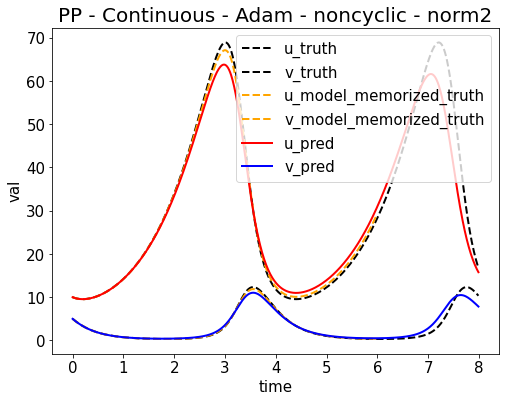

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653407746.png


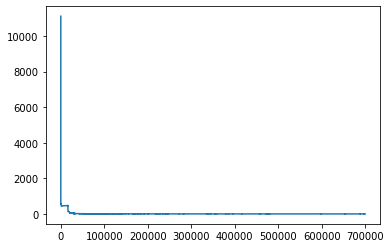

Epoch [705000/1000000] Loss:0.891102 Loss_1:0.000103 Loss_2:0.005831 Loss_3:0.000000 Loss_4:0.885167 Lr:0.001000 Time:76.003355s (177.87min in total, 74.43min remains)
Epoch [710000/1000000] Loss:0.835523 Loss_1:0.000001 Loss_2:0.001240 Loss_3:0.000000 Loss_4:0.834282 Lr:0.001000 Time:73.953676s (179.10min in total, 73.15min remains)
Epoch [715000/1000000] Loss:0.809512 Loss_1:0.000006 Loss_2:0.003712 Loss_3:0.000000 Loss_4:0.805795 Lr:0.001000 Time:73.807788s (180.33min in total, 71.88min remains)
Epoch [720000/1000000] Loss:0.841268 Loss_1:0.000025 Loss_2:0.004950 Loss_3:0.000000 Loss_4:0.836293 Lr:0.001000 Time:73.829967s (181.56min in total, 70.61min remains)
Epoch [725000/1000000] Loss:0.865002 Loss_1:0.000001 Loss_2:0.001320 Loss_3:0.000000 Loss_4:0.863680 Lr:0.001000 Time:73.833729s (182.79min in total, 69.33min remains)
Epoch [730000/1000000] Loss:0.779114 Loss_1:0.000002 Loss_2:0.001455 Loss_3:0.000000 Loss_4:0.777657 Lr:0.001000 Time:73.649180s (184.02min in total, 68.06min r

<Figure size 432x288 with 0 Axes>

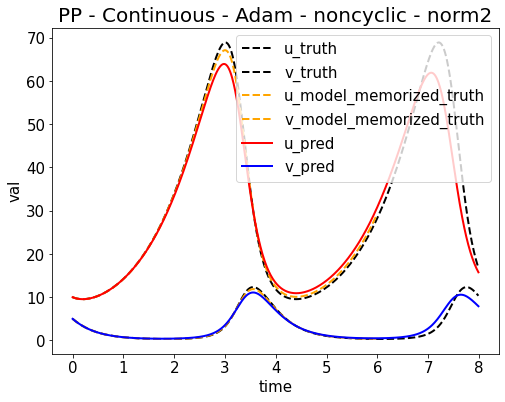

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653408486.png


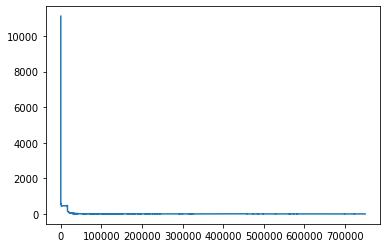

Epoch [755000/1000000] Loss:0.778678 Loss_1:0.000224 Loss_2:0.015819 Loss_3:0.000000 Loss_4:0.762635 Lr:0.001000 Time:76.133557s (190.20min in total, 61.72min remains)
Epoch [760000/1000000] Loss:0.766237 Loss_1:0.000000 Loss_2:0.001176 Loss_3:0.000000 Loss_4:0.765060 Lr:0.001000 Time:73.865740s (191.43min in total, 60.45min remains)
Epoch [765000/1000000] Loss:0.805494 Loss_1:0.000001 Loss_2:0.005360 Loss_3:0.000000 Loss_4:0.800133 Lr:0.001000 Time:73.216228s (192.65min in total, 59.18min remains)
Epoch [770000/1000000] Loss:0.724987 Loss_1:0.000057 Loss_2:0.002664 Loss_3:0.000000 Loss_4:0.722266 Lr:0.001000 Time:73.287532s (193.87min in total, 57.91min remains)
Epoch [775000/1000000] Loss:0.778446 Loss_1:0.000031 Loss_2:0.005173 Loss_3:0.000000 Loss_4:0.773242 Lr:0.001000 Time:73.466302s (195.10min in total, 56.64min remains)
Epoch [780000/1000000] Loss:0.732720 Loss_1:0.000051 Loss_2:0.001642 Loss_3:0.000000 Loss_4:0.731027 Lr:0.001000 Time:73.380398s (196.32min in total, 55.37min r

<Figure size 432x288 with 0 Axes>

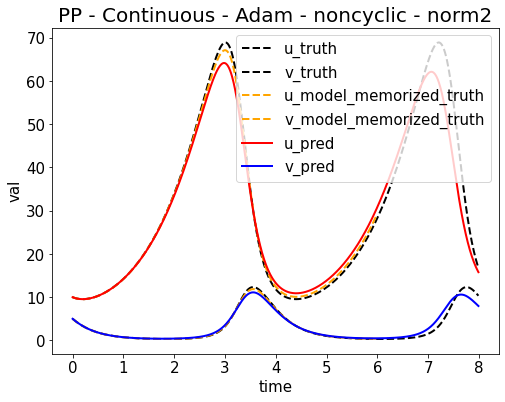

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653409222.png


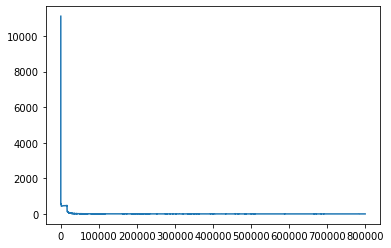

Epoch [805000/1000000] Loss:0.748737 Loss_1:0.000068 Loss_2:0.022622 Loss_3:0.000000 Loss_4:0.726047 Lr:0.001000 Time:75.963302s (202.46min in total, 49.04min remains)
Epoch [810000/1000000] Loss:0.703804 Loss_1:0.000010 Loss_2:0.001219 Loss_3:0.000000 Loss_4:0.702575 Lr:0.001000 Time:72.897399s (203.68min in total, 47.78min remains)
Epoch [815000/1000000] Loss:0.734858 Loss_1:0.000013 Loss_2:0.003495 Loss_3:0.000000 Loss_4:0.731350 Lr:0.001000 Time:72.907837s (204.89min in total, 46.51min remains)
Epoch [820000/1000000] Loss:0.675983 Loss_1:0.000011 Loss_2:0.006971 Loss_3:0.000000 Loss_4:0.669002 Lr:0.001000 Time:72.936166s (206.11min in total, 45.24min remains)
Epoch [825000/1000000] Loss:0.664717 Loss_1:0.000002 Loss_2:0.005279 Loss_3:0.000000 Loss_4:0.659435 Lr:0.001000 Time:72.462812s (207.32min in total, 43.98min remains)
Epoch [830000/1000000] Loss:0.672916 Loss_1:0.000022 Loss_2:0.001574 Loss_3:0.000000 Loss_4:0.671320 Lr:0.001000 Time:72.710866s (208.53min in total, 42.71min r

<Figure size 432x288 with 0 Axes>

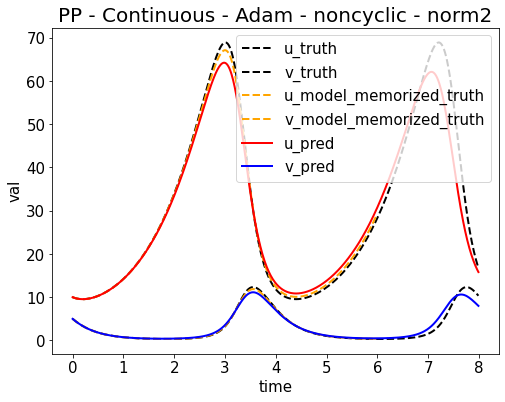

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653409954.png


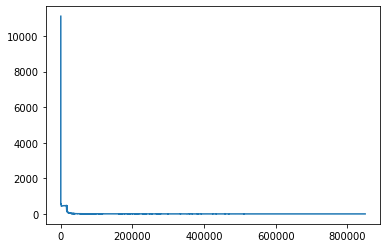

Epoch [855000/1000000] Loss:0.674479 Loss_1:0.000001 Loss_2:0.001563 Loss_3:0.000000 Loss_4:0.672915 Lr:0.001000 Time:76.141443s (214.66min in total, 36.40min remains)
Epoch [860000/1000000] Loss:0.681000 Loss_1:0.000005 Loss_2:0.007587 Loss_3:0.000000 Loss_4:0.673409 Lr:0.001000 Time:73.499170s (215.89min in total, 35.14min remains)
Epoch [865000/1000000] Loss:0.672331 Loss_1:0.000033 Loss_2:0.008177 Loss_3:0.000000 Loss_4:0.664121 Lr:0.001000 Time:73.116163s (217.11min in total, 33.88min remains)
Epoch [870000/1000000] Loss:0.655183 Loss_1:0.000001 Loss_2:0.001231 Loss_3:0.000000 Loss_4:0.653951 Lr:0.001000 Time:73.302388s (218.33min in total, 32.62min remains)
Epoch [875000/1000000] Loss:0.641613 Loss_1:0.000021 Loss_2:0.008547 Loss_3:0.000000 Loss_4:0.633046 Lr:0.001000 Time:73.409860s (219.55min in total, 31.36min remains)
Epoch [880000/1000000] Loss:0.630743 Loss_1:0.000005 Loss_2:0.002390 Loss_3:0.000000 Loss_4:0.628348 Lr:0.001000 Time:73.221686s (220.77min in total, 30.11min r

<Figure size 432x288 with 0 Axes>

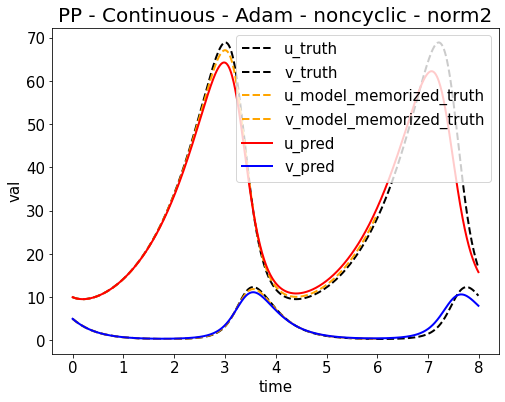

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653410689.png


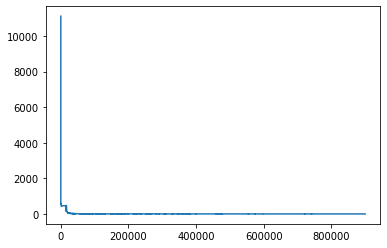

Epoch [905000/1000000] Loss:0.643729 Loss_1:0.000003 Loss_2:0.002913 Loss_3:0.000000 Loss_4:0.640813 Lr:0.001000 Time:75.918769s (226.91min in total, 23.82min remains)
Epoch [910000/1000000] Loss:0.626025 Loss_1:0.000000 Loss_2:0.003092 Loss_3:0.000000 Loss_4:0.622932 Lr:0.001000 Time:73.092404s (228.13min in total, 22.56min remains)
Epoch [915000/1000000] Loss:0.625276 Loss_1:0.000006 Loss_2:0.002866 Loss_3:0.000000 Loss_4:0.622404 Lr:0.001000 Time:72.893829s (229.34min in total, 21.31min remains)
Epoch [920000/1000000] Loss:0.650873 Loss_1:0.000012 Loss_2:0.007236 Loss_3:0.000000 Loss_4:0.643625 Lr:0.001000 Time:72.967573s (230.56min in total, 20.05min remains)
Epoch [925000/1000000] Loss:0.732028 Loss_1:0.000006 Loss_2:0.002376 Loss_3:0.000000 Loss_4:0.729645 Lr:0.001000 Time:72.839760s (231.77min in total, 18.79min remains)
Epoch [930000/1000000] Loss:0.634128 Loss_1:0.000006 Loss_2:0.001315 Loss_3:0.000000 Loss_4:0.632807 Lr:0.001000 Time:72.760698s (232.99min in total, 17.54min r

<Figure size 432x288 with 0 Axes>

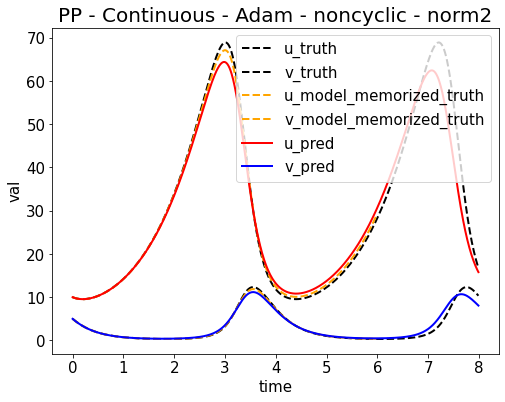

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653411421.png


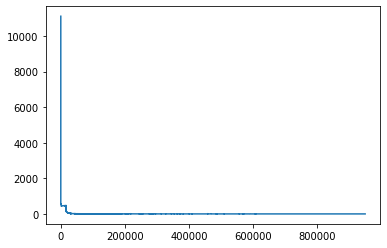

Epoch [955000/1000000] Loss:0.643891 Loss_1:0.000000 Loss_2:0.002143 Loss_3:0.000000 Loss_4:0.641748 Lr:0.001000 Time:76.279941s (239.13min in total, 11.27min remains)
Epoch [960000/1000000] Loss:0.616715 Loss_1:0.000006 Loss_2:0.001223 Loss_3:0.000000 Loss_4:0.615486 Lr:0.001000 Time:73.647280s (240.36min in total, 10.01min remains)
Epoch [965000/1000000] Loss:0.592837 Loss_1:0.000002 Loss_2:0.001515 Loss_3:0.000000 Loss_4:0.591320 Lr:0.001000 Time:73.189197s (241.58min in total, 8.76min remains)
Epoch [970000/1000000] Loss:0.574671 Loss_1:0.000013 Loss_2:0.002958 Loss_3:0.000000 Loss_4:0.571700 Lr:0.001000 Time:73.230060s (242.80min in total, 7.51min remains)
Epoch [975000/1000000] Loss:0.575050 Loss_1:0.000013 Loss_2:0.004805 Loss_3:0.000000 Loss_4:0.570232 Lr:0.001000 Time:72.919378s (244.01min in total, 6.26min remains)
Epoch [980000/1000000] Loss:0.612558 Loss_1:0.000015 Loss_2:0.005370 Loss_3:0.000000 Loss_4:0.607174 Lr:0.001000 Time:73.102599s (245.23min in total, 5.00min remai

<Figure size 432x288 with 0 Axes>

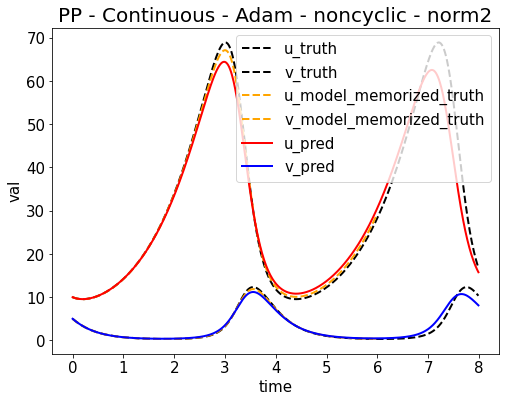

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653412155.png


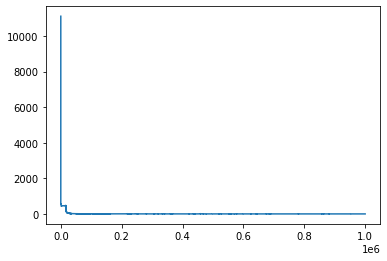

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 4, length of truth = 800 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.1

<Figure size 432x288 with 0 Axes>

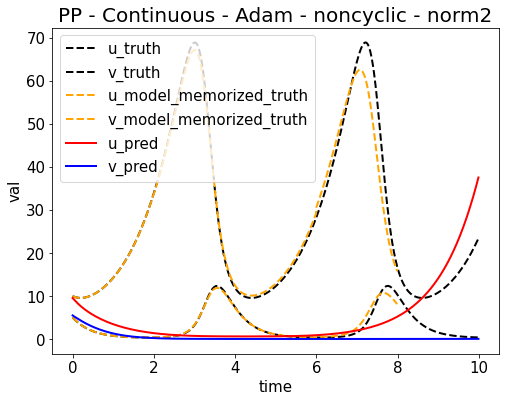

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653412925.png


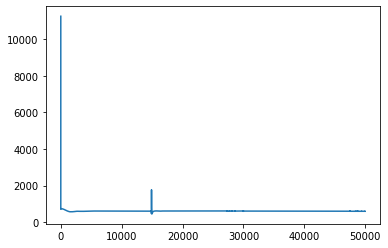

Epoch [55000/1000000] Loss:594.745789 Loss_1:0.249555 Loss_2:3.267514 Loss_3:0.020712 Loss_4:591.208008 Lr:0.001000 Time:77.455205s (14.07min in total, 241.70min remains)
Epoch [60000/1000000] Loss:589.756714 Loss_1:0.246644 Loss_2:3.269653 Loss_3:0.018017 Loss_4:586.222412 Lr:0.001000 Time:76.462840s (15.34min in total, 240.36min remains)
Epoch [65000/1000000] Loss:589.733093 Loss_1:0.259879 Loss_2:3.257003 Loss_3:0.018630 Loss_4:586.197571 Lr:0.001000 Time:76.402774s (16.62min in total, 239.00min remains)
Epoch [70000/1000000] Loss:590.205261 Loss_1:0.271620 Loss_2:3.255380 Loss_3:0.018089 Loss_4:586.660156 Lr:0.001000 Time:76.266662s (17.89min in total, 237.63min remains)
Epoch [75000/1000000] Loss:586.845947 Loss_1:0.267060 Loss_2:3.254897 Loss_3:0.017811 Loss_4:583.306152 Lr:0.001000 Time:76.578243s (19.16min in total, 236.34min remains)
Epoch [80000/1000000] Loss:582.930115 Loss_1:0.273031 Loss_2:3.238333 Loss_3:0.017224 Loss_4:579.401550 Lr:0.001000 Time:76.381783s (20.44min in 

<Figure size 432x288 with 0 Axes>

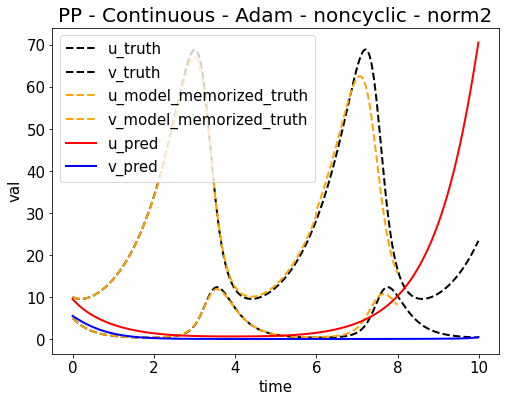

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653413691.png


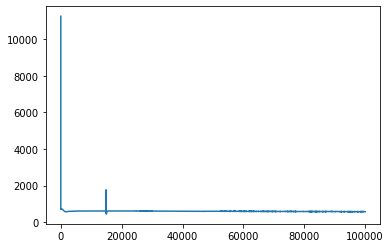

Epoch [105000/1000000] Loss:572.144775 Loss_1:0.272167 Loss_2:3.261790 Loss_3:0.013101 Loss_4:568.597717 Lr:0.001000 Time:77.627860s (26.84min in total, 228.74min remains)
Epoch [110000/1000000] Loss:571.175964 Loss_1:0.251032 Loss_2:3.261570 Loss_3:0.012783 Loss_4:567.650574 Lr:0.001000 Time:76.864012s (28.12min in total, 227.49min remains)
Epoch [115000/1000000] Loss:569.993530 Loss_1:0.249477 Loss_2:3.262815 Loss_3:0.013250 Loss_4:566.468018 Lr:0.001000 Time:77.063787s (29.40min in total, 226.26min remains)
Epoch [120000/1000000] Loss:568.878967 Loss_1:0.252051 Loss_2:3.251731 Loss_3:0.012931 Loss_4:565.362244 Lr:0.001000 Time:77.179158s (30.69min in total, 225.04min remains)
Epoch [125000/1000000] Loss:567.252991 Loss_1:0.247878 Loss_2:3.254535 Loss_3:0.012798 Loss_4:563.737793 Lr:0.001000 Time:76.800072s (31.97min in total, 223.77min remains)
Epoch [130000/1000000] Loss:566.638123 Loss_1:0.247063 Loss_2:3.255253 Loss_3:0.012618 Loss_4:563.123169 Lr:0.001000 Time:77.355336s (33.26m

<Figure size 432x288 with 0 Axes>

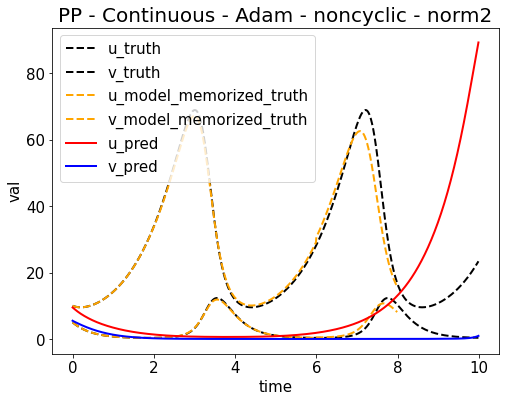

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653414460.png


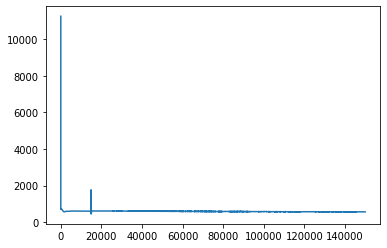

Epoch [155000/1000000] Loss:564.798767 Loss_1:0.249189 Loss_2:3.256440 Loss_3:0.012675 Loss_4:561.280457 Lr:0.001000 Time:78.177139s (39.65min in total, 216.18min remains)
Epoch [160000/1000000] Loss:562.868164 Loss_1:0.249859 Loss_2:3.250549 Loss_3:0.012142 Loss_4:559.355591 Lr:0.001000 Time:76.211676s (40.92min in total, 214.85min remains)
Epoch [165000/1000000] Loss:560.927917 Loss_1:0.214316 Loss_2:3.327802 Loss_3:0.010559 Loss_4:557.375244 Lr:0.001000 Time:76.053401s (42.19min in total, 213.52min remains)
Epoch [170000/1000000] Loss:562.064941 Loss_1:0.247509 Loss_2:3.253159 Loss_3:0.011956 Loss_4:558.552307 Lr:0.001000 Time:75.833167s (43.46min in total, 212.17min remains)
Epoch [175000/1000000] Loss:560.515747 Loss_1:0.233255 Loss_2:3.280868 Loss_3:0.010871 Loss_4:556.990784 Lr:0.001000 Time:76.344736s (44.73min in total, 210.86min remains)
Epoch [180000/1000000] Loss:562.619019 Loss_1:0.272719 Loss_2:3.233041 Loss_3:0.013315 Loss_4:559.099915 Lr:0.001000 Time:75.862130s (45.99m

<Figure size 432x288 with 0 Axes>

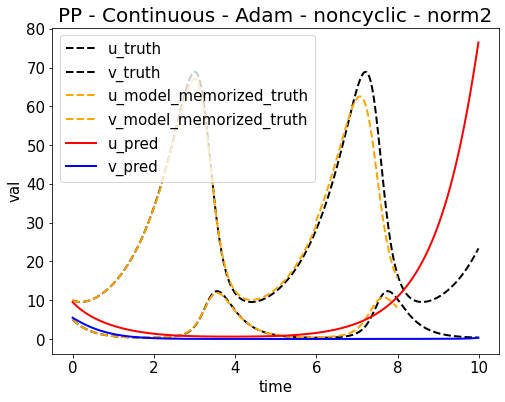

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653415223.png


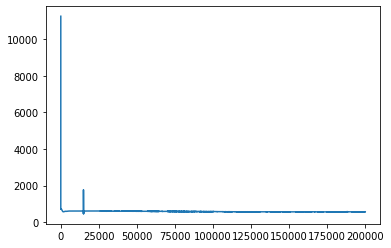

Epoch [205000/1000000] Loss:560.009949 Loss_1:0.247508 Loss_2:3.252861 Loss_3:0.011580 Loss_4:556.497986 Lr:0.001000 Time:78.024623s (52.37min in total, 203.10min remains)
Epoch [210000/1000000] Loss:559.522827 Loss_1:0.244729 Loss_2:3.255096 Loss_3:0.011498 Loss_4:556.011475 Lr:0.001000 Time:75.708338s (53.63min in total, 201.77min remains)
Epoch [215000/1000000] Loss:559.290100 Loss_1:0.249504 Loss_2:3.250818 Loss_3:0.011497 Loss_4:555.778259 Lr:0.001000 Time:75.968060s (54.90min in total, 200.45min remains)
Epoch [220000/1000000] Loss:558.155701 Loss_1:0.261211 Loss_2:3.240558 Loss_3:0.011876 Loss_4:554.642029 Lr:0.001000 Time:76.059868s (56.17min in total, 199.14min remains)
Epoch [225000/1000000] Loss:557.103943 Loss_1:0.255673 Loss_2:3.246568 Loss_3:0.011305 Loss_4:553.590393 Lr:0.001000 Time:75.916114s (57.43min in total, 197.83min remains)
Epoch [230000/1000000] Loss:561.498840 Loss_1:0.246089 Loss_2:3.253988 Loss_3:0.011752 Loss_4:557.987000 Lr:0.001000 Time:76.207502s (58.70m

<Figure size 432x288 with 0 Axes>

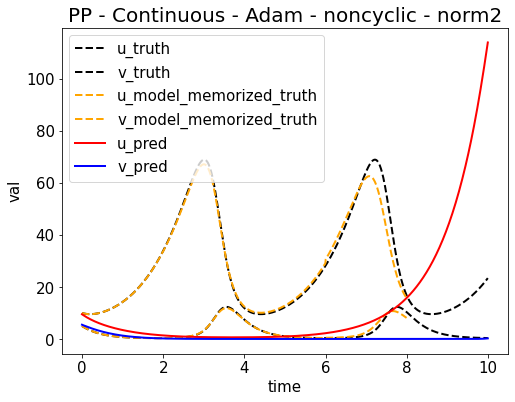

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653415986.png


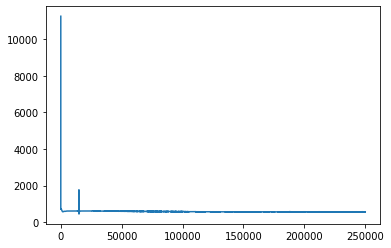

Epoch [255000/1000000] Loss:553.961426 Loss_1:0.248401 Loss_2:3.258012 Loss_3:0.011003 Loss_4:550.444031 Lr:0.001000 Time:77.872682s (65.08min in total, 190.14min remains)
Epoch [260000/1000000] Loss:559.745239 Loss_1:0.239316 Loss_2:3.267437 Loss_3:0.011336 Loss_4:556.227173 Lr:0.001000 Time:76.204985s (66.35min in total, 188.85min remains)
Epoch [265000/1000000] Loss:562.592896 Loss_1:0.370222 Loss_2:3.254562 Loss_3:0.011346 Loss_4:558.956787 Lr:0.001000 Time:76.142305s (67.62min in total, 187.55min remains)
Epoch [270000/1000000] Loss:554.302856 Loss_1:0.256424 Loss_2:3.254642 Loss_3:0.011239 Loss_4:550.780579 Lr:0.001000 Time:76.424092s (68.89min in total, 186.27min remains)
Epoch [275000/1000000] Loss:560.723389 Loss_1:0.247128 Loss_2:3.252399 Loss_3:0.011641 Loss_4:557.212219 Lr:0.001000 Time:76.004828s (70.16min in total, 184.97min remains)
Epoch [280000/1000000] Loss:553.726685 Loss_1:0.245227 Loss_2:3.256505 Loss_3:0.010235 Loss_4:550.214722 Lr:0.001000 Time:76.314619s (71.43m

<Figure size 432x288 with 0 Axes>

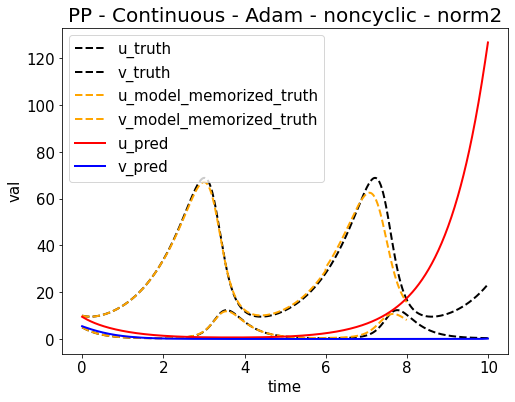

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653416750.png


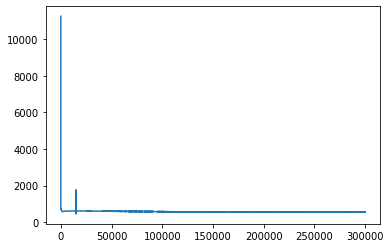

Epoch [305000/1000000] Loss:552.093811 Loss_1:0.245752 Loss_2:3.251214 Loss_3:0.010387 Loss_4:548.586487 Lr:0.001000 Time:78.161870s (77.83min in total, 177.35min remains)
Epoch [310000/1000000] Loss:558.218445 Loss_1:0.247573 Loss_2:3.252556 Loss_3:0.011277 Loss_4:554.707031 Lr:0.001000 Time:76.311796s (79.10min in total, 176.06min remains)
Epoch [315000/1000000] Loss:566.052246 Loss_1:0.247796 Loss_2:3.254686 Loss_3:0.012531 Loss_4:562.537231 Lr:0.001000 Time:76.601335s (80.38min in total, 174.79min remains)
Epoch [320000/1000000] Loss:545.695190 Loss_1:0.251170 Loss_2:3.247684 Loss_3:0.009547 Loss_4:542.186768 Lr:0.001000 Time:76.729451s (81.66min in total, 173.52min remains)
Epoch [325000/1000000] Loss:545.855164 Loss_1:0.248796 Loss_2:3.247108 Loss_3:0.009505 Loss_4:542.349731 Lr:0.001000 Time:76.569612s (82.93min in total, 172.24min remains)
Epoch [330000/1000000] Loss:559.744324 Loss_1:0.247719 Loss_2:3.262111 Loss_3:0.012552 Loss_4:556.221924 Lr:0.001000 Time:76.376954s (84.21m

<Figure size 432x288 with 0 Axes>

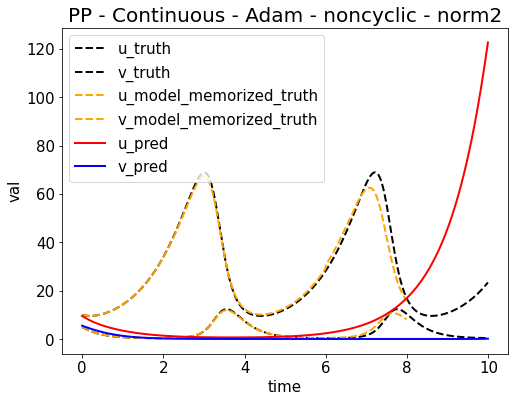

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653417517.png


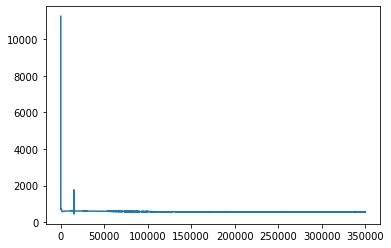

Epoch [355000/1000000] Loss:550.360291 Loss_1:0.245541 Loss_2:3.252187 Loss_3:0.010089 Loss_4:546.852478 Lr:0.001000 Time:78.313347s (90.60min in total, 164.61min remains)
Epoch [360000/1000000] Loss:543.177246 Loss_1:0.249008 Loss_2:3.251731 Loss_3:0.009068 Loss_4:539.667419 Lr:0.001000 Time:76.139855s (91.87min in total, 163.32min remains)
Epoch [365000/1000000] Loss:545.537659 Loss_1:0.259678 Loss_2:3.238320 Loss_3:0.009748 Loss_4:542.029907 Lr:0.001000 Time:75.939601s (93.13min in total, 162.03min remains)
Epoch [370000/1000000] Loss:546.937866 Loss_1:0.244930 Loss_2:3.252126 Loss_3:0.009916 Loss_4:543.430908 Lr:0.001000 Time:76.309376s (94.41min in total, 160.75min remains)
Epoch [375000/1000000] Loss:542.086975 Loss_1:0.253042 Loss_2:3.242405 Loss_3:0.009447 Loss_4:538.582092 Lr:0.001000 Time:76.140640s (95.68min in total, 159.46min remains)
Epoch [380000/1000000] Loss:543.005493 Loss_1:0.240448 Loss_2:3.254963 Loss_3:0.009269 Loss_4:539.500793 Lr:0.001000 Time:76.106626s (96.94m

<Figure size 432x288 with 0 Axes>

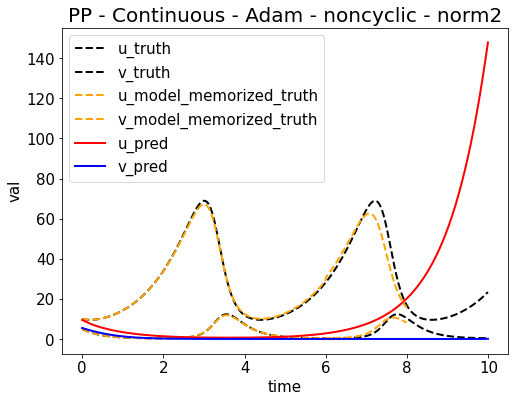

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653418281.png


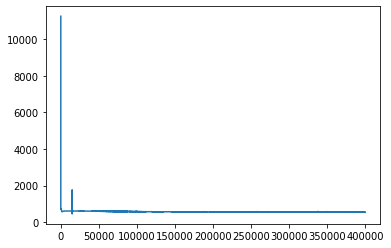

Epoch [405000/1000000] Loss:543.014343 Loss_1:0.248160 Loss_2:3.247599 Loss_3:0.009181 Loss_4:539.509399 Lr:0.001000 Time:78.707822s (103.35min in total, 151.83min remains)
Epoch [410000/1000000] Loss:539.894165 Loss_1:0.248622 Loss_2:3.248415 Loss_3:0.008980 Loss_4:536.388123 Lr:0.001000 Time:76.407975s (104.62min in total, 150.55min remains)
Epoch [415000/1000000] Loss:541.185059 Loss_1:0.250808 Loss_2:3.248439 Loss_3:0.009439 Loss_4:537.676392 Lr:0.001000 Time:76.761190s (105.90min in total, 149.28min remains)
Epoch [420000/1000000] Loss:540.350342 Loss_1:0.258265 Loss_2:3.235867 Loss_3:0.009027 Loss_4:536.847168 Lr:0.001000 Time:76.748907s (107.18min in total, 148.01min remains)
Epoch [425000/1000000] Loss:543.142639 Loss_1:0.245416 Loss_2:3.250452 Loss_3:0.009080 Loss_4:539.637695 Lr:0.001000 Time:76.700587s (108.46min in total, 146.73min remains)
Epoch [430000/1000000] Loss:536.942566 Loss_1:0.244074 Loss_2:3.260429 Loss_3:0.008813 Loss_4:533.429260 Lr:0.001000 Time:76.609814s (1

<Figure size 432x288 with 0 Axes>

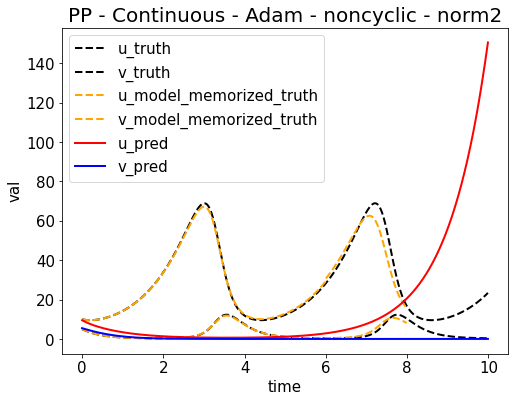

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653419049.png


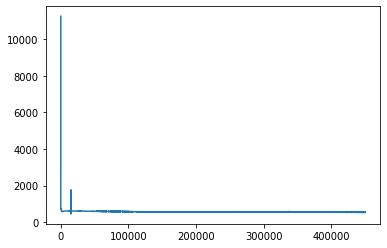

Epoch [455000/1000000] Loss:547.583496 Loss_1:0.260305 Loss_2:3.245530 Loss_3:0.009736 Loss_4:544.067932 Lr:0.001000 Time:78.707909s (116.15min in total, 139.12min remains)
Epoch [460000/1000000] Loss:536.579956 Loss_1:0.262464 Loss_2:3.246471 Loss_3:0.008857 Loss_4:533.062134 Lr:0.001000 Time:76.303551s (117.42min in total, 137.84min remains)
Epoch [465000/1000000] Loss:547.346680 Loss_1:0.246877 Loss_2:3.249417 Loss_3:0.009728 Loss_4:543.840637 Lr:0.001000 Time:75.865959s (118.69min in total, 136.55min remains)
Epoch [470000/1000000] Loss:533.331848 Loss_1:0.220804 Loss_2:3.290624 Loss_3:0.007581 Loss_4:529.812866 Lr:0.001000 Time:76.137590s (119.96min in total, 135.27min remains)
Epoch [475000/1000000] Loss:534.117676 Loss_1:0.241753 Loss_2:3.252723 Loss_3:0.008059 Loss_4:530.615112 Lr:0.001000 Time:76.841525s (121.24min in total, 134.00min remains)
Epoch [480000/1000000] Loss:547.007996 Loss_1:0.251564 Loss_2:3.244879 Loss_3:0.009498 Loss_4:543.502075 Lr:0.001000 Time:76.583217s (1

<Figure size 432x288 with 0 Axes>

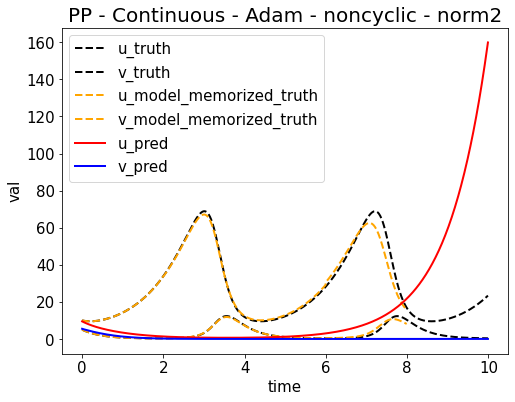

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653419816.png


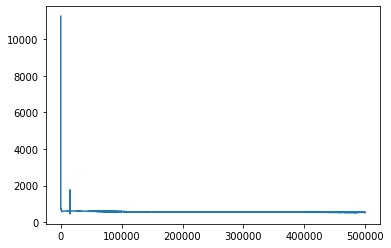

Epoch [505000/1000000] Loss:532.610413 Loss_1:0.245368 Loss_2:3.246032 Loss_3:0.007939 Loss_4:529.111084 Lr:0.001000 Time:78.947241s (128.93min in total, 126.37min remains)
Epoch [510000/1000000] Loss:531.564880 Loss_1:0.248429 Loss_2:3.242820 Loss_3:0.008005 Loss_4:528.065613 Lr:0.001000 Time:76.253103s (130.20min in total, 125.09min remains)
Epoch [515000/1000000] Loss:531.070679 Loss_1:0.247951 Loss_2:3.247225 Loss_3:0.007882 Loss_4:527.567627 Lr:0.001000 Time:76.683373s (131.48min in total, 123.82min remains)
Epoch [520000/1000000] Loss:532.001526 Loss_1:0.255358 Loss_2:3.242292 Loss_3:0.008257 Loss_4:528.495605 Lr:0.001000 Time:76.699451s (132.75min in total, 122.54min remains)
Epoch [525000/1000000] Loss:529.739868 Loss_1:0.244291 Loss_2:3.247496 Loss_3:0.007694 Loss_4:526.240356 Lr:0.001000 Time:76.642447s (134.03min in total, 121.27min remains)
Epoch [530000/1000000] Loss:540.654968 Loss_1:0.245008 Loss_2:3.248702 Loss_3:0.008931 Loss_4:537.152344 Lr:0.001000 Time:76.423042s (1

<Figure size 432x288 with 0 Axes>

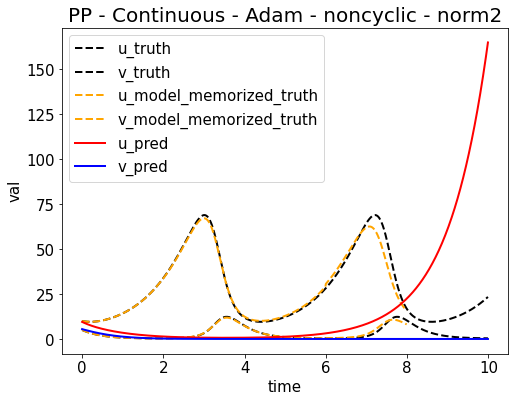

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653420583.png


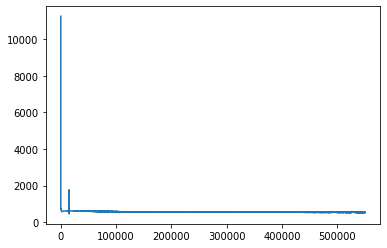

Epoch [555000/1000000] Loss:533.539368 Loss_1:0.236576 Loss_2:3.279438 Loss_3:0.007391 Loss_4:530.015991 Lr:0.001000 Time:78.496496s (141.71min in total, 113.62min remains)
Epoch [560000/1000000] Loss:528.571899 Loss_1:0.229869 Loss_2:3.283730 Loss_3:0.006863 Loss_4:525.051453 Lr:0.001000 Time:76.517657s (142.98min in total, 112.35min remains)
Epoch [565000/1000000] Loss:535.498901 Loss_1:0.246401 Loss_2:3.245956 Loss_3:0.008501 Loss_4:531.998047 Lr:0.001000 Time:76.883321s (144.27min in total, 111.07min remains)
Epoch [570000/1000000] Loss:537.508728 Loss_1:0.244321 Loss_2:3.250394 Loss_3:0.008487 Loss_4:534.005554 Lr:0.001000 Time:76.609318s (145.54min in total, 109.80min remains)
Epoch [575000/1000000] Loss:577.047485 Loss_1:0.231411 Loss_2:3.284824 Loss_3:0.014032 Loss_4:573.517212 Lr:0.001000 Time:76.327263s (146.82min in total, 108.52min remains)
Epoch [580000/1000000] Loss:568.381409 Loss_1:0.244310 Loss_2:3.260720 Loss_3:0.012851 Loss_4:564.863525 Lr:0.001000 Time:76.839299s (1

<Figure size 432x288 with 0 Axes>

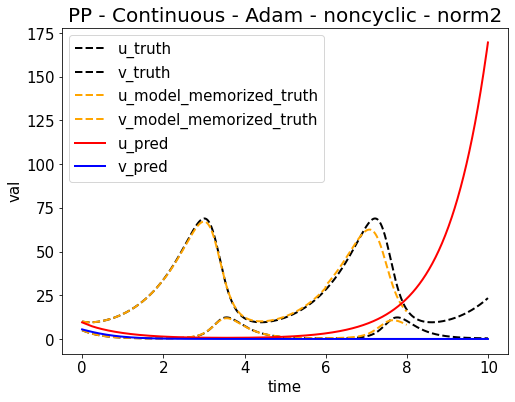

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653421350.png


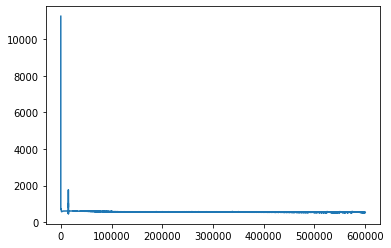

Epoch [605000/1000000] Loss:527.637695 Loss_1:0.249156 Loss_2:3.242746 Loss_3:0.007615 Loss_4:524.138184 Lr:0.001000 Time:78.348737s (154.49min in total, 100.86min remains)
Epoch [610000/1000000] Loss:526.870911 Loss_1:0.248980 Loss_2:3.241507 Loss_3:0.007405 Loss_4:523.373047 Lr:0.001000 Time:76.191118s (155.76min in total, 99.58min remains)
Epoch [615000/1000000] Loss:531.730469 Loss_1:0.248887 Loss_2:3.247642 Loss_3:0.007783 Loss_4:528.226135 Lr:0.001000 Time:75.846768s (157.02min in total, 98.30min remains)
Epoch [620000/1000000] Loss:526.180481 Loss_1:0.245334 Loss_2:3.245135 Loss_3:0.007445 Loss_4:522.682556 Lr:0.001000 Time:76.160287s (158.29min in total, 97.02min remains)
Epoch [625000/1000000] Loss:525.345520 Loss_1:0.235051 Loss_2:3.268931 Loss_3:0.006901 Loss_4:521.834656 Lr:0.001000 Time:76.114604s (159.56min in total, 95.74min remains)
Epoch [630000/1000000] Loss:527.435669 Loss_1:0.251283 Loss_2:3.239467 Loss_3:0.007632 Loss_4:523.937317 Lr:0.001000 Time:76.089347s (160.8

<Figure size 432x288 with 0 Axes>

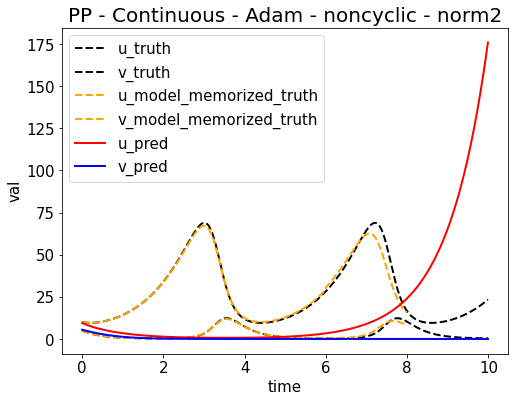

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653422113.png


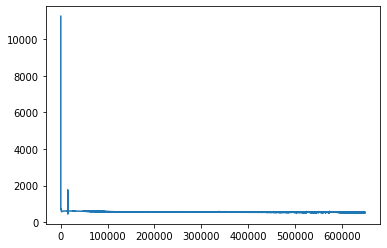

Epoch [655000/1000000] Loss:523.759399 Loss_1:0.257425 Loss_2:3.235579 Loss_3:0.006879 Loss_4:520.259521 Lr:0.001000 Time:78.882339s (167.22min in total, 88.08min remains)
Epoch [660000/1000000] Loss:529.582092 Loss_1:0.246691 Loss_2:3.271441 Loss_3:0.007586 Loss_4:526.056396 Lr:0.001000 Time:76.259720s (168.49min in total, 86.80min remains)
Epoch [665000/1000000] Loss:522.850952 Loss_1:0.255135 Loss_2:3.237316 Loss_3:0.007142 Loss_4:519.351379 Lr:0.001000 Time:76.331926s (169.76min in total, 85.52min remains)
Epoch [670000/1000000] Loss:522.598938 Loss_1:0.231171 Loss_2:3.267165 Loss_3:0.006597 Loss_4:519.093994 Lr:0.001000 Time:76.342971s (171.04min in total, 84.24min remains)
Epoch [675000/1000000] Loss:527.534729 Loss_1:0.225768 Loss_2:3.277667 Loss_3:0.007117 Loss_4:524.024170 Lr:0.001000 Time:77.249528s (172.32min in total, 82.97min remains)
Epoch [680000/1000000] Loss:523.548828 Loss_1:0.261248 Loss_2:3.240291 Loss_3:0.007206 Loss_4:520.040100 Lr:0.001000 Time:76.852684s (173.61

<Figure size 432x288 with 0 Axes>

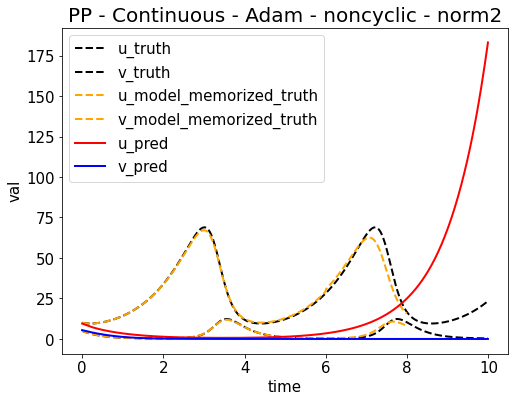

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653422883.png


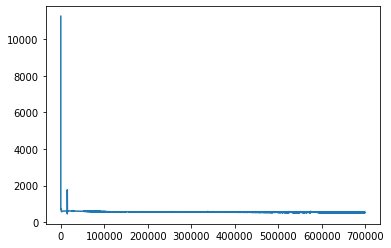

Epoch [705000/1000000] Loss:521.901428 Loss_1:0.253652 Loss_2:3.237022 Loss_3:0.007034 Loss_4:518.403748 Lr:0.001000 Time:79.184886s (180.05min in total, 75.34min remains)
Epoch [710000/1000000] Loss:526.432434 Loss_1:0.246503 Loss_2:3.243610 Loss_3:0.007381 Loss_4:522.934937 Lr:0.001000 Time:76.883061s (181.33min in total, 74.07min remains)
Epoch [715000/1000000] Loss:524.122131 Loss_1:0.257378 Loss_2:3.239612 Loss_3:0.007527 Loss_4:520.617615 Lr:0.001000 Time:76.851182s (182.62min in total, 72.79min remains)
Epoch [720000/1000000] Loss:521.089233 Loss_1:0.240295 Loss_2:3.249829 Loss_3:0.006524 Loss_4:517.592590 Lr:0.001000 Time:76.628760s (183.89min in total, 71.51min remains)
Epoch [725000/1000000] Loss:520.173462 Loss_1:0.247527 Loss_2:3.243163 Loss_3:0.006773 Loss_4:516.676025 Lr:0.001000 Time:76.821497s (185.17min in total, 70.24min remains)
Epoch [730000/1000000] Loss:520.931946 Loss_1:0.242930 Loss_2:3.253576 Loss_3:0.006393 Loss_4:517.429077 Lr:0.001000 Time:76.845937s (186.45

<Figure size 432x288 with 0 Axes>

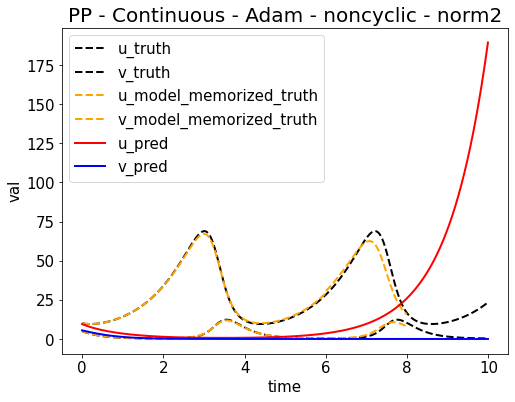

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653423653.png


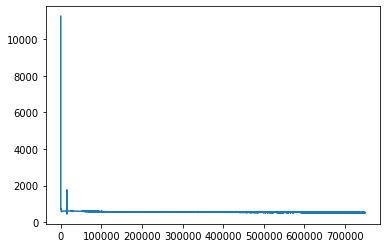

Epoch [755000/1000000] Loss:518.722717 Loss_1:0.246797 Loss_2:3.242076 Loss_3:0.006635 Loss_4:515.227234 Lr:0.001000 Time:79.562697s (192.90min in total, 62.60min remains)
Epoch [760000/1000000] Loss:521.929138 Loss_1:0.210765 Loss_2:3.317407 Loss_3:0.006310 Loss_4:518.394653 Lr:0.001000 Time:76.328662s (194.17min in total, 61.32min remains)
Epoch [765000/1000000] Loss:547.766174 Loss_1:0.246634 Loss_2:3.250061 Loss_3:0.009786 Loss_4:544.259705 Lr:0.001000 Time:76.724634s (195.45min in total, 60.04min remains)
Epoch [770000/1000000] Loss:538.231567 Loss_1:0.251389 Loss_2:3.245812 Loss_3:0.009212 Loss_4:534.725159 Lr:0.001000 Time:76.683639s (196.73min in total, 58.76min remains)
Epoch [775000/1000000] Loss:519.641296 Loss_1:0.231678 Loss_2:3.263946 Loss_3:0.006454 Loss_4:516.139221 Lr:0.001000 Time:76.700162s (198.01min in total, 57.49min remains)
Epoch [780000/1000000] Loss:520.334290 Loss_1:0.249633 Loss_2:3.241226 Loss_3:0.006883 Loss_4:516.836548 Lr:0.001000 Time:76.670878s (199.29

<Figure size 432x288 with 0 Axes>

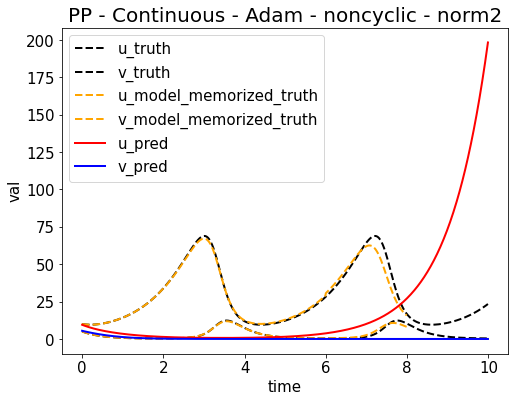

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653424424.png


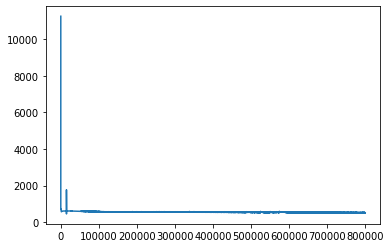

Epoch [805000/1000000] Loss:516.771667 Loss_1:0.238163 Loss_2:3.250864 Loss_3:0.006333 Loss_4:513.276306 Lr:0.001000 Time:80.152656s (205.75min in total, 49.84min remains)
Epoch [810000/1000000] Loss:516.658386 Loss_1:0.236807 Loss_2:3.257037 Loss_3:0.006196 Loss_4:513.158325 Lr:0.001000 Time:76.751216s (207.03min in total, 48.56min remains)
Epoch [815000/1000000] Loss:517.543335 Loss_1:0.240985 Loss_2:3.248474 Loss_3:0.006391 Loss_4:514.047485 Lr:0.001000 Time:76.993694s (208.31min in total, 47.29min remains)
Epoch [820000/1000000] Loss:518.514221 Loss_1:0.253309 Loss_2:3.235185 Loss_3:0.006677 Loss_4:515.019043 Lr:0.001000 Time:76.656664s (209.59min in total, 46.01min remains)
Epoch [825000/1000000] Loss:515.741333 Loss_1:0.243841 Loss_2:3.243693 Loss_3:0.006303 Loss_4:512.247498 Lr:0.001000 Time:76.499688s (210.87min in total, 44.73min remains)
Epoch [830000/1000000] Loss:516.288940 Loss_1:0.250649 Loss_2:3.246690 Loss_3:0.006048 Loss_4:512.785583 Lr:0.001000 Time:76.671845s (212.14

<Figure size 432x288 with 0 Axes>

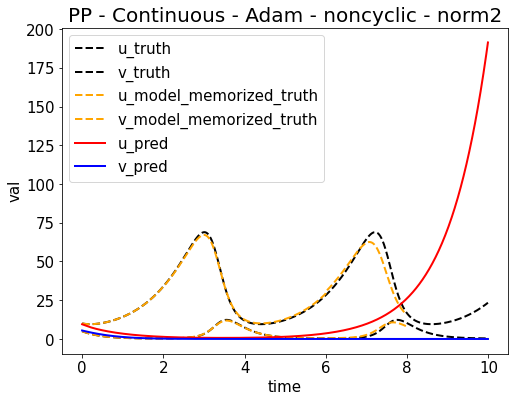

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653425192.png


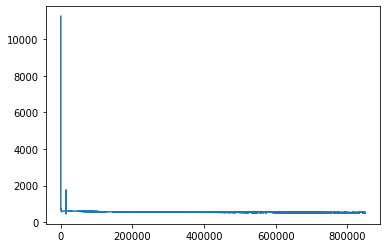

Epoch [855000/1000000] Loss:520.244324 Loss_1:0.252685 Loss_2:3.241204 Loss_3:0.006625 Loss_4:516.743835 Lr:0.001000 Time:79.203640s (218.54min in total, 37.06min remains)
Epoch [860000/1000000] Loss:572.743225 Loss_1:0.295164 Loss_2:3.318862 Loss_3:0.016374 Loss_4:569.112854 Lr:0.001000 Time:75.830245s (219.81min in total, 35.78min remains)
Epoch [865000/1000000] Loss:567.465027 Loss_1:0.244460 Loss_2:3.262476 Loss_3:0.012652 Loss_4:563.945435 Lr:0.001000 Time:76.237798s (221.08min in total, 34.50min remains)
Epoch [870000/1000000] Loss:558.823303 Loss_1:0.229636 Loss_2:3.286745 Loss_3:0.010831 Loss_4:555.296082 Lr:0.001000 Time:76.359544s (222.35min in total, 33.22min remains)
Epoch [875000/1000000] Loss:548.372070 Loss_1:0.247591 Loss_2:3.249108 Loss_3:0.009853 Loss_4:544.865540 Lr:0.001000 Time:75.859967s (223.62min in total, 31.95min remains)
Epoch [880000/1000000] Loss:540.980774 Loss_1:0.273493 Loss_2:3.296643 Loss_3:0.009843 Loss_4:537.400818 Lr:0.001000 Time:76.233867s (224.89

<Figure size 432x288 with 0 Axes>

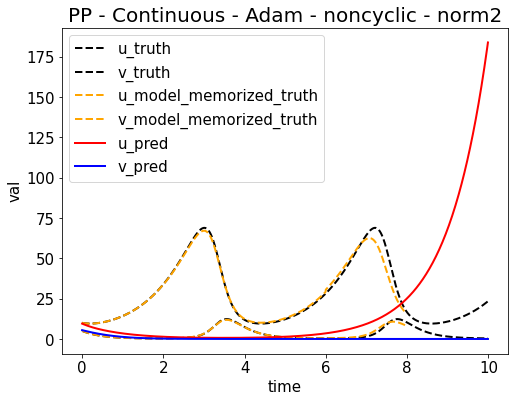

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653425957.png


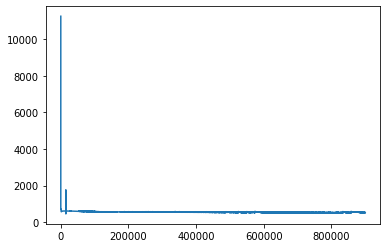

Epoch [905000/1000000] Loss:530.148743 Loss_1:0.245281 Loss_2:3.249002 Loss_3:0.007761 Loss_4:526.646729 Lr:0.001000 Time:79.075598s (231.28min in total, 24.28min remains)
Epoch [910000/1000000] Loss:523.145813 Loss_1:0.227460 Loss_2:3.288845 Loss_3:0.006708 Loss_4:519.622803 Lr:0.001000 Time:76.022105s (232.55min in total, 23.00min remains)
Epoch [915000/1000000] Loss:521.922791 Loss_1:0.251783 Loss_2:3.238020 Loss_3:0.006985 Loss_4:518.426025 Lr:0.001000 Time:75.838582s (233.81min in total, 21.72min remains)
Epoch [920000/1000000] Loss:521.039429 Loss_1:0.251043 Loss_2:3.237941 Loss_3:0.006910 Loss_4:517.543518 Lr:0.001000 Time:76.282474s (235.08min in total, 20.44min remains)
Epoch [925000/1000000] Loss:520.470154 Loss_1:0.247549 Loss_2:3.246076 Loss_3:0.006854 Loss_4:516.969666 Lr:0.001000 Time:76.581294s (236.36min in total, 19.16min remains)
Epoch [930000/1000000] Loss:521.076477 Loss_1:0.249124 Loss_2:3.240127 Loss_3:0.006886 Loss_4:517.580322 Lr:0.001000 Time:76.057788s (237.62

<Figure size 432x288 with 0 Axes>

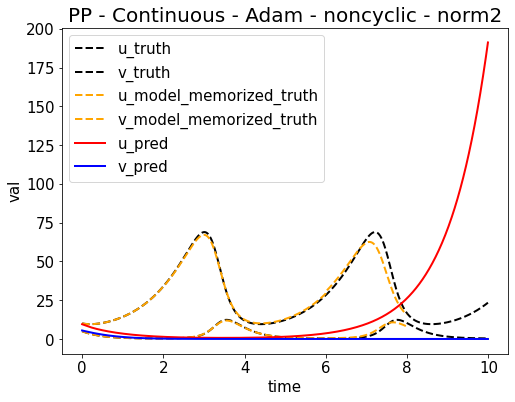

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653426720.png


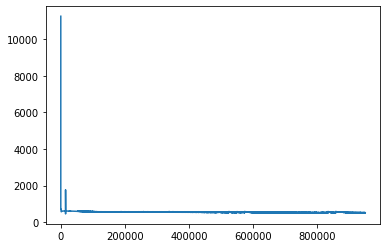

Epoch [955000/1000000] Loss:519.223328 Loss_1:0.252210 Loss_2:3.238461 Loss_3:0.006709 Loss_4:515.725952 Lr:0.001000 Time:78.971267s (244.01min in total, 11.50min remains)
Epoch [960000/1000000] Loss:518.466187 Loss_1:0.250026 Loss_2:3.238705 Loss_3:0.006601 Loss_4:514.970825 Lr:0.001000 Time:76.048882s (245.28min in total, 10.22min remains)
Epoch [965000/1000000] Loss:519.487000 Loss_1:0.248183 Loss_2:3.244807 Loss_3:0.006585 Loss_4:515.987427 Lr:0.001000 Time:76.337908s (246.55min in total, 8.94min remains)
Epoch [970000/1000000] Loss:518.247803 Loss_1:0.256934 Loss_2:3.236562 Loss_3:0.006668 Loss_4:514.747620 Lr:0.001000 Time:76.210410s (247.82min in total, 7.66min remains)
Epoch [975000/1000000] Loss:517.341553 Loss_1:0.203403 Loss_2:3.335235 Loss_3:0.005808 Loss_4:513.797119 Lr:0.001000 Time:75.997371s (249.09min in total, 6.39min remains)
Epoch [980000/1000000] Loss:517.786560 Loss_1:0.231269 Loss_2:3.294254 Loss_3:0.006353 Loss_4:514.254700 Lr:0.001000 Time:76.446324s (250.36min

<Figure size 432x288 with 0 Axes>

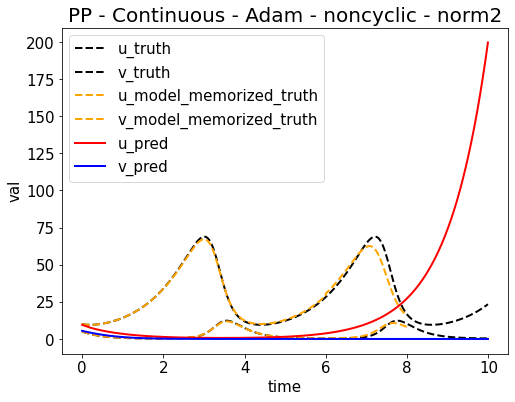

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653427487.png


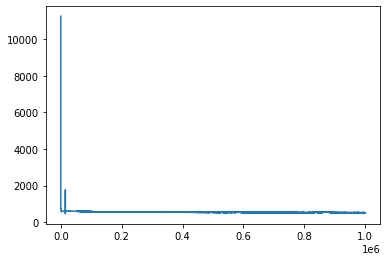

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 5, length of truth = 1000 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.

<Figure size 432x288 with 0 Axes>

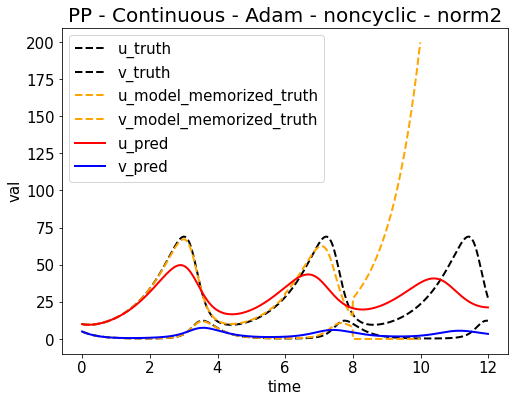

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653428300.png


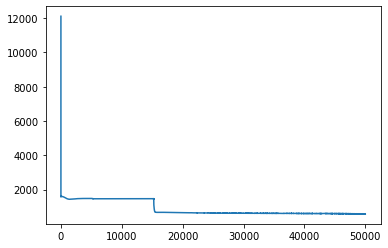

Epoch [55000/1000000] Loss:587.545288 Loss_1:0.000005 Loss_2:0.028884 Loss_3:0.000000 Loss_4:587.516418 Lr:0.001000 Time:81.571677s (14.85min in total, 255.14min remains)
Epoch [60000/1000000] Loss:588.324524 Loss_1:0.000027 Loss_2:0.024386 Loss_3:0.000000 Loss_4:588.300110 Lr:0.001000 Time:80.543389s (16.19min in total, 253.67min remains)
Epoch [65000/1000000] Loss:590.116699 Loss_1:0.000585 Loss_2:0.028275 Loss_3:0.000000 Loss_4:590.087830 Lr:0.001000 Time:80.411630s (17.53min in total, 252.19min remains)
Epoch [70000/1000000] Loss:593.183655 Loss_1:0.000309 Loss_2:0.023787 Loss_3:0.000000 Loss_4:593.159546 Lr:0.001000 Time:80.650147s (18.88min in total, 250.79min remains)
Epoch [75000/1000000] Loss:593.622559 Loss_1:0.000149 Loss_2:0.018858 Loss_3:0.000000 Loss_4:593.603577 Lr:0.001000 Time:80.533359s (20.22min in total, 249.36min remains)
Epoch [80000/1000000] Loss:594.538513 Loss_1:0.000152 Loss_2:0.018382 Loss_3:0.000000 Loss_4:594.519958 Lr:0.001000 Time:80.123426s (21.55min in 

<Figure size 432x288 with 0 Axes>

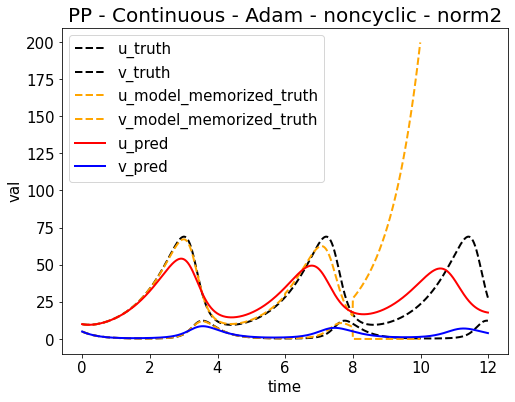

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653429105.png


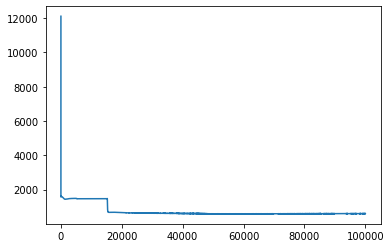

Epoch [105000/1000000] Loss:600.820190 Loss_1:0.000414 Loss_2:0.016761 Loss_3:0.000000 Loss_4:600.803040 Lr:0.001000 Time:81.839973s (28.26min in total, 240.88min remains)
Epoch [110000/1000000] Loss:601.977600 Loss_1:0.000005 Loss_2:0.017224 Loss_3:0.000000 Loss_4:601.960388 Lr:0.001000 Time:80.281568s (29.60min in total, 239.47min remains)
Epoch [115000/1000000] Loss:602.128906 Loss_1:0.000012 Loss_2:0.017475 Loss_3:0.000000 Loss_4:602.111389 Lr:0.001000 Time:80.348142s (30.94min in total, 238.08min remains)
Epoch [120000/1000000] Loss:604.182556 Loss_1:0.000082 Loss_2:0.012079 Loss_3:0.000000 Loss_4:604.170410 Lr:0.001000 Time:80.527459s (32.28min in total, 236.71min remains)
Epoch [125000/1000000] Loss:603.824890 Loss_1:0.000003 Loss_2:0.026402 Loss_3:0.000000 Loss_4:603.798462 Lr:0.001000 Time:80.112375s (33.61min in total, 235.30min remains)
Epoch [130000/1000000] Loss:606.401611 Loss_1:0.000215 Loss_2:0.320095 Loss_3:0.000000 Loss_4:606.081299 Lr:0.001000 Time:80.559559s (34.96m

<Figure size 432x288 with 0 Axes>

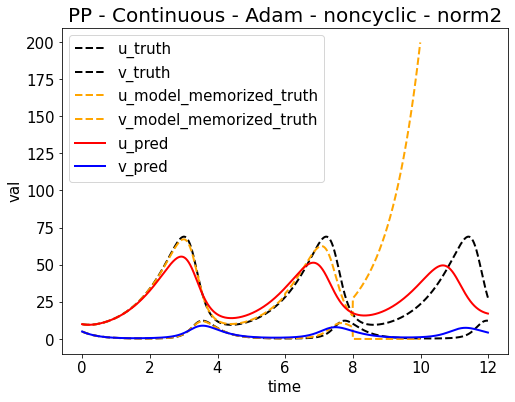

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653429910.png


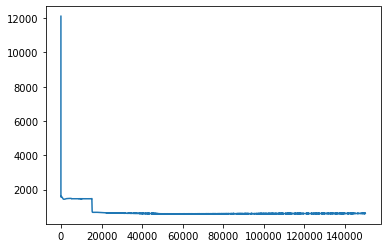

Epoch [155000/1000000] Loss:610.424561 Loss_1:0.000000 Loss_2:0.013177 Loss_3:0.000000 Loss_4:610.411377 Lr:0.001000 Time:82.230938s (41.69min in total, 227.28min remains)
Epoch [160000/1000000] Loss:610.104736 Loss_1:0.000030 Loss_2:0.024231 Loss_3:0.000000 Loss_4:610.080505 Lr:0.001000 Time:80.313461s (43.03min in total, 225.90min remains)
Epoch [165000/1000000] Loss:610.098022 Loss_1:0.000001 Loss_2:0.009578 Loss_3:0.000000 Loss_4:610.088440 Lr:0.001000 Time:80.621642s (44.37min in total, 224.55min remains)
Epoch [170000/1000000] Loss:612.225586 Loss_1:0.000030 Loss_2:0.025021 Loss_3:0.000000 Loss_4:612.200562 Lr:0.001000 Time:80.447748s (45.71min in total, 223.19min remains)
Epoch [175000/1000000] Loss:612.655396 Loss_1:0.000644 Loss_2:0.195010 Loss_3:0.000000 Loss_4:612.459717 Lr:0.001000 Time:80.242389s (47.05min in total, 221.81min remains)
Epoch [180000/1000000] Loss:613.067688 Loss_1:0.000003 Loss_2:0.008311 Loss_3:0.000000 Loss_4:613.059387 Lr:0.001000 Time:80.542317s (48.39m

<Figure size 432x288 with 0 Axes>

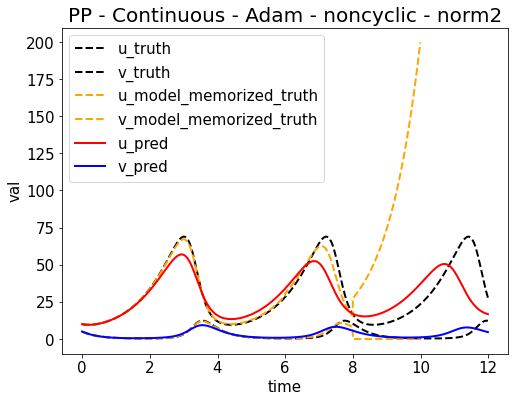

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653430716.png


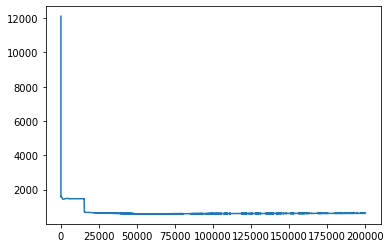

Epoch [205000/1000000] Loss:617.087646 Loss_1:0.000001 Loss_2:0.009064 Loss_3:0.000000 Loss_4:617.078552 Lr:0.001000 Time:81.849112s (55.12min in total, 213.75min remains)
Epoch [210000/1000000] Loss:616.623657 Loss_1:0.001129 Loss_2:0.115764 Loss_3:0.000000 Loss_4:616.506775 Lr:0.001000 Time:80.111509s (56.45min in total, 212.37min remains)
Epoch [215000/1000000] Loss:618.129883 Loss_1:0.000094 Loss_2:0.024864 Loss_3:0.000000 Loss_4:618.104919 Lr:0.001000 Time:80.796049s (57.80min in total, 211.04min remains)
Epoch [220000/1000000] Loss:617.706726 Loss_1:0.000024 Loss_2:0.010704 Loss_3:0.000000 Loss_4:617.695984 Lr:0.001000 Time:80.650816s (59.14min in total, 209.70min remains)
Epoch [225000/1000000] Loss:619.178894 Loss_1:0.000011 Loss_2:0.009641 Loss_3:0.000000 Loss_4:619.169250 Lr:0.001000 Time:80.891158s (60.49min in total, 208.36min remains)
Epoch [230000/1000000] Loss:618.744141 Loss_1:0.000014 Loss_2:0.008295 Loss_3:0.000000 Loss_4:618.735840 Lr:0.001000 Time:80.691762s (61.84m

<Figure size 432x288 with 0 Axes>

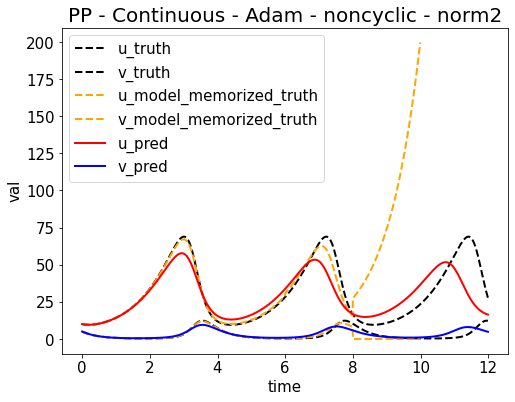

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653431525.png


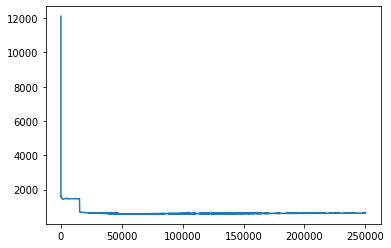

Epoch [255000/1000000] Loss:622.347778 Loss_1:0.000012 Loss_2:0.007611 Loss_3:0.000000 Loss_4:622.340149 Lr:0.001000 Time:82.810394s (68.60min in total, 200.43min remains)
Epoch [260000/1000000] Loss:621.867554 Loss_1:0.001047 Loss_2:0.054570 Loss_3:0.000000 Loss_4:621.811951 Lr:0.001000 Time:81.091303s (69.96min in total, 199.11min remains)
Epoch [265000/1000000] Loss:623.545593 Loss_1:0.000003 Loss_2:0.009945 Loss_3:0.000000 Loss_4:623.535645 Lr:0.001000 Time:80.516773s (71.30min in total, 197.75min remains)
Epoch [270000/1000000] Loss:624.057983 Loss_1:0.000005 Loss_2:0.006473 Loss_3:0.000000 Loss_4:624.051514 Lr:0.001000 Time:80.810480s (72.65min in total, 196.41min remains)
Epoch [275000/1000000] Loss:623.962646 Loss_1:0.000002 Loss_2:0.006068 Loss_3:0.000000 Loss_4:623.956604 Lr:0.001000 Time:80.614700s (73.99min in total, 195.06min remains)
Epoch [280000/1000000] Loss:624.767212 Loss_1:0.000003 Loss_2:0.005931 Loss_3:0.000000 Loss_4:624.761292 Lr:0.001000 Time:80.553922s (75.33m

<Figure size 432x288 with 0 Axes>

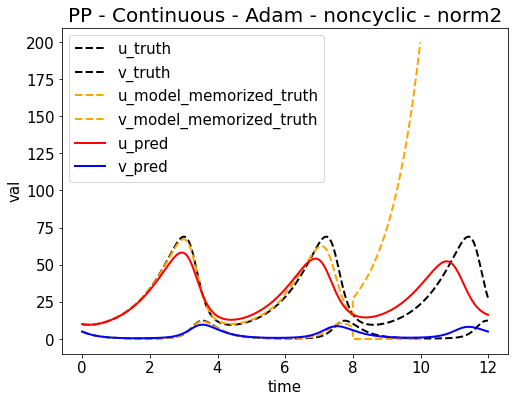

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653432334.png


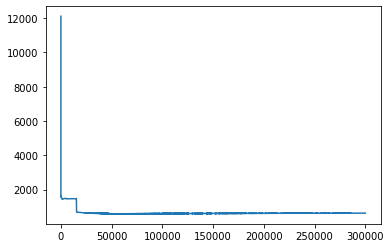

Epoch [305000/1000000] Loss:627.016113 Loss_1:0.000031 Loss_2:0.010277 Loss_3:0.000000 Loss_4:627.005798 Lr:0.001000 Time:82.636149s (82.10min in total, 187.07min remains)
Epoch [310000/1000000] Loss:627.376648 Loss_1:0.000002 Loss_2:0.005858 Loss_3:0.000000 Loss_4:627.370789 Lr:0.001000 Time:81.277556s (83.45min in total, 185.75min remains)
Epoch [315000/1000000] Loss:627.974548 Loss_1:0.000003 Loss_2:0.005561 Loss_3:0.000000 Loss_4:627.968994 Lr:0.001000 Time:81.493703s (84.81min in total, 184.43min remains)
Epoch [320000/1000000] Loss:629.528137 Loss_1:0.000014 Loss_2:0.038269 Loss_3:0.000000 Loss_4:629.489868 Lr:0.001000 Time:80.981468s (86.16min in total, 183.09min remains)
Epoch [325000/1000000] Loss:628.542664 Loss_1:0.000043 Loss_2:0.010383 Loss_3:0.000000 Loss_4:628.532227 Lr:0.001000 Time:80.819256s (87.51min in total, 181.74min remains)
Epoch [330000/1000000] Loss:628.916626 Loss_1:0.000001 Loss_2:0.005723 Loss_3:0.000000 Loss_4:628.910889 Lr:0.001000 Time:80.758731s (88.85m

<Figure size 432x288 with 0 Axes>

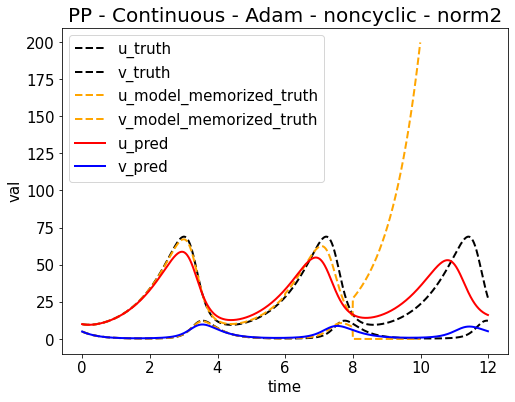

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653433144.png


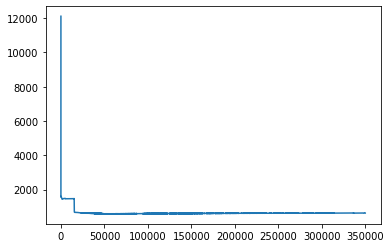

Epoch [355000/1000000] Loss:631.109497 Loss_1:0.000002 Loss_2:0.005054 Loss_3:0.000000 Loss_4:631.104431 Lr:0.001000 Time:82.245094s (95.59min in total, 173.67min remains)
Epoch [360000/1000000] Loss:633.003113 Loss_1:0.000063 Loss_2:0.096923 Loss_3:0.000000 Loss_4:632.906128 Lr:0.001000 Time:80.136684s (96.92min in total, 172.31min remains)
Epoch [365000/1000000] Loss:631.343628 Loss_1:0.000348 Loss_2:0.035465 Loss_3:0.000000 Loss_4:631.307800 Lr:0.001000 Time:80.396412s (98.26min in total, 170.95min remains)
Epoch [370000/1000000] Loss:631.758728 Loss_1:0.000050 Loss_2:0.009263 Loss_3:0.000000 Loss_4:631.749390 Lr:0.001000 Time:80.457739s (99.60min in total, 169.59min remains)
Epoch [375000/1000000] Loss:632.639648 Loss_1:0.000000 Loss_2:0.005202 Loss_3:0.000000 Loss_4:632.634460 Lr:0.001000 Time:80.277735s (100.94min in total, 168.24min remains)
Epoch [380000/1000000] Loss:632.228577 Loss_1:0.000005 Loss_2:0.009949 Loss_3:0.000000 Loss_4:632.218628 Lr:0.001000 Time:80.506202s (102.2

<Figure size 432x288 with 0 Axes>

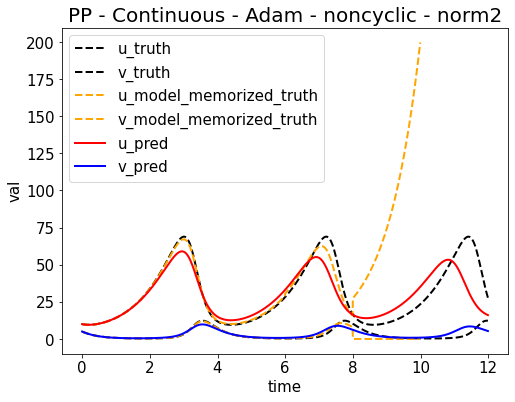

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653433950.png


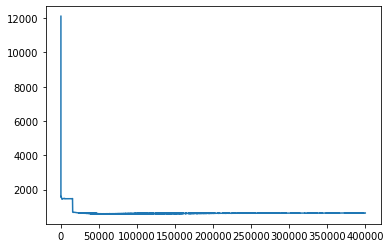

Epoch [405000/1000000] Loss:634.672058 Loss_1:0.000002 Loss_2:0.005437 Loss_3:0.000000 Loss_4:634.666626 Lr:0.001000 Time:83.234834s (109.03min in total, 160.18min remains)
Epoch [410000/1000000] Loss:635.612488 Loss_1:0.000199 Loss_2:0.025413 Loss_3:0.000000 Loss_4:635.586853 Lr:0.001000 Time:80.326727s (110.37min in total, 158.83min remains)
Epoch [415000/1000000] Loss:635.378418 Loss_1:0.000798 Loss_2:0.039434 Loss_3:0.000000 Loss_4:635.338196 Lr:0.001000 Time:80.410742s (111.71min in total, 157.47min remains)
Epoch [420000/1000000] Loss:636.043701 Loss_1:0.000008 Loss_2:0.017952 Loss_3:0.000000 Loss_4:636.025757 Lr:0.001000 Time:80.539835s (113.05min in total, 156.12min remains)
Epoch [425000/1000000] Loss:636.238953 Loss_1:0.000001 Loss_2:0.004694 Loss_3:0.000000 Loss_4:636.234253 Lr:0.001000 Time:80.644357s (114.40min in total, 154.77min remains)
Epoch [430000/1000000] Loss:636.472046 Loss_1:0.000001 Loss_2:0.004372 Loss_3:0.000000 Loss_4:636.467651 Lr:0.001000 Time:80.899244s (1

<Figure size 432x288 with 0 Axes>

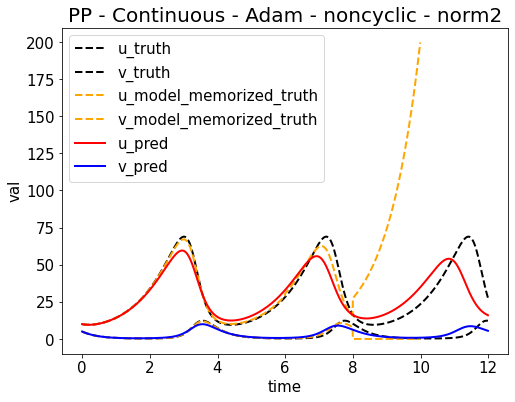

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653434758.png


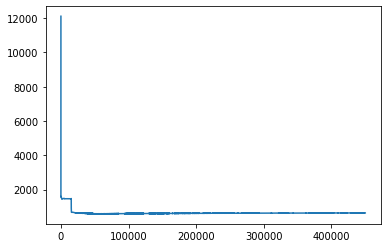

Epoch [455000/1000000] Loss:638.098083 Loss_1:0.000008 Loss_2:0.004228 Loss_3:0.000000 Loss_4:638.093872 Lr:0.001000 Time:82.330692s (122.49min in total, 146.72min remains)
Epoch [460000/1000000] Loss:638.234009 Loss_1:0.000012 Loss_2:0.004912 Loss_3:0.000000 Loss_4:638.229065 Lr:0.001000 Time:80.586126s (123.83min in total, 145.37min remains)
Epoch [465000/1000000] Loss:638.651367 Loss_1:0.000469 Loss_2:0.014271 Loss_3:0.000000 Loss_4:638.636597 Lr:0.001000 Time:80.561966s (125.17min in total, 144.02min remains)
Epoch [470000/1000000] Loss:638.292542 Loss_1:0.000011 Loss_2:0.005376 Loss_3:0.000000 Loss_4:638.287170 Lr:0.001000 Time:80.138549s (126.51min in total, 142.66min remains)
Epoch [475000/1000000] Loss:638.874451 Loss_1:0.000001 Loss_2:0.003971 Loss_3:0.000000 Loss_4:638.870483 Lr:0.001000 Time:80.492025s (127.85min in total, 141.31min remains)
Epoch [480000/1000000] Loss:639.692200 Loss_1:0.000029 Loss_2:0.014104 Loss_3:0.000000 Loss_4:639.678040 Lr:0.001000 Time:80.257365s (1

<Figure size 432x288 with 0 Axes>

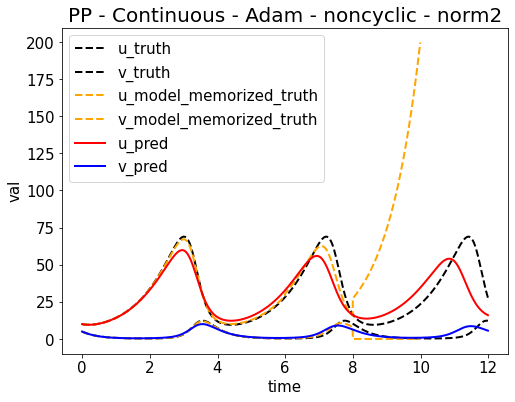

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653435563.png


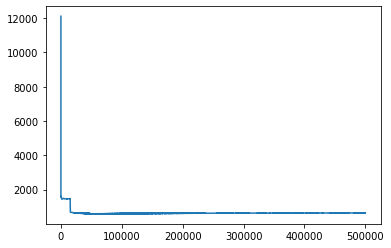

Epoch [505000/1000000] Loss:640.796814 Loss_1:0.000018 Loss_2:0.006395 Loss_3:0.000000 Loss_4:640.790405 Lr:0.001000 Time:83.146415s (135.92min in total, 133.23min remains)
Epoch [510000/1000000] Loss:641.256348 Loss_1:0.000820 Loss_2:0.049482 Loss_3:0.000000 Loss_4:641.206055 Lr:0.001000 Time:80.548947s (137.26min in total, 131.88min remains)
Epoch [515000/1000000] Loss:640.856323 Loss_1:0.000014 Loss_2:0.004508 Loss_3:0.000000 Loss_4:640.851807 Lr:0.001000 Time:80.495291s (138.60min in total, 130.53min remains)
Epoch [520000/1000000] Loss:641.104065 Loss_1:0.000002 Loss_2:0.003710 Loss_3:0.000000 Loss_4:641.100342 Lr:0.001000 Time:80.807495s (139.95min in total, 129.18min remains)
Epoch [525000/1000000] Loss:643.702576 Loss_1:0.000893 Loss_2:0.022598 Loss_3:0.000000 Loss_4:643.679077 Lr:0.001000 Time:80.775824s (141.30min in total, 127.84min remains)
Epoch [530000/1000000] Loss:642.630066 Loss_1:0.000163 Loss_2:0.008630 Loss_3:0.000000 Loss_4:642.621277 Lr:0.001000 Time:80.636163s (1

<Figure size 432x288 with 0 Axes>

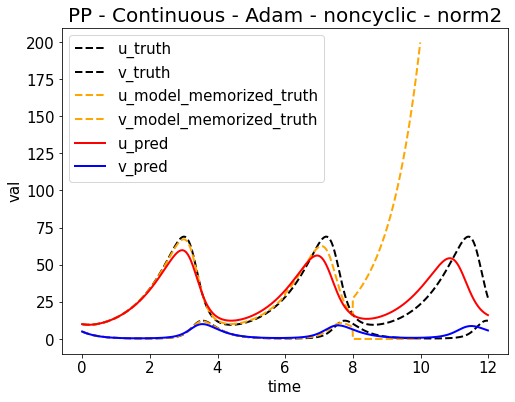

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653436373.png


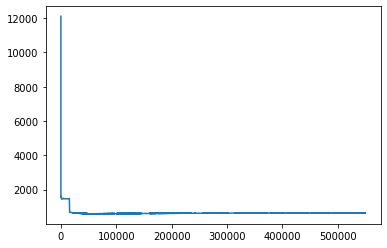

Epoch [555000/1000000] Loss:642.961548 Loss_1:0.000009 Loss_2:0.004169 Loss_3:0.000000 Loss_4:642.957397 Lr:0.001000 Time:83.622808s (149.42min in total, 119.81min remains)
Epoch [560000/1000000] Loss:643.025024 Loss_1:0.000011 Loss_2:0.005761 Loss_3:0.000000 Loss_4:643.019226 Lr:0.001000 Time:81.379363s (150.78min in total, 118.47min remains)
Epoch [565000/1000000] Loss:642.485168 Loss_1:0.000001 Loss_2:0.003637 Loss_3:0.000000 Loss_4:642.481506 Lr:0.001000 Time:81.583740s (152.14min in total, 117.13min remains)
Epoch [570000/1000000] Loss:643.795959 Loss_1:0.000024 Loss_2:0.007924 Loss_3:0.000000 Loss_4:643.788025 Lr:0.001000 Time:81.554076s (153.50min in total, 115.80min remains)
Epoch [575000/1000000] Loss:644.204590 Loss_1:0.000114 Loss_2:0.025801 Loss_3:0.000000 Loss_4:644.178650 Lr:0.001000 Time:81.675427s (154.86min in total, 114.46min remains)
Epoch [580000/1000000] Loss:643.991089 Loss_1:0.000003 Loss_2:0.050715 Loss_3:0.000000 Loss_4:643.940369 Lr:0.001000 Time:82.088159s (1

<Figure size 432x288 with 0 Axes>

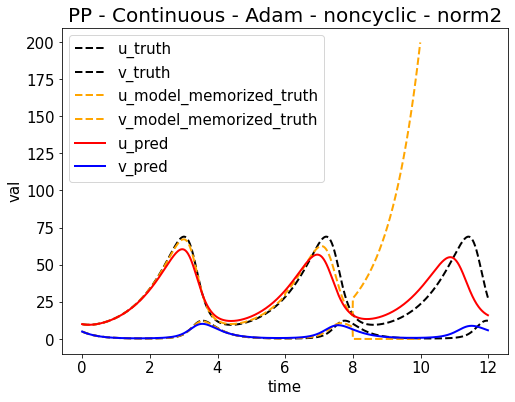

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653437191.png


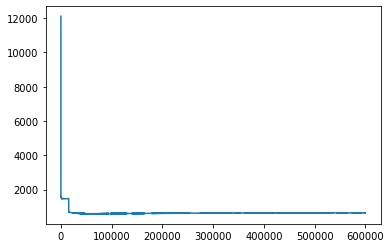

Epoch [605000/1000000] Loss:645.310242 Loss_1:0.000029 Loss_2:0.038113 Loss_3:0.000000 Loss_4:645.272095 Lr:0.001000 Time:84.345656s (163.07min in total, 106.47min remains)
Epoch [610000/1000000] Loss:645.497498 Loss_1:0.000010 Loss_2:0.004340 Loss_3:0.000000 Loss_4:645.493164 Lr:0.001000 Time:81.947207s (164.44min in total, 105.13min remains)
Epoch [615000/1000000] Loss:645.104004 Loss_1:0.000001 Loss_2:0.003341 Loss_3:0.000000 Loss_4:645.100647 Lr:0.001000 Time:81.969836s (165.81min in total, 103.80min remains)
Epoch [620000/1000000] Loss:646.180481 Loss_1:0.000376 Loss_2:0.020238 Loss_3:0.000000 Loss_4:646.159851 Lr:0.001000 Time:81.829462s (167.17min in total, 102.46min remains)
Epoch [625000/1000000] Loss:645.805603 Loss_1:0.000001 Loss_2:0.003408 Loss_3:0.000000 Loss_4:645.802185 Lr:0.001000 Time:81.993778s (168.54min in total, 101.12min remains)
Epoch [630000/1000000] Loss:645.712463 Loss_1:0.000002 Loss_2:0.004028 Loss_3:0.000000 Loss_4:645.708435 Lr:0.001000 Time:81.840406s (1

<Figure size 432x288 with 0 Axes>

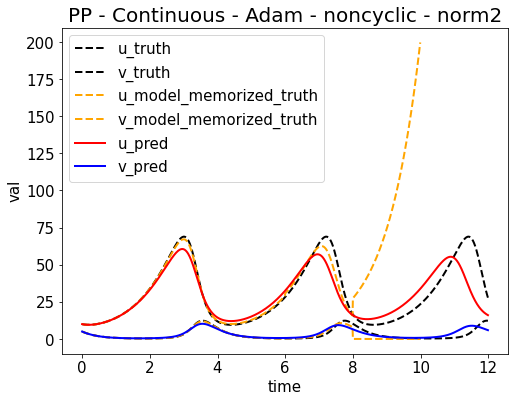

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653438014.png


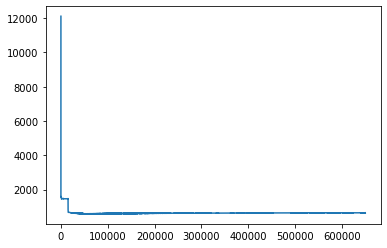

Epoch [655000/1000000] Loss:647.020569 Loss_1:0.000001 Loss_2:0.003202 Loss_3:0.000000 Loss_4:647.017395 Lr:0.001000 Time:84.760290s (176.79min in total, 93.12min remains)
Epoch [660000/1000000] Loss:647.353760 Loss_1:0.000005 Loss_2:0.003548 Loss_3:0.000000 Loss_4:647.350220 Lr:0.001000 Time:82.310208s (178.16min in total, 91.78min remains)
Epoch [665000/1000000] Loss:646.628723 Loss_1:0.000021 Loss_2:0.004312 Loss_3:0.000000 Loss_4:646.624390 Lr:0.001000 Time:82.203264s (179.53min in total, 90.44min remains)
Epoch [670000/1000000] Loss:646.977173 Loss_1:0.000014 Loss_2:0.009510 Loss_3:0.000000 Loss_4:646.967651 Lr:0.001000 Time:82.546488s (180.91min in total, 89.10min remains)
Epoch [675000/1000000] Loss:647.424805 Loss_1:0.000003 Loss_2:0.004392 Loss_3:0.000000 Loss_4:647.420410 Lr:0.001000 Time:82.547323s (182.29min in total, 87.77min remains)
Epoch [680000/1000000] Loss:648.158142 Loss_1:0.000077 Loss_2:0.036451 Loss_3:0.000000 Loss_4:648.121643 Lr:0.001000 Time:82.508275s (183.66

<Figure size 432x288 with 0 Axes>

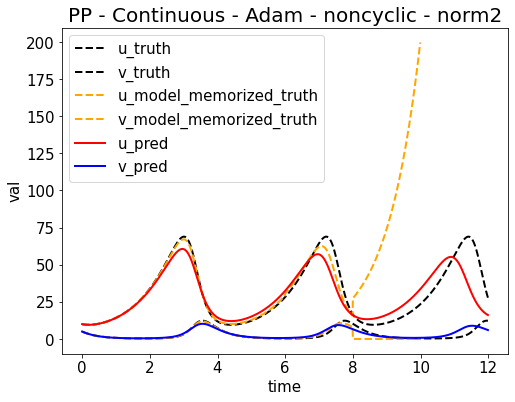

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653438840.png


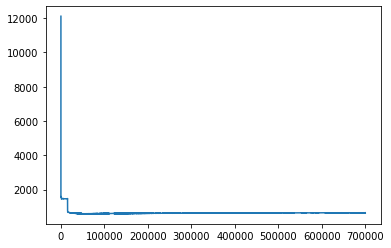

Epoch [705000/1000000] Loss:647.967285 Loss_1:0.000001 Loss_2:0.003008 Loss_3:0.000000 Loss_4:647.964294 Lr:0.001000 Time:85.146409s (190.57min in total, 79.74min remains)
Epoch [710000/1000000] Loss:649.344421 Loss_1:0.000010 Loss_2:0.007578 Loss_3:0.000000 Loss_4:649.336853 Lr:0.001000 Time:82.147051s (191.94min in total, 78.40min remains)
Epoch [715000/1000000] Loss:649.182556 Loss_1:0.000143 Loss_2:0.009638 Loss_3:0.000000 Loss_4:649.172791 Lr:0.001000 Time:82.188460s (193.31min in total, 77.05min remains)
Epoch [720000/1000000] Loss:649.269409 Loss_1:0.000004 Loss_2:0.003367 Loss_3:0.000000 Loss_4:649.266052 Lr:0.001000 Time:82.657646s (194.68min in total, 75.71min remains)
Epoch [725000/1000000] Loss:649.348206 Loss_1:0.000027 Loss_2:0.005780 Loss_3:0.000000 Loss_4:649.342407 Lr:0.001000 Time:82.131516s (196.05min in total, 74.36min remains)
Epoch [730000/1000000] Loss:649.727905 Loss_1:0.000004 Loss_2:0.003080 Loss_3:0.000000 Loss_4:649.724792 Lr:0.001000 Time:82.111409s (197.42

<Figure size 432x288 with 0 Axes>

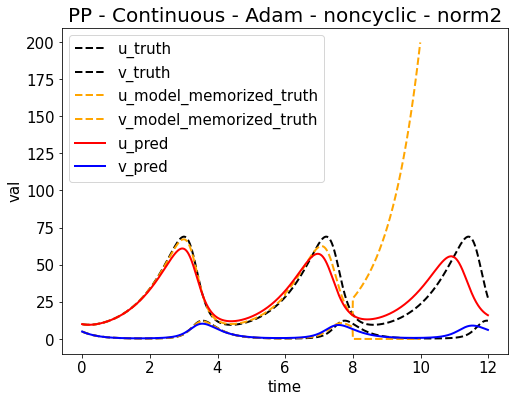

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653439667.png


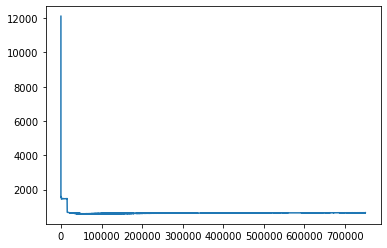

Epoch [755000/1000000] Loss:650.039734 Loss_1:0.000002 Loss_2:0.002919 Loss_3:0.000000 Loss_4:650.036804 Lr:0.001000 Time:85.427966s (204.36min in total, 66.31min remains)
Epoch [760000/1000000] Loss:651.008301 Loss_1:0.000009 Loss_2:0.007255 Loss_3:0.000000 Loss_4:651.001038 Lr:0.001000 Time:82.770719s (205.74min in total, 64.97min remains)
Epoch [765000/1000000] Loss:651.074219 Loss_1:0.000000 Loss_2:0.003758 Loss_3:0.000000 Loss_4:651.070435 Lr:0.001000 Time:82.179224s (207.11min in total, 63.62min remains)
Epoch [770000/1000000] Loss:651.317322 Loss_1:0.000592 Loss_2:0.066383 Loss_3:0.000000 Loss_4:651.250366 Lr:0.001000 Time:82.085920s (208.47min in total, 62.27min remains)
Epoch [775000/1000000] Loss:651.592468 Loss_1:0.000727 Loss_2:0.037699 Loss_3:0.000000 Loss_4:651.554016 Lr:0.001000 Time:82.228080s (209.85min in total, 60.92min remains)
Epoch [780000/1000000] Loss:650.777527 Loss_1:0.000001 Loss_2:0.004290 Loss_3:0.000000 Loss_4:650.773254 Lr:0.001000 Time:82.256046s (211.22

<Figure size 432x288 with 0 Axes>

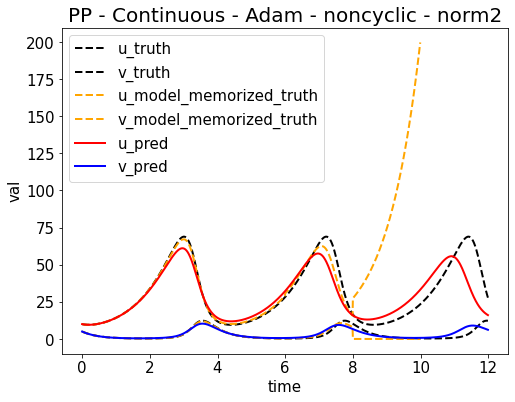

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653440491.png


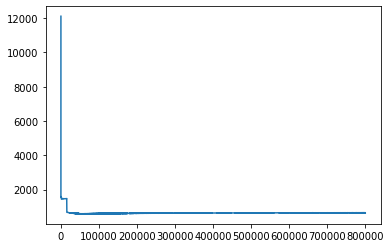

Epoch [805000/1000000] Loss:652.091248 Loss_1:0.000000 Loss_2:0.002826 Loss_3:0.000000 Loss_4:652.088440 Lr:0.001000 Time:84.627362s (218.07min in total, 52.82min remains)
Epoch [810000/1000000] Loss:651.620728 Loss_1:0.000002 Loss_2:0.012265 Loss_3:0.000000 Loss_4:651.608459 Lr:0.001000 Time:81.650394s (219.43min in total, 51.47min remains)
Epoch [815000/1000000] Loss:653.232666 Loss_1:0.000010 Loss_2:0.021092 Loss_3:0.000000 Loss_4:653.211548 Lr:0.001000 Time:81.950880s (220.80min in total, 50.12min remains)
Epoch [820000/1000000] Loss:653.612610 Loss_1:0.000214 Loss_2:0.044159 Loss_3:0.000000 Loss_4:653.568237 Lr:0.001000 Time:81.606552s (222.16min in total, 48.77min remains)
Epoch [825000/1000000] Loss:652.502380 Loss_1:0.000002 Loss_2:0.003123 Loss_3:0.000000 Loss_4:652.499268 Lr:0.001000 Time:81.818353s (223.52min in total, 47.41min remains)
Epoch [830000/1000000] Loss:652.610168 Loss_1:0.000002 Loss_2:0.003949 Loss_3:0.000000 Loss_4:652.606201 Lr:0.001000 Time:81.513227s (224.88

<Figure size 432x288 with 0 Axes>

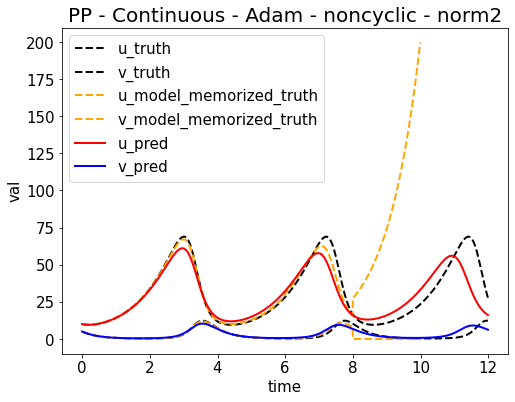

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653441312.png


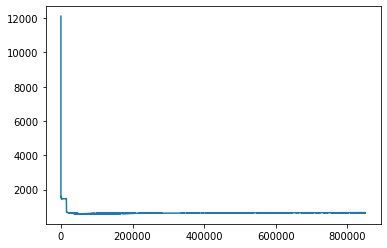

Epoch [855000/1000000] Loss:653.566223 Loss_1:0.000001 Loss_2:0.002596 Loss_3:0.000000 Loss_4:653.563599 Lr:0.001000 Time:84.747742s (231.75min in total, 39.30min remains)
Epoch [860000/1000000] Loss:653.613831 Loss_1:0.000001 Loss_2:0.003070 Loss_3:0.000000 Loss_4:653.610779 Lr:0.001000 Time:81.849478s (233.12min in total, 37.95min remains)
Epoch [865000/1000000] Loss:653.903503 Loss_1:0.000009 Loss_2:0.003219 Loss_3:0.000000 Loss_4:653.900269 Lr:0.001000 Time:82.419596s (234.49min in total, 36.60min remains)
Epoch [870000/1000000] Loss:654.060913 Loss_1:0.000001 Loss_2:0.003133 Loss_3:0.000000 Loss_4:654.057800 Lr:0.001000 Time:81.983559s (235.86min in total, 35.24min remains)
Epoch [875000/1000000] Loss:653.801147 Loss_1:0.000203 Loss_2:0.043906 Loss_3:0.000000 Loss_4:653.757019 Lr:0.001000 Time:82.008067s (237.22min in total, 33.89min remains)
Epoch [880000/1000000] Loss:654.048279 Loss_1:0.000003 Loss_2:0.003002 Loss_3:0.000000 Loss_4:654.045288 Lr:0.001000 Time:82.164938s (238.59

<Figure size 432x288 with 0 Axes>

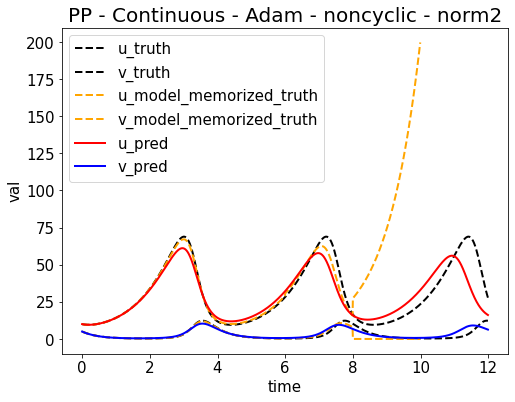

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653442138.png


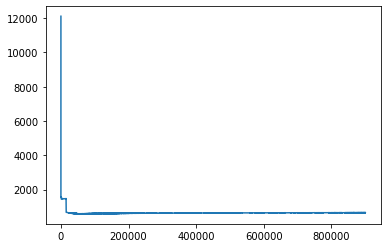

Epoch [905000/1000000] Loss:655.005127 Loss_1:0.000005 Loss_2:0.002745 Loss_3:0.000000 Loss_4:655.002380 Lr:0.001000 Time:85.233757s (245.53min in total, 25.77min remains)
Epoch [910000/1000000] Loss:654.684082 Loss_1:0.000001 Loss_2:0.004697 Loss_3:0.000000 Loss_4:654.679382 Lr:0.001000 Time:81.926526s (246.90min in total, 24.42min remains)
Epoch [915000/1000000] Loss:654.936157 Loss_1:0.000003 Loss_2:0.003138 Loss_3:0.000000 Loss_4:654.933044 Lr:0.001000 Time:81.888190s (248.27min in total, 23.06min remains)
Epoch [920000/1000000] Loss:655.091370 Loss_1:0.000001 Loss_2:0.004235 Loss_3:0.000000 Loss_4:655.087158 Lr:0.001000 Time:82.172627s (249.63min in total, 21.71min remains)
Epoch [925000/1000000] Loss:655.091309 Loss_1:0.000041 Loss_2:0.003639 Loss_3:0.000000 Loss_4:655.087646 Lr:0.001000 Time:82.133555s (251.00min in total, 20.35min remains)
Epoch [930000/1000000] Loss:654.887146 Loss_1:0.000167 Loss_2:0.014291 Loss_3:0.000000 Loss_4:654.872681 Lr:0.001000 Time:82.024820s (252.37

<Figure size 432x288 with 0 Axes>

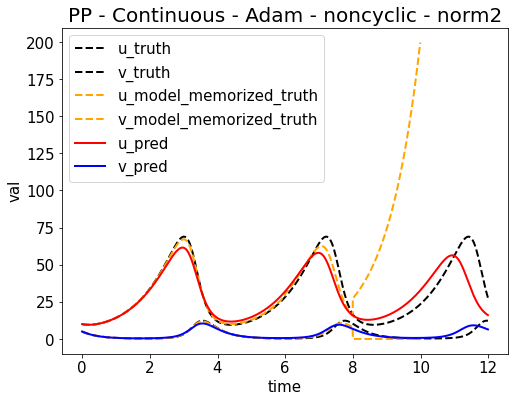

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653442962.png


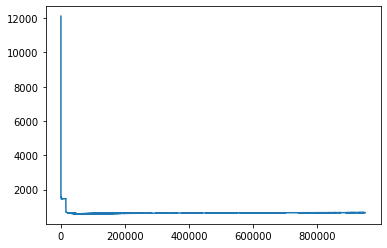

Epoch [955000/1000000] Loss:656.588013 Loss_1:0.000007 Loss_2:0.003930 Loss_3:0.000000 Loss_4:656.584045 Lr:0.001000 Time:85.174106s (259.26min in total, 12.22min remains)
Epoch [960000/1000000] Loss:655.881348 Loss_1:0.000114 Loss_2:0.006591 Loss_3:0.000000 Loss_4:655.874634 Lr:0.001000 Time:82.255671s (260.64min in total, 10.86min remains)
Epoch [965000/1000000] Loss:656.898987 Loss_1:0.000001 Loss_2:0.008849 Loss_3:0.000000 Loss_4:656.890137 Lr:0.001000 Time:81.906347s (262.00min in total, 9.50min remains)
Epoch [970000/1000000] Loss:656.265503 Loss_1:0.000034 Loss_2:0.003803 Loss_3:0.000000 Loss_4:656.261658 Lr:0.001000 Time:82.172389s (263.37min in total, 8.15min remains)
Epoch [975000/1000000] Loss:656.861023 Loss_1:0.000023 Loss_2:0.015489 Loss_3:0.000000 Loss_4:656.845520 Lr:0.001000 Time:82.262284s (264.74min in total, 6.79min remains)
Epoch [980000/1000000] Loss:655.975586 Loss_1:0.000001 Loss_2:0.002507 Loss_3:0.000000 Loss_4:655.973083 Lr:0.001000 Time:82.242899s (266.11min

<Figure size 432x288 with 0 Axes>

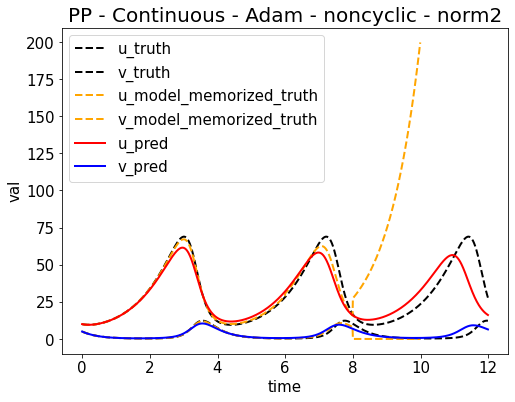

Saved as /content/drive/My Drive/enze/workspace/PINN//figure/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_1653443786.png


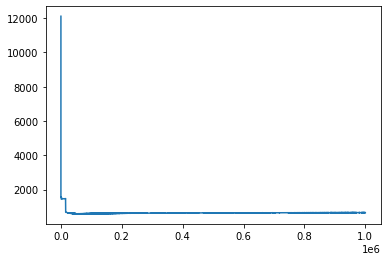

tensor board path: /content/drive/My Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/enze/workspace/PINN//board/SimpleNetworkPP_1000000_5000_0.001_2022-05-24-01-58-49_board
i = 6, length of truth = 1200 now
truth_x: [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.

In [ ]:
# PP continuous
main_path = '/content/drive/My Drive/enze/workspace/PINN/' # ENZE marked: you need to change your main_path if it's not here
run_pp_continue(main_path)

In [ ]:
!pip install numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# PP continuous - A bad case 
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp_continue(main_path)

i = 0, length of truth = 0 now
truth_x: []
truth_y: []
self.truth_dic: {}
using cuda
epoch = 2000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-05-24-01-50-37
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000_1000_0.001_2022-05-24-01-50-37_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000_1000_0.001_2022-05-24-01-50-37_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_2000_1000_0.001_2022-05-24-01-50-37_loss_2000.npy
args = {'epoch': 2000, 'epoch_step': 1000, 'lr': 0.001, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 2000}
config = {'T': 2.0, 'T_unit': 0.01, 'N': 200, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 2.0, 'lb': 0.0, 'continue_period': 0.1, 'round_bit': 3}


KeyboardInterrupt: ignored

In [ ]:
import numpy as np
a = np.asarray([2,3])
b = np.asarray([5,6])
print(a - b)

[-3 -3]


In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window - unit = 200 - T_N = 8000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=/content/drive/My\ Drive/Workspace/PINN/board/SimpleNetworkPP_800000_1000_0.001_2022-05-13-21-31-19_board

In [ ]:
loss = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_800000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-12-18-59-01_loss_800000.npy")

In [ ]:
for i in [120000, 160000, 280000, 320000, 440000,480000, 800000]:
  print(i, loss[i - 1])

120000 0.2303178757429123
160000 0.175078347325325
280000 0.019924668595194817
320000 0.8615744709968567
440000 0.25822311639785767
480000 0.1457986980676651
800000 0.07222574949264526


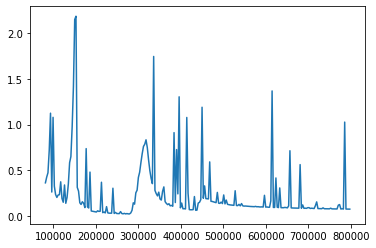

In [ ]:
plt.plot([i for i in range(80000, 800000) if i % 3000 == 0], [loss[i] for i in range(80000, 800000) if i % 3000 == 0])

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window - unit = 200 - T_N = 2000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window - unit = 200 - T_N = 2000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window -  starts at 0.5
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window - unit=200
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window - normal
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 2000000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-05-05-03-23-37
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_loss_2000000.npy
args = {'epoch': 2000000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0, 'sliding_window_step': 50000}
Epoch [01000/2000000] Loss:32.705826 Loss_1:19.852718 Loss_2:12.850096 Loss_3: 0.003013 Lr:0.009091 Time:11.502421s (0.19min 

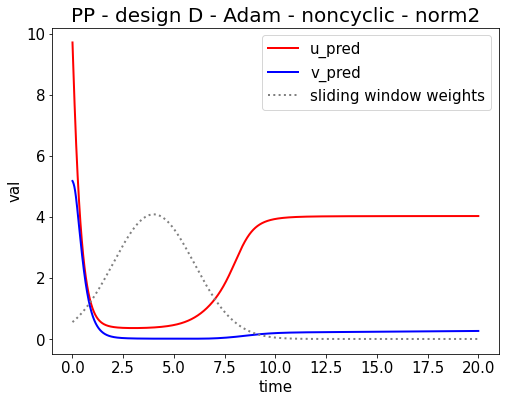

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721128.png


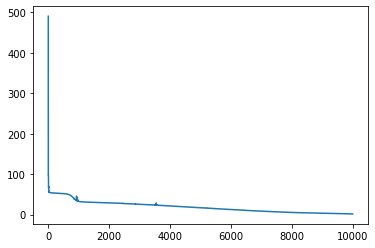

Epoch [11000/2000000] Loss:0.958676 Loss_1:0.009932 Loss_2:0.854878 Loss_3: 0.093865 Lr:0.004762 Time:12.051222s (2.05min in total)
Epoch [12000/2000000] Loss:0.636077 Loss_1:0.010402 Loss_2:0.504856 Loss_3: 0.120819 Lr:0.004545 Time:10.961729s (2.24min in total)
Epoch [13000/2000000] Loss:0.444235 Loss_1:0.000671 Loss_2:0.328513 Loss_3: 0.115051 Lr:0.004348 Time:10.937830s (2.42min in total)
Epoch [14000/2000000] Loss:0.368608 Loss_1:0.000019 Loss_2:0.256007 Loss_3: 0.112583 Lr:0.004167 Time:10.944477s (2.60min in total)
Epoch [15000/2000000] Loss:0.338572 Loss_1:0.000003 Loss_2:0.227505 Loss_3: 0.111064 Lr:0.004000 Time:10.913286s (2.78min in total)
Epoch [16000/2000000] Loss:0.324787 Loss_1:0.000001 Loss_2:0.216144 Loss_3: 0.108642 Lr:0.003846 Time:10.954829s (2.97min in total)
Epoch [17000/2000000] Loss:0.320003 Loss_1:0.000000 Loss_2:0.212219 Loss_3: 0.107784 Lr:0.003704 Time:10.919531s (3.15min in total)
Epoch [18000/2000000] Loss:0.317302 Loss_1:0.000000 Loss_2:0.210262 Loss_3: 

<Figure size 432x288 with 0 Axes>

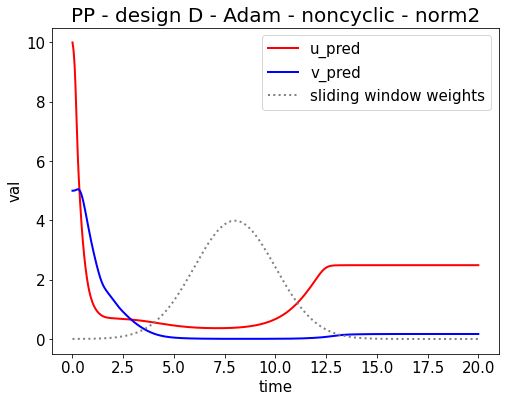

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721239.png


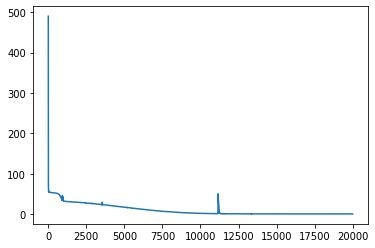

Epoch [21000/2000000] Loss:0.317867 Loss_1:0.000154 Loss_2:0.213380 Loss_3: 0.104333 Lr:0.003226 Time:12.033540s (3.90min in total)
Epoch [22000/2000000] Loss:0.308613 Loss_1:0.000044 Loss_2:0.208763 Loss_3: 0.099805 Lr:0.003125 Time:10.893990s (4.08min in total)
Epoch [23000/2000000] Loss:0.305229 Loss_1:0.000002 Loss_2:0.200388 Loss_3: 0.104839 Lr:0.003030 Time:10.942364s (4.26min in total)
Epoch [24000/2000000] Loss:0.302643 Loss_1:0.000013 Loss_2:0.197325 Loss_3: 0.105306 Lr:0.002941 Time:10.901693s (4.44min in total)
Epoch [25000/2000000] Loss:0.300170 Loss_1:0.000000 Loss_2:0.198157 Loss_3: 0.102013 Lr:0.002857 Time:10.927052s (4.63min in total)
Epoch [26000/2000000] Loss:0.298063 Loss_1:0.000008 Loss_2:0.198608 Loss_3: 0.099446 Lr:0.002778 Time:10.911889s (4.81min in total)
Epoch [27000/2000000] Loss:0.295605 Loss_1:0.000000 Loss_2:0.195451 Loss_3: 0.100154 Lr:0.002703 Time:11.024456s (4.99min in total)
Epoch [28000/2000000] Loss:0.292979 Loss_1:0.000105 Loss_2:0.187652 Loss_3: 

<Figure size 432x288 with 0 Axes>

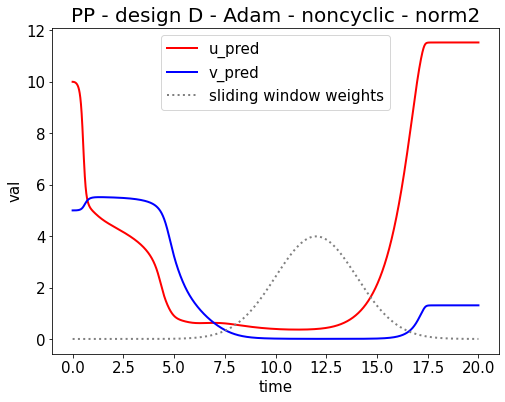

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721349.png


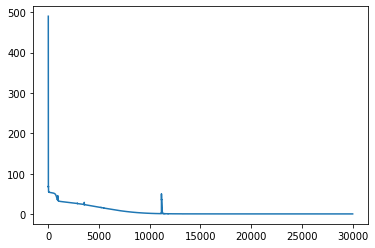

Epoch [31000/2000000] Loss:0.279489 Loss_1:0.000000 Loss_2:0.183973 Loss_3: 0.095516 Lr:0.002439 Time:12.241733s (5.74min in total)
Epoch [32000/2000000] Loss:0.276108 Loss_1:0.000000 Loss_2:0.182276 Loss_3: 0.093832 Lr:0.002381 Time:11.004122s (5.93min in total)
Epoch [33000/2000000] Loss:0.271029 Loss_1:0.000000 Loss_2:0.178916 Loss_3: 0.092113 Lr:0.002326 Time:10.927476s (6.11min in total)
Epoch [34000/2000000] Loss:0.263956 Loss_1:0.000000 Loss_2:0.174806 Loss_3: 0.089149 Lr:0.002273 Time:10.950033s (6.29min in total)
Epoch [35000/2000000] Loss:0.255582 Loss_1:0.000000 Loss_2:0.168752 Loss_3: 0.086830 Lr:0.002222 Time:10.938689s (6.47min in total)
Epoch [36000/2000000] Loss:0.246422 Loss_1:0.000000 Loss_2:0.156008 Loss_3: 0.090414 Lr:0.002174 Time:10.964151s (6.66min in total)
Epoch [37000/2000000] Loss:0.235699 Loss_1:0.000001 Loss_2:0.155959 Loss_3: 0.079740 Lr:0.002128 Time:10.868418s (6.84min in total)
Epoch [38000/2000000] Loss:0.213497 Loss_1:0.000002 Loss_2:0.134646 Loss_3: 

<Figure size 432x288 with 0 Axes>

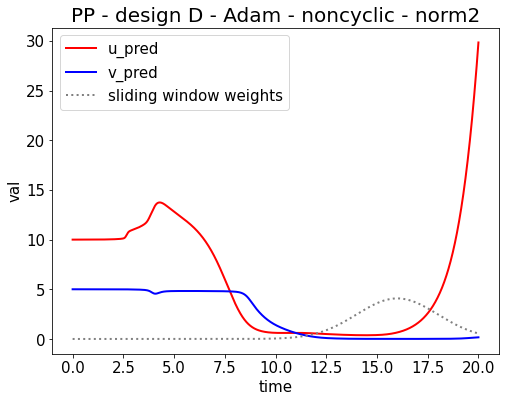

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721460.png


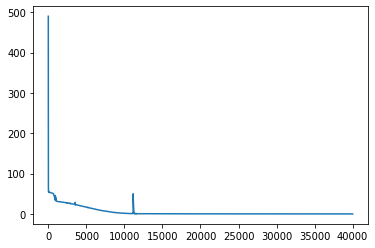

Epoch [41000/2000000] Loss:0.128820 Loss_1:0.000055 Loss_2:0.071202 Loss_3: 0.057564 Lr:0.001961 Time:12.068859s (7.58min in total)
Epoch [42000/2000000] Loss:0.107852 Loss_1:0.000023 Loss_2:0.059852 Loss_3: 0.047978 Lr:0.001923 Time:10.908648s (7.77min in total)
Epoch [43000/2000000] Loss:0.077576 Loss_1:0.000001 Loss_2:0.043574 Loss_3: 0.034001 Lr:0.001887 Time:10.983619s (7.95min in total)
Epoch [44000/2000000] Loss:0.060028 Loss_1:0.000000 Loss_2:0.033045 Loss_3: 0.026982 Lr:0.001852 Time:10.851089s (8.13min in total)
Epoch [45000/2000000] Loss:0.048854 Loss_1:0.000001 Loss_2:0.027283 Loss_3: 0.021571 Lr:0.001818 Time:10.839118s (8.31min in total)
Epoch [46000/2000000] Loss:0.054906 Loss_1:0.000001 Loss_2:0.033026 Loss_3: 0.021879 Lr:0.001786 Time:10.840472s (8.49min in total)
Epoch [47000/2000000] Loss:0.034003 Loss_1:0.000000 Loss_2:0.018663 Loss_3: 0.015340 Lr:0.001754 Time:10.931577s (8.67min in total)
Epoch [48000/2000000] Loss:0.031918 Loss_1:0.000000 Loss_2:0.016655 Loss_3: 

<Figure size 432x288 with 0 Axes>

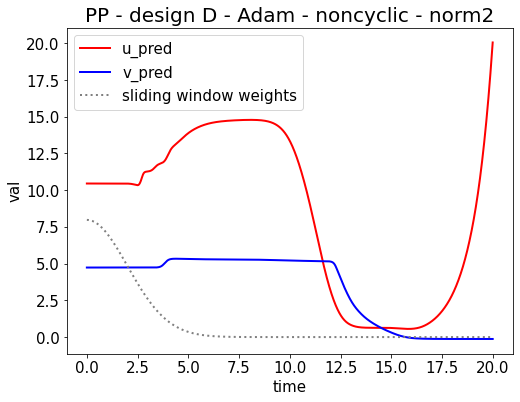

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721570.png


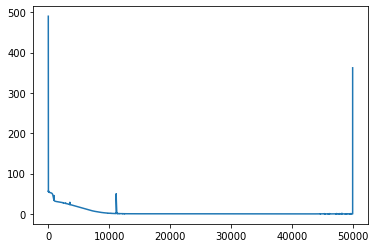

Epoch [51000/2000000] Loss:20.315302 Loss_1:4.236574 Loss_2:16.078728 Loss_3: 0.000000 Lr:0.001639 Time:11.953530s (9.42min in total)
Epoch [52000/2000000] Loss:6.583453 Loss_1:1.042949 Loss_2:5.540504 Loss_3: 0.000000 Lr:0.001613 Time:10.879644s (9.60min in total)
Epoch [53000/2000000] Loss:4.073629 Loss_1:0.238289 Loss_2:3.835340 Loss_3: 0.000000 Lr:0.001587 Time:10.890530s (9.78min in total)
Epoch [54000/2000000] Loss:2.589685 Loss_1:0.151946 Loss_2:2.437740 Loss_3: 0.000000 Lr:0.001563 Time:10.837521s (9.96min in total)
Epoch [55000/2000000] Loss:1.874150 Loss_1:0.068146 Loss_2:1.806004 Loss_3: 0.000000 Lr:0.001538 Time:10.808328s (10.14min in total)
Epoch [56000/2000000] Loss:1.391669 Loss_1:0.036983 Loss_2:1.354686 Loss_3: 0.000000 Lr:0.001515 Time:10.907631s (10.32min in total)
Epoch [57000/2000000] Loss:0.963731 Loss_1:0.020422 Loss_2:0.943308 Loss_3: 0.000000 Lr:0.001493 Time:10.830434s (10.50min in total)
Epoch [58000/2000000] Loss:0.697810 Loss_1:0.009229 Loss_2:0.688581 Los

<Figure size 432x288 with 0 Axes>

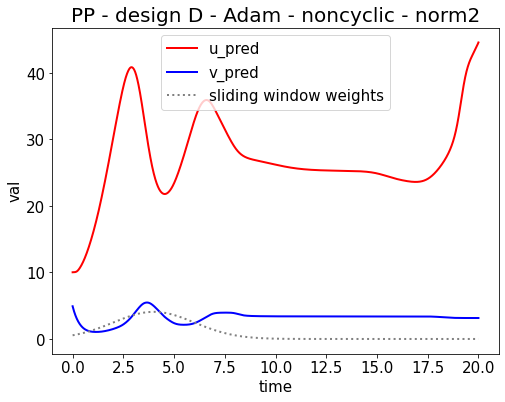

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721680.png


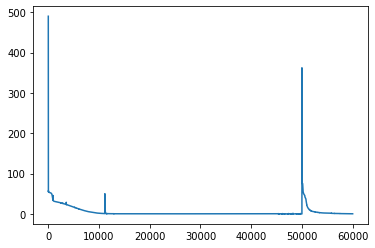

Epoch [61000/2000000] Loss:0.220808 Loss_1:0.000254 Loss_2:0.220554 Loss_3: 0.000000 Lr:0.001408 Time:12.176553s (11.25min in total)
Epoch [62000/2000000] Loss:0.148018 Loss_1:0.000109 Loss_2:0.147909 Loss_3: 0.000000 Lr:0.001389 Time:10.817556s (11.43min in total)
Epoch [63000/2000000] Loss:0.101745 Loss_1:0.000056 Loss_2:0.101689 Loss_3: 0.000000 Lr:0.001370 Time:10.814682s (11.61min in total)
Epoch [64000/2000000] Loss:0.060300 Loss_1:0.000002 Loss_2:0.060298 Loss_3: 0.000000 Lr:0.001351 Time:10.917889s (11.79min in total)
Epoch [65000/2000000] Loss:0.035661 Loss_1:0.000001 Loss_2:0.035661 Loss_3: 0.000000 Lr:0.001333 Time:10.847634s (11.97min in total)
Epoch [66000/2000000] Loss:0.022935 Loss_1:0.000001 Loss_2:0.022934 Loss_3: 0.000000 Lr:0.001316 Time:10.845504s (12.15min in total)
Epoch [67000/2000000] Loss:0.016873 Loss_1:0.000013 Loss_2:0.016860 Loss_3: 0.000000 Lr:0.001299 Time:10.857148s (12.34min in total)
Epoch [68000/2000000] Loss:0.037307 Loss_1:0.000006 Loss_2:0.037301 L

<Figure size 432x288 with 0 Axes>

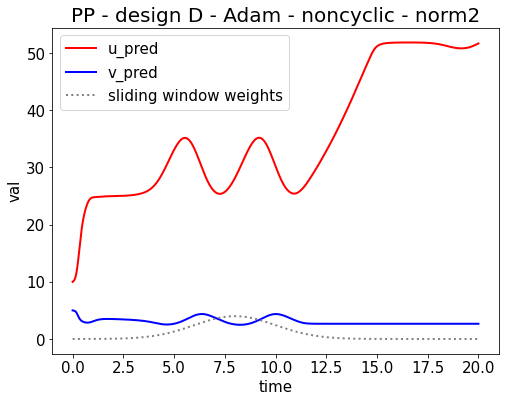

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721790.png


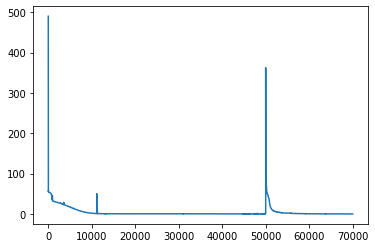

Epoch [71000/2000000] Loss:0.004528 Loss_1:0.000000 Loss_2:0.004528 Loss_3: 0.000000 Lr:0.001235 Time:12.119238s (13.08min in total)
Epoch [72000/2000000] Loss:0.013087 Loss_1:0.000003 Loss_2:0.013084 Loss_3: 0.000000 Lr:0.001220 Time:10.871056s (13.26min in total)
Epoch [73000/2000000] Loss:0.003276 Loss_1:0.000000 Loss_2:0.003276 Loss_3: 0.000000 Lr:0.001205 Time:10.799023s (13.44min in total)
Epoch [74000/2000000] Loss:0.004759 Loss_1:0.000002 Loss_2:0.004757 Loss_3: 0.000000 Lr:0.001190 Time:10.789441s (13.62min in total)
Epoch [75000/2000000] Loss:0.002751 Loss_1:0.000000 Loss_2:0.002751 Loss_3: 0.000000 Lr:0.001176 Time:10.961605s (13.80min in total)
Epoch [76000/2000000] Loss:0.002630 Loss_1:0.000000 Loss_2:0.002630 Loss_3: 0.000000 Lr:0.001163 Time:10.922645s (13.98min in total)
Epoch [77000/2000000] Loss:0.002627 Loss_1:0.000000 Loss_2:0.002626 Loss_3: 0.000000 Lr:0.001149 Time:10.846099s (14.17min in total)
Epoch [78000/2000000] Loss:0.002206 Loss_1:0.000000 Loss_2:0.002206 L

<Figure size 432x288 with 0 Axes>

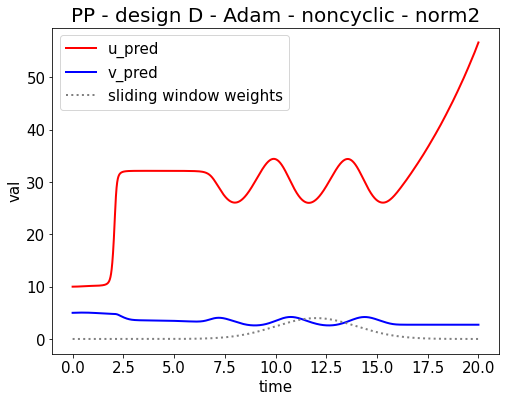

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651721900.png


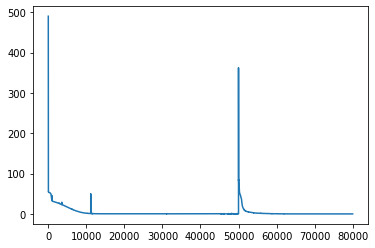

Epoch [81000/2000000] Loss:0.001828 Loss_1:0.000000 Loss_2:0.001828 Loss_3: 0.000000 Lr:0.001099 Time:11.913778s (14.91min in total)
Epoch [82000/2000000] Loss:0.003206 Loss_1:0.000003 Loss_2:0.003203 Loss_3: 0.000000 Lr:0.001087 Time:10.787330s (15.09min in total)
Epoch [83000/2000000] Loss:0.001446 Loss_1:0.000000 Loss_2:0.001446 Loss_3: 0.000000 Lr:0.001075 Time:10.815591s (15.27min in total)
Epoch [84000/2000000] Loss:0.001352 Loss_1:0.000000 Loss_2:0.001352 Loss_3: 0.000000 Lr:0.001064 Time:10.845411s (15.45min in total)
Epoch [85000/2000000] Loss:0.001156 Loss_1:0.000000 Loss_2:0.001156 Loss_3: 0.000000 Lr:0.001053 Time:10.810225s (15.63min in total)
Epoch [86000/2000000] Loss:0.046852 Loss_1:0.000096 Loss_2:0.046756 Loss_3: 0.000000 Lr:0.001042 Time:10.873731s (15.81min in total)
Epoch [87000/2000000] Loss:0.000689 Loss_1:0.000000 Loss_2:0.000689 Loss_3: 0.000000 Lr:0.001031 Time:10.798286s (15.99min in total)
Epoch [88000/2000000] Loss:0.000410 Loss_1:0.000000 Loss_2:0.000410 L

<Figure size 432x288 with 0 Axes>

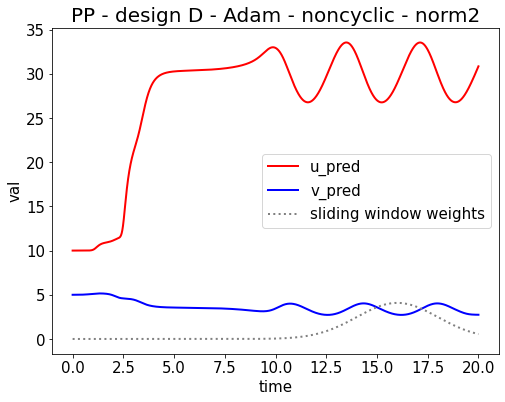

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722009.png


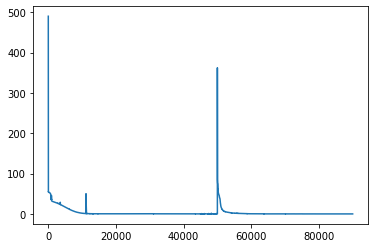

Epoch [91000/2000000] Loss:0.000075 Loss_1:0.000000 Loss_2:0.000075 Loss_3: 0.000000 Lr:0.000990 Time:12.013124s (16.73min in total)
Epoch [92000/2000000] Loss:0.000067 Loss_1:0.000000 Loss_2:0.000067 Loss_3: 0.000000 Lr:0.000980 Time:10.905741s (16.91min in total)
Epoch [93000/2000000] Loss:0.000062 Loss_1:0.000000 Loss_2:0.000062 Loss_3: 0.000000 Lr:0.000971 Time:10.885786s (17.09min in total)
Epoch [94000/2000000] Loss:0.000077 Loss_1:0.000000 Loss_2:0.000077 Loss_3: 0.000000 Lr:0.000962 Time:10.811162s (17.27min in total)
Epoch [95000/2000000] Loss:0.000244 Loss_1:0.000000 Loss_2:0.000244 Loss_3: 0.000000 Lr:0.000952 Time:10.777213s (17.45min in total)
Epoch [96000/2000000] Loss:0.000081 Loss_1:0.000000 Loss_2:0.000081 Loss_3: 0.000000 Lr:0.000943 Time:10.788062s (17.63min in total)
Epoch [97000/2000000] Loss:0.007580 Loss_1:0.000019 Loss_2:0.007560 Loss_3: 0.000000 Lr:0.000935 Time:10.761941s (17.81min in total)
Epoch [98000/2000000] Loss:0.000104 Loss_1:0.000000 Loss_2:0.000104 L

<Figure size 432x288 with 0 Axes>

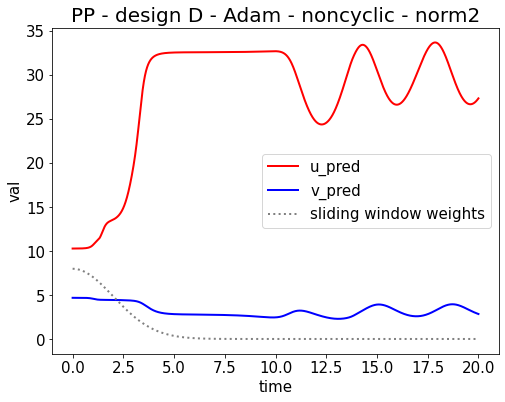

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722118.png


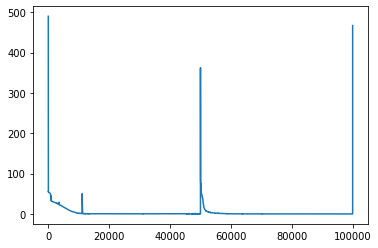

Epoch [101000/2000000] Loss:12.292956 Loss_1:3.134099 Loss_2:9.158857 Loss_3: 0.000000 Lr:0.000901 Time:12.071743s (18.55min in total)
Epoch [102000/2000000] Loss:5.237995 Loss_1:0.505297 Loss_2:4.732697 Loss_3: 0.000000 Lr:0.000893 Time:10.773297s (18.73min in total)
Epoch [103000/2000000] Loss:4.192976 Loss_1:0.223623 Loss_2:3.969354 Loss_3: 0.000000 Lr:0.000885 Time:10.857817s (18.91min in total)
Epoch [104000/2000000] Loss:3.419696 Loss_1:0.140962 Loss_2:3.278734 Loss_3: 0.000000 Lr:0.000877 Time:10.957464s (19.09min in total)
Epoch [105000/2000000] Loss:2.971838 Loss_1:0.081406 Loss_2:2.890432 Loss_3: 0.000000 Lr:0.000870 Time:10.827332s (19.27min in total)
Epoch [106000/2000000] Loss:2.137813 Loss_1:0.052580 Loss_2:2.085232 Loss_3: 0.000000 Lr:0.000862 Time:10.840576s (19.45min in total)
Epoch [107000/2000000] Loss:1.686197 Loss_1:0.022224 Loss_2:1.663972 Loss_3: 0.000000 Lr:0.000855 Time:10.852952s (19.64min in total)
Epoch [108000/2000000] Loss:1.413479 Loss_1:0.011933 Loss_2:1

<Figure size 432x288 with 0 Axes>

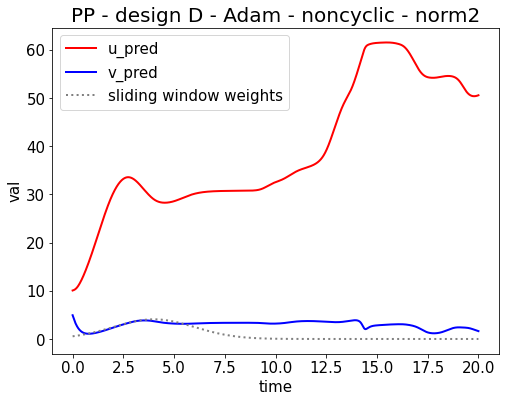

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722228.png


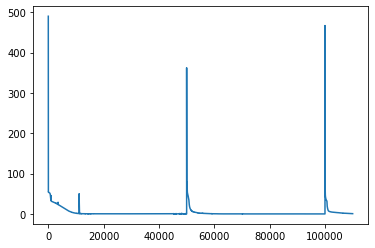

Epoch [111000/2000000] Loss:0.352303 Loss_1:0.001261 Loss_2:0.351043 Loss_3: 0.000000 Lr:0.000826 Time:12.041322s (20.38min in total)
Epoch [112000/2000000] Loss:0.205573 Loss_1:0.000531 Loss_2:0.205042 Loss_3: 0.000000 Lr:0.000820 Time:10.857903s (20.56min in total)
Epoch [113000/2000000] Loss:0.095082 Loss_1:0.000338 Loss_2:0.094743 Loss_3: 0.000000 Lr:0.000813 Time:10.759039s (20.74min in total)
Epoch [114000/2000000] Loss:0.039759 Loss_1:0.000277 Loss_2:0.039482 Loss_3: 0.000000 Lr:0.000806 Time:10.731011s (20.92min in total)
Epoch [115000/2000000] Loss:0.014868 Loss_1:0.000050 Loss_2:0.014818 Loss_3: 0.000000 Lr:0.000800 Time:10.889083s (21.10min in total)
Epoch [116000/2000000] Loss:0.005061 Loss_1:0.000007 Loss_2:0.005055 Loss_3: 0.000000 Lr:0.000794 Time:10.778686s (21.28min in total)
Epoch [117000/2000000] Loss:0.001588 Loss_1:0.000000 Loss_2:0.001588 Loss_3: 0.000000 Lr:0.000787 Time:10.712390s (21.46min in total)
Epoch [118000/2000000] Loss:0.000466 Loss_1:0.000001 Loss_2:0.

<Figure size 432x288 with 0 Axes>

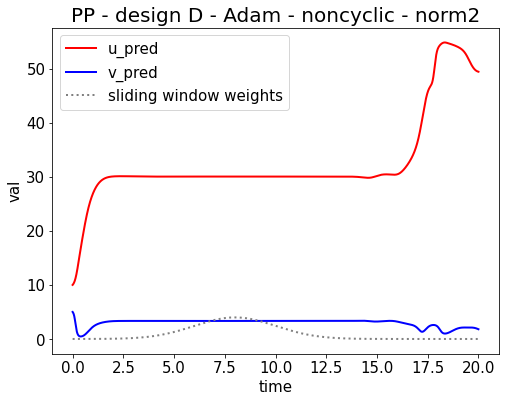

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722337.png


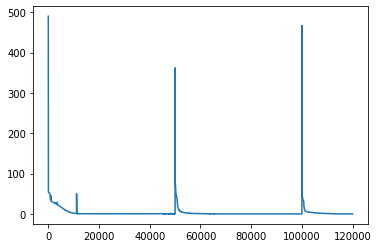

Epoch [121000/2000000] Loss:0.000010 Loss_1:0.000000 Loss_2:0.000010 Loss_3: 0.000000 Lr:0.000763 Time:12.135244s (22.20min in total)
Epoch [122000/2000000] Loss:0.000004 Loss_1:0.000000 Loss_2:0.000004 Loss_3: 0.000000 Lr:0.000758 Time:10.813733s (22.38min in total)
Epoch [123000/2000000] Loss:0.000104 Loss_1:0.000010 Loss_2:0.000093 Loss_3: 0.000000 Lr:0.000752 Time:10.808824s (22.56min in total)
Epoch [124000/2000000] Loss:0.000001 Loss_1:0.000000 Loss_2:0.000001 Loss_3: 0.000000 Lr:0.000746 Time:10.780950s (22.74min in total)
Epoch [125000/2000000] Loss:0.000332 Loss_1:0.000039 Loss_2:0.000293 Loss_3: 0.000000 Lr:0.000741 Time:10.741467s (22.92min in total)
Epoch [126000/2000000] Loss:0.000001 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000735 Time:10.813016s (23.10min in total)
Epoch [127000/2000000] Loss:0.002201 Loss_1:0.000247 Loss_2:0.001954 Loss_3: 0.000000 Lr:0.000730 Time:10.838742s (23.28min in total)
Epoch [128000/2000000] Loss:0.000002 Loss_1:0.000000 Loss_2:0.

<Figure size 432x288 with 0 Axes>

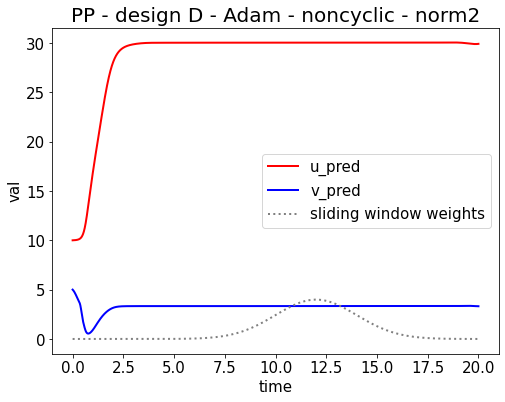

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722446.png


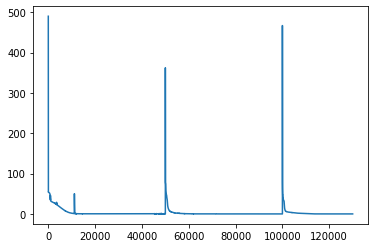

Epoch [131000/2000000] Loss:0.000000 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000709 Time:12.135990s (24.02min in total)
Epoch [132000/2000000] Loss:0.000000 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000704 Time:10.875202s (24.20min in total)
Epoch [133000/2000000] Loss:0.000571 Loss_1:0.000036 Loss_2:0.000535 Loss_3: 0.000000 Lr:0.000699 Time:10.836736s (24.38min in total)
Epoch [134000/2000000] Loss:0.000031 Loss_1:0.000001 Loss_2:0.000029 Loss_3: 0.000000 Lr:0.000694 Time:10.764574s (24.56min in total)
Epoch [135000/2000000] Loss:0.000000 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000690 Time:10.734167s (24.74min in total)
Epoch [136000/2000000] Loss:0.000001 Loss_1:0.000000 Loss_2:0.000001 Loss_3: 0.000000 Lr:0.000685 Time:10.758060s (24.92min in total)
Epoch [137000/2000000] Loss:0.000000 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000680 Time:10.826720s (25.10min in total)
Epoch [138000/2000000] Loss:0.000695 Loss_1:0.000022 Loss_2:0.

<Figure size 432x288 with 0 Axes>

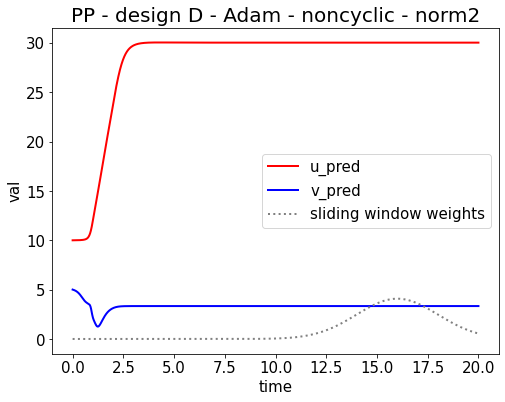

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722556.png


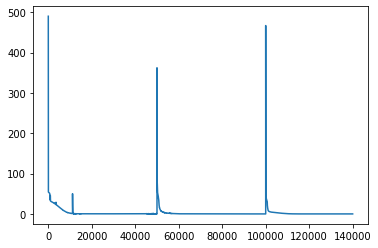

Epoch [141000/2000000] Loss:0.000019 Loss_1:0.000000 Loss_2:0.000018 Loss_3: 0.000000 Lr:0.000662 Time:12.091023s (25.84min in total)
Epoch [142000/2000000] Loss:0.000001 Loss_1:0.000000 Loss_2:0.000001 Loss_3: 0.000000 Lr:0.000658 Time:10.759987s (26.02min in total)
Epoch [143000/2000000] Loss:0.000001 Loss_1:0.000000 Loss_2:0.000001 Loss_3: 0.000000 Lr:0.000654 Time:10.728881s (26.20min in total)
Epoch [144000/2000000] Loss:0.000027 Loss_1:0.000000 Loss_2:0.000026 Loss_3: 0.000000 Lr:0.000649 Time:10.731549s (26.38min in total)
Epoch [145000/2000000] Loss:0.000000 Loss_1:0.000000 Loss_2:0.000000 Loss_3: 0.000000 Lr:0.000645 Time:10.852065s (26.56min in total)
Epoch [146000/2000000] Loss:0.000002 Loss_1:0.000000 Loss_2:0.000002 Loss_3: 0.000000 Lr:0.000641 Time:10.757196s (26.74min in total)
Epoch [147000/2000000] Loss:0.000004 Loss_1:0.000000 Loss_2:0.000004 Loss_3: 0.000000 Lr:0.000637 Time:10.772555s (26.92min in total)
Epoch [148000/2000000] Loss:0.000520 Loss_1:0.000005 Loss_2:0.

<Figure size 432x288 with 0 Axes>

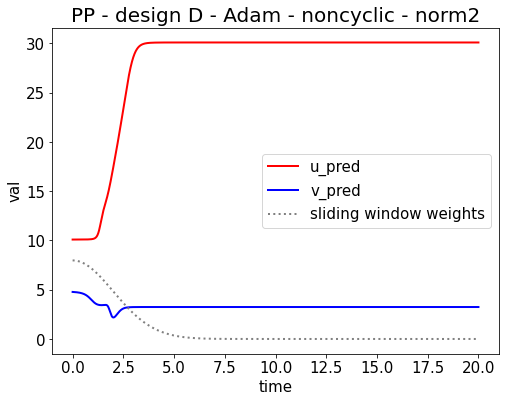

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-23-37_1651722665.png


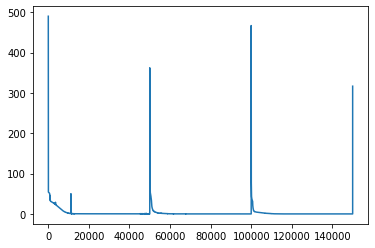

Epoch [151000/2000000] Loss:3.276386 Loss_1:0.029314 Loss_2:3.247072 Loss_3: 0.000000 Lr:0.000621 Time:12.152921s (27.66min in total)


KeyboardInterrupt: ignored

<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000 - sliding window
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 2000000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-05-04-18-45-11
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_loss_2000000.npy
args = {'epoch': 2000000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 50000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/2000000] Loss:15.469322 Loss_1:0.180094 Loss_2:15.289227 Loss_3: 0.000001 Lr:0.009091 Time:9.723087s (0.16min in total)
Epoch [02000/2000000] 

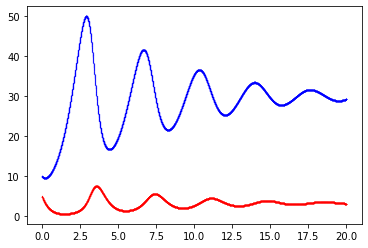

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651690397.png


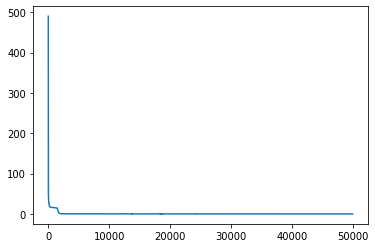

Epoch [51000/2000000] Loss:0.036125 Loss_1:0.000102 Loss_2:0.036023 Loss_3: 0.000000 Lr:0.001639 Time:10.580659s (8.27min in total)
Epoch [52000/2000000] Loss:0.034461 Loss_1:0.000003 Loss_2:0.034458 Loss_3: 0.000000 Lr:0.001613 Time:9.703419s (8.43min in total)
Epoch [53000/2000000] Loss:0.033476 Loss_1:0.000006 Loss_2:0.033470 Loss_3: 0.000000 Lr:0.001587 Time:9.747612s (8.59min in total)
Epoch [54000/2000000] Loss:0.035454 Loss_1:0.000003 Loss_2:0.035451 Loss_3: 0.000000 Lr:0.001563 Time:9.709030s (8.75min in total)
Epoch [55000/2000000] Loss:0.034159 Loss_1:0.000017 Loss_2:0.034142 Loss_3: 0.000000 Lr:0.001538 Time:9.701382s (8.92min in total)
Epoch [56000/2000000] Loss:0.030550 Loss_1:0.000005 Loss_2:0.030545 Loss_3: 0.000000 Lr:0.001515 Time:9.604957s (9.08min in total)
Epoch [57000/2000000] Loss:0.031502 Loss_1:0.001409 Loss_2:0.030094 Loss_3: 0.000000 Lr:0.001493 Time:9.720757s (9.24min in total)
Epoch [58000/2000000] Loss:0.029056 Loss_1:0.000003 Loss_2:0.029053 Loss_3: 0.0000

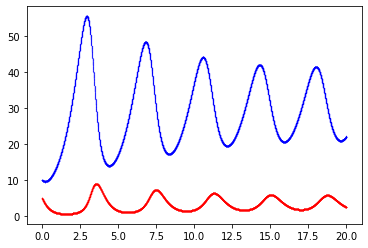

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651690859.png


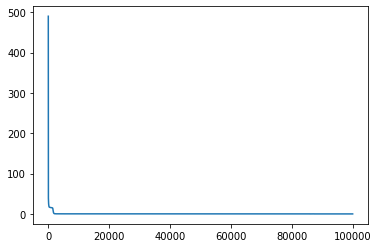

Epoch [101000/2000000] Loss:0.014779 Loss_1:0.000008 Loss_2:0.014771 Loss_3: 0.000000 Lr:0.000901 Time:9.081051s (15.95min in total)
Epoch [102000/2000000] Loss:0.012520 Loss_1:0.000012 Loss_2:0.012508 Loss_3: 0.000000 Lr:0.000893 Time:8.210943s (16.09min in total)
Epoch [103000/2000000] Loss:0.012089 Loss_1:0.000001 Loss_2:0.012088 Loss_3: 0.000000 Lr:0.000885 Time:8.247796s (16.23min in total)
Epoch [104000/2000000] Loss:0.023777 Loss_1:0.000030 Loss_2:0.023747 Loss_3: 0.000000 Lr:0.000877 Time:8.237069s (16.36min in total)
Epoch [105000/2000000] Loss:0.012166 Loss_1:0.000000 Loss_2:0.012165 Loss_3: 0.000000 Lr:0.000870 Time:8.223882s (16.50min in total)
Epoch [106000/2000000] Loss:0.011643 Loss_1:0.000002 Loss_2:0.011641 Loss_3: 0.000000 Lr:0.000862 Time:8.236728s (16.64min in total)
Epoch [107000/2000000] Loss:0.014543 Loss_1:0.000218 Loss_2:0.014325 Loss_3: 0.000000 Lr:0.000855 Time:8.234631s (16.77min in total)
Epoch [108000/2000000] Loss:0.011292 Loss_1:0.000001 Loss_2:0.011291 

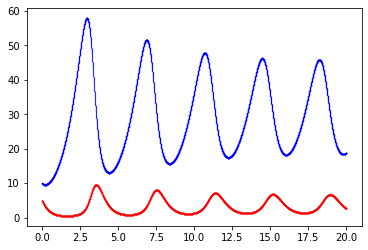

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651691271.png


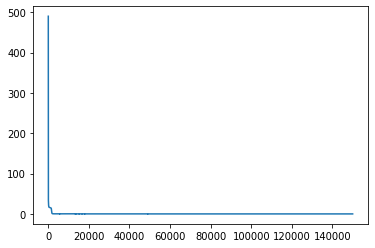

Epoch [151000/2000000] Loss:0.009336 Loss_1:0.000001 Loss_2:0.009335 Loss_3: 0.000000 Lr:0.000621 Time:8.934678s (22.81min in total)
Epoch [152000/2000000] Loss:0.007219 Loss_1:0.000001 Loss_2:0.007218 Loss_3: 0.000000 Lr:0.000617 Time:8.069005s (22.95min in total)
Epoch [153000/2000000] Loss:0.007221 Loss_1:0.000002 Loss_2:0.007219 Loss_3: 0.000000 Lr:0.000613 Time:8.041628s (23.08min in total)
Epoch [154000/2000000] Loss:0.007150 Loss_1:0.000024 Loss_2:0.007126 Loss_3: 0.000000 Lr:0.000610 Time:8.140100s (23.22min in total)
Epoch [155000/2000000] Loss:0.007643 Loss_1:0.000005 Loss_2:0.007637 Loss_3: 0.000000 Lr:0.000606 Time:8.100248s (23.35min in total)
Epoch [156000/2000000] Loss:0.007583 Loss_1:0.000003 Loss_2:0.007580 Loss_3: 0.000000 Lr:0.000602 Time:8.037596s (23.49min in total)
Epoch [157000/2000000] Loss:0.025005 Loss_1:0.000001 Loss_2:0.025004 Loss_3: 0.000000 Lr:0.000599 Time:8.078806s (23.62min in total)
Epoch [158000/2000000] Loss:0.006867 Loss_1:0.000001 Loss_2:0.006866 

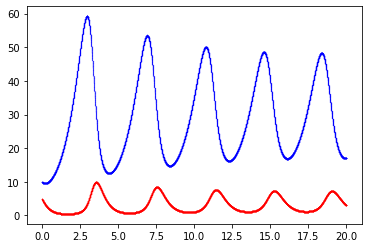

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651691678.png


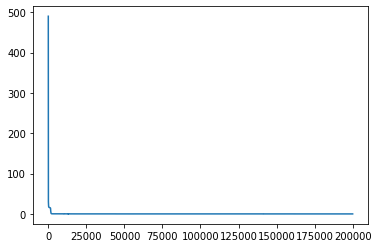

Epoch [201000/2000000] Loss:0.020785 Loss_1:0.000002 Loss_2:0.020784 Loss_3: 0.000000 Lr:0.000474 Time:9.046062s (29.60min in total)
Epoch [202000/2000000] Loss:0.005112 Loss_1:0.000001 Loss_2:0.005112 Loss_3: 0.000000 Lr:0.000472 Time:8.091652s (29.73min in total)
Epoch [203000/2000000] Loss:0.005773 Loss_1:0.000002 Loss_2:0.005771 Loss_3: 0.000000 Lr:0.000469 Time:8.127720s (29.87min in total)
Epoch [204000/2000000] Loss:0.005126 Loss_1:0.000000 Loss_2:0.005126 Loss_3: 0.000000 Lr:0.000467 Time:8.093568s (30.00min in total)
Epoch [205000/2000000] Loss:0.005252 Loss_1:0.000000 Loss_2:0.005252 Loss_3: 0.000000 Lr:0.000465 Time:8.073371s (30.14min in total)
Epoch [206000/2000000] Loss:0.005021 Loss_1:0.000000 Loss_2:0.005021 Loss_3: 0.000000 Lr:0.000463 Time:8.253549s (30.27min in total)
Epoch [207000/2000000] Loss:0.008895 Loss_1:0.000018 Loss_2:0.008877 Loss_3: 0.000000 Lr:0.000461 Time:8.138654s (30.41min in total)
Epoch [208000/2000000] Loss:0.004946 Loss_1:0.000008 Loss_2:0.004939 

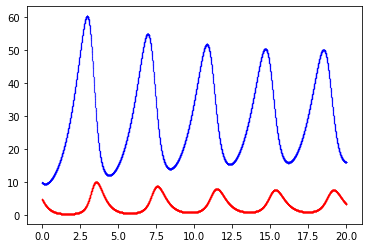

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651692085.png


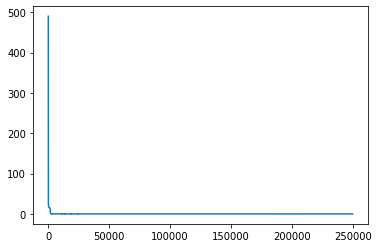

Epoch [251000/2000000] Loss:0.004419 Loss_1:0.000002 Loss_2:0.004416 Loss_3: 0.000000 Lr:0.000383 Time:9.045045s (36.38min in total)
Epoch [252000/2000000] Loss:0.004315 Loss_1:0.000004 Loss_2:0.004311 Loss_3: 0.000000 Lr:0.000382 Time:8.155341s (36.51min in total)
Epoch [253000/2000000] Loss:0.003841 Loss_1:0.000001 Loss_2:0.003840 Loss_3: 0.000000 Lr:0.000380 Time:8.202267s (36.65min in total)
Epoch [254000/2000000] Loss:0.005565 Loss_1:0.000004 Loss_2:0.005561 Loss_3: 0.000000 Lr:0.000379 Time:8.111175s (36.79min in total)
Epoch [255000/2000000] Loss:0.003795 Loss_1:0.000005 Loss_2:0.003790 Loss_3: 0.000000 Lr:0.000377 Time:8.061549s (36.92min in total)
Epoch [256000/2000000] Loss:0.005280 Loss_1:0.000058 Loss_2:0.005221 Loss_3: 0.000000 Lr:0.000376 Time:8.149138s (37.06min in total)
Epoch [257000/2000000] Loss:0.003744 Loss_1:0.000000 Loss_2:0.003744 Loss_3: 0.000000 Lr:0.000375 Time:8.155204s (37.19min in total)
Epoch [258000/2000000] Loss:0.003996 Loss_1:0.000001 Loss_2:0.003995 

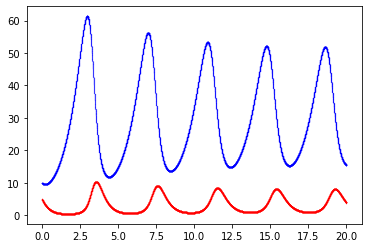

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651692492.png


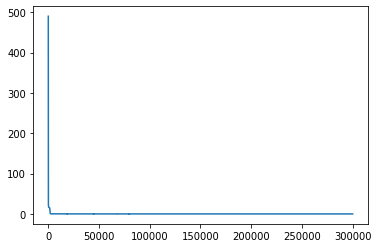

Epoch [301000/2000000] Loss:0.003057 Loss_1:0.000002 Loss_2:0.003055 Loss_3: 0.000000 Lr:0.000322 Time:9.199605s (43.16min in total)
Epoch [302000/2000000] Loss:0.002949 Loss_1:0.000001 Loss_2:0.002949 Loss_3: 0.000000 Lr:0.000321 Time:8.146975s (43.29min in total)
Epoch [303000/2000000] Loss:0.003373 Loss_1:0.000017 Loss_2:0.003356 Loss_3: 0.000000 Lr:0.000319 Time:8.125669s (43.43min in total)
Epoch [304000/2000000] Loss:0.013623 Loss_1:0.000029 Loss_2:0.013594 Loss_3: 0.000000 Lr:0.000318 Time:8.022381s (43.56min in total)
Epoch [305000/2000000] Loss:0.003049 Loss_1:0.000002 Loss_2:0.003047 Loss_3: 0.000000 Lr:0.000317 Time:8.102665s (43.70min in total)
Epoch [306000/2000000] Loss:0.005849 Loss_1:0.000001 Loss_2:0.005848 Loss_3: 0.000000 Lr:0.000316 Time:8.109308s (43.83min in total)
Epoch [307000/2000000] Loss:0.002882 Loss_1:0.000000 Loss_2:0.002882 Loss_3: 0.000000 Lr:0.000315 Time:8.037908s (43.97min in total)
Epoch [308000/2000000] Loss:0.002905 Loss_1:0.000001 Loss_2:0.002904 

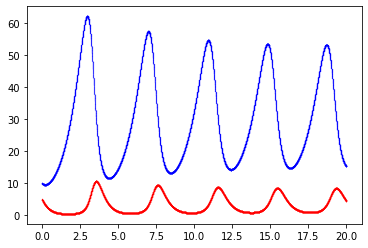

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651692898.png


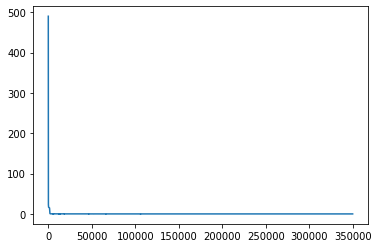

Epoch [351000/2000000] Loss:0.002323 Loss_1:0.000001 Loss_2:0.002322 Loss_3: 0.000000 Lr:0.000277 Time:9.230670s (49.92min in total)
Epoch [352000/2000000] Loss:0.002469 Loss_1:0.000002 Loss_2:0.002467 Loss_3: 0.000000 Lr:0.000276 Time:8.235148s (50.06min in total)
Epoch [353000/2000000] Loss:0.003691 Loss_1:0.000099 Loss_2:0.003591 Loss_3: 0.000000 Lr:0.000275 Time:8.067610s (50.20min in total)
Epoch [354000/2000000] Loss:0.012084 Loss_1:0.000045 Loss_2:0.012040 Loss_3: 0.000000 Lr:0.000275 Time:8.085078s (50.33min in total)
Epoch [355000/2000000] Loss:0.002277 Loss_1:0.000000 Loss_2:0.002277 Loss_3: 0.000000 Lr:0.000274 Time:8.078779s (50.47min in total)
Epoch [356000/2000000] Loss:0.002267 Loss_1:0.000000 Loss_2:0.002267 Loss_3: 0.000000 Lr:0.000273 Time:8.196084s (50.60min in total)
Epoch [357000/2000000] Loss:0.002257 Loss_1:0.000000 Loss_2:0.002257 Loss_3: 0.000000 Lr:0.000272 Time:8.125600s (50.74min in total)
Epoch [358000/2000000] Loss:0.002255 Loss_1:0.000000 Loss_2:0.002255 

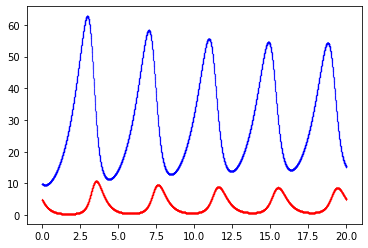

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651693305.png


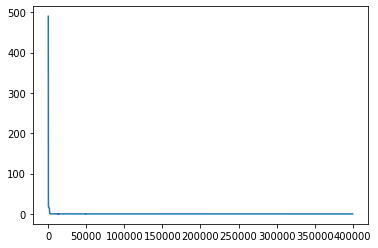

Epoch [401000/2000000] Loss:0.001890 Loss_1:0.000000 Loss_2:0.001890 Loss_3: 0.000000 Lr:0.000243 Time:9.374093s (56.71min in total)
Epoch [402000/2000000] Loss:0.001888 Loss_1:0.000000 Loss_2:0.001888 Loss_3: 0.000000 Lr:0.000243 Time:8.236725s (56.85min in total)
Epoch [403000/2000000] Loss:0.001916 Loss_1:0.000000 Loss_2:0.001916 Loss_3: 0.000000 Lr:0.000242 Time:8.104868s (56.99min in total)
Epoch [404000/2000000] Loss:0.002063 Loss_1:0.000003 Loss_2:0.002060 Loss_3: 0.000000 Lr:0.000242 Time:8.096662s (57.12min in total)
Epoch [405000/2000000] Loss:0.001879 Loss_1:0.000004 Loss_2:0.001875 Loss_3: 0.000000 Lr:0.000241 Time:8.157144s (57.26min in total)
Epoch [406000/2000000] Loss:0.001856 Loss_1:0.000000 Loss_2:0.001855 Loss_3: 0.000000 Lr:0.000240 Time:8.177442s (57.39min in total)
Epoch [407000/2000000] Loss:0.006860 Loss_1:0.000035 Loss_2:0.006824 Loss_3: 0.000000 Lr:0.000240 Time:8.259899s (57.53min in total)
Epoch [408000/2000000] Loss:0.003688 Loss_1:0.000000 Loss_2:0.003688 

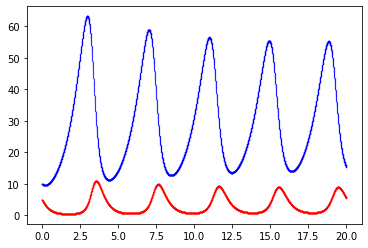

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651693713.png


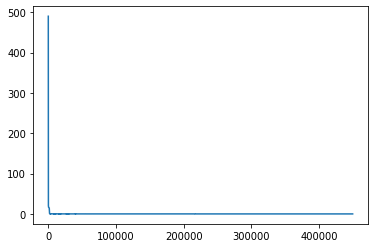

Epoch [451000/2000000] Loss:0.001607 Loss_1:0.000003 Loss_2:0.001604 Loss_3: 0.000000 Lr:0.000217 Time:9.433969s (63.52min in total)
Epoch [452000/2000000] Loss:0.001909 Loss_1:0.000002 Loss_2:0.001907 Loss_3: 0.000000 Lr:0.000216 Time:8.108986s (63.66min in total)
Epoch [453000/2000000] Loss:0.003433 Loss_1:0.000008 Loss_2:0.003425 Loss_3: 0.000000 Lr:0.000216 Time:8.188059s (63.79min in total)
Epoch [454000/2000000] Loss:0.001652 Loss_1:0.000000 Loss_2:0.001652 Loss_3: 0.000000 Lr:0.000216 Time:8.008918s (63.93min in total)
Epoch [455000/2000000] Loss:0.001857 Loss_1:0.000001 Loss_2:0.001856 Loss_3: 0.000000 Lr:0.000215 Time:8.141351s (64.06min in total)
Epoch [456000/2000000] Loss:0.001588 Loss_1:0.000000 Loss_2:0.001587 Loss_3: 0.000000 Lr:0.000215 Time:8.088325s (64.20min in total)
Epoch [457000/2000000] Loss:0.002458 Loss_1:0.000008 Loss_2:0.002450 Loss_3: 0.000000 Lr:0.000214 Time:8.126770s (64.33min in total)
Epoch [458000/2000000] Loss:0.002014 Loss_1:0.000001 Loss_2:0.002013 

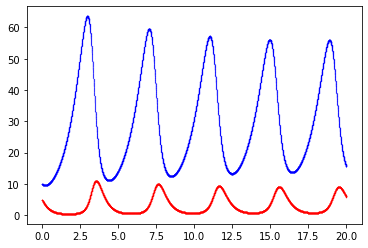

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651694121.png


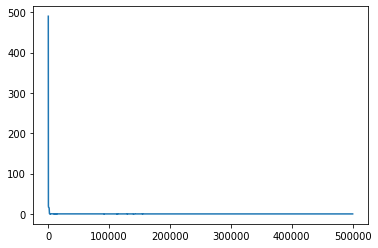

Epoch [501000/2000000] Loss:0.001406 Loss_1:0.000000 Loss_2:0.001405 Loss_3: 0.000000 Lr:0.000196 Time:9.487307s (70.31min in total)
Epoch [502000/2000000] Loss:0.001392 Loss_1:0.000000 Loss_2:0.001391 Loss_3: 0.000000 Lr:0.000195 Time:8.196221s (70.45min in total)
Epoch [503000/2000000] Loss:0.006795 Loss_1:0.000002 Loss_2:0.006794 Loss_3: 0.000000 Lr:0.000195 Time:8.081355s (70.58min in total)
Epoch [504000/2000000] Loss:0.001387 Loss_1:0.000001 Loss_2:0.001386 Loss_3: 0.000000 Lr:0.000195 Time:8.175850s (70.72min in total)
Epoch [505000/2000000] Loss:0.001385 Loss_1:0.000000 Loss_2:0.001385 Loss_3: 0.000000 Lr:0.000194 Time:8.267374s (70.86min in total)
Epoch [506000/2000000] Loss:0.001530 Loss_1:0.000000 Loss_2:0.001529 Loss_3: 0.000000 Lr:0.000194 Time:8.237314s (71.00min in total)
Epoch [507000/2000000] Loss:0.007370 Loss_1:0.000000 Loss_2:0.007369 Loss_3: 0.000000 Lr:0.000193 Time:8.051979s (71.13min in total)
Epoch [508000/2000000] Loss:0.001370 Loss_1:0.000000 Loss_2:0.001370 

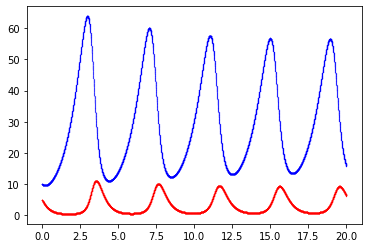

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651694529.png


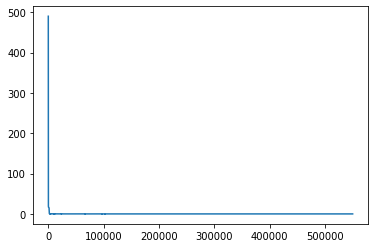

Epoch [551000/2000000] Loss:0.001236 Loss_1:0.000000 Loss_2:0.001236 Loss_3: 0.000000 Lr:0.000178 Time:9.620876s (77.12min in total)
Epoch [552000/2000000] Loss:0.001244 Loss_1:0.000000 Loss_2:0.001244 Loss_3: 0.000000 Lr:0.000178 Time:8.141652s (77.26min in total)
Epoch [553000/2000000] Loss:0.001232 Loss_1:0.000000 Loss_2:0.001232 Loss_3: 0.000000 Lr:0.000178 Time:8.211955s (77.40min in total)
Epoch [554000/2000000] Loss:0.001356 Loss_1:0.000000 Loss_2:0.001356 Loss_3: 0.000000 Lr:0.000177 Time:8.140551s (77.53min in total)
Epoch [555000/2000000] Loss:0.001244 Loss_1:0.000000 Loss_2:0.001244 Loss_3: 0.000000 Lr:0.000177 Time:8.096511s (77.67min in total)
Epoch [556000/2000000] Loss:0.001277 Loss_1:0.000002 Loss_2:0.001276 Loss_3: 0.000000 Lr:0.000177 Time:8.125840s (77.80min in total)
Epoch [557000/2000000] Loss:0.001220 Loss_1:0.000000 Loss_2:0.001220 Loss_3: 0.000000 Lr:0.000176 Time:8.266320s (77.94min in total)
Epoch [558000/2000000] Loss:0.001306 Loss_1:0.000017 Loss_2:0.001288 

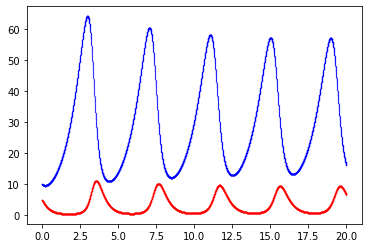

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651694937.png


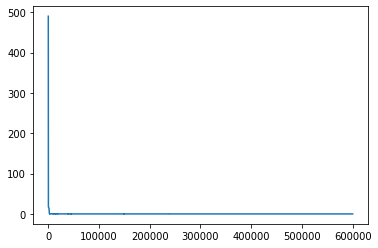

Epoch [601000/2000000] Loss:0.001111 Loss_1:0.000000 Loss_2:0.001111 Loss_3: 0.000000 Lr:0.000164 Time:9.760430s (83.93min in total)
Epoch [602000/2000000] Loss:0.001133 Loss_1:0.000001 Loss_2:0.001132 Loss_3: 0.000000 Lr:0.000163 Time:8.251980s (84.07min in total)
Epoch [603000/2000000] Loss:0.001107 Loss_1:0.000000 Loss_2:0.001107 Loss_3: 0.000000 Lr:0.000163 Time:8.061124s (84.20min in total)
Epoch [604000/2000000] Loss:0.001286 Loss_1:0.000006 Loss_2:0.001279 Loss_3: 0.000000 Lr:0.000163 Time:8.165603s (84.34min in total)
Epoch [605000/2000000] Loss:0.001106 Loss_1:0.000000 Loss_2:0.001105 Loss_3: 0.000000 Lr:0.000163 Time:8.038943s (84.47min in total)
Epoch [606000/2000000] Loss:0.001320 Loss_1:0.000009 Loss_2:0.001311 Loss_3: 0.000000 Lr:0.000162 Time:8.138721s (84.61min in total)
Epoch [607000/2000000] Loss:0.001104 Loss_1:0.000000 Loss_2:0.001104 Loss_3: 0.000000 Lr:0.000162 Time:8.163191s (84.74min in total)
Epoch [608000/2000000] Loss:0.001112 Loss_1:0.000002 Loss_2:0.001109 

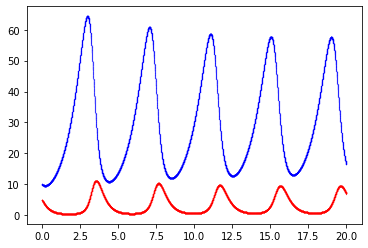

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651695346.png


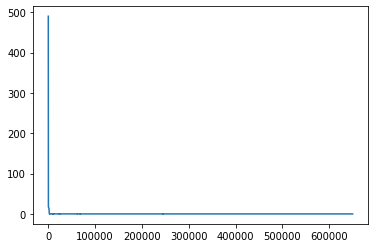

Epoch [651000/2000000] Loss:0.001317 Loss_1:0.000002 Loss_2:0.001315 Loss_3: 0.000000 Lr:0.000151 Time:9.635288s (90.73min in total)
Epoch [652000/2000000] Loss:0.001009 Loss_1:0.000000 Loss_2:0.001008 Loss_3: 0.000000 Lr:0.000151 Time:8.156137s (90.87min in total)
Epoch [653000/2000000] Loss:0.001007 Loss_1:0.000000 Loss_2:0.001007 Loss_3: 0.000000 Lr:0.000151 Time:8.153625s (91.00min in total)
Epoch [654000/2000000] Loss:0.001006 Loss_1:0.000000 Loss_2:0.001006 Loss_3: 0.000000 Lr:0.000151 Time:8.208457s (91.14min in total)
Epoch [655000/2000000] Loss:0.001003 Loss_1:0.000000 Loss_2:0.001003 Loss_3: 0.000000 Lr:0.000150 Time:8.170547s (91.28min in total)
Epoch [656000/2000000] Loss:0.001029 Loss_1:0.000000 Loss_2:0.001029 Loss_3: 0.000000 Lr:0.000150 Time:8.130584s (91.41min in total)
Epoch [657000/2000000] Loss:0.001000 Loss_1:0.000000 Loss_2:0.001000 Loss_3: 0.000000 Lr:0.000150 Time:8.041602s (91.54min in total)
Epoch [658000/2000000] Loss:0.001775 Loss_1:0.000002 Loss_2:0.001774 

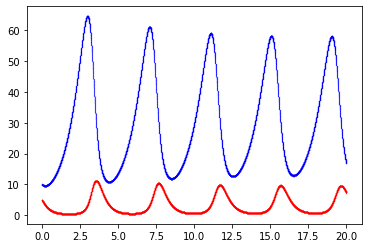

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651695753.png


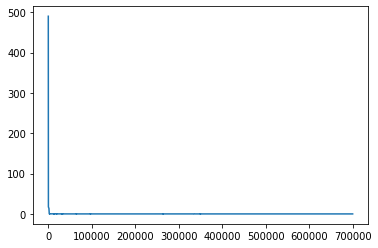

Epoch [701000/2000000] Loss:0.000960 Loss_1:0.000000 Loss_2:0.000960 Loss_3: 0.000000 Lr:0.000141 Time:9.868586s (97.53min in total)
Epoch [702000/2000000] Loss:0.000935 Loss_1:0.000000 Loss_2:0.000935 Loss_3: 0.000000 Lr:0.000140 Time:8.128143s (97.66min in total)
Epoch [703000/2000000] Loss:0.001070 Loss_1:0.000001 Loss_2:0.001069 Loss_3: 0.000000 Lr:0.000140 Time:8.122483s (97.80min in total)
Epoch [704000/2000000] Loss:0.001383 Loss_1:0.000000 Loss_2:0.001383 Loss_3: 0.000000 Lr:0.000140 Time:8.220698s (97.93min in total)
Epoch [705000/2000000] Loss:0.000922 Loss_1:0.000000 Loss_2:0.000922 Loss_3: 0.000000 Lr:0.000140 Time:8.087664s (98.07min in total)
Epoch [706000/2000000] Loss:0.000975 Loss_1:0.000003 Loss_2:0.000972 Loss_3: 0.000000 Lr:0.000140 Time:8.140529s (98.20min in total)
Epoch [707000/2000000] Loss:0.000924 Loss_1:0.000001 Loss_2:0.000923 Loss_3: 0.000000 Lr:0.000139 Time:8.111863s (98.34min in total)
Epoch [708000/2000000] Loss:0.001419 Loss_1:0.000008 Loss_2:0.001410 

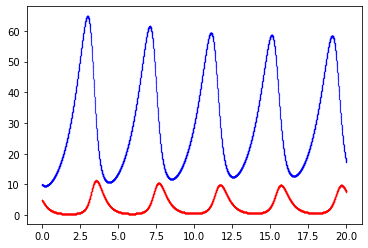

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651696162.png


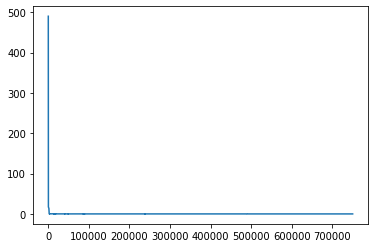

Epoch [751000/2000000] Loss:0.000859 Loss_1:0.000000 Loss_2:0.000858 Loss_3: 0.000000 Lr:0.000131 Time:9.966133s (104.34min in total)
Epoch [752000/2000000] Loss:0.001217 Loss_1:0.000001 Loss_2:0.001216 Loss_3: 0.000000 Lr:0.000131 Time:8.071882s (104.48min in total)
Epoch [753000/2000000] Loss:0.000860 Loss_1:0.000000 Loss_2:0.000860 Loss_3: 0.000000 Lr:0.000131 Time:8.088672s (104.61min in total)
Epoch [754000/2000000] Loss:0.000899 Loss_1:0.000004 Loss_2:0.000896 Loss_3: 0.000000 Lr:0.000131 Time:8.065076s (104.74min in total)
Epoch [755000/2000000] Loss:0.006593 Loss_1:0.000001 Loss_2:0.006591 Loss_3: 0.000000 Lr:0.000131 Time:8.218817s (104.88min in total)
Epoch [756000/2000000] Loss:0.000990 Loss_1:0.000001 Loss_2:0.000988 Loss_3: 0.000000 Lr:0.000131 Time:8.242158s (105.02min in total)
Epoch [757000/2000000] Loss:0.000919 Loss_1:0.000002 Loss_2:0.000918 Loss_3: 0.000000 Lr:0.000130 Time:8.124505s (105.15min in total)
Epoch [758000/2000000] Loss:0.000850 Loss_1:0.000000 Loss_2:0.

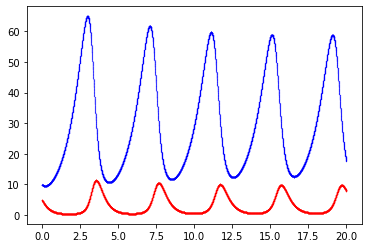

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651696570.png


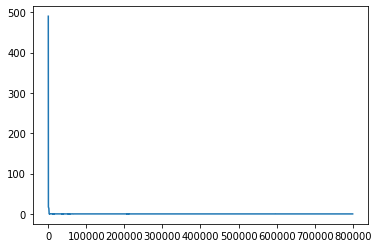

Epoch [801000/2000000] Loss:0.000802 Loss_1:0.000000 Loss_2:0.000802 Loss_3: 0.000000 Lr:0.000123 Time:9.785192s (111.14min in total)
Epoch [802000/2000000] Loss:0.001562 Loss_1:0.000000 Loss_2:0.001562 Loss_3: 0.000000 Lr:0.000123 Time:8.116025s (111.28min in total)
Epoch [803000/2000000] Loss:0.000799 Loss_1:0.000001 Loss_2:0.000798 Loss_3: 0.000000 Lr:0.000123 Time:8.136363s (111.42min in total)
Epoch [804000/2000000] Loss:0.000981 Loss_1:0.000003 Loss_2:0.000977 Loss_3: 0.000000 Lr:0.000123 Time:8.110853s (111.55min in total)
Epoch [805000/2000000] Loss:0.000848 Loss_1:0.000001 Loss_2:0.000847 Loss_3: 0.000000 Lr:0.000123 Time:8.102749s (111.69min in total)
Epoch [806000/2000000] Loss:0.001153 Loss_1:0.000001 Loss_2:0.001152 Loss_3: 0.000000 Lr:0.000123 Time:8.110744s (111.82min in total)
Epoch [807000/2000000] Loss:0.000801 Loss_1:0.000001 Loss_2:0.000800 Loss_3: 0.000000 Lr:0.000122 Time:8.091042s (111.96min in total)
Epoch [808000/2000000] Loss:0.000791 Loss_1:0.000000 Loss_2:0.

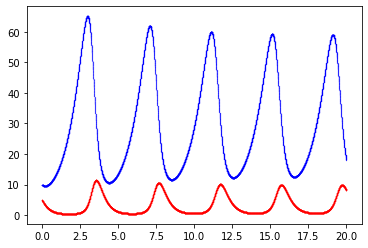

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651696978.png


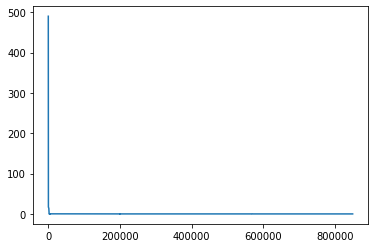

Epoch [851000/2000000] Loss:0.000782 Loss_1:0.000000 Loss_2:0.000782 Loss_3: 0.000000 Lr:0.000116 Time:9.948660s (117.94min in total)
Epoch [852000/2000000] Loss:0.000747 Loss_1:0.000000 Loss_2:0.000747 Loss_3: 0.000000 Lr:0.000116 Time:8.168611s (118.08min in total)
Epoch [853000/2000000] Loss:0.001636 Loss_1:0.000000 Loss_2:0.001636 Loss_3: 0.000000 Lr:0.000116 Time:8.199215s (118.22min in total)
Epoch [854000/2000000] Loss:0.000754 Loss_1:0.000000 Loss_2:0.000753 Loss_3: 0.000000 Lr:0.000116 Time:8.135980s (118.35min in total)
Epoch [855000/2000000] Loss:0.000744 Loss_1:0.000000 Loss_2:0.000744 Loss_3: 0.000000 Lr:0.000116 Time:8.002376s (118.49min in total)
Epoch [856000/2000000] Loss:0.000761 Loss_1:0.000000 Loss_2:0.000760 Loss_3: 0.000000 Lr:0.000115 Time:8.057967s (118.62min in total)
Epoch [857000/2000000] Loss:0.000744 Loss_1:0.000000 Loss_2:0.000743 Loss_3: 0.000000 Lr:0.000115 Time:8.125843s (118.76min in total)
Epoch [858000/2000000] Loss:0.000773 Loss_1:0.000000 Loss_2:0.

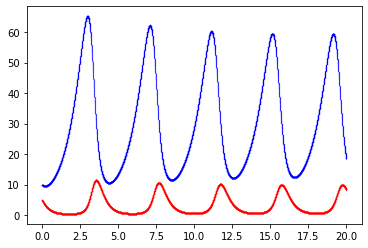

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651697386.png


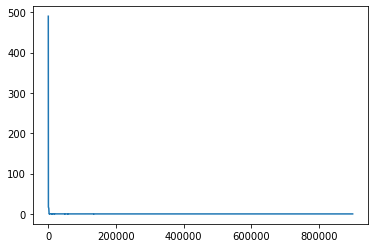

Epoch [901000/2000000] Loss:0.000704 Loss_1:0.000000 Loss_2:0.000704 Loss_3: 0.000000 Lr:0.000110 Time:10.044615s (124.74min in total)
Epoch [902000/2000000] Loss:0.002189 Loss_1:0.000000 Loss_2:0.002188 Loss_3: 0.000000 Lr:0.000110 Time:8.185183s (124.88min in total)
Epoch [903000/2000000] Loss:0.000705 Loss_1:0.000000 Loss_2:0.000705 Loss_3: 0.000000 Lr:0.000110 Time:8.128497s (125.01min in total)
Epoch [904000/2000000] Loss:0.001345 Loss_1:0.000011 Loss_2:0.001334 Loss_3: 0.000000 Lr:0.000109 Time:8.153145s (125.15min in total)
Epoch [905000/2000000] Loss:0.000723 Loss_1:0.000000 Loss_2:0.000722 Loss_3: 0.000000 Lr:0.000109 Time:8.100092s (125.29min in total)
Epoch [906000/2000000] Loss:0.000746 Loss_1:0.000001 Loss_2:0.000745 Loss_3: 0.000000 Lr:0.000109 Time:8.066114s (125.42min in total)
Epoch [907000/2000000] Loss:0.000835 Loss_1:0.000000 Loss_2:0.000835 Loss_3: 0.000000 Lr:0.000109 Time:8.070593s (125.55min in total)
Epoch [908000/2000000] Loss:0.000705 Loss_1:0.000000 Loss_2:0

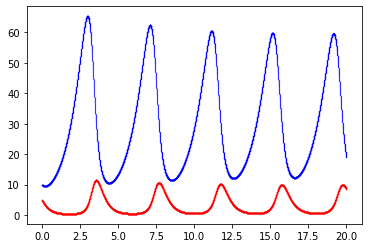

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651697794.png


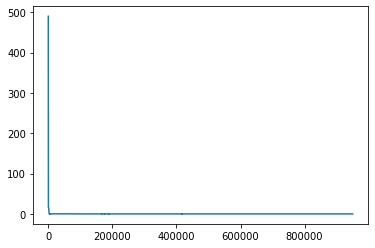

Epoch [951000/2000000] Loss:0.000667 Loss_1:0.000000 Loss_2:0.000666 Loss_3: 0.000000 Lr:0.000104 Time:10.223647s (131.55min in total)
Epoch [952000/2000000] Loss:0.000679 Loss_1:0.000000 Loss_2:0.000679 Loss_3: 0.000000 Lr:0.000104 Time:8.149081s (131.68min in total)
Epoch [953000/2000000] Loss:0.002357 Loss_1:0.000002 Loss_2:0.002355 Loss_3: 0.000000 Lr:0.000104 Time:8.158073s (131.82min in total)
Epoch [954000/2000000] Loss:0.000662 Loss_1:0.000000 Loss_2:0.000662 Loss_3: 0.000000 Lr:0.000104 Time:8.195747s (131.96min in total)
Epoch [955000/2000000] Loss:0.000666 Loss_1:0.000000 Loss_2:0.000665 Loss_3: 0.000000 Lr:0.000104 Time:8.043054s (132.09min in total)
Epoch [956000/2000000] Loss:0.000662 Loss_1:0.000000 Loss_2:0.000661 Loss_3: 0.000000 Lr:0.000104 Time:8.119872s (132.22min in total)
Epoch [957000/2000000] Loss:0.000660 Loss_1:0.000000 Loss_2:0.000660 Loss_3: 0.000000 Lr:0.000103 Time:8.115619s (132.36min in total)
Epoch [958000/2000000] Loss:0.000659 Loss_1:0.000000 Loss_2:0

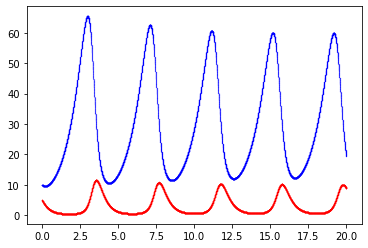

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651698202.png


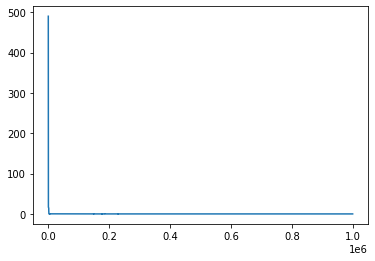

Epoch [1001000/2000000] Loss:0.000704 Loss_1:0.000000 Loss_2:0.000704 Loss_3: 0.000000 Lr:0.000099 Time:10.262389s (138.35min in total)
Epoch [1002000/2000000] Loss:0.000697 Loss_1:0.000008 Loss_2:0.000689 Loss_3: 0.000000 Lr:0.000099 Time:8.166186s (138.49min in total)
Epoch [1003000/2000000] Loss:0.000761 Loss_1:0.000002 Loss_2:0.000759 Loss_3: 0.000000 Lr:0.000099 Time:8.041308s (138.62min in total)
Epoch [1004000/2000000] Loss:0.000785 Loss_1:0.000002 Loss_2:0.000783 Loss_3: 0.000000 Lr:0.000099 Time:8.227222s (138.76min in total)
Epoch [1005000/2000000] Loss:0.000665 Loss_1:0.000000 Loss_2:0.000665 Loss_3: 0.000000 Lr:0.000099 Time:8.095070s (138.90min in total)
Epoch [1006000/2000000] Loss:0.000864 Loss_1:0.000000 Loss_2:0.000864 Loss_3: 0.000000 Lr:0.000098 Time:8.117853s (139.03min in total)
Epoch [1007000/2000000] Loss:0.000626 Loss_1:0.000000 Loss_2:0.000626 Loss_3: 0.000000 Lr:0.000098 Time:8.117817s (139.17min in total)
Epoch [1008000/2000000] Loss:0.000625 Loss_1:0.000000 

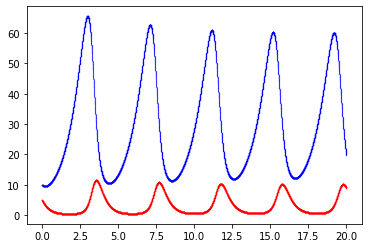

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651698611.png


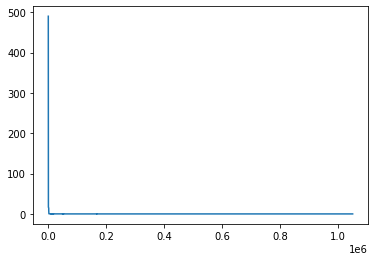

Epoch [1051000/2000000] Loss:0.000599 Loss_1:0.000000 Loss_2:0.000599 Loss_3: 0.000000 Lr:0.000094 Time:10.266174s (145.17min in total)
Epoch [1052000/2000000] Loss:0.000601 Loss_1:0.000000 Loss_2:0.000600 Loss_3: 0.000000 Lr:0.000094 Time:8.195998s (145.31min in total)
Epoch [1053000/2000000] Loss:0.000654 Loss_1:0.000001 Loss_2:0.000653 Loss_3: 0.000000 Lr:0.000094 Time:8.104470s (145.44min in total)
Epoch [1054000/2000000] Loss:0.000676 Loss_1:0.000000 Loss_2:0.000676 Loss_3: 0.000000 Lr:0.000094 Time:8.034359s (145.58min in total)
Epoch [1055000/2000000] Loss:0.000649 Loss_1:0.000000 Loss_2:0.000649 Loss_3: 0.000000 Lr:0.000094 Time:8.148376s (145.71min in total)
Epoch [1056000/2000000] Loss:0.000599 Loss_1:0.000000 Loss_2:0.000598 Loss_3: 0.000000 Lr:0.000094 Time:8.076634s (145.85min in total)
Epoch [1057000/2000000] Loss:0.000599 Loss_1:0.000000 Loss_2:0.000599 Loss_3: 0.000000 Lr:0.000094 Time:8.084858s (145.98min in total)
Epoch [1058000/2000000] Loss:0.000595 Loss_1:0.000000 

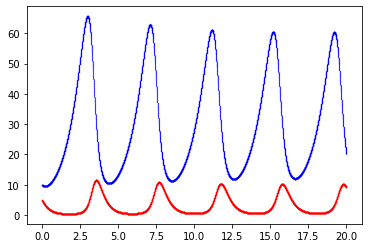

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651699019.png


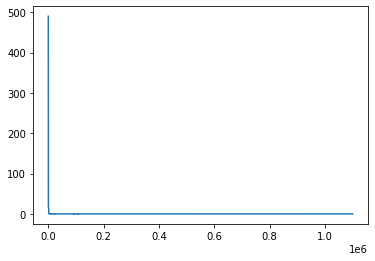

Epoch [1101000/2000000] Loss:0.000571 Loss_1:0.000000 Loss_2:0.000570 Loss_3: 0.000000 Lr:0.000090 Time:10.345146s (151.97min in total)
Epoch [1102000/2000000] Loss:0.000595 Loss_1:0.000000 Loss_2:0.000595 Loss_3: 0.000000 Lr:0.000090 Time:8.124548s (152.11min in total)
Epoch [1103000/2000000] Loss:0.000569 Loss_1:0.000000 Loss_2:0.000569 Loss_3: 0.000000 Lr:0.000090 Time:8.117671s (152.24min in total)
Epoch [1104000/2000000] Loss:0.000569 Loss_1:0.000000 Loss_2:0.000569 Loss_3: 0.000000 Lr:0.000090 Time:8.099113s (152.38min in total)
Epoch [1105000/2000000] Loss:0.000580 Loss_1:0.000000 Loss_2:0.000579 Loss_3: 0.000000 Lr:0.000090 Time:8.158340s (152.51min in total)
Epoch [1106000/2000000] Loss:0.001089 Loss_1:0.000004 Loss_2:0.001085 Loss_3: 0.000000 Lr:0.000090 Time:8.081255s (152.65min in total)
Epoch [1107000/2000000] Loss:0.000567 Loss_1:0.000000 Loss_2:0.000567 Loss_3: 0.000000 Lr:0.000090 Time:8.105948s (152.78min in total)
Epoch [1108000/2000000] Loss:0.004586 Loss_1:0.000000 

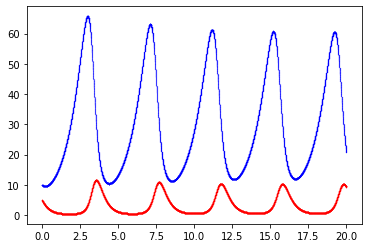

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651699428.png


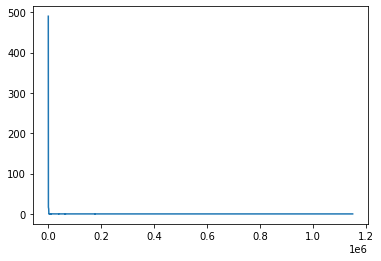

Epoch [1151000/2000000] Loss:0.000555 Loss_1:0.000000 Loss_2:0.000554 Loss_3: 0.000000 Lr:0.000086 Time:10.330462s (158.78min in total)
Epoch [1152000/2000000] Loss:0.000546 Loss_1:0.000000 Loss_2:0.000546 Loss_3: 0.000000 Lr:0.000086 Time:8.088618s (158.92min in total)
Epoch [1153000/2000000] Loss:0.000546 Loss_1:0.000000 Loss_2:0.000546 Loss_3: 0.000000 Lr:0.000086 Time:8.082199s (159.05min in total)
Epoch [1154000/2000000] Loss:0.000551 Loss_1:0.000000 Loss_2:0.000551 Loss_3: 0.000000 Lr:0.000086 Time:8.076391s (159.19min in total)
Epoch [1155000/2000000] Loss:0.000544 Loss_1:0.000000 Loss_2:0.000544 Loss_3: 0.000000 Lr:0.000086 Time:8.214740s (159.33min in total)
Epoch [1156000/2000000] Loss:0.001240 Loss_1:0.000000 Loss_2:0.001239 Loss_3: 0.000000 Lr:0.000086 Time:8.146677s (159.46min in total)
Epoch [1157000/2000000] Loss:0.001523 Loss_1:0.000001 Loss_2:0.001522 Loss_3: 0.000000 Lr:0.000086 Time:8.056298s (159.60min in total)
Epoch [1158000/2000000] Loss:0.000542 Loss_1:0.000000 

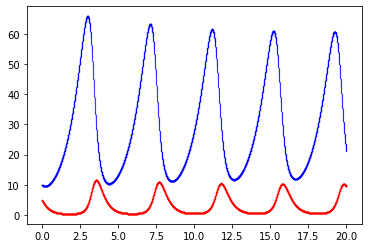

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651699836.png


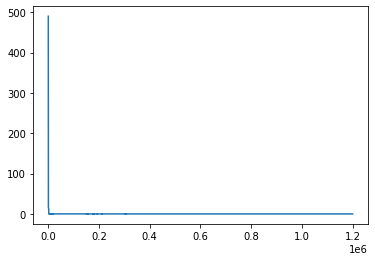

Epoch [1201000/2000000] Loss:0.000523 Loss_1:0.000000 Loss_2:0.000523 Loss_3: 0.000000 Lr:0.000083 Time:10.530300s (165.59min in total)
Epoch [1202000/2000000] Loss:0.000546 Loss_1:0.000001 Loss_2:0.000545 Loss_3: 0.000000 Lr:0.000083 Time:8.190323s (165.72min in total)
Epoch [1203000/2000000] Loss:0.000700 Loss_1:0.000000 Loss_2:0.000700 Loss_3: 0.000000 Lr:0.000082 Time:8.090901s (165.86min in total)
Epoch [1204000/2000000] Loss:0.000536 Loss_1:0.000000 Loss_2:0.000536 Loss_3: 0.000000 Lr:0.000082 Time:8.197446s (166.00min in total)
Epoch [1205000/2000000] Loss:0.000521 Loss_1:0.000000 Loss_2:0.000521 Loss_3: 0.000000 Lr:0.000082 Time:8.072121s (166.13min in total)
Epoch [1206000/2000000] Loss:0.000521 Loss_1:0.000000 Loss_2:0.000520 Loss_3: 0.000000 Lr:0.000082 Time:8.079600s (166.27min in total)
Epoch [1207000/2000000] Loss:0.000643 Loss_1:0.000001 Loss_2:0.000641 Loss_3: 0.000000 Lr:0.000082 Time:8.049029s (166.40min in total)
Epoch [1208000/2000000] Loss:0.000561 Loss_1:0.000000 

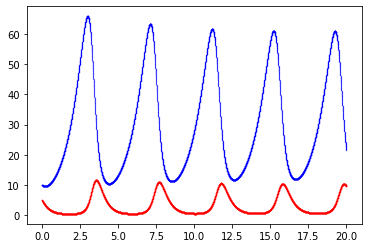

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651700245.png


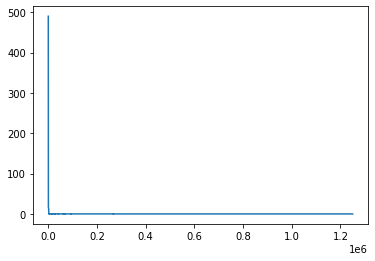

Epoch [1251000/2000000] Loss:0.000663 Loss_1:0.000001 Loss_2:0.000662 Loss_3: 0.000000 Lr:0.000079 Time:10.498809s (172.40min in total)
Epoch [1252000/2000000] Loss:0.000506 Loss_1:0.000000 Loss_2:0.000506 Loss_3: 0.000000 Lr:0.000079 Time:8.113042s (172.53min in total)
Epoch [1253000/2000000] Loss:0.000539 Loss_1:0.000001 Loss_2:0.000538 Loss_3: 0.000000 Lr:0.000079 Time:8.073604s (172.66min in total)
Epoch [1254000/2000000] Loss:0.000501 Loss_1:0.000000 Loss_2:0.000500 Loss_3: 0.000000 Lr:0.000079 Time:8.162566s (172.80min in total)
Epoch [1255000/2000000] Loss:0.000500 Loss_1:0.000000 Loss_2:0.000500 Loss_3: 0.000000 Lr:0.000079 Time:8.131186s (172.94min in total)
Epoch [1256000/2000000] Loss:0.000506 Loss_1:0.000000 Loss_2:0.000505 Loss_3: 0.000000 Lr:0.000079 Time:8.058820s (173.07min in total)
Epoch [1257000/2000000] Loss:0.000879 Loss_1:0.000000 Loss_2:0.000879 Loss_3: 0.000000 Lr:0.000079 Time:8.259727s (173.21min in total)
Epoch [1258000/2000000] Loss:0.000563 Loss_1:0.000000 

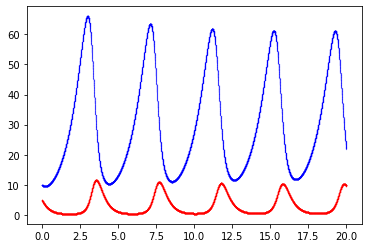

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651700654.png


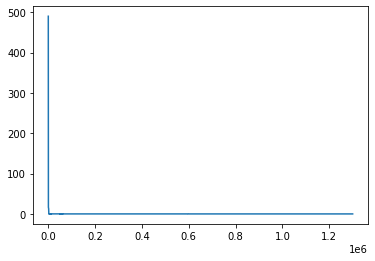

Epoch [1301000/2000000] Loss:0.000483 Loss_1:0.000000 Loss_2:0.000483 Loss_3: 0.000000 Lr:0.000076 Time:10.587607s (179.21min in total)
Epoch [1302000/2000000] Loss:0.002119 Loss_1:0.000000 Loss_2:0.002119 Loss_3: 0.000000 Lr:0.000076 Time:8.173744s (179.35min in total)
Epoch [1303000/2000000] Loss:0.000498 Loss_1:0.000000 Loss_2:0.000498 Loss_3: 0.000000 Lr:0.000076 Time:8.160693s (179.48min in total)
Epoch [1304000/2000000] Loss:0.000484 Loss_1:0.000000 Loss_2:0.000483 Loss_3: 0.000000 Lr:0.000076 Time:8.072086s (179.62min in total)
Epoch [1305000/2000000] Loss:0.000482 Loss_1:0.000000 Loss_2:0.000482 Loss_3: 0.000000 Lr:0.000076 Time:8.080702s (179.75min in total)
Epoch [1306000/2000000] Loss:0.000484 Loss_1:0.000000 Loss_2:0.000484 Loss_3: 0.000000 Lr:0.000076 Time:8.095642s (179.89min in total)
Epoch [1307000/2000000] Loss:0.000482 Loss_1:0.000000 Loss_2:0.000481 Loss_3: 0.000000 Lr:0.000076 Time:8.168977s (180.02min in total)
Epoch [1308000/2000000] Loss:0.000481 Loss_1:0.000000 

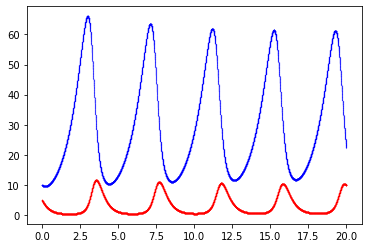

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651701063.png


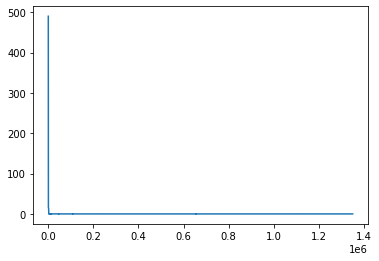

Epoch [1351000/2000000] Loss:0.000481 Loss_1:0.000000 Loss_2:0.000480 Loss_3: 0.000000 Lr:0.000073 Time:10.530409s (186.04min in total)
Epoch [1352000/2000000] Loss:0.000465 Loss_1:0.000000 Loss_2:0.000465 Loss_3: 0.000000 Lr:0.000073 Time:8.121513s (186.17min in total)
Epoch [1353000/2000000] Loss:0.000477 Loss_1:0.000002 Loss_2:0.000475 Loss_3: 0.000000 Lr:0.000073 Time:8.152020s (186.31min in total)
Epoch [1354000/2000000] Loss:0.001375 Loss_1:0.000002 Loss_2:0.001373 Loss_3: 0.000000 Lr:0.000073 Time:8.056728s (186.44min in total)
Epoch [1355000/2000000] Loss:0.000473 Loss_1:0.000002 Loss_2:0.000471 Loss_3: 0.000000 Lr:0.000073 Time:8.215139s (186.58min in total)
Epoch [1356000/2000000] Loss:0.000465 Loss_1:0.000000 Loss_2:0.000465 Loss_3: 0.000000 Lr:0.000073 Time:8.056334s (186.71min in total)
Epoch [1357000/2000000] Loss:0.000464 Loss_1:0.000000 Loss_2:0.000464 Loss_3: 0.000000 Lr:0.000073 Time:8.161545s (186.85min in total)
Epoch [1358000/2000000] Loss:0.000464 Loss_1:0.000000 

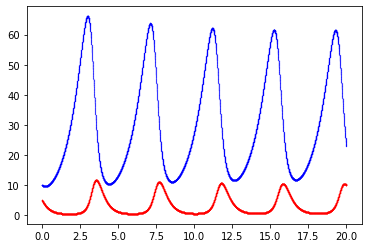

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651701471.png


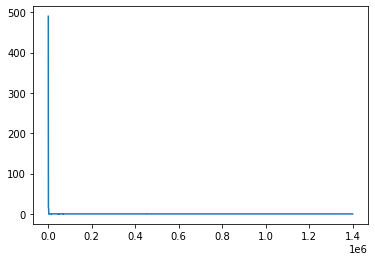

Epoch [1401000/2000000] Loss:0.000483 Loss_1:0.000000 Loss_2:0.000483 Loss_3: 0.000000 Lr:0.000071 Time:10.716157s (192.84min in total)
Epoch [1402000/2000000] Loss:0.000450 Loss_1:0.000000 Loss_2:0.000450 Loss_3: 0.000000 Lr:0.000071 Time:8.041106s (192.98min in total)
Epoch [1403000/2000000] Loss:0.000450 Loss_1:0.000000 Loss_2:0.000450 Loss_3: 0.000000 Lr:0.000071 Time:8.105474s (193.11min in total)
Epoch [1404000/2000000] Loss:0.000511 Loss_1:0.000000 Loss_2:0.000511 Loss_3: 0.000000 Lr:0.000071 Time:8.103536s (193.25min in total)
Epoch [1405000/2000000] Loss:0.000718 Loss_1:0.000000 Loss_2:0.000717 Loss_3: 0.000000 Lr:0.000071 Time:8.140887s (193.38min in total)
Epoch [1406000/2000000] Loss:0.000924 Loss_1:0.000000 Loss_2:0.000924 Loss_3: 0.000000 Lr:0.000071 Time:8.063558s (193.52min in total)
Epoch [1407000/2000000] Loss:0.000448 Loss_1:0.000000 Loss_2:0.000448 Loss_3: 0.000000 Lr:0.000071 Time:8.157986s (193.65min in total)
Epoch [1408000/2000000] Loss:0.003559 Loss_1:0.000000 

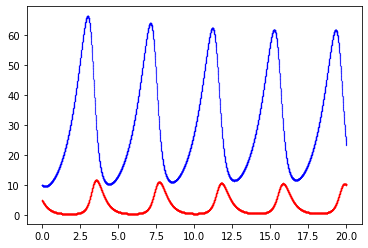

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651701880.png


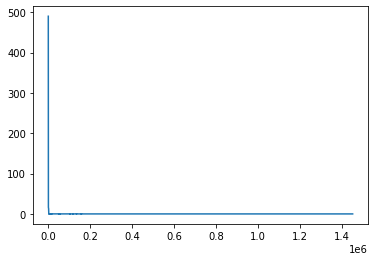

Epoch [1451000/2000000] Loss:0.002453 Loss_1:0.000000 Loss_2:0.002453 Loss_3: 0.000000 Lr:0.000068 Time:10.838161s (199.65min in total)
Epoch [1452000/2000000] Loss:0.000451 Loss_1:0.000000 Loss_2:0.000451 Loss_3: 0.000000 Lr:0.000068 Time:8.112990s (199.79min in total)
Epoch [1453000/2000000] Loss:0.000435 Loss_1:0.000000 Loss_2:0.000435 Loss_3: 0.000000 Lr:0.000068 Time:8.161467s (199.92min in total)
Epoch [1454000/2000000] Loss:0.000434 Loss_1:0.000000 Loss_2:0.000434 Loss_3: 0.000000 Lr:0.000068 Time:8.130543s (200.06min in total)
Epoch [1455000/2000000] Loss:0.001358 Loss_1:0.000000 Loss_2:0.001358 Loss_3: 0.000000 Lr:0.000068 Time:8.021522s (200.19min in total)
Epoch [1456000/2000000] Loss:0.000441 Loss_1:0.000000 Loss_2:0.000440 Loss_3: 0.000000 Lr:0.000068 Time:8.081416s (200.33min in total)
Epoch [1457000/2000000] Loss:0.000643 Loss_1:0.000001 Loss_2:0.000642 Loss_3: 0.000000 Lr:0.000068 Time:8.109099s (200.46min in total)
Epoch [1458000/2000000] Loss:0.000436 Loss_1:0.000001 

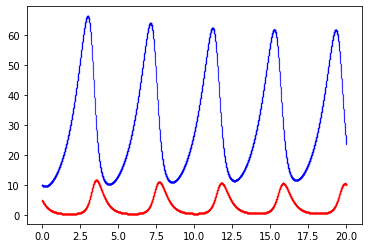

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651702288.png


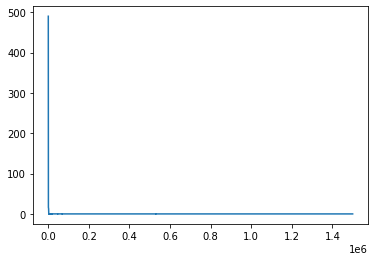

Epoch [1501000/2000000] Loss:0.002215 Loss_1:0.000000 Loss_2:0.002214 Loss_3: 0.000000 Lr:0.000066 Time:10.649392s (206.45min in total)
Epoch [1502000/2000000] Loss:0.000423 Loss_1:0.000000 Loss_2:0.000422 Loss_3: 0.000000 Lr:0.000066 Time:8.063269s (206.59min in total)
Epoch [1503000/2000000] Loss:0.000425 Loss_1:0.000000 Loss_2:0.000425 Loss_3: 0.000000 Lr:0.000066 Time:8.027612s (206.72min in total)
Epoch [1504000/2000000] Loss:0.000474 Loss_1:0.000001 Loss_2:0.000474 Loss_3: 0.000000 Lr:0.000066 Time:8.090291s (206.85min in total)
Epoch [1505000/2000000] Loss:0.000484 Loss_1:0.000000 Loss_2:0.000484 Loss_3: 0.000000 Lr:0.000066 Time:8.053486s (206.99min in total)
Epoch [1506000/2000000] Loss:0.000421 Loss_1:0.000000 Loss_2:0.000421 Loss_3: 0.000000 Lr:0.000066 Time:8.041114s (207.12min in total)
Epoch [1507000/2000000] Loss:0.000636 Loss_1:0.000000 Loss_2:0.000636 Loss_3: 0.000000 Lr:0.000066 Time:8.088823s (207.26min in total)
Epoch [1508000/2000000] Loss:0.000420 Loss_1:0.000000 

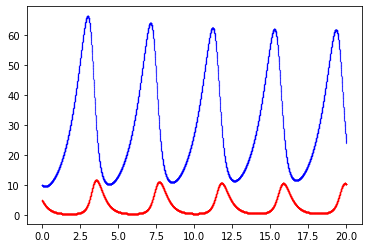

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651702693.png


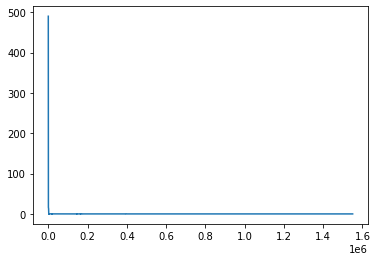

Epoch [1551000/2000000] Loss:0.000412 Loss_1:0.000000 Loss_2:0.000412 Loss_3: 0.000000 Lr:0.000064 Time:10.709410s (213.20min in total)
Epoch [1552000/2000000] Loss:0.000408 Loss_1:0.000000 Loss_2:0.000408 Loss_3: 0.000000 Lr:0.000064 Time:8.026798s (213.34min in total)
Epoch [1553000/2000000] Loss:0.000428 Loss_1:0.000000 Loss_2:0.000428 Loss_3: 0.000000 Lr:0.000064 Time:8.075872s (213.47min in total)
Epoch [1554000/2000000] Loss:0.000409 Loss_1:0.000000 Loss_2:0.000408 Loss_3: 0.000000 Lr:0.000064 Time:7.968634s (213.60min in total)
Epoch [1555000/2000000] Loss:0.000735 Loss_1:0.000000 Loss_2:0.000735 Loss_3: 0.000000 Lr:0.000064 Time:8.052811s (213.74min in total)
Epoch [1556000/2000000] Loss:0.000408 Loss_1:0.000000 Loss_2:0.000407 Loss_3: 0.000000 Lr:0.000064 Time:8.086382s (213.87min in total)
Epoch [1557000/2000000] Loss:0.000407 Loss_1:0.000000 Loss_2:0.000407 Loss_3: 0.000000 Lr:0.000064 Time:8.058828s (214.01min in total)
Epoch [1558000/2000000] Loss:0.000786 Loss_1:0.000000 

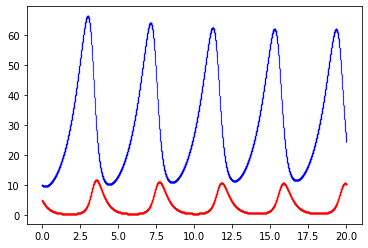

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651703098.png


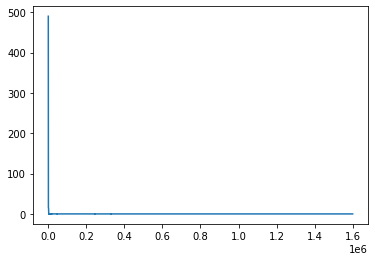

Epoch [1601000/2000000] Loss:0.000397 Loss_1:0.000000 Loss_2:0.000397 Loss_3: 0.000000 Lr:0.000062 Time:11.082578s (219.97min in total)
Epoch [1602000/2000000] Loss:0.000414 Loss_1:0.000000 Loss_2:0.000413 Loss_3: 0.000000 Lr:0.000062 Time:7.994674s (220.10min in total)
Epoch [1603000/2000000] Loss:0.000479 Loss_1:0.000000 Loss_2:0.000479 Loss_3: 0.000000 Lr:0.000062 Time:7.979398s (220.23min in total)
Epoch [1604000/2000000] Loss:0.000429 Loss_1:0.000000 Loss_2:0.000429 Loss_3: 0.000000 Lr:0.000062 Time:8.125065s (220.37min in total)
Epoch [1605000/2000000] Loss:0.000403 Loss_1:0.000000 Loss_2:0.000403 Loss_3: 0.000000 Lr:0.000062 Time:7.980717s (220.50min in total)
Epoch [1606000/2000000] Loss:0.000424 Loss_1:0.000000 Loss_2:0.000423 Loss_3: 0.000000 Lr:0.000062 Time:8.049000s (220.64min in total)
Epoch [1607000/2000000] Loss:0.000398 Loss_1:0.000000 Loss_2:0.000397 Loss_3: 0.000000 Lr:0.000062 Time:8.078395s (220.77min in total)
Epoch [1608000/2000000] Loss:0.000514 Loss_1:0.000000 

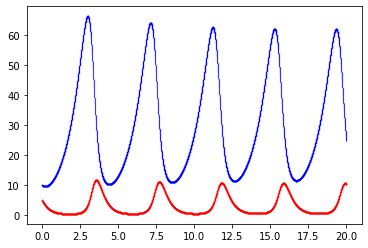

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651703504.png


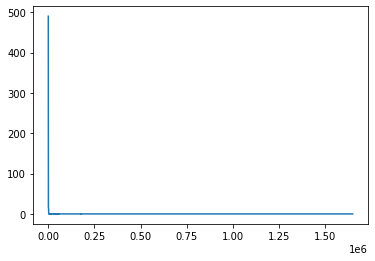

Epoch [1651000/2000000] Loss:0.000385 Loss_1:0.000000 Loss_2:0.000385 Loss_3: 0.000000 Lr:0.000060 Time:10.932838s (226.72min in total)
Epoch [1652000/2000000] Loss:0.000385 Loss_1:0.000000 Loss_2:0.000385 Loss_3: 0.000000 Lr:0.000060 Time:8.048920s (226.86min in total)
Epoch [1653000/2000000] Loss:0.000386 Loss_1:0.000000 Loss_2:0.000386 Loss_3: 0.000000 Lr:0.000060 Time:8.027313s (226.99min in total)
Epoch [1654000/2000000] Loss:0.000386 Loss_1:0.000000 Loss_2:0.000385 Loss_3: 0.000000 Lr:0.000060 Time:8.068972s (227.13min in total)
Epoch [1655000/2000000] Loss:0.000395 Loss_1:0.000000 Loss_2:0.000394 Loss_3: 0.000000 Lr:0.000060 Time:7.996525s (227.26min in total)
Epoch [1656000/2000000] Loss:0.000413 Loss_1:0.000000 Loss_2:0.000413 Loss_3: 0.000000 Lr:0.000060 Time:8.095362s (227.39min in total)
Epoch [1657000/2000000] Loss:0.000384 Loss_1:0.000000 Loss_2:0.000384 Loss_3: 0.000000 Lr:0.000060 Time:8.182960s (227.53min in total)
Epoch [1658000/2000000] Loss:0.000418 Loss_1:0.000000 

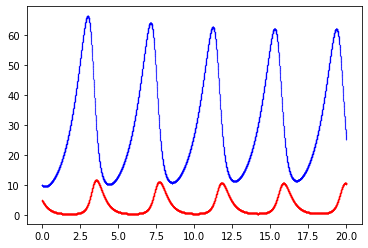

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651703910.png


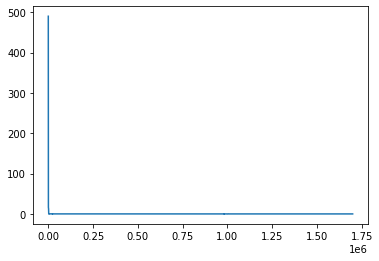

Epoch [1701000/2000000] Loss:0.000502 Loss_1:0.000001 Loss_2:0.000502 Loss_3: 0.000000 Lr:0.000058 Time:10.874013s (233.49min in total)
Epoch [1702000/2000000] Loss:0.000387 Loss_1:0.000000 Loss_2:0.000387 Loss_3: 0.000000 Lr:0.000058 Time:8.017662s (233.62min in total)
Epoch [1703000/2000000] Loss:0.000375 Loss_1:0.000000 Loss_2:0.000375 Loss_3: 0.000000 Lr:0.000058 Time:8.139118s (233.75min in total)
Epoch [1704000/2000000] Loss:0.000379 Loss_1:0.000000 Loss_2:0.000378 Loss_3: 0.000000 Lr:0.000058 Time:8.085257s (233.89min in total)
Epoch [1705000/2000000] Loss:0.000485 Loss_1:0.000001 Loss_2:0.000484 Loss_3: 0.000000 Lr:0.000058 Time:8.080457s (234.02min in total)
Epoch [1706000/2000000] Loss:0.000376 Loss_1:0.000000 Loss_2:0.000376 Loss_3: 0.000000 Lr:0.000058 Time:8.134068s (234.16min in total)
Epoch [1707000/2000000] Loss:0.000399 Loss_1:0.000003 Loss_2:0.000396 Loss_3: 0.000000 Lr:0.000058 Time:8.049596s (234.29min in total)
Epoch [1708000/2000000] Loss:0.000390 Loss_1:0.000000 

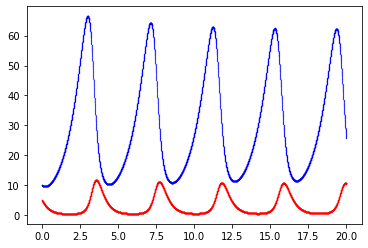

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651704316.png


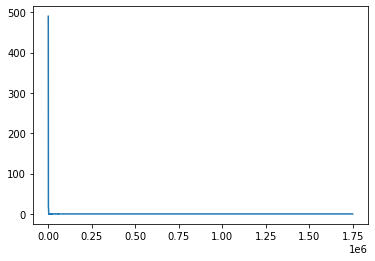

Epoch [1751000/2000000] Loss:0.000366 Loss_1:0.000000 Loss_2:0.000365 Loss_3: 0.000000 Lr:0.000057 Time:11.207877s (240.26min in total)
Epoch [1752000/2000000] Loss:0.000365 Loss_1:0.000000 Loss_2:0.000365 Loss_3: 0.000000 Lr:0.000057 Time:8.204402s (240.40min in total)
Epoch [1753000/2000000] Loss:0.000367 Loss_1:0.000000 Loss_2:0.000367 Loss_3: 0.000000 Lr:0.000057 Time:8.086295s (240.54min in total)
Epoch [1754000/2000000] Loss:0.000365 Loss_1:0.000000 Loss_2:0.000365 Loss_3: 0.000000 Lr:0.000057 Time:8.008127s (240.67min in total)
Epoch [1755000/2000000] Loss:0.000364 Loss_1:0.000000 Loss_2:0.000364 Loss_3: 0.000000 Lr:0.000057 Time:8.123996s (240.80min in total)
Epoch [1756000/2000000] Loss:0.000375 Loss_1:0.000000 Loss_2:0.000375 Loss_3: 0.000000 Lr:0.000057 Time:8.134341s (240.94min in total)
Epoch [1757000/2000000] Loss:0.000389 Loss_1:0.000000 Loss_2:0.000388 Loss_3: 0.000000 Lr:0.000057 Time:8.096559s (241.07min in total)
Epoch [1758000/2000000] Loss:0.000366 Loss_1:0.000000 

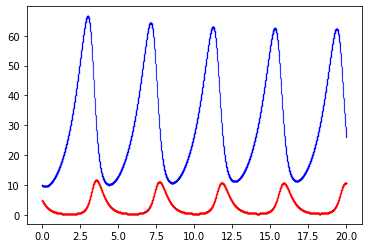

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651704722.png


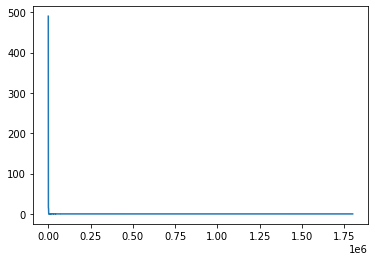

Epoch [1801000/2000000] Loss:0.000364 Loss_1:0.000000 Loss_2:0.000364 Loss_3: 0.000000 Lr:0.000055 Time:11.311018s (247.03min in total)
Epoch [1802000/2000000] Loss:0.000355 Loss_1:0.000000 Loss_2:0.000355 Loss_3: 0.000000 Lr:0.000055 Time:8.065510s (247.17min in total)
Epoch [1803000/2000000] Loss:0.000356 Loss_1:0.000000 Loss_2:0.000356 Loss_3: 0.000000 Lr:0.000055 Time:8.052577s (247.30min in total)
Epoch [1804000/2000000] Loss:0.000356 Loss_1:0.000000 Loss_2:0.000356 Loss_3: 0.000000 Lr:0.000055 Time:8.045513s (247.43min in total)
Epoch [1805000/2000000] Loss:0.000355 Loss_1:0.000000 Loss_2:0.000355 Loss_3: 0.000000 Lr:0.000055 Time:8.078033s (247.57min in total)
Epoch [1806000/2000000] Loss:0.000359 Loss_1:0.000001 Loss_2:0.000358 Loss_3: 0.000000 Lr:0.000055 Time:8.101325s (247.70min in total)
Epoch [1807000/2000000] Loss:0.000357 Loss_1:0.000000 Loss_2:0.000356 Loss_3: 0.000000 Lr:0.000055 Time:7.986861s (247.84min in total)
Epoch [1808000/2000000] Loss:0.000360 Loss_1:0.000001 

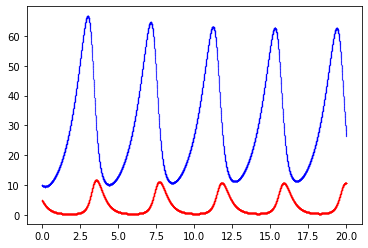

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651705127.png


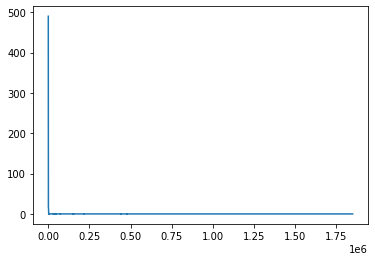

Epoch [1851000/2000000] Loss:0.000350 Loss_1:0.000000 Loss_2:0.000350 Loss_3: 0.000000 Lr:0.000054 Time:11.240582s (253.78min in total)
Epoch [1852000/2000000] Loss:0.000360 Loss_1:0.000000 Loss_2:0.000359 Loss_3: 0.000000 Lr:0.000054 Time:8.043012s (253.91min in total)
Epoch [1853000/2000000] Loss:0.000348 Loss_1:0.000000 Loss_2:0.000348 Loss_3: 0.000000 Lr:0.000054 Time:8.045175s (254.05min in total)
Epoch [1854000/2000000] Loss:0.000362 Loss_1:0.000000 Loss_2:0.000362 Loss_3: 0.000000 Lr:0.000054 Time:7.996547s (254.18min in total)
Epoch [1855000/2000000] Loss:0.000546 Loss_1:0.000000 Loss_2:0.000546 Loss_3: 0.000000 Lr:0.000054 Time:8.009521s (254.31min in total)
Epoch [1856000/2000000] Loss:0.000429 Loss_1:0.000000 Loss_2:0.000429 Loss_3: 0.000000 Lr:0.000054 Time:8.094590s (254.45min in total)
Epoch [1857000/2000000] Loss:0.000356 Loss_1:0.000000 Loss_2:0.000355 Loss_3: 0.000000 Lr:0.000054 Time:8.130584s (254.59min in total)
Epoch [1858000/2000000] Loss:0.000360 Loss_1:0.000000 

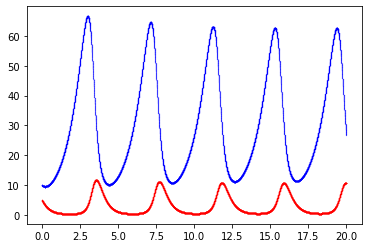

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651705533.png


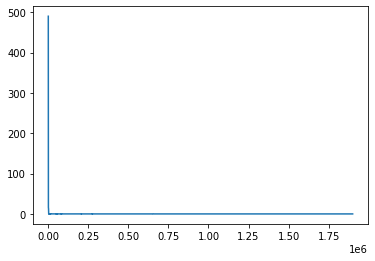

Epoch [1901000/2000000] Loss:0.000360 Loss_1:0.000000 Loss_2:0.000360 Loss_3: 0.000000 Lr:0.000052 Time:11.290518s (260.55min in total)
Epoch [1902000/2000000] Loss:0.000339 Loss_1:0.000000 Loss_2:0.000338 Loss_3: 0.000000 Lr:0.000052 Time:8.018654s (260.69min in total)
Epoch [1903000/2000000] Loss:0.000677 Loss_1:0.000000 Loss_2:0.000677 Loss_3: 0.000000 Lr:0.000052 Time:7.992659s (260.82min in total)
Epoch [1904000/2000000] Loss:0.000338 Loss_1:0.000000 Loss_2:0.000338 Loss_3: 0.000000 Lr:0.000052 Time:8.213719s (260.96min in total)
Epoch [1905000/2000000] Loss:0.000343 Loss_1:0.000000 Loss_2:0.000343 Loss_3: 0.000000 Lr:0.000052 Time:8.145900s (261.09min in total)
Epoch [1906000/2000000] Loss:0.000338 Loss_1:0.000000 Loss_2:0.000338 Loss_3: 0.000000 Lr:0.000052 Time:8.180734s (261.23min in total)
Epoch [1907000/2000000] Loss:0.000337 Loss_1:0.000000 Loss_2:0.000337 Loss_3: 0.000000 Lr:0.000052 Time:8.067393s (261.36min in total)
Epoch [1908000/2000000] Loss:0.000338 Loss_1:0.000000 

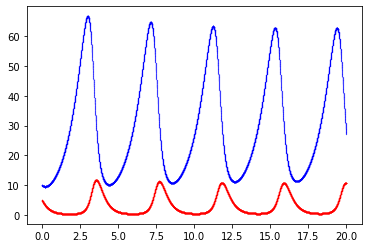

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651705940.png


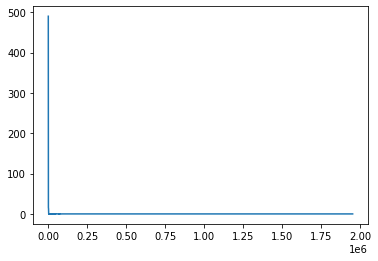

Epoch [1951000/2000000] Loss:0.000331 Loss_1:0.000000 Loss_2:0.000331 Loss_3: 0.000000 Lr:0.000051 Time:11.208110s (267.32min in total)
Epoch [1952000/2000000] Loss:0.000335 Loss_1:0.000000 Loss_2:0.000334 Loss_3: 0.000000 Lr:0.000051 Time:7.985472s (267.45min in total)
Epoch [1953000/2000000] Loss:0.000659 Loss_1:0.000000 Loss_2:0.000659 Loss_3: 0.000000 Lr:0.000051 Time:8.167178s (267.59min in total)
Epoch [1954000/2000000] Loss:0.000335 Loss_1:0.000000 Loss_2:0.000335 Loss_3: 0.000000 Lr:0.000051 Time:8.153804s (267.73min in total)
Epoch [1955000/2000000] Loss:0.000330 Loss_1:0.000000 Loss_2:0.000330 Loss_3: 0.000000 Lr:0.000051 Time:8.052564s (267.86min in total)
Epoch [1956000/2000000] Loss:0.000331 Loss_1:0.000000 Loss_2:0.000330 Loss_3: 0.000000 Lr:0.000051 Time:8.077669s (268.00min in total)
Epoch [1957000/2000000] Loss:0.000363 Loss_1:0.000001 Loss_2:0.000362 Loss_3: 0.000000 Lr:0.000051 Time:7.984865s (268.13min in total)
Epoch [1958000/2000000] Loss:0.000330 Loss_1:0.000000 

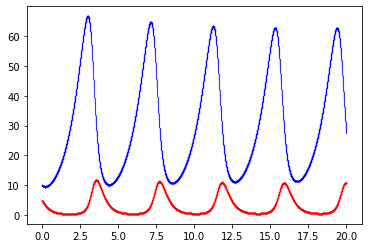

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_1651706345.png


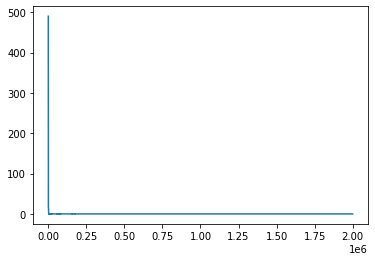

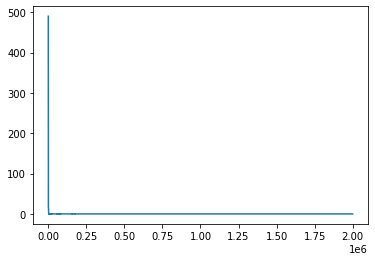


[Training Summary]
num_parameter: -1
best_loss: 0.00032317638397216797
time_cost: 273.88654796679816


<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design D - original - Adam - L2 norm - no square - 2000000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-24-23-17-52
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-23-17-52_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-23-17-52_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-23-17-52_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:17.799767 Loss_1:2.264346 Loss_2:15.535419 Loss_3: 0.000001 Lr:0.009091 Time:13.668683s (0.23min in total)
Epoch [02000/100000] Loss:17

Exception ignored in: <function MySQLConnection.__del__ at 0x7f54c015b830>
Traceback (most recent call last):
  File "<ipython-input-3-037fcc2606c8>", line 21, in __del__
AttributeError: 'MySQLConnection' object has no attribute 'connection'


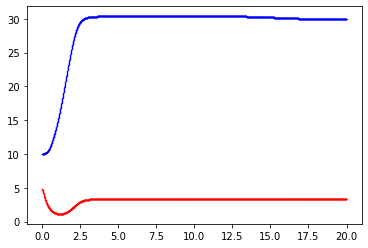

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-23-17-52_1650842391.png


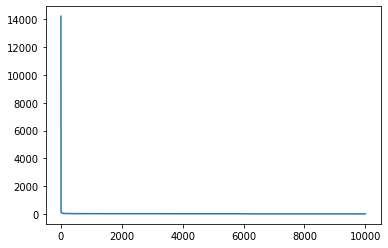

Epoch [11000/100000] Loss:0.231665 Loss_1:0.003490 Loss_2:0.228175 Loss_3: 0.000000 Lr:0.004762 Time:12.191500s (2.20min in total)
Epoch [12000/100000] Loss:0.214880 Loss_1:0.000316 Loss_2:0.214564 Loss_3: 0.000000 Lr:0.004545 Time:11.845017s (2.40min in total)
Epoch [13000/100000] Loss:0.212470 Loss_1:0.000268 Loss_2:0.212202 Loss_3: 0.000000 Lr:0.004348 Time:11.544256s (2.59min in total)
Epoch [14000/100000] Loss:0.223240 Loss_1:0.006655 Loss_2:0.216585 Loss_3: 0.000000 Lr:0.004167 Time:11.532827s (2.78min in total)
Epoch [15000/100000] Loss:0.248310 Loss_1:0.016055 Loss_2:0.232255 Loss_3: 0.000000 Lr:0.004000 Time:12.030326s (2.98min in total)
Epoch [16000/100000] Loss:0.163661 Loss_1:0.000486 Loss_2:0.163175 Loss_3: 0.000000 Lr:0.003846 Time:11.475797s (3.17min in total)
Epoch [17000/100000] Loss:0.155622 Loss_1:0.000598 Loss_2:0.155024 Loss_3: 0.000000 Lr:0.003704 Time:11.543623s (3.37min in total)
Epoch [18000/100000] Loss:0.154210 Loss_1:0.003535 Loss_2:0.150675 Loss_3: 0.000000

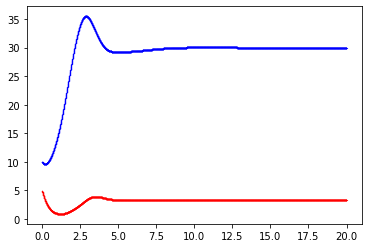

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-23-17-52_1650842509.png


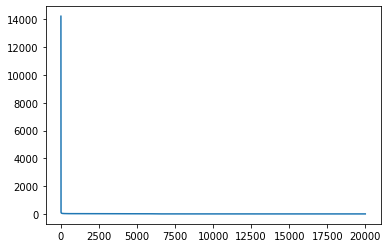

KeyboardInterrupt: ignored

<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design D - original - Adam - L2 norm - no square
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-24-19-45-58
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:0.373936 Loss_1:0.025963 Loss_2:0.347973 Loss_3: 0.000000 Lr:0.009091 Time:10.715964s (0.18min in total)
Epoch [02000/100000] Loss:0.36

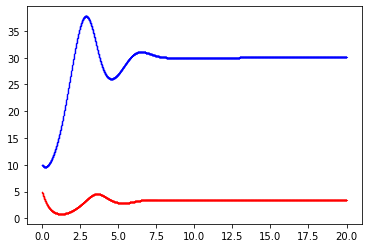

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650829665.png


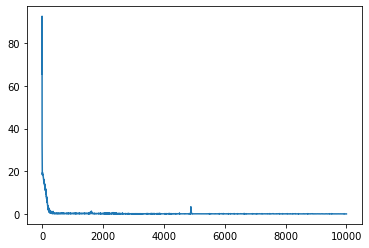

Epoch [11000/100000] Loss:0.118619 Loss_1:0.012246 Loss_2:0.106372 Loss_3: 0.000000 Lr:0.004762 Time:11.370520s (1.97min in total)
Epoch [12000/100000] Loss:0.130991 Loss_1:0.011219 Loss_2:0.119771 Loss_3: 0.000000 Lr:0.004545 Time:10.654036s (2.15min in total)
Epoch [13000/100000] Loss:0.098396 Loss_1:0.004190 Loss_2:0.094206 Loss_3: 0.000000 Lr:0.004348 Time:10.706687s (2.33min in total)
Epoch [14000/100000] Loss:0.105511 Loss_1:0.002385 Loss_2:0.103125 Loss_3: 0.000000 Lr:0.004167 Time:10.687423s (2.50min in total)
Epoch [15000/100000] Loss:0.096262 Loss_1:0.000109 Loss_2:0.096152 Loss_3: 0.000000 Lr:0.004000 Time:10.663568s (2.68min in total)
Epoch [16000/100000] Loss:0.083878 Loss_1:0.000330 Loss_2:0.083548 Loss_3: 0.000000 Lr:0.003846 Time:10.695637s (2.86min in total)
Epoch [17000/100000] Loss:0.084964 Loss_1:0.001406 Loss_2:0.083557 Loss_3: 0.000000 Lr:0.003704 Time:10.708608s (3.04min in total)
Epoch [18000/100000] Loss:0.075355 Loss_1:0.000061 Loss_2:0.075294 Loss_3: 0.000000

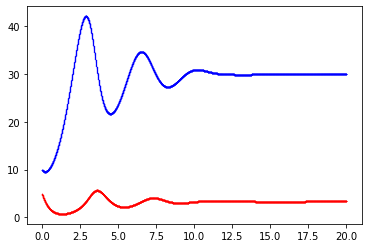

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650829773.png


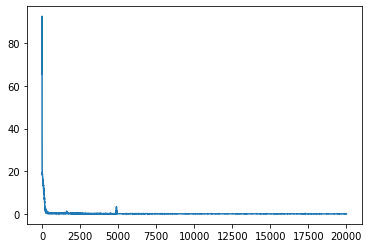

Epoch [21000/100000] Loss:0.068255 Loss_1:0.000265 Loss_2:0.067990 Loss_3: 0.000000 Lr:0.003226 Time:12.803592s (3.79min in total)
Epoch [22000/100000] Loss:0.077266 Loss_1:0.001121 Loss_2:0.076145 Loss_3: 0.000000 Lr:0.003125 Time:10.694251s (3.96min in total)
Epoch [23000/100000] Loss:0.067669 Loss_1:0.000556 Loss_2:0.067113 Loss_3: 0.000000 Lr:0.003030 Time:10.691391s (4.14min in total)
Epoch [24000/100000] Loss:0.145839 Loss_1:0.001401 Loss_2:0.144438 Loss_3: 0.000000 Lr:0.002941 Time:11.123336s (4.33min in total)
Epoch [25000/100000] Loss:0.074388 Loss_1:0.000559 Loss_2:0.073829 Loss_3: 0.000000 Lr:0.002857 Time:10.652428s (4.51min in total)
Epoch [26000/100000] Loss:0.062018 Loss_1:0.000203 Loss_2:0.061815 Loss_3: 0.000000 Lr:0.002778 Time:10.659744s (4.68min in total)
Epoch [27000/100000] Loss:0.068552 Loss_1:0.001143 Loss_2:0.067409 Loss_3: 0.000000 Lr:0.002703 Time:10.691233s (4.86min in total)
Epoch [28000/100000] Loss:0.059601 Loss_1:0.000610 Loss_2:0.058991 Loss_3: 0.000000

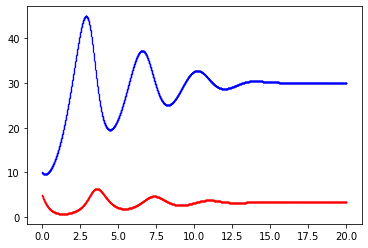

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650829883.png


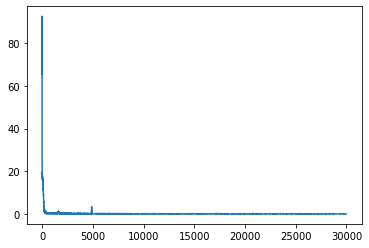

Epoch [31000/100000] Loss:0.054903 Loss_1:0.000496 Loss_2:0.054407 Loss_3: 0.000000 Lr:0.002439 Time:11.373917s (5.60min in total)
Epoch [32000/100000] Loss:0.081615 Loss_1:0.002217 Loss_2:0.079399 Loss_3: 0.000000 Lr:0.002381 Time:10.710709s (5.77min in total)
Epoch [33000/100000] Loss:0.054341 Loss_1:0.000248 Loss_2:0.054094 Loss_3: 0.000000 Lr:0.002326 Time:10.676009s (5.95min in total)
Epoch [34000/100000] Loss:0.072553 Loss_1:0.000575 Loss_2:0.071978 Loss_3: 0.000000 Lr:0.002273 Time:10.689474s (6.13min in total)
Epoch [35000/100000] Loss:0.054602 Loss_1:0.000120 Loss_2:0.054482 Loss_3: 0.000000 Lr:0.002222 Time:15.505980s (6.39min in total)
Epoch [36000/100000] Loss:0.050499 Loss_1:0.000036 Loss_2:0.050463 Loss_3: 0.000000 Lr:0.002174 Time:13.264406s (6.61min in total)
Epoch [37000/100000] Loss:0.050386 Loss_1:0.000161 Loss_2:0.050225 Loss_3: 0.000000 Lr:0.002128 Time:12.167553s (6.81min in total)
Epoch [38000/100000] Loss:0.050572 Loss_1:0.000094 Loss_2:0.050478 Loss_3: 0.000000

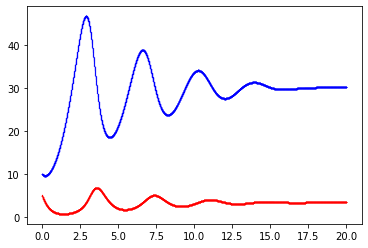

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830003.png


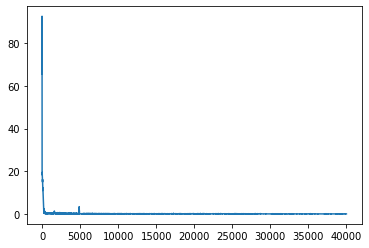

Epoch [41000/100000] Loss:0.048306 Loss_1:0.000206 Loss_2:0.048100 Loss_3: 0.000000 Lr:0.001961 Time:12.260453s (7.61min in total)
Epoch [42000/100000] Loss:0.063310 Loss_1:0.000150 Loss_2:0.063160 Loss_3: 0.000000 Lr:0.001923 Time:10.893468s (7.79min in total)
Epoch [43000/100000] Loss:0.045886 Loss_1:0.000043 Loss_2:0.045842 Loss_3: 0.000000 Lr:0.001887 Time:11.981509s (7.99min in total)
Epoch [44000/100000] Loss:0.047980 Loss_1:0.000155 Loss_2:0.047824 Loss_3: 0.000000 Lr:0.001852 Time:11.601613s (8.19min in total)
Epoch [45000/100000] Loss:0.049284 Loss_1:0.000114 Loss_2:0.049171 Loss_3: 0.000000 Lr:0.001818 Time:10.700610s (8.37min in total)
Epoch [46000/100000] Loss:0.048091 Loss_1:0.000101 Loss_2:0.047991 Loss_3: 0.000000 Lr:0.001786 Time:10.761146s (8.54min in total)
Epoch [47000/100000] Loss:0.062013 Loss_1:0.000379 Loss_2:0.061634 Loss_3: 0.000000 Lr:0.001754 Time:10.737076s (8.72min in total)
Epoch [48000/100000] Loss:0.052356 Loss_1:0.000356 Loss_2:0.052000 Loss_3: 0.000000

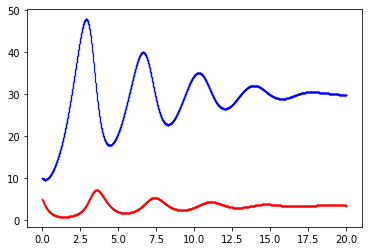

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830115.png


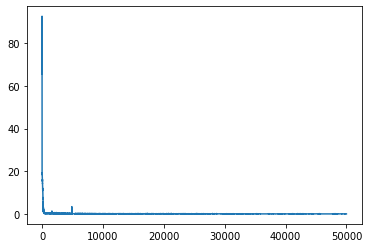

Epoch [51000/100000] Loss:0.046365 Loss_1:0.000022 Loss_2:0.046343 Loss_3: 0.000000 Lr:0.001639 Time:11.406575s (9.47min in total)
Epoch [52000/100000] Loss:0.052326 Loss_1:0.000963 Loss_2:0.051363 Loss_3: 0.000000 Lr:0.001613 Time:10.655523s (9.64min in total)
Epoch [53000/100000] Loss:0.042605 Loss_1:0.000247 Loss_2:0.042357 Loss_3: 0.000000 Lr:0.001587 Time:11.103011s (9.83min in total)
Epoch [54000/100000] Loss:0.043367 Loss_1:0.000056 Loss_2:0.043311 Loss_3: 0.000000 Lr:0.001563 Time:10.708702s (10.01min in total)
Epoch [55000/100000] Loss:0.043540 Loss_1:0.000179 Loss_2:0.043361 Loss_3: 0.000000 Lr:0.001538 Time:10.703682s (10.19min in total)
Epoch [56000/100000] Loss:0.044759 Loss_1:0.000117 Loss_2:0.044642 Loss_3: 0.000000 Lr:0.001515 Time:10.690298s (10.36min in total)
Epoch [57000/100000] Loss:0.042416 Loss_1:0.000000 Loss_2:0.042416 Loss_3: 0.000000 Lr:0.001493 Time:11.065812s (10.55min in total)
Epoch [58000/100000] Loss:0.040137 Loss_1:0.000067 Loss_2:0.040070 Loss_3: 0.00

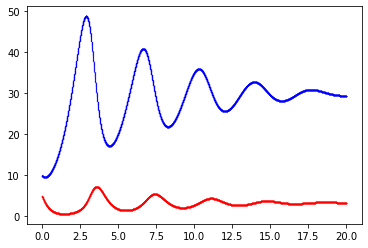

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830223.png


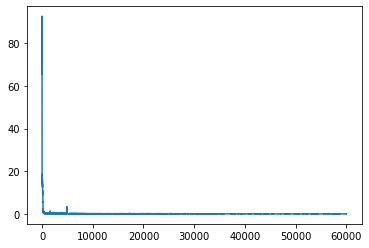

Epoch [61000/100000] Loss:0.038742 Loss_1:0.000020 Loss_2:0.038721 Loss_3: 0.000000 Lr:0.001408 Time:11.408859s (11.27min in total)
Epoch [62000/100000] Loss:0.080767 Loss_1:0.000035 Loss_2:0.080732 Loss_3: 0.000000 Lr:0.001389 Time:10.683911s (11.45min in total)
Epoch [63000/100000] Loss:0.097757 Loss_1:0.001398 Loss_2:0.096359 Loss_3: 0.000000 Lr:0.001370 Time:10.677359s (11.63min in total)
Epoch [64000/100000] Loss:0.037973 Loss_1:0.000045 Loss_2:0.037928 Loss_3: 0.000000 Lr:0.001351 Time:10.769532s (11.81min in total)
Epoch [65000/100000] Loss:0.036420 Loss_1:0.000003 Loss_2:0.036417 Loss_3: 0.000000 Lr:0.001333 Time:10.686697s (11.99min in total)
Epoch [66000/100000] Loss:0.045028 Loss_1:0.000074 Loss_2:0.044955 Loss_3: 0.000000 Lr:0.001316 Time:10.711321s (12.17min in total)
Epoch [67000/100000] Loss:0.035457 Loss_1:0.000018 Loss_2:0.035439 Loss_3: 0.000000 Lr:0.001299 Time:10.663964s (12.34min in total)
Epoch [68000/100000] Loss:0.047024 Loss_1:0.000234 Loss_2:0.046790 Loss_3: 0

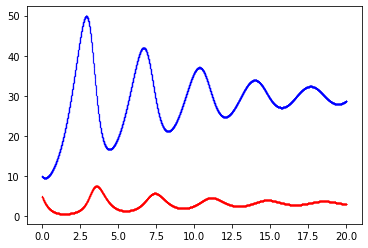

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830331.png


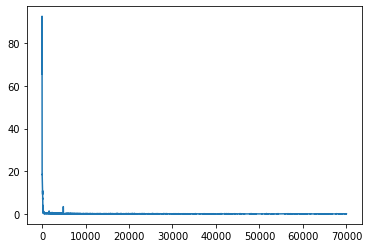

Epoch [71000/100000] Loss:0.033131 Loss_1:0.000006 Loss_2:0.033125 Loss_3: 0.000000 Lr:0.001235 Time:11.467294s (13.07min in total)
Epoch [72000/100000] Loss:0.108846 Loss_1:0.000625 Loss_2:0.108221 Loss_3: 0.000000 Lr:0.001220 Time:10.751204s (13.25min in total)
Epoch [73000/100000] Loss:0.032870 Loss_1:0.000017 Loss_2:0.032853 Loss_3: 0.000000 Lr:0.001205 Time:10.685948s (13.43min in total)
Epoch [74000/100000] Loss:0.033216 Loss_1:0.000062 Loss_2:0.033154 Loss_3: 0.000000 Lr:0.001190 Time:10.702374s (13.60min in total)
Epoch [75000/100000] Loss:0.045411 Loss_1:0.000049 Loss_2:0.045362 Loss_3: 0.000000 Lr:0.001176 Time:10.653587s (13.78min in total)
Epoch [76000/100000] Loss:0.117441 Loss_1:0.000809 Loss_2:0.116632 Loss_3: 0.000000 Lr:0.001163 Time:10.679324s (13.96min in total)
Epoch [77000/100000] Loss:0.031653 Loss_1:0.000001 Loss_2:0.031651 Loss_3: 0.000000 Lr:0.001149 Time:10.680676s (14.14min in total)
Epoch [78000/100000] Loss:0.030963 Loss_1:0.000077 Loss_2:0.030886 Loss_3: 0

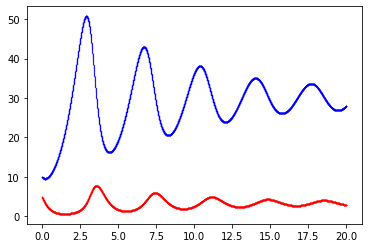

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830439.png


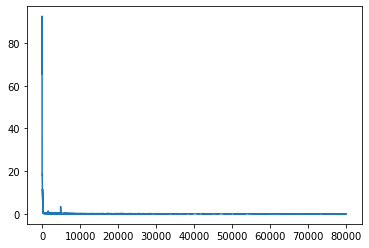

Epoch [81000/100000] Loss:0.073435 Loss_1:0.000273 Loss_2:0.073163 Loss_3: 0.000000 Lr:0.001099 Time:11.485433s (14.86min in total)
Epoch [82000/100000] Loss:0.072161 Loss_1:0.000625 Loss_2:0.071536 Loss_3: 0.000000 Lr:0.001087 Time:10.684841s (15.04min in total)
Epoch [83000/100000] Loss:0.031294 Loss_1:0.000162 Loss_2:0.031132 Loss_3: 0.000000 Lr:0.001075 Time:10.679965s (15.22min in total)
Epoch [84000/100000] Loss:0.028156 Loss_1:0.000005 Loss_2:0.028150 Loss_3: 0.000000 Lr:0.001064 Time:10.671795s (15.40min in total)
Epoch [85000/100000] Loss:0.030178 Loss_1:0.000026 Loss_2:0.030152 Loss_3: 0.000000 Lr:0.001053 Time:10.681327s (15.58min in total)
Epoch [86000/100000] Loss:0.093721 Loss_1:0.000211 Loss_2:0.093510 Loss_3: 0.000000 Lr:0.001042 Time:10.712024s (15.75min in total)
Epoch [87000/100000] Loss:0.028569 Loss_1:0.000008 Loss_2:0.028561 Loss_3: 0.000000 Lr:0.001031 Time:10.697858s (15.93min in total)
Epoch [88000/100000] Loss:0.027575 Loss_1:0.000094 Loss_2:0.027481 Loss_3: 0

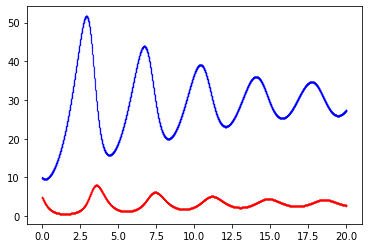

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830546.png


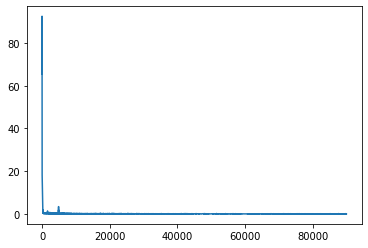

Epoch [91000/100000] Loss:0.026413 Loss_1:0.000055 Loss_2:0.026358 Loss_3: 0.000000 Lr:0.000990 Time:11.512730s (16.66min in total)
Epoch [92000/100000] Loss:0.025614 Loss_1:0.000012 Loss_2:0.025601 Loss_3: 0.000000 Lr:0.000980 Time:10.754122s (16.84min in total)
Epoch [93000/100000] Loss:0.025950 Loss_1:0.000004 Loss_2:0.025946 Loss_3: 0.000000 Lr:0.000971 Time:10.745480s (17.02min in total)
Epoch [94000/100000] Loss:0.026593 Loss_1:0.000107 Loss_2:0.026486 Loss_3: 0.000000 Lr:0.000962 Time:10.764381s (17.20min in total)
Epoch [95000/100000] Loss:0.025904 Loss_1:0.000005 Loss_2:0.025898 Loss_3: 0.000000 Lr:0.000952 Time:10.722046s (17.38min in total)
Epoch [96000/100000] Loss:0.024592 Loss_1:0.000003 Loss_2:0.024588 Loss_3: 0.000000 Lr:0.000943 Time:10.714164s (17.56min in total)
Epoch [97000/100000] Loss:0.035386 Loss_1:0.000063 Loss_2:0.035323 Loss_3: 0.000000 Lr:0.000935 Time:10.758890s (17.74min in total)
Epoch [98000/100000] Loss:0.023781 Loss_1:0.000002 Loss_2:0.023779 Loss_3: 0

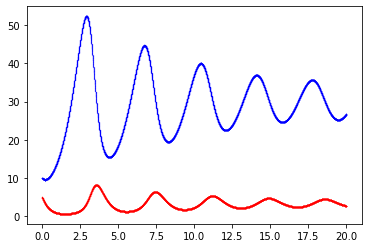

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_1650830655.png


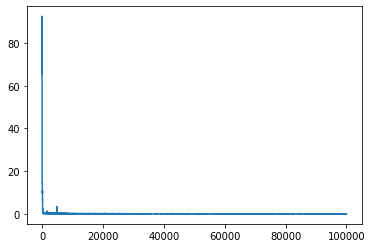

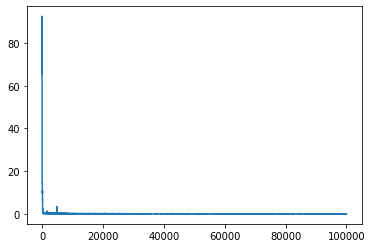


[Training Summary]
num_parameter: -1
best_loss: 0.02378140762448311
time_cost: 18.272228050231934


<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design A - original - Adam - L2 norm - no square
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-24-19-26-13
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:2.032800 Loss_1:0.029491 Loss_2:1.934271 Loss_3: 0.069038 Lr:0.001899 Time:10.679861s (0.18min in total)
Epoch [02000/100000] Loss:2.03

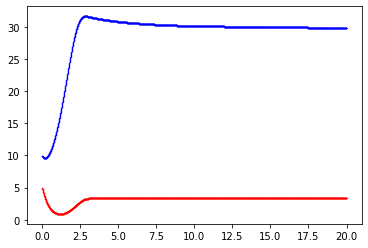

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650828481.png


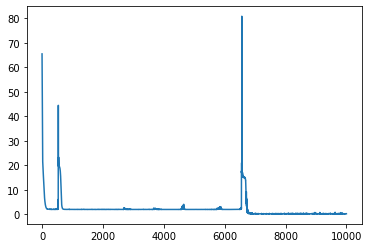

Epoch [11000/100000] Loss:0.281464 Loss_1:0.014789 Loss_2:0.266675 Loss_3: 0.000000 Lr:0.009101 Time:11.417236s (1.99min in total)
Epoch [12000/100000] Loss:0.217644 Loss_1:0.009100 Loss_2:0.208543 Loss_3: 0.000000 Lr:0.008201 Time:10.684335s (2.17min in total)
Epoch [13000/100000] Loss:0.211049 Loss_1:0.000343 Loss_2:0.210706 Loss_3: 0.000000 Lr:0.007301 Time:11.325365s (2.36min in total)
Epoch [14000/100000] Loss:0.143068 Loss_1:0.000416 Loss_2:0.142651 Loss_3: 0.000000 Lr:0.006401 Time:10.674588s (2.54min in total)
Epoch [15000/100000] Loss:0.144134 Loss_1:0.000625 Loss_2:0.143509 Loss_3: 0.000000 Lr:0.005501 Time:10.720661s (2.72min in total)
Epoch [16000/100000] Loss:0.152773 Loss_1:0.004832 Loss_2:0.147942 Loss_3: 0.000000 Lr:0.004601 Time:10.661597s (2.89min in total)
Epoch [17000/100000] Loss:0.143776 Loss_1:0.000002 Loss_2:0.143773 Loss_3: 0.000000 Lr:0.003701 Time:10.661658s (3.07min in total)
Epoch [18000/100000] Loss:0.136153 Loss_1:0.000120 Loss_2:0.136033 Loss_3: 0.000000

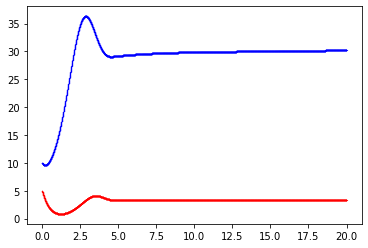

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650828589.png


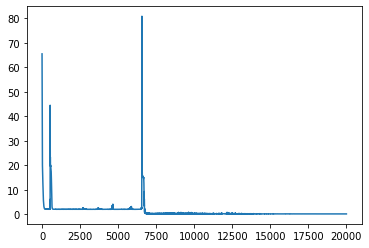

Epoch [21000/100000] Loss:0.139854 Loss_1:0.000005 Loss_2:0.139849 Loss_3: 0.000000 Lr:0.001899 Time:11.426896s (3.80min in total)
Epoch [22000/100000] Loss:0.135517 Loss_1:0.000429 Loss_2:0.135088 Loss_3: 0.000000 Lr:0.002799 Time:10.678685s (3.98min in total)
Epoch [23000/100000] Loss:0.152369 Loss_1:0.000386 Loss_2:0.151983 Loss_3: 0.000000 Lr:0.003699 Time:10.677139s (4.15min in total)
Epoch [24000/100000] Loss:0.186762 Loss_1:0.004455 Loss_2:0.182306 Loss_3: 0.000000 Lr:0.004599 Time:10.714584s (4.33min in total)
Epoch [25000/100000] Loss:0.137334 Loss_1:0.000290 Loss_2:0.137044 Loss_3: 0.000000 Lr:0.005499 Time:10.706190s (4.51min in total)
Epoch [26000/100000] Loss:0.378822 Loss_1:0.000497 Loss_2:0.378325 Loss_3: 0.000000 Lr:0.006399 Time:10.733232s (4.69min in total)
Epoch [27000/100000] Loss:0.163756 Loss_1:0.001341 Loss_2:0.162415 Loss_3: 0.000000 Lr:0.007299 Time:10.692909s (4.87min in total)
Epoch [28000/100000] Loss:0.136523 Loss_1:0.000791 Loss_2:0.135732 Loss_3: 0.000000

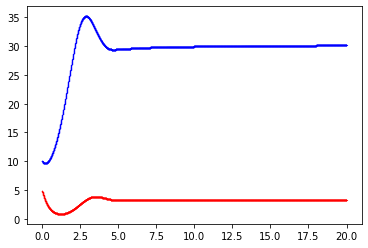

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650828697.png


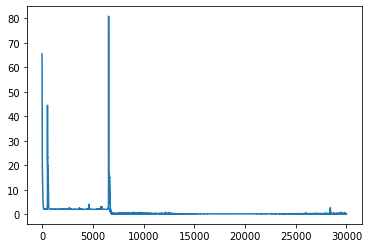

Epoch [31000/100000] Loss:0.310687 Loss_1:0.001142 Loss_2:0.309545 Loss_3: 0.000000 Lr:0.009101 Time:11.465984s (5.59min in total)
Epoch [32000/100000] Loss:0.152659 Loss_1:0.000643 Loss_2:0.152016 Loss_3: 0.000000 Lr:0.008201 Time:10.779503s (5.77min in total)
Epoch [33000/100000] Loss:0.149148 Loss_1:0.000181 Loss_2:0.148967 Loss_3: 0.000000 Lr:0.007301 Time:10.763971s (5.95min in total)
Epoch [34000/100000] Loss:0.164642 Loss_1:0.004061 Loss_2:0.160581 Loss_3: 0.000000 Lr:0.006401 Time:10.782970s (6.13min in total)
Epoch [35000/100000] Loss:0.135186 Loss_1:0.000358 Loss_2:0.134828 Loss_3: 0.000000 Lr:0.005501 Time:10.757020s (6.31min in total)
Epoch [36000/100000] Loss:0.134101 Loss_1:0.000003 Loss_2:0.134099 Loss_3: 0.000000 Lr:0.004601 Time:10.795986s (6.49min in total)
Epoch [37000/100000] Loss:0.133545 Loss_1:0.000191 Loss_2:0.133354 Loss_3: 0.000000 Lr:0.003701 Time:10.782278s (6.67min in total)
Epoch [38000/100000] Loss:0.135443 Loss_1:0.000276 Loss_2:0.135167 Loss_3: 0.000000

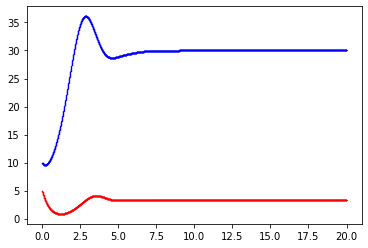

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650828805.png


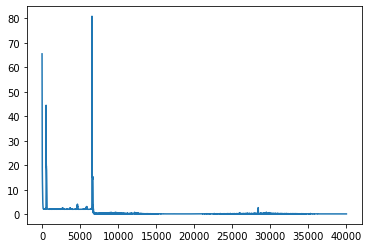

Epoch [41000/100000] Loss:0.114452 Loss_1:0.000072 Loss_2:0.114380 Loss_3: 0.000000 Lr:0.001899 Time:11.450990s (7.40min in total)
Epoch [42000/100000] Loss:0.111407 Loss_1:0.000025 Loss_2:0.111382 Loss_3: 0.000000 Lr:0.002799 Time:10.840958s (7.58min in total)
Epoch [43000/100000] Loss:0.106203 Loss_1:0.000049 Loss_2:0.106154 Loss_3: 0.000000 Lr:0.003699 Time:10.787730s (7.76min in total)
Epoch [44000/100000] Loss:0.113782 Loss_1:0.001763 Loss_2:0.112019 Loss_3: 0.000000 Lr:0.004599 Time:10.803147s (7.94min in total)
Epoch [45000/100000] Loss:0.118953 Loss_1:0.005087 Loss_2:0.113866 Loss_3: 0.000000 Lr:0.005499 Time:10.759359s (8.12min in total)
Epoch [46000/100000] Loss:0.145560 Loss_1:0.001642 Loss_2:0.143918 Loss_3: 0.000000 Lr:0.006399 Time:10.784438s (8.30min in total)
Epoch [47000/100000] Loss:0.119639 Loss_1:0.000065 Loss_2:0.119574 Loss_3: 0.000000 Lr:0.007299 Time:10.779849s (8.48min in total)
Epoch [48000/100000] Loss:0.154067 Loss_1:0.002861 Loss_2:0.151205 Loss_3: 0.000000

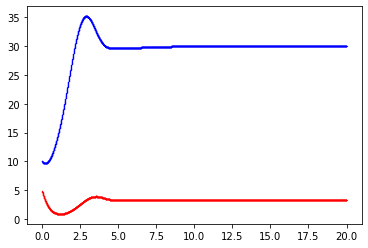

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650828914.png


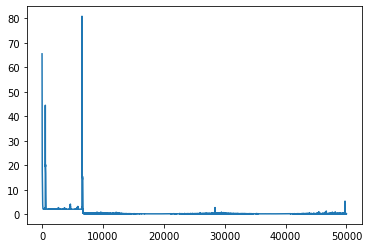

Epoch [51000/100000] Loss:0.340479 Loss_1:0.001433 Loss_2:0.339046 Loss_3: 0.000000 Lr:0.009101 Time:11.455076s (9.21min in total)
Epoch [52000/100000] Loss:0.174674 Loss_1:0.010209 Loss_2:0.164466 Loss_3: 0.000000 Lr:0.008201 Time:10.742659s (9.39min in total)
Epoch [53000/100000] Loss:0.110188 Loss_1:0.000107 Loss_2:0.110081 Loss_3: 0.000000 Lr:0.007301 Time:10.763001s (9.57min in total)
Epoch [54000/100000] Loss:0.108514 Loss_1:0.001275 Loss_2:0.107239 Loss_3: 0.000000 Lr:0.006401 Time:10.748723s (9.75min in total)
Epoch [55000/100000] Loss:0.140586 Loss_1:0.001422 Loss_2:0.139164 Loss_3: 0.000000 Lr:0.005501 Time:10.764022s (9.93min in total)
Epoch [56000/100000] Loss:0.099988 Loss_1:0.000019 Loss_2:0.099968 Loss_3: 0.000000 Lr:0.004601 Time:10.778159s (10.11min in total)
Epoch [57000/100000] Loss:0.102343 Loss_1:0.000302 Loss_2:0.102040 Loss_3: 0.000000 Lr:0.003701 Time:10.749302s (10.29min in total)
Epoch [58000/100000] Loss:0.096637 Loss_1:0.000063 Loss_2:0.096574 Loss_3: 0.0000

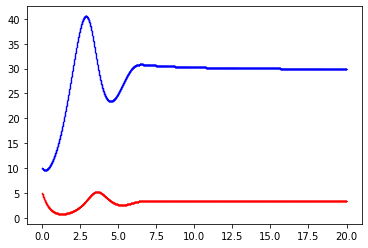

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650829022.png


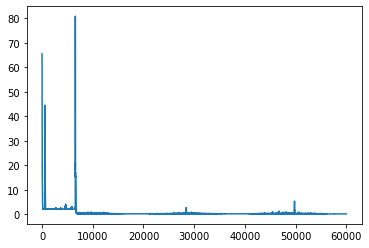

Epoch [61000/100000] Loss:0.104896 Loss_1:0.001250 Loss_2:0.103646 Loss_3: 0.000000 Lr:0.001899 Time:11.499215s (11.02min in total)
Epoch [62000/100000] Loss:0.110568 Loss_1:0.001031 Loss_2:0.109536 Loss_3: 0.000000 Lr:0.002799 Time:10.804977s (11.20min in total)
Epoch [63000/100000] Loss:0.212038 Loss_1:0.001618 Loss_2:0.210420 Loss_3: 0.000000 Lr:0.003699 Time:10.782237s (11.38min in total)
Epoch [64000/100000] Loss:0.114389 Loss_1:0.000027 Loss_2:0.114361 Loss_3: 0.000000 Lr:0.004599 Time:10.775659s (11.56min in total)
Epoch [65000/100000] Loss:0.188294 Loss_1:0.002683 Loss_2:0.185611 Loss_3: 0.000000 Lr:0.005499 Time:10.774063s (11.74min in total)
Epoch [66000/100000] Loss:0.102839 Loss_1:0.000534 Loss_2:0.102305 Loss_3: 0.000000 Lr:0.006399 Time:10.750815s (11.92min in total)
Epoch [67000/100000] Loss:0.122570 Loss_1:0.005433 Loss_2:0.117137 Loss_3: 0.000000 Lr:0.007299 Time:10.763592s (12.10min in total)
Epoch [68000/100000] Loss:0.154260 Loss_1:0.011702 Loss_2:0.142557 Loss_3: 0

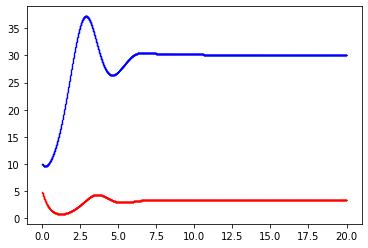

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650829131.png


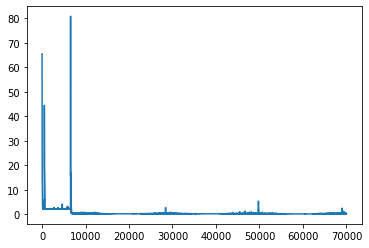

Epoch [71000/100000] Loss:0.182475 Loss_1:0.000506 Loss_2:0.181969 Loss_3: 0.000000 Lr:0.009101 Time:11.532160s (12.83min in total)
Epoch [72000/100000] Loss:0.127670 Loss_1:0.003405 Loss_2:0.124265 Loss_3: 0.000000 Lr:0.008201 Time:10.746892s (13.01min in total)
Epoch [73000/100000] Loss:0.141037 Loss_1:0.001967 Loss_2:0.139070 Loss_3: 0.000000 Lr:0.007301 Time:10.776965s (13.19min in total)
Epoch [74000/100000] Loss:0.102304 Loss_1:0.000281 Loss_2:0.102022 Loss_3: 0.000000 Lr:0.006401 Time:10.764822s (13.36min in total)
Epoch [75000/100000] Loss:0.157506 Loss_1:0.002310 Loss_2:0.155196 Loss_3: 0.000000 Lr:0.005501 Time:10.773763s (13.54min in total)
Epoch [76000/100000] Loss:0.089829 Loss_1:0.000108 Loss_2:0.089720 Loss_3: 0.000000 Lr:0.004601 Time:10.831321s (13.72min in total)
Epoch [77000/100000] Loss:0.083844 Loss_1:0.000021 Loss_2:0.083823 Loss_3: 0.000000 Lr:0.003701 Time:10.815832s (13.90min in total)
Epoch [78000/100000] Loss:0.080707 Loss_1:0.000030 Loss_2:0.080677 Loss_3: 0

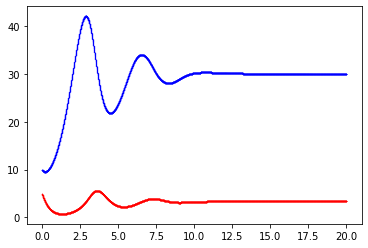

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650829239.png


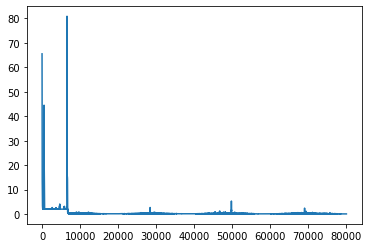

Epoch [81000/100000] Loss:0.071405 Loss_1:0.000052 Loss_2:0.071352 Loss_3: 0.000000 Lr:0.001899 Time:11.563629s (14.64min in total)
Epoch [82000/100000] Loss:0.069579 Loss_1:0.000005 Loss_2:0.069574 Loss_3: 0.000000 Lr:0.002799 Time:10.744608s (14.82min in total)
Epoch [83000/100000] Loss:0.071847 Loss_1:0.000131 Loss_2:0.071716 Loss_3: 0.000000 Lr:0.003699 Time:10.894180s (15.00min in total)
Epoch [84000/100000] Loss:0.111654 Loss_1:0.002316 Loss_2:0.109337 Loss_3: 0.000000 Lr:0.004599 Time:10.788037s (15.18min in total)
Epoch [85000/100000] Loss:0.076672 Loss_1:0.001222 Loss_2:0.075450 Loss_3: 0.000000 Lr:0.005499 Time:10.767288s (15.36min in total)
Epoch [86000/100000] Loss:0.086380 Loss_1:0.000858 Loss_2:0.085522 Loss_3: 0.000000 Lr:0.006399 Time:10.780869s (15.54min in total)
Epoch [87000/100000] Loss:0.101054 Loss_1:0.000188 Loss_2:0.100866 Loss_3: 0.000000 Lr:0.007299 Time:10.771771s (15.72min in total)
Epoch [88000/100000] Loss:0.086944 Loss_1:0.000146 Loss_2:0.086798 Loss_3: 0

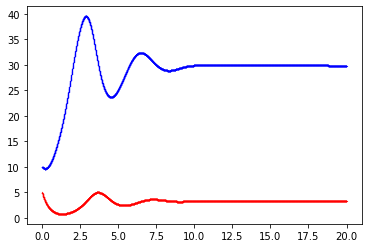

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650829348.png


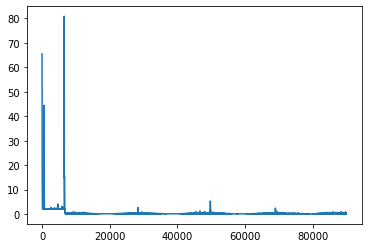

Epoch [91000/100000] Loss:0.091829 Loss_1:0.000141 Loss_2:0.091688 Loss_3: 0.000000 Lr:0.009101 Time:11.513495s (16.45min in total)
Epoch [92000/100000] Loss:0.188359 Loss_1:0.007350 Loss_2:0.181009 Loss_3: 0.000000 Lr:0.008201 Time:10.731231s (16.62min in total)
Epoch [93000/100000] Loss:0.189040 Loss_1:0.000858 Loss_2:0.188182 Loss_3: 0.000000 Lr:0.007301 Time:10.766116s (16.80min in total)
Epoch [94000/100000] Loss:0.218759 Loss_1:0.005353 Loss_2:0.213405 Loss_3: 0.000000 Lr:0.006401 Time:10.729118s (16.98min in total)
Epoch [95000/100000] Loss:0.116260 Loss_1:0.001540 Loss_2:0.114720 Loss_3: 0.000000 Lr:0.005501 Time:12.417645s (17.19min in total)
Epoch [96000/100000] Loss:0.109183 Loss_1:0.000825 Loss_2:0.108358 Loss_3: 0.000000 Lr:0.004601 Time:10.730610s (17.37min in total)
Epoch [97000/100000] Loss:0.105079 Loss_1:0.001778 Loss_2:0.103300 Loss_3: 0.000000 Lr:0.003701 Time:11.379973s (17.56min in total)
Epoch [98000/100000] Loss:0.108115 Loss_1:0.001768 Loss_2:0.106347 Loss_3: 0

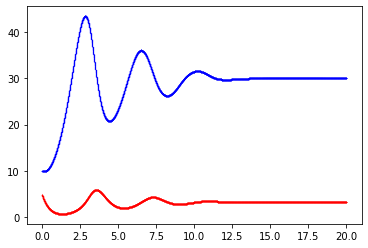

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_1650829458.png


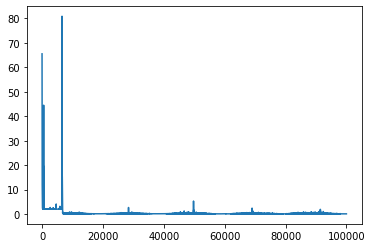

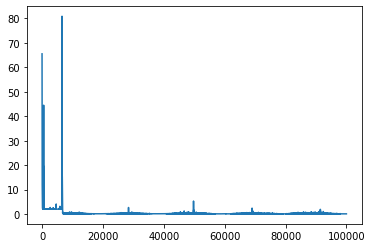


[Training Summary]
num_parameter: -1
best_loss: 0.06957883387804031
time_cost: 18.09433359702428


<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design A - cyclic - Adam - L2 norm - no square
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-22-01-07-17
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:15.108110 Loss_1:0.039361 Loss_2:15.068748 Loss_3: 0.000001 Lr:0.001899 Time:9.105682s (0.15min in total)
Epoch [02000/100000] Loss:5.4

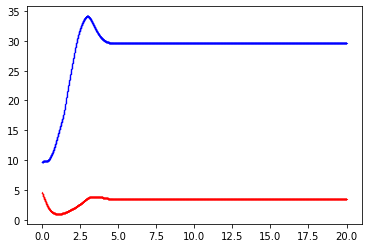

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650589729.png


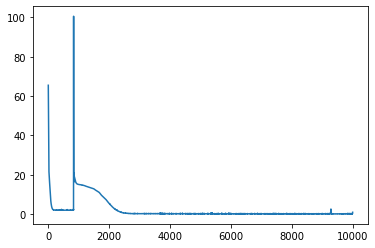

Epoch [11000/100000] Loss:0.156635 Loss_1:0.001595 Loss_2:0.155040 Loss_3: 0.000000 Lr:0.009101 Time:9.685471s (1.68min in total)
Epoch [12000/100000] Loss:0.209967 Loss_1:0.001541 Loss_2:0.208426 Loss_3: 0.000000 Lr:0.008201 Time:9.091610s (1.83min in total)
Epoch [13000/100000] Loss:0.150487 Loss_1:0.000533 Loss_2:0.149954 Loss_3: 0.000000 Lr:0.007301 Time:9.105075s (1.99min in total)
Epoch [14000/100000] Loss:0.133385 Loss_1:0.003963 Loss_2:0.129421 Loss_3: 0.000000 Lr:0.006401 Time:9.109967s (2.14min in total)
Epoch [15000/100000] Loss:0.130857 Loss_1:0.000190 Loss_2:0.130666 Loss_3: 0.000000 Lr:0.005501 Time:9.137249s (2.29min in total)
Epoch [16000/100000] Loss:0.116301 Loss_1:0.001848 Loss_2:0.114452 Loss_3: 0.000000 Lr:0.004601 Time:9.101289s (2.44min in total)
Epoch [17000/100000] Loss:0.100924 Loss_1:0.000029 Loss_2:0.100894 Loss_3: 0.000000 Lr:0.003701 Time:9.111147s (2.59min in total)
Epoch [18000/100000] Loss:0.083873 Loss_1:0.000090 Loss_2:0.083783 Loss_3: 0.000000 Lr:0.0

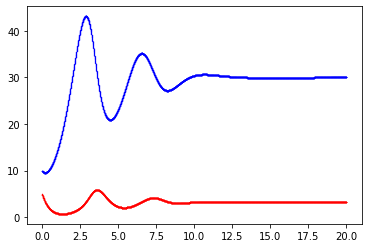

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650589820.png


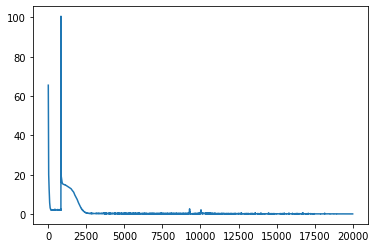

Epoch [21000/100000] Loss:0.064773 Loss_1:0.000013 Loss_2:0.064760 Loss_3: 0.000000 Lr:0.001899 Time:9.804805s (3.21min in total)
Epoch [22000/100000] Loss:0.067609 Loss_1:0.000330 Loss_2:0.067279 Loss_3: 0.000000 Lr:0.002799 Time:9.114292s (3.36min in total)
Epoch [23000/100000] Loss:0.079976 Loss_1:0.000889 Loss_2:0.079087 Loss_3: 0.000000 Lr:0.003699 Time:9.101839s (3.52min in total)
Epoch [24000/100000] Loss:0.092913 Loss_1:0.000927 Loss_2:0.091986 Loss_3: 0.000000 Lr:0.004599 Time:9.110321s (3.67min in total)
Epoch [25000/100000] Loss:0.091705 Loss_1:0.000294 Loss_2:0.091410 Loss_3: 0.000000 Lr:0.005499 Time:9.099871s (3.82min in total)
Epoch [26000/100000] Loss:0.074610 Loss_1:0.000109 Loss_2:0.074502 Loss_3: 0.000000 Lr:0.006399 Time:9.099087s (3.97min in total)
Epoch [27000/100000] Loss:0.138390 Loss_1:0.001785 Loss_2:0.136605 Loss_3: 0.000000 Lr:0.007299 Time:9.094810s (4.12min in total)
Epoch [28000/100000] Loss:0.123520 Loss_1:0.017601 Loss_2:0.105919 Loss_3: 0.000000 Lr:0.0

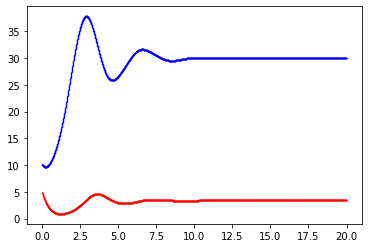

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650589914.png


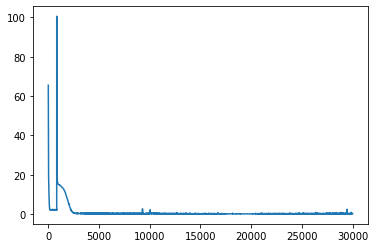

Epoch [31000/100000] Loss:0.095407 Loss_1:0.000393 Loss_2:0.095015 Loss_3: 0.000000 Lr:0.009101 Time:9.749628s (4.77min in total)
Epoch [32000/100000] Loss:0.138322 Loss_1:0.003530 Loss_2:0.134792 Loss_3: 0.000000 Lr:0.008201 Time:9.096061s (4.92min in total)
Epoch [33000/100000] Loss:0.109358 Loss_1:0.001810 Loss_2:0.107548 Loss_3: 0.000000 Lr:0.007301 Time:9.352411s (5.07min in total)
Epoch [34000/100000] Loss:0.079152 Loss_1:0.000694 Loss_2:0.078458 Loss_3: 0.000000 Lr:0.006401 Time:9.586709s (5.23min in total)
Epoch [35000/100000] Loss:0.090249 Loss_1:0.000977 Loss_2:0.089272 Loss_3: 0.000000 Lr:0.005501 Time:9.076783s (5.38min in total)
Epoch [36000/100000] Loss:0.124549 Loss_1:0.002289 Loss_2:0.122260 Loss_3: 0.000000 Lr:0.004601 Time:9.274315s (5.54min in total)
Epoch [37000/100000] Loss:0.067161 Loss_1:0.000038 Loss_2:0.067123 Loss_3: 0.000000 Lr:0.003701 Time:10.255848s (5.71min in total)
Epoch [38000/100000] Loss:0.060600 Loss_1:0.000047 Loss_2:0.060553 Loss_3: 0.000000 Lr:0.

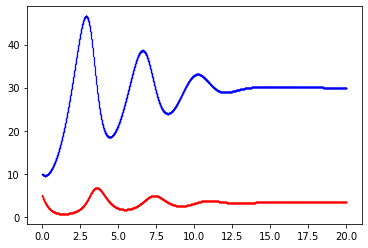

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590010.png


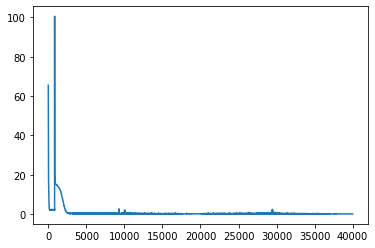

Epoch [41000/100000] Loss:0.060567 Loss_1:0.000240 Loss_2:0.060327 Loss_3: 0.000000 Lr:0.001899 Time:10.724505s (6.39min in total)
Epoch [42000/100000] Loss:0.149019 Loss_1:0.000439 Loss_2:0.148580 Loss_3: 0.000000 Lr:0.002799 Time:9.900572s (6.55min in total)
Epoch [43000/100000] Loss:0.060903 Loss_1:0.000520 Loss_2:0.060383 Loss_3: 0.000000 Lr:0.003699 Time:9.692467s (6.72min in total)
Epoch [44000/100000] Loss:0.087497 Loss_1:0.001623 Loss_2:0.085874 Loss_3: 0.000000 Lr:0.004599 Time:9.076161s (6.87min in total)
Epoch [45000/100000] Loss:0.084822 Loss_1:0.000642 Loss_2:0.084181 Loss_3: 0.000000 Lr:0.005499 Time:9.067529s (7.02min in total)
Epoch [46000/100000] Loss:0.097590 Loss_1:0.007281 Loss_2:0.090309 Loss_3: 0.000000 Lr:0.006399 Time:9.056847s (7.17min in total)
Epoch [47000/100000] Loss:0.080325 Loss_1:0.000330 Loss_2:0.079995 Loss_3: 0.000000 Lr:0.007299 Time:9.062864s (7.32min in total)
Epoch [48000/100000] Loss:0.099280 Loss_1:0.000291 Loss_2:0.098988 Loss_3: 0.000000 Lr:0.

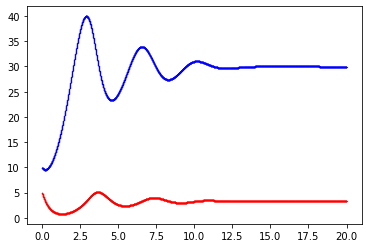

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590104.png


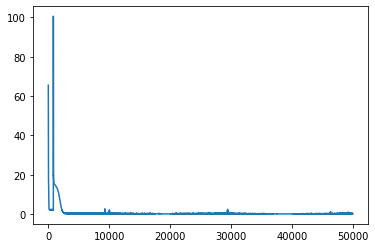

Epoch [51000/100000] Loss:0.084615 Loss_1:0.001859 Loss_2:0.082756 Loss_3: 0.000000 Lr:0.009101 Time:10.213833s (7.95min in total)
Epoch [52000/100000] Loss:0.099161 Loss_1:0.004032 Loss_2:0.095129 Loss_3: 0.000000 Lr:0.008201 Time:9.046128s (8.10min in total)
Epoch [53000/100000] Loss:0.075780 Loss_1:0.000457 Loss_2:0.075324 Loss_3: 0.000000 Lr:0.007301 Time:9.060878s (8.25min in total)
Epoch [54000/100000] Loss:0.070144 Loss_1:0.000382 Loss_2:0.069763 Loss_3: 0.000000 Lr:0.006401 Time:9.039157s (8.40min in total)
Epoch [55000/100000] Loss:0.073780 Loss_1:0.000459 Loss_2:0.073320 Loss_3: 0.000000 Lr:0.005501 Time:9.049654s (8.55min in total)
Epoch [56000/100000] Loss:0.070648 Loss_1:0.000059 Loss_2:0.070589 Loss_3: 0.000000 Lr:0.004601 Time:9.052038s (8.70min in total)
Epoch [57000/100000] Loss:0.060755 Loss_1:0.000290 Loss_2:0.060466 Loss_3: 0.000000 Lr:0.003701 Time:9.045833s (8.85min in total)
Epoch [58000/100000] Loss:0.055451 Loss_1:0.000007 Loss_2:0.055443 Loss_3: 0.000000 Lr:0.

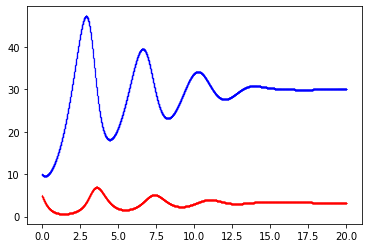

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590196.png


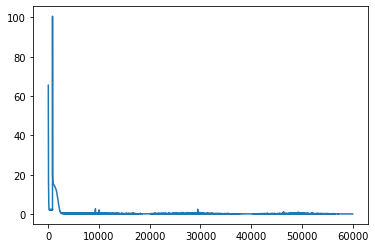

Epoch [61000/100000] Loss:0.047647 Loss_1:0.000002 Loss_2:0.047644 Loss_3: 0.000000 Lr:0.001899 Time:9.822425s (9.47min in total)
Epoch [62000/100000] Loss:0.056028 Loss_1:0.000098 Loss_2:0.055930 Loss_3: 0.000000 Lr:0.002799 Time:9.074341s (9.62min in total)
Epoch [63000/100000] Loss:0.073212 Loss_1:0.000362 Loss_2:0.072850 Loss_3: 0.000000 Lr:0.003699 Time:9.064574s (9.77min in total)
Epoch [64000/100000] Loss:0.056668 Loss_1:0.000656 Loss_2:0.056011 Loss_3: 0.000000 Lr:0.004599 Time:9.046711s (9.92min in total)
Epoch [65000/100000] Loss:0.059864 Loss_1:0.000085 Loss_2:0.059778 Loss_3: 0.000000 Lr:0.005499 Time:9.082860s (10.07min in total)
Epoch [66000/100000] Loss:0.181578 Loss_1:0.005706 Loss_2:0.175872 Loss_3: 0.000000 Lr:0.006399 Time:9.070634s (10.22min in total)
Epoch [67000/100000] Loss:0.111664 Loss_1:0.000423 Loss_2:0.111241 Loss_3: 0.000000 Lr:0.007299 Time:9.075952s (10.37min in total)
Epoch [68000/100000] Loss:0.108352 Loss_1:0.001231 Loss_2:0.107121 Loss_3: 0.000000 Lr:

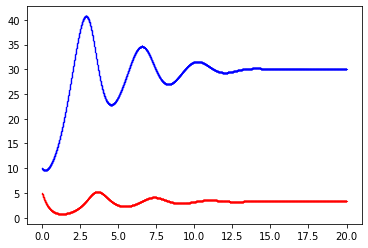

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590287.png


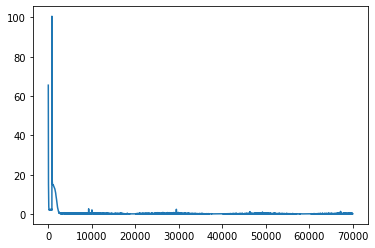

Epoch [71000/100000] Loss:0.081340 Loss_1:0.001683 Loss_2:0.079657 Loss_3: 0.000000 Lr:0.009101 Time:9.779321s (10.99min in total)
Epoch [72000/100000] Loss:0.100952 Loss_1:0.003323 Loss_2:0.097630 Loss_3: 0.000000 Lr:0.008201 Time:9.041904s (11.14min in total)
Epoch [73000/100000] Loss:0.177901 Loss_1:0.001000 Loss_2:0.176901 Loss_3: 0.000000 Lr:0.007301 Time:9.044202s (11.29min in total)
Epoch [74000/100000] Loss:0.071658 Loss_1:0.000687 Loss_2:0.070971 Loss_3: 0.000000 Lr:0.006401 Time:9.027043s (11.44min in total)
Epoch [75000/100000] Loss:0.060410 Loss_1:0.000042 Loss_2:0.060368 Loss_3: 0.000000 Lr:0.005501 Time:9.046580s (11.59min in total)
Epoch [76000/100000] Loss:0.060958 Loss_1:0.000007 Loss_2:0.060951 Loss_3: 0.000000 Lr:0.004601 Time:9.048394s (11.74min in total)
Epoch [77000/100000] Loss:0.057826 Loss_1:0.000359 Loss_2:0.057468 Loss_3: 0.000000 Lr:0.003701 Time:9.026623s (11.89min in total)
Epoch [78000/100000] Loss:0.051648 Loss_1:0.000372 Loss_2:0.051277 Loss_3: 0.000000

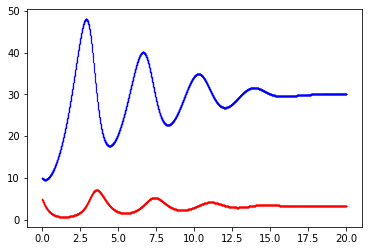

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590378.png


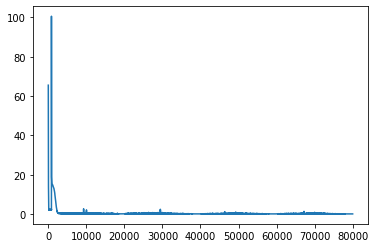

Epoch [81000/100000] Loss:0.060824 Loss_1:0.000788 Loss_2:0.060035 Loss_3: 0.000000 Lr:0.001899 Time:9.780992s (12.51min in total)
Epoch [82000/100000] Loss:0.045001 Loss_1:0.000095 Loss_2:0.044906 Loss_3: 0.000000 Lr:0.002799 Time:9.087607s (12.66min in total)
Epoch [83000/100000] Loss:0.052151 Loss_1:0.000248 Loss_2:0.051903 Loss_3: 0.000000 Lr:0.003699 Time:9.058950s (12.81min in total)
Epoch [84000/100000] Loss:0.059782 Loss_1:0.000772 Loss_2:0.059010 Loss_3: 0.000000 Lr:0.004599 Time:9.046987s (12.96min in total)
Epoch [85000/100000] Loss:0.060811 Loss_1:0.000509 Loss_2:0.060302 Loss_3: 0.000000 Lr:0.005499 Time:9.037171s (13.11min in total)
Epoch [86000/100000] Loss:0.143073 Loss_1:0.000370 Loss_2:0.142703 Loss_3: 0.000000 Lr:0.006399 Time:9.061313s (13.26min in total)
Epoch [87000/100000] Loss:0.076561 Loss_1:0.000321 Loss_2:0.076240 Loss_3: 0.000000 Lr:0.007299 Time:9.051926s (13.42min in total)
Epoch [88000/100000] Loss:0.062415 Loss_1:0.000121 Loss_2:0.062295 Loss_3: 0.000000

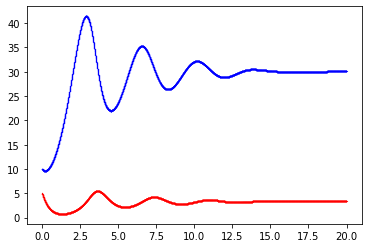

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590470.png


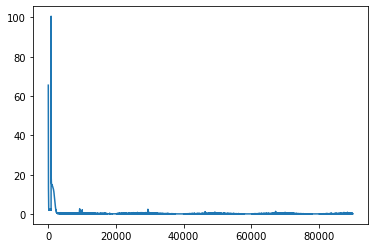

Epoch [91000/100000] Loss:0.093470 Loss_1:0.007390 Loss_2:0.086079 Loss_3: 0.000000 Lr:0.009101 Time:9.848106s (14.03min in total)
Epoch [92000/100000] Loss:0.088438 Loss_1:0.000050 Loss_2:0.088388 Loss_3: 0.000000 Lr:0.008201 Time:9.030455s (14.18min in total)
Epoch [93000/100000] Loss:0.064970 Loss_1:0.000327 Loss_2:0.064643 Loss_3: 0.000000 Lr:0.007301 Time:9.022512s (14.33min in total)
Epoch [94000/100000] Loss:0.058597 Loss_1:0.000058 Loss_2:0.058538 Loss_3: 0.000000 Lr:0.006401 Time:9.022186s (14.48min in total)
Epoch [95000/100000] Loss:0.063264 Loss_1:0.001154 Loss_2:0.062111 Loss_3: 0.000000 Lr:0.005501 Time:9.032260s (14.63min in total)
Epoch [96000/100000] Loss:0.065609 Loss_1:0.000699 Loss_2:0.064910 Loss_3: 0.000000 Lr:0.004601 Time:9.053029s (14.79min in total)
Epoch [97000/100000] Loss:0.051094 Loss_1:0.000173 Loss_2:0.050922 Loss_3: 0.000000 Lr:0.003701 Time:9.015158s (14.94min in total)
Epoch [98000/100000] Loss:0.048260 Loss_1:0.000036 Loss_2:0.048223 Loss_3: 0.000000

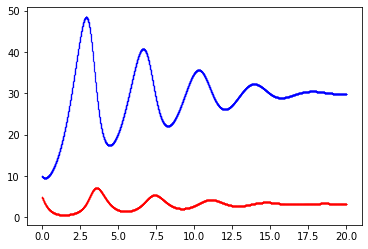

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_1650590561.png


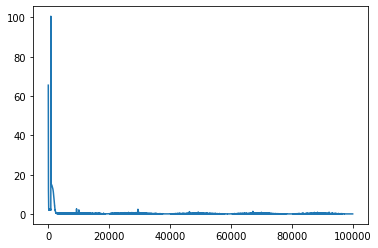

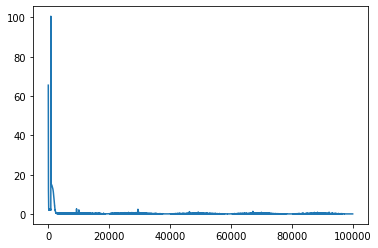


[Training Summary]
num_parameter: -1
best_loss: 0.04115523025393486
time_cost: 15.387340974807739


<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design A - cyclic - Adam
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-22-00-38-13
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:0.220596 Loss_1:0.001257 Loss_2:0.219339 Loss_3: 0.000000 Lr:0.009091 Time:9.067259s (0.15min in total)
Epoch [02000/100000] Loss:0.322

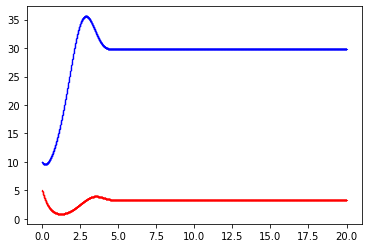

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650587985.png


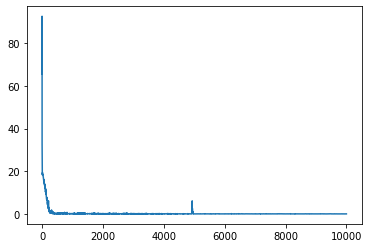

Epoch [11000/100000] Loss:0.160154 Loss_1:0.005582 Loss_2:0.154572 Loss_3: 0.000000 Lr:0.004762 Time:9.671555s (1.69min in total)
Epoch [12000/100000] Loss:0.173131 Loss_1:0.004693 Loss_2:0.168439 Loss_3: 0.000000 Lr:0.004545 Time:9.123409s (1.84min in total)
Epoch [13000/100000] Loss:0.148211 Loss_1:0.003312 Loss_2:0.144899 Loss_3: 0.000000 Lr:0.004348 Time:10.366973s (2.01min in total)
Epoch [14000/100000] Loss:0.108093 Loss_1:0.001486 Loss_2:0.106607 Loss_3: 0.000000 Lr:0.004167 Time:9.096850s (2.16min in total)
Epoch [15000/100000] Loss:0.129432 Loss_1:0.000707 Loss_2:0.128724 Loss_3: 0.000000 Lr:0.004000 Time:9.126422s (2.32min in total)
Epoch [16000/100000] Loss:0.117324 Loss_1:0.004406 Loss_2:0.112919 Loss_3: 0.000000 Lr:0.003846 Time:9.121150s (2.47min in total)
Epoch [17000/100000] Loss:0.108035 Loss_1:0.005075 Loss_2:0.102960 Loss_3: 0.000000 Lr:0.003704 Time:9.100910s (2.62min in total)
Epoch [18000/100000] Loss:0.079417 Loss_1:0.001112 Loss_2:0.078305 Loss_3: 0.000000 Lr:0.

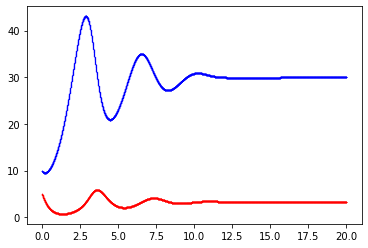

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588078.png


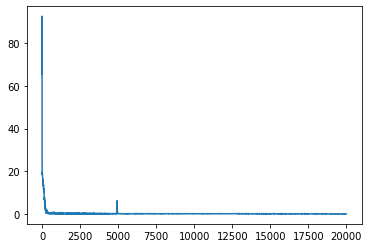

Epoch [21000/100000] Loss:0.065698 Loss_1:0.000866 Loss_2:0.064831 Loss_3: 0.000000 Lr:0.003226 Time:9.800238s (3.24min in total)
Epoch [22000/100000] Loss:0.111725 Loss_1:0.002775 Loss_2:0.108951 Loss_3: 0.000000 Lr:0.003125 Time:9.106930s (3.39min in total)
Epoch [23000/100000] Loss:0.070835 Loss_1:0.000222 Loss_2:0.070613 Loss_3: 0.000000 Lr:0.003030 Time:9.113290s (3.54min in total)
Epoch [24000/100000] Loss:0.061595 Loss_1:0.000045 Loss_2:0.061550 Loss_3: 0.000000 Lr:0.002941 Time:9.101893s (3.69min in total)
Epoch [25000/100000] Loss:0.058126 Loss_1:0.000003 Loss_2:0.058123 Loss_3: 0.000000 Lr:0.002857 Time:9.104064s (3.85min in total)
Epoch [26000/100000] Loss:0.062951 Loss_1:0.000573 Loss_2:0.062378 Loss_3: 0.000000 Lr:0.002778 Time:9.122637s (4.00min in total)
Epoch [27000/100000] Loss:0.056473 Loss_1:0.000136 Loss_2:0.056337 Loss_3: 0.000000 Lr:0.002703 Time:9.084438s (4.15min in total)
Epoch [28000/100000] Loss:0.053630 Loss_1:0.000020 Loss_2:0.053611 Loss_3: 0.000000 Lr:0.0

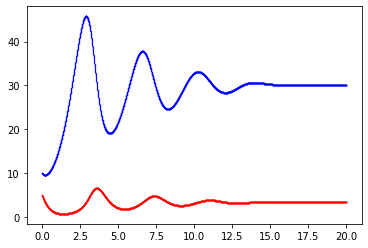

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588170.png


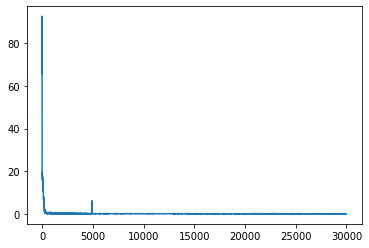

Epoch [31000/100000] Loss:0.066778 Loss_1:0.000073 Loss_2:0.066705 Loss_3: 0.000000 Lr:0.002439 Time:9.777157s (4.77min in total)
Epoch [32000/100000] Loss:0.051971 Loss_1:0.000017 Loss_2:0.051955 Loss_3: 0.000000 Lr:0.002381 Time:9.110078s (4.92min in total)
Epoch [33000/100000] Loss:0.058105 Loss_1:0.000529 Loss_2:0.057576 Loss_3: 0.000000 Lr:0.002326 Time:9.121824s (5.07min in total)
Epoch [34000/100000] Loss:0.056769 Loss_1:0.000158 Loss_2:0.056611 Loss_3: 0.000000 Lr:0.002273 Time:9.112106s (5.22min in total)
Epoch [35000/100000] Loss:0.061418 Loss_1:0.000286 Loss_2:0.061132 Loss_3: 0.000000 Lr:0.002222 Time:9.109356s (5.38min in total)
Epoch [36000/100000] Loss:0.047488 Loss_1:0.000007 Loss_2:0.047481 Loss_3: 0.000000 Lr:0.002174 Time:9.095055s (5.53min in total)
Epoch [37000/100000] Loss:0.068080 Loss_1:0.001225 Loss_2:0.066855 Loss_3: 0.000000 Lr:0.002128 Time:9.107469s (5.68min in total)
Epoch [38000/100000] Loss:0.046554 Loss_1:0.000013 Loss_2:0.046542 Loss_3: 0.000000 Lr:0.0

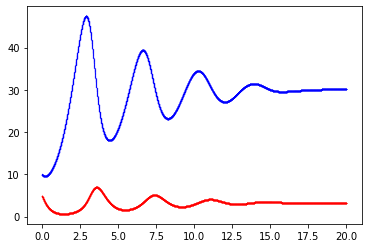

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588262.png


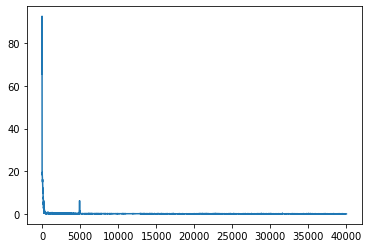

Epoch [41000/100000] Loss:0.046007 Loss_1:0.000004 Loss_2:0.046003 Loss_3: 0.000000 Lr:0.001961 Time:9.804999s (6.30min in total)
Epoch [42000/100000] Loss:0.107799 Loss_1:0.000762 Loss_2:0.107037 Loss_3: 0.000000 Lr:0.001923 Time:9.136735s (6.45min in total)
Epoch [43000/100000] Loss:0.144059 Loss_1:0.000270 Loss_2:0.143789 Loss_3: 0.000000 Lr:0.001887 Time:9.176966s (6.60min in total)
Epoch [44000/100000] Loss:0.050399 Loss_1:0.000073 Loss_2:0.050326 Loss_3: 0.000000 Lr:0.001852 Time:9.095539s (6.76min in total)
Epoch [45000/100000] Loss:0.043510 Loss_1:0.000007 Loss_2:0.043503 Loss_3: 0.000000 Lr:0.001818 Time:9.100306s (6.91min in total)
Epoch [46000/100000] Loss:0.042624 Loss_1:0.000005 Loss_2:0.042619 Loss_3: 0.000000 Lr:0.001786 Time:9.116831s (7.06min in total)
Epoch [47000/100000] Loss:0.042526 Loss_1:0.000021 Loss_2:0.042505 Loss_3: 0.000000 Lr:0.001754 Time:9.111280s (7.21min in total)
Epoch [48000/100000] Loss:0.043290 Loss_1:0.000000 Loss_2:0.043290 Loss_3: 0.000000 Lr:0.0

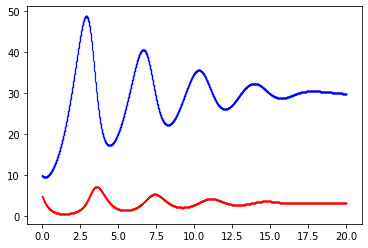

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588353.png


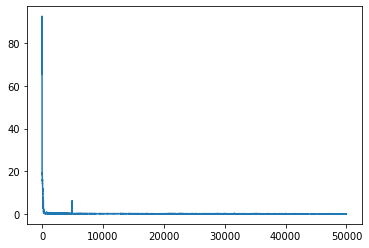

Epoch [51000/100000] Loss:0.040598 Loss_1:0.000004 Loss_2:0.040594 Loss_3: 0.000000 Lr:0.001639 Time:9.825943s (7.83min in total)
Epoch [52000/100000] Loss:0.040313 Loss_1:0.000009 Loss_2:0.040304 Loss_3: 0.000000 Lr:0.001613 Time:9.103752s (7.98min in total)
Epoch [53000/100000] Loss:0.045552 Loss_1:0.000193 Loss_2:0.045359 Loss_3: 0.000000 Lr:0.001587 Time:9.103495s (8.13min in total)
Epoch [54000/100000] Loss:0.039704 Loss_1:0.000007 Loss_2:0.039696 Loss_3: 0.000000 Lr:0.001563 Time:9.105839s (8.28min in total)
Epoch [55000/100000] Loss:0.043429 Loss_1:0.000141 Loss_2:0.043288 Loss_3: 0.000000 Lr:0.001538 Time:9.151094s (8.44min in total)
Epoch [56000/100000] Loss:0.041240 Loss_1:0.000103 Loss_2:0.041137 Loss_3: 0.000000 Lr:0.001515 Time:9.093132s (8.59min in total)
Epoch [57000/100000] Loss:0.039055 Loss_1:0.000004 Loss_2:0.039051 Loss_3: 0.000000 Lr:0.001493 Time:9.115808s (8.74min in total)
Epoch [58000/100000] Loss:0.039010 Loss_1:0.000014 Loss_2:0.038996 Loss_3: 0.000000 Lr:0.0

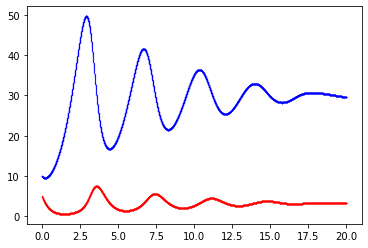

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588445.png


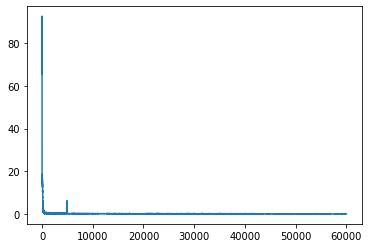

Epoch [61000/100000] Loss:0.039704 Loss_1:0.000074 Loss_2:0.039629 Loss_3: 0.000000 Lr:0.001408 Time:9.840966s (9.36min in total)
Epoch [62000/100000] Loss:0.104943 Loss_1:0.002394 Loss_2:0.102549 Loss_3: 0.000000 Lr:0.001389 Time:9.104100s (9.51min in total)
Epoch [63000/100000] Loss:0.055656 Loss_1:0.000581 Loss_2:0.055075 Loss_3: 0.000000 Lr:0.001370 Time:9.155322s (9.67min in total)
Epoch [64000/100000] Loss:0.037779 Loss_1:0.000004 Loss_2:0.037775 Loss_3: 0.000000 Lr:0.001351 Time:9.094105s (9.82min in total)
Epoch [65000/100000] Loss:0.039082 Loss_1:0.000097 Loss_2:0.038985 Loss_3: 0.000000 Lr:0.001333 Time:9.122003s (9.97min in total)
Epoch [66000/100000] Loss:0.037618 Loss_1:0.000003 Loss_2:0.037615 Loss_3: 0.000000 Lr:0.001316 Time:9.114251s (10.12min in total)
Epoch [67000/100000] Loss:0.082155 Loss_1:0.001083 Loss_2:0.081072 Loss_3: 0.000000 Lr:0.001299 Time:9.124797s (10.27min in total)
Epoch [68000/100000] Loss:0.077098 Loss_1:0.000727 Loss_2:0.076370 Loss_3: 0.000000 Lr:0

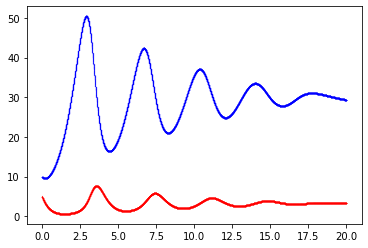

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588537.png


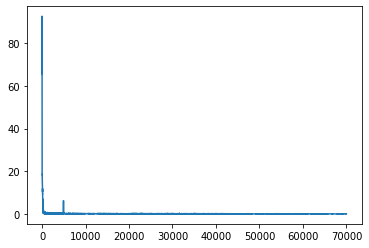

Epoch [71000/100000] Loss:0.037348 Loss_1:0.000007 Loss_2:0.037341 Loss_3: 0.000000 Lr:0.001235 Time:9.845296s (10.89min in total)
Epoch [72000/100000] Loss:0.036290 Loss_1:0.000006 Loss_2:0.036284 Loss_3: 0.000000 Lr:0.001220 Time:9.091848s (11.04min in total)
Epoch [73000/100000] Loss:0.065729 Loss_1:0.000051 Loss_2:0.065677 Loss_3: 0.000000 Lr:0.001205 Time:9.103261s (11.20min in total)
Epoch [74000/100000] Loss:0.044558 Loss_1:0.000286 Loss_2:0.044272 Loss_3: 0.000000 Lr:0.001190 Time:9.118859s (11.35min in total)
Epoch [75000/100000] Loss:0.036047 Loss_1:0.000030 Loss_2:0.036017 Loss_3: 0.000000 Lr:0.001176 Time:9.148532s (11.50min in total)
Epoch [76000/100000] Loss:0.035810 Loss_1:0.000235 Loss_2:0.035575 Loss_3: 0.000000 Lr:0.001163 Time:9.105599s (11.65min in total)
Epoch [77000/100000] Loss:0.037269 Loss_1:0.000003 Loss_2:0.037266 Loss_3: 0.000000 Lr:0.001149 Time:9.113911s (11.80min in total)
Epoch [78000/100000] Loss:0.047535 Loss_1:0.000883 Loss_2:0.046651 Loss_3: 0.000000

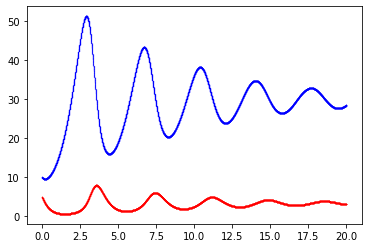

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588629.png


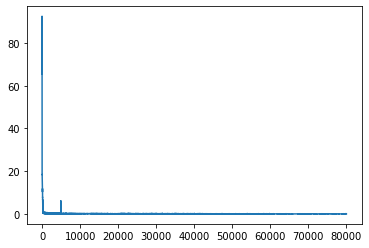

Epoch [81000/100000] Loss:0.029823 Loss_1:0.000003 Loss_2:0.029820 Loss_3: 0.000000 Lr:0.001099 Time:9.904979s (12.42min in total)
Epoch [82000/100000] Loss:0.029164 Loss_1:0.000003 Loss_2:0.029161 Loss_3: 0.000000 Lr:0.001087 Time:9.099472s (12.58min in total)
Epoch [83000/100000] Loss:0.028835 Loss_1:0.000002 Loss_2:0.028833 Loss_3: 0.000000 Lr:0.001075 Time:9.094768s (12.73min in total)
Epoch [84000/100000] Loss:0.027967 Loss_1:0.000003 Loss_2:0.027964 Loss_3: 0.000000 Lr:0.001064 Time:9.167712s (12.88min in total)
Epoch [85000/100000] Loss:0.027931 Loss_1:0.000001 Loss_2:0.027930 Loss_3: 0.000000 Lr:0.001053 Time:9.125430s (13.03min in total)
Epoch [86000/100000] Loss:0.074404 Loss_1:0.000183 Loss_2:0.074220 Loss_3: 0.000000 Lr:0.001042 Time:9.133227s (13.19min in total)
Epoch [87000/100000] Loss:0.027501 Loss_1:0.000001 Loss_2:0.027500 Loss_3: 0.000000 Lr:0.001031 Time:9.123241s (13.34min in total)
Epoch [88000/100000] Loss:0.025920 Loss_1:0.000006 Loss_2:0.025913 Loss_3: 0.000000

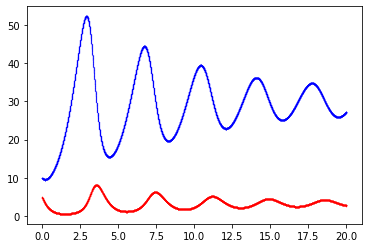

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588721.png


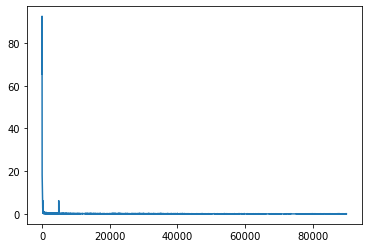

Epoch [91000/100000] Loss:0.024417 Loss_1:0.000002 Loss_2:0.024415 Loss_3: 0.000000 Lr:0.000990 Time:9.872570s (13.96min in total)
Epoch [92000/100000] Loss:0.024104 Loss_1:0.000005 Loss_2:0.024099 Loss_3: 0.000000 Lr:0.000980 Time:9.164164s (14.11min in total)
Epoch [93000/100000] Loss:0.135468 Loss_1:0.000187 Loss_2:0.135281 Loss_3: 0.000000 Lr:0.000971 Time:9.125005s (14.26min in total)
Epoch [94000/100000] Loss:0.023454 Loss_1:0.000007 Loss_2:0.023447 Loss_3: 0.000000 Lr:0.000962 Time:9.118231s (14.42min in total)
Epoch [95000/100000] Loss:0.086158 Loss_1:0.000291 Loss_2:0.085867 Loss_3: 0.000000 Lr:0.000952 Time:9.145087s (14.57min in total)
Epoch [96000/100000] Loss:0.022396 Loss_1:0.000003 Loss_2:0.022393 Loss_3: 0.000000 Lr:0.000943 Time:9.106197s (14.72min in total)
Epoch [97000/100000] Loss:0.026705 Loss_1:0.000125 Loss_2:0.026580 Loss_3: 0.000000 Lr:0.000935 Time:9.129137s (14.87min in total)
Epoch [98000/100000] Loss:0.037031 Loss_1:0.000022 Loss_2:0.037009 Loss_3: 0.000000

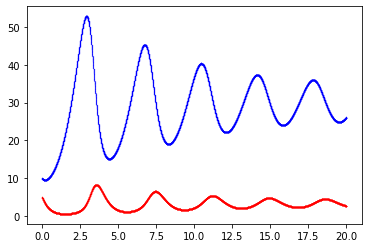

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_1650588813.png


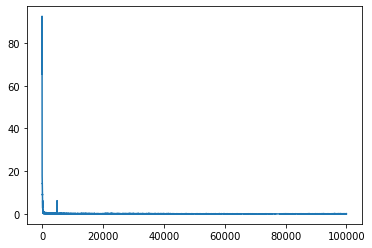

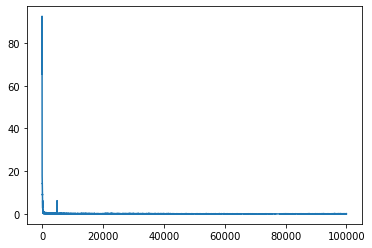


[Training Summary]
num_parameter: -1
best_loss: 0.021337801590561867
time_cost: 15.327450315157572


<Figure size 432x288 with 0 Axes>

In [ ]:
# saved: design A - original - Adam
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-03-30-15-40-48
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}
Epoch [01000/100000] Loss:17.655598 Loss_1:12.779760 Loss_2:4.480127 Loss_3: 0.395709 Lr:0.009091 Time:7.263627s (0.12min in total)
Epoch [02000/100000] Loss:17.

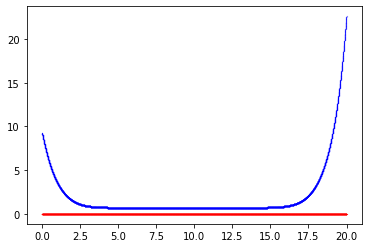

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648654917.png


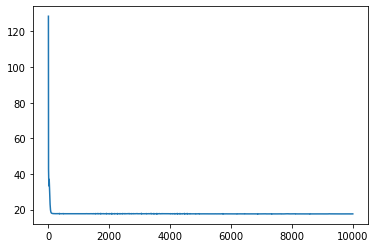

Epoch [11000/100000] Loss:17.540241 Loss_1:12.955536 Loss_2:4.228876 Loss_3: 0.355829 Lr:0.004762 Time:7.496655s (1.27min in total)
Epoch [12000/100000] Loss:17.540089 Loss_1:12.993961 Loss_2:4.194094 Loss_3: 0.352034 Lr:0.004545 Time:7.290060s (1.39min in total)
Epoch [13000/100000] Loss:17.546535 Loss_1:12.967595 Loss_2:4.221474 Loss_3: 0.357467 Lr:0.004348 Time:6.884099s (1.51min in total)
Epoch [14000/100000] Loss:17.545753 Loss_1:12.898437 Loss_2:4.296947 Loss_3: 0.350369 Lr:0.004167 Time:6.876582s (1.62min in total)
Epoch [15000/100000] Loss:17.536371 Loss_1:12.861966 Loss_2:4.335043 Loss_3: 0.339361 Lr:0.004000 Time:6.867102s (1.74min in total)
Epoch [16000/100000] Loss:17.560102 Loss_1:12.949822 Loss_2:4.244782 Loss_3: 0.365498 Lr:0.003846 Time:6.866038s (1.85min in total)
Epoch [17000/100000] Loss:17.542953 Loss_1:12.899865 Loss_2:4.296634 Loss_3: 0.346454 Lr:0.003704 Time:6.848669s (1.97min in total)
Epoch [18000/100000] Loss:17.582220 Loss_1:13.144226 Loss_2:4.069483 Loss_3:

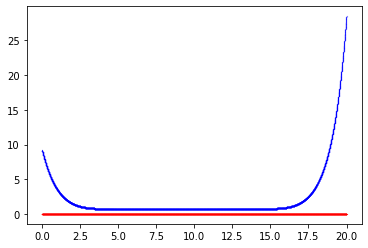

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648654987.png


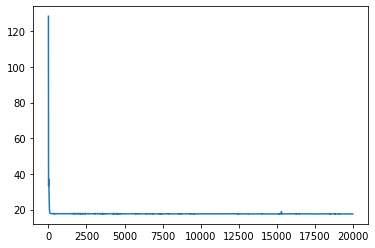

Epoch [21000/100000] Loss:17.526188 Loss_1:12.907730 Loss_2:4.278484 Loss_3: 0.339974 Lr:0.003226 Time:7.605198s (2.44min in total)
Epoch [22000/100000] Loss:17.523291 Loss_1:12.917255 Loss_2:4.267509 Loss_3: 0.338526 Lr:0.003125 Time:6.869061s (2.55min in total)
Epoch [23000/100000] Loss:17.524134 Loss_1:12.962294 Loss_2:4.219318 Loss_3: 0.342523 Lr:0.003030 Time:6.894659s (2.67min in total)
Epoch [24000/100000] Loss:17.522310 Loss_1:12.842485 Loss_2:4.349547 Loss_3: 0.330278 Lr:0.002941 Time:6.915985s (2.78min in total)
Epoch [25000/100000] Loss:17.520872 Loss_1:12.880871 Loss_2:4.307304 Loss_3: 0.332697 Lr:0.002857 Time:6.822362s (2.89min in total)
Epoch [26000/100000] Loss:17.526392 Loss_1:12.901913 Loss_2:4.294065 Loss_3: 0.330413 Lr:0.002778 Time:6.840005s (3.01min in total)
Epoch [27000/100000] Loss:17.518888 Loss_1:12.934633 Loss_2:4.247201 Loss_3: 0.337053 Lr:0.002703 Time:6.878396s (3.12min in total)
Epoch [28000/100000] Loss:17.521839 Loss_1:12.916300 Loss_2:4.268095 Loss_3:

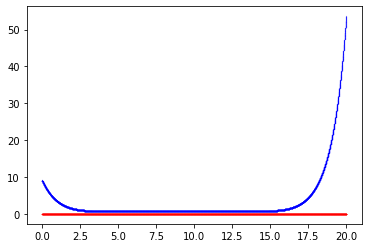

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655056.png


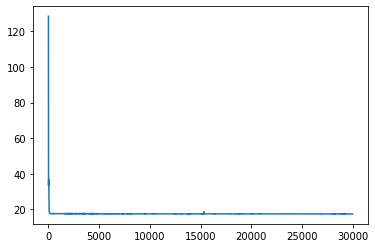

Epoch [31000/100000] Loss:17.511986 Loss_1:12.911549 Loss_2:4.268825 Loss_3: 0.331612 Lr:0.002439 Time:7.623886s (3.59min in total)
Epoch [32000/100000] Loss:17.512985 Loss_1:12.866418 Loss_2:4.321884 Loss_3: 0.324685 Lr:0.002381 Time:6.862521s (3.71min in total)
Epoch [33000/100000] Loss:17.508141 Loss_1:12.914274 Loss_2:4.265337 Loss_3: 0.328530 Lr:0.002326 Time:6.830456s (3.82min in total)
Epoch [34000/100000] Loss:17.512110 Loss_1:12.852113 Loss_2:4.336205 Loss_3: 0.323791 Lr:0.002273 Time:6.841274s (3.94min in total)
Epoch [35000/100000] Loss:17.505867 Loss_1:12.894386 Loss_2:4.286759 Loss_3: 0.324723 Lr:0.002222 Time:6.838372s (4.05min in total)
Epoch [36000/100000] Loss:17.505756 Loss_1:12.923776 Loss_2:4.255988 Loss_3: 0.325993 Lr:0.002174 Time:6.877091s (4.17min in total)
Epoch [37000/100000] Loss:17.501865 Loss_1:12.917035 Loss_2:4.261275 Loss_3: 0.323556 Lr:0.002128 Time:6.925303s (4.28min in total)
Epoch [38000/100000] Loss:17.500530 Loss_1:12.906673 Loss_2:4.270806 Loss_3:

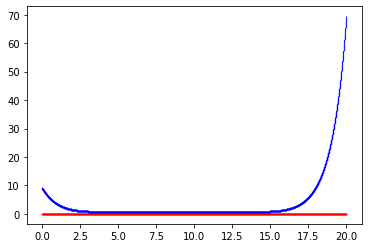

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655126.png


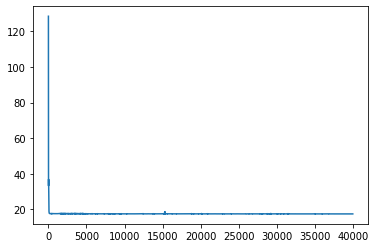

Epoch [41000/100000] Loss:17.502556 Loss_1:12.914441 Loss_2:4.263405 Loss_3: 0.324710 Lr:0.001961 Time:7.593451s (4.75min in total)
Epoch [42000/100000] Loss:17.499119 Loss_1:12.898540 Loss_2:4.280190 Loss_3: 0.320388 Lr:0.001923 Time:6.936670s (4.87min in total)
Epoch [43000/100000] Loss:17.499748 Loss_1:12.921863 Loss_2:4.254891 Loss_3: 0.322994 Lr:0.001887 Time:6.901010s (4.98min in total)
Epoch [44000/100000] Loss:17.500557 Loss_1:12.961291 Loss_2:4.214235 Loss_3: 0.325031 Lr:0.001852 Time:6.891848s (5.10min in total)
Epoch [45000/100000] Loss:17.496483 Loss_1:12.923131 Loss_2:4.252687 Loss_3: 0.320664 Lr:0.001818 Time:6.893824s (5.21min in total)
Epoch [46000/100000] Loss:17.497232 Loss_1:12.902085 Loss_2:4.275395 Loss_3: 0.319753 Lr:0.001786 Time:6.885040s (5.33min in total)
Epoch [47000/100000] Loss:17.498461 Loss_1:12.946623 Loss_2:4.229655 Loss_3: 0.322183 Lr:0.001754 Time:6.849231s (5.44min in total)
Epoch [48000/100000] Loss:17.495796 Loss_1:12.903470 Loss_2:4.273552 Loss_3:

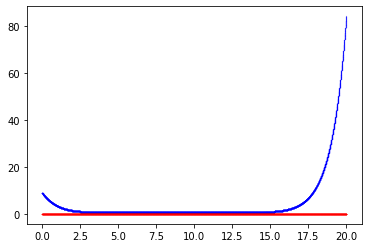

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655195.png


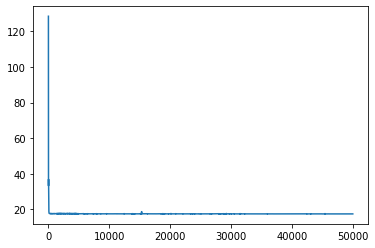

Epoch [51000/100000] Loss:17.495890 Loss_1:12.918125 Loss_2:4.256359 Loss_3: 0.321405 Lr:0.001639 Time:7.563462s (5.91min in total)
Epoch [52000/100000] Loss:17.494410 Loss_1:12.936608 Loss_2:4.237296 Loss_3: 0.320505 Lr:0.001613 Time:6.911273s (6.02min in total)
Epoch [53000/100000] Loss:17.497057 Loss_1:12.907649 Loss_2:4.268947 Loss_3: 0.320461 Lr:0.001587 Time:6.848027s (6.14min in total)
Epoch [54000/100000] Loss:17.494900 Loss_1:12.897575 Loss_2:4.278966 Loss_3: 0.318358 Lr:0.001563 Time:6.846498s (6.25min in total)
Epoch [55000/100000] Loss:17.492592 Loss_1:12.913752 Loss_2:4.261089 Loss_3: 0.317750 Lr:0.001538 Time:6.792320s (6.37min in total)
Epoch [56000/100000] Loss:17.494108 Loss_1:12.920048 Loss_2:4.254939 Loss_3: 0.319121 Lr:0.001515 Time:6.848044s (6.48min in total)
Epoch [57000/100000] Loss:17.506342 Loss_1:12.941336 Loss_2:4.245770 Loss_3: 0.319237 Lr:0.001493 Time:6.817330s (6.59min in total)
Epoch [58000/100000] Loss:17.492802 Loss_1:12.918983 Loss_2:4.257822 Loss_3:

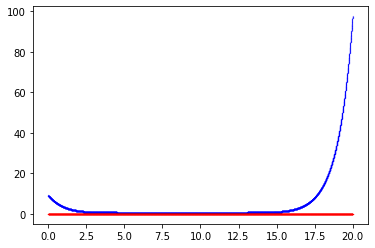

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655264.png


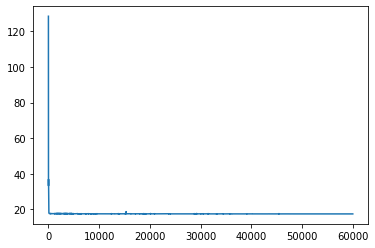

Epoch [61000/100000] Loss:17.489908 Loss_1:12.908847 Loss_2:4.265359 Loss_3: 0.315702 Lr:0.001408 Time:7.616278s (7.06min in total)
Epoch [62000/100000] Loss:17.490477 Loss_1:12.907197 Loss_2:4.268236 Loss_3: 0.315042 Lr:0.001389 Time:6.889543s (7.18min in total)
Epoch [63000/100000] Loss:17.490515 Loss_1:12.910649 Loss_2:4.264393 Loss_3: 0.315474 Lr:0.001370 Time:6.869415s (7.29min in total)
Epoch [64000/100000] Loss:17.490681 Loss_1:12.875214 Loss_2:4.303759 Loss_3: 0.311709 Lr:0.001351 Time:6.839577s (7.41min in total)
Epoch [65000/100000] Loss:17.489908 Loss_1:12.918975 Loss_2:4.254258 Loss_3: 0.316676 Lr:0.001333 Time:6.844191s (7.52min in total)
Epoch [66000/100000] Loss:17.487967 Loss_1:12.916300 Loss_2:4.256967 Loss_3: 0.314698 Lr:0.001316 Time:6.813918s (7.63min in total)
Epoch [67000/100000] Loss:17.489483 Loss_1:12.868118 Loss_2:4.310672 Loss_3: 0.310691 Lr:0.001299 Time:6.839857s (7.75min in total)
Epoch [68000/100000] Loss:17.487089 Loss_1:12.902203 Loss_2:4.271632 Loss_3:

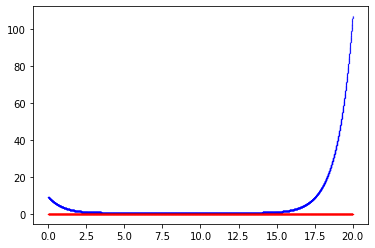

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655334.png


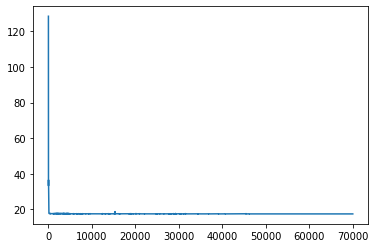

Epoch [71000/100000] Loss:17.500113 Loss_1:12.951018 Loss_2:4.227144 Loss_3: 0.321951 Lr:0.001235 Time:7.621911s (8.22min in total)
Epoch [72000/100000] Loss:17.488096 Loss_1:12.937820 Loss_2:4.234568 Loss_3: 0.315708 Lr:0.001220 Time:6.863049s (8.33min in total)
Epoch [73000/100000] Loss:17.486547 Loss_1:12.906786 Loss_2:4.266511 Loss_3: 0.313249 Lr:0.001205 Time:6.873920s (8.45min in total)
Epoch [74000/100000] Loss:17.485374 Loss_1:12.893975 Loss_2:4.279927 Loss_3: 0.311472 Lr:0.001190 Time:6.830224s (8.56min in total)
Epoch [75000/100000] Loss:17.489088 Loss_1:12.877662 Loss_2:4.299793 Loss_3: 0.311635 Lr:0.001176 Time:6.868766s (8.68min in total)
Epoch [76000/100000] Loss:17.486111 Loss_1:12.924829 Loss_2:4.248024 Loss_3: 0.313257 Lr:0.001163 Time:6.831836s (8.79min in total)
Epoch [77000/100000] Loss:17.485516 Loss_1:12.907300 Loss_2:4.265408 Loss_3: 0.312809 Lr:0.001149 Time:6.862843s (8.90min in total)
Epoch [78000/100000] Loss:17.488914 Loss_1:12.894768 Loss_2:4.280322 Loss_3:

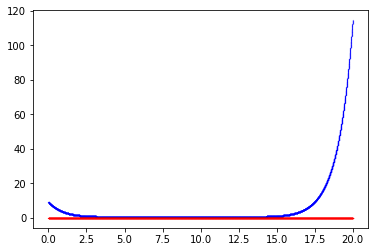

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655403.png


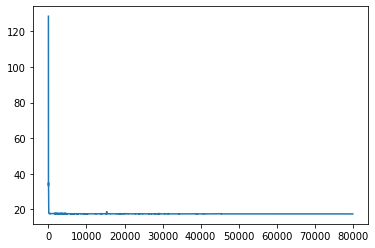

Epoch [81000/100000] Loss:17.488220 Loss_1:12.925821 Loss_2:4.248535 Loss_3: 0.313863 Lr:0.001099 Time:7.666890s (9.37min in total)
Epoch [82000/100000] Loss:17.483637 Loss_1:12.895039 Loss_2:4.278067 Loss_3: 0.310532 Lr:0.001087 Time:6.867927s (9.49min in total)
Epoch [83000/100000] Loss:17.483179 Loss_1:12.904519 Loss_2:4.268122 Loss_3: 0.310537 Lr:0.001075 Time:6.835861s (9.60min in total)
Epoch [84000/100000] Loss:17.483074 Loss_1:12.903430 Loss_2:4.269105 Loss_3: 0.310539 Lr:0.001064 Time:6.840724s (9.72min in total)
Epoch [85000/100000] Loss:17.483717 Loss_1:12.900405 Loss_2:4.273341 Loss_3: 0.309970 Lr:0.001053 Time:6.941828s (9.83min in total)
Epoch [86000/100000] Loss:17.483240 Loss_1:12.934063 Loss_2:4.236240 Loss_3: 0.312937 Lr:0.001042 Time:6.845102s (9.95min in total)
Epoch [87000/100000] Loss:17.489746 Loss_1:12.929128 Loss_2:4.244656 Loss_3: 0.315961 Lr:0.001031 Time:6.807204s (10.06min in total)
Epoch [88000/100000] Loss:17.483253 Loss_1:12.886500 Loss_2:4.287277 Loss_3

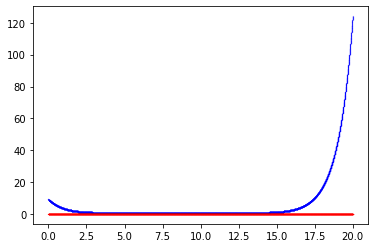

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655472.png


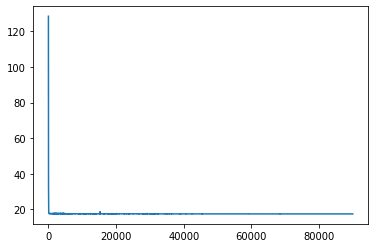

Epoch [91000/100000] Loss:17.482878 Loss_1:12.938386 Loss_2:4.232766 Loss_3: 0.311725 Lr:0.000990 Time:7.648164s (10.53min in total)
Epoch [92000/100000] Loss:17.481792 Loss_1:12.927202 Loss_2:4.243291 Loss_3: 0.311299 Lr:0.000980 Time:6.838668s (10.64min in total)
Epoch [93000/100000] Loss:17.481871 Loss_1:12.923079 Loss_2:4.246720 Loss_3: 0.312073 Lr:0.000971 Time:6.910075s (10.76min in total)
Epoch [94000/100000] Loss:17.480850 Loss_1:12.912471 Loss_2:4.258160 Loss_3: 0.310219 Lr:0.000962 Time:6.837430s (10.87min in total)
Epoch [95000/100000] Loss:17.480753 Loss_1:12.910986 Loss_2:4.260213 Loss_3: 0.309552 Lr:0.000952 Time:6.888030s (10.99min in total)
Epoch [96000/100000] Loss:17.480108 Loss_1:12.915179 Loss_2:4.255144 Loss_3: 0.309786 Lr:0.000943 Time:6.863534s (11.10min in total)
Epoch [97000/100000] Loss:17.480867 Loss_1:12.896029 Loss_2:4.276666 Loss_3: 0.308172 Lr:0.000935 Time:6.892902s (11.22min in total)
Epoch [98000/100000] Loss:17.482580 Loss_1:12.950338 Loss_2:4.220366 

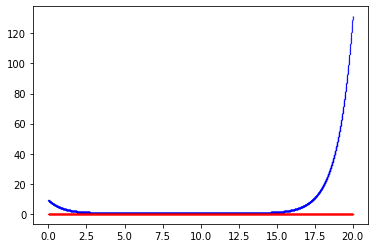

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-30-15-40-48_1648655542.png


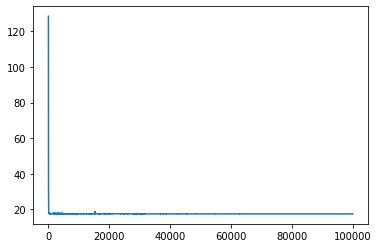

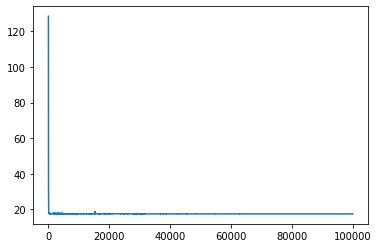


[Training Summary]
num_parameter: -1
best_loss: 17.4801082611084
time_cost: 11.559029511610667


<Figure size 432x288 with 0 Axes>

In [ ]:
# test here
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
# design (a) again 100000 / 1000 / 10000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-04-14-02-58-39
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-14-02-58-39_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-14-02-58-39_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-14-02-58-39_loss_100000.npy
args = {'epoch': 100000, 'epoch_step': 1000, 'lr': 0.01, 'main_path': '/content/drive/My Drive/Workspace/PINN', 'save_step': 10000}
config = {'T': 20.0, 'T_unit': 0.001, 'N': 20000, 'U_start': 10.0, 'V_start': 5.0, 'alpha': 1.0, 'beta': 3.0, 'gamma': 0.3, 'e': 0.333, 'ub': 20.0, 'lb': 0.0}


AttributeError: ignored

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-03-28-21-30-19
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_loss_100000.npy
Epoch [01000/100000] Loss:7.801477 Loss_1:0.552762 Loss_2:7.248715 Loss_3: 0.000000 Lr:0.009091 Time:9.643284s (0.16min in total)
Epoch [02000/100000] Loss:0.337281 Loss_1:0.017509 Loss_2:0.319772 Loss_3: 0.000000 Lr:0.008333 Time:9.697304s (0.32min in total)
Epoch [03000/100000] Loss:0.279065 Loss_1:0.003200 Loss_2:0.275866 Loss_3: 0.000000 Lr:0.007692 Time:9.664076s (0.48min in total)
Epoch [04000/100000] Loss:0.263280 Loss_1:0.002311 Loss_2:0.26

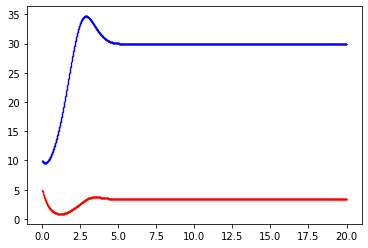

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503116.png


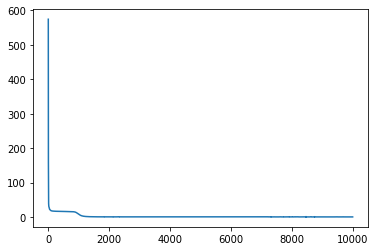

Epoch [11000/100000] Loss:0.149220 Loss_1:0.003798 Loss_2:0.145421 Loss_3: 0.000000 Lr:0.004762 Time:10.633691s (1.79min in total)
Epoch [12000/100000] Loss:0.141845 Loss_1:0.000844 Loss_2:0.141001 Loss_3: 0.000000 Lr:0.004545 Time:9.724431s (1.95min in total)
Epoch [13000/100000] Loss:0.141955 Loss_1:0.004587 Loss_2:0.137368 Loss_3: 0.000000 Lr:0.004348 Time:9.741995s (2.12min in total)
Epoch [14000/100000] Loss:0.133521 Loss_1:0.004952 Loss_2:0.128569 Loss_3: 0.000000 Lr:0.004167 Time:9.664678s (2.28min in total)
Epoch [15000/100000] Loss:0.113427 Loss_1:0.000369 Loss_2:0.113059 Loss_3: 0.000000 Lr:0.004000 Time:9.741054s (2.44min in total)
Epoch [16000/100000] Loss:0.108973 Loss_1:0.000275 Loss_2:0.108699 Loss_3: 0.000000 Lr:0.003846 Time:9.610251s (2.60min in total)
Epoch [17000/100000] Loss:0.123041 Loss_1:0.000076 Loss_2:0.122965 Loss_3: 0.000000 Lr:0.003704 Time:9.740464s (2.76min in total)
Epoch [18000/100000] Loss:0.095591 Loss_1:0.000090 Loss_2:0.095501 Loss_3: 0.000000 Lr:0.

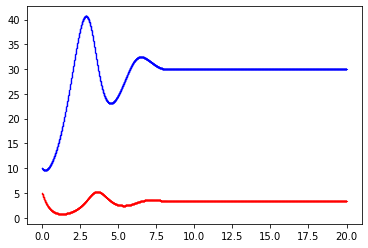

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503214.png


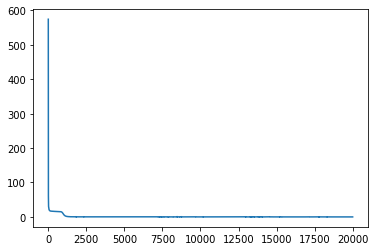

Epoch [21000/100000] Loss:0.114445 Loss_1:0.011517 Loss_2:0.102928 Loss_3: 0.000000 Lr:0.003226 Time:10.531184s (3.42min in total)
Epoch [22000/100000] Loss:0.103554 Loss_1:0.000273 Loss_2:0.103282 Loss_3: 0.000000 Lr:0.003125 Time:9.654479s (3.58min in total)
Epoch [23000/100000] Loss:0.075346 Loss_1:0.000660 Loss_2:0.074687 Loss_3: 0.000000 Lr:0.003030 Time:9.739709s (3.74min in total)
Epoch [24000/100000] Loss:0.071877 Loss_1:0.000021 Loss_2:0.071855 Loss_3: 0.000000 Lr:0.002941 Time:9.635400s (3.91min in total)
Epoch [25000/100000] Loss:0.105742 Loss_1:0.005609 Loss_2:0.100133 Loss_3: 0.000000 Lr:0.002857 Time:9.644377s (4.07min in total)
Epoch [26000/100000] Loss:0.065017 Loss_1:0.000694 Loss_2:0.064323 Loss_3: 0.000000 Lr:0.002778 Time:9.696073s (4.23min in total)
Epoch [27000/100000] Loss:0.106991 Loss_1:0.000655 Loss_2:0.106335 Loss_3: 0.000000 Lr:0.002703 Time:9.683154s (4.39min in total)
Epoch [28000/100000] Loss:0.069509 Loss_1:0.002359 Loss_2:0.067150 Loss_3: 0.000000 Lr:0.

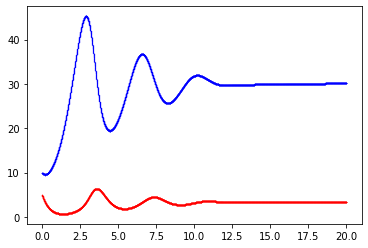

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503312.png


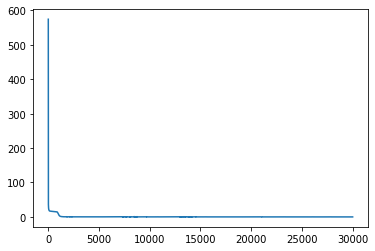

Epoch [31000/100000] Loss:0.060771 Loss_1:0.000052 Loss_2:0.060719 Loss_3: 0.000000 Lr:0.002439 Time:10.542675s (5.05min in total)
Epoch [32000/100000] Loss:0.059552 Loss_1:0.000198 Loss_2:0.059354 Loss_3: 0.000000 Lr:0.002381 Time:9.681328s (5.21min in total)
Epoch [33000/100000] Loss:0.071709 Loss_1:0.000153 Loss_2:0.071556 Loss_3: 0.000000 Lr:0.002326 Time:9.774257s (5.37min in total)
Epoch [34000/100000] Loss:0.054288 Loss_1:0.000021 Loss_2:0.054267 Loss_3: 0.000000 Lr:0.002273 Time:9.821264s (5.54min in total)
Epoch [35000/100000] Loss:0.054304 Loss_1:0.000388 Loss_2:0.053916 Loss_3: 0.000000 Lr:0.002222 Time:9.776319s (5.70min in total)
Epoch [36000/100000] Loss:0.055522 Loss_1:0.000041 Loss_2:0.055481 Loss_3: 0.000000 Lr:0.002174 Time:9.642901s (5.86min in total)
Epoch [37000/100000] Loss:0.074792 Loss_1:0.000670 Loss_2:0.074122 Loss_3: 0.000000 Lr:0.002128 Time:9.720194s (6.02min in total)
Epoch [38000/100000] Loss:0.051273 Loss_1:0.000131 Loss_2:0.051142 Loss_3: 0.000000 Lr:0.

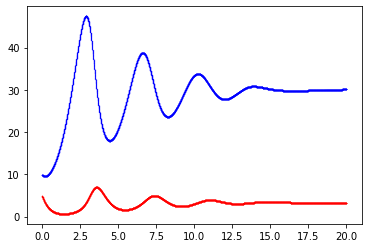

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503410.png


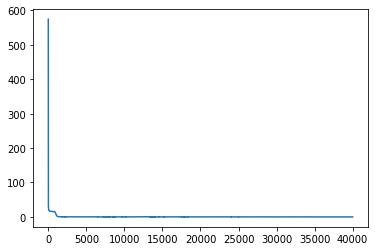

Epoch [41000/100000] Loss:0.047586 Loss_1:0.000211 Loss_2:0.047375 Loss_3: 0.000000 Lr:0.001961 Time:10.708040s (6.69min in total)
Epoch [42000/100000] Loss:0.046135 Loss_1:0.000013 Loss_2:0.046122 Loss_3: 0.000000 Lr:0.001923 Time:9.766278s (6.85min in total)
Epoch [43000/100000] Loss:0.047441 Loss_1:0.000243 Loss_2:0.047198 Loss_3: 0.000000 Lr:0.001887 Time:9.717261s (7.01min in total)
Epoch [44000/100000] Loss:0.044674 Loss_1:0.000008 Loss_2:0.044665 Loss_3: 0.000000 Lr:0.001852 Time:9.668915s (7.17min in total)
Epoch [45000/100000] Loss:0.051467 Loss_1:0.000998 Loss_2:0.050469 Loss_3: 0.000000 Lr:0.001818 Time:9.770069s (7.34min in total)
Epoch [46000/100000] Loss:0.043976 Loss_1:0.000044 Loss_2:0.043932 Loss_3: 0.000000 Lr:0.001786 Time:9.726548s (7.50min in total)
Epoch [47000/100000] Loss:0.044400 Loss_1:0.000014 Loss_2:0.044386 Loss_3: 0.000000 Lr:0.001754 Time:9.693443s (7.66min in total)
Epoch [48000/100000] Loss:0.050739 Loss_1:0.000645 Loss_2:0.050094 Loss_3: 0.000000 Lr:0.

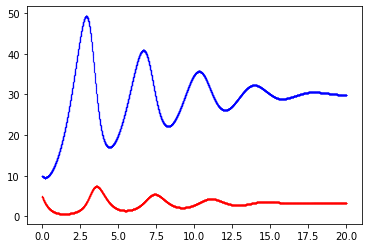

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503508.png


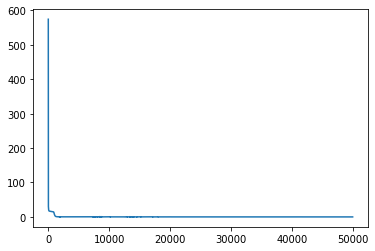

Epoch [51000/100000] Loss:0.041856 Loss_1:0.000076 Loss_2:0.041780 Loss_3: 0.000000 Lr:0.001639 Time:10.732309s (8.32min in total)
Epoch [52000/100000] Loss:0.042774 Loss_1:0.000005 Loss_2:0.042769 Loss_3: 0.000000 Lr:0.001613 Time:9.720727s (8.49min in total)
Epoch [53000/100000] Loss:0.044151 Loss_1:0.000543 Loss_2:0.043609 Loss_3: 0.000000 Lr:0.001587 Time:9.748286s (8.65min in total)
Epoch [54000/100000] Loss:0.042736 Loss_1:0.000101 Loss_2:0.042636 Loss_3: 0.000000 Lr:0.001563 Time:9.707079s (8.81min in total)
Epoch [55000/100000] Loss:0.038649 Loss_1:0.000001 Loss_2:0.038648 Loss_3: 0.000000 Lr:0.001538 Time:9.738590s (8.97min in total)
Epoch [56000/100000] Loss:0.042141 Loss_1:0.000075 Loss_2:0.042066 Loss_3: 0.000000 Lr:0.001515 Time:9.747638s (9.14min in total)
Epoch [57000/100000] Loss:0.040944 Loss_1:0.000044 Loss_2:0.040900 Loss_3: 0.000000 Lr:0.001493 Time:9.666657s (9.30min in total)
Epoch [58000/100000] Loss:0.039905 Loss_1:0.000219 Loss_2:0.039686 Loss_3: 0.000000 Lr:0.

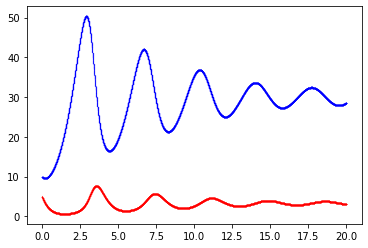

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503606.png


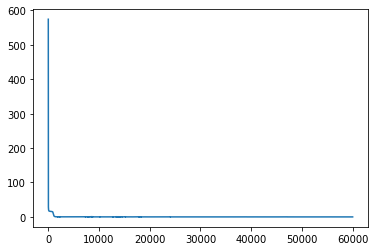

Epoch [61000/100000] Loss:0.033977 Loss_1:0.000009 Loss_2:0.033968 Loss_3: 0.000000 Lr:0.001408 Time:10.624789s (9.96min in total)
Epoch [62000/100000] Loss:0.034628 Loss_1:0.000001 Loss_2:0.034627 Loss_3: 0.000000 Lr:0.001389 Time:9.627933s (10.12min in total)
Epoch [63000/100000] Loss:0.032592 Loss_1:0.000008 Loss_2:0.032584 Loss_3: 0.000000 Lr:0.001370 Time:9.742707s (10.28min in total)
Epoch [64000/100000] Loss:0.041435 Loss_1:0.001096 Loss_2:0.040339 Loss_3: 0.000000 Lr:0.001351 Time:9.659058s (10.44min in total)
Epoch [65000/100000] Loss:0.046070 Loss_1:0.000044 Loss_2:0.046026 Loss_3: 0.000000 Lr:0.001333 Time:9.614318s (10.60min in total)
Epoch [66000/100000] Loss:0.053135 Loss_1:0.000533 Loss_2:0.052602 Loss_3: 0.000000 Lr:0.001316 Time:9.655042s (10.76min in total)
Epoch [67000/100000] Loss:0.029367 Loss_1:0.000004 Loss_2:0.029363 Loss_3: 0.000000 Lr:0.001299 Time:9.583911s (10.92min in total)
Epoch [68000/100000] Loss:0.092011 Loss_1:0.000849 Loss_2:0.091163 Loss_3: 0.000000

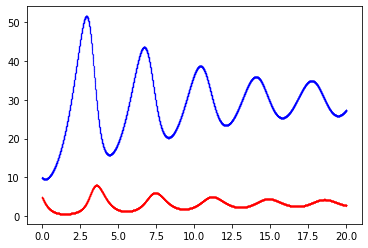

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503704.png


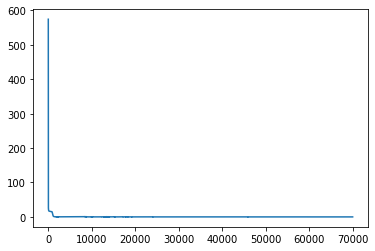

Epoch [71000/100000] Loss:0.026133 Loss_1:0.000007 Loss_2:0.026126 Loss_3: 0.000000 Lr:0.001235 Time:10.573830s (11.58min in total)
Epoch [72000/100000] Loss:0.025537 Loss_1:0.000009 Loss_2:0.025529 Loss_3: 0.000000 Lr:0.001220 Time:9.644458s (11.74min in total)
Epoch [73000/100000] Loss:0.026205 Loss_1:0.000329 Loss_2:0.025876 Loss_3: 0.000000 Lr:0.001205 Time:9.717840s (11.91min in total)
Epoch [74000/100000] Loss:0.024724 Loss_1:0.000019 Loss_2:0.024704 Loss_3: 0.000000 Lr:0.001190 Time:9.691896s (12.07min in total)
Epoch [75000/100000] Loss:0.027860 Loss_1:0.000549 Loss_2:0.027311 Loss_3: 0.000000 Lr:0.001176 Time:9.639607s (12.23min in total)
Epoch [76000/100000] Loss:0.022964 Loss_1:0.000004 Loss_2:0.022960 Loss_3: 0.000000 Lr:0.001163 Time:9.563969s (12.39min in total)
Epoch [77000/100000] Loss:0.022581 Loss_1:0.000049 Loss_2:0.022532 Loss_3: 0.000000 Lr:0.001149 Time:9.688232s (12.55min in total)
Epoch [78000/100000] Loss:0.042885 Loss_1:0.000052 Loss_2:0.042833 Loss_3: 0.00000

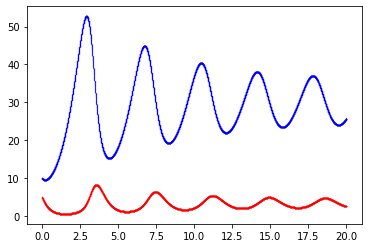

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503802.png


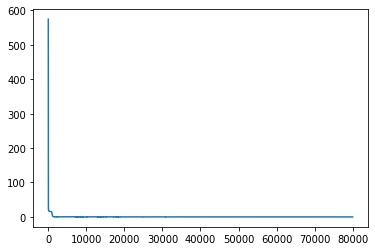

Epoch [81000/100000] Loss:0.022302 Loss_1:0.000082 Loss_2:0.022221 Loss_3: 0.000000 Lr:0.001099 Time:10.695560s (13.21min in total)
Epoch [82000/100000] Loss:0.020885 Loss_1:0.000003 Loss_2:0.020882 Loss_3: 0.000000 Lr:0.001087 Time:9.731869s (13.37min in total)
Epoch [83000/100000] Loss:0.063322 Loss_1:0.000833 Loss_2:0.062489 Loss_3: 0.000000 Lr:0.001075 Time:9.752207s (13.54min in total)
Epoch [84000/100000] Loss:0.024622 Loss_1:0.000080 Loss_2:0.024542 Loss_3: 0.000000 Lr:0.001064 Time:9.670373s (13.70min in total)
Epoch [85000/100000] Loss:0.022388 Loss_1:0.000009 Loss_2:0.022379 Loss_3: 0.000000 Lr:0.001053 Time:9.547974s (13.86min in total)
Epoch [86000/100000] Loss:0.020966 Loss_1:0.000060 Loss_2:0.020907 Loss_3: 0.000000 Lr:0.001042 Time:9.582334s (14.02min in total)
Epoch [87000/100000] Loss:0.018657 Loss_1:0.000003 Loss_2:0.018654 Loss_3: 0.000000 Lr:0.001031 Time:9.675485s (14.18min in total)
Epoch [88000/100000] Loss:0.017865 Loss_1:0.000005 Loss_2:0.017860 Loss_3: 0.00000

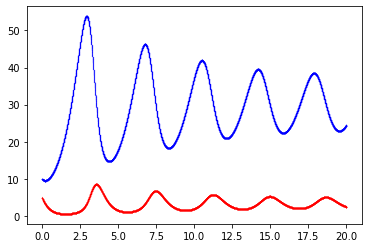

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503899.png


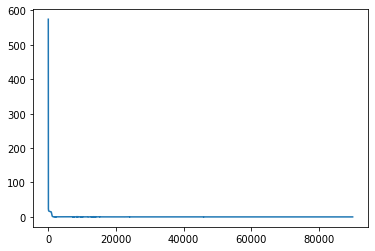

Epoch [91000/100000] Loss:0.017188 Loss_1:0.000060 Loss_2:0.017128 Loss_3: 0.000000 Lr:0.000990 Time:10.646674s (14.84min in total)
Epoch [92000/100000] Loss:0.017334 Loss_1:0.000008 Loss_2:0.017326 Loss_3: 0.000000 Lr:0.000980 Time:9.623270s (15.00min in total)
Epoch [93000/100000] Loss:0.016745 Loss_1:0.000200 Loss_2:0.016545 Loss_3: 0.000000 Lr:0.000971 Time:9.624942s (15.16min in total)
Epoch [94000/100000] Loss:0.019521 Loss_1:0.000012 Loss_2:0.019508 Loss_3: 0.000000 Lr:0.000962 Time:9.683490s (15.32min in total)
Epoch [95000/100000] Loss:0.020405 Loss_1:0.000052 Loss_2:0.020353 Loss_3: 0.000000 Lr:0.000952 Time:9.607680s (15.48min in total)
Epoch [96000/100000] Loss:0.015667 Loss_1:0.000048 Loss_2:0.015619 Loss_3: 0.000000 Lr:0.000943 Time:9.638442s (15.64min in total)
Epoch [97000/100000] Loss:0.015542 Loss_1:0.000010 Loss_2:0.015532 Loss_3: 0.000000 Lr:0.000935 Time:9.575492s (15.80min in total)
Epoch [98000/100000] Loss:0.015198 Loss_1:0.000013 Loss_2:0.015185 Loss_3: 0.00000

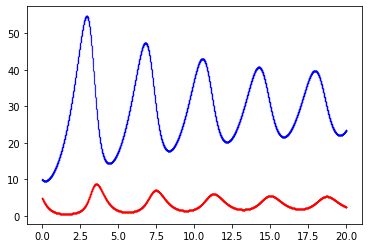

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_1648503996.png


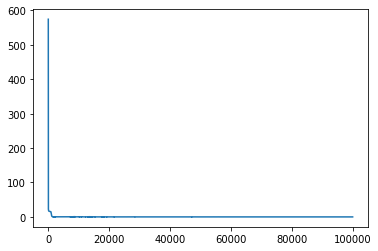

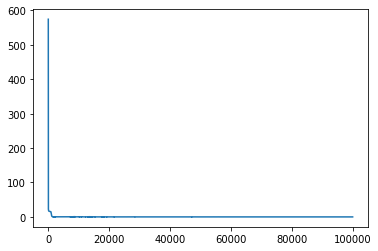


[Training Summary]
num_parameter: -1
best_loss: 0.015197915956377983
time_cost: 16.281749089558918


<Figure size 432x288 with 0 Axes>

In [ ]:
# design (b) 100000 / 1000 / 10000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 100000
epoch_step = 1000
model_name = SimpleNetworkPP
now_string = 2022-03-28-21-47-29
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_best.pt
loss_save_path = /content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_loss_100000.npy
Epoch [01000/100000] Loss:12.647819 Loss_1:3.451159 Loss_2:8.894968 Loss_3: 0.301692 Lr:0.009091 Time:10.133096s (0.17min in total)
Epoch [02000/100000] Loss:3.283460 Loss_1:0.357358 Loss_2:2.856539 Loss_3: 0.069564 Lr:0.008333 Time:10.065696s (0.34min in total)
Epoch [03000/100000] Loss:2.167285 Loss_1:0.054050 Loss_2:2.045537 Loss_3: 0.067698 Lr:0.007692 Time:10.082959s (0.50min in total)
Epoch [04000/100000] Loss:2.039903 Loss_1:0.056498 Loss_2:

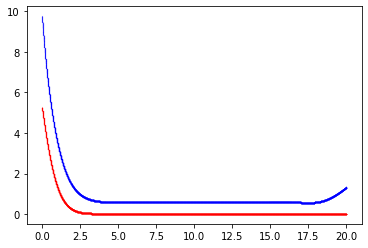

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504151.png


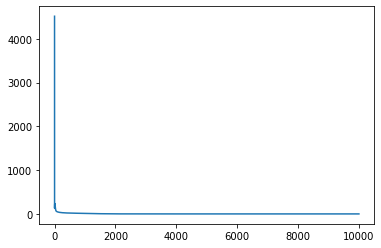

Epoch [11000/100000] Loss:2.006845 Loss_1:0.045877 Loss_2:1.896136 Loss_3: 0.064831 Lr:0.004762 Time:10.890976s (1.88min in total)
Epoch [12000/100000] Loss:2.004282 Loss_1:0.091262 Loss_2:1.846582 Loss_3: 0.066438 Lr:0.004545 Time:10.138504s (2.05min in total)
Epoch [13000/100000] Loss:2.000294 Loss_1:0.051167 Loss_2:1.885732 Loss_3: 0.063395 Lr:0.004348 Time:10.144264s (2.22min in total)
Epoch [14000/100000] Loss:2.042813 Loss_1:0.191488 Loss_2:1.778488 Loss_3: 0.072837 Lr:0.004167 Time:10.078541s (2.39min in total)
Epoch [15000/100000] Loss:1.992062 Loss_1:0.063678 Loss_2:1.865999 Loss_3: 0.062385 Lr:0.004000 Time:10.132396s (2.56min in total)
Epoch [16000/100000] Loss:285.391663 Loss_1:7.780676 Loss_2:277.610992 Loss_3: 0.000001 Lr:0.003846 Time:10.102947s (2.73min in total)
Epoch [17000/100000] Loss:17.717670 Loss_1:2.214212 Loss_2:15.503459 Loss_3: 0.000000 Lr:0.003704 Time:10.041155s (2.89min in total)
Epoch [18000/100000] Loss:4.898756 Loss_1:1.623999 Loss_2:3.274757 Loss_3: 0.

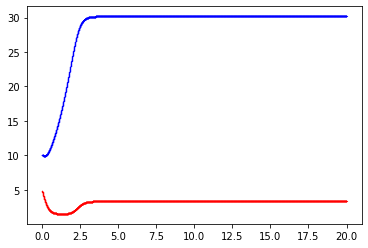

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504253.png


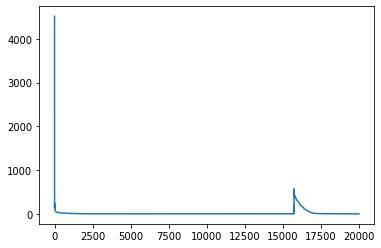

Epoch [21000/100000] Loss:0.219971 Loss_1:0.000556 Loss_2:0.219415 Loss_3: 0.000000 Lr:0.003226 Time:10.984570s (3.58min in total)
Epoch [22000/100000] Loss:0.220921 Loss_1:0.001233 Loss_2:0.219689 Loss_3: 0.000000 Lr:0.003125 Time:10.087168s (3.75min in total)
Epoch [23000/100000] Loss:0.180082 Loss_1:0.000216 Loss_2:0.179866 Loss_3: 0.000000 Lr:0.003030 Time:10.146070s (3.92min in total)
Epoch [24000/100000] Loss:0.160822 Loss_1:0.000177 Loss_2:0.160645 Loss_3: 0.000000 Lr:0.002941 Time:10.056114s (4.09min in total)
Epoch [25000/100000] Loss:0.149538 Loss_1:0.000144 Loss_2:0.149394 Loss_3: 0.000000 Lr:0.002857 Time:10.089640s (4.25min in total)
Epoch [26000/100000] Loss:0.156795 Loss_1:0.000931 Loss_2:0.155864 Loss_3: 0.000000 Lr:0.002778 Time:10.053199s (4.42min in total)
Epoch [27000/100000] Loss:0.145586 Loss_1:0.000262 Loss_2:0.145324 Loss_3: 0.000000 Lr:0.002703 Time:10.154245s (4.59min in total)
Epoch [28000/100000] Loss:0.134675 Loss_1:0.000434 Loss_2:0.134241 Loss_3: 0.000000

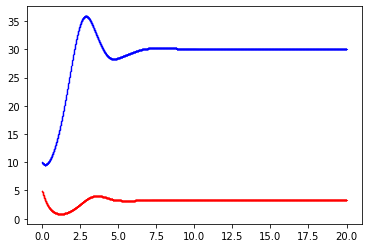

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504355.png


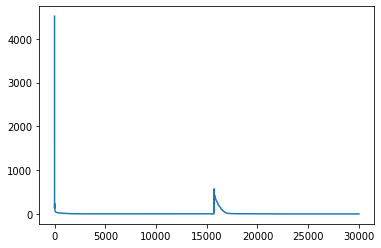

Epoch [31000/100000] Loss:0.115603 Loss_1:0.000008 Loss_2:0.115596 Loss_3: 0.000000 Lr:0.002439 Time:11.058381s (5.28min in total)
Epoch [32000/100000] Loss:0.102404 Loss_1:0.000118 Loss_2:0.102286 Loss_3: 0.000000 Lr:0.002381 Time:10.164409s (5.45min in total)
Epoch [33000/100000] Loss:0.191272 Loss_1:0.002318 Loss_2:0.188954 Loss_3: 0.000000 Lr:0.002326 Time:10.197202s (5.62min in total)
Epoch [34000/100000] Loss:0.087099 Loss_1:0.000036 Loss_2:0.087063 Loss_3: 0.000000 Lr:0.002273 Time:10.041837s (5.79min in total)
Epoch [35000/100000] Loss:0.083152 Loss_1:0.000253 Loss_2:0.082898 Loss_3: 0.000000 Lr:0.002222 Time:10.159113s (5.96min in total)
Epoch [36000/100000] Loss:0.076890 Loss_1:0.000009 Loss_2:0.076881 Loss_3: 0.000000 Lr:0.002174 Time:10.217413s (6.13min in total)
Epoch [37000/100000] Loss:0.072750 Loss_1:0.000017 Loss_2:0.072734 Loss_3: 0.000000 Lr:0.002128 Time:10.124392s (6.29min in total)
Epoch [38000/100000] Loss:0.069773 Loss_1:0.000011 Loss_2:0.069761 Loss_3: 0.000000

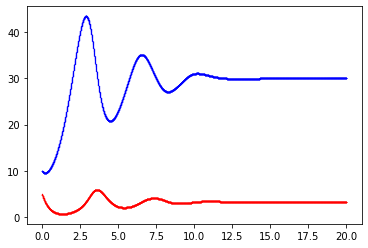

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504457.png


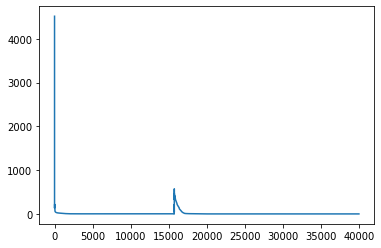

Epoch [41000/100000] Loss:0.063737 Loss_1:0.000006 Loss_2:0.063731 Loss_3: 0.000000 Lr:0.001961 Time:11.101240s (6.99min in total)
Epoch [42000/100000] Loss:0.062113 Loss_1:0.000009 Loss_2:0.062105 Loss_3: 0.000000 Lr:0.001923 Time:10.194566s (7.16min in total)
Epoch [43000/100000] Loss:0.066815 Loss_1:0.000146 Loss_2:0.066669 Loss_3: 0.000000 Lr:0.001887 Time:10.148552s (7.33min in total)
Epoch [44000/100000] Loss:0.059563 Loss_1:0.000007 Loss_2:0.059556 Loss_3: 0.000000 Lr:0.001852 Time:10.173908s (7.50min in total)
Epoch [45000/100000] Loss:0.061599 Loss_1:0.000070 Loss_2:0.061529 Loss_3: 0.000000 Lr:0.001818 Time:10.195074s (7.67min in total)
Epoch [46000/100000] Loss:0.092987 Loss_1:0.000460 Loss_2:0.092527 Loss_3: 0.000000 Lr:0.001786 Time:10.110126s (7.84min in total)
Epoch [47000/100000] Loss:0.057064 Loss_1:0.000001 Loss_2:0.057063 Loss_3: 0.000000 Lr:0.001754 Time:10.158253s (8.01min in total)
Epoch [48000/100000] Loss:0.063548 Loss_1:0.000060 Loss_2:0.063487 Loss_3: 0.000000

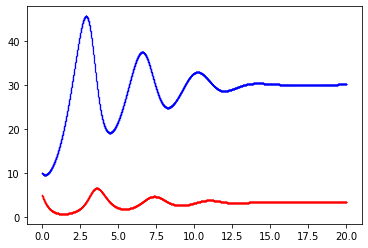

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504560.png


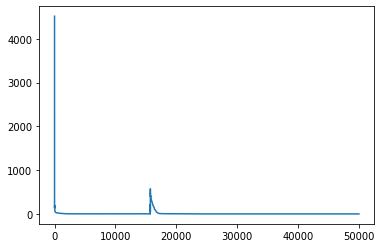

Epoch [51000/100000] Loss:0.052568 Loss_1:0.000009 Loss_2:0.052559 Loss_3: 0.000000 Lr:0.001639 Time:11.168660s (8.70min in total)
Epoch [52000/100000] Loss:0.051863 Loss_1:0.000008 Loss_2:0.051854 Loss_3: 0.000000 Lr:0.001613 Time:10.269629s (8.87min in total)
Epoch [53000/100000] Loss:0.074837 Loss_1:0.000325 Loss_2:0.074511 Loss_3: 0.000000 Lr:0.001587 Time:10.280981s (9.04min in total)
Epoch [54000/100000] Loss:0.050146 Loss_1:0.000008 Loss_2:0.050138 Loss_3: 0.000000 Lr:0.001563 Time:10.187258s (9.21min in total)
Epoch [55000/100000] Loss:0.089935 Loss_1:0.000190 Loss_2:0.089745 Loss_3: 0.000000 Lr:0.001538 Time:10.276690s (9.39min in total)
Epoch [56000/100000] Loss:0.048702 Loss_1:0.000008 Loss_2:0.048694 Loss_3: 0.000000 Lr:0.001515 Time:10.192368s (9.56min in total)
Epoch [57000/100000] Loss:0.065149 Loss_1:0.000408 Loss_2:0.064741 Loss_3: 0.000000 Lr:0.001493 Time:10.265237s (9.73min in total)
Epoch [58000/100000] Loss:0.047416 Loss_1:0.000008 Loss_2:0.047409 Loss_3: 0.000000

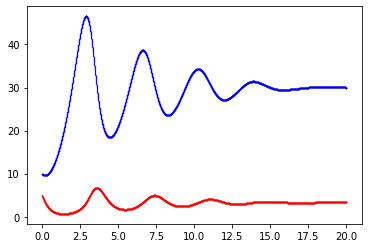

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504663.png


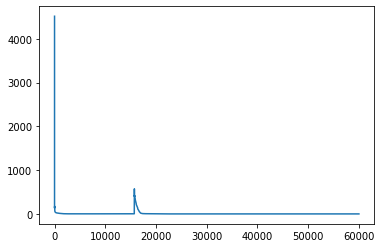

Epoch [61000/100000] Loss:0.046051 Loss_1:0.000004 Loss_2:0.046047 Loss_3: 0.000000 Lr:0.001408 Time:11.154112s (10.42min in total)
Epoch [62000/100000] Loss:0.045609 Loss_1:0.000008 Loss_2:0.045601 Loss_3: 0.000000 Lr:0.001389 Time:10.241296s (10.59min in total)
Epoch [63000/100000] Loss:0.045309 Loss_1:0.000008 Loss_2:0.045301 Loss_3: 0.000000 Lr:0.001370 Time:10.258426s (10.76min in total)
Epoch [64000/100000] Loss:0.044810 Loss_1:0.000007 Loss_2:0.044803 Loss_3: 0.000000 Lr:0.001351 Time:10.193082s (10.93min in total)
Epoch [65000/100000] Loss:0.044379 Loss_1:0.000007 Loss_2:0.044372 Loss_3: 0.000000 Lr:0.001333 Time:10.345670s (11.11min in total)
Epoch [66000/100000] Loss:0.044045 Loss_1:0.000005 Loss_2:0.044039 Loss_3: 0.000000 Lr:0.001316 Time:10.294688s (11.28min in total)
Epoch [67000/100000] Loss:0.043518 Loss_1:0.000005 Loss_2:0.043513 Loss_3: 0.000000 Lr:0.001299 Time:10.252245s (11.45min in total)
Epoch [68000/100000] Loss:0.043136 Loss_1:0.000006 Loss_2:0.043131 Loss_3: 0

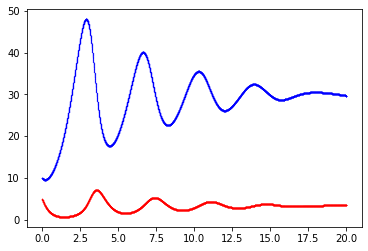

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504767.png


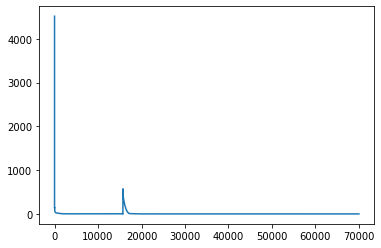

Epoch [71000/100000] Loss:0.042242 Loss_1:0.000009 Loss_2:0.042233 Loss_3: 0.000000 Lr:0.001235 Time:11.175034s (12.15min in total)
Epoch [72000/100000] Loss:0.045526 Loss_1:0.000044 Loss_2:0.045482 Loss_3: 0.000000 Lr:0.001220 Time:10.354206s (12.32min in total)
Epoch [73000/100000] Loss:0.041455 Loss_1:0.000006 Loss_2:0.041449 Loss_3: 0.000000 Lr:0.001205 Time:10.149659s (12.49min in total)
Epoch [74000/100000] Loss:0.041247 Loss_1:0.000011 Loss_2:0.041236 Loss_3: 0.000000 Lr:0.001190 Time:10.258676s (12.66min in total)
Epoch [75000/100000] Loss:0.040546 Loss_1:0.000005 Loss_2:0.040540 Loss_3: 0.000000 Lr:0.001176 Time:10.237232s (12.83min in total)
Epoch [76000/100000] Loss:0.040367 Loss_1:0.000002 Loss_2:0.040365 Loss_3: 0.000000 Lr:0.001163 Time:10.310181s (13.00min in total)
Epoch [77000/100000] Loss:0.041090 Loss_1:0.000014 Loss_2:0.041076 Loss_3: 0.000000 Lr:0.001149 Time:10.197999s (13.17min in total)
Epoch [78000/100000] Loss:0.039838 Loss_1:0.000013 Loss_2:0.039826 Loss_3: 0

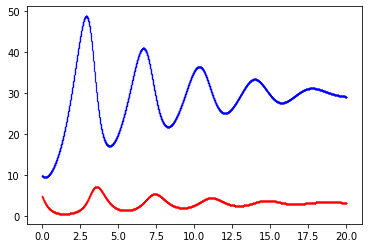

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504870.png


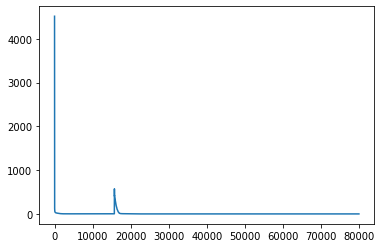

Epoch [81000/100000] Loss:0.038528 Loss_1:0.000005 Loss_2:0.038523 Loss_3: 0.000000 Lr:0.001099 Time:11.254851s (13.87min in total)
Epoch [82000/100000] Loss:0.038302 Loss_1:0.000005 Loss_2:0.038298 Loss_3: 0.000000 Lr:0.001087 Time:10.256518s (14.04min in total)
Epoch [83000/100000] Loss:0.038118 Loss_1:0.000004 Loss_2:0.038114 Loss_3: 0.000000 Lr:0.001075 Time:10.311075s (14.22min in total)
Epoch [84000/100000] Loss:0.038023 Loss_1:0.000007 Loss_2:0.038016 Loss_3: 0.000000 Lr:0.001064 Time:10.323434s (14.39min in total)
Epoch [85000/100000] Loss:0.039095 Loss_1:0.000025 Loss_2:0.039070 Loss_3: 0.000000 Lr:0.001053 Time:10.290005s (14.56min in total)
Epoch [86000/100000] Loss:0.037316 Loss_1:0.000005 Loss_2:0.037311 Loss_3: 0.000000 Lr:0.001042 Time:10.217103s (14.73min in total)
Epoch [87000/100000] Loss:0.037096 Loss_1:0.000004 Loss_2:0.037091 Loss_3: 0.000000 Lr:0.001031 Time:10.263329s (14.90min in total)
Epoch [88000/100000] Loss:0.036742 Loss_1:0.000003 Loss_2:0.036739 Loss_3: 0

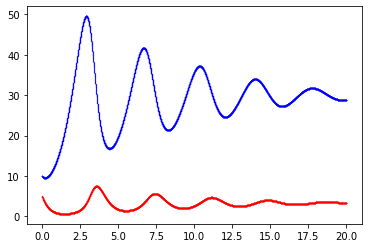

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648504974.png


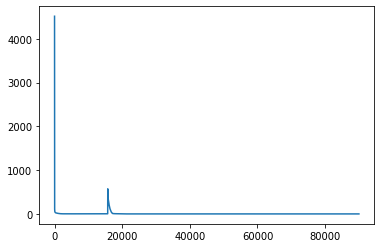

Epoch [91000/100000] Loss:0.035708 Loss_1:0.000004 Loss_2:0.035704 Loss_3: 0.000000 Lr:0.000990 Time:11.264336s (15.60min in total)
Epoch [92000/100000] Loss:0.035478 Loss_1:0.000003 Loss_2:0.035475 Loss_3: 0.000000 Lr:0.000980 Time:10.070790s (15.77min in total)
Epoch [93000/100000] Loss:0.035174 Loss_1:0.000003 Loss_2:0.035170 Loss_3: 0.000000 Lr:0.000971 Time:10.305108s (15.94min in total)
Epoch [94000/100000] Loss:0.034760 Loss_1:0.000004 Loss_2:0.034756 Loss_3: 0.000000 Lr:0.000962 Time:10.172677s (16.11min in total)
Epoch [95000/100000] Loss:0.034480 Loss_1:0.000004 Loss_2:0.034476 Loss_3: 0.000000 Lr:0.000952 Time:10.155367s (16.28min in total)
Epoch [96000/100000] Loss:0.039759 Loss_1:0.000052 Loss_2:0.039707 Loss_3: 0.000000 Lr:0.000943 Time:10.344781s (16.45min in total)
Epoch [97000/100000] Loss:0.103962 Loss_1:0.000275 Loss_2:0.103687 Loss_3: 0.000000 Lr:0.000935 Time:10.151649s (16.62min in total)
Epoch [98000/100000] Loss:0.033338 Loss_1:0.000003 Loss_2:0.033334 Loss_3: 0

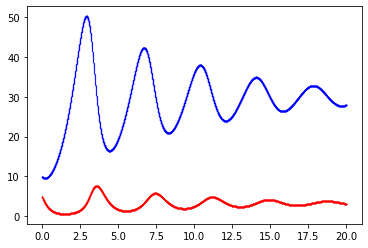

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_1648505077.png


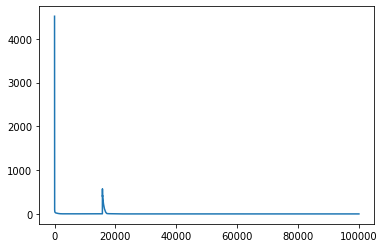

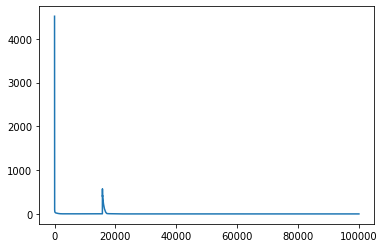


[Training Summary]
num_parameter: -1
best_loss: 0.03333751857280731
time_cost: 17.132551709810894


<Figure size 432x288 with 0 Axes>

In [ ]:
# design (a) 100000 / 1000 / 10000
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

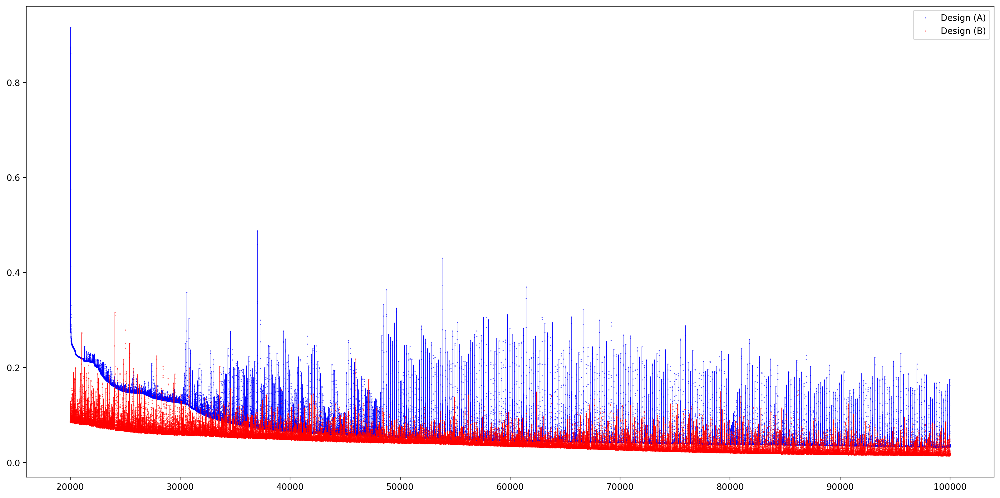

<Figure size 432x288 with 0 Axes>

In [ ]:
# loss
loss_a = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-47-29_loss_100000.npy")
loss_b = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-03-28-21-30-19_loss_100000.npy")

start = 20000
end = len(loss_a)
x = range(start + 1, end + 1)
plt.figure(dpi=200, figsize=[20,10])
plt.plot(x, loss_a[start:], marker='.', markersize=0.5, linewidth=0.3, c="b")
plt.plot(x, loss_b[start:], marker='.', markersize=0.5, linewidth=0.3, c="r")
plt.legend(["Design (A)","Design (B)"])
plt.show()
plt.clf()

1000


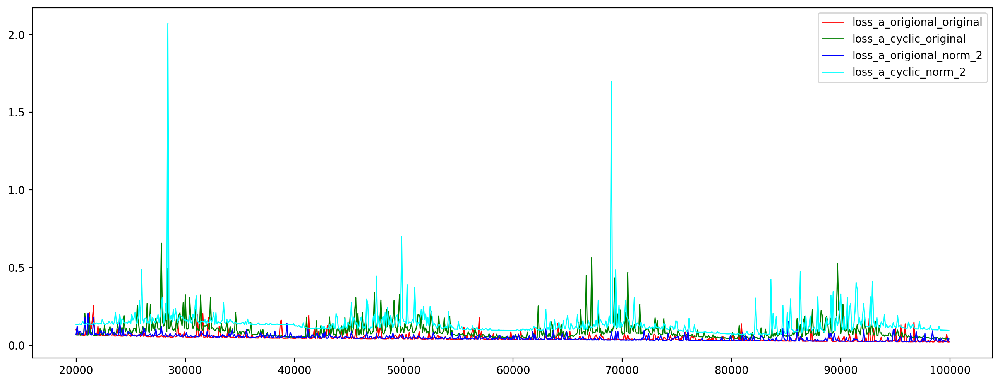

<Figure size 432x288 with 0 Axes>

In [ ]:
# loss
import numpy as np
loss_a_origional_original = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-00-38-13_loss_100000.npy")
loss_a_cyclic_original = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-22-01-07-17_loss_100000.npy")
loss_a_origional_norm_2 = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-45-58_loss_100000.npy")
loss_a_cyclic_norm_2 = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_100000_1000_0.01_1.0_3.0_0.3_0.333_2022-04-24-19-26-13_loss_100000.npy")

gap = 100

x = range(1, len(loss_a_origional_original) + 1)
x = [x[i] for i in range(len(x)) if i % gap == 0]
loss_a_origional_original = [loss_a_origional_original[i] for i in range(len(loss_a_origional_original)) if i % gap == 0]
loss_a_cyclic_original = [loss_a_cyclic_original[i] for i in range(len(loss_a_cyclic_original)) if i % gap == 0]
loss_a_origional_norm_2 = [loss_a_origional_norm_2[i] for i in range(len(loss_a_origional_norm_2)) if i % gap == 0]
loss_a_cyclic_norm_2 = [loss_a_cyclic_norm_2[i] for i in range(len(loss_a_cyclic_norm_2)) if i % gap == 0]

print(len(x))

start = 200
# end = len(loss_a_origional_original)
# x = range(start + 1, end + 1)
plt.figure(dpi=200, figsize=[16,6])
line_width = 1
plt.plot(x[start:], loss_a_origional_original[start:], marker='.', markersize=0.1, linewidth=line_width, c="r")
plt.plot(x[start:], loss_a_cyclic_original[start:], marker='.', markersize=0.1, linewidth=line_width, c="g")
plt.plot(x[start:], loss_a_origional_norm_2[start:], marker='.', markersize=0.1, linewidth=line_width, c="b")
plt.plot(x[start:], loss_a_cyclic_norm_2[start:], marker='.', markersize=0.1, linewidth=line_width, c="cyan")
plt.legend(["loss_a_origional_original", "loss_a_cyclic_original", "loss_a_origional_norm_2", "loss_a_cyclic_norm_2"])
plt.show()
plt.clf()

[0.00557009968906641, 0.005570265930145979, 0.005572465248405933, 0.005620928481221199, 0.005778354126960039, 0.005622584372758865, 0.005582378711551428, 0.0055714258924126625, 0.005570601671934128, 0.005570468492805958]
[0.0010662408312782645, 0.001039529568515718, 0.001016663503833115, 0.0010654765646904707, 0.0014168204506859183, 0.004979547578841448, 0.002098522614687681, 0.0014118938706815243, 0.0011251182295382023, 0.001035509747453034]
200000


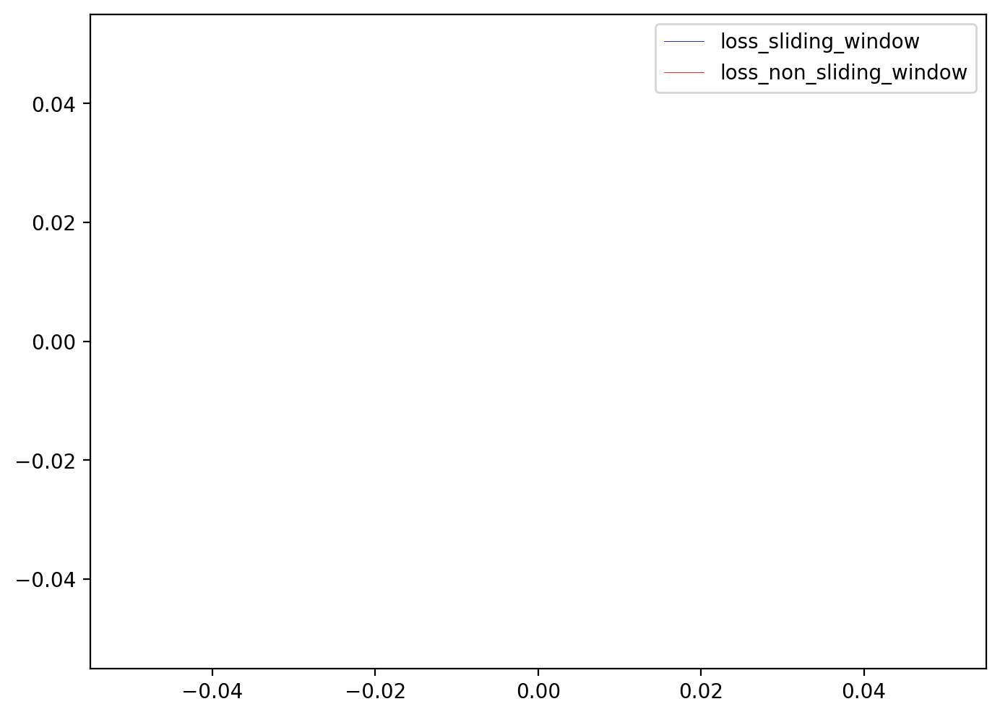

<Figure size 432x288 with 0 Axes>

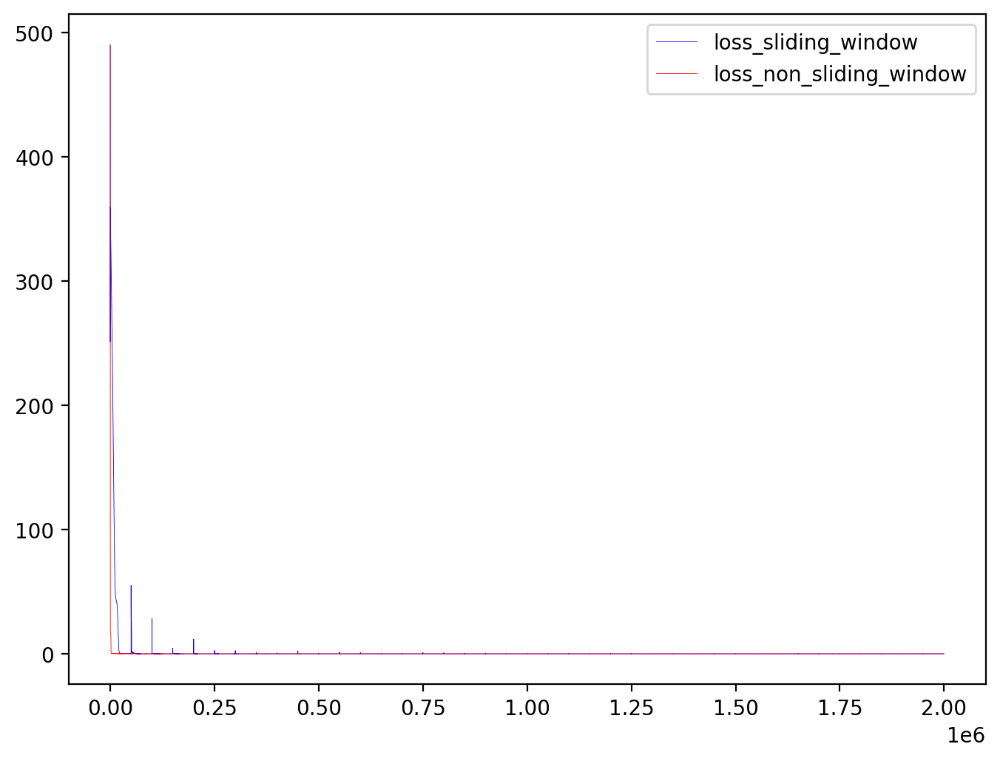

<Figure size 432x288 with 0 Axes>

In [ ]:
# SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-58-16_loss_2000000.npy SW
# SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-04-18-35_loss_2000000.npy Non-SW
# loss
import numpy as np
loss_non_sw = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-04-18-35_loss_2000000.npy")
loss_sw = np.load("/content/drive/My Drive/Workspace/PINN/loss/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-58-16_loss_2000000.npy")

gap = 10

x = range(1, len(loss_non_sw) + 1)
x = [x[i] for i in range(len(x)) if i % gap == 0]
loss_non_sw = [loss_non_sw[i] for i in range(len(loss_non_sw)) if i % gap == 0]
loss_sw = [loss_sw[i] for i in range(len(loss_sw)) if i % gap == 0]
print(loss_non_sw[-10:])
print(loss_sw[-10:])


print(len(x))

start = 0
# end = len(loss_a_origional_original)
# x = range(start + 1, end + 1)
plt.figure(dpi=200, figsize=[8,6])
line_width = 0.3

plt.plot(x[:start], loss_sw[:start], marker='.', markersize=0, linewidth=line_width, c="b")
plt.plot(x[:start], loss_non_sw[:start], marker='.', markersize=0, linewidth=line_width, c="r")


plt.legend(["loss_sliding_window", "loss_non_sliding_window"])
plt.show()
plt.clf()

plt.figure(dpi=200, figsize=[8,6])

plt.plot(x[start:], loss_sw[start:], marker='.', markersize=0, linewidth=line_width, c="b")
plt.plot(x[start:], loss_non_sw[start:], marker='.', markersize=0, linewidth=line_width, c="r")


plt.legend(["loss_sliding_window", "loss_non_sliding_window"])
plt.show()
plt.clf()

In [ ]:
import torch


In [ ]:
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

using cuda
epoch = 50000
epoch_step = 100
model_name = SimpleNetworkPP
now_string = 2022-03-26-23-41-36
model_save_path_last = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_last.pt
model_save_path_best = /content/drive/My Drive/Workspace/PINN/train/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_best.pt
Epoch [00100/50000] Loss:51.838360 Loss_1:0.253591 Loss_2:47.437141 Lr:0.009091 Time:0.796831s
Epoch [00200/50000] Loss:49.782753 Loss_1:0.195372 Loss_2:45.317219 Lr:0.008333 Time:0.792318s
Epoch [00300/50000] Loss:48.915333 Loss_1:0.266340 Loss_2:45.732475 Lr:0.007692 Time:0.803477s
Epoch [00400/50000] Loss:0.641632 Loss_1:0.132566 Loss_2:0.509065 Lr:0.007143 Time:0.791494s
Epoch [00500/50000] Loss:0.198274 Loss_1:0.003468 Loss_2:0.194806 Lr:0.006667 Time:0.791440s
Testing & drawing...
u= [10.045646, 10.05103, 10.056431, 10.061854, 10.067299, 10.072764, 10.078247, 10.083754, 10.08928, 10.094821] ..

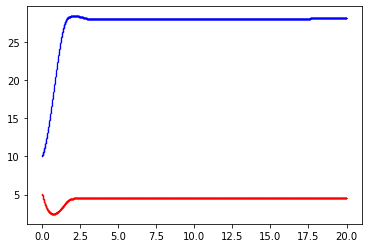

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338100.png
Epoch [00600/50000] Loss:0.187327 Loss_1:0.000958 Loss_2:0.186369 Lr:0.006250 Time:1.288194s
Epoch [00700/50000] Loss:0.187999 Loss_1:0.004394 Loss_2:0.183605 Lr:0.005882 Time:0.791157s
Epoch [00800/50000] Loss:0.191862 Loss_1:0.008849 Loss_2:0.183013 Lr:0.005556 Time:0.791351s
Epoch [00900/50000] Loss:0.171719 Loss_1:0.004310 Loss_2:0.167409 Lr:0.005263 Time:0.795263s
Epoch [01000/50000] Loss:0.175206 Loss_1:0.015682 Loss_2:0.159524 Lr:0.005000 Time:0.790680s
Testing & drawing...
u= [9.94303, 9.947569, 9.952129, 9.956718, 9.961331, 9.965972, 9.970632, 9.975322, 9.980037, 9.984772] ... [27.919569, 27.919569, 27.919569, 27.919569, 27.919569, 27.919569, 27.919569, 27.919569, 27.919569, 27.919569]
v= [4.8680067, 4.8600926, 4.852166, 4.8442173, 4.836254, 4.828275, 4.8202877, 4.8122835, 4.804266, 4.7962446] ... [4.535506, 4.535506, 4.5355053, 4.535505, 4

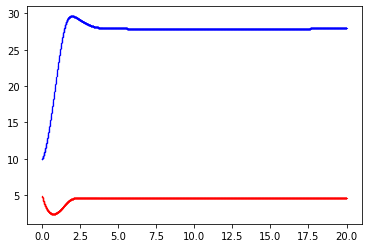

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338104.png
Epoch [01100/50000] Loss:0.156296 Loss_1:0.005931 Loss_2:0.150366 Lr:0.004762 Time:1.334906s
Epoch [01200/50000] Loss:0.193348 Loss_1:0.034154 Loss_2:0.159193 Lr:0.004545 Time:0.811385s
Epoch [01300/50000] Loss:0.114809 Loss_1:0.000194 Loss_2:0.114616 Lr:0.004348 Time:0.791262s
Epoch [01400/50000] Loss:0.108993 Loss_1:0.000892 Loss_2:0.108101 Lr:0.004167 Time:0.791589s
Epoch [01500/50000] Loss:0.129042 Loss_1:0.012475 Loss_2:0.116568 Lr:0.004000 Time:0.794257s
Testing & drawing...
u= [9.946232, 9.950512, 9.954815, 9.959156, 9.963524, 9.967922, 9.972351, 9.97681, 9.9813, 9.985821] ... [27.839674, 27.839674, 27.839674, 27.839672, 27.839672, 27.839674, 27.839674, 27.839672, 27.839672, 27.839674]
v= [4.8850784, 4.877113, 4.8691325, 4.861131, 4.853115, 4.845084, 4.8370447, 4.828988, 4.8209214, 4.8128505] ... [4.53908, 4.539079, 4.5390787, 4.539078, 4.539

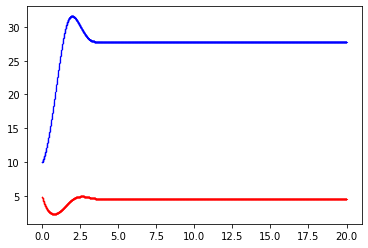

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338109.png
Epoch [01600/50000] Loss:0.100763 Loss_1:0.002216 Loss_2:0.098548 Lr:0.003846 Time:1.302704s
Epoch [01700/50000] Loss:0.096308 Loss_1:0.000760 Loss_2:0.095548 Lr:0.003704 Time:0.791449s
Epoch [01800/50000] Loss:0.132574 Loss_1:0.012359 Loss_2:0.120215 Lr:0.003571 Time:0.791396s
Epoch [01900/50000] Loss:0.103549 Loss_1:0.006831 Loss_2:0.096718 Lr:0.003448 Time:0.790960s
Epoch [02000/50000] Loss:0.094973 Loss_1:0.004413 Loss_2:0.090560 Lr:0.003333 Time:0.791331s
Testing & drawing...
u= [9.982896, 9.987462, 9.992061, 9.996693, 10.001361, 10.006057, 10.010787, 10.0155525, 10.02035, 10.02518] ... [27.829563, 27.829563, 27.829561, 27.829561, 27.829561, 27.829556, 27.829556, 27.829552, 27.829552, 27.829552]
v= [4.9540997, 4.94608, 4.9380426, 4.9299817, 4.9219036, 4.913807, 4.9057007, 4.8975744, 4.8894362, 4.8812914] ... [4.5341887, 4.5341887, 4.534188, 4.5

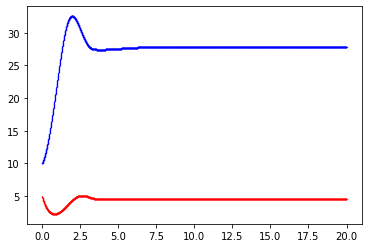

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338113.png
Epoch [02100/50000] Loss:0.083862 Loss_1:0.001681 Loss_2:0.082181 Lr:0.003226 Time:1.337145s
Epoch [02200/50000] Loss:0.079583 Loss_1:0.000989 Loss_2:0.078594 Lr:0.003125 Time:0.791753s
Epoch [02300/50000] Loss:0.075382 Loss_1:0.000511 Loss_2:0.074871 Lr:0.003030 Time:0.791821s
Epoch [02400/50000] Loss:0.109719 Loss_1:0.009165 Loss_2:0.100555 Lr:0.002941 Time:0.792368s
Epoch [02500/50000] Loss:0.121972 Loss_1:0.012907 Loss_2:0.109065 Lr:0.002857 Time:0.791067s
Testing & drawing...
u= [10.098196, 10.103518, 10.108869, 10.114259, 10.11968, 10.1251335, 10.130618, 10.136136, 10.141689, 10.147269] ... [27.828283, 27.828281, 27.828281, 27.828281, 27.82828, 27.828278, 27.828276, 27.828276, 27.828276, 27.828276]
v= [5.153359, 5.1460285, 5.1386547, 5.131229, 5.1237564, 5.116239, 5.1086802, 5.1010733, 5.0934234, 5.0857353] ... [4.516388, 4.5163875, 4.516387, 

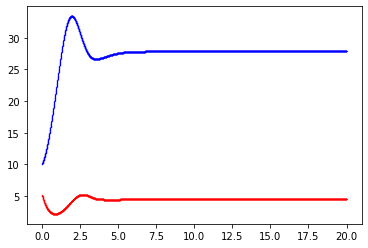

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338118.png
Epoch [02600/50000] Loss:0.067146 Loss_1:0.000030 Loss_2:0.067116 Lr:0.002778 Time:1.294525s
Epoch [02700/50000] Loss:0.068398 Loss_1:0.001321 Loss_2:0.067076 Lr:0.002703 Time:0.792456s
Epoch [02800/50000] Loss:0.082498 Loss_1:0.003776 Loss_2:0.078723 Lr:0.002632 Time:0.792296s
Epoch [02900/50000] Loss:0.061250 Loss_1:0.000071 Loss_2:0.061179 Lr:0.002564 Time:0.813035s
Epoch [03000/50000] Loss:0.060565 Loss_1:0.000696 Loss_2:0.059869 Lr:0.002500 Time:0.791159s
Testing & drawing...
u= [9.974003, 9.97827, 9.982571, 9.98691, 9.991289, 9.995704, 10.000154, 10.0046425, 10.009169, 10.013729] ... [27.820423, 27.82042, 27.82042, 27.820415, 27.820415, 27.820414, 27.820412, 27.82041, 27.820408, 27.820406]
v= [4.95298, 4.9449663, 4.936934, 4.9288745, 4.920793, 4.912693, 4.9045787, 4.896443, 4.8882904, 4.88013] ... [4.536765, 4.5367646, 4.5367637, 4.5367637, 4.

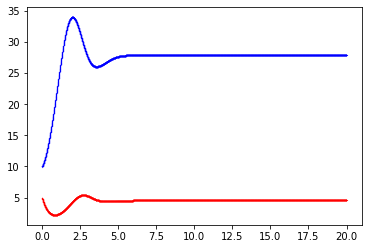

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338122.png
Epoch [03100/50000] Loss:0.056093 Loss_1:0.000023 Loss_2:0.056071 Lr:0.002439 Time:1.295051s
Epoch [03200/50000] Loss:0.056208 Loss_1:0.000540 Loss_2:0.055668 Lr:0.002381 Time:0.795257s
Epoch [03300/50000] Loss:0.052290 Loss_1:0.000860 Loss_2:0.051430 Lr:0.002326 Time:0.791635s
Epoch [03400/50000] Loss:0.057802 Loss_1:0.001973 Loss_2:0.055829 Lr:0.002273 Time:0.791535s
Epoch [03500/50000] Loss:0.054781 Loss_1:0.002683 Loss_2:0.052097 Lr:0.002222 Time:0.793013s
Testing & drawing...
u= [9.992528, 9.997019, 10.001543, 10.006109, 10.010711, 10.015353, 10.020026, 10.024741, 10.029495, 10.034283] ... [27.820124, 27.820124, 27.820124, 27.820124, 27.820124, 27.820124, 27.820124, 27.820124, 27.82012, 27.82012]
v= [4.9767284, 4.9684987, 4.960258, 4.9519987, 4.943727, 4.9354453, 4.9271574, 4.918858, 4.9105496, 4.9022408] ... [4.531429, 4.531429, 4.5314283, 4.5

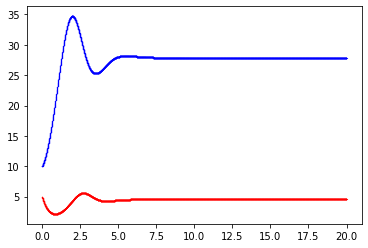

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338127.png
Epoch [03600/50000] Loss:0.056935 Loss_1:0.001983 Loss_2:0.054951 Lr:0.002174 Time:1.344917s
Epoch [03700/50000] Loss:0.057604 Loss_1:0.003739 Loss_2:0.053865 Lr:0.002128 Time:0.815700s
Epoch [03800/50000] Loss:0.041269 Loss_1:0.000146 Loss_2:0.041123 Lr:0.002083 Time:0.794589s
Epoch [03900/50000] Loss:0.053804 Loss_1:0.002038 Loss_2:0.051766 Lr:0.002041 Time:0.796459s
Epoch [04000/50000] Loss:0.050288 Loss_1:0.002652 Loss_2:0.047636 Lr:0.002000 Time:0.791785s
Testing & drawing...
u= [9.951191, 9.95509, 9.95902, 9.962987, 9.9669895, 9.971026, 9.975095, 9.979204, 9.983344, 9.987519] ... [27.857353, 27.857353, 27.857353, 27.857353, 27.85735, 27.857346, 27.857346, 27.857346, 27.857346, 27.857346]
v= [4.920088, 4.9119024, 4.903717, 4.8955226, 4.8873253, 4.8791275, 4.870933, 4.8627353, 4.85454, 4.8463516] ... [4.5449643, 4.5449634, 4.5449624, 4.544962, 4

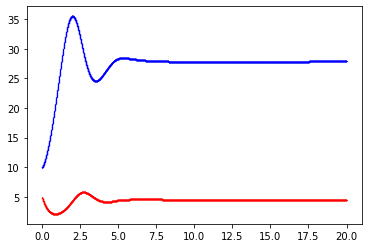

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338131.png
Epoch [04100/50000] Loss:0.036086 Loss_1:0.000437 Loss_2:0.035649 Lr:0.001961 Time:1.299294s
Epoch [04200/50000] Loss:0.036591 Loss_1:0.000591 Loss_2:0.036000 Lr:0.001923 Time:0.796023s
Epoch [04300/50000] Loss:0.033583 Loss_1:0.000729 Loss_2:0.032855 Lr:0.001887 Time:0.791466s
Epoch [04400/50000] Loss:0.029233 Loss_1:0.000041 Loss_2:0.029192 Lr:0.001852 Time:0.791724s
Epoch [04500/50000] Loss:0.028338 Loss_1:0.000200 Loss_2:0.028139 Lr:0.001818 Time:0.791633s
Testing & drawing...
u= [9.993987, 9.998792, 10.003628, 10.008495, 10.013393, 10.018326, 10.023279, 10.028273, 10.033294, 10.038344] ... [27.829409, 27.829405, 27.829405, 27.829405, 27.829405, 27.829403, 27.829403, 27.829403, 27.8294, 27.8294]
v= [4.988567, 4.980091, 4.9716067, 4.9631057, 4.9545927, 4.9460707, 4.9375453, 4.9290075, 4.920464, 4.911921] ... [4.5339766, 4.5339756, 4.5339746, 4.53

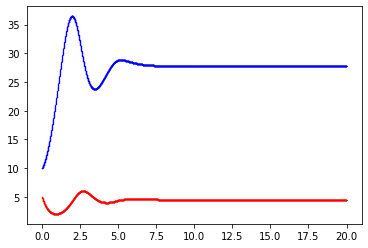

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338136.png
Epoch [04600/50000] Loss:0.028230 Loss_1:0.000254 Loss_2:0.027976 Lr:0.001786 Time:1.306351s
Epoch [04700/50000] Loss:0.040579 Loss_1:0.002796 Loss_2:0.037783 Lr:0.001754 Time:0.791524s
Epoch [04800/50000] Loss:0.031208 Loss_1:0.001389 Loss_2:0.029818 Lr:0.001724 Time:0.793563s
Epoch [04900/50000] Loss:0.037303 Loss_1:0.002690 Loss_2:0.034612 Lr:0.001695 Time:0.791177s
Epoch [05000/50000] Loss:0.022867 Loss_1:0.000017 Loss_2:0.022851 Lr:0.001667 Time:0.791338s
Testing & drawing...
u= [10.012272, 10.017234, 10.02222, 10.027239, 10.0322895, 10.037367, 10.04247, 10.047607, 10.052772, 10.057962] ... [27.821196, 27.821196, 27.821194, 27.821194, 27.821192, 27.821192, 27.821192, 27.821192, 27.82119, 27.82119]
v= [5.0110826, 5.002495, 4.9939013, 4.9852924, 4.9766755, 4.968051, 4.9594254, 4.9507895, 4.942151, 4.9335136] ... [4.5291753, 4.529174, 4.529174, 4.

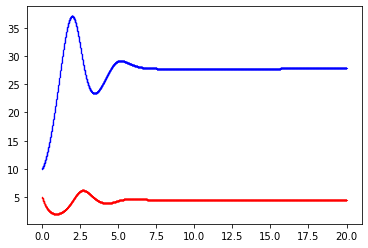

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338140.png
Epoch [05100/50000] Loss:0.022033 Loss_1:0.000003 Loss_2:0.022031 Lr:0.001639 Time:1.381593s
Epoch [05200/50000] Loss:0.021316 Loss_1:0.000029 Loss_2:0.021287 Lr:0.001613 Time:0.791447s
Epoch [05300/50000] Loss:0.041778 Loss_1:0.003839 Loss_2:0.037939 Lr:0.001587 Time:0.791872s
Epoch [05400/50000] Loss:0.055049 Loss_1:0.005837 Loss_2:0.049213 Lr:0.001563 Time:0.812339s
Epoch [05500/50000] Loss:0.019113 Loss_1:0.000067 Loss_2:0.019046 Lr:0.001538 Time:0.791189s
Testing & drawing...
u= [9.998629, 10.003531, 10.008456, 10.013415, 10.018401, 10.0234165, 10.028459, 10.033531, 10.038633, 10.04376] ... [27.825287, 27.825287, 27.825285, 27.825285, 27.825285, 27.825285, 27.825283, 27.825283, 27.825283, 27.825283]
v= [4.995308, 4.9867163, 4.978122, 4.9695144, 4.960901, 4.9522815, 4.943662, 4.9350357, 4.926407, 4.9177823] ... [4.5305285, 4.5305285, 4.530528, 4

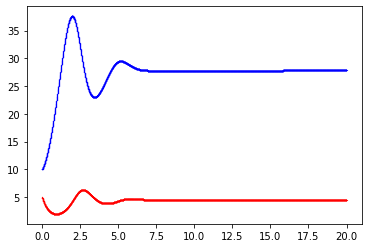

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338145.png
Epoch [05600/50000] Loss:0.018320 Loss_1:0.000002 Loss_2:0.018318 Lr:0.001515 Time:1.284778s
Epoch [05700/50000] Loss:0.017735 Loss_1:0.000005 Loss_2:0.017730 Lr:0.001493 Time:0.792643s
Epoch [05800/50000] Loss:0.017537 Loss_1:0.000020 Loss_2:0.017517 Lr:0.001471 Time:0.792630s
Epoch [05900/50000] Loss:0.052062 Loss_1:0.005404 Loss_2:0.046658 Lr:0.001449 Time:0.790988s
Epoch [06000/50000] Loss:0.015877 Loss_1:0.000009 Loss_2:0.015868 Lr:0.001429 Time:0.791672s
Testing & drawing...
u= [10.003014, 10.007954, 10.012919, 10.017915, 10.022938, 10.027988, 10.033063, 10.038168, 10.043301, 10.048459] ... [27.831442, 27.831442, 27.831442, 27.831438, 27.831438, 27.831438, 27.831438, 27.831438, 27.831438, 27.831438]
v= [5.0009856, 4.9923353, 4.9836826, 4.9750195, 4.9663515, 4.9576807, 4.9490113, 4.9403367, 4.931662, 4.922993] ... [4.529926, 4.5299253, 4.529925

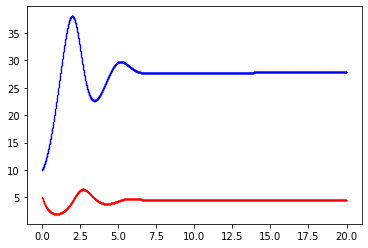

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338149.png
Epoch [06100/50000] Loss:0.017282 Loss_1:0.000203 Loss_2:0.017080 Lr:0.001408 Time:1.269592s
Epoch [06200/50000] Loss:0.015111 Loss_1:0.000006 Loss_2:0.015105 Lr:0.001389 Time:0.813025s
Epoch [06300/50000] Loss:0.022442 Loss_1:0.000717 Loss_2:0.021724 Lr:0.001370 Time:0.791460s
Epoch [06400/50000] Loss:0.013950 Loss_1:0.000010 Loss_2:0.013941 Lr:0.001351 Time:0.791490s
Epoch [06500/50000] Loss:0.013660 Loss_1:0.000033 Loss_2:0.013627 Lr:0.001333 Time:0.798805s
Testing & drawing...
u= [10.0046625, 10.009589, 10.014539, 10.019519, 10.024527, 10.029558, 10.034618, 10.039706, 10.044822, 10.04996] ... [27.839386, 27.839388, 27.839388, 27.839388, 27.839388, 27.839388, 27.839388, 27.839388, 27.839386, 27.839384]
v= [5.002825, 4.9941955, 4.9855638, 4.9769206, 4.968273, 4.959622, 4.9509726, 4.942317, 4.9336596, 4.9250083] ... [4.52912, 4.529119, 4.529119, 4.

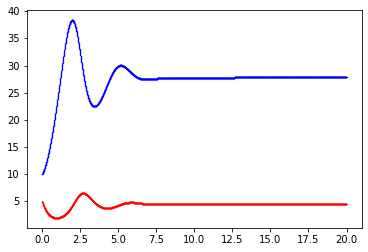

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338154.png
Epoch [06600/50000] Loss:0.012747 Loss_1:0.000001 Loss_2:0.012746 Lr:0.001316 Time:1.348218s
Epoch [06700/50000] Loss:0.012474 Loss_1:0.000018 Loss_2:0.012456 Lr:0.001299 Time:0.792209s
Epoch [06800/50000] Loss:0.027369 Loss_1:0.002531 Loss_2:0.024838 Lr:0.001282 Time:0.795316s
Epoch [06900/50000] Loss:0.011435 Loss_1:0.000013 Loss_2:0.011423 Lr:0.001266 Time:0.791505s
Epoch [07000/50000] Loss:0.012955 Loss_1:0.000011 Loss_2:0.012944 Lr:0.001250 Time:0.794480s
Testing & drawing...
u= [10.024511, 10.029565, 10.034642, 10.039745, 10.044877, 10.050034, 10.055213, 10.060421, 10.065657, 10.070912] ... [27.822632, 27.822628, 27.822628, 27.822628, 27.822628, 27.822624, 27.822624, 27.822624, 27.822624, 27.822624]
v= [5.0317287, 5.0231705, 5.014608, 5.006033, 4.9974527, 4.988867, 4.980283, 4.9716907, 4.963095, 4.954505] ... [4.5265965, 4.5265965, 4.526596, 4

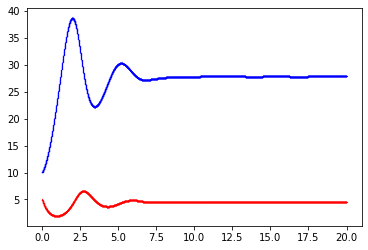

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338158.png
Epoch [07100/50000] Loss:0.010600 Loss_1:0.000003 Loss_2:0.010598 Lr:0.001235 Time:1.305730s
Epoch [07200/50000] Loss:0.011312 Loss_1:0.000128 Loss_2:0.011184 Lr:0.001220 Time:0.793795s
Epoch [07300/50000] Loss:0.009948 Loss_1:0.000003 Loss_2:0.009946 Lr:0.001205 Time:0.791421s
Epoch [07400/50000] Loss:0.010218 Loss_1:0.000037 Loss_2:0.010181 Lr:0.001190 Time:0.791172s
Epoch [07500/50000] Loss:0.021966 Loss_1:0.001700 Loss_2:0.020266 Lr:0.001176 Time:0.791496s
Testing & drawing...
u= [10.055562, 10.060716, 10.065891, 10.071095, 10.076325, 10.081581, 10.08686, 10.092164, 10.097492, 10.102847] ... [27.806894, 27.806894, 27.806894, 27.80689, 27.80689, 27.806887, 27.806887, 27.806883, 27.806879, 27.806879]
v= [5.053914, 5.04519, 5.0364623, 5.0277214, 5.0189734, 5.0102196, 5.001466, 4.992703, 4.9839396, 4.9751787] ... [4.526027, 4.526027, 4.5260267, 4.52

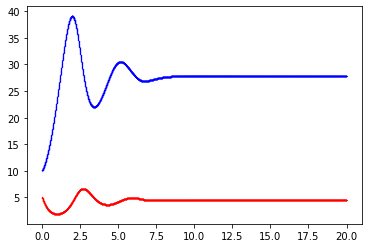

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338163.png
Epoch [07600/50000] Loss:0.009141 Loss_1:0.000001 Loss_2:0.009140 Lr:0.001163 Time:1.354447s
Epoch [07700/50000] Loss:0.010431 Loss_1:0.000258 Loss_2:0.010173 Lr:0.001149 Time:0.791463s
Epoch [07800/50000] Loss:0.009375 Loss_1:0.000092 Loss_2:0.009283 Lr:0.001136 Time:0.791219s
Epoch [07900/50000] Loss:0.008375 Loss_1:0.000005 Loss_2:0.008370 Lr:0.001124 Time:0.818942s
Epoch [08000/50000] Loss:0.010111 Loss_1:0.000215 Loss_2:0.009895 Lr:0.001111 Time:0.791309s
Testing & drawing...
u= [10.021721, 10.026792, 10.031881, 10.037002, 10.042144, 10.047312, 10.052503, 10.057718, 10.062963, 10.068226] ... [27.813864, 27.81386, 27.813856, 27.813856, 27.813856, 27.813856, 27.813852, 27.813852, 27.813848, 27.813848]
v= [5.0200686, 5.011418, 5.0027666, 4.9941044, 4.9854383, 4.9767714, 4.968107, 4.959438, 4.9507685, 4.9421053] ... [4.530986, 4.530986, 4.530986, 4

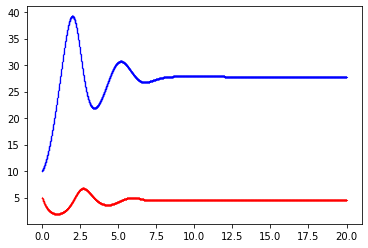

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338167.png
Epoch [08100/50000] Loss:0.007900 Loss_1:0.000041 Loss_2:0.007860 Lr:0.001099 Time:1.286080s
Epoch [08200/50000] Loss:0.007597 Loss_1:0.000011 Loss_2:0.007585 Lr:0.001087 Time:0.792007s
Epoch [08300/50000] Loss:0.023297 Loss_1:0.001652 Loss_2:0.021646 Lr:0.001075 Time:0.795254s
Epoch [08400/50000] Loss:0.007008 Loss_1:0.000003 Loss_2:0.007005 Lr:0.001064 Time:0.792062s
Epoch [08500/50000] Loss:0.006946 Loss_1:0.000003 Loss_2:0.006943 Lr:0.001053 Time:0.791025s
Testing & drawing...
u= [10.005764, 10.0107765, 10.015811, 10.020874, 10.025959, 10.031065, 10.0362, 10.041356, 10.046537, 10.051741] ... [27.795935, 27.79593, 27.79593, 27.79593, 27.795927, 27.795927, 27.795927, 27.795927, 27.795923, 27.79592]
v= [5.0056353, 4.996911, 4.98819, 4.9794617, 4.970733, 4.9620047, 4.9532824, 4.944558, 4.935837, 4.9271255] ... [4.532319, 4.5323186, 4.532318, 4.53231

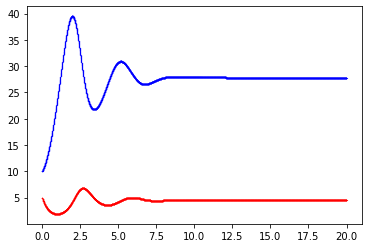

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338172.png
Epoch [08600/50000] Loss:0.044505 Loss_1:0.004952 Loss_2:0.039554 Lr:0.001042 Time:1.296196s
Epoch [08700/50000] Loss:0.006461 Loss_1:0.000000 Loss_2:0.006461 Lr:0.001031 Time:0.810170s
Epoch [08800/50000] Loss:0.011996 Loss_1:0.000802 Loss_2:0.011194 Lr:0.001020 Time:0.792048s
Epoch [08900/50000] Loss:0.006095 Loss_1:0.000001 Loss_2:0.006094 Lr:0.001010 Time:0.791235s
Epoch [09000/50000] Loss:0.008021 Loss_1:0.000315 Loss_2:0.007706 Lr:0.001000 Time:0.791324s
Testing & drawing...
u= [9.988234, 9.99316, 9.998111, 10.003086, 10.008085, 10.013105, 10.018147, 10.023214, 10.02831, 10.033423] ... [27.800112, 27.80011, 27.800108, 27.800108, 27.800106, 27.800104, 27.800104, 27.800104, 27.800102, 27.800102]
v= [4.9938974, 4.9851956, 4.9765015, 4.967805, 4.9591107, 4.9504204, 4.9417405, 4.93306, 4.924388, 4.9157267] ... [4.529417, 4.5294166, 4.529415, 4.5294

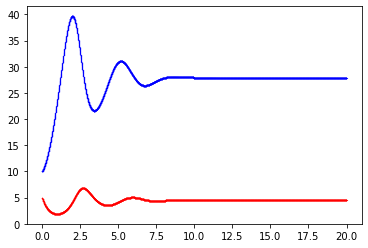

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338176.png
Epoch [09100/50000] Loss:0.005753 Loss_1:0.000001 Loss_2:0.005752 Lr:0.000990 Time:1.381522s
Epoch [09200/50000] Loss:0.005796 Loss_1:0.000000 Loss_2:0.005796 Lr:0.000980 Time:0.791833s
Epoch [09300/50000] Loss:0.005487 Loss_1:0.000002 Loss_2:0.005485 Lr:0.000971 Time:0.793758s
Epoch [09400/50000] Loss:0.005622 Loss_1:0.000029 Loss_2:0.005592 Lr:0.000962 Time:0.791400s
Epoch [09500/50000] Loss:0.005208 Loss_1:0.000000 Loss_2:0.005208 Lr:0.000952 Time:0.792327s
Testing & drawing...
u= [10.002169, 10.007201, 10.012249, 10.0173235, 10.022421, 10.02754, 10.03268, 10.037846, 10.043033, 10.04824] ... [27.825516, 27.825516, 27.825516, 27.825512, 27.825512, 27.825508, 27.825508, 27.825508, 27.825508, 27.825508]
v= [5.001641, 4.9928274, 4.98402, 4.9752107, 4.9664063, 4.9576054, 4.948817, 4.940029, 4.9312496, 4.922483] ... [4.5278273, 4.527827, 4.527825, 4.52

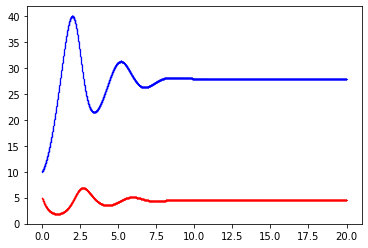

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338181.png
Epoch [09600/50000] Loss:0.005265 Loss_1:0.000010 Loss_2:0.005255 Lr:0.000943 Time:1.284698s
Epoch [09700/50000] Loss:0.005010 Loss_1:0.000001 Loss_2:0.005009 Lr:0.000935 Time:0.791455s
Epoch [09800/50000] Loss:0.005214 Loss_1:0.000031 Loss_2:0.005183 Lr:0.000926 Time:0.791359s
Epoch [09900/50000] Loss:0.004859 Loss_1:0.000001 Loss_2:0.004858 Lr:0.000917 Time:0.797155s
Epoch [10000/50000] Loss:0.006663 Loss_1:0.000206 Loss_2:0.006457 Lr:0.000909 Time:0.791193s
Testing & drawing...
u= [10.006164, 10.0112505, 10.016356, 10.021487, 10.026639, 10.031815, 10.037009, 10.042228, 10.047472, 10.052736] ... [27.837193, 27.83719, 27.83719, 27.83719, 27.83719, 27.83719, 27.83719, 27.83719, 27.83719, 27.83719]
v= [5.0083456, 4.999571, 4.990805, 4.9820356, 4.973271, 4.9645104, 4.9557614, 4.947012, 4.9382706, 4.9295416] ... [4.5300784, 4.5300775, 4.530077, 4.53007

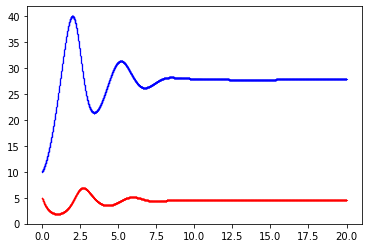

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338185.png
Epoch [10100/50000] Loss:0.004666 Loss_1:0.000001 Loss_2:0.004665 Lr:0.000901 Time:1.301622s
Epoch [10200/50000] Loss:0.006099 Loss_1:0.000151 Loss_2:0.005947 Lr:0.000893 Time:0.796868s
Epoch [10300/50000] Loss:0.004536 Loss_1:0.000001 Loss_2:0.004535 Lr:0.000885 Time:0.791447s
Epoch [10400/50000] Loss:0.008646 Loss_1:0.000167 Loss_2:0.008479 Lr:0.000877 Time:0.808042s
Epoch [10500/50000] Loss:0.004386 Loss_1:0.000001 Loss_2:0.004385 Lr:0.000870 Time:0.791037s
Testing & drawing...
u= [10.000974, 10.006009, 10.0110655, 10.016142, 10.021243, 10.026366, 10.031507, 10.036676, 10.041865, 10.047074] ... [27.843235, 27.843235, 27.843235, 27.843235, 27.843235, 27.843235, 27.843235, 27.843235, 27.843235, 27.843235]
v= [5.0003304, 4.9914975, 4.9826727, 4.9738474, 4.965028, 4.9562154, 4.947415, 4.9386163, 4.929828, 4.9210544] ... [4.528322, 4.5283213, 4.528320

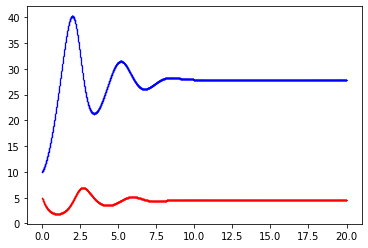

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338190.png
Epoch [10600/50000] Loss:0.004834 Loss_1:0.000036 Loss_2:0.004798 Lr:0.000862 Time:1.348404s
Epoch [10700/50000] Loss:0.004251 Loss_1:0.000001 Loss_2:0.004250 Lr:0.000855 Time:0.791402s
Epoch [10800/50000] Loss:0.004880 Loss_1:0.000050 Loss_2:0.004830 Lr:0.000847 Time:0.790658s
Epoch [10900/50000] Loss:0.004159 Loss_1:0.000001 Loss_2:0.004159 Lr:0.000840 Time:0.791296s
Epoch [11000/50000] Loss:0.040996 Loss_1:0.003495 Loss_2:0.037501 Lr:0.000833 Time:0.792121s
Testing & drawing...
u= [10.079293, 10.084325, 10.089376, 10.094455, 10.099557, 10.104682, 10.109825, 10.114997, 10.120191, 10.125405] ... [27.819807, 27.819807, 27.819805, 27.819805, 27.819805, 27.819805, 27.819805, 27.819805, 27.819807, 27.819807]
v= [5.0741158, 5.0654874, 5.0568633, 5.0482354, 5.039608, 5.030983, 5.022367, 5.013749, 5.0051365, 4.9965343] ... [4.5206614, 4.5206614, 4.5206614

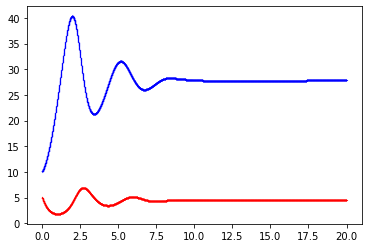

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338194.png
Epoch [11100/50000] Loss:0.004074 Loss_1:0.000000 Loss_2:0.004074 Lr:0.000826 Time:1.297274s
Epoch [11200/50000] Loss:0.003941 Loss_1:0.000001 Loss_2:0.003939 Lr:0.000820 Time:0.792469s
Epoch [11300/50000] Loss:0.003992 Loss_1:0.000003 Loss_2:0.003989 Lr:0.000813 Time:0.798554s
Epoch [11400/50000] Loss:0.003849 Loss_1:0.000000 Loss_2:0.003849 Lr:0.000806 Time:0.791591s
Epoch [11500/50000] Loss:0.003933 Loss_1:0.000004 Loss_2:0.003930 Lr:0.000800 Time:0.791029s
Testing & drawing...
u= [10.002539, 10.007578, 10.012635, 10.01772, 10.022822, 10.027949, 10.033096, 10.038268, 10.043461, 10.048675] ... [27.844816, 27.844816, 27.844816, 27.844816, 27.844816, 27.844816, 27.844816, 27.844816, 27.844816, 27.844816]
v= [5.0022774, 4.993448, 4.984627, 4.975806, 4.966992, 4.958185, 4.9493904, 4.9405985, 4.9318166, 4.92305] ... [4.528715, 4.528715, 4.528715, 4.528

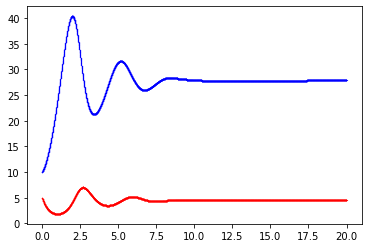

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338199.png
Epoch [11600/50000] Loss:0.003756 Loss_1:0.000001 Loss_2:0.003755 Lr:0.000794 Time:1.304356s
Epoch [11700/50000] Loss:0.003896 Loss_1:0.000019 Loss_2:0.003877 Lr:0.000787 Time:0.791933s
Epoch [11800/50000] Loss:0.003662 Loss_1:0.000001 Loss_2:0.003662 Lr:0.000781 Time:0.791226s
Epoch [11900/50000] Loss:0.003750 Loss_1:0.000000 Loss_2:0.003750 Lr:0.000775 Time:0.791554s
Epoch [12000/50000] Loss:0.003599 Loss_1:0.000001 Loss_2:0.003598 Lr:0.000769 Time:0.808076s
Testing & drawing...
u= [10.000872, 10.005912, 10.01097, 10.016053, 10.02116, 10.026289, 10.031436, 10.036606, 10.041801, 10.047015] ... [27.843222, 27.843222, 27.843222, 27.843222, 27.843224, 27.843224, 27.843224, 27.843224, 27.843224, 27.843224]
v= [5.000354, 4.9914985, 4.9826536, 4.9738097, 4.964973, 4.956144, 4.9473286, 4.938517, 4.929716, 4.9209313] ... [4.52993, 4.52993, 4.52993, 4.52993

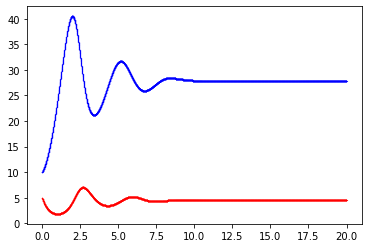

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338203.png
Epoch [12100/50000] Loss:0.023456 Loss_1:0.002666 Loss_2:0.020789 Lr:0.000763 Time:1.362645s
Epoch [12200/50000] Loss:0.003526 Loss_1:0.000000 Loss_2:0.003526 Lr:0.000758 Time:0.790669s
Epoch [12300/50000] Loss:0.003594 Loss_1:0.000012 Loss_2:0.003582 Lr:0.000752 Time:0.790933s
Epoch [12400/50000] Loss:0.003474 Loss_1:0.000001 Loss_2:0.003474 Lr:0.000746 Time:0.791269s
Epoch [12500/50000] Loss:0.003357 Loss_1:0.000000 Loss_2:0.003356 Lr:0.000741 Time:0.801680s
Testing & drawing...
u= [10.00082, 10.005861, 10.010924, 10.016009, 10.021118, 10.026248, 10.031398, 10.0365715, 10.041766, 10.046982] ... [27.835299, 27.835299, 27.835299, 27.835299, 27.835299, 27.835295, 27.835295, 27.835295, 27.835295, 27.835295]
v= [5.0003223, 4.9914575, 4.982603, 4.973751, 4.964906, 4.95607, 4.9472485, 4.9384313, 4.929624, 4.920835] ... [4.5318985, 4.531899, 4.5318995, 4.

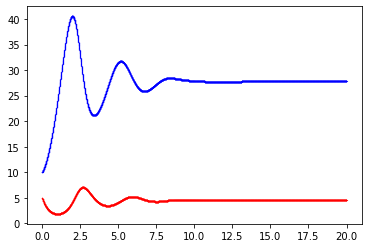

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338208.png
Epoch [12600/50000] Loss:0.003570 Loss_1:0.000036 Loss_2:0.003535 Lr:0.000735 Time:1.294718s
Epoch [12700/50000] Loss:0.003271 Loss_1:0.000000 Loss_2:0.003271 Lr:0.000730 Time:0.791171s
Epoch [12800/50000] Loss:0.003402 Loss_1:0.000018 Loss_2:0.003383 Lr:0.000725 Time:0.814262s
Epoch [12900/50000] Loss:0.003204 Loss_1:0.000000 Loss_2:0.003203 Lr:0.000719 Time:0.791255s
Epoch [13000/50000] Loss:0.003736 Loss_1:0.000075 Loss_2:0.003662 Lr:0.000714 Time:0.791352s
Testing & drawing...
u= [10.003614, 10.00865, 10.013705, 10.0187845, 10.023888, 10.029011, 10.034155, 10.039322, 10.044514, 10.049725] ... [27.826214, 27.826214, 27.826212, 27.82621, 27.826208, 27.826208, 27.826206, 27.826206, 27.826204, 27.826204]
v= [5.0073886, 4.9985504, 4.9897246, 4.9808984, 4.972081, 4.9632716, 4.9544754, 4.945684, 4.936903, 4.9281387] ... [4.5330725, 4.533073, 4.533073, 

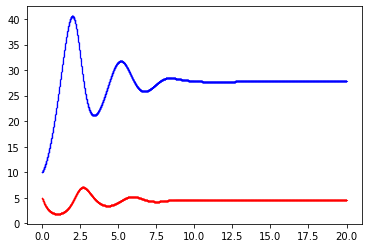

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338212.png
Epoch [13100/50000] Loss:0.003121 Loss_1:0.000000 Loss_2:0.003121 Lr:0.000709 Time:1.329275s
Epoch [13200/50000] Loss:0.003384 Loss_1:0.000021 Loss_2:0.003362 Lr:0.000704 Time:0.791472s
Epoch [13300/50000] Loss:0.003056 Loss_1:0.000000 Loss_2:0.003055 Lr:0.000699 Time:0.791667s
Epoch [13400/50000] Loss:0.003128 Loss_1:0.000013 Loss_2:0.003116 Lr:0.000694 Time:0.793029s
Epoch [13500/50000] Loss:0.002977 Loss_1:0.000000 Loss_2:0.002977 Lr:0.000690 Time:0.791219s
Testing & drawing...
u= [10.000913, 10.005957, 10.011019, 10.016107, 10.021217, 10.026349, 10.031498, 10.036673, 10.041869, 10.047086] ... [27.810606, 27.810602, 27.810598, 27.810598, 27.810595, 27.81059, 27.81059, 27.810587, 27.810587, 27.810587]
v= [5.000599, 4.9917207, 4.9828544, 4.973991, 4.965136, 4.9562893, 4.9474587, 4.9386344, 4.92982, 4.9210234] ... [4.534215, 4.534216, 4.5342164, 4.5

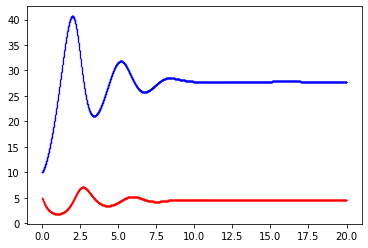

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338217.png
Epoch [13600/50000] Loss:0.003048 Loss_1:0.000012 Loss_2:0.003036 Lr:0.000685 Time:1.315826s
Epoch [13700/50000] Loss:0.002900 Loss_1:0.000000 Loss_2:0.002900 Lr:0.000680 Time:0.793377s
Epoch [13800/50000] Loss:0.002957 Loss_1:0.000005 Loss_2:0.002952 Lr:0.000676 Time:0.791439s
Epoch [13900/50000] Loss:0.002840 Loss_1:0.000000 Loss_2:0.002840 Lr:0.000671 Time:0.791392s
Epoch [14000/50000] Loss:0.002919 Loss_1:0.000015 Loss_2:0.002905 Lr:0.000667 Time:0.791694s
Testing & drawing...
u= [9.999624, 10.004654, 10.009701, 10.014774, 10.019869, 10.024988, 10.030123, 10.035286, 10.040468, 10.045673] ... [27.804277, 27.804272, 27.804266, 27.804264, 27.804258, 27.804258, 27.804255, 27.80425, 27.804247, 27.804245]
v= [5.00021, 4.9913507, 4.9825025, 4.973657, 4.9648204, 4.9559927, 4.9471807, 4.9383736, 4.9295783, 4.9208] ... [4.5343356, 4.534336, 4.534336, 4.53

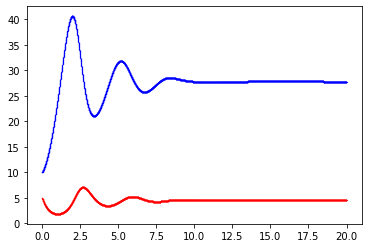

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338221.png
Epoch [14100/50000] Loss:0.002781 Loss_1:0.000000 Loss_2:0.002781 Lr:0.000662 Time:1.282402s
Epoch [14200/50000] Loss:0.002922 Loss_1:0.000017 Loss_2:0.002905 Lr:0.000658 Time:0.791345s
Epoch [14300/50000] Loss:0.002729 Loss_1:0.000000 Loss_2:0.002728 Lr:0.000654 Time:0.790993s
Epoch [14400/50000] Loss:0.003049 Loss_1:0.000025 Loss_2:0.003024 Lr:0.000649 Time:0.791795s
Epoch [14500/50000] Loss:0.002669 Loss_1:0.000000 Loss_2:0.002669 Lr:0.000645 Time:0.813387s
Testing & drawing...
u= [10.000535, 10.005577, 10.010637, 10.015725, 10.020832, 10.025963, 10.03111, 10.036284, 10.041481, 10.046695] ... [27.798323, 27.798315, 27.798311, 27.798307, 27.798304, 27.7983, 27.798296, 27.798292, 27.798288, 27.798285]
v= [5.0001626, 4.9912763, 4.9824014, 4.973531, 4.9646688, 4.955816, 4.94698, 4.93815, 4.9293327, 4.9205327] ... [4.534344, 4.534344, 4.534344, 4.5343

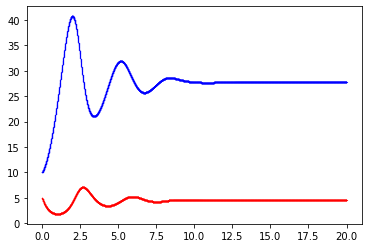

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338225.png
Epoch [14600/50000] Loss:0.002743 Loss_1:0.000015 Loss_2:0.002728 Lr:0.000641 Time:1.364963s
Epoch [14700/50000] Loss:0.002612 Loss_1:0.000000 Loss_2:0.002612 Lr:0.000637 Time:0.790588s
Epoch [14800/50000] Loss:0.002648 Loss_1:0.000003 Loss_2:0.002645 Lr:0.000633 Time:0.791389s
Epoch [14900/50000] Loss:0.002571 Loss_1:0.000001 Loss_2:0.002571 Lr:0.000629 Time:0.791233s
Epoch [15000/50000] Loss:0.002567 Loss_1:0.000001 Loss_2:0.002566 Lr:0.000625 Time:0.791480s
Testing & drawing...
u= [10.000929, 10.005969, 10.011028, 10.01611, 10.021215, 10.026341, 10.031488, 10.036659, 10.041854, 10.047067] ... [27.804216, 27.804209, 27.804209, 27.804209, 27.804201, 27.804201, 27.804197, 27.804197, 27.804193, 27.80419]
v= [5.0007715, 4.991886, 4.9830146, 4.974146, 4.965287, 4.9564376, 4.947605, 4.9387784, 4.9299636, 4.9211664] ... [4.53352, 4.5335197, 4.5335197, 4.

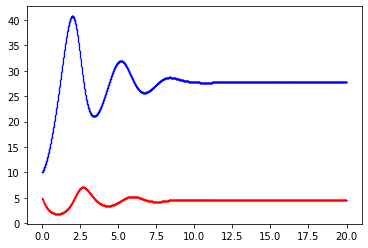

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338230.png
Epoch [15100/50000] Loss:0.002505 Loss_1:0.000000 Loss_2:0.002505 Lr:0.000621 Time:1.284602s
Epoch [15200/50000] Loss:0.002666 Loss_1:0.000016 Loss_2:0.002650 Lr:0.000617 Time:0.791281s
Epoch [15300/50000] Loss:0.002466 Loss_1:0.000000 Loss_2:0.002466 Lr:0.000613 Time:0.808644s
Epoch [15400/50000] Loss:0.030850 Loss_1:0.003099 Loss_2:0.027751 Lr:0.000610 Time:0.790990s
Epoch [15500/50000] Loss:0.002432 Loss_1:0.000001 Loss_2:0.002431 Lr:0.000606 Time:0.790955s
Testing & drawing...
u= [10.000431, 10.00547, 10.010528, 10.015612, 10.020714, 10.025843, 10.030988, 10.0361595, 10.041352, 10.046565] ... [27.806147, 27.806147, 27.80614, 27.80614, 27.806137, 27.806137, 27.806133, 27.806131, 27.80613, 27.80613]
v= [5.0000143, 4.991122, 4.9822435, 4.973367, 4.9645014, 4.955646, 4.9468074, 4.937975, 4.9291563, 4.9203544] ... [4.5322328, 4.5322323, 4.532231, 4.5

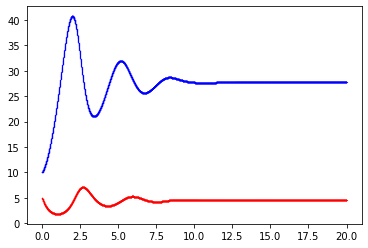

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338234.png
Epoch [15600/50000] Loss:0.002375 Loss_1:0.000000 Loss_2:0.002374 Lr:0.000602 Time:1.292668s
Epoch [15700/50000] Loss:0.012106 Loss_1:0.000584 Loss_2:0.011521 Lr:0.000599 Time:0.791098s
Epoch [15800/50000] Loss:0.002385 Loss_1:0.000000 Loss_2:0.002385 Lr:0.000595 Time:0.798671s
Epoch [15900/50000] Loss:0.002330 Loss_1:0.000000 Loss_2:0.002329 Lr:0.000592 Time:0.793260s
Epoch [16000/50000] Loss:0.002281 Loss_1:0.000000 Loss_2:0.002281 Lr:0.000588 Time:0.791768s
Testing & drawing...
u= [10.000601, 10.005643, 10.010702, 10.015785, 10.020893, 10.02602, 10.031168, 10.036341, 10.041534, 10.046749] ... [27.805143, 27.805138, 27.805136, 27.805136, 27.805134, 27.805132, 27.805132, 27.80513, 27.805126, 27.805126]
v= [5.000381, 4.991473, 4.982581, 4.973693, 4.9648156, 4.95595, 4.947103, 4.9382615, 4.9294343, 4.9206257] ... [4.530795, 4.5307927, 4.530791, 4.530

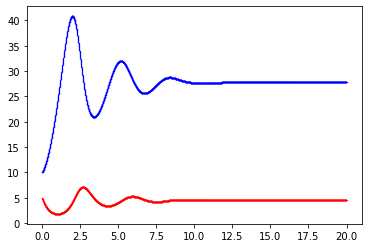

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338239.png
Epoch [16100/50000] Loss:0.002843 Loss_1:0.000074 Loss_2:0.002769 Lr:0.000585 Time:1.367635s
Epoch [16200/50000] Loss:0.002244 Loss_1:0.000000 Loss_2:0.002243 Lr:0.000581 Time:0.792175s
Epoch [16300/50000] Loss:0.059917 Loss_1:0.004985 Loss_2:0.054931 Lr:0.000578 Time:0.790752s
Epoch [16400/50000] Loss:0.002206 Loss_1:0.000001 Loss_2:0.002205 Lr:0.000575 Time:0.791279s
Epoch [16500/50000] Loss:0.002159 Loss_1:0.000000 Loss_2:0.002159 Lr:0.000571 Time:0.793439s
Testing & drawing...
u= [10.000567, 10.005609, 10.010667, 10.015755, 10.020861, 10.0259905, 10.03114, 10.036313, 10.04151, 10.046724] ... [27.803839, 27.803837, 27.803837, 27.803833, 27.803831, 27.803831, 27.80383, 27.803827, 27.803825, 27.803825]
v= [5.000277, 4.991369, 4.9824724, 4.973583, 4.964704, 4.9558363, 4.946987, 4.938144, 4.9293165, 4.920507] ... [4.5299535, 4.529951, 4.5299487, 4.52

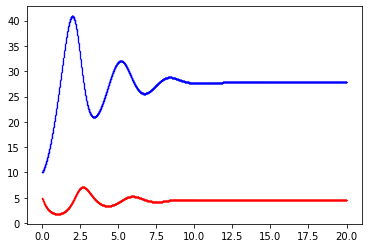

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338243.png
Epoch [16600/50000] Loss:0.002194 Loss_1:0.000001 Loss_2:0.002193 Lr:0.000568 Time:1.289695s
Epoch [16700/50000] Loss:0.002129 Loss_1:0.000000 Loss_2:0.002129 Lr:0.000565 Time:0.791596s
Epoch [16800/50000] Loss:0.010776 Loss_1:0.001128 Loss_2:0.009648 Lr:0.000562 Time:0.791586s
Epoch [16900/50000] Loss:0.002091 Loss_1:0.000000 Loss_2:0.002091 Lr:0.000559 Time:0.793670s
Epoch [17000/50000] Loss:0.004314 Loss_1:0.000155 Loss_2:0.004159 Lr:0.000556 Time:0.794012s
Testing & drawing...
u= [9.987809, 9.992807, 9.997826, 10.002867, 10.007931, 10.013016, 10.018122, 10.0232525, 10.028404, 10.033575] ... [27.81813, 27.818129, 27.818127, 27.818125, 27.818125, 27.818123, 27.818123, 27.818123, 27.818115, 27.818111]
v= [4.982896, 4.974013, 4.965146, 4.9562883, 4.9474416, 4.9386086, 4.9297943, 4.9209886, 4.912199, 4.903429] ... [4.535564, 4.535562, 4.53556, 4.5355

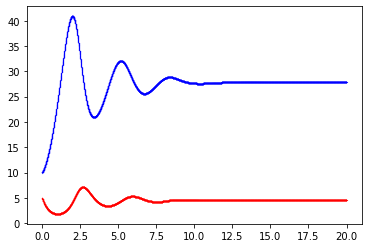

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338248.png
Epoch [17100/50000] Loss:0.002050 Loss_1:0.000000 Loss_2:0.002050 Lr:0.000552 Time:1.308952s
Epoch [17200/50000] Loss:0.002481 Loss_1:0.000032 Loss_2:0.002449 Lr:0.000549 Time:0.791676s
Epoch [17300/50000] Loss:0.002013 Loss_1:0.000001 Loss_2:0.002013 Lr:0.000546 Time:0.791695s
Epoch [17400/50000] Loss:0.001970 Loss_1:0.000000 Loss_2:0.001970 Lr:0.000543 Time:0.791870s
Epoch [17500/50000] Loss:0.002054 Loss_1:0.000016 Loss_2:0.002038 Lr:0.000541 Time:0.793153s
Testing & drawing...
u= [9.998797, 10.003828, 10.008875, 10.013947, 10.019044, 10.02416, 10.029297, 10.034461, 10.039644, 10.044849] ... [27.803625, 27.803625, 27.803625, 27.803621, 27.803621, 27.803616, 27.803616, 27.803612, 27.803612, 27.803612]
v= [4.9984803, 4.9895935, 4.980723, 4.971857, 4.963003, 4.954161, 4.9453363, 4.936519, 4.927716, 4.918932] ... [4.529092, 4.52909, 4.529088, 4.52908

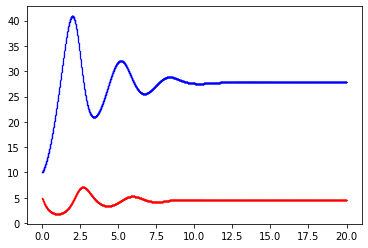

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338252.png
Epoch [17600/50000] Loss:0.001929 Loss_1:0.000000 Loss_2:0.001929 Lr:0.000538 Time:1.366944s
Epoch [17700/50000] Loss:0.002240 Loss_1:0.000007 Loss_2:0.002233 Lr:0.000535 Time:0.791166s
Epoch [17800/50000] Loss:0.001888 Loss_1:0.000000 Loss_2:0.001888 Lr:0.000532 Time:0.811748s
Epoch [17900/50000] Loss:0.003767 Loss_1:0.000232 Loss_2:0.003534 Lr:0.000529 Time:0.791549s
Epoch [18000/50000] Loss:0.001847 Loss_1:0.000000 Loss_2:0.001847 Lr:0.000526 Time:0.791000s
Testing & drawing...
u= [10.000404, 10.005445, 10.010501, 10.015585, 10.02069, 10.025819, 10.030964, 10.036135, 10.041328, 10.046542] ... [27.804647, 27.804646, 27.804646, 27.804644, 27.804644, 27.804642, 27.804642, 27.80464, 27.80464, 27.804638]
v= [5.000176, 4.9912615, 4.9823623, 4.9734683, 4.9645844, 4.955714, 4.946862, 4.938017, 4.9291863, 4.920375] ... [4.5299344, 4.529933, 4.5299306, 4.5

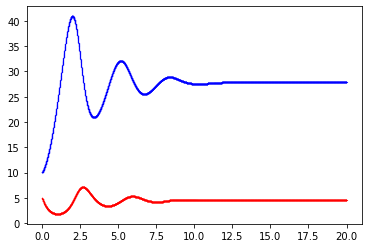

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338257.png
Epoch [18100/50000] Loss:0.012102 Loss_1:0.001387 Loss_2:0.010716 Lr:0.000524 Time:1.286849s
Epoch [18200/50000] Loss:0.001809 Loss_1:0.000000 Loss_2:0.001809 Lr:0.000521 Time:0.791593s
Epoch [18300/50000] Loss:0.001887 Loss_1:0.000004 Loss_2:0.001883 Lr:0.000518 Time:0.791125s
Epoch [18400/50000] Loss:0.001775 Loss_1:0.000000 Loss_2:0.001775 Lr:0.000515 Time:0.791377s
Epoch [18500/50000] Loss:0.001735 Loss_1:0.000000 Loss_2:0.001734 Lr:0.000513 Time:0.791698s
Testing & drawing...
u= [10.000689, 10.00573, 10.01079, 10.015875, 10.020981, 10.026108, 10.031258, 10.03643, 10.041624, 10.046839] ... [27.804155, 27.804155, 27.804153, 27.804152, 27.804152, 27.804148, 27.804148, 27.804146, 27.804146, 27.804146]
v= [5.00057, 4.99165, 4.9827466, 4.9738483, 4.964961, 4.9560876, 4.947231, 4.938383, 4.9295497, 4.920736] ... [4.529843, 4.52984, 4.5298386, 4.529836

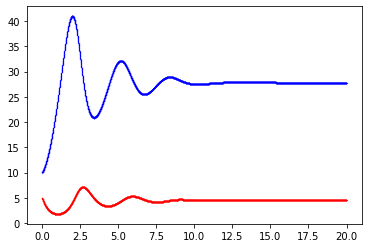

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338261.png
Epoch [18600/50000] Loss:0.001757 Loss_1:0.000002 Loss_2:0.001755 Lr:0.000510 Time:1.361886s
Epoch [18700/50000] Loss:0.001693 Loss_1:0.000001 Loss_2:0.001692 Lr:0.000508 Time:0.796423s
Epoch [18800/50000] Loss:0.001694 Loss_1:0.000001 Loss_2:0.001692 Lr:0.000505 Time:0.792920s
Epoch [18900/50000] Loss:0.001653 Loss_1:0.000000 Loss_2:0.001653 Lr:0.000503 Time:0.791248s
Epoch [19000/50000] Loss:0.001654 Loss_1:0.000000 Loss_2:0.001654 Lr:0.000500 Time:0.791661s
Testing & drawing...
u= [9.999051, 10.004082, 10.009133, 10.01421, 10.019308, 10.024427, 10.029567, 10.034734, 10.039918, 10.045125] ... [27.806185, 27.806183, 27.806181, 27.80618, 27.80618, 27.80618, 27.80618, 27.806177, 27.806177, 27.806177]
v= [4.999043, 4.9901314, 4.981235, 4.972345, 4.9634666, 4.954601, 4.9457526, 4.9369125, 4.9280887, 4.9192843] ... [4.530382, 4.5303802, 4.530379, 4.5303

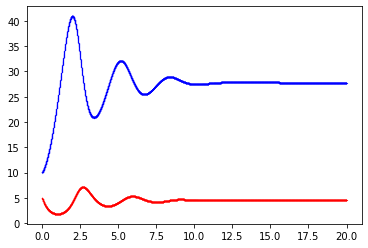

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338266.png
Epoch [19100/50000] Loss:0.001618 Loss_1:0.000001 Loss_2:0.001617 Lr:0.000498 Time:1.340961s
Epoch [19200/50000] Loss:0.001615 Loss_1:0.000002 Loss_2:0.001613 Lr:0.000495 Time:0.792103s
Epoch [19300/50000] Loss:0.001573 Loss_1:0.000000 Loss_2:0.001573 Lr:0.000493 Time:0.792907s
Epoch [19400/50000] Loss:0.001567 Loss_1:0.000000 Loss_2:0.001567 Lr:0.000490 Time:0.796223s
Epoch [19500/50000] Loss:0.001532 Loss_1:0.000000 Loss_2:0.001532 Lr:0.000488 Time:0.814615s
Testing & drawing...
u= [10.0005455, 10.005586, 10.010646, 10.015729, 10.020837, 10.025964, 10.031111, 10.036284, 10.041478, 10.046694] ... [27.804714, 27.804712, 27.804712, 27.80471, 27.804708, 27.804708, 27.804707, 27.804707, 27.804707, 27.804707]
v= [5.0004883, 4.9915633, 4.9826555, 4.973754, 4.9648647, 4.955986, 4.947128, 4.938277, 4.9294415, 4.920626] ... [4.529927, 4.5299253, 4.5299244, 

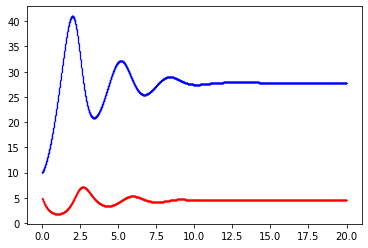

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338271.png
Epoch [19600/50000] Loss:0.001542 Loss_1:0.000002 Loss_2:0.001539 Lr:0.000485 Time:1.301114s
Epoch [19700/50000] Loss:0.001499 Loss_1:0.000000 Loss_2:0.001499 Lr:0.000483 Time:0.791193s
Epoch [19800/50000] Loss:0.002309 Loss_1:0.000018 Loss_2:0.002292 Lr:0.000481 Time:0.790829s
Epoch [19900/50000] Loss:0.001462 Loss_1:0.000000 Loss_2:0.001462 Lr:0.000478 Time:0.791409s
Epoch [20000/50000] Loss:0.001511 Loss_1:0.000001 Loss_2:0.001510 Lr:0.000476 Time:0.791324s
Testing & drawing...
u= [9.996802, 10.001829, 10.006876, 10.011947, 10.017041, 10.022158, 10.02729, 10.03245, 10.037635, 10.042835] ... [27.806139, 27.806137, 27.806137, 27.806135, 27.806135, 27.806135, 27.806135, 27.806133, 27.806133, 27.806131]
v= [4.9963875, 4.9874945, 4.9786177, 4.969747, 4.9608893, 4.952044, 4.9432178, 4.9344, 4.925597, 4.9168143] ... [4.5301776, 4.530177, 4.530175, 4.530

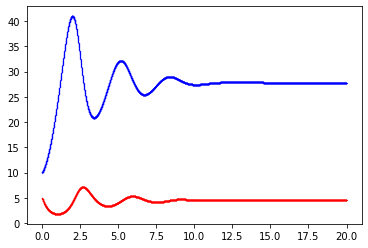

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338275.png
Epoch [20100/50000] Loss:0.001424 Loss_1:0.000000 Loss_2:0.001424 Lr:0.000474 Time:1.372161s
Epoch [20200/50000] Loss:0.001622 Loss_1:0.000013 Loss_2:0.001609 Lr:0.000472 Time:0.792336s
Epoch [20300/50000] Loss:0.001387 Loss_1:0.000000 Loss_2:0.001387 Lr:0.000469 Time:0.810061s
Epoch [20400/50000] Loss:0.001614 Loss_1:0.000011 Loss_2:0.001603 Lr:0.000467 Time:0.792803s
Epoch [20500/50000] Loss:0.001357 Loss_1:0.000000 Loss_2:0.001357 Lr:0.000465 Time:0.791077s
Testing & drawing...
u= [10.000464, 10.005504, 10.01056, 10.015642, 10.020746, 10.025874, 10.03102, 10.036189, 10.041384, 10.046597] ... [27.806122, 27.80612, 27.80612, 27.80612, 27.806118, 27.806118, 27.806118, 27.806118, 27.806118, 27.806118]
v= [5.000222, 4.9912953, 4.9823856, 4.9734807, 4.9645886, 4.95571, 4.94685, 4.937999, 4.929163, 4.9203467] ... [4.5302286, 4.530227, 4.5302267, 4.53022

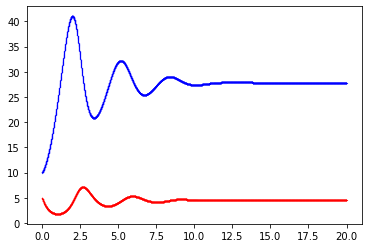

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338280.png
Epoch [20600/50000] Loss:0.010779 Loss_1:0.000935 Loss_2:0.009844 Lr:0.000463 Time:1.297710s
Epoch [20700/50000] Loss:0.001322 Loss_1:0.000000 Loss_2:0.001322 Lr:0.000461 Time:0.791432s
Epoch [20800/50000] Loss:0.008513 Loss_1:0.000863 Loss_2:0.007650 Lr:0.000459 Time:0.790510s
Epoch [20900/50000] Loss:0.001290 Loss_1:0.000000 Loss_2:0.001289 Lr:0.000457 Time:0.791070s
Epoch [21000/50000] Loss:0.003154 Loss_1:0.000071 Loss_2:0.003083 Lr:0.000455 Time:0.792482s
Testing & drawing...
u= [10.009042, 10.0141115, 10.019201, 10.024315, 10.029452, 10.034611, 10.039791, 10.044995, 10.0502205, 10.055466] ... [27.787853, 27.787853, 27.787853, 27.787853, 27.787851, 27.787851, 27.787848, 27.787848, 27.787846, 27.787846]
v= [5.0139403, 5.0049877, 4.996049, 4.987116, 4.9781966, 4.9692883, 4.9603977, 4.951517, 4.9426494, 4.933802] ... [4.5238843, 4.5238833, 4.52388

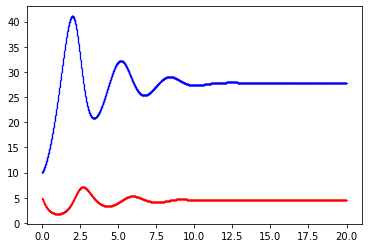

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338284.png
Epoch [21100/50000] Loss:0.001268 Loss_1:0.000000 Loss_2:0.001268 Lr:0.000452 Time:1.312329s
Epoch [21200/50000] Loss:0.001239 Loss_1:0.000000 Loss_2:0.001239 Lr:0.000450 Time:0.791729s
Epoch [21300/50000] Loss:0.002962 Loss_1:0.000232 Loss_2:0.002730 Lr:0.000448 Time:0.790740s
Epoch [21400/50000] Loss:0.001211 Loss_1:0.000000 Loss_2:0.001211 Lr:0.000446 Time:0.791179s
Epoch [21500/50000] Loss:0.004618 Loss_1:0.000482 Loss_2:0.004137 Lr:0.000444 Time:0.800050s
Testing & drawing...
u= [9.996002, 10.000983, 10.005986, 10.011013, 10.016061, 10.0211315, 10.026223, 10.031337, 10.036476, 10.041632] ... [27.788013, 27.788013, 27.788013, 27.788013, 27.78801, 27.78801, 27.78801, 27.78801, 27.78801, 27.78801]
v= [5.0056853, 4.9968414, 4.988016, 4.979196, 4.9703894, 4.9615946, 4.9528203, 4.944054, 4.9353037, 4.9265723] ... [4.5249777, 4.524977, 4.524976, 4.524

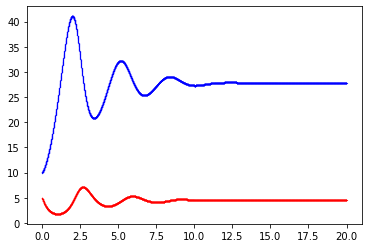

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338289.png
Epoch [21600/50000] Loss:0.001183 Loss_1:0.000000 Loss_2:0.001183 Lr:0.000442 Time:1.364587s
Epoch [21700/50000] Loss:0.001328 Loss_1:0.000007 Loss_2:0.001321 Lr:0.000441 Time:0.791327s
Epoch [21800/50000] Loss:0.001157 Loss_1:0.000000 Loss_2:0.001157 Lr:0.000439 Time:0.791657s
Epoch [21900/50000] Loss:0.001133 Loss_1:0.000000 Loss_2:0.001133 Lr:0.000437 Time:0.791728s
Epoch [22000/50000] Loss:0.001141 Loss_1:0.000001 Loss_2:0.001140 Lr:0.000435 Time:0.806951s
Testing & drawing...
u= [10.001418, 10.006462, 10.011523, 10.016611, 10.021717, 10.026848, 10.031999, 10.037173, 10.042371, 10.047588] ... [27.806747, 27.806747, 27.806747, 27.806746, 27.806746, 27.806746, 27.806746, 27.806746, 27.806746, 27.806746]
v= [5.001681, 4.992746, 4.9838276, 4.974916, 4.9660187, 4.9571342, 4.94827, 4.9394135, 4.9305725, 4.921752] ... [4.530252, 4.530251, 4.5302505, 4.

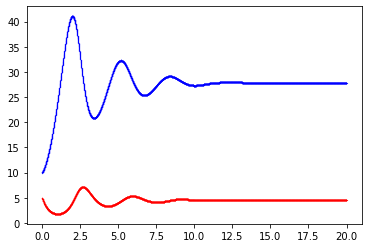

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338293.png
Epoch [22100/50000] Loss:0.001106 Loss_1:0.000000 Loss_2:0.001106 Lr:0.000433 Time:1.301219s
Epoch [22200/50000] Loss:0.001117 Loss_1:0.000000 Loss_2:0.001117 Lr:0.000431 Time:0.795207s
Epoch [22300/50000] Loss:0.001082 Loss_1:0.000000 Loss_2:0.001082 Lr:0.000429 Time:0.792497s
Epoch [22400/50000] Loss:0.001122 Loss_1:0.000003 Loss_2:0.001119 Lr:0.000427 Time:0.793270s
Epoch [22500/50000] Loss:0.001057 Loss_1:0.000000 Loss_2:0.001057 Lr:0.000426 Time:0.791883s
Testing & drawing...
u= [10.0003195, 10.00536, 10.010418, 10.015498, 10.020603, 10.025732, 10.030877, 10.036049, 10.041242, 10.046457] ... [27.807173, 27.807173, 27.807173, 27.80717, 27.807169, 27.807169, 27.807169, 27.807169, 27.807167, 27.807167]
v= [5.0001283, 4.9911914, 4.982272, 4.97336, 4.964461, 4.955576, 4.9467106, 4.9378552, 4.929015, 4.9201946] ... [4.530486, 4.530485, 4.5304847, 4.5

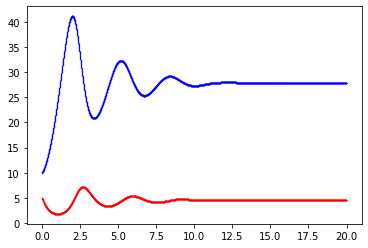

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338298.png
Epoch [22600/50000] Loss:0.001081 Loss_1:0.000002 Loss_2:0.001079 Lr:0.000424 Time:1.295270s
Epoch [22700/50000] Loss:0.001034 Loss_1:0.000000 Loss_2:0.001034 Lr:0.000422 Time:0.791214s
Epoch [22800/50000] Loss:0.001372 Loss_1:0.000030 Loss_2:0.001342 Lr:0.000420 Time:0.816058s
Epoch [22900/50000] Loss:0.001012 Loss_1:0.000000 Loss_2:0.001012 Lr:0.000418 Time:0.792358s
Epoch [23000/50000] Loss:0.001724 Loss_1:0.000102 Loss_2:0.001622 Lr:0.000417 Time:0.791630s
Testing & drawing...
u= [9.981701, 9.986663, 9.991646, 9.996653, 10.00168, 10.006731, 10.0118, 10.016895, 10.022014, 10.027151] ... [27.809143, 27.809143, 27.809143, 27.809143, 27.809143, 27.809143, 27.809143, 27.809143, 27.809143, 27.809143]
v= [4.9830637, 4.9741983, 4.9653506, 4.956511, 4.947685, 4.9388742, 4.930083, 4.921302, 4.912537, 4.903793] ... [4.5309854, 4.530985, 4.530984, 4.5309834

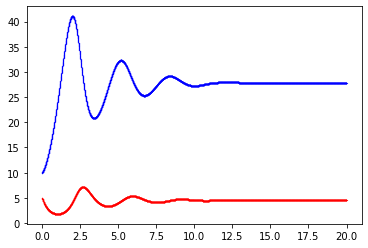

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338302.png
Epoch [23100/50000] Loss:0.000994 Loss_1:0.000000 Loss_2:0.000994 Lr:0.000415 Time:1.345480s
Epoch [23200/50000] Loss:0.001019 Loss_1:0.000002 Loss_2:0.001017 Lr:0.000413 Time:0.791497s
Epoch [23300/50000] Loss:0.000975 Loss_1:0.000000 Loss_2:0.000975 Lr:0.000412 Time:0.791147s
Epoch [23400/50000] Loss:0.027431 Loss_1:0.002194 Loss_2:0.025237 Lr:0.000410 Time:0.793244s
Epoch [23500/50000] Loss:0.000953 Loss_1:0.000000 Loss_2:0.000953 Lr:0.000408 Time:0.791054s
Testing & drawing...
u= [10.000579, 10.005619, 10.010676, 10.0157585, 10.020865, 10.025993, 10.03114, 10.036311, 10.041508, 10.046722] ... [27.807306, 27.807302, 27.807302, 27.807302, 27.807302, 27.807302, 27.807302, 27.807302, 27.807302, 27.807302]
v= [5.0004683, 4.991528, 4.982605, 4.9736905, 4.964789, 4.955901, 4.9470334, 4.9381757, 4.9293337, 4.9205136] ... [4.530588, 4.530587, 4.5305867, 

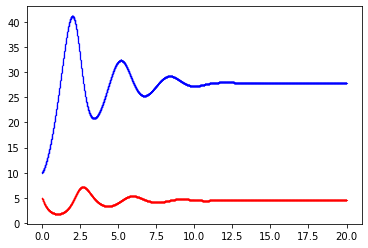

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338307.png
Epoch [23600/50000] Loss:0.002140 Loss_1:0.000046 Loss_2:0.002094 Lr:0.000407 Time:1.352600s
Epoch [23700/50000] Loss:0.000930 Loss_1:0.000000 Loss_2:0.000930 Lr:0.000405 Time:0.791182s
Epoch [23800/50000] Loss:0.001136 Loss_1:0.000009 Loss_2:0.001126 Lr:0.000403 Time:0.790862s
Epoch [23900/50000] Loss:0.000911 Loss_1:0.000000 Loss_2:0.000911 Lr:0.000402 Time:0.791228s
Epoch [24000/50000] Loss:0.000918 Loss_1:0.000000 Loss_2:0.000918 Lr:0.000400 Time:0.790608s
Testing & drawing...
u= [10.0004635, 10.005503, 10.010563, 10.015646, 10.020752, 10.025882, 10.031027, 10.036201, 10.041399, 10.046612] ... [27.805904, 27.805904, 27.8059, 27.8059, 27.8059, 27.8059, 27.8059, 27.8059, 27.8059, 27.8059]
v= [5.000718, 4.991777, 4.982853, 4.973936, 4.9650335, 4.956145, 4.947277, 4.938418, 4.9295764, 4.920755] ... [4.5302243, 4.5302243, 4.5302243, 4.5302234, 4.5302

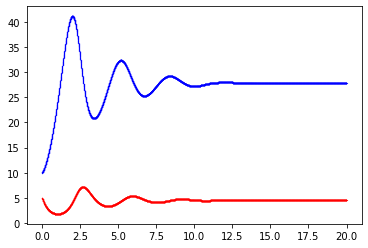

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338311.png
Epoch [24100/50000] Loss:0.018103 Loss_1:0.001756 Loss_2:0.016347 Lr:0.000398 Time:1.343340s
Epoch [24200/50000] Loss:0.000887 Loss_1:0.000000 Loss_2:0.000887 Lr:0.000397 Time:0.790421s
Epoch [24300/50000] Loss:0.001810 Loss_1:0.000135 Loss_2:0.001675 Lr:0.000395 Time:0.792778s
Epoch [24400/50000] Loss:0.000873 Loss_1:0.000000 Loss_2:0.000873 Lr:0.000394 Time:0.791498s
Epoch [24500/50000] Loss:0.001370 Loss_1:0.000019 Loss_2:0.001351 Lr:0.000392 Time:0.816938s
Testing & drawing...
u= [10.0045185, 10.009576, 10.014647, 10.019747, 10.024868, 10.030007, 10.035172, 10.040359, 10.045569, 10.050798] ... [27.797384, 27.797384, 27.797384, 27.797384, 27.797384, 27.797384, 27.797384, 27.797384, 27.797382, 27.797382]
v= [5.007105, 4.9981484, 4.989209, 4.980278, 4.97136, 4.9624567, 4.9535723, 4.9446993, 4.93584, 4.927003] ... [4.5276794, 4.5276785, 4.5276785, 4

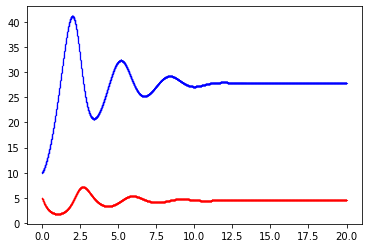

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338316.png
Epoch [24600/50000] Loss:0.000861 Loss_1:0.000001 Loss_2:0.000860 Lr:0.000391 Time:1.301752s
Epoch [24700/50000] Loss:0.001928 Loss_1:0.000057 Loss_2:0.001872 Lr:0.000389 Time:0.791180s
Epoch [24800/50000] Loss:0.000844 Loss_1:0.000000 Loss_2:0.000844 Lr:0.000388 Time:0.790891s
Epoch [24900/50000] Loss:0.006029 Loss_1:0.000559 Loss_2:0.005470 Lr:0.000386 Time:0.791420s
Epoch [25000/50000] Loss:0.000830 Loss_1:0.000000 Loss_2:0.000830 Lr:0.000385 Time:0.790955s
Testing & drawing...
u= [10.000396, 10.005435, 10.010494, 10.015578, 10.020683, 10.02581, 10.030957, 10.036129, 10.041324, 10.046537] ... [27.806978, 27.806978, 27.806978, 27.806978, 27.806978, 27.806978, 27.806978, 27.806974, 27.806974, 27.806974]
v= [5.0001845, 4.991241, 4.982316, 4.9733973, 4.9644933, 4.955605, 4.9467354, 4.9378777, 4.9290347, 4.9202137] ... [4.530771, 4.5307703, 4.5307703,

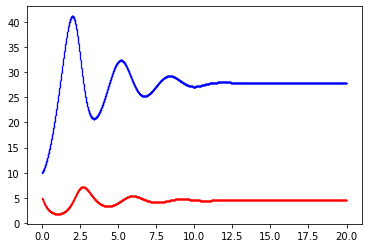

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338320.png
Epoch [25100/50000] Loss:0.021930 Loss_1:0.002081 Loss_2:0.019848 Lr:0.000383 Time:1.296709s
Epoch [25200/50000] Loss:0.000818 Loss_1:0.000000 Loss_2:0.000818 Lr:0.000382 Time:0.794093s
Epoch [25300/50000] Loss:0.005757 Loss_1:0.000257 Loss_2:0.005500 Lr:0.000380 Time:0.811205s
Epoch [25400/50000] Loss:0.000806 Loss_1:0.000000 Loss_2:0.000806 Lr:0.000379 Time:0.799314s
Epoch [25500/50000] Loss:0.001013 Loss_1:0.000011 Loss_2:0.001002 Lr:0.000377 Time:0.791558s
Testing & drawing...
u= [9.997101, 10.0021305, 10.007177, 10.012249, 10.017346, 10.022462, 10.027599, 10.032759, 10.037942, 10.043144] ... [27.81271, 27.81271, 27.81271, 27.81271, 27.812708, 27.812708, 27.812708, 27.812708, 27.812708, 27.812708]
v= [4.995446, 4.986509, 4.97759, 4.9686804, 4.9597855, 4.950905, 4.942045, 4.933196, 4.924363, 4.915553] ... [4.5327063, 4.532706, 4.532706, 4.5327053

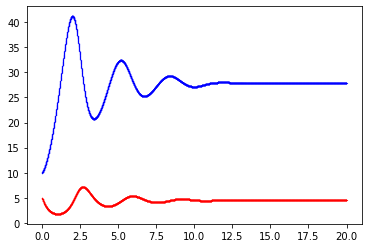

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338325.png
Epoch [25600/50000] Loss:0.000798 Loss_1:0.000000 Loss_2:0.000798 Lr:0.000376 Time:1.369369s
Epoch [25700/50000] Loss:0.000787 Loss_1:0.000000 Loss_2:0.000787 Lr:0.000375 Time:0.793936s
Epoch [25800/50000] Loss:0.000789 Loss_1:0.000000 Loss_2:0.000788 Lr:0.000373 Time:0.791510s
Epoch [25900/50000] Loss:0.000775 Loss_1:0.000000 Loss_2:0.000775 Lr:0.000372 Time:0.792176s
Epoch [26000/50000] Loss:0.000789 Loss_1:0.000000 Loss_2:0.000789 Lr:0.000370 Time:0.793487s
Testing & drawing...
u= [10.0005455, 10.005586, 10.010645, 10.015731, 10.020837, 10.025967, 10.031115, 10.036286, 10.041483, 10.046698] ... [27.80538, 27.805378, 27.805378, 27.805378, 27.805378, 27.805378, 27.805378, 27.805378, 27.805378, 27.805378]
v= [5.0006604, 4.991713, 4.9827847, 4.9738636, 4.964957, 4.956065, 4.9471946, 4.938334, 4.9294896, 4.9206657] ... [4.530413, 4.530413, 4.530412, 4

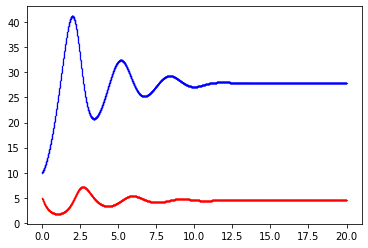

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338329.png
Epoch [26100/50000] Loss:0.000772 Loss_1:0.000001 Loss_2:0.000771 Lr:0.000369 Time:1.309920s
Epoch [26200/50000] Loss:0.000768 Loss_1:0.000000 Loss_2:0.000768 Lr:0.000368 Time:0.792892s
Epoch [26300/50000] Loss:0.000804 Loss_1:0.000002 Loss_2:0.000802 Lr:0.000366 Time:0.791925s
Epoch [26400/50000] Loss:0.000758 Loss_1:0.000000 Loss_2:0.000758 Lr:0.000365 Time:0.791385s
Epoch [26500/50000] Loss:0.000747 Loss_1:0.000000 Loss_2:0.000747 Lr:0.000364 Time:0.791260s
Testing & drawing...
u= [10.000269, 10.005308, 10.0103655, 10.0154505, 10.020558, 10.025683, 10.030831, 10.036004, 10.041199, 10.046412] ... [27.80624, 27.80624, 27.80624, 27.80624, 27.80624, 27.806238, 27.806238, 27.806238, 27.806236, 27.806236]
v= [5.0002155, 4.9912667, 4.982338, 4.9734173, 4.9645095, 4.9556174, 4.946746, 4.9378853, 4.929041, 4.9202185] ... [4.53079, 4.5307894, 4.530789, 4.5

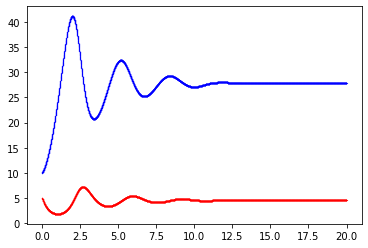

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338334.png
Epoch [26600/50000] Loss:0.000748 Loss_1:0.000000 Loss_2:0.000748 Lr:0.000362 Time:1.301319s
Epoch [26700/50000] Loss:0.000788 Loss_1:0.000002 Loss_2:0.000786 Lr:0.000361 Time:0.794823s
Epoch [26800/50000] Loss:0.000740 Loss_1:0.000000 Loss_2:0.000740 Lr:0.000360 Time:0.793193s
Epoch [26900/50000] Loss:0.006013 Loss_1:0.000275 Loss_2:0.005738 Lr:0.000358 Time:0.793677s
Epoch [27000/50000] Loss:0.000731 Loss_1:0.000000 Loss_2:0.000731 Lr:0.000357 Time:0.812843s
Testing & drawing...
u= [9.999936, 10.004974, 10.010032, 10.015112, 10.020218, 10.025343, 10.030487, 10.035659, 10.040853, 10.046064] ... [27.806843, 27.806843, 27.806843, 27.806843, 27.806843, 27.806839, 27.806839, 27.806839, 27.806839, 27.806839]
v= [4.9999657, 4.9910192, 4.9820905, 4.973169, 4.964263, 4.955372, 4.9465017, 4.937642, 4.9287996, 4.919977] ... [4.530979, 4.5309787, 4.5309787, 4

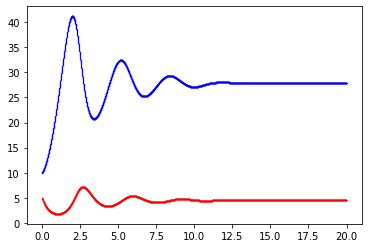

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338338.png
Epoch [27100/50000] Loss:0.000723 Loss_1:0.000000 Loss_2:0.000723 Lr:0.000356 Time:1.351411s
Epoch [27200/50000] Loss:0.000734 Loss_1:0.000000 Loss_2:0.000733 Lr:0.000355 Time:0.791441s
Epoch [27300/50000] Loss:0.006481 Loss_1:0.000312 Loss_2:0.006169 Lr:0.000353 Time:0.790349s
Epoch [27400/50000] Loss:0.000714 Loss_1:0.000000 Loss_2:0.000714 Lr:0.000352 Time:0.791333s
Epoch [27500/50000] Loss:0.003226 Loss_1:0.000326 Loss_2:0.002899 Lr:0.000351 Time:0.790934s
Testing & drawing...
u= [10.010711, 10.015761, 10.020833, 10.025927, 10.031044, 10.036184, 10.041344, 10.04653, 10.051737, 10.056963] ... [27.808437, 27.808437, 27.808437, 27.808437, 27.808437, 27.808437, 27.808437, 27.808435, 27.808435, 27.808435]
v= [5.013828, 5.004888, 4.9959664, 4.987052, 4.9781504, 4.9692636, 4.9603972, 4.9515386, 4.942696, 4.9338737] ... [4.5314317, 4.531431, 4.531431, 4

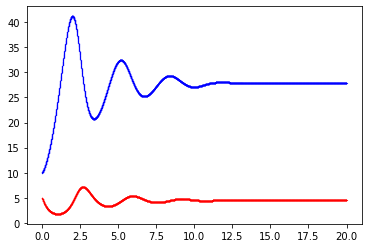

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338343.png
Epoch [27600/50000] Loss:0.000707 Loss_1:0.000000 Loss_2:0.000707 Lr:0.000350 Time:1.315441s
Epoch [27700/50000] Loss:0.001000 Loss_1:0.000011 Loss_2:0.000988 Lr:0.000348 Time:0.790513s
Epoch [27800/50000] Loss:0.000701 Loss_1:0.000000 Loss_2:0.000701 Lr:0.000347 Time:0.814687s
Epoch [27900/50000] Loss:0.004346 Loss_1:0.000466 Loss_2:0.003880 Lr:0.000346 Time:0.792023s
Epoch [28000/50000] Loss:0.000695 Loss_1:0.000000 Loss_2:0.000695 Lr:0.000345 Time:0.798437s
Testing & drawing...
u= [10.00039, 10.005428, 10.010488, 10.015573, 10.020678, 10.025806, 10.030952, 10.036126, 10.04132, 10.046535] ... [27.80647, 27.80647, 27.80647, 27.80647, 27.80647, 27.80647, 27.80647, 27.80647, 27.80647, 27.80647]
v= [5.000297, 4.991348, 4.9824157, 4.973494, 4.9645863, 4.9556937, 4.9468217, 4.9379597, 4.9291153, 4.9202924] ... [4.5310097, 4.53101, 4.531009, 4.531009, 4.

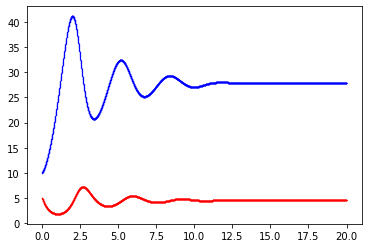

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338347.png
Epoch [28100/50000] Loss:0.000698 Loss_1:0.000000 Loss_2:0.000698 Lr:0.000344 Time:1.286515s
Epoch [28200/50000] Loss:0.000689 Loss_1:0.000000 Loss_2:0.000689 Lr:0.000342 Time:0.791315s
Epoch [28300/50000] Loss:0.002898 Loss_1:0.000118 Loss_2:0.002780 Lr:0.000341 Time:0.791409s
Epoch [28400/50000] Loss:0.000682 Loss_1:0.000000 Loss_2:0.000682 Lr:0.000340 Time:0.791194s
Epoch [28500/50000] Loss:0.000678 Loss_1:0.000000 Loss_2:0.000678 Lr:0.000339 Time:0.794695s
Testing & drawing...
u= [9.999726, 10.004767, 10.009825, 10.014908, 10.020011, 10.025138, 10.030284, 10.035455, 10.040649, 10.04586] ... [27.807104, 27.807104, 27.807104, 27.807104, 27.807104, 27.807104, 27.807104, 27.807104, 27.807104, 27.807104]
v= [4.9994874, 4.9905376, 4.981606, 4.972684, 4.9637766, 4.954884, 4.946013, 4.937152, 4.9283085, 4.919485] ... [4.5313096, 4.5313096, 4.5313096, 4.

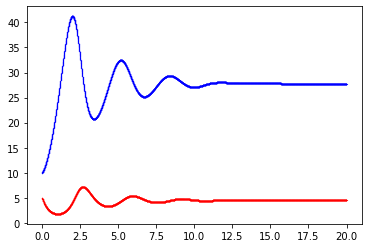

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338352.png
Epoch [28600/50000] Loss:0.000677 Loss_1:0.000000 Loss_2:0.000677 Lr:0.000338 Time:1.373445s
Epoch [28700/50000] Loss:0.000670 Loss_1:0.000000 Loss_2:0.000670 Lr:0.000337 Time:0.791163s
Epoch [28800/50000] Loss:0.000724 Loss_1:0.000001 Loss_2:0.000723 Lr:0.000336 Time:0.791607s
Epoch [28900/50000] Loss:0.000665 Loss_1:0.000000 Loss_2:0.000665 Lr:0.000334 Time:0.791543s
Epoch [29000/50000] Loss:0.000762 Loss_1:0.000003 Loss_2:0.000759 Lr:0.000333 Time:0.791690s
Testing & drawing...
u= [9.9987545, 10.003791, 10.008844, 10.013925, 10.019027, 10.024149, 10.029294, 10.034462, 10.039653, 10.044863] ... [27.804188, 27.804188, 27.804188, 27.804188, 27.804188, 27.804188, 27.804188, 27.804188, 27.804188, 27.804188]
v= [4.997306, 4.9883757, 4.9794655, 4.9705634, 4.9616756, 4.952804, 4.943952, 4.9351115, 4.9262867, 4.917485] ... [4.5304575, 4.5304575, 4.5304575

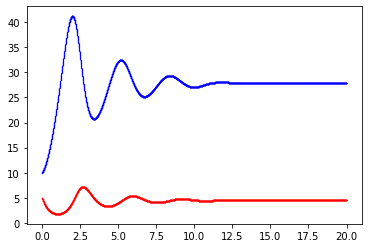

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338356.png
Epoch [29100/50000] Loss:0.000662 Loss_1:0.000000 Loss_2:0.000662 Lr:0.000332 Time:1.298656s
Epoch [29200/50000] Loss:0.000661 Loss_1:0.000000 Loss_2:0.000661 Lr:0.000331 Time:0.791622s
Epoch [29300/50000] Loss:0.000658 Loss_1:0.000000 Loss_2:0.000658 Lr:0.000330 Time:0.793639s
Epoch [29400/50000] Loss:0.002175 Loss_1:0.000079 Loss_2:0.002095 Lr:0.000329 Time:0.792155s
Epoch [29500/50000] Loss:0.000652 Loss_1:0.000000 Loss_2:0.000651 Lr:0.000328 Time:0.815389s
Testing & drawing...
u= [10.000069, 10.005106, 10.010162, 10.015247, 10.020351, 10.025478, 10.030624, 10.035795, 10.040991, 10.046204] ... [27.806793, 27.806793, 27.806793, 27.806793, 27.806791, 27.806791, 27.806791, 27.806791, 27.806791, 27.806791]
v= [4.9999475, 4.990997, 4.9820633, 4.97314, 4.964231, 4.955339, 4.9464655, 4.937604, 4.928759, 4.9199367] ... [4.531348, 4.531348, 4.531348, 4.53

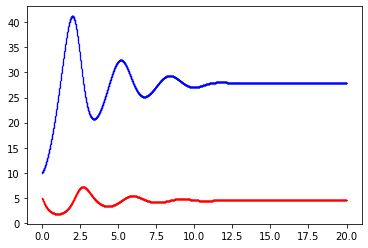

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338361.png
Epoch [29600/50000] Loss:0.000671 Loss_1:0.000001 Loss_2:0.000670 Lr:0.000327 Time:1.359958s
Epoch [29700/50000] Loss:0.000649 Loss_1:0.000000 Loss_2:0.000649 Lr:0.000326 Time:0.794799s
Epoch [29800/50000] Loss:0.000641 Loss_1:0.000000 Loss_2:0.000641 Lr:0.000325 Time:0.792078s
Epoch [29900/50000] Loss:0.000669 Loss_1:0.000001 Loss_2:0.000668 Lr:0.000324 Time:0.792771s
Epoch [30000/50000] Loss:0.000637 Loss_1:0.000000 Loss_2:0.000637 Lr:0.000323 Time:0.792719s
Testing & drawing...
u= [10.0002365, 10.005276, 10.010335, 10.01542, 10.020524, 10.025651, 10.030799, 10.035971, 10.041166, 10.046382] ... [27.806686, 27.806686, 27.806686, 27.806686, 27.806686, 27.806686, 27.806686, 27.806686, 27.806686, 27.806686]
v= [5.0001445, 4.991192, 4.9822583, 4.9733334, 4.9644237, 4.955529, 4.946656, 4.9377937, 4.928947, 4.9201245] ... [4.5314264, 4.5314264, 4.5314264

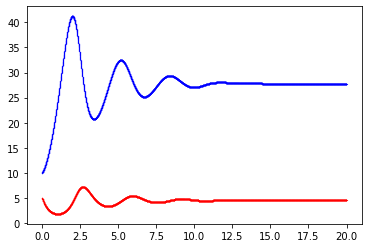

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338365.png
Epoch [30100/50000] Loss:0.001557 Loss_1:0.000091 Loss_2:0.001466 Lr:0.000322 Time:1.299760s
Epoch [30200/50000] Loss:0.000635 Loss_1:0.000000 Loss_2:0.000635 Lr:0.000321 Time:0.794675s
Epoch [30300/50000] Loss:0.000630 Loss_1:0.000000 Loss_2:0.000630 Lr:0.000319 Time:0.812077s
Epoch [30400/50000] Loss:0.000660 Loss_1:0.000003 Loss_2:0.000657 Lr:0.000318 Time:0.791811s
Epoch [30500/50000] Loss:0.000626 Loss_1:0.000000 Loss_2:0.000626 Lr:0.000317 Time:0.796167s
Testing & drawing...
u= [10.000199, 10.005239, 10.0103, 10.015381, 10.020488, 10.025615, 10.030761, 10.035934, 10.04113, 10.046343] ... [27.80668, 27.80668, 27.80668, 27.80668, 27.80668, 27.80668, 27.80668, 27.80668, 27.80668, 27.80668]
v= [5.000102, 4.9911494, 4.982216, 4.973291, 4.9643817, 4.955486, 4.946613, 4.93775, 4.9289036, 4.9200797] ... [4.531531, 4.531531, 4.531531, 4.531531, 4.53153

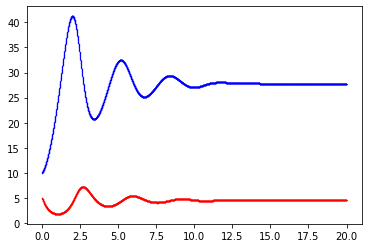

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338370.png
Epoch [30600/50000] Loss:0.001084 Loss_1:0.000013 Loss_2:0.001071 Lr:0.000316 Time:1.304347s
Epoch [30700/50000] Loss:0.000621 Loss_1:0.000000 Loss_2:0.000621 Lr:0.000315 Time:0.791324s
Epoch [30800/50000] Loss:0.003821 Loss_1:0.000411 Loss_2:0.003410 Lr:0.000314 Time:0.792212s
Epoch [30900/50000] Loss:0.000619 Loss_1:0.000000 Loss_2:0.000619 Lr:0.000313 Time:0.791826s
Epoch [31000/50000] Loss:0.000614 Loss_1:0.000000 Loss_2:0.000614 Lr:0.000313 Time:0.791085s
Testing & drawing...
u= [10.00019, 10.00523, 10.010288, 10.015373, 10.020477, 10.025606, 10.030752, 10.035924, 10.041121, 10.046332] ... [27.806755, 27.806755, 27.806755, 27.806755, 27.806755, 27.806755, 27.806755, 27.806755, 27.806755, 27.806755]
v= [5.000066, 4.991112, 4.9821773, 4.9732523, 4.9643426, 4.955447, 4.9465723, 4.93771, 4.9288626, 4.9200377] ... [4.5316663, 4.5316668, 4.5316668, 4

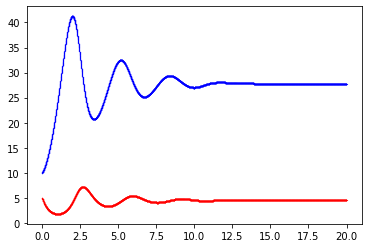

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338374.png
Epoch [31100/50000] Loss:0.000627 Loss_1:0.000002 Loss_2:0.000625 Lr:0.000312 Time:1.387385s
Epoch [31200/50000] Loss:0.000610 Loss_1:0.000000 Loss_2:0.000610 Lr:0.000311 Time:0.791405s
Epoch [31300/50000] Loss:0.000615 Loss_1:0.000000 Loss_2:0.000615 Lr:0.000310 Time:0.791432s
Epoch [31400/50000] Loss:0.000606 Loss_1:0.000000 Loss_2:0.000606 Lr:0.000309 Time:0.790603s
Epoch [31500/50000] Loss:0.000606 Loss_1:0.000000 Loss_2:0.000606 Lr:0.000308 Time:0.791372s
Testing & drawing...
u= [10.000046, 10.005087, 10.010143, 10.015227, 10.020333, 10.025461, 10.030608, 10.03578, 10.040976, 10.046187] ... [27.807308, 27.807308, 27.807308, 27.807308, 27.807308, 27.807308, 27.807308, 27.807308, 27.807308, 27.807308]
v= [5.000064, 4.9911103, 4.982176, 4.9732513, 4.96434, 4.9554462, 4.9465723, 4.937711, 4.9288635, 4.9200397] ... [4.531925, 4.531926, 4.531926, 4.5

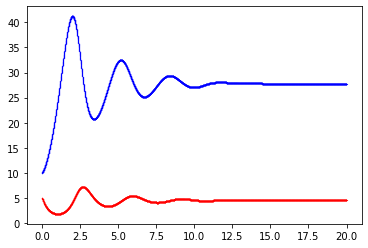

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338379.png
Epoch [31600/50000] Loss:0.000601 Loss_1:0.000000 Loss_2:0.000601 Lr:0.000307 Time:1.303401s
Epoch [31700/50000] Loss:0.000603 Loss_1:0.000000 Loss_2:0.000603 Lr:0.000306 Time:0.792571s
Epoch [31800/50000] Loss:0.000597 Loss_1:0.000000 Loss_2:0.000597 Lr:0.000305 Time:0.791564s
Epoch [31900/50000] Loss:0.000605 Loss_1:0.000000 Loss_2:0.000605 Lr:0.000304 Time:0.791419s
Epoch [32000/50000] Loss:0.000594 Loss_1:0.000000 Loss_2:0.000594 Lr:0.000303 Time:0.805050s
Testing & drawing...
u= [10.000183, 10.005222, 10.0102825, 10.015367, 10.020471, 10.025598, 10.0307455, 10.035918, 10.041112, 10.046328] ... [27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705]
v= [5.000127, 4.9911723, 4.982237, 4.9733095, 4.964398, 4.9555025, 4.946627, 4.937763, 4.928917, 4.920092] ... [4.5319223, 4.531923, 4.531923, 4

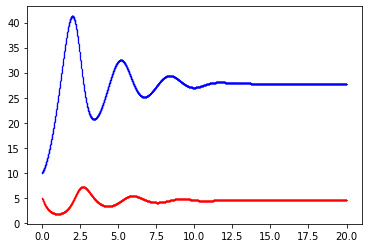

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338383.png
Epoch [32100/50000] Loss:0.000626 Loss_1:0.000000 Loss_2:0.000626 Lr:0.000302 Time:1.284127s
Epoch [32200/50000] Loss:0.000590 Loss_1:0.000000 Loss_2:0.000590 Lr:0.000301 Time:0.790537s
Epoch [32300/50000] Loss:0.000650 Loss_1:0.000002 Loss_2:0.000648 Lr:0.000300 Time:0.791306s
Epoch [32400/50000] Loss:0.000586 Loss_1:0.000000 Loss_2:0.000586 Lr:0.000299 Time:0.791149s
Epoch [32500/50000] Loss:0.000828 Loss_1:0.000030 Loss_2:0.000797 Lr:0.000299 Time:0.791145s
Testing & drawing...
u= [10.004554, 10.009607, 10.014682, 10.01978, 10.024901, 10.030045, 10.035206, 10.040393, 10.045602, 10.05083] ... [27.80439, 27.80439, 27.80439, 27.80439, 27.80439, 27.80439, 27.80439, 27.80439, 27.80439, 27.80439]
v= [5.0040603, 4.995107, 4.986172, 4.9772468, 4.9683356, 4.9594398, 4.950565, 4.9417014, 4.9328537, 4.924028] ... [4.531361, 4.5313616, 4.5313616, 4.531362, 4

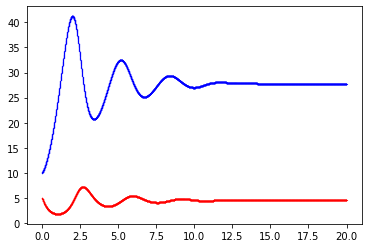

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338388.png
Epoch [32600/50000] Loss:0.000583 Loss_1:0.000000 Loss_2:0.000583 Lr:0.000298 Time:1.368417s
Epoch [32700/50000] Loss:0.000902 Loss_1:0.000040 Loss_2:0.000862 Lr:0.000297 Time:0.792986s
Epoch [32800/50000] Loss:0.000579 Loss_1:0.000000 Loss_2:0.000579 Lr:0.000296 Time:0.813925s
Epoch [32900/50000] Loss:0.000629 Loss_1:0.000002 Loss_2:0.000627 Lr:0.000295 Time:0.791631s
Epoch [33000/50000] Loss:0.000576 Loss_1:0.000000 Loss_2:0.000576 Lr:0.000294 Time:0.791182s
Testing & drawing...
u= [10.000206, 10.005247, 10.010304, 10.0153885, 10.0204935, 10.025622, 10.030769, 10.035941, 10.041136, 10.04635] ... [27.806822, 27.806822, 27.806822, 27.806822, 27.806822, 27.806822, 27.806822, 27.806822, 27.806824, 27.806824]
v= [5.0000443, 4.9910893, 4.982153, 4.9732256, 4.964313, 4.9554167, 4.946542, 4.937678, 4.92883, 4.920006] ... [4.5322495, 4.53225, 4.5322504, 4.

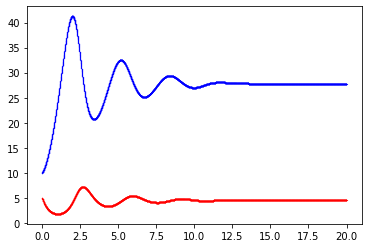

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338392.png
Epoch [33100/50000] Loss:0.000995 Loss_1:0.000060 Loss_2:0.000935 Lr:0.000293 Time:1.332136s
Epoch [33200/50000] Loss:0.000574 Loss_1:0.000000 Loss_2:0.000574 Lr:0.000292 Time:0.797014s
Epoch [33300/50000] Loss:0.000571 Loss_1:0.000000 Loss_2:0.000571 Lr:0.000292 Time:0.790899s
Epoch [33400/50000] Loss:0.000575 Loss_1:0.000000 Loss_2:0.000575 Lr:0.000291 Time:0.790604s
Epoch [33500/50000] Loss:0.000619 Loss_1:0.000003 Loss_2:0.000616 Lr:0.000290 Time:0.791010s
Testing & drawing...
u= [9.9984865, 10.00352, 10.008574, 10.013654, 10.018753, 10.023874, 10.0290165, 10.0341835, 10.039371, 10.04458] ... [27.809721, 27.809721, 27.809721, 27.809721, 27.809721, 27.809721, 27.809721, 27.809721, 27.809721, 27.809721]
v= [4.9977717, 4.988819, 4.9798875, 4.9709644, 4.9620566, 4.953165, 4.944294, 4.935435, 4.926593, 4.917773] ... [4.5332155, 4.5332155, 4.533216, 4

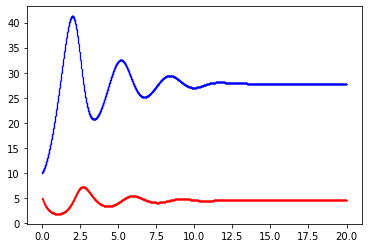

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338397.png
Epoch [33600/50000] Loss:0.000569 Loss_1:0.000000 Loss_2:0.000569 Lr:0.000289 Time:1.309166s
Epoch [33700/50000] Loss:0.000768 Loss_1:0.000009 Loss_2:0.000760 Lr:0.000288 Time:0.792810s
Epoch [33800/50000] Loss:0.000564 Loss_1:0.000000 Loss_2:0.000564 Lr:0.000287 Time:0.791170s
Epoch [33900/50000] Loss:0.000897 Loss_1:0.000013 Loss_2:0.000884 Lr:0.000287 Time:0.791710s
Epoch [34000/50000] Loss:0.000561 Loss_1:0.000000 Loss_2:0.000561 Lr:0.000286 Time:0.792304s
Testing & drawing...
u= [9.99997, 10.005006, 10.010065, 10.015148, 10.020253, 10.025381, 10.030526, 10.0357, 10.040891, 10.046104] ... [27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705, 27.806705]
v= [4.999845, 4.990889, 4.981952, 4.973025, 4.9641128, 4.955216, 4.946341, 4.937476, 4.9286304, 4.919805] ... [4.5324693, 4.5324697, 4.5324707, 4.5324

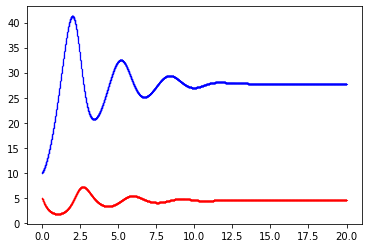

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338401.png
Epoch [34100/50000] Loss:0.001454 Loss_1:0.000109 Loss_2:0.001345 Lr:0.000285 Time:1.356961s
Epoch [34200/50000] Loss:0.000557 Loss_1:0.000000 Loss_2:0.000557 Lr:0.000284 Time:0.791116s
Epoch [34300/50000] Loss:0.000588 Loss_1:0.000002 Loss_2:0.000587 Lr:0.000283 Time:0.803625s
Epoch [34400/50000] Loss:0.000554 Loss_1:0.000000 Loss_2:0.000554 Lr:0.000282 Time:0.796457s
Epoch [34500/50000] Loss:0.000563 Loss_1:0.000001 Loss_2:0.000562 Lr:0.000282 Time:0.816965s
Testing & drawing...
u= [9.999359, 10.004393, 10.009447, 10.014526, 10.0196295, 10.0247555, 10.029895, 10.035068, 10.040258, 10.045465] ... [27.807222, 27.807222, 27.807222, 27.807222, 27.807222, 27.807222, 27.807222, 27.807222, 27.807222, 27.807222]
v= [4.99859, 4.9896355, 4.9806995, 4.9717746, 4.962865, 4.95397, 4.9450955, 4.9362345, 4.9273906, 4.918567] ... [4.532701, 4.5327015, 4.532702, 4

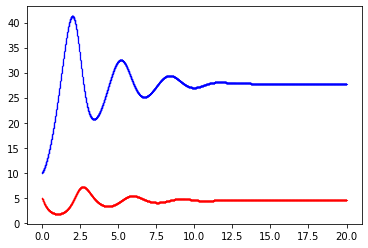

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338406.png
Epoch [34600/50000] Loss:0.000552 Loss_1:0.000000 Loss_2:0.000552 Lr:0.000281 Time:1.288863s
Epoch [34700/50000] Loss:0.000809 Loss_1:0.000015 Loss_2:0.000794 Lr:0.000280 Time:0.792234s
Epoch [34800/50000] Loss:0.000550 Loss_1:0.000000 Loss_2:0.000550 Lr:0.000279 Time:0.791358s
Epoch [34900/50000] Loss:0.001502 Loss_1:0.000087 Loss_2:0.001415 Lr:0.000279 Time:0.791444s
Epoch [35000/50000] Loss:0.000549 Loss_1:0.000000 Loss_2:0.000549 Lr:0.000278 Time:0.791148s
Testing & drawing...
u= [10.000422, 10.005464, 10.01052, 10.015606, 10.020711, 10.025839, 10.030988, 10.0361595, 10.041355, 10.046571] ... [27.806679, 27.806679, 27.806679, 27.806679, 27.806679, 27.806679, 27.806679, 27.806679, 27.806679, 27.806679]
v= [5.0002723, 4.991314, 4.982375, 4.973446, 4.964532, 4.9556336, 4.9467573, 4.9378915, 4.9290433, 4.9202175] ... [4.5327086, 4.532709, 4.5327096,

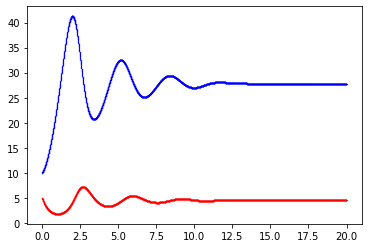

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338410.png
Epoch [35100/50000] Loss:0.000545 Loss_1:0.000000 Loss_2:0.000545 Lr:0.000277 Time:1.348743s
Epoch [35200/50000] Loss:0.001679 Loss_1:0.000094 Loss_2:0.001585 Lr:0.000276 Time:0.795852s
Epoch [35300/50000] Loss:0.001086 Loss_1:0.000033 Loss_2:0.001053 Lr:0.000275 Time:0.806610s
Epoch [35400/50000] Loss:0.000543 Loss_1:0.000000 Loss_2:0.000543 Lr:0.000275 Time:0.791285s
Epoch [35500/50000] Loss:0.000669 Loss_1:0.000011 Loss_2:0.000658 Lr:0.000274 Time:0.791395s
Testing & drawing...
u= [10.003955, 10.0090065, 10.014076, 10.019173, 10.024293, 10.02943, 10.034591, 10.039776, 10.044983, 10.050209] ... [27.803406, 27.803406, 27.803406, 27.803406, 27.803406, 27.803406, 27.803406, 27.803406, 27.803406, 27.803406]
v= [5.0046644, 4.995702, 4.9867578, 4.9778237, 4.9689045, 4.96, 4.951117, 4.9422455, 4.933392, 4.9245605] ... [4.5319114, 4.5319123, 4.531913, 4.5

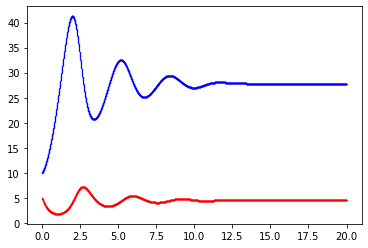

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338415.png
Epoch [35600/50000] Loss:0.000539 Loss_1:0.000000 Loss_2:0.000539 Lr:0.000273 Time:1.291111s
Epoch [35700/50000] Loss:0.000559 Loss_1:0.000002 Loss_2:0.000556 Lr:0.000272 Time:0.791351s
Epoch [35800/50000] Loss:0.000558 Loss_1:0.000001 Loss_2:0.000557 Lr:0.000272 Time:0.791536s
Epoch [35900/50000] Loss:0.000538 Loss_1:0.000000 Loss_2:0.000538 Lr:0.000271 Time:0.795168s
Epoch [36000/50000] Loss:0.000554 Loss_1:0.000002 Loss_2:0.000552 Lr:0.000270 Time:0.792540s
Testing & drawing...
u= [10.00234, 10.007385, 10.01245, 10.01754, 10.022654, 10.027787, 10.03294, 10.038121, 10.043322, 10.04854] ... [27.806288, 27.806288, 27.806288, 27.806288, 27.806288, 27.806288, 27.806288, 27.806288, 27.806288, 27.806288]
v= [5.001432, 4.992469, 4.983525, 4.974591, 4.9656725, 4.95677, 4.947889, 4.9390187, 4.930166, 4.9213357] ... [4.532839, 4.53284, 4.53284, 4.532841, 4.

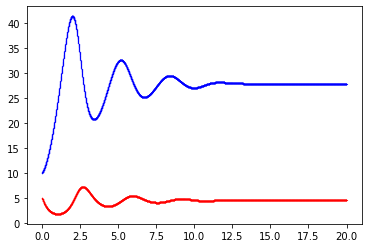

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338419.png
Epoch [36100/50000] Loss:0.000535 Loss_1:0.000000 Loss_2:0.000535 Lr:0.000270 Time:1.315975s
Epoch [36200/50000] Loss:0.000577 Loss_1:0.000003 Loss_2:0.000575 Lr:0.000269 Time:0.791728s
Epoch [36300/50000] Loss:0.000532 Loss_1:0.000000 Loss_2:0.000532 Lr:0.000268 Time:0.793757s
Epoch [36400/50000] Loss:0.000539 Loss_1:0.000001 Loss_2:0.000538 Lr:0.000267 Time:0.792131s
Epoch [36500/50000] Loss:0.000534 Loss_1:0.000000 Loss_2:0.000534 Lr:0.000267 Time:0.791230s
Testing & drawing...
u= [10.000759, 10.005802, 10.010862, 10.015946, 10.021055, 10.026185, 10.031335, 10.03651, 10.041706, 10.046922] ... [27.805916, 27.805916, 27.805916, 27.805916, 27.805916, 27.805916, 27.805916, 27.805916, 27.805916, 27.805916]
v= [5.000869, 4.9919057, 4.9829645, 4.974032, 4.965114, 4.956213, 4.947333, 4.9384656, 4.929615, 4.920786] ... [4.5328283, 4.5328293, 4.5328293, 4.

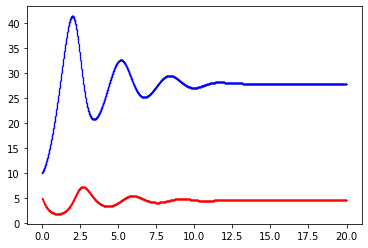

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338424.png
Epoch [36600/50000] Loss:0.000532 Loss_1:0.000000 Loss_2:0.000531 Lr:0.000266 Time:1.360869s
Epoch [36700/50000] Loss:0.000532 Loss_1:0.000001 Loss_2:0.000532 Lr:0.000265 Time:0.791320s
Epoch [36800/50000] Loss:0.004343 Loss_1:0.000368 Loss_2:0.003975 Lr:0.000265 Time:0.791300s
Epoch [36900/50000] Loss:0.004759 Loss_1:0.000347 Loss_2:0.004412 Lr:0.000264 Time:0.795515s
Epoch [37000/50000] Loss:0.000528 Loss_1:0.000000 Loss_2:0.000528 Lr:0.000263 Time:0.791547s
Testing & drawing...
u= [9.999604, 10.004643, 10.009699, 10.01478, 10.019885, 10.025012, 10.030154, 10.035326, 10.040518, 10.045731] ... [27.80715, 27.80715, 27.80715, 27.80715, 27.80715, 27.807152, 27.807152, 27.807152, 27.807152, 27.807152]
v= [4.9995017, 4.990542, 4.9816027, 4.9726725, 4.9637585, 4.95486, 4.9459834, 4.9371185, 4.9282713, 4.9194465] ... [4.5332117, 4.533212, 4.533213, 4.5332

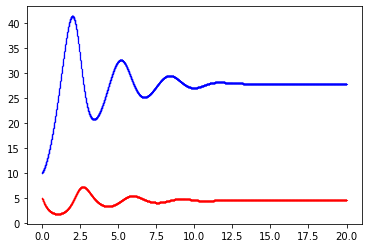

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338428.png
Epoch [37100/50000] Loss:0.000525 Loss_1:0.000000 Loss_2:0.000525 Lr:0.000262 Time:1.286183s
Epoch [37200/50000] Loss:0.001064 Loss_1:0.000046 Loss_2:0.001018 Lr:0.000262 Time:0.791152s
Epoch [37300/50000] Loss:0.000523 Loss_1:0.000000 Loss_2:0.000523 Lr:0.000261 Time:0.791207s
Epoch [37400/50000] Loss:0.000557 Loss_1:0.000002 Loss_2:0.000555 Lr:0.000260 Time:0.791338s
Epoch [37500/50000] Loss:0.000521 Loss_1:0.000000 Loss_2:0.000521 Lr:0.000260 Time:0.790585s
Testing & drawing...
u= [10.000155, 10.005196, 10.010252, 10.015335, 10.020439, 10.025568, 10.030715, 10.035887, 10.0410795, 10.046295] ... [27.806799, 27.806799, 27.806799, 27.806799, 27.806799, 27.806799, 27.806799, 27.806799, 27.806799, 27.806799]
v= [5.000043, 4.991082, 4.982141, 4.9732094, 4.9642935, 4.9553943, 4.9465165, 4.9376507, 4.9288015, 4.919975] ... [4.533177, 4.533177, 4.5331783,

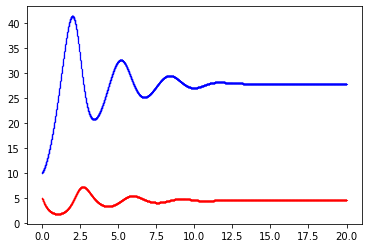

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338433.png
Epoch [37600/50000] Loss:0.000532 Loss_1:0.000001 Loss_2:0.000531 Lr:0.000259 Time:1.292842s
Epoch [37700/50000] Loss:0.001137 Loss_1:0.000035 Loss_2:0.001101 Lr:0.000258 Time:0.813444s
Epoch [37800/50000] Loss:0.000518 Loss_1:0.000000 Loss_2:0.000518 Lr:0.000258 Time:0.790481s
Epoch [37900/50000] Loss:0.000532 Loss_1:0.000000 Loss_2:0.000531 Lr:0.000257 Time:0.791605s
Epoch [38000/50000] Loss:0.000517 Loss_1:0.000000 Loss_2:0.000517 Lr:0.000256 Time:0.791337s
Testing & drawing...
u= [10.000165, 10.005205, 10.010263, 10.0153475, 10.020451, 10.02558, 10.030726, 10.035899, 10.041093, 10.046309] ... [27.806664, 27.806664, 27.806664, 27.806664, 27.806664, 27.806664, 27.806664, 27.806664, 27.806664, 27.806664]
v= [5.0000486, 4.9910874, 4.982146, 4.9732127, 4.964297, 4.9553967, 4.9465184, 4.937651, 4.928802, 4.919976] ... [4.5331726, 4.533174, 4.5331745, 

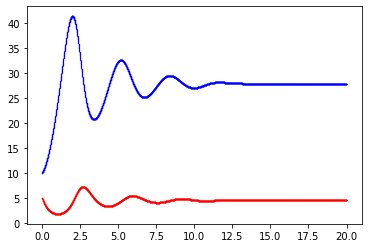

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338437.png
Epoch [38100/50000] Loss:0.000746 Loss_1:0.000027 Loss_2:0.000719 Lr:0.000256 Time:1.370121s
Epoch [38200/50000] Loss:0.000516 Loss_1:0.000000 Loss_2:0.000516 Lr:0.000255 Time:0.791333s
Epoch [38300/50000] Loss:0.000942 Loss_1:0.000044 Loss_2:0.000898 Lr:0.000254 Time:0.791301s
Epoch [38400/50000] Loss:0.000514 Loss_1:0.000000 Loss_2:0.000514 Lr:0.000254 Time:0.791183s
Epoch [38500/50000] Loss:0.000523 Loss_1:0.000000 Loss_2:0.000523 Lr:0.000253 Time:0.792803s
Testing & drawing...
u= [9.998657, 10.003692, 10.008744, 10.013822, 10.018924, 10.024048, 10.029189, 10.034357, 10.039548, 10.044757] ... [27.806965, 27.806965, 27.806965, 27.806965, 27.806965, 27.806965, 27.806965, 27.806965, 27.806965, 27.806965]
v= [4.999084, 4.990129, 4.981194, 4.972269, 4.9633594, 4.954465, 4.945594, 4.9367337, 4.9278913, 4.9190726] ... [4.533286, 4.5332875, 4.533288, 4.5

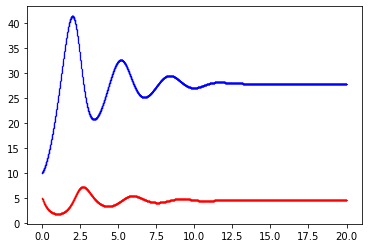

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338442.png
Epoch [38600/50000] Loss:0.000662 Loss_1:0.000014 Loss_2:0.000649 Lr:0.000253 Time:1.327629s
Epoch [38700/50000] Loss:0.000513 Loss_1:0.000000 Loss_2:0.000513 Lr:0.000252 Time:0.793356s
Epoch [38800/50000] Loss:0.004196 Loss_1:0.000257 Loss_2:0.003939 Lr:0.000251 Time:0.790908s
Epoch [38900/50000] Loss:0.000511 Loss_1:0.000000 Loss_2:0.000511 Lr:0.000251 Time:0.791478s
Epoch [39000/50000] Loss:0.004280 Loss_1:0.000270 Loss_2:0.004010 Lr:0.000250 Time:0.790572s
Testing & drawing...
u= [9.992875, 9.99787, 10.00288, 10.007919, 10.012979, 10.018059, 10.023165, 10.02829, 10.033438, 10.038608] ... [27.823507, 27.823511, 27.823507, 27.823507, 27.823507, 27.823507, 27.823511, 27.823511, 27.823511, 27.823511]
v= [4.9876914, 4.978791, 4.969911, 4.9610405, 4.952188, 4.94335, 4.9345355, 4.9257326, 4.9169464, 4.908184] ... [4.537714, 4.537715, 4.5377154, 4.53771

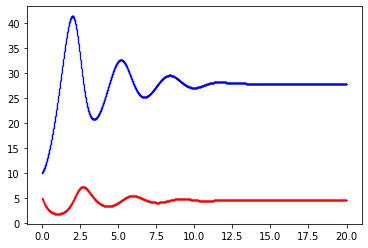

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338446.png
Epoch [39100/50000] Loss:0.000509 Loss_1:0.000000 Loss_2:0.000509 Lr:0.000249 Time:1.309987s
Epoch [39200/50000] Loss:0.007614 Loss_1:0.000447 Loss_2:0.007168 Lr:0.000249 Time:0.791568s
Epoch [39300/50000] Loss:0.000508 Loss_1:0.000000 Loss_2:0.000508 Lr:0.000248 Time:0.793164s
Epoch [39400/50000] Loss:0.001903 Loss_1:0.000142 Loss_2:0.001761 Lr:0.000248 Time:0.810945s
Epoch [39500/50000] Loss:0.000508 Loss_1:0.000000 Loss_2:0.000508 Lr:0.000247 Time:0.791407s
Testing & drawing...
u= [10.000561, 10.005597, 10.010658, 10.015742, 10.020848, 10.025976, 10.031124, 10.036295, 10.0414915, 10.046706] ... [27.806904, 27.806904, 27.806904, 27.806904, 27.806904, 27.806904, 27.806904, 27.806904, 27.806904, 27.806904]
v= [5.0003123, 4.991349, 4.9824047, 4.973471, 4.964553, 4.9556513, 4.9467726, 4.9379044, 4.9290547, 4.9202275] ... [4.5332837, 4.5332847, 4.53328

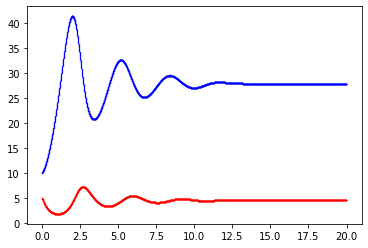

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338451.png
Epoch [39600/50000] Loss:0.000505 Loss_1:0.000000 Loss_2:0.000505 Lr:0.000246 Time:1.361216s
Epoch [39700/50000] Loss:0.000637 Loss_1:0.000006 Loss_2:0.000630 Lr:0.000246 Time:0.791486s
Epoch [39800/50000] Loss:0.000504 Loss_1:0.000000 Loss_2:0.000504 Lr:0.000245 Time:0.791776s
Epoch [39900/50000] Loss:0.000582 Loss_1:0.000006 Loss_2:0.000576 Lr:0.000244 Time:0.791756s
Epoch [40000/50000] Loss:0.000503 Loss_1:0.000000 Loss_2:0.000503 Lr:0.000244 Time:0.791225s
Testing & drawing...
u= [10.000148, 10.005187, 10.010246, 10.015328, 10.020434, 10.025562, 10.030708, 10.035881, 10.041075, 10.046288] ... [27.806625, 27.806625, 27.806625, 27.806625, 27.806625, 27.806625, 27.806625, 27.806625, 27.806625, 27.806625]
v= [5.000103, 4.991138, 4.982194, 4.97326, 4.964342, 4.95544, 4.94656, 4.9376926, 4.9288416, 4.9200144] ... [4.5332665, 4.533267, 4.5332675, 4.533

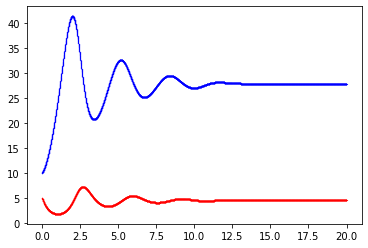

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338455.png
Epoch [40100/50000] Loss:0.000533 Loss_1:0.000003 Loss_2:0.000530 Lr:0.000243 Time:1.295470s
Epoch [40200/50000] Loss:0.000551 Loss_1:0.000001 Loss_2:0.000550 Lr:0.000243 Time:0.813892s
Epoch [40300/50000] Loss:0.006875 Loss_1:0.000495 Loss_2:0.006380 Lr:0.000242 Time:0.790954s
Epoch [40400/50000] Loss:0.000501 Loss_1:0.000000 Loss_2:0.000501 Lr:0.000242 Time:0.796622s
Epoch [40500/50000] Loss:0.000554 Loss_1:0.000004 Loss_2:0.000550 Lr:0.000241 Time:0.791933s
Testing & drawing...
u= [10.000854, 10.005893, 10.010949, 10.016035, 10.021141, 10.026269, 10.031417, 10.036591, 10.041786, 10.047001] ... [27.806492, 27.806492, 27.806492, 27.806492, 27.806492, 27.806492, 27.806492, 27.806492, 27.806492, 27.806492]
v= [5.0004845, 4.9915204, 4.9825783, 4.973645, 4.964729, 4.9558277, 4.9469504, 4.9380836, 4.929235, 4.9204097] ... [4.5332103, 4.5332117, 4.533212

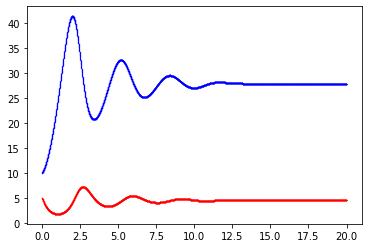

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338460.png
Epoch [40600/50000] Loss:0.000500 Loss_1:0.000000 Loss_2:0.000500 Lr:0.000240 Time:1.346226s
Epoch [40700/50000] Loss:0.000608 Loss_1:0.000010 Loss_2:0.000598 Lr:0.000240 Time:0.791526s
Epoch [40800/50000] Loss:0.000498 Loss_1:0.000000 Loss_2:0.000498 Lr:0.000239 Time:0.791130s
Epoch [40900/50000] Loss:0.000793 Loss_1:0.000037 Loss_2:0.000756 Lr:0.000239 Time:0.792770s
Epoch [41000/50000] Loss:0.000497 Loss_1:0.000000 Loss_2:0.000497 Lr:0.000238 Time:0.791913s
Testing & drawing...
u= [10.000081, 10.005119, 10.010177, 10.015259, 10.020365, 10.02549, 10.030637, 10.035809, 10.041003, 10.046215] ... [27.806704, 27.806704, 27.806704, 27.806704, 27.806704, 27.806704, 27.806704, 27.806704, 27.806704, 27.806704]
v= [5.0000114, 4.991046, 4.9821005, 4.9731665, 4.9642477, 4.955344, 4.9464655, 4.9375973, 4.928746, 4.91992] ... [4.533284, 4.533285, 4.533285, 4.5

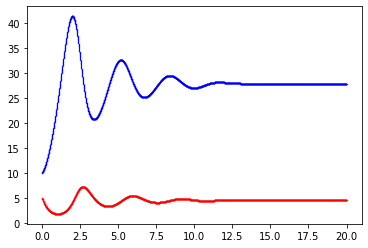

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338464.png
Epoch [41100/50000] Loss:0.000499 Loss_1:0.000000 Loss_2:0.000499 Lr:0.000238 Time:1.318976s
Epoch [41200/50000] Loss:0.000496 Loss_1:0.000000 Loss_2:0.000496 Lr:0.000237 Time:0.791548s
Epoch [41300/50000] Loss:0.000498 Loss_1:0.000000 Loss_2:0.000498 Lr:0.000236 Time:0.791529s
Epoch [41400/50000] Loss:0.000495 Loss_1:0.000000 Loss_2:0.000495 Lr:0.000236 Time:0.791414s
Epoch [41500/50000] Loss:0.000501 Loss_1:0.000001 Loss_2:0.000500 Lr:0.000235 Time:0.791498s
Testing & drawing...
u= [9.998192, 10.003223, 10.008273, 10.0133505, 10.01845, 10.023571, 10.02871, 10.033876, 10.039063, 10.044274] ... [27.805094, 27.805094, 27.805094, 27.805094, 27.805094, 27.805094, 27.805094, 27.805094, 27.805094, 27.805094]
v= [5.000356, 4.991391, 4.9824467, 4.973513, 4.964596, 4.9556947, 4.946815, 4.937949, 4.9290996, 4.920274] ... [4.5328627, 4.532864, 4.5328646, 4.53

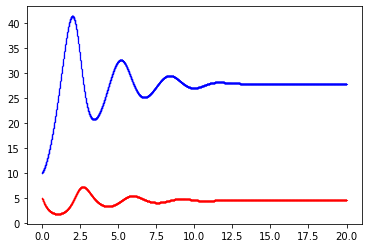

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338469.png
Epoch [41600/50000] Loss:0.000607 Loss_1:0.000012 Loss_2:0.000594 Lr:0.000235 Time:1.289302s
Epoch [41700/50000] Loss:0.001107 Loss_1:0.000048 Loss_2:0.001058 Lr:0.000234 Time:0.791955s
Epoch [41800/50000] Loss:0.000493 Loss_1:0.000000 Loss_2:0.000493 Lr:0.000234 Time:0.792585s
Epoch [41900/50000] Loss:0.005050 Loss_1:0.000350 Loss_2:0.004700 Lr:0.000233 Time:0.795325s
Epoch [42000/50000] Loss:0.000492 Loss_1:0.000000 Loss_2:0.000492 Lr:0.000233 Time:0.791039s
Testing & drawing...
u= [10.0002, 10.005239, 10.010296, 10.015379, 10.020485, 10.02561, 10.03076, 10.035929, 10.041125, 10.046338] ... [27.806833, 27.806833, 27.806835, 27.806837, 27.806837, 27.806837, 27.806837, 27.806837, 27.806837, 27.806837]
v= [5.000152, 4.991186, 4.9822407, 4.9733043, 4.9643855, 4.955483, 4.9466023, 4.9377337, 4.928882, 4.920055] ... [4.533278, 4.5332785, 4.5332794, 4.53

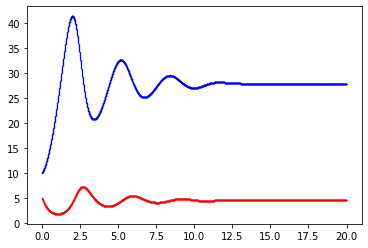

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338473.png
Epoch [42100/50000] Loss:0.000494 Loss_1:0.000000 Loss_2:0.000493 Lr:0.000232 Time:1.363416s
Epoch [42200/50000] Loss:0.000494 Loss_1:0.000000 Loss_2:0.000493 Lr:0.000231 Time:0.791202s
Epoch [42300/50000] Loss:0.000490 Loss_1:0.000000 Loss_2:0.000490 Lr:0.000231 Time:0.791302s
Epoch [42400/50000] Loss:0.000493 Loss_1:0.000000 Loss_2:0.000493 Lr:0.000230 Time:0.791031s
Epoch [42500/50000] Loss:0.000490 Loss_1:0.000000 Loss_2:0.000490 Lr:0.000230 Time:0.791151s
Testing & drawing...
u= [10.000128, 10.005164, 10.0102215, 10.015305, 10.020408, 10.025536, 10.030682, 10.035853, 10.041046, 10.046261] ... [27.806955, 27.806955, 27.806955, 27.806955, 27.806955, 27.806955, 27.806955, 27.806955, 27.806955, 27.806955]
v= [5.000039, 4.9910727, 4.982126, 4.973191, 4.964271, 4.9553685, 4.9464893, 4.93762, 4.9287696, 4.919943] ... [4.533293, 4.5332932, 4.533294, 4.

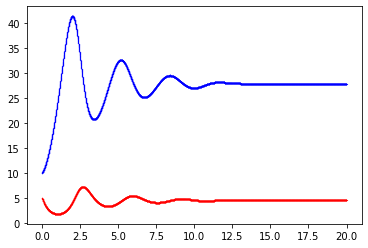

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338478.png
Epoch [42600/50000] Loss:0.000490 Loss_1:0.000000 Loss_2:0.000490 Lr:0.000229 Time:1.296834s
Epoch [42700/50000] Loss:0.000491 Loss_1:0.000000 Loss_2:0.000491 Lr:0.000229 Time:0.814563s
Epoch [42800/50000] Loss:0.000488 Loss_1:0.000000 Loss_2:0.000488 Lr:0.000228 Time:0.791155s
Epoch [42900/50000] Loss:0.000644 Loss_1:0.000021 Loss_2:0.000623 Lr:0.000228 Time:0.791367s
Epoch [43000/50000] Loss:0.000487 Loss_1:0.000000 Loss_2:0.000486 Lr:0.000227 Time:0.791755s
Testing & drawing...
u= [10.000127, 10.005165, 10.0102215, 10.015305, 10.020409, 10.0255375, 10.030683, 10.035854, 10.04105, 10.046263] ... [27.806992, 27.806992, 27.806992, 27.806992, 27.806992, 27.806995, 27.806995, 27.806995, 27.806995, 27.806995]
v= [5.0000596, 4.9910917, 4.9821453, 4.973209, 4.9642878, 4.9553847, 4.9465046, 4.937634, 4.928784, 4.9199557] ... [4.5333033, 4.5333037, 4.53330

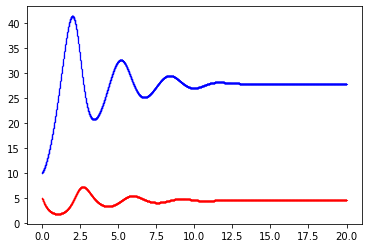

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338482.png
Epoch [43100/50000] Loss:0.000490 Loss_1:0.000001 Loss_2:0.000490 Lr:0.000227 Time:1.296612s
Epoch [43200/50000] Loss:0.007394 Loss_1:0.000554 Loss_2:0.006840 Lr:0.000226 Time:0.797437s
Epoch [43300/50000] Loss:0.000486 Loss_1:0.000000 Loss_2:0.000486 Lr:0.000226 Time:0.790363s
Epoch [43400/50000] Loss:0.003532 Loss_1:0.000240 Loss_2:0.003292 Lr:0.000225 Time:0.791474s
Epoch [43500/50000] Loss:0.000485 Loss_1:0.000000 Loss_2:0.000485 Lr:0.000225 Time:0.812818s
Testing & drawing...
u= [10.000326, 10.005365, 10.010422, 10.015505, 10.020611, 10.025738, 10.030886, 10.036057, 10.04125, 10.046465] ... [27.806885, 27.806885, 27.806885, 27.806885, 27.806885, 27.806885, 27.806885, 27.806885, 27.806885, 27.806885]
v= [5.0002832, 4.9913154, 4.982368, 4.973431, 4.96451, 4.9556055, 4.9467244, 4.9378543, 4.929003, 4.9201746] ... [4.533255, 4.5332565, 4.533257, 4.

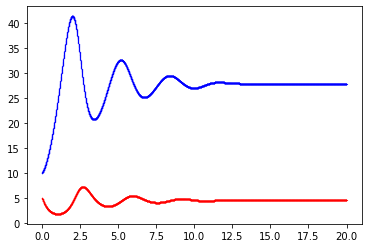

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338487.png
Epoch [43600/50000] Loss:0.000673 Loss_1:0.000017 Loss_2:0.000655 Lr:0.000224 Time:1.363455s
Epoch [43700/50000] Loss:0.000483 Loss_1:0.000000 Loss_2:0.000483 Lr:0.000224 Time:0.791240s
Epoch [43800/50000] Loss:0.000484 Loss_1:0.000000 Loss_2:0.000484 Lr:0.000223 Time:0.796548s
Epoch [43900/50000] Loss:0.000994 Loss_1:0.000040 Loss_2:0.000954 Lr:0.000223 Time:0.791817s
Epoch [44000/50000] Loss:0.000482 Loss_1:0.000000 Loss_2:0.000482 Lr:0.000222 Time:0.792199s
Testing & drawing...
u= [10.000098, 10.005136, 10.010193, 10.015275, 10.020378, 10.025506, 10.030652, 10.035822, 10.041017, 10.04623] ... [27.807096, 27.807096, 27.807096, 27.807098, 27.8071, 27.8071, 27.8071, 27.8071, 27.8071, 27.8071]
v= [5.000082, 4.9911137, 4.9821663, 4.9732294, 4.9643087, 4.955405, 4.9465237, 4.9376554, 4.9288044, 4.919976] ... [4.533284, 4.533285, 4.533286, 4.533286, 4.5

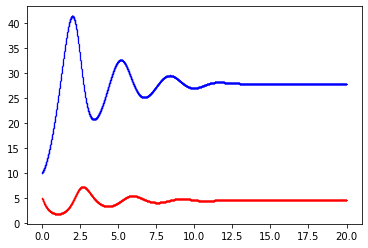

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338491.png
Epoch [44100/50000] Loss:0.001412 Loss_1:0.000055 Loss_2:0.001357 Lr:0.000222 Time:1.306859s
Epoch [44200/50000] Loss:0.000482 Loss_1:0.000000 Loss_2:0.000482 Lr:0.000221 Time:0.792122s
Epoch [44300/50000] Loss:0.000481 Loss_1:0.000000 Loss_2:0.000481 Lr:0.000221 Time:0.794384s
Epoch [44400/50000] Loss:0.000967 Loss_1:0.000064 Loss_2:0.000904 Lr:0.000220 Time:0.795668s
Epoch [44500/50000] Loss:0.000480 Loss_1:0.000000 Loss_2:0.000480 Lr:0.000220 Time:0.790940s
Testing & drawing...
u= [10.000051, 10.005089, 10.010145, 10.015229, 10.020331, 10.025458, 10.030604, 10.035775, 10.040969, 10.046183] ... [27.806896, 27.806896, 27.806896, 27.806896, 27.806896, 27.8069, 27.8069, 27.8069, 27.8069, 27.8069]
v= [5.0001607, 4.9911904, 4.982243, 4.9733047, 4.9643836, 4.9554787, 4.9465976, 4.937728, 4.9288764, 4.920048] ... [4.533208, 4.533209, 4.533209, 4.53321, 4

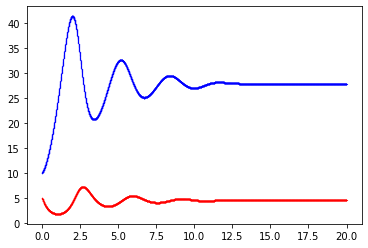

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338496.png
Epoch [44600/50000] Loss:0.000510 Loss_1:0.000004 Loss_2:0.000506 Lr:0.000219 Time:1.304880s
Epoch [44700/50000] Loss:0.000502 Loss_1:0.000001 Loss_2:0.000501 Lr:0.000219 Time:0.798409s
Epoch [44800/50000] Loss:0.000479 Loss_1:0.000000 Loss_2:0.000479 Lr:0.000218 Time:0.796863s
Epoch [44900/50000] Loss:0.004015 Loss_1:0.000185 Loss_2:0.003830 Lr:0.000218 Time:0.791954s
Epoch [45000/50000] Loss:0.000478 Loss_1:0.000000 Loss_2:0.000478 Lr:0.000217 Time:0.791852s
Testing & drawing...
u= [9.999967, 10.005005, 10.010059, 10.0151415, 10.020246, 10.025372, 10.030518, 10.035687, 10.040882, 10.046094] ... [27.807198, 27.807198, 27.8072, 27.8072, 27.8072, 27.8072, 27.8072, 27.8072, 27.8072, 27.8072]
v= [4.9999757, 4.991007, 4.982058, 4.97312, 4.9642005, 4.9552965, 4.946415, 4.937546, 4.9286947, 4.919867] ... [4.5332427, 4.5332437, 4.533244, 4.5332446, 4.53324

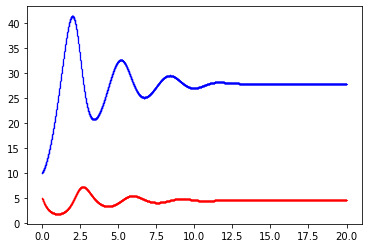

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338500.png
Epoch [45100/50000] Loss:0.001146 Loss_1:0.000083 Loss_2:0.001063 Lr:0.000217 Time:1.358545s
Epoch [45200/50000] Loss:0.000477 Loss_1:0.000000 Loss_2:0.000477 Lr:0.000216 Time:0.813545s
Epoch [45300/50000] Loss:0.000533 Loss_1:0.000002 Loss_2:0.000531 Lr:0.000216 Time:0.791029s
Epoch [45400/50000] Loss:0.000476 Loss_1:0.000000 Loss_2:0.000476 Lr:0.000216 Time:0.791798s
Epoch [45500/50000] Loss:0.000479 Loss_1:0.000000 Loss_2:0.000478 Lr:0.000215 Time:0.791342s
Testing & drawing...
u= [9.999867, 10.004904, 10.009962, 10.01504, 10.020144, 10.025269, 10.030415, 10.035585, 10.040777, 10.045989] ... [27.808033, 27.808035, 27.808035, 27.808035, 27.808035, 27.808035, 27.808035, 27.808037, 27.808037, 27.808037]
v= [4.9997096, 4.9907413, 4.981794, 4.972857, 4.963938, 4.9550357, 4.9461546, 4.9372864, 4.9284368, 4.9196095] ... [4.533389, 4.5333896, 4.5333905, 

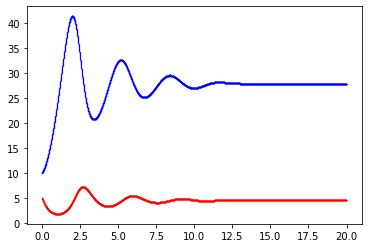

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338505.png
Epoch [45600/50000] Loss:0.000475 Loss_1:0.000000 Loss_2:0.000475 Lr:0.000215 Time:1.304142s
Epoch [45700/50000] Loss:0.000487 Loss_1:0.000000 Loss_2:0.000487 Lr:0.000214 Time:0.794012s
Epoch [45800/50000] Loss:0.000474 Loss_1:0.000000 Loss_2:0.000474 Lr:0.000214 Time:0.793449s
Epoch [45900/50000] Loss:0.000493 Loss_1:0.000000 Loss_2:0.000492 Lr:0.000213 Time:0.791253s
Epoch [46000/50000] Loss:0.000473 Loss_1:0.000000 Loss_2:0.000473 Lr:0.000213 Time:0.792432s
Testing & drawing...
u= [10.000098, 10.005133, 10.010189, 10.015271, 10.020376, 10.025503, 10.030648, 10.035819, 10.041014, 10.0462265] ... [27.807535, 27.807535, 27.807539, 27.807539, 27.807539, 27.807539, 27.807539, 27.807539, 27.807539, 27.807539]
v= [5.0000496, 4.9910793, 4.98213, 4.9731917, 4.9642696, 4.9553657, 4.946483, 4.937614, 4.928762, 4.9199333] ... [4.5332623, 4.533263, 4.533264, 

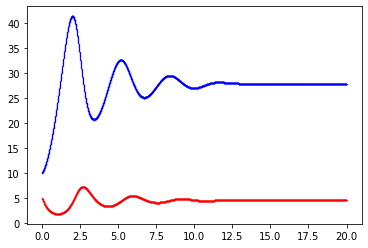

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338509.png
Epoch [46100/50000] Loss:0.000514 Loss_1:0.000005 Loss_2:0.000510 Lr:0.000212 Time:1.349617s
Epoch [46200/50000] Loss:0.000473 Loss_1:0.000000 Loss_2:0.000473 Lr:0.000212 Time:0.791250s
Epoch [46300/50000] Loss:0.000474 Loss_1:0.000000 Loss_2:0.000474 Lr:0.000211 Time:0.790989s
Epoch [46400/50000] Loss:0.006372 Loss_1:0.000435 Loss_2:0.005938 Lr:0.000211 Time:0.791508s
Epoch [46500/50000] Loss:0.000471 Loss_1:0.000000 Loss_2:0.000471 Lr:0.000211 Time:0.791339s
Testing & drawing...
u= [10.000086, 10.005123, 10.01018, 10.015259, 10.020366, 10.02549, 10.030637, 10.035809, 10.041001, 10.046214] ... [27.807432, 27.807434, 27.807434, 27.807434, 27.807434, 27.807436, 27.807436, 27.807438, 27.807438, 27.807438]
v= [5.000208, 4.9912367, 4.982288, 4.9733486, 4.964426, 4.9555206, 4.9466386, 4.9377685, 4.9289165, 4.9200883] ... [4.533184, 4.5331845, 4.5331855, 

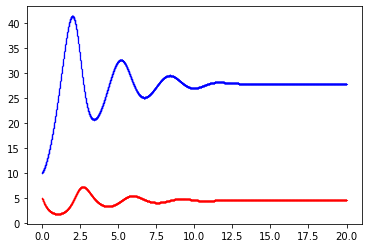

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338514.png
Epoch [46600/50000] Loss:0.000727 Loss_1:0.000037 Loss_2:0.000690 Lr:0.000210 Time:1.304225s
Epoch [46700/50000] Loss:0.000470 Loss_1:0.000000 Loss_2:0.000470 Lr:0.000210 Time:0.792689s
Epoch [46800/50000] Loss:0.000987 Loss_1:0.000053 Loss_2:0.000934 Lr:0.000209 Time:0.810014s
Epoch [46900/50000] Loss:0.000469 Loss_1:0.000000 Loss_2:0.000469 Lr:0.000209 Time:0.791276s
Epoch [47000/50000] Loss:0.000482 Loss_1:0.000002 Loss_2:0.000481 Lr:0.000208 Time:0.791322s
Testing & drawing...
u= [9.999195, 10.00423, 10.009283, 10.014362, 10.019463, 10.024585, 10.029725, 10.034894, 10.040085, 10.045293] ... [27.808765, 27.808765, 27.808765, 27.808765, 27.808765, 27.808765, 27.808765, 27.80877, 27.80877, 27.80877]
v= [4.9988995, 4.989931, 4.980984, 4.9720488, 4.9631295, 4.9542274, 4.9453473, 4.9364815, 4.927632, 4.918807] ... [4.533461, 4.533462, 4.533462, 4.5334

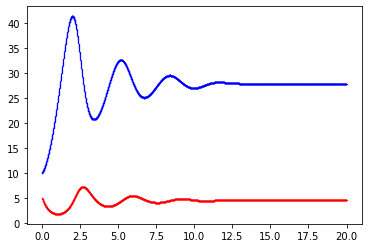

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338518.png
Epoch [47100/50000] Loss:0.000469 Loss_1:0.000000 Loss_2:0.000469 Lr:0.000208 Time:1.312085s
Epoch [47200/50000] Loss:0.000470 Loss_1:0.000000 Loss_2:0.000470 Lr:0.000207 Time:0.791816s
Epoch [47300/50000] Loss:0.000480 Loss_1:0.000001 Loss_2:0.000479 Lr:0.000207 Time:0.791132s
Epoch [47400/50000] Loss:0.000468 Loss_1:0.000000 Loss_2:0.000468 Lr:0.000207 Time:0.792946s
Epoch [47500/50000] Loss:0.000467 Loss_1:0.000000 Loss_2:0.000467 Lr:0.000206 Time:0.790943s
Testing & drawing...
u= [10.000134, 10.005172, 10.010228, 10.01531, 10.020415, 10.025541, 10.030687, 10.035858, 10.041052, 10.046265] ... [27.807745, 27.807745, 27.807745, 27.807745, 27.807745, 27.807747, 27.807747, 27.807747, 27.807747, 27.807747]
v= [5.000167, 4.9911957, 4.982245, 4.973305, 4.964382, 4.9554768, 4.9465938, 4.937722, 4.92887, 4.920042] ... [4.533167, 4.5331674, 4.533168, 4.533

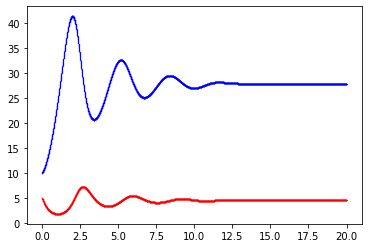

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338523.png
Epoch [47600/50000] Loss:0.000471 Loss_1:0.000000 Loss_2:0.000471 Lr:0.000206 Time:1.353760s
Epoch [47700/50000] Loss:0.000466 Loss_1:0.000000 Loss_2:0.000466 Lr:0.000205 Time:0.812052s
Epoch [47800/50000] Loss:0.000492 Loss_1:0.000003 Loss_2:0.000489 Lr:0.000205 Time:0.791364s
Epoch [47900/50000] Loss:0.000465 Loss_1:0.000000 Loss_2:0.000465 Lr:0.000204 Time:0.791763s
Epoch [48000/50000] Loss:0.000466 Loss_1:0.000000 Loss_2:0.000466 Lr:0.000204 Time:0.791159s
Testing & drawing...
u= [10.000132, 10.005169, 10.010224, 10.015306, 10.0204115, 10.025539, 10.030683, 10.035855, 10.041049, 10.046261] ... [27.807589, 27.807589, 27.807589, 27.807589, 27.807589, 27.807589, 27.807589, 27.807589, 27.807589, 27.807589]
v= [5.0002213, 4.9912505, 4.9823, 4.973361, 4.964437, 4.955531, 4.946649, 4.937778, 4.928925, 4.9200974] ... [4.5330305, 4.533031, 4.5330315, 4.5

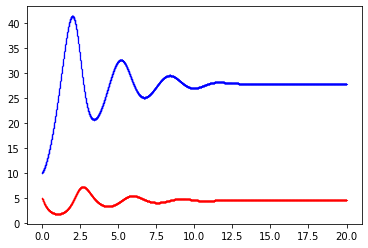

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338527.png
Epoch [48100/50000] Loss:0.000465 Loss_1:0.000000 Loss_2:0.000465 Lr:0.000204 Time:1.301425s
Epoch [48200/50000] Loss:0.000468 Loss_1:0.000000 Loss_2:0.000468 Lr:0.000203 Time:0.799068s
Epoch [48300/50000] Loss:0.000464 Loss_1:0.000000 Loss_2:0.000464 Lr:0.000203 Time:0.791247s
Epoch [48400/50000] Loss:0.000673 Loss_1:0.000025 Loss_2:0.000649 Lr:0.000202 Time:0.790775s
Epoch [48500/50000] Loss:0.000463 Loss_1:0.000000 Loss_2:0.000463 Lr:0.000202 Time:0.815594s
Testing & drawing...
u= [9.99991, 10.004946, 10.010002, 10.015081, 10.0201845, 10.025311, 10.030456, 10.035626, 10.04082, 10.046032] ... [27.80845, 27.80845, 27.80845, 27.808453, 27.808453, 27.808453, 27.808453, 27.808453, 27.808453, 27.808453]
v= [4.9998455, 4.990875, 4.981924, 4.972986, 4.9640627, 4.9551578, 4.9462748, 4.9374046, 4.9285536, 4.919726] ... [4.533199, 4.5332, 4.5332003, 4.53320

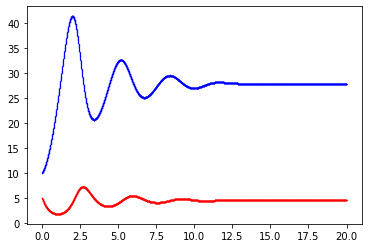

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338532.png
Epoch [48600/50000] Loss:0.000465 Loss_1:0.000000 Loss_2:0.000465 Lr:0.000202 Time:1.316022s
Epoch [48700/50000] Loss:0.003176 Loss_1:0.000136 Loss_2:0.003040 Lr:0.000201 Time:0.791419s
Epoch [48800/50000] Loss:0.000462 Loss_1:0.000000 Loss_2:0.000462 Lr:0.000201 Time:0.792605s
Epoch [48900/50000] Loss:0.000789 Loss_1:0.000029 Loss_2:0.000760 Lr:0.000200 Time:0.794493s
Epoch [49000/50000] Loss:0.000462 Loss_1:0.000000 Loss_2:0.000462 Lr:0.000200 Time:0.791585s
Testing & drawing...
u= [9.999871, 10.0049095, 10.009963, 10.015044, 10.020145, 10.02527, 10.030417, 10.035587, 10.04078, 10.04599] ... [27.808939, 27.808939, 27.808939, 27.808939, 27.808939, 27.80894, 27.80894, 27.80894, 27.80894, 27.80894]
v= [4.999708, 4.990736, 4.9817863, 4.972847, 4.9639244, 4.95502, 4.9461374, 4.937267, 4.9284163, 4.919588] ... [4.533249, 4.53325, 4.5332503, 4.533251, 4.

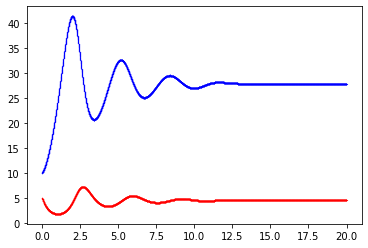

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338536.png
Epoch [49100/50000] Loss:0.000464 Loss_1:0.000000 Loss_2:0.000464 Lr:0.000200 Time:1.363997s
Epoch [49200/50000] Loss:0.002933 Loss_1:0.000276 Loss_2:0.002657 Lr:0.000199 Time:0.791437s
Epoch [49300/50000] Loss:0.000460 Loss_1:0.000000 Loss_2:0.000460 Lr:0.000199 Time:0.793459s
Epoch [49400/50000] Loss:0.001499 Loss_1:0.000034 Loss_2:0.001465 Lr:0.000198 Time:0.795640s
Epoch [49500/50000] Loss:0.000459 Loss_1:0.000000 Loss_2:0.000459 Lr:0.000198 Time:0.791773s
Testing & drawing...
u= [10.000266, 10.005301, 10.01036, 10.015441, 10.020546, 10.025671, 10.030819, 10.03599, 10.041183, 10.046396] ... [27.808807, 27.808807, 27.80881, 27.80881, 27.80881, 27.80881, 27.808811, 27.808813, 27.808813, 27.808813]
v= [5.000136, 4.9911633, 4.9822125, 4.9732714, 4.9643483, 4.9554424, 4.946559, 4.937688, 4.9288344, 4.9200068] ... [4.5331144, 4.5331144, 4.533116, 4.53

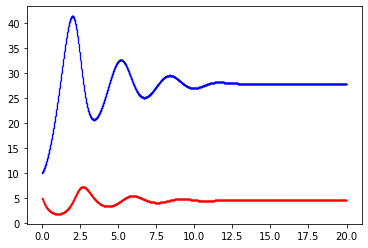

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338541.png
Epoch [49600/50000] Loss:0.001205 Loss_1:0.000076 Loss_2:0.001129 Lr:0.000198 Time:1.291301s
Epoch [49700/50000] Loss:0.000459 Loss_1:0.000000 Loss_2:0.000459 Lr:0.000197 Time:0.790930s
Epoch [49800/50000] Loss:0.002551 Loss_1:0.000107 Loss_2:0.002444 Lr:0.000197 Time:0.791130s
Epoch [49900/50000] Loss:0.000458 Loss_1:0.000000 Loss_2:0.000458 Lr:0.000196 Time:0.791638s
Epoch [50000/50000] Loss:0.000457 Loss_1:0.000000 Loss_2:0.000457 Lr:0.000196 Time:0.791569s
Testing & drawing...
u= [10.000241, 10.00528, 10.010336, 10.015418, 10.020523, 10.025647, 10.030794, 10.035966, 10.041161, 10.046373] ... [27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809004, 27.809004, 27.809006]
v= [5.0002465, 4.991273, 4.9823203, 4.973379, 4.9644556, 4.9555483, 4.946664, 4.937793, 4.92894, 4.9201097] ... [4.533087, 4.533087, 4.533088, 4.53

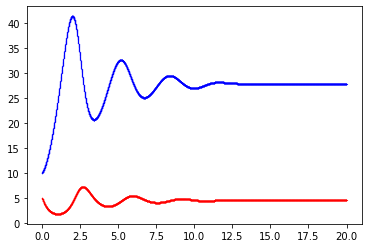

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338545.png
Testing & drawing...
u= [10.000241, 10.00528, 10.010336, 10.015418, 10.020523, 10.025647, 10.030794, 10.035966, 10.041161, 10.046373] ... [27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809002, 27.809004, 27.809004, 27.809006]
v= [5.0002465, 4.991273, 4.9823203, 4.973379, 4.9644556, 4.9555483, 4.946664, 4.937793, 4.92894, 4.9201097] ... [4.533087, 4.533087, 4.533088, 4.533088, 4.533089, 4.5330896, 4.53309, 4.533091, 4.533092, 4.533092]
x= [0.0, 0.0010001659, 0.0019997358, 0.0029999018, 0.0040000677, 0.0050002337, 0.0059998035, 0.0069999695, 0.008000135, 0.008999705] ... [19.990002, 19.991, 19.992, 19.993, 19.994, 19.995, 19.995998, 19.997002, 19.998, 19.999]


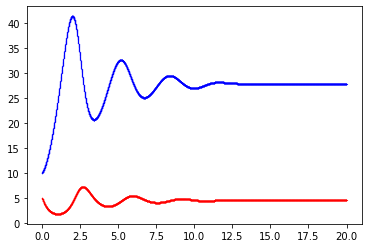

Saved as /content/drive/My Drive/Workspace/PINN/figure/SimpleNetworkPP_50000_100_0.01_1.0_3.0_0.3_0.333_2022-03-26-23-41-36_1648338546.png


<Figure size 432x288 with 0 Axes>

In [ ]:
main_path = "/content/drive/My Drive/Workspace/PINN"  # you may need to alter the path if it's not here
run_pp(main_path)

In [ ]:
import torch
import numpy
a = torch.Tensor([10,6])
b = torch.Tensor([5,3])
print(a)
print(b)
cost = torch.nn.MSELoss()(a, b)#（25+9）/2
print(cost)

tensor([10.,  6.])
tensor([5., 3.])
tensor(17.)


In [ ]:
!pip install pymysql

     |████████████████████████████████| 43 kB 1.7 MB/s 


In [ ]:
!ping falcon.cs.wfu.edu

/bin/bash: ping: command not found


In [ ]:
MYSQL_PARAMS = {
    "host": "falcon.cs.wfu.edu",  # "sjt.sites.wfu.edu",
    "port": 3306,
    "user": "xue20",  # "sjtsites_student",
    "passwd": "!06610829!",  # "Deacon2022",
    "db": "xue20_stockData"  # "sjtsites_Supplier"
}


import pymysql
import pymysql.cursors


class MySQLConnection:
    def __init__(self, params=None):
        self.connection_params = params
        self.connection: pymysql.connections.Connection = pymysql.connect(**self.connection_params)
        self.cursor: pymysql.cursors.Cursor = self.connection.cursor()

    def __del__(self):
        self.connection.commit()
        self.cursor.close()
        self.connection.close()

    def execute(self, command):
        self.cursor.execute(command)
        return self.cursor.fetchall()

    def executemany(self, command, tuples):
        self.cursor.executemany(command, tuples)
        return self.cursor.fetchall()


mysql = MySQLConnection(MYSQL_PARAMS)

ret_value = mysql.execute("SELECT * FROM symbols")
for item in ret_value:
    print(item)


OperationalError: ignored

u= [9.999942, 9.994956, 9.990004, 9.985082, 9.980192, 9.975333, 9.97051, 9.965712, 9.960948, 9.956217] ... [29.526966, 29.462269, 29.397755, 29.333355, 29.26911, 29.205036, 29.141066, 29.077242, 29.013563, 28.950087]
v= [5.0000057, 4.9900417, 4.9800987, 4.9701624, 4.9602423, 4.950334, 4.94045, 4.9305725, 4.9207163, 4.9108787] ... [10.643191, 10.642619, 10.641978, 10.64127, 10.640496, 10.639652, 10.638743, 10.637767, 10.636725, 10.635618]
x= [0.0, 0.0010001659, 0.0019997358, 0.0029999018, 0.0040000677, 0.0050002337, 0.0059998035, 0.0069999695, 0.008000135, 0.008999705] ... [19.990002, 19.991, 19.992, 19.993, 19.994, 19.995, 19.995998, 19.997002, 19.998, 19.999]


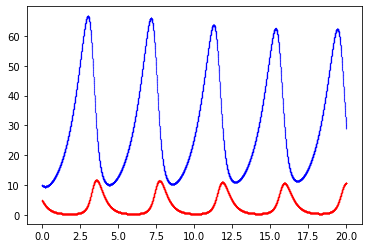

<Figure size 432x288 with 0 Axes>

In [ ]:
# SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-58-16_best

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
config = ConfigPP()
model = SimpleNetworkPP(config).to(device)
model.load_state_dict(torch.load(main_path + "/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-05-03-58-16_best.pt", map_location=device)["model_state_dict"])
model.eval()

t = model.x
y = model(t)
y0_pred = model(model.t0)
# print("t=", t)
# print("t0=", model.t0)
# print("y=", y)
# print("y0_pred=", y0_pred)
u, v = torch.chunk(y, 2, 1)
# print("u=", u)
# print("v=", v)
# u = model.decode_y(u)
# v = model.decode_y(v)
u = [item[0] for item in u.cpu().detach().numpy()]
v = [item[0] for item in v.cpu().detach().numpy()]
x = [item[0] for item in model.decode_t(t).cpu().detach().numpy()]
pairs = [[uu, vv, xx] for uu, vv, xx in zip(u, v, x)]
pairs.sort(key=lambda xx: xx[2])
u_sw = [item[0] for item in pairs]
v_sw = [item[1] for item in pairs]
x = [item[2] for item in pairs]
print("u=", u_sw[:10], "...", u_sw[-10:])
print("v=", v_sw[:10], "...", v_sw[-10:])
print("x=", x[:10], "...", x[-10:])
plt.plot(x, u_sw, marker='.', markersize=0.2, linewidth=0.1, c="b")
plt.plot(x, v_sw, marker='.', markersize=0.2, linewidth=0.1, c="r")
if True:
    plt.show()
plt.clf()


u= [10.000209, 9.995224, 9.990274, 9.985354, 9.980466, 9.975611, 9.970791, 9.966001, 9.961244, 9.956523] ... [28.054583, 27.992249, 27.930113, 27.868092, 27.806227, 27.744558, 27.68301, 27.62161, 27.560385, 27.499338]
v= [4.99994, 4.9899387, 4.979962, 4.9699974, 4.9600472, 4.950117, 4.9402094, 4.9303164, 4.920437, 4.910583] ... [10.747642, 10.745484, 10.743263, 10.7409725, 10.738616, 10.736195, 10.733707, 10.7311535, 10.728537, 10.725853]
x= [0.0, 0.0010001659, 0.0019997358, 0.0029999018, 0.0040000677, 0.0050002337, 0.0059998035, 0.0069999695, 0.008000135, 0.008999705] ... [19.990002, 19.991, 19.992, 19.993, 19.994, 19.995, 19.995998, 19.997002, 19.998, 19.999]


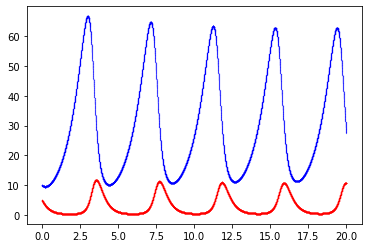

-5.0
-10.004999999999999
[10.0, 9.995, 9.9900324999925, 9.985097401377505, 9.980194606000667, 9.975324016151276, 9.970485534560256, 9.96567906439817, 9.960904509273243, 9.956161773229379, 9.951450760744194, 9.946771376727062, 9.942123526517163, 9.93750711588154, 9.932922051013163, 9.928368238529014, 9.923845585468163, 9.91935399928986, 9.914893387871642, 9.910463659507434, 9.90606472290567, 9.901696487187424, 9.897358861884532, 9.893051756937748, 9.888775082694883, 9.88452874990897, 9.880312669736428, 9.87612675373524, 9.871970913863134, 9.867845062475773, 9.863749112324957, 9.85968297655683, 9.855646568710092, 9.851639802714232, 9.847662592887742, 9.843714853936378, 9.839796500951387, 9.835907449407776, 9.832047615162567, 9.828216914453076, 9.824415263895181, 9.820642580481616, 9.816898781580264, 9.813183784932455, 9.809497508651283, 9.805839871219915, 9.802210791489918, 9.798610188679596, 9.795037982372326, 9.791494092514906, 9.787978439415912, 9.784490943744057, 9.781031526526563, 9

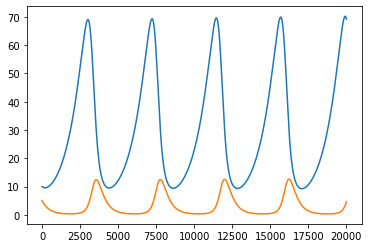

In [ ]:
# SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_last
# 2000000 test
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
config = ConfigPP()
model = SimpleNetworkPP(config).to(device)
model.load_state_dict(torch.load(main_path + "/train/SimpleNetworkPP_2000000_1000_0.01_1.0_3.0_0.3_0.333_2022-05-04-18-45-11_last.pt", map_location=device)["model_state_dict"])
model.eval()

t = model.x
y = model(t)
y0_pred = model(model.t0)
# print("t=", t)
# print("t0=", model.t0)
# print("y=", y)
# print("y0_pred=", y0_pred)
u, v = torch.chunk(y, 2, 1)
# print("u=", u)
# print("v=", v)
# u = model.decode_y(u)
# v = model.decode_y(v)
u = [item[0] for item in u.cpu().detach().numpy()]
v = [item[0] for item in v.cpu().detach().numpy()]
x = [item[0] for item in model.decode_t(t).cpu().detach().numpy()]
pairs = [[uu, vv, xx] for uu, vv, xx in zip(u, v, x)]
pairs.sort(key=lambda xx: xx[2])
u = [item[0] for item in pairs]
v = [item[1] for item in pairs]
x = [item[2] for item in pairs]
print("u=", u[:10], "...", u[-10:])
print("v=", v[:10], "...", v[-10:])
print("x=", x[:10], "...", x[-10:])
plt.plot(x, u, marker='.', markersize=0.2, linewidth=0.1, c="b")
plt.plot(x, v, marker='.', markersize=0.2, linewidth=0.1, c="r")
if True:
    plt.show()
plt.clf()


# Simulation - PP

import numpy as np
import matplotlib.pyplot as plt

T = 20.0
T_unit = 0.001
U_start = 10.0
V_start = 5.0

alpha = 1.0
beta = 3.0
gamma = 0.3
e = 0.333

# dU/dt=alpha*U-gamma*U*V
# dV/dt=-beta*V+e*gamma*U*V

U = [U_start]
V = [V_start]
flag = True
for i in range(1, int(T / T_unit)):
  U_old, V_old = U[-1], V[-1]
  if flag:
    print(((alpha * U_old) - gamma * U_old * V_old))
    print((- beta * V_old + e * gamma* U_old * V_old))
  U_new = U_old + ((alpha * U_old) - gamma * U_old * V_old) * T_unit
  V_new = V_old + (- beta * V_old + e * gamma* U_old * V_old) * T_unit
  U.append(U_new)
  V.append(V_new)
  flag = False
print(U)
print(V)
print(min(U), max(U))
print(min(V), max(V))
Y_hat = np.asarray([[u, v] for u, v in zip(U, V)])
plt.plot(Y_hat)

In [ ]:
def draw_two_dimension(
        y_lists,
        x_list,
        color_list,
        line_style_list,
        legend_list=None,
        legend_fontsize=15,
        fig_title=None,
        fig_x_label="time",
        fig_y_label="val",
        show_flag=True,
        save_flag=False,
        save_path=None,
        save_dpi=300,
        fig_title_size=20,
        fig_grid=False,
        marker_size=0,
        line_width=2,
        x_label_size=15,
        y_label_size=15,
        number_label_size=15,
        fig_size=(8, 6)
) -> None:
    """
    Draw a 2D plot of several lines
    :param y_lists: (list[list]) y value of lines, each list in which is one line. e.g., [[2,3,4,5], [2,1,0,-1], [1,4,9,16]]
    :param x_list: (list) x value shared by all lines. e.g., [1,2,3,4]
    :param color_list: (list) color of each line. e.g., ["red", "blue", "green"]
    :param line_style_list: (list) line style of each line. e.g., ["solid", "dotted", "dashed"]
    :param legend_list: (list) legend of each line, which CAN BE LESS THAN NUMBER of LINES. e.g., ["red line", "blue line", "green line"]
    :param legend_fontsize: (float) legend fontsize. e.g., 15
    :param fig_title: (string) title of the figure. e.g., "Anonymous"
    :param fig_x_label: (string) x label of the figure. e.g., "time"
    :param fig_y_label: (string) y label of the figure. e.g., "val"
    :param show_flag: (boolean) whether you want to show the figure. e.g., True
    :param save_flag: (boolean) whether you want to save the figure. e.g., False
    :param save_path: (string) If you want to save the figure, give the save path. e.g., "./test.png"
    :param save_dpi: (integer) If you want to save the figure, give the save dpi. e.g., 300
    :param fig_title_size: (float) figure title size. e.g., 20
    :param fig_grid: (boolean) whether you want to display the grid. e.g., True
    :param marker_size: (float) marker size. e.g., 0
    :param line_width: (float) line width. e.g., 1
    :param x_label_size: (float) x label size. e.g., 15
    :param y_label_size: (float) y label size. e.g., 15
    :param number_label_size: (float) number label size. e.g., 15
    :param fig_size: (tuple) figure size. e.g., (8, 6)
    :return:
    """
    assert len(y_lists[0]) == len(x_list), "Dimension of y should be same to that of x"
    assert len(y_lists) == len(line_style_list) == len(color_list), "number of lines should be fixed"
    y_count = len(y_lists)
    plt.figure(figsize=fig_size)
    for i in range(y_count):
        plt.plot(x_list, y_lists[i], markersize=marker_size, linewidth=line_width, c=color_list[i], linestyle=line_style_list[i])
    plt.xlabel(fig_x_label, fontsize=x_label_size)
    plt.ylabel(fig_y_label, fontsize=y_label_size)
    plt.tick_params(labelsize=number_label_size)
    if legend_list:
        plt.legend(legend_list, fontsize=legend_fontsize)
    if fig_title:
        plt.title(fig_title, fontsize=fig_title_size)
    if fig_grid:
        plt.grid(True)
    if save_flag:
        plt.savefig(save_path, dpi=save_dpi)
    if show_flag:
        plt.show()
    plt.clf()

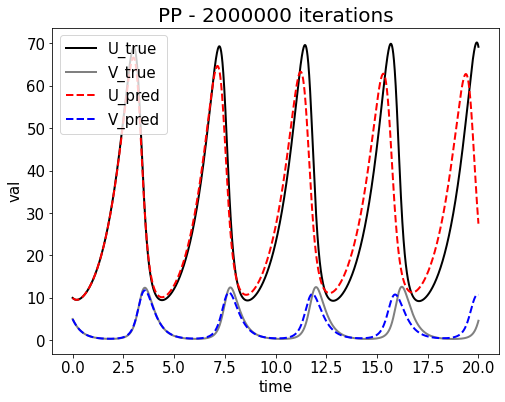

<Figure size 432x288 with 0 Axes>

In [ ]:
draw_two_dimension(
    y_lists=[U, V, u, v],
    x_list=x,
    color_list=["black", "grey", "red", "blue"],
    legend_list=["U_true", "V_true", "U_pred", "V_pred"],
    line_style_list=["solid", "solid", "dashed", "dashed"],
    fig_title="PP - 2000000 iterations",
    fig_size=(8, 6),
    show_flag=True,
    save_flag=False,
    save_path=None
)

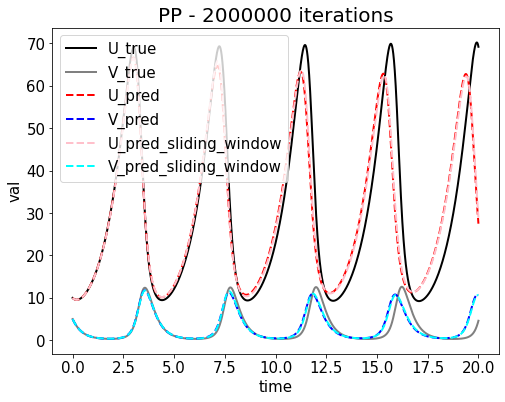

<Figure size 432x288 with 0 Axes>

In [ ]:
draw_two_dimension(
    y_lists=[U, V, u, v, u_sw, v_sw],
    x_list=x,
    color_list=["black", "grey", "red", "blue", "pink", "cyan"],
    legend_list=["U_true", "V_true", "U_pred", "V_pred", "U_pred_sliding_window", "V_pred_sliding_window"],
    line_style_list=["solid", "solid", "dashed", "dashed", "dashed", "dashed"],
    fig_title="PP - 2000000 iterations",
    fig_size=(8, 6),
    show_flag=True,
    save_flag=False,
    save_path=None
)